# Importing

## Importing modules

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.ticker import (AutoMinorLocator, MultipleLocator)
import time
import random
import math
from multiprocessing import Process, Queue

import keras
from keras.models import Sequential
from keras.layers import Activation, Dense
from keras.models import load_model, clone_model
from keras.optimizers import SGD, adam, adagrad, rmsprop

Using TensorFlow backend.


## Importing own code

In [2]:
from generateSpace import *
from plotLattice import *
from potentialEnergy import *
from numberOfCalculations import *
from makeRandomDatabase import *
from prepareDatabaseForMachineLearning import*

## Writing own code

### Analysis code

In [3]:
def plotHistory(fitDetails):
    """
    hjhgj
    """
    history = {'loss': fitDetails.history['loss'], 'val_loss': fitDetails.history['val_loss']}
    
    maximumValue = max(max(history['loss']), max(history['val_loss']))
    minimumValue = min(min(history['loss']), min(history['val_loss'])) / 10#math.pow(math.floor(math.log(min(min(history['loss']), min(history['val_loss'])), 10)) - 1, 10)
    numberOfEpochs = len(history['loss'])
    
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows=2, ncols=2, figsize=(16, 16))
    ax1.plot([i for i in range(1, numberOfEpochs + 1)], history['loss'], label='Training loss')
    ax1.plot([i for i in range(1, numberOfEpochs + 1)], history['val_loss'], label='Validation loss')
    ax1.legend()
    ax1.set_xlim(1, numberOfEpochs)
    ax1.set_ylim(0, maximumValue)
    ax1.set_xlabel('Epochs')
    ax1.set_ylabel('Loss (E/Ec)')
    ax1.set_title('Loss (training and validation) vs the number of epochs.')
    
    ax2.plot(history['loss'], history['val_loss'])
    ax2.set_xlim(0, maximumValue)
    ax2.set_ylim(0, maximumValue)
    ax2.set_xlabel('Training loss (E/Ec)')
    ax2.set_ylabel('Validation loss (E/Ec)')
    ax2.set_title('Validation loss vs training loss.')
    
    ax3.plot([i for i in range(1, numberOfEpochs + 1)], history['loss'], label='Training loss')
    ax3.plot([i for i in range(1, numberOfEpochs + 1)], history['val_loss'], label='Validation loss')
    ax3.legend()
    ax3.set_xlim(1, numberOfEpochs)
    ax3.set_yscale('log')
    ax3.set_ylim(minimumValue, maximumValue)
    ax3.set_xlabel('Epochs')
    ax3.set_ylabel('Loss (E/Ec)')
    ax3.set_title('Loss (training and validation) vs the number of epochs (logarithmic)')
    
    ax4.plot(history['loss'], history['val_loss'])
    ax4.set_xscale('log')
    ax4.set_xlim(minimumValue, maximumValue)
    ax4.set_yscale('log')
    ax4.set_ylim(minimumValue, maximumValue)
    ax4.set_xlabel('Training loss (E/Ec)')
    ax4.set_ylabel('Validation loss (E/Ec)')
    ax4.set_title('Validation loss vs training loss (logarithmic).')
    
    plt.show()
    history['figure'] = [fig, ax1, ax2, ax3, ax4]
    
    return history

In [4]:
def makeGradiantPlot(model, x, testData):
    y = [[],[]]
    for i in range(len(x)):
        y[0].append(model.predict([[testData['eigenvalues'][i]]])[0][0])
        #y[0].append(model.predict([[testData['relativeDistances'][i]]])[0][0])
        y[1].append(testData['potentialEnergy'][i])


    fig, ((ax1, ax2)) = plt.subplots( ncols=2, figsize=(16, 8))
    ax1.plot(list(x), y[0], label='Predicted potential energy')
    ax1.plot(list(x), y[1], label='Real potential energy')
    ax1.legend()
    ax1.set_xlabel('Position of particle (r/Rc)')
    ax1.set_ylabel('Potential energy per particle (E/Ec)')
    ax1.set_title('Predicted potential energy and real potential energy for different positions.')
    
    ax2.plot(list(x), np.gradient(y[0], x[1] - x[0]), label='Predicted gradiant')
    ax2.plot(list(x), np.gradient(y[1], x[1] - x[0]), label='Real gradiant')
    ax2.legend()
    ax2.set_xlabel('Position of particle (r/Rc)')
    ax2.set_ylabel('Gradiant')
    ax2.set_title('Predicted gradiant and real gradiant for different positions.')
    
    plt.show()

In [5]:
def makePredictionPlot(model, dataFrame, amountOfPoints=2500):
    prediction = []
    realValue = []
    
    for i in range(min(len(dataFrame['potentialEnergy']), amountOfPoints)):
        index = dataFrame.index[i]
        prediction.append(model.predict([[dataFrame['eigenvalues'][index]]])[0][0])
        #prediction.append(model.predict([[dataFrame['relativeDistances'][index]]])[0][0])
        realValue.append(dataFrame['potentialEnergy'][index])
    
    fig, ((ax1)) = plt.subplots(nrows=1, ncols=1, figsize=(8, 8))
    ax1.scatter(realValue, prediction, s=5)
    ax1.set_xlim(min(min(prediction), min(realValue)), max(max(prediction), max(realValue)))
    ax1.set_ylim(min(min(prediction), min(realValue)), max(max(prediction), max(realValue)))
    ax1.set_xlabel('Real energy per particle (E/Ec)')
    ax1.set_ylabel('Predicted energy per particle (E/Ec)')
    ax1.set_title('Predicted energy vs real energy.')
    
    plt.show()

In [6]:
def plotAndPredict(model, dataFrame, indexNumber):
    prediction = model.predict([[dataFrame['eigenvalues'][indexNumber]]])[0][0]
    #prediction = model.predict([[dataFrame['relativeDistances'][indexNumber]]])[0][0]
    realValue = dataFrame['potentialEnergy'][indexNumber]
    
    fig, ax = plotLatticeFromDataFrame(dataFrame, indexNumber)
    print('For index', indexNumber, 'Predicted', prediction, 'was', realValue)
    return fig, ax

### Network code

In [7]:
def testNetwork(trainingInput, settings, learningRate, kernalInitializer='he_uniform', lossFunction='MAE', validationSplit=0.3, epochs=10000, verbose=1, callbacksNetwork=[], sampleSize=4):
    bestModel = makeDenseNetwork(settings, learningRate, kernalInitializer, lossFunction)
    if verbose>=1:
        bestModel.summary()
        print(bestModel.evaluate(trainingInput['input'], trainingInput['target'], verbose=1))
        for i in range(len(bestModel.layers)):
            print('Layer ' + str(i) + ': ', bestModel.layers[i].get_weights())
    
    bestEvaluation = bestModel.evaluate(trainingInput['input'], trainingInput['target'], verbose=0)
    bestFitDetails = bestModel.fit(trainingInput['input'], trainingInput['target'], validation_split=validationSplit, epochs=3, verbose=0, callbacks=callbacksNetwork)
    
    for i in range(sampleSize):
        model = makeDenseNetwork(settings, learningRate, kernalInitializer, lossFunction)
        fitDetails = model.fit(trainingInput['input'], trainingInput['target'], validation_split=validationSplit, epochs=epochs, verbose=verbose, callbacks=callbacksNetwork)
        
        if fitDetails.history['val_loss'][-1]<=bestEvaluation:
            bestModel = model
            bestEvaluation = fitDetails.history['val_loss'][-1]
            bestFitDetails = fitDetails
            
        if verbose>=1:
            for j in range(len(model.layers)):
                print('Network' + str(i) + ' Layer ' + str(j) + ': ', model.layers[j].get_weights())
            history = plotHistory(fitDetails)
    
    return bestModel, bestFitDetails

In [8]:
def makeDenseNetwork(settings, learningRate, kernalInitializer='he_uniform', lossFunction='MAE'):#https://keras.io/api/losses/regression_losses/
    """
    jhgjhgj
    """
    model = Sequential()
    model.add(Dense(settings[1][1], input_dim=settings[0], use_bias=settings[1][3], activation=settings[1][2], kernel_initializer=kernalInitializer))
    #model.add(Activation(settings[0][2]))
    
    for i in range(2, len(settings)):
        setting = settings[i]#0 is kind of layer, rest are settings.
        
        model.add(Dense(setting[1], use_bias=setting[3], activation=setting[2], kernel_initializer=kernalInitializer))
        #model.add(Activation(setting[2]))
    
    opt = adam(lr=learningRate)
    model.compile(loss=lossFunction, optimizer=opt)
    
    return model

In [9]:
def makeLinearNet(learningRate, inputDim, loss):
    model = Sequential()
    opt = adam(lr=learningRate)
    model.add(Dense(1, activation="linear", use_bias=False, input_dim=inputDim))
    model.compile(loss=loss, optimizer=opt)
    return model

# Getting data

## Importing data and settings

In [10]:
filename = 'DatabaseMin_1Width5_50k_0.9Cutt_40scans_0.1max_3ds_1dsDecent_4particles_2D_M2M3M4R0p20Prepared'#'databaseModLen_min_cut0.90_widths86_Width5_data1k_3-1sur_epoch30_maxDelta0.1_1Prepared'
orderOfMatrix = [-2, -3, -4]# Make a list if you want to do the calculations yourself and make a other type of you want to import it
inputSize = 4 * len(orderOfMatrix)
saveFolder = 'M2M3M4Bias'
lossMetric = 'MAE'

In [11]:

data = pd.read_json(filename + '.json', orient='columns')
data['particleCoordinates'] = data['particleCoordinates'].apply(np.array)
data['eigenvalues'] = data['eigenvalues'].apply(np.array)
#data['eigenvalues'] = data['eigenvalues'].apply(np.transpose)
#data['eigenvalues'] = data['eigenvalues'].apply(list)

offset = 0#min(data['potentialEnergy'])
print('Offset is', offset)
data['potentialEnergy'] = data['potentialEnergy']-offset

Offset is 0


## Inspecting data

In [12]:
data.head()

,index,particleCoordinates,widthOfCell,numberOfSurroundingCells,potentialEnergy,eigenvalues,relativeDistances
0,32628,"[[1.0858742135, 1.4619206198], [1.74873057, 2....",4.2,3,-1.789783,"[-439.1052626387, -416.1078787072, -69.1530175...","[4.2, 0.9668700444, 0.9733192019, 1.0869749703..."
1,32629,"[[2.1856357135, 1.1373383648], [2.4390165837, ...",4.2,3,-1.173839,"[-439.7483700147, -286.7945629991, -93.2711214...","[4.2, 1.013937608, 5.401738369, 9.385523683, 1..."
2,32630,"[[1.1665649076, 0.34731191180000004], [4.12586...",4.2,3,-2.785944,"[-715.4909455555, -320.2040135989, -182.299503...","[4.2, 0.8572833011000001, 0.886805473, 1.39358..."
3,32631,"[[3.7420087484, 2.0828050456], [2.2698703849, ...",4.2,3,-1.260968,"[-561.3703618598, -292.1910064107, -35.0600559...","[4.2, 0.8012952312, 0.8839198248000001, 1.5028..."
4,32632,"[[2.9075719847, 3.6525434934], [0.0464497919, ...",4.2,3,8.027443,"[-899.4787697782, -692.4377784001, 269.4140283...","[4.2, 0.8596598867, 8.6939197852, 8.8824986392..."


In [13]:
data.describe()

,index,widthOfCell,numberOfSurroundingCells,potentialEnergy
count,97882.000000,97882.000000,97882.0,97882.000000
mean,48940.500000,5.651593,3.0,9.973750
std,28256.243862,2.443168,0.0,132.626087
min,0.000000,1.500000,3.0,-29.418425
25%,24470.250000,3.500000,3.0,-2.212925
50%,48940.500000,5.600000,3.0,-0.706743
75%,73410.750000,7.700000,3.0,-0.109594
max,97881.000000,10.000000,3.0,8848.009533


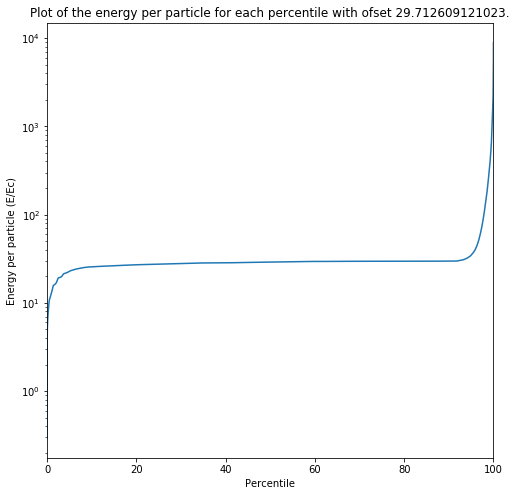

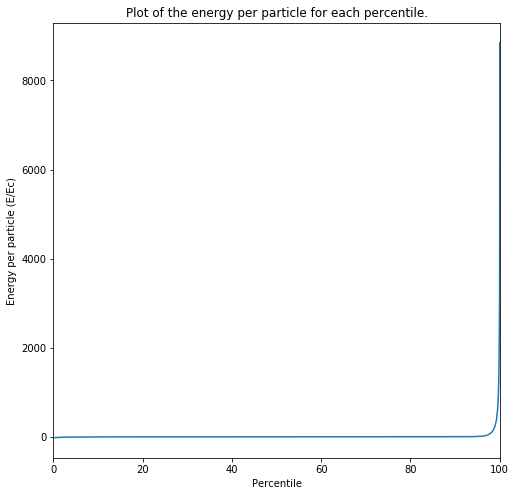

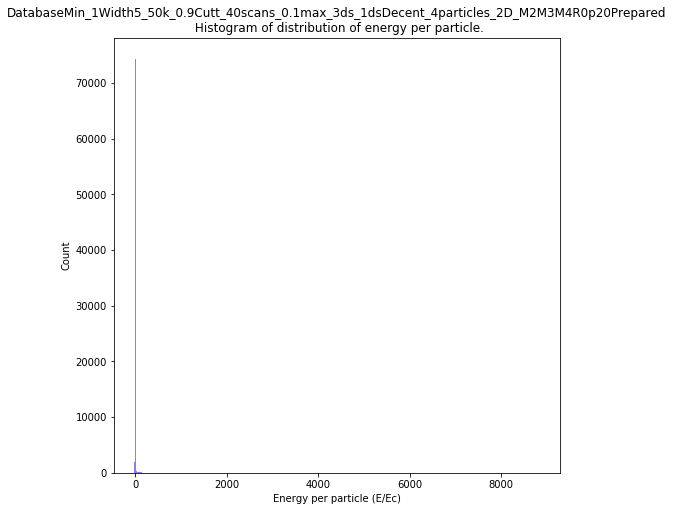

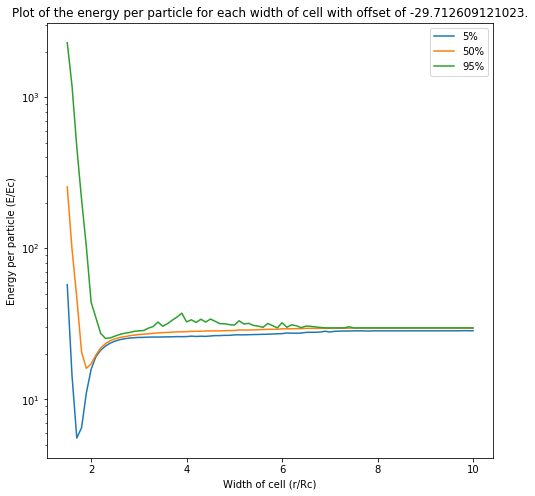

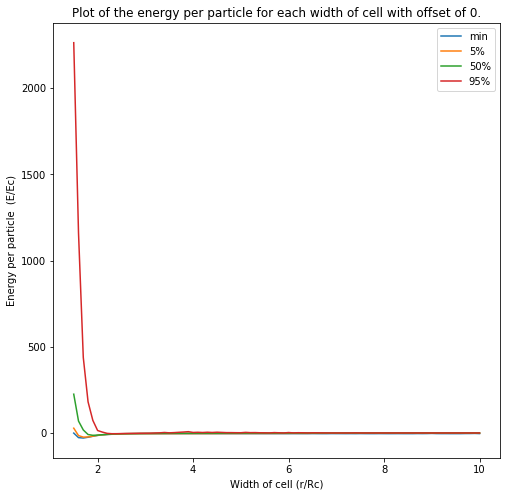

In [14]:

#"""
qLow = data['potentialEnergy'].quantile(0.01)
qHi  = data['potentialEnergy'].quantile(0.99)
dataFiltered = data.copy()
#dataFiltered = data[(data['potentialEnergy'] < qHi) & (data['potentialEnergy'] > qLow)]

x = dataFiltered['potentialEnergy']
fig, ax = plt.subplots(figsize=(8, 8))
sortedX = np.sort(x) - 1.01 * min(x)
ax.plot([100*i/len(x) for i in range(0, len(x))], sortedX)
ax.set_xlim(0, 100)
ax.set_yscale('log')
ax.set_title('Plot of the energy per particle for each percentile with ofset ' + str(-1.01 * min(x)) + '.')
ax.set_ylabel('Energy per particle (E/Ec)')
ax.set_xlabel('Percentile')
plt.show()

x = dataFiltered['potentialEnergy']
fig, ax = plt.subplots(figsize=(8, 8))
sortedX = np.sort(x)
ax.plot([100*i/len(x) for i in range(0, len(x))], sortedX)
ax.set_xlim(0, 100)
ax.set_title('Plot of the energy per particle for each percentile.')
ax.set_ylabel('Energy per particle (E/Ec)')
ax.set_xlabel('Percentile')
plt.show()


#"""


#"""
numBins = 1000
fig, ax = plt.subplots(figsize=(8, 8))
n, bins, patches = ax.hist(x, numBins, facecolor='blue', alpha=0.5)
ax.set_title(filename + '\n Histogram of distribution of energy per particle.')
ax.set_xlabel('Energy per particle (E/Ec)')
ax.set_ylabel('Count')
plt.show()
#"""

#"""
tempData = dataFiltered.copy()
tempOfsett = 1.01 * min(tempData['potentialEnergy'])
tempData['potentialEnergy'] = tempData['potentialEnergy'] - tempOfsett
medianData = tempData.groupby('widthOfCell').describe(percentiles=[0.05, 0.5, 0.95])
fig, ax = plt.subplots(figsize=(8, 8))
ax.plot(medianData.index, medianData['potentialEnergy']['5%'])
ax.plot(medianData.index, medianData['potentialEnergy']['50%'])
ax.plot(medianData.index, medianData['potentialEnergy']['95%'])
plt.legend(['5%', '50%', '95%'])
ax.set_yscale('log')
ax.set_title('Plot of the energy per particle for each width of cell with offset of ' + str(tempOfsett) + '.')
ax.set_ylabel('Energy per particle (E/Ec)')
ax.set_xlabel('Width of cell (r/Rc)')
plt.show()
#"""

#"""
tempData = dataFiltered.copy()
tempOfsett = 0#1.01 * min(tempData['potentialEnergy'])
tempData['potentialEnergy'] = tempData['potentialEnergy'] - tempOfsett
medianData = tempData.groupby('widthOfCell').describe(percentiles=[0.05, 0.5, 0.95])
fig, ax = plt.subplots(figsize=(8, 8))
ax.plot(medianData.index, medianData['potentialEnergy']['min'])
ax.plot(medianData.index, medianData['potentialEnergy']['5%'])
ax.plot(medianData.index, medianData['potentialEnergy']['50%'])
ax.plot(medianData.index, medianData['potentialEnergy']['95%'])
plt.legend(['min', '5%', '50%', '95%'])
#plt.ylim(-30, 30)
ax.set_title('Plot of the energy per particle for each width of cell with offset of ' + str(tempOfsett) + '.')
ax.set_ylabel('Energy per particle  (E/Ec)')
ax.set_xlabel('Width of cell (r/Rc)')
plt.show()
#"""


## Preparing data

In [15]:
#"""
trainingData = data.sample(frac=0.8)
validationData = data.drop(trainingData.index)

inputData = []
targetData = []
for i in trainingData.index:
    inputData.append(np.array(trainingData['eigenvalues'][i]))
    #inputData.append(np.array(trainingData['relativeDistances'][i]))
    targetData.append(trainingData['potentialEnergy'][i])
    #targetData.append(sum(trainingData['eigenvalues'][i]))
    #targetData.append([sum(trainingData['relativeDistances'][i])])

trainingInput = {'input':np.array(inputData), 'target':np.array(targetData)}

print('Results training input:')
[print(trainingInput['input'][i], trainingInput['target'][i], '\n') for i in range(0, 3)]
print(np.shape(trainingInput['input']))
print(type(trainingInput['input']))
print(type(trainingInput['input'][0]))
print(np.shape(trainingInput['target']))
print(type(trainingInput['target']))

inputData = []
targetData = []
for i in validationData.index:
    inputData.append(np.array(validationData['eigenvalues'][i]))
    #inputData.append(np.array(validationData['relativeDistances'][i]))
    targetData.append(validationData['potentialEnergy'][i])
    #targetData.append([sum(validationData['eigenvalues'][i])])
    #targetData.append([sum(validationData['relativeDistances'][i])])

validationInput = {'input':np.array(inputData), 'target':np.array(targetData)}

print('Results validation input:')
[print(validationInput['input'][i], validationInput['target'][i], '\n') for i in range(0, 3)]
print(np.shape(validationInput['input']))
print(type(validationInput['input']))
print(type(validationInput['input'][0]))
print(np.shape(validationInput['target']))
print(type(validationInput['target']))

validationPlots = [random.choice(validationData.index) for i in range(0, 11)]

#"""
print()

Results training input:
[-6.76050946e+02 -4.21841289e+02  1.10352140e+02  1.13478061e+03
 -1.61091715e+04 -8.92776610e+03  4.95353794e+03  2.03837386e+04
 -3.75325837e+05 -1.91713918e+05  1.40719832e+05  4.26991822e+05] -1.3051800769 

[-4.05475214e+02 -7.72333642e+01  4.50401064e+01  6.74844843e+02
 -8.05303875e+03 -5.82643655e+02  5.36802402e+02  8.66053395e+03
 -1.60448611e+05 -4.29394045e+03  4.00505121e+03  1.62221724e+05] -0.1225724095 

[-1.35487172e+03 -1.09200502e+03 -8.06245621e+02  1.33217137e+04
 -4.34208995e+04 -3.17114473e+04 -1.87693870e+04  1.65879950e+05
 -1.35704520e+06 -8.95016292e+05 -4.05700317e+05  3.37344610e+06] 185.5854455666 

(78306, 12)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(78306,)
<class 'numpy.ndarray'>
Results validation input:
[-6.19773152e+02 -3.21106863e+02 -3.46758629e+01  1.68009435e+03
 -1.44894034e+04 -5.62843430e+03  1.00221493e+03  2.14159980e+04
 -3.32757614e+05 -9.75201213e+04  3.64084302e+04  4.02695288e+05] -1.2666569725 

[-5.3634

## Preparing test data

No handles with labels found to put in legend.


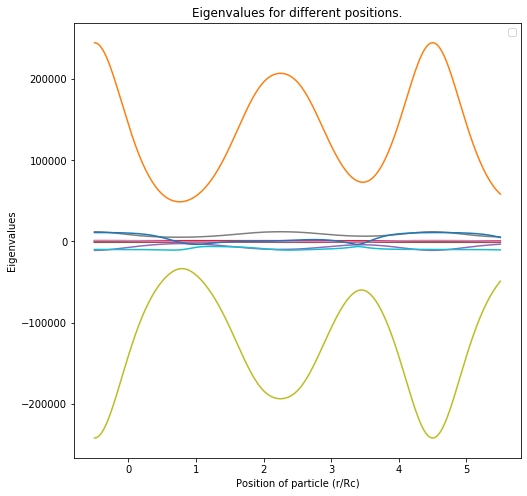

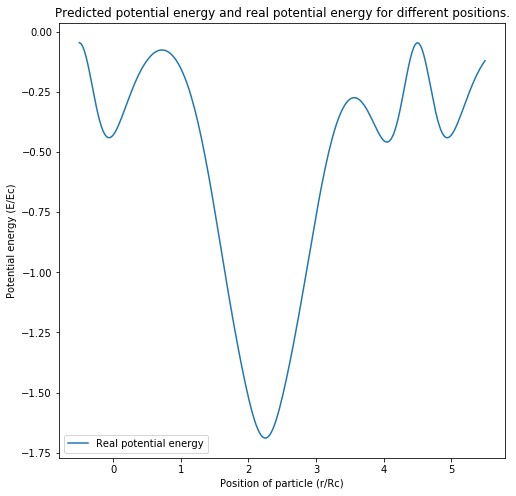

In [16]:
#"""
widthOfCell = 5.0
numberOfSurroundingCells = 3
R0 = 20
x = np.linspace(-0.1, 1.1, 2*120)

testData = {'particleCoordinates': [],'widthOfCell':[] , 'numberOfSurroundingCells': [], 'potentialEnergy':[]}# Initialy use a dictionary because it's easier to append to than a dataframe.
for i in x:
    particles = [np.array([0.3, 0.5]), np.array([0.68, 0.9]), np.array([0.7, 0.4]), np.array([0.5, i])]
    particles = [widthOfCell * coordinate for coordinate in particles]
    otherSpace = generateSpace(particles, numberOfSurroundingCells, widthOfCell)# Generate the other space.
    testData['particleCoordinates'].append(particles)
    testData['widthOfCell'].append(widthOfCell)
    testData['numberOfSurroundingCells'].append(numberOfSurroundingCells)
    testData['potentialEnergy'].append(potentialEnergy(otherSpace, particles, potentialEnergyPerSet) - offset)# Calculate the potential energy and save it to the data dictonairy.

x = widthOfCell * x
testData = prepareDatabseForMachineLearning(pd.DataFrame(testData), orderOfMatrix, R0, giveUpdates = False)

fig, ax1 = plt.subplots(figsize=(8, 8))
ax1.plot(list(x), [testData['eigenvalues'][i] for i in range(0, len(testData['eigenvalues']))])
#ax1.plot(list(x), [testData['relativeDistances'][i] for i in range(0, len(testData['relativeDistances']))])
ax1.legend()
#ax1.set_ylim(-50, 50)
ax1.set_xlabel('Position of particle (r/Rc)')
ax1.set_ylabel('Eigenvalues')
#ax1.set_ylabel('Relative distances')
ax1.set_title('Eigenvalues for different positions.')
plt.show()

testData.head()
testData.describe()

y = []
for i in range(len(x)):
    y.append(testData['potentialEnergy'][i])


fig, ax1 = plt.subplots(figsize=(8, 8))
ax1.plot(list(x), y, label='Real potential energy')
ax1.legend()
ax1.set_xlabel('Position of particle (r/Rc)')
ax1.set_ylabel('Potential energy (E/Ec)')
ax1.set_title('Predicted potential energy and real potential energy for different positions.')
#ax1.set_ylim(-0.75 * offset , 1.5 * max(y[1]))
plt.show()
#"""
print()

# Machine learning

In [17]:
def RSMPE(target,value):
    return ((keras.backend.mean(((value-target)/target)**2))**0.5)*100

def MAE(target,value):
    return keras.backend.mean(abs(value-target))

models = []
prefixName = 0

## Model 0: Linear network

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 1)                 13        
Total params: 13
Trainable params: 13
Non-trainable params: 0
_________________________________________________________________
78306/78306 [==============================] - 1s 10us/step
173312.38852745958
Layer 0:  [array([[-0.00403464],
       [-0.50224155],
       [-0.15993398],
       [-0.50943655],
       [ 0.20696127],
       [ 0.35739774],
       [ 0.04826725],
       [-0.38628006],
       [-0.14387214],
       [ 0.6979287 ],
       [-0.02961928],
       [ 0.46701282]], dtype=float32), array([0.], dtype=float32)]
Train on 62644 samples, validate on 15662 samples
Epoch 1/20000
62644/62644 [==============================] - 2s 29us/step - loss: 72124.6737 - val_loss: 68278.3122
Epoch 2/20000
62644/62644 [==============================] - 2s 26us/step - loss: 67023

62644/62644 [==============================] - 2s 30us/step - loss: 2373.0228 - val_loss: 2371.7926
Epoch 135/20000
62644/62644 [==============================] - 2s 31us/step - loss: 2316.5969 - val_loss: 2314.4932
Epoch 136/20000
62644/62644 [==============================] - 2s 30us/step - loss: 2260.5868 - val_loss: 2256.3689
Epoch 137/20000
62644/62644 [==============================] - 2s 30us/step - loss: 2204.4510 - val_loss: 2204.7309
Epoch 138/20000
62644/62644 [==============================] - 2s 30us/step - loss: 2149.8325 - val_loss: 2143.7501
Epoch 139/20000
62644/62644 [==============================] - 2s 30us/step - loss: 2095.0160 - val_loss: 2087.1607
Epoch 140/20000
62644/62644 [==============================] - 2s 30us/step - loss: 2040.2051 - val_loss: 2031.5031
Epoch 141/20000
62644/62644 [==============================] - 2s 30us/step - loss: 1985.7472 - val_loss: 1975.8201
Epoch 142/20000
62644/62644 [==============================] - 2s 30us/step - loss: 1930

62644/62644 [==============================] - 2s 30us/step - loss: 322.2650 - val_loss: 329.1157
Epoch 278/20000
62644/62644 [==============================] - 2s 28us/step - loss: 320.2987 - val_loss: 324.5139
Epoch 279/20000
62644/62644 [==============================] - 2s 28us/step - loss: 318.3391 - val_loss: 322.8150
Epoch 280/20000
62644/62644 [==============================] - 2s 28us/step - loss: 316.4931 - val_loss: 320.8449
Epoch 281/20000
62644/62644 [==============================] - 2s 27us/step - loss: 314.7366 - val_loss: 318.8226
Epoch 282/20000
62644/62644 [==============================] - 2s 27us/step - loss: 312.9164 - val_loss: 316.5600
Epoch 283/20000
62644/62644 [==============================] - 2s 27us/step - loss: 311.1114 - val_loss: 315.3528
Epoch 284/20000
62644/62644 [==============================] - 2s 28us/step - loss: 309.1693 - val_loss: 312.8424
Epoch 285/20000
62644/62644 [==============================] - 2s 27us/step - loss: 307.3116 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 224.1735 - val_loss: 227.9531
Epoch 350/20000
62644/62644 [==============================] - 2s 28us/step - loss: 223.3100 - val_loss: 225.6532
Epoch 351/20000
62644/62644 [==============================] - 2s 28us/step - loss: 222.4239 - val_loss: 223.7966
Epoch 352/20000
62644/62644 [==============================] - 2s 30us/step - loss: 221.4609 - val_loss: 222.9796
Epoch 353/20000
62644/62644 [==============================] - 2s 28us/step - loss: 220.6452 - val_loss: 222.4459
Epoch 354/20000
62644/62644 [==============================] - 2s 28us/step - loss: 219.9632 - val_loss: 222.7299
Epoch 355/20000
62644/62644 [==============================] - 2s 30us/step - loss: 218.9354 - val_loss: 220.5320
Epoch 356/20000
62644/62644 [==============================] - 2s 31us/step - loss: 218.2736 - val_loss: 219.7349
Epoch 357/20000
62644/62644 [==============================] - 2s 31us/step - loss: 217.4882 - val_loss:

62644/62644 [==============================] - 2s 27us/step - loss: 181.7188 - val_loss: 183.6997
Epoch 422/20000
62644/62644 [==============================] - 2s 27us/step - loss: 181.1884 - val_loss: 183.0739
Epoch 423/20000
62644/62644 [==============================] - 2s 28us/step - loss: 180.7331 - val_loss: 182.4510
Epoch 424/20000
62644/62644 [==============================] - 2s 29us/step - loss: 180.4240 - val_loss: 182.5796
Epoch 425/20000
62644/62644 [==============================] - 2s 29us/step - loss: 180.1459 - val_loss: 181.3434
Epoch 426/20000
62644/62644 [==============================] - 2s 27us/step - loss: 179.4977 - val_loss: 181.3446
Epoch 427/20000
62644/62644 [==============================] - 2s 28us/step - loss: 179.2522 - val_loss: 180.4931
Epoch 428/20000
62644/62644 [==============================] - 2s 28us/step - loss: 178.8137 - val_loss: 180.3761
Epoch 429/20000
62644/62644 [==============================] - 2s 28us/step - loss: 178.3879 - val_loss:

62644/62644 [==============================] - 2s 27us/step - loss: 157.2624 - val_loss: 159.2037
Epoch 494/20000
62644/62644 [==============================] - 2s 28us/step - loss: 156.8710 - val_loss: 158.4435
Epoch 495/20000
62644/62644 [==============================] - 2s 28us/step - loss: 156.4687 - val_loss: 160.3401
Epoch 496/20000
62644/62644 [==============================] - 2s 28us/step - loss: 156.4006 - val_loss: 157.9535
Epoch 497/20000
62644/62644 [==============================] - 2s 28us/step - loss: 156.0474 - val_loss: 158.4840
Epoch 498/20000
62644/62644 [==============================] - 2s 28us/step - loss: 155.7384 - val_loss: 158.0465
Epoch 499/20000
62644/62644 [==============================] - 2s 28us/step - loss: 155.5705 - val_loss: 158.2162
Epoch 500/20000
62644/62644 [==============================] - 2s 28us/step - loss: 155.1045 - val_loss: 156.9053
Epoch 501/20000
62644/62644 [==============================] - 2s 28us/step - loss: 154.8180 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 138.2903 - val_loss: 140.1676
Epoch 566/20000
62644/62644 [==============================] - 2s 29us/step - loss: 138.2029 - val_loss: 139.9970
Epoch 567/20000
62644/62644 [==============================] - 2s 28us/step - loss: 138.0183 - val_loss: 139.5697
Epoch 568/20000
62644/62644 [==============================] - 2s 27us/step - loss: 137.8680 - val_loss: 139.3475
Epoch 569/20000
62644/62644 [==============================] - 2s 25us/step - loss: 137.5931 - val_loss: 139.2662
Epoch 570/20000
62644/62644 [==============================] - 2s 29us/step - loss: 137.4052 - val_loss: 141.4168
Epoch 571/20000
62644/62644 [==============================] - 2s 28us/step - loss: 137.2348 - val_loss: 139.5367
Epoch 572/20000
62644/62644 [==============================] - 2s 28us/step - loss: 136.9012 - val_loss: 138.5180
Epoch 573/20000
62644/62644 [==============================] - 2s 28us/step - loss: 136.6582 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 124.2833 - val_loss: 125.7491
Epoch 638/20000
62644/62644 [==============================] - 2s 29us/step - loss: 124.0290 - val_loss: 126.8765
Epoch 639/20000
62644/62644 [==============================] - 2s 30us/step - loss: 123.7385 - val_loss: 125.2046
Epoch 640/20000
62644/62644 [==============================] - 2s 28us/step - loss: 123.5590 - val_loss: 125.1419
Epoch 641/20000
62644/62644 [==============================] - 2s 29us/step - loss: 123.4280 - val_loss: 126.4713
Epoch 642/20000
62644/62644 [==============================] - 2s 28us/step - loss: 123.4141 - val_loss: 128.6303
Epoch 643/20000
62644/62644 [==============================] - 2s 28us/step - loss: 123.2106 - val_loss: 124.5411
Epoch 644/20000
62644/62644 [==============================] - 2s 29us/step - loss: 122.9210 - val_loss: 124.3537
Epoch 645/20000
62644/62644 [==============================] - 2s 29us/step - loss: 122.7947 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 113.4206 - val_loss: 114.6377
Epoch 710/20000
62644/62644 [==============================] - 2s 28us/step - loss: 113.1777 - val_loss: 115.8025
Epoch 711/20000
62644/62644 [==============================] - 2s 28us/step - loss: 113.0300 - val_loss: 115.8710
Epoch 712/20000
62644/62644 [==============================] - 2s 28us/step - loss: 113.0089 - val_loss: 114.2407
Epoch 713/20000
62644/62644 [==============================] - 2s 28us/step - loss: 112.8459 - val_loss: 116.2744
Epoch 714/20000
62644/62644 [==============================] - 2s 28us/step - loss: 112.7047 - val_loss: 114.8770
Epoch 715/20000
62644/62644 [==============================] - 2s 28us/step - loss: 112.6026 - val_loss: 113.9433
Epoch 716/20000
62644/62644 [==============================] - 2s 30us/step - loss: 112.4068 - val_loss: 114.1274
Epoch 717/20000
62644/62644 [==============================] - 2s 28us/step - loss: 112.3900 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 104.9186 - val_loss: 106.5353
Epoch 782/20000
62644/62644 [==============================] - 2s 28us/step - loss: 104.6869 - val_loss: 107.8982
Epoch 783/20000
62644/62644 [==============================] - 2s 28us/step - loss: 104.7558 - val_loss: 106.0337
Epoch 784/20000
62644/62644 [==============================] - 2s 29us/step - loss: 104.6002 - val_loss: 105.9183
Epoch 785/20000
62644/62644 [==============================] - 2s 28us/step - loss: 104.3382 - val_loss: 107.1138
Epoch 786/20000
62644/62644 [==============================] - 2s 28us/step - loss: 104.5962 - val_loss: 106.9164
Epoch 787/20000
62644/62644 [==============================] - 2s 28us/step - loss: 104.2365 - val_loss: 107.5804
Epoch 788/20000
62644/62644 [==============================] - 2s 30us/step - loss: 104.2066 - val_loss: 105.8193
Epoch 789/20000
62644/62644 [==============================] - 2s 30us/step - loss: 104.1155 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 91.6507 - val_loss: 92.8693
Epoch 927/20000
62644/62644 [==============================] - 2s 28us/step - loss: 91.5926 - val_loss: 92.8088
Epoch 928/20000
62644/62644 [==============================] - 2s 28us/step - loss: 91.4284 - val_loss: 93.7654
Epoch 929/20000
62644/62644 [==============================] - 2s 28us/step - loss: 91.4580 - val_loss: 93.0609
Epoch 930/20000
62644/62644 [==============================] - 2s 30us/step - loss: 91.3601 - val_loss: 92.8243
Epoch 931/20000
62644/62644 [==============================] - 2s 29us/step - loss: 91.2814 - val_loss: 92.8976
Epoch 932/20000
62644/62644 [==============================] - 2s 29us/step - loss: 91.1643 - val_loss: 92.5480
Epoch 933/20000
62644/62644 [==============================] - 2s 28us/step - loss: 91.1642 - val_loss: 92.5280
Epoch 934/20000
62644/62644 [==============================] - 2s 28us/step - loss: 91.1034 - val_loss: 92.2141
Epoch 93

62644/62644 [==============================] - 2s 28us/step - loss: 80.6925 - val_loss: 81.7284
Epoch 1072/20000
62644/62644 [==============================] - 2s 29us/step - loss: 80.5870 - val_loss: 82.2438
Epoch 1073/20000
62644/62644 [==============================] - 2s 28us/step - loss: 80.5276 - val_loss: 81.5536
Epoch 1074/20000
62644/62644 [==============================] - 2s 28us/step - loss: 80.4419 - val_loss: 81.5715
Epoch 1075/20000
62644/62644 [==============================] - 2s 28us/step - loss: 80.3738 - val_loss: 81.9827
Epoch 1076/20000
62644/62644 [==============================] - 2s 29us/step - loss: 80.2229 - val_loss: 82.6427
Epoch 1077/20000
62644/62644 [==============================] - 2s 28us/step - loss: 80.3120 - val_loss: 81.7228
Epoch 1078/20000
62644/62644 [==============================] - 2s 29us/step - loss: 80.2349 - val_loss: 81.4385
Epoch 1079/20000
62644/62644 [==============================] - 2s 28us/step - loss: 80.0744 - val_loss: 81.2921


62644/62644 [==============================] - 2s 28us/step - loss: 70.7642 - val_loss: 71.6946
Epoch 1216/20000
62644/62644 [==============================] - 2s 29us/step - loss: 70.7182 - val_loss: 71.7354
Epoch 1217/20000
62644/62644 [==============================] - 2s 29us/step - loss: 70.6330 - val_loss: 73.4650
Epoch 1218/20000
62644/62644 [==============================] - 2s 28us/step - loss: 70.5494 - val_loss: 71.9098
Epoch 1219/20000
62644/62644 [==============================] - 2s 29us/step - loss: 70.6596 - val_loss: 71.4822
Epoch 1220/20000
62644/62644 [==============================] - 2s 28us/step - loss: 70.3896 - val_loss: 71.5595
Epoch 1221/20000
62644/62644 [==============================] - 2s 28us/step - loss: 70.3930 - val_loss: 72.3459
Epoch 1222/20000
62644/62644 [==============================] - 2s 27us/step - loss: 70.2783 - val_loss: 71.6792
Epoch 1223/20000
62644/62644 [==============================] - 2s 28us/step - loss: 70.3085 - val_loss: 71.1972


62644/62644 [==============================] - 2s 28us/step - loss: 61.7903 - val_loss: 62.6376
Epoch 1360/20000
62644/62644 [==============================] - 2s 28us/step - loss: 61.5329 - val_loss: 62.4789
Epoch 1361/20000
62644/62644 [==============================] - 2s 28us/step - loss: 61.7280 - val_loss: 62.4979
Epoch 1362/20000
62644/62644 [==============================] - 2s 28us/step - loss: 61.6634 - val_loss: 70.2995
Epoch 1363/20000
62644/62644 [==============================] - 2s 28us/step - loss: 61.4790 - val_loss: 62.3871
Epoch 1364/20000
62644/62644 [==============================] - 2s 28us/step - loss: 61.4474 - val_loss: 62.1515
Epoch 1365/20000
62644/62644 [==============================] - 2s 28us/step - loss: 61.3608 - val_loss: 62.1250
Epoch 1366/20000
62644/62644 [==============================] - 2s 28us/step - loss: 61.3677 - val_loss: 62.2167
Epoch 1367/20000
62644/62644 [==============================] - 2s 28us/step - loss: 61.3203 - val_loss: 62.5478


62644/62644 [==============================] - 2s 29us/step - loss: 53.4422 - val_loss: 54.0310
Epoch 1504/20000
62644/62644 [==============================] - 2s 28us/step - loss: 53.3063 - val_loss: 54.9360
Epoch 1505/20000
62644/62644 [==============================] - 2s 28us/step - loss: 53.3350 - val_loss: 53.8878
Epoch 1506/20000
62644/62644 [==============================] - 2s 28us/step - loss: 53.2659 - val_loss: 54.2452
Epoch 1507/20000
62644/62644 [==============================] - 2s 29us/step - loss: 53.1867 - val_loss: 54.1614
Epoch 1508/20000
62644/62644 [==============================] - 2s 28us/step - loss: 53.0843 - val_loss: 53.8527
Epoch 1509/20000
62644/62644 [==============================] - 2s 28us/step - loss: 53.0275 - val_loss: 53.9462
Epoch 1510/20000
62644/62644 [==============================] - 2s 29us/step - loss: 52.9146 - val_loss: 53.8675
Epoch 1511/20000
62644/62644 [==============================] - 2s 29us/step - loss: 52.9491 - val_loss: 53.8405


62644/62644 [==============================] - 2s 30us/step - loss: 45.7764 - val_loss: 47.2950
Epoch 1648/20000
62644/62644 [==============================] - 2s 28us/step - loss: 45.7984 - val_loss: 46.4943
Epoch 1649/20000
62644/62644 [==============================] - 2s 30us/step - loss: 45.8155 - val_loss: 46.2528
Epoch 1650/20000
62644/62644 [==============================] - 2s 30us/step - loss: 45.7873 - val_loss: 46.2944
Epoch 1651/20000
62644/62644 [==============================] - 2s 29us/step - loss: 45.7161 - val_loss: 46.4017
Epoch 1652/20000
62644/62644 [==============================] - 2s 29us/step - loss: 45.5415 - val_loss: 46.1086
Epoch 1653/20000
62644/62644 [==============================] - 2s 29us/step - loss: 45.5550 - val_loss: 46.1829
Epoch 1654/20000
62644/62644 [==============================] - 2s 29us/step - loss: 45.4561 - val_loss: 46.1523
Epoch 1655/20000
62644/62644 [==============================] - 2s 29us/step - loss: 45.5190 - val_loss: 45.9580


62644/62644 [==============================] - 2s 28us/step - loss: 39.5454 - val_loss: 39.8138
Epoch 1792/20000
62644/62644 [==============================] - 2s 29us/step - loss: 39.5052 - val_loss: 41.7763
Epoch 1793/20000
62644/62644 [==============================] - 2s 27us/step - loss: 39.5360 - val_loss: 39.8346
Epoch 1794/20000
62644/62644 [==============================] - 2s 27us/step - loss: 39.4755 - val_loss: 41.4697
Epoch 1795/20000
62644/62644 [==============================] - 2s 28us/step - loss: 39.4803 - val_loss: 40.2805
Epoch 1796/20000
62644/62644 [==============================] - 2s 28us/step - loss: 39.4052 - val_loss: 40.6838
Epoch 1797/20000
62644/62644 [==============================] - 2s 29us/step - loss: 39.3483 - val_loss: 40.2276
Epoch 1798/20000
62644/62644 [==============================] - 2s 28us/step - loss: 39.3886 - val_loss: 40.3176
Epoch 1799/20000
62644/62644 [==============================] - 2s 28us/step - loss: 39.2910 - val_loss: 39.8054


62644/62644 [==============================] - 2s 28us/step - loss: 35.7227 - val_loss: 38.2963
Epoch 1936/20000
62644/62644 [==============================] - 2s 28us/step - loss: 35.7946 - val_loss: 35.9219
Epoch 1937/20000
62644/62644 [==============================] - 2s 28us/step - loss: 35.7079 - val_loss: 36.6005
Epoch 1938/20000
62644/62644 [==============================] - 2s 28us/step - loss: 35.6604 - val_loss: 35.7720
Epoch 1939/20000
62644/62644 [==============================] - 2s 28us/step - loss: 35.6520 - val_loss: 35.7910
Epoch 1940/20000
62644/62644 [==============================] - 2s 28us/step - loss: 35.5992 - val_loss: 35.8017
Epoch 1941/20000
62644/62644 [==============================] - 2s 28us/step - loss: 35.5633 - val_loss: 36.4368
Epoch 1942/20000
62644/62644 [==============================] - 2s 28us/step - loss: 35.6663 - val_loss: 36.1797
Epoch 1943/20000
62644/62644 [==============================] - 2s 29us/step - loss: 35.6199 - val_loss: 35.6443


62644/62644 [==============================] - 2s 28us/step - loss: 33.3335 - val_loss: 33.9726
Epoch 2080/20000
62644/62644 [==============================] - 2s 28us/step - loss: 33.4234 - val_loss: 33.2987
Epoch 2081/20000
62644/62644 [==============================] - 2s 27us/step - loss: 33.3151 - val_loss: 34.0149
Epoch 2082/20000
62644/62644 [==============================] - 2s 27us/step - loss: 33.2051 - val_loss: 33.5364
Epoch 2083/20000
62644/62644 [==============================] - 2s 28us/step - loss: 33.2610 - val_loss: 33.5143
Epoch 2084/20000
62644/62644 [==============================] - 2s 27us/step - loss: 33.1876 - val_loss: 33.2402
Epoch 2085/20000
62644/62644 [==============================] - 2s 27us/step - loss: 33.2415 - val_loss: 34.1066
Epoch 2086/20000
62644/62644 [==============================] - 2s 27us/step - loss: 33.1132 - val_loss: 33.1553
Epoch 2087/20000
62644/62644 [==============================] - 2s 27us/step - loss: 33.1606 - val_loss: 34.4890


62644/62644 [==============================] - 2s 28us/step - loss: 31.5502 - val_loss: 31.5799
Epoch 2224/20000
62644/62644 [==============================] - 2s 29us/step - loss: 31.4814 - val_loss: 31.3937
Epoch 2225/20000
62644/62644 [==============================] - 2s 28us/step - loss: 31.5771 - val_loss: 31.5769
Epoch 2226/20000
62644/62644 [==============================] - 2s 29us/step - loss: 31.4534 - val_loss: 31.6801
Epoch 2227/20000
62644/62644 [==============================] - 2s 28us/step - loss: 31.4551 - val_loss: 33.1597
Epoch 2228/20000
62644/62644 [==============================] - 2s 28us/step - loss: 31.4130 - val_loss: 31.5144
Epoch 2229/20000
62644/62644 [==============================] - 2s 29us/step - loss: 31.3973 - val_loss: 31.5770
Epoch 2230/20000
62644/62644 [==============================] - 2s 28us/step - loss: 31.4732 - val_loss: 32.5356
Epoch 2231/20000
62644/62644 [==============================] - 2s 28us/step - loss: 31.4771 - val_loss: 31.3115


62644/62644 [==============================] - 2s 28us/step - loss: 30.0679 - val_loss: 30.0991
Epoch 2368/20000
62644/62644 [==============================] - 2s 28us/step - loss: 30.0372 - val_loss: 29.9132
Epoch 2369/20000
62644/62644 [==============================] - 2s 28us/step - loss: 30.0645 - val_loss: 30.2352
Epoch 2370/20000
62644/62644 [==============================] - 2s 28us/step - loss: 30.0752 - val_loss: 29.9099
Epoch 2371/20000
62644/62644 [==============================] - 2s 28us/step - loss: 29.9991 - val_loss: 29.9884
Epoch 2372/20000
62644/62644 [==============================] - 2s 27us/step - loss: 30.0314 - val_loss: 29.7905
Epoch 2373/20000
62644/62644 [==============================] - 2s 27us/step - loss: 30.0353 - val_loss: 29.7562
Epoch 2374/20000
62644/62644 [==============================] - 2s 27us/step - loss: 30.0310 - val_loss: 29.8618
Epoch 2375/20000
62644/62644 [==============================] - 2s 27us/step - loss: 30.0233 - val_loss: 30.7760


62644/62644 [==============================] - 2s 28us/step - loss: 28.8539 - val_loss: 28.6797
Epoch 2512/20000
62644/62644 [==============================] - 2s 28us/step - loss: 28.7391 - val_loss: 29.0528
Epoch 2513/20000
62644/62644 [==============================] - 2s 28us/step - loss: 28.9124 - val_loss: 30.0045
Epoch 2514/20000
62644/62644 [==============================] - 2s 28us/step - loss: 28.7576 - val_loss: 28.5034
Epoch 2515/20000
62644/62644 [==============================] - 2s 30us/step - loss: 28.6990 - val_loss: 28.4830
Epoch 2516/20000
62644/62644 [==============================] - 2s 28us/step - loss: 28.8816 - val_loss: 28.8112
Epoch 2517/20000
62644/62644 [==============================] - 2s 28us/step - loss: 28.7510 - val_loss: 28.6280
Epoch 2518/20000
62644/62644 [==============================] - 2s 28us/step - loss: 28.8226 - val_loss: 28.4886
Epoch 2519/20000
62644/62644 [==============================] - 2s 28us/step - loss: 28.8768 - val_loss: 28.5958


62644/62644 [==============================] - 2s 27us/step - loss: 27.7890 - val_loss: 32.3610
Epoch 2656/20000
62644/62644 [==============================] - 2s 27us/step - loss: 27.8465 - val_loss: 27.4179
Epoch 2657/20000
62644/62644 [==============================] - 2s 27us/step - loss: 27.7369 - val_loss: 28.7401
Epoch 2658/20000
62644/62644 [==============================] - 2s 28us/step - loss: 27.7318 - val_loss: 27.7307
Epoch 2659/20000
62644/62644 [==============================] - 2s 29us/step - loss: 27.7333 - val_loss: 27.3784
Epoch 2660/20000
62644/62644 [==============================] - 2s 28us/step - loss: 27.7777 - val_loss: 28.9162
Epoch 2661/20000
62644/62644 [==============================] - 2s 28us/step - loss: 27.7990 - val_loss: 27.3800
Epoch 2662/20000
62644/62644 [==============================] - 2s 28us/step - loss: 27.7862 - val_loss: 29.3576
Epoch 2663/20000
62644/62644 [==============================] - 2s 27us/step - loss: 27.6471 - val_loss: 27.3929


62644/62644 [==============================] - 2s 27us/step - loss: 26.8278 - val_loss: 26.8905
Epoch 2800/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.8486 - val_loss: 26.7229
Epoch 2801/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.9048 - val_loss: 28.6470
Epoch 2802/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.8569 - val_loss: 26.6297
Epoch 2803/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.8397 - val_loss: 26.7385
Epoch 2804/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.8878 - val_loss: 26.4863
Epoch 2805/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.9223 - val_loss: 28.3515
Epoch 2806/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.8186 - val_loss: 27.3138
Epoch 2807/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.9104 - val_loss: 26.5476


62644/62644 [==============================] - 2s 28us/step - loss: 26.1277 - val_loss: 26.1426
Epoch 2944/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.0585 - val_loss: 25.6518
Epoch 2945/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.0857 - val_loss: 27.6843
Epoch 2946/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.0993 - val_loss: 26.1349
Epoch 2947/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.0751 - val_loss: 26.6819
Epoch 2948/20000
62644/62644 [==============================] - 2s 29us/step - loss: 26.0462 - val_loss: 25.6109
Epoch 2949/20000
62644/62644 [==============================] - 2s 28us/step - loss: 26.1085 - val_loss: 26.4042
Epoch 2950/20000
62644/62644 [==============================] - 2s 29us/step - loss: 26.0747 - val_loss: 25.7279
Epoch 2951/20000
62644/62644 [==============================] - 2s 28us/step - loss: 26.0643 - val_loss: 26.8110


62644/62644 [==============================] - 2s 28us/step - loss: 25.4251 - val_loss: 26.4225
Epoch 3088/20000
62644/62644 [==============================] - 2s 28us/step - loss: 25.3481 - val_loss: 25.0403
Epoch 3089/20000
62644/62644 [==============================] - 2s 29us/step - loss: 25.4395 - val_loss: 25.0051
Epoch 3090/20000
62644/62644 [==============================] - 2s 28us/step - loss: 25.3342 - val_loss: 24.8627
Epoch 3091/20000
62644/62644 [==============================] - 2s 28us/step - loss: 25.4211 - val_loss: 25.6716
Epoch 3092/20000
62644/62644 [==============================] - 2s 28us/step - loss: 25.4076 - val_loss: 24.8677
Epoch 3093/20000
62644/62644 [==============================] - 2s 30us/step - loss: 25.4537 - val_loss: 25.1536
Epoch 3094/20000
62644/62644 [==============================] - 2s 30us/step - loss: 25.3442 - val_loss: 26.1944
Epoch 3095/20000
62644/62644 [==============================] - 2s 27us/step - loss: 25.4172 - val_loss: 24.8323


62644/62644 [==============================] - 2s 27us/step - loss: 24.7085 - val_loss: 25.1499
Epoch 3232/20000
62644/62644 [==============================] - 2s 27us/step - loss: 24.7843 - val_loss: 24.2363
Epoch 3233/20000
62644/62644 [==============================] - 2s 27us/step - loss: 24.7593 - val_loss: 25.3769
Epoch 3234/20000
62644/62644 [==============================] - 2s 27us/step - loss: 24.7108 - val_loss: 24.2798
Epoch 3235/20000
62644/62644 [==============================] - 2s 27us/step - loss: 24.7631 - val_loss: 25.7273
Epoch 3236/20000
62644/62644 [==============================] - 2s 27us/step - loss: 24.7784 - val_loss: 24.2809
Epoch 3237/20000
62644/62644 [==============================] - 2s 28us/step - loss: 24.6993 - val_loss: 24.2962
Epoch 3238/20000
62644/62644 [==============================] - 2s 28us/step - loss: 24.7238 - val_loss: 24.4262
Epoch 3239/20000
62644/62644 [==============================] - 2s 28us/step - loss: 24.6660 - val_loss: 24.7280


62644/62644 [==============================] - 2s 28us/step - loss: 24.0828 - val_loss: 23.7030
Epoch 3376/20000
62644/62644 [==============================] - 2s 28us/step - loss: 24.1052 - val_loss: 23.8591
Epoch 3377/20000
62644/62644 [==============================] - 2s 28us/step - loss: 24.1809 - val_loss: 23.7970
Epoch 3378/20000
62644/62644 [==============================] - 2s 28us/step - loss: 24.2381 - val_loss: 23.5807
Epoch 3379/20000
62644/62644 [==============================] - 2s 28us/step - loss: 24.0736 - val_loss: 23.7151
Epoch 3380/20000
62644/62644 [==============================] - 2s 31us/step - loss: 24.2492 - val_loss: 23.8768
Epoch 3381/20000
62644/62644 [==============================] - 2s 28us/step - loss: 24.2874 - val_loss: 24.4381
Epoch 3382/20000
62644/62644 [==============================] - 2s 29us/step - loss: 24.0896 - val_loss: 23.8350
Epoch 3383/20000
62644/62644 [==============================] - 2s 29us/step - loss: 24.1864 - val_loss: 25.1165


62644/62644 [==============================] - 2s 27us/step - loss: 23.6133 - val_loss: 23.4254
Epoch 3520/20000
62644/62644 [==============================] - 2s 28us/step - loss: 23.6306 - val_loss: 24.9226
Epoch 3521/20000
62644/62644 [==============================] - 2s 27us/step - loss: 23.5931 - val_loss: 23.1450
Epoch 3522/20000
62644/62644 [==============================] - 2s 27us/step - loss: 23.5844 - val_loss: 24.0552
Epoch 3523/20000
62644/62644 [==============================] - 2s 27us/step - loss: 23.6601 - val_loss: 24.4382
Epoch 3524/20000
62644/62644 [==============================] - 2s 27us/step - loss: 23.6028 - val_loss: 23.0314
Epoch 3525/20000
62644/62644 [==============================] - 2s 27us/step - loss: 23.6484 - val_loss: 24.2972
Epoch 3526/20000
62644/62644 [==============================] - 2s 28us/step - loss: 23.5461 - val_loss: 23.1967
Epoch 3527/20000
62644/62644 [==============================] - 2s 27us/step - loss: 23.5973 - val_loss: 23.5647


62644/62644 [==============================] - 2s 29us/step - loss: 23.1195 - val_loss: 23.1608
Epoch 3664/20000
62644/62644 [==============================] - 2s 28us/step - loss: 23.0855 - val_loss: 22.6891
Epoch 3665/20000
62644/62644 [==============================] - 2s 29us/step - loss: 23.0126 - val_loss: 22.5511
Epoch 3666/20000
62644/62644 [==============================] - 2s 27us/step - loss: 23.0567 - val_loss: 23.3697
Epoch 3667/20000
62644/62644 [==============================] - 2s 28us/step - loss: 23.0325 - val_loss: 25.2418
Epoch 3668/20000
62644/62644 [==============================] - 2s 29us/step - loss: 22.9970 - val_loss: 22.4812
Epoch 3669/20000
62644/62644 [==============================] - 2s 30us/step - loss: 23.0578 - val_loss: 22.5862
Epoch 3670/20000
62644/62644 [==============================] - 2s 30us/step - loss: 23.0131 - val_loss: 22.4900
Epoch 3671/20000
62644/62644 [==============================] - 2s 38us/step - loss: 23.0106 - val_loss: 23.3392


62644/62644 [==============================] - 2s 27us/step - loss: 22.4684 - val_loss: 22.1977
Epoch 3808/20000
62644/62644 [==============================] - 2s 27us/step - loss: 22.5967 - val_loss: 21.9705
Epoch 3809/20000
62644/62644 [==============================] - 2s 27us/step - loss: 22.5239 - val_loss: 23.1772
Epoch 3810/20000
62644/62644 [==============================] - 2s 27us/step - loss: 22.5481 - val_loss: 21.9727
Epoch 3811/20000
62644/62644 [==============================] - 2s 27us/step - loss: 22.5183 - val_loss: 22.1058
Epoch 3812/20000
62644/62644 [==============================] - 2s 28us/step - loss: 22.5014 - val_loss: 22.1449
Epoch 3813/20000
62644/62644 [==============================] - 2s 27us/step - loss: 22.5256 - val_loss: 22.1285
Epoch 3814/20000
62644/62644 [==============================] - 2s 25us/step - loss: 22.4885 - val_loss: 22.1442
Epoch 3815/20000
62644/62644 [==============================] - 2s 25us/step - loss: 22.4912 - val_loss: 22.3113


62644/62644 [==============================] - 2s 25us/step - loss: 21.9628 - val_loss: 21.4815
Epoch 3952/20000
62644/62644 [==============================] - 2s 25us/step - loss: 22.0263 - val_loss: 21.6288
Epoch 3953/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.9741 - val_loss: 21.3905
Epoch 3954/20000
62644/62644 [==============================] - 2s 25us/step - loss: 22.0969 - val_loss: 21.3811
Epoch 3955/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.9765 - val_loss: 21.7764
Epoch 3956/20000
62644/62644 [==============================] - 2s 25us/step - loss: 22.1202 - val_loss: 22.2027
Epoch 3957/20000
62644/62644 [==============================] - 2s 25us/step - loss: 22.0044 - val_loss: 22.2108
Epoch 3958/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.9716 - val_loss: 21.5800
Epoch 3959/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.9681 - val_loss: 21.8851


62644/62644 [==============================] - 2s 26us/step - loss: 21.4980 - val_loss: 23.2913
Epoch 4096/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.4719 - val_loss: 21.0152
Epoch 4097/20000
62644/62644 [==============================] - 2s 26us/step - loss: 21.5161 - val_loss: 21.7892
Epoch 4098/20000
62644/62644 [==============================] - 2s 26us/step - loss: 21.4575 - val_loss: 21.1667
Epoch 4099/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.5947 - val_loss: 20.9713
Epoch 4100/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.4984 - val_loss: 22.0530
Epoch 4101/20000
62644/62644 [==============================] - 2s 26us/step - loss: 21.5156 - val_loss: 24.0277
Epoch 4102/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.5292 - val_loss: 26.8413
Epoch 4103/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.5510 - val_loss: 20.8768


62644/62644 [==============================] - 2s 25us/step - loss: 21.0039 - val_loss: 20.5098
Epoch 4240/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.1066 - val_loss: 20.6647
Epoch 4241/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.0673 - val_loss: 20.5285
Epoch 4242/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.0803 - val_loss: 20.9217
Epoch 4243/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.0187 - val_loss: 20.7467
Epoch 4244/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.0858 - val_loss: 22.3054
Epoch 4245/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.1416 - val_loss: 21.0584
Epoch 4246/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.0176 - val_loss: 21.4115
Epoch 4247/20000
62644/62644 [==============================] - 2s 25us/step - loss: 20.9997 - val_loss: 20.4535


62644/62644 [==============================] - 2s 26us/step - loss: 20.6373 - val_loss: 20.3897
Epoch 4384/20000
62644/62644 [==============================] - 2s 26us/step - loss: 20.5743 - val_loss: 20.1363
Epoch 4385/20000
62644/62644 [==============================] - 2s 26us/step - loss: 20.5327 - val_loss: 20.2271
Epoch 4386/20000
62644/62644 [==============================] - 2s 26us/step - loss: 20.5091 - val_loss: 20.5458
Epoch 4387/20000
62644/62644 [==============================] - 2s 25us/step - loss: 20.5300 - val_loss: 19.9701
Epoch 4388/20000
62644/62644 [==============================] - 2s 25us/step - loss: 20.5280 - val_loss: 20.7121
Epoch 4389/20000
62644/62644 [==============================] - 2s 26us/step - loss: 20.5202 - val_loss: 21.0331
Epoch 4390/20000
62644/62644 [==============================] - 2s 26us/step - loss: 20.4884 - val_loss: 19.9676
Epoch 4391/20000
62644/62644 [==============================] - 2s 27us/step - loss: 20.5438 - val_loss: 21.6367


62644/62644 [==============================] - 2s 25us/step - loss: 20.1180 - val_loss: 19.6300
Epoch 4528/20000
62644/62644 [==============================] - 2s 26us/step - loss: 20.1229 - val_loss: 20.2915
Epoch 4529/20000
62644/62644 [==============================] - 2s 25us/step - loss: 20.1475 - val_loss: 21.0200
Epoch 4530/20000
62644/62644 [==============================] - 2s 26us/step - loss: 20.1705 - val_loss: 20.1220
Epoch 4531/20000
62644/62644 [==============================] - 2s 25us/step - loss: 20.1397 - val_loss: 19.8323
Epoch 4532/20000
62644/62644 [==============================] - 2s 26us/step - loss: 20.1725 - val_loss: 20.5402
Epoch 4533/20000
62644/62644 [==============================] - 2s 26us/step - loss: 20.1447 - val_loss: 19.7343
Epoch 4534/20000
62644/62644 [==============================] - 2s 26us/step - loss: 20.0847 - val_loss: 19.5658
Epoch 4535/20000
62644/62644 [==============================] - 2s 27us/step - loss: 20.0648 - val_loss: 19.8379


62644/62644 [==============================] - 2s 26us/step - loss: 19.6459 - val_loss: 20.3489
Epoch 4672/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.6632 - val_loss: 19.7648
Epoch 4673/20000
62644/62644 [==============================] - 2s 26us/step - loss: 19.6281 - val_loss: 19.1287
Epoch 4674/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.8201 - val_loss: 19.8484
Epoch 4675/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.6307 - val_loss: 19.0785
Epoch 4676/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.7278 - val_loss: 19.1881
Epoch 4677/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.6539 - val_loss: 19.0691
Epoch 4678/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.7254 - val_loss: 19.5864
Epoch 4679/20000
62644/62644 [==============================] - 2s 26us/step - loss: 19.7244 - val_loss: 20.3741


62644/62644 [==============================] - 2s 27us/step - loss: 19.2769 - val_loss: 19.0269
Epoch 4816/20000
62644/62644 [==============================] - 2s 26us/step - loss: 19.1817 - val_loss: 18.8656
Epoch 4817/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.2577 - val_loss: 19.7347
Epoch 4818/20000
62644/62644 [==============================] - 2s 26us/step - loss: 19.2241 - val_loss: 21.4828
Epoch 4819/20000
62644/62644 [==============================] - 2s 26us/step - loss: 19.3786 - val_loss: 20.9405
Epoch 4820/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.3061 - val_loss: 18.8816
Epoch 4821/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.2240 - val_loss: 19.8845
Epoch 4822/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.2275 - val_loss: 20.2689
Epoch 4823/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.2110 - val_loss: 20.0837


62644/62644 [==============================] - 2s 25us/step - loss: 18.8714 - val_loss: 20.4786
Epoch 4960/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.8292 - val_loss: 18.6015
Epoch 4961/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.8048 - val_loss: 18.4494
Epoch 4962/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.8591 - val_loss: 18.7802
Epoch 4963/20000
62644/62644 [==============================] - 2s 26us/step - loss: 18.8139 - val_loss: 18.8873
Epoch 4964/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.8077 - val_loss: 18.2817
Epoch 4965/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.8800 - val_loss: 18.6386
Epoch 4966/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.8665 - val_loss: 18.3173
Epoch 4967/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.8717 - val_loss: 18.2485


62644/62644 [==============================] - 2s 25us/step - loss: 18.5170 - val_loss: 19.5100
Epoch 5104/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.3808 - val_loss: 18.0052
Epoch 5105/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.3586 - val_loss: 18.8946
Epoch 5106/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.4675 - val_loss: 18.1934
Epoch 5107/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.4324 - val_loss: 18.1087
Epoch 5108/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.4713 - val_loss: 18.0463
Epoch 5109/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.4745 - val_loss: 18.4103
Epoch 5110/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.3657 - val_loss: 17.8167
Epoch 5111/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.3898 - val_loss: 18.3833


62644/62644 [==============================] - 2s 26us/step - loss: 18.0571 - val_loss: 17.8260
Epoch 5248/20000
62644/62644 [==============================] - 2s 26us/step - loss: 18.0237 - val_loss: 17.5939
Epoch 5249/20000
62644/62644 [==============================] - 2s 26us/step - loss: 18.0418 - val_loss: 18.1642
Epoch 5250/20000
62644/62644 [==============================] - 2s 26us/step - loss: 18.1066 - val_loss: 18.7251
Epoch 5251/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.0614 - val_loss: 19.0609
Epoch 5252/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.0623 - val_loss: 17.7128
Epoch 5253/20000
62644/62644 [==============================] - 2s 26us/step - loss: 18.1012 - val_loss: 17.5172
Epoch 5254/20000
62644/62644 [==============================] - 2s 26us/step - loss: 17.9141 - val_loss: 20.6129
Epoch 5255/20000
62644/62644 [==============================] - 2s 26us/step - loss: 18.0426 - val_loss: 17.6246


62644/62644 [==============================] - 2s 26us/step - loss: 17.7223 - val_loss: 17.0883
Epoch 5392/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.5824 - val_loss: 20.5020
Epoch 5393/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.6303 - val_loss: 17.0740
Epoch 5394/20000
62644/62644 [==============================] - 2s 26us/step - loss: 17.6088 - val_loss: 17.5186
Epoch 5395/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.6133 - val_loss: 17.1642
Epoch 5396/20000
62644/62644 [==============================] - 2s 26us/step - loss: 17.6228 - val_loss: 17.0551
Epoch 5397/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.6160 - val_loss: 17.2736
Epoch 5398/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.5426 - val_loss: 17.8997
Epoch 5399/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.5473 - val_loss: 19.8248


62644/62644 [==============================] - 2s 25us/step - loss: 17.3126 - val_loss: 17.3400
Epoch 5536/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.2669 - val_loss: 17.7471
Epoch 5537/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.2141 - val_loss: 16.7334
Epoch 5538/20000
62644/62644 [==============================] - 2s 26us/step - loss: 17.1831 - val_loss: 16.8821
Epoch 5539/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.2939 - val_loss: 16.7732
Epoch 5540/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.1733 - val_loss: 16.8260
Epoch 5541/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.2672 - val_loss: 16.6927
Epoch 5542/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.1470 - val_loss: 17.5649
Epoch 5543/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.2485 - val_loss: 17.2965


62644/62644 [==============================] - 2s 25us/step - loss: 16.8037 - val_loss: 16.8399
Epoch 5680/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.8036 - val_loss: 16.3413
Epoch 5681/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.8989 - val_loss: 16.3199
Epoch 5682/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.8568 - val_loss: 16.5755
Epoch 5683/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.8971 - val_loss: 16.4149
Epoch 5684/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.8382 - val_loss: 17.5831
Epoch 5685/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.8547 - val_loss: 17.6494
Epoch 5686/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.7690 - val_loss: 16.4098
Epoch 5687/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.8900 - val_loss: 16.6431


62644/62644 [==============================] - 2s 25us/step - loss: 16.5274 - val_loss: 16.7074
Epoch 5824/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.4762 - val_loss: 16.7840
Epoch 5825/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.5665 - val_loss: 15.9858
Epoch 5826/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.4932 - val_loss: 17.0061
Epoch 5827/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.4789 - val_loss: 16.3936
Epoch 5828/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.4202 - val_loss: 16.2015
Epoch 5829/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.4895 - val_loss: 16.0598
Epoch 5830/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.5309 - val_loss: 17.0669
Epoch 5831/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.4343 - val_loss: 16.3384


62644/62644 [==============================] - 2s 25us/step - loss: 16.1035 - val_loss: 15.6628
Epoch 5968/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.1623 - val_loss: 16.3278
Epoch 5969/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.1164 - val_loss: 16.1441
Epoch 5970/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.1572 - val_loss: 17.1667
Epoch 5971/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.0857 - val_loss: 15.6665
Epoch 5972/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.1406 - val_loss: 16.7818
Epoch 5973/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.0989 - val_loss: 15.8329
Epoch 5974/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.0822 - val_loss: 15.7584
Epoch 5975/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.1467 - val_loss: 15.6740


62644/62644 [==============================] - 2s 25us/step - loss: 15.8069 - val_loss: 15.7971
Epoch 6112/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.8432 - val_loss: 15.3469
Epoch 6113/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.8434 - val_loss: 15.3619
Epoch 6114/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.7437 - val_loss: 15.6721
Epoch 6115/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.8467 - val_loss: 15.6531
Epoch 6116/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.7578 - val_loss: 16.7729
Epoch 6117/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.7880 - val_loss: 15.4931
Epoch 6118/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.7429 - val_loss: 15.3592
Epoch 6119/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.8182 - val_loss: 15.8732


62644/62644 [==============================] - 2s 27us/step - loss: 15.4155 - val_loss: 15.0953
Epoch 6256/20000
62644/62644 [==============================] - 2s 26us/step - loss: 15.3763 - val_loss: 15.1551
Epoch 6257/20000
62644/62644 [==============================] - 2s 26us/step - loss: 15.4784 - val_loss: 15.5324
Epoch 6258/20000
62644/62644 [==============================] - 2s 31us/step - loss: 15.4205 - val_loss: 15.4220
Epoch 6259/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4319 - val_loss: 17.6364
Epoch 6260/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3914 - val_loss: 15.3513
Epoch 6261/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4189 - val_loss: 15.0574
Epoch 6262/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4276 - val_loss: 15.8975
Epoch 6263/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3784 - val_loss: 16.1716


62644/62644 [==============================] - 2s 27us/step - loss: 15.1503 - val_loss: 14.8915
Epoch 6400/20000
62644/62644 [==============================] - 2s 27us/step - loss: 15.0714 - val_loss: 15.4014
Epoch 6401/20000
62644/62644 [==============================] - 2s 27us/step - loss: 15.1895 - val_loss: 16.2180
Epoch 6402/20000
62644/62644 [==============================] - 2s 27us/step - loss: 15.0888 - val_loss: 14.7203
Epoch 6403/20000
62644/62644 [==============================] - 2s 27us/step - loss: 15.0975 - val_loss: 14.7529
Epoch 6404/20000
62644/62644 [==============================] - 2s 27us/step - loss: 15.0936 - val_loss: 15.7052
Epoch 6405/20000
62644/62644 [==============================] - 2s 27us/step - loss: 15.0927 - val_loss: 14.8221
Epoch 6406/20000
62644/62644 [==============================] - 2s 27us/step - loss: 15.0578 - val_loss: 15.3461
Epoch 6407/20000
62644/62644 [==============================] - 2s 27us/step - loss: 15.1246 - val_loss: 14.9542


62644/62644 [==============================] - 2s 25us/step - loss: 14.7409 - val_loss: 14.7403
Epoch 6544/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8429 - val_loss: 14.8141
Epoch 6545/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.7440 - val_loss: 17.1847
Epoch 6546/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8430 - val_loss: 14.7601
Epoch 6547/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.7717 - val_loss: 14.8721
Epoch 6548/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.7287 - val_loss: 14.5805
Epoch 6549/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.7862 - val_loss: 16.7232
Epoch 6550/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.7218 - val_loss: 14.4280
Epoch 6551/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8230 - val_loss: 14.7196


62644/62644 [==============================] - 2s 26us/step - loss: 14.4819 - val_loss: 14.3355
Epoch 6688/20000
62644/62644 [==============================] - 2s 26us/step - loss: 14.4700 - val_loss: 14.0736
Epoch 6689/20000
62644/62644 [==============================] - 2s 26us/step - loss: 14.4701 - val_loss: 14.0761
Epoch 6690/20000
62644/62644 [==============================] - 2s 26us/step - loss: 14.4159 - val_loss: 14.0978
Epoch 6691/20000
62644/62644 [==============================] - 2s 26us/step - loss: 14.5392 - val_loss: 16.2778
Epoch 6692/20000
62644/62644 [==============================] - 2s 26us/step - loss: 14.4714 - val_loss: 14.6405
Epoch 6693/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.5161 - val_loss: 14.0776
Epoch 6694/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4637 - val_loss: 14.2387
Epoch 6695/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4849 - val_loss: 14.5181


62644/62644 [==============================] - 2s 27us/step - loss: 14.1682 - val_loss: 13.8526
Epoch 6832/20000
62644/62644 [==============================] - 2s 27us/step - loss: 14.2065 - val_loss: 14.0341
Epoch 6833/20000
62644/62644 [==============================] - 2s 27us/step - loss: 14.1311 - val_loss: 13.7859
Epoch 6834/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.1585 - val_loss: 14.5260
Epoch 6835/20000
62644/62644 [==============================] - 2s 26us/step - loss: 14.1733 - val_loss: 13.8255
Epoch 6836/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.0963 - val_loss: 13.8281
Epoch 6837/20000
62644/62644 [==============================] - 2s 26us/step - loss: 14.2191 - val_loss: 14.4210
Epoch 6838/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.1692 - val_loss: 13.9130
Epoch 6839/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.0765 - val_loss: 14.8004


62644/62644 [==============================] - 2s 26us/step - loss: 13.8589 - val_loss: 13.5388
Epoch 6976/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.8189 - val_loss: 13.8179
Epoch 6977/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.9676 - val_loss: 13.8071
Epoch 6978/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.9329 - val_loss: 16.1918
Epoch 6979/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.8242 - val_loss: 14.8763
Epoch 6980/20000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8654 - val_loss: 13.7091
Epoch 6981/20000
62644/62644 [==============================] - 2s 31us/step - loss: 13.7247 - val_loss: 13.6981
Epoch 6982/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.8592 - val_loss: 13.4387
Epoch 6983/20000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8933 - val_loss: 13.5793


62644/62644 [==============================] - 2s 37us/step - loss: 13.5818 - val_loss: 13.8342
Epoch 7120/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.7388 - val_loss: 13.2772
Epoch 7121/20000
62644/62644 [==============================] - 2s 38us/step - loss: 13.5711 - val_loss: 13.1795
Epoch 7122/20000
62644/62644 [==============================] - 2s 38us/step - loss: 13.6133 - val_loss: 13.1775
Epoch 7123/20000
62644/62644 [==============================] - 2s 38us/step - loss: 13.5620 - val_loss: 13.1935
Epoch 7124/20000
62644/62644 [==============================] - 2s 38us/step - loss: 13.5102 - val_loss: 13.1816
Epoch 7125/20000
62644/62644 [==============================] - 2s 38us/step - loss: 13.6190 - val_loss: 13.2382
Epoch 7126/20000
62644/62644 [==============================] - 2s 38us/step - loss: 13.5372 - val_loss: 13.3862
Epoch 7127/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.5925 - val_loss: 14.1923


62644/62644 [==============================] - 2s 37us/step - loss: 13.3063 - val_loss: 13.1296
Epoch 7264/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.3603 - val_loss: 13.2208
Epoch 7265/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.2988 - val_loss: 12.9107
Epoch 7266/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.3077 - val_loss: 13.5184
Epoch 7267/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.3158 - val_loss: 13.5166
Epoch 7268/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.2677 - val_loss: 12.9575
Epoch 7269/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.3115 - val_loss: 14.3657
Epoch 7270/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.3220 - val_loss: 14.8200
Epoch 7271/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.3156 - val_loss: 12.9995


62644/62644 [==============================] - 2s 37us/step - loss: 13.0371 - val_loss: 12.7537
Epoch 7408/20000
62644/62644 [==============================] - 2s 36us/step - loss: 12.9724 - val_loss: 12.8665
Epoch 7409/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.0341 - val_loss: 13.0708
Epoch 7410/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.0646 - val_loss: 12.6309
Epoch 7411/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.0984 - val_loss: 13.8969
Epoch 7412/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.9560 - val_loss: 12.6713
Epoch 7413/20000
62644/62644 [==============================] - 2s 36us/step - loss: 12.9836 - val_loss: 12.6941
Epoch 7414/20000
62644/62644 [==============================] - 2s 37us/step - loss: 13.1009 - val_loss: 12.6545
Epoch 7415/20000
62644/62644 [==============================] - 2s 36us/step - loss: 13.0255 - val_loss: 13.2011


62644/62644 [==============================] - 2s 37us/step - loss: 12.8045 - val_loss: 12.5244
Epoch 7552/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.7757 - val_loss: 12.7175
Epoch 7553/20000
62644/62644 [==============================] - 2s 36us/step - loss: 12.8658 - val_loss: 12.4461
Epoch 7554/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.8140 - val_loss: 12.4854
Epoch 7555/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.7063 - val_loss: 12.5103
Epoch 7556/20000
62644/62644 [==============================] - 2s 36us/step - loss: 12.8455 - val_loss: 13.7629
Epoch 7557/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.8266 - val_loss: 13.8498
Epoch 7558/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.7509 - val_loss: 12.4126
Epoch 7559/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.8439 - val_loss: 12.6327


62644/62644 [==============================] - 2s 37us/step - loss: 12.5648 - val_loss: 12.1659
Epoch 7696/20000
62644/62644 [==============================] - 2s 36us/step - loss: 12.5118 - val_loss: 12.4301
Epoch 7697/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.5319 - val_loss: 13.0296
Epoch 7698/20000
62644/62644 [==============================] - 2s 36us/step - loss: 12.5008 - val_loss: 12.1583
Epoch 7699/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.5088 - val_loss: 12.1964
Epoch 7700/20000
62644/62644 [==============================] - 2s 38us/step - loss: 12.5092 - val_loss: 12.4283
Epoch 7701/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.5385 - val_loss: 12.2956
Epoch 7702/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.5887 - val_loss: 13.0688
Epoch 7703/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.5740 - val_loss: 12.1387


62644/62644 [==============================] - 2s 37us/step - loss: 12.3351 - val_loss: 12.3100
Epoch 7840/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.3025 - val_loss: 12.0236
Epoch 7841/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.3157 - val_loss: 12.0967
Epoch 7842/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.2568 - val_loss: 12.3442
Epoch 7843/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.3128 - val_loss: 11.9927
Epoch 7844/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.3244 - val_loss: 12.0552
Epoch 7845/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.2887 - val_loss: 15.2894
Epoch 7846/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.2897 - val_loss: 12.9468
Epoch 7847/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.3205 - val_loss: 12.7146


62644/62644 [==============================] - 2s 37us/step - loss: 12.1248 - val_loss: 11.9858
Epoch 7984/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.1006 - val_loss: 11.8222
Epoch 7985/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.1031 - val_loss: 12.4918
Epoch 7986/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.0501 - val_loss: 12.9574
Epoch 7987/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.0699 - val_loss: 11.7041
Epoch 7988/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.0879 - val_loss: 12.5152
Epoch 7989/20000
62644/62644 [==============================] - 2s 36us/step - loss: 12.0504 - val_loss: 11.8312
Epoch 7990/20000
62644/62644 [==============================] - 2s 37us/step - loss: 12.0445 - val_loss: 11.7734
Epoch 7991/20000
62644/62644 [==============================] - 2s 36us/step - loss: 12.0776 - val_loss: 12.7318


62644/62644 [==============================] - 2s 27us/step - loss: 11.8975 - val_loss: 11.8289
Epoch 8128/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.8911 - val_loss: 12.0162
Epoch 8129/20000
62644/62644 [==============================] - 2s 28us/step - loss: 11.8472 - val_loss: 11.9938
Epoch 8130/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8057 - val_loss: 11.5279
Epoch 8131/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8145 - val_loss: 11.5804
Epoch 8132/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8458 - val_loss: 11.5416
Epoch 8133/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8041 - val_loss: 11.6632
Epoch 8134/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.8173 - val_loss: 11.5497
Epoch 8135/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7969 - val_loss: 12.0526


62644/62644 [==============================] - 2s 24us/step - loss: 11.6403 - val_loss: 11.4642
Epoch 8272/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.6247 - val_loss: 11.8890
Epoch 8273/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7056 - val_loss: 12.0258
Epoch 8274/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.5624 - val_loss: 11.8869
Epoch 8275/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5909 - val_loss: 11.6472
Epoch 8276/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.5926 - val_loss: 11.3664
Epoch 8277/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.5635 - val_loss: 11.7178
Epoch 8278/20000
62644/62644 [==============================] - 2s 28us/step - loss: 11.6327 - val_loss: 11.9517
Epoch 8279/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.6288 - val_loss: 12.9488


62644/62644 [==============================] - 2s 26us/step - loss: 11.4152 - val_loss: 11.2153
Epoch 8416/20000
62644/62644 [==============================] - 2s 29us/step - loss: 11.4269 - val_loss: 12.0854
Epoch 8417/20000
62644/62644 [==============================] - 2s 28us/step - loss: 11.4788 - val_loss: 12.7744
Epoch 8418/20000
62644/62644 [==============================] - 2s 28us/step - loss: 11.4284 - val_loss: 11.1237
Epoch 8419/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4418 - val_loss: 11.1655
Epoch 8420/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.3346 - val_loss: 11.3470
Epoch 8421/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5039 - val_loss: 11.2541
Epoch 8422/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3959 - val_loss: 11.1740
Epoch 8423/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4401 - val_loss: 12.0944


62644/62644 [==============================] - 1s 23us/step - loss: 11.2554 - val_loss: 10.8999
Epoch 8560/20000
62644/62644 [==============================] - 1s 23us/step - loss: 11.3050 - val_loss: 14.0940
Epoch 8561/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2236 - val_loss: 12.0786
Epoch 8562/20000
62644/62644 [==============================] - 1s 24us/step - loss: 11.2908 - val_loss: 11.0547
Epoch 8563/20000
62644/62644 [==============================] - 1s 23us/step - loss: 11.1881 - val_loss: 11.0505
Epoch 8564/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.1623 - val_loss: 10.9020
Epoch 8565/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.2369 - val_loss: 11.2292
Epoch 8566/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.3215 - val_loss: 11.2616
Epoch 8567/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2314 - val_loss: 12.4767


62644/62644 [==============================] - 2s 25us/step - loss: 11.0517 - val_loss: 11.8450
Epoch 8704/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.0304 - val_loss: 11.6694
Epoch 8705/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.1104 - val_loss: 11.6740
Epoch 8706/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.0501 - val_loss: 10.8367
Epoch 8707/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1084 - val_loss: 11.0877
Epoch 8708/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.0308 - val_loss: 11.1541
Epoch 8709/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9786 - val_loss: 11.3329
Epoch 8710/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.9919 - val_loss: 12.2731
Epoch 8711/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.1271 - val_loss: 11.2811


62644/62644 [==============================] - 2s 26us/step - loss: 10.8761 - val_loss: 11.1182
Epoch 8848/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8408 - val_loss: 11.0451
Epoch 8849/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8196 - val_loss: 10.6466
Epoch 8850/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8411 - val_loss: 10.9005
Epoch 8851/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0279 - val_loss: 10.8390
Epoch 8852/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7625 - val_loss: 12.4265
Epoch 8853/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.8726 - val_loss: 11.1083
Epoch 8854/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.8588 - val_loss: 10.7932
Epoch 8855/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8047 - val_loss: 10.8677


62644/62644 [==============================] - 2s 27us/step - loss: 10.6550 - val_loss: 11.4051
Epoch 8992/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.7422 - val_loss: 10.6565
Epoch 8993/20000
62644/62644 [==============================] - 2s 32us/step - loss: 10.6849 - val_loss: 10.4005
Epoch 8994/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.6664 - val_loss: 10.4872
Epoch 8995/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.6847 - val_loss: 10.5297
Epoch 8996/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.6348 - val_loss: 10.6051
Epoch 8997/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.7242 - val_loss: 10.4375
Epoch 8998/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.7309 - val_loss: 10.9417
Epoch 8999/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.7149 - val_loss: 10.9073


62644/62644 [==============================] - 2s 29us/step - loss: 10.4762 - val_loss: 10.8106
Epoch 9136/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.5683 - val_loss: 11.1649
Epoch 9137/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.5940 - val_loss: 10.3264
Epoch 9138/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.4946 - val_loss: 10.3821
Epoch 9139/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.5076 - val_loss: 10.8929
Epoch 9140/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.5747 - val_loss: 11.4918
Epoch 9141/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.6354 - val_loss: 10.4657
Epoch 9142/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.4659 - val_loss: 10.6266
Epoch 9143/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.5472 - val_loss: 10.5980


62644/62644 [==============================] - 2s 29us/step - loss: 10.3644 - val_loss: 10.1325
Epoch 9280/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.4085 - val_loss: 10.6365
Epoch 9281/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.4257 - val_loss: 10.8897
Epoch 9282/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.4542 - val_loss: 10.2735
Epoch 9283/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.3721 - val_loss: 11.9669
Epoch 9284/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.4290 - val_loss: 11.6710
Epoch 9285/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.3572 - val_loss: 10.1444
Epoch 9286/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.4138 - val_loss: 10.9519
Epoch 9287/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.3931 - val_loss: 12.9211


62644/62644 [==============================] - 2s 29us/step - loss: 10.2937 - val_loss: 9.9947
Epoch 9424/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.2894 - val_loss: 10.2007
Epoch 9425/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.2292 - val_loss: 10.4341
Epoch 9426/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.2117 - val_loss: 10.2966
Epoch 9427/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.2575 - val_loss: 10.0916
Epoch 9428/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.2491 - val_loss: 10.0405
Epoch 9429/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.4109 - val_loss: 10.9159
Epoch 9430/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.1596 - val_loss: 10.3688
Epoch 9431/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.2590 - val_loss: 10.5765
E

62644/62644 [==============================] - 2s 28us/step - loss: 10.1516 - val_loss: 9.8847
Epoch 9568/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1370 - val_loss: 9.9083
Epoch 9569/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1750 - val_loss: 10.5625
Epoch 9570/20000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1402 - val_loss: 10.1326
Epoch 9571/20000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0919 - val_loss: 11.5007
Epoch 9572/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1594 - val_loss: 9.8810
Epoch 9573/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1779 - val_loss: 10.4090
Epoch 9574/20000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0621 - val_loss: 9.9706
Epoch 9575/20000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1210 - val_loss: 10.0233
Epoc

Epoch 9640/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.1005 - val_loss: 9.8859
Epoch 9641/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0868 - val_loss: 10.1117
Epoch 9642/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0664 - val_loss: 10.1920
Epoch 9643/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1115 - val_loss: 10.4151
Epoch 9644/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0202 - val_loss: 9.9535
Epoch 9645/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.1269 - val_loss: 10.0216
Epoch 9646/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9780 - val_loss: 9.8544
Epoch 9647/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0676 - val_loss: 10.3772
Epoch 9648/20000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0711 - val_l

Epoch 9713/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.9873 - val_loss: 11.1422
Epoch 9714/20000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9546 - val_loss: 11.2061
Epoch 9715/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1242 - val_loss: 10.2326
Epoch 9716/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9759 - val_loss: 10.0873
Epoch 9717/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9824 - val_loss: 10.4274
Epoch 9718/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9609 - val_loss: 11.0500
Epoch 9719/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0117 - val_loss: 9.8226
Epoch 9720/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0153 - val_loss: 9.9852
Epoch 9721/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9950 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 9.8637 - val_loss: 10.8285
Epoch 9860/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9365 - val_loss: 9.8503
Epoch 9861/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8751 - val_loss: 9.7169
Epoch 9862/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8393 - val_loss: 10.5766
Epoch 9863/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9292 - val_loss: 9.7174
Epoch 9864/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8322 - val_loss: 10.6753
Epoch 9865/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8320 - val_loss: 9.7184
Epoch 9866/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8217 - val_loss: 10.1165
Epoch 9867/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8755 - val_loss: 9.6795
Epoch 9868/200

62644/62644 [==============================] - 2s 28us/step - loss: 9.7350 - val_loss: 9.7321
Epoch 10006/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7865 - val_loss: 9.7147
Epoch 10007/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7810 - val_loss: 9.5630
Epoch 10008/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8598 - val_loss: 9.6073
Epoch 10009/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8020 - val_loss: 10.9491
Epoch 10010/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7823 - val_loss: 10.9042
Epoch 10011/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7413 - val_loss: 9.7674
Epoch 10012/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7688 - val_loss: 9.7987
Epoch 10013/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7847 - val_loss: 11.7572
Epoch 1

62644/62644 [==============================] - 2s 30us/step - loss: 9.6589 - val_loss: 9.8383
Epoch 10079/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.6267 - val_loss: 9.7234
Epoch 10080/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.7610 - val_loss: 11.2454
Epoch 10081/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.6448 - val_loss: 10.0693
Epoch 10082/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7542 - val_loss: 9.9638
Epoch 10083/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7242 - val_loss: 9.6070
Epoch 10084/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7188 - val_loss: 9.9336
Epoch 10085/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7380 - val_loss: 9.7243
Epoch 10086/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7299 - val_loss: 9.5620
Epoch 10

62644/62644 [==============================] - 2s 28us/step - loss: 9.6073 - val_loss: 9.4805
Epoch 10152/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7047 - val_loss: 9.7528
Epoch 10153/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.6508 - val_loss: 9.8287
Epoch 10154/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7023 - val_loss: 9.5245
Epoch 10155/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.6613 - val_loss: 9.6759
Epoch 10156/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6324 - val_loss: 9.8628
Epoch 10157/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.6828 - val_loss: 9.4942
Epoch 10158/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.6005 - val_loss: 9.6906
Epoch 10159/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.6288 - val_loss: 9.5025
Epoch 1016

62644/62644 [==============================] - 2s 29us/step - loss: 9.5921 - val_loss: 9.5343
Epoch 10225/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.6244 - val_loss: 10.0851
Epoch 10226/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.5761 - val_loss: 10.0823
Epoch 10227/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.6310 - val_loss: 9.4663
Epoch 10228/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.5775 - val_loss: 10.5725
Epoch 10229/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.5995 - val_loss: 9.5227
Epoch 10230/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.5801 - val_loss: 9.7369
Epoch 10231/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.6750 - val_loss: 9.5733
Epoch 10232/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.5824 - val_loss: 9.4715
Epoch 1

62644/62644 [==============================] - 2s 28us/step - loss: 9.4850 - val_loss: 9.7245
Epoch 10298/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.4897 - val_loss: 9.4060
Epoch 10299/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.5407 - val_loss: 11.5879
Epoch 10300/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.5558 - val_loss: 10.3504
Epoch 10301/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.5608 - val_loss: 9.4908
Epoch 10302/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.5009 - val_loss: 11.9378
Epoch 10303/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.5556 - val_loss: 9.6658
Epoch 10304/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.5642 - val_loss: 9.7017
Epoch 10305/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.6105 - val_loss: 9.7698
Epoch 1

62644/62644 [==============================] - 2s 30us/step - loss: 9.4894 - val_loss: 9.4505
Epoch 10371/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5841 - val_loss: 9.5529
Epoch 10372/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5587 - val_loss: 10.1167
Epoch 10373/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.5225 - val_loss: 9.5558
Epoch 10374/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.5481 - val_loss: 9.5154
Epoch 10375/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4874 - val_loss: 9.3768
Epoch 10376/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4568 - val_loss: 10.1545
Epoch 10377/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5253 - val_loss: 10.2189
Epoch 10378/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5925 - val_loss: 10.6658
Epoch 

62644/62644 [==============================] - 2s 29us/step - loss: 9.4721 - val_loss: 9.3422
Epoch 10444/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4910 - val_loss: 9.5292
Epoch 10445/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.4742 - val_loss: 9.3187
Epoch 10446/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.4805 - val_loss: 9.7303
Epoch 10447/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.4755 - val_loss: 9.3115
Epoch 10448/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3980 - val_loss: 9.4727
Epoch 10449/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5451 - val_loss: 9.4114
Epoch 10450/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.4442 - val_loss: 9.3415
Epoch 10451/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.4853 - val_loss: 9.5626
Epoch 1045

62644/62644 [==============================] - 2s 29us/step - loss: 9.4017 - val_loss: 9.8027
Epoch 10590/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.4685 - val_loss: 9.2314
Epoch 10591/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3937 - val_loss: 9.8356
Epoch 10592/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3503 - val_loss: 10.8055
Epoch 10593/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4014 - val_loss: 9.3649
Epoch 10594/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3679 - val_loss: 9.3092
Epoch 10595/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.3919 - val_loss: 9.2729
Epoch 10596/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3456 - val_loss: 11.2196
Epoch 10597/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3799 - val_loss: 9.5744
Epoch 10

62644/62644 [==============================] - 2s 29us/step - loss: 9.3721 - val_loss: 9.3187
Epoch 10663/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3765 - val_loss: 10.4143
Epoch 10664/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.4169 - val_loss: 9.3380
Epoch 10665/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.4359 - val_loss: 9.2593
Epoch 10666/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.3219 - val_loss: 9.3450
Epoch 10667/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.3411 - val_loss: 9.2997
Epoch 10668/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.3018 - val_loss: 9.6212
Epoch 10669/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.3339 - val_loss: 9.5965
Epoch 10670/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.3829 - val_loss: 10.3548
Epoch 10

62644/62644 [==============================] - 2s 29us/step - loss: 9.3741 - val_loss: 9.1648
Epoch 10809/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2821 - val_loss: 9.1516
Epoch 10810/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2517 - val_loss: 9.5000
Epoch 10811/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.3042 - val_loss: 9.1508
Epoch 10812/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2942 - val_loss: 9.3347
Epoch 10813/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2309 - val_loss: 10.9778
Epoch 10814/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.3146 - val_loss: 9.9259
Epoch 10815/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2314 - val_loss: 9.3154
Epoch 10816/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.3005 - val_loss: 9.5172
Epoch 108

62644/62644 [==============================] - 2s 30us/step - loss: 9.2332 - val_loss: 9.2733
Epoch 10882/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2709 - val_loss: 9.2731
Epoch 10883/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2781 - val_loss: 9.7535
Epoch 10884/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2559 - val_loss: 13.7582
Epoch 10885/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2180 - val_loss: 9.2766
Epoch 10886/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2492 - val_loss: 9.8102
Epoch 10887/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2655 - val_loss: 11.2317
Epoch 10888/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2340 - val_loss: 9.3496
Epoch 10889/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1888 - val_loss: 10.5890
Epoch 1

62644/62644 [==============================] - 2s 24us/step - loss: 9.1887 - val_loss: 9.2344
Epoch 10955/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2513 - val_loss: 10.1916
Epoch 10956/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1837 - val_loss: 9.0835
Epoch 10957/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1909 - val_loss: 9.3998
Epoch 10958/20000
62644/62644 [==============================] - 2s 24us/step - loss: 9.2186 - val_loss: 9.1501
Epoch 10959/20000
62644/62644 [==============================] - 2s 24us/step - loss: 9.2625 - val_loss: 9.2877
Epoch 10960/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1438 - val_loss: 9.5427
Epoch 10961/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2753 - val_loss: 9.1668
Epoch 10962/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2338 - val_loss: 9.1483
Epoch 109

62644/62644 [==============================] - 2s 28us/step - loss: 9.1921 - val_loss: 13.4381
Epoch 11101/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1978 - val_loss: 9.2893
Epoch 11102/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2211 - val_loss: 9.2042
Epoch 11103/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2365 - val_loss: 9.5673
Epoch 11104/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2087 - val_loss: 9.2132
Epoch 11105/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1433 - val_loss: 9.4236
Epoch 11106/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1651 - val_loss: 9.1779
Epoch 11107/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0959 - val_loss: 9.0432
Epoch 11108/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1872 - val_loss: 9.2016
Epoch 111

62644/62644 [==============================] - 2s 28us/step - loss: 9.1109 - val_loss: 9.8113
Epoch 11247/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1127 - val_loss: 9.7162
Epoch 11248/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0857 - val_loss: 9.0352
Epoch 11249/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1343 - val_loss: 9.1890
Epoch 11250/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1108 - val_loss: 9.0436
Epoch 11251/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1139 - val_loss: 10.2758
Epoch 11252/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.0499 - val_loss: 9.0461
Epoch 11253/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1062 - val_loss: 9.0484
Epoch 11254/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0939 - val_loss: 9.4085
Epoch 112

62644/62644 [==============================] - 2s 26us/step - loss: 9.0732 - val_loss: 9.3558
Epoch 11393/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0643 - val_loss: 9.3301
Epoch 11394/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1214 - val_loss: 10.2043
Epoch 11395/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0699 - val_loss: 8.9800
Epoch 11396/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0645 - val_loss: 9.3030
Epoch 11397/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1067 - val_loss: 8.9826
Epoch 11398/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0793 - val_loss: 9.0342
Epoch 11399/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0524 - val_loss: 9.3322
Epoch 11400/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0317 - val_loss: 9.1395
Epoch 114

62644/62644 [==============================] - 2s 31us/step - loss: 9.0117 - val_loss: 9.0562
Epoch 11539/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0198 - val_loss: 9.0045
Epoch 11540/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0451 - val_loss: 9.5034
Epoch 11541/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0315 - val_loss: 8.9932
Epoch 11542/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0852 - val_loss: 8.9567
Epoch 11543/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0019 - val_loss: 9.3768
Epoch 11544/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0945 - val_loss: 9.8899
Epoch 11545/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.9335 - val_loss: 8.9819
Epoch 11546/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0775 - val_loss: 9.2714
Epoch 1154

62644/62644 [==============================] - 2s 29us/step - loss: 9.0617 - val_loss: 9.6429
Epoch 11685/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9941 - val_loss: 9.0132
Epoch 11686/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9788 - val_loss: 8.9568
Epoch 11687/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0439 - val_loss: 9.1031
Epoch 11688/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9074 - val_loss: 8.8945
Epoch 11689/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9853 - val_loss: 10.1628
Epoch 11690/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9736 - val_loss: 9.3933
Epoch 11691/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0202 - val_loss: 9.1696
Epoch 11692/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9772 - val_loss: 9.5129
Epoch 116

62644/62644 [==============================] - 2s 27us/step - loss: 8.9851 - val_loss: 9.1798
Epoch 11831/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9581 - val_loss: 9.1282
Epoch 11832/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9795 - val_loss: 8.8587
Epoch 11833/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8879 - val_loss: 9.3793
Epoch 11834/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9450 - val_loss: 8.8884
Epoch 11835/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9797 - val_loss: 8.9414
Epoch 11836/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0267 - val_loss: 8.9007
Epoch 11837/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9878 - val_loss: 8.9565
Epoch 11838/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9326 - val_loss: 9.2727
Epoch 1183

62644/62644 [==============================] - 2s 24us/step - loss: 8.8630 - val_loss: 9.5224
Epoch 11977/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.9398 - val_loss: 9.4455
Epoch 11978/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9056 - val_loss: 8.9874
Epoch 11979/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9805 - val_loss: 9.3057
Epoch 11980/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9838 - val_loss: 9.8249
Epoch 11981/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9018 - val_loss: 8.8114
Epoch 11982/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9148 - val_loss: 8.8416
Epoch 11983/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9713 - val_loss: 8.8366
Epoch 11984/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9664 - val_loss: 9.4046
Epoch 1198

62644/62644 [==============================] - 2s 25us/step - loss: 8.8444 - val_loss: 8.7618
Epoch 12123/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8987 - val_loss: 9.1750
Epoch 12124/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9248 - val_loss: 8.9058
Epoch 12125/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8238 - val_loss: 8.8223
Epoch 12126/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8775 - val_loss: 8.8481
Epoch 12127/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9212 - val_loss: 9.4796
Epoch 12128/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.8170 - val_loss: 9.6821
Epoch 12129/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.8982 - val_loss: 9.3902
Epoch 12130/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.9296 - val_loss: 10.5833
Epoch 121

62644/62644 [==============================] - 2s 24us/step - loss: 8.8351 - val_loss: 8.9430
Epoch 12269/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.8887 - val_loss: 9.0591
Epoch 12270/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8305 - val_loss: 8.7705
Epoch 12271/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8952 - val_loss: 8.7695
Epoch 12272/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8125 - val_loss: 8.8336
Epoch 12273/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9074 - val_loss: 9.4660
Epoch 12274/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8923 - val_loss: 9.2988
Epoch 12275/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8554 - val_loss: 9.3967
Epoch 12276/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8118 - val_loss: 10.1105
Epoch 122

62644/62644 [==============================] - 2s 25us/step - loss: 8.8737 - val_loss: 8.7915
Epoch 12415/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9548 - val_loss: 9.4676
Epoch 12416/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8073 - val_loss: 8.7814
Epoch 12417/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.8719 - val_loss: 9.5854
Epoch 12418/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8279 - val_loss: 10.2876
Epoch 12419/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.8561 - val_loss: 8.7904
Epoch 12420/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7929 - val_loss: 10.3974
Epoch 12421/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8597 - val_loss: 8.7498
Epoch 12422/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7887 - val_loss: 9.5021
Epoch 12

62644/62644 [==============================] - 2s 25us/step - loss: 8.8653 - val_loss: 8.7810
Epoch 12561/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8484 - val_loss: 8.8548
Epoch 12562/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8719 - val_loss: 8.8337
Epoch 12563/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8865 - val_loss: 8.8622
Epoch 12564/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8640 - val_loss: 9.3854
Epoch 12565/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.8213 - val_loss: 8.8278
Epoch 12566/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.8428 - val_loss: 8.7927
Epoch 12567/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8332 - val_loss: 8.9508
Epoch 12568/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8495 - val_loss: 8.8439
Epoch 1256

62644/62644 [==============================] - 2s 25us/step - loss: 8.8155 - val_loss: 8.8532
Epoch 12707/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8427 - val_loss: 9.5088
Epoch 12708/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8797 - val_loss: 9.1262
Epoch 12709/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8979 - val_loss: 9.8950
Epoch 12710/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8381 - val_loss: 8.8004
Epoch 12711/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7857 - val_loss: 9.7121
Epoch 12712/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7869 - val_loss: 9.1797
Epoch 12713/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8236 - val_loss: 8.7012
Epoch 12714/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8695 - val_loss: 11.9022
Epoch 127

62644/62644 [==============================] - 2s 25us/step - loss: 8.8255 - val_loss: 8.7539
Epoch 12853/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8636 - val_loss: 8.7555
Epoch 12854/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8131 - val_loss: 8.7136
Epoch 12855/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8967 - val_loss: 10.0438
Epoch 12856/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7164 - val_loss: 8.7789
Epoch 12857/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7850 - val_loss: 8.7677
Epoch 12858/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8465 - val_loss: 8.7514
Epoch 12859/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7801 - val_loss: 8.9845
Epoch 12860/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8024 - val_loss: 9.4719
Epoch 128

62644/62644 [==============================] - 2s 25us/step - loss: 8.7960 - val_loss: 8.6752
Epoch 12999/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7680 - val_loss: 9.8517
Epoch 13000/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8096 - val_loss: 8.8976
Epoch 13001/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7900 - val_loss: 9.3390
Epoch 13002/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8460 - val_loss: 8.9418
Epoch 13003/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8299 - val_loss: 8.7269
Epoch 13004/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7500 - val_loss: 10.3489
Epoch 13005/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9241 - val_loss: 9.0085
Epoch 13006/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8207 - val_loss: 9.0513
Epoch 130

62644/62644 [==============================] - 2s 25us/step - loss: 8.8146 - val_loss: 9.1093
Epoch 13145/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7516 - val_loss: 8.8140
Epoch 13146/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8545 - val_loss: 9.0706
Epoch 13147/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8125 - val_loss: 9.4652
Epoch 13148/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8007 - val_loss: 8.8927
Epoch 13149/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7660 - val_loss: 8.8528
Epoch 13150/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8251 - val_loss: 9.0238
Epoch 13151/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8278 - val_loss: 8.9547
Epoch 13152/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8812 - val_loss: 9.1524
Epoch 1315

62644/62644 [==============================] - 2s 25us/step - loss: 8.7681 - val_loss: 8.6804
Epoch 13291/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8005 - val_loss: 10.1606
Epoch 13292/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8084 - val_loss: 9.8209
Epoch 13293/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8084 - val_loss: 8.8018
Epoch 13294/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7231 - val_loss: 8.8353
Epoch 13295/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8606 - val_loss: 8.7093
Epoch 13296/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7974 - val_loss: 8.8950
Epoch 13297/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8661 - val_loss: 9.1779
Epoch 13298/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7144 - val_loss: 10.5296
Epoch 13

62644/62644 [==============================] - 2s 25us/step - loss: 8.7929 - val_loss: 10.2993
Epoch 13437/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8007 - val_loss: 8.8607
Epoch 13438/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7677 - val_loss: 8.9434
Epoch 13439/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7248 - val_loss: 10.2962
Epoch 13440/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8105 - val_loss: 10.1868
Epoch 13441/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7567 - val_loss: 8.7252
Epoch 13442/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8591 - val_loss: 8.6878
Epoch 13443/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7797 - val_loss: 9.4950
Epoch 13444/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7934 - val_loss: 8.9271
Epoch 1

62644/62644 [==============================] - 2s 25us/step - loss: 8.7506 - val_loss: 8.9773
Epoch 13583/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8066 - val_loss: 8.6813
Epoch 13584/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7813 - val_loss: 9.5175
Epoch 13585/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8220 - val_loss: 8.7096
Epoch 13586/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7698 - val_loss: 8.7285
Epoch 13587/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7809 - val_loss: 8.7172
Epoch 13588/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7198 - val_loss: 9.6452
Epoch 13589/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8471 - val_loss: 8.7975
Epoch 13590/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8161 - val_loss: 10.8619
Epoch 135

62644/62644 [==============================] - 2s 25us/step - loss: 8.7189 - val_loss: 9.4968
Epoch 13729/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7350 - val_loss: 8.7465
Epoch 13730/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7954 - val_loss: 8.6980
Epoch 13731/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7717 - val_loss: 9.1448
Epoch 13732/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7747 - val_loss: 8.7235
Epoch 13733/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7553 - val_loss: 8.6772
Epoch 13734/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7302 - val_loss: 9.6284
Epoch 13735/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7576 - val_loss: 8.9819
Epoch 13736/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8440 - val_loss: 9.1965
Epoch 1373

62644/62644 [==============================] - 2s 38us/step - loss: 8.7414 - val_loss: 9.8614
Epoch 13875/20000
62644/62644 [==============================] - 2s 39us/step - loss: 8.7438 - val_loss: 9.2297
Epoch 13876/20000
62644/62644 [==============================] - 3s 40us/step - loss: 8.7153 - val_loss: 9.1509
Epoch 13877/20000
62644/62644 [==============================] - 2s 40us/step - loss: 8.7269 - val_loss: 9.7137
Epoch 13878/20000
62644/62644 [==============================] - 2s 39us/step - loss: 8.8263 - val_loss: 8.6942
Epoch 13879/20000
62644/62644 [==============================] - 2s 40us/step - loss: 8.7928 - val_loss: 10.5981
Epoch 13880/20000
62644/62644 [==============================] - 3s 40us/step - loss: 8.7850 - val_loss: 11.2320
Epoch 13881/20000
62644/62644 [==============================] - 3s 42us/step - loss: 8.7813 - val_loss: 9.3654
Epoch 13882/20000
62644/62644 [==============================] - 3s 43us/step - loss: 8.6944 - val_loss: 8.7959
Epoch 13

62644/62644 [==============================] - 2s 39us/step - loss: 8.6919 - val_loss: 8.9598
Epoch 14021/20000
62644/62644 [==============================] - 3s 40us/step - loss: 8.8095 - val_loss: 8.7078
Epoch 14022/20000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7374 - val_loss: 8.8244
Epoch 14023/20000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7359 - val_loss: 8.9579
Epoch 14024/20000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7401 - val_loss: 9.3785
Epoch 14025/20000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8205 - val_loss: 9.1623
Epoch 14026/20000
62644/62644 [==============================] - 2s 39us/step - loss: 8.7356 - val_loss: 9.3989
Epoch 14027/20000
62644/62644 [==============================] - 2s 40us/step - loss: 8.7637 - val_loss: 9.0380
Epoch 14028/20000
62644/62644 [==============================] - 2s 38us/step - loss: 8.6938 - val_loss: 8.6434
Epoch 1402

62644/62644 [==============================] - 2s 36us/step - loss: 8.6924 - val_loss: 8.6682
Epoch 14167/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7527 - val_loss: 9.6617
Epoch 14168/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7471 - val_loss: 9.1108
Epoch 14169/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7654 - val_loss: 8.9761
Epoch 14170/20000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7965 - val_loss: 8.8509
Epoch 14171/20000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8077 - val_loss: 11.2018
Epoch 14172/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8286 - val_loss: 8.9665
Epoch 14173/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7637 - val_loss: 8.8170
Epoch 14174/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7706 - val_loss: 9.1119
Epoch 141

62644/62644 [==============================] - 2s 36us/step - loss: 8.6866 - val_loss: 8.6404
Epoch 14313/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7845 - val_loss: 9.5725
Epoch 14314/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7035 - val_loss: 9.1534
Epoch 14315/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8019 - val_loss: 8.7590
Epoch 14316/20000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7639 - val_loss: 9.5531
Epoch 14317/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8028 - val_loss: 8.6337
Epoch 14318/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7040 - val_loss: 8.7079
Epoch 14319/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7955 - val_loss: 9.1884
Epoch 14320/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7098 - val_loss: 8.8389
Epoch 1432

62644/62644 [==============================] - 2s 37us/step - loss: 8.7656 - val_loss: 9.2604
Epoch 14459/20000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7848 - val_loss: 9.1414
Epoch 14460/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6663 - val_loss: 8.9518
Epoch 14461/20000
62644/62644 [==============================] - 2s 39us/step - loss: 8.7326 - val_loss: 9.9418
Epoch 14462/20000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7198 - val_loss: 9.7627
Epoch 14463/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8154 - val_loss: 10.0092
Epoch 14464/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7651 - val_loss: 8.7649
Epoch 14465/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7651 - val_loss: 8.7080
Epoch 14466/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7371 - val_loss: 9.0550
Epoch 144

62644/62644 [==============================] - 2s 32us/step - loss: 8.7940 - val_loss: 8.6511
Epoch 14605/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7330 - val_loss: 8.6495
Epoch 14606/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6972 - val_loss: 10.2605
Epoch 14607/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7807 - val_loss: 8.6879
Epoch 14608/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7076 - val_loss: 9.5097
Epoch 14609/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7073 - val_loss: 9.6315
Epoch 14610/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6770 - val_loss: 8.6231
Epoch 14611/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7291 - val_loss: 10.6569
Epoch 14612/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7362 - val_loss: 8.6493
Epoch 14

62644/62644 [==============================] - 2s 34us/step - loss: 8.7456 - val_loss: 8.7168
Epoch 14751/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7817 - val_loss: 8.8269
Epoch 14752/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6422 - val_loss: 8.6325
Epoch 14753/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6995 - val_loss: 8.6559
Epoch 14754/20000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7218 - val_loss: 9.3489
Epoch 14755/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7206 - val_loss: 8.8446
Epoch 14756/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6681 - val_loss: 8.7591
Epoch 14757/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6975 - val_loss: 8.6839
Epoch 14758/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8062 - val_loss: 9.0869
Epoch 1475

62644/62644 [==============================] - 2s 36us/step - loss: 8.7435 - val_loss: 9.0751
Epoch 14897/20000
62644/62644 [==============================] - 2s 37us/step - loss: 8.6545 - val_loss: 8.7501
Epoch 14898/20000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8166 - val_loss: 8.6423
Epoch 14899/20000
62644/62644 [==============================] - 2s 38us/step - loss: 8.6962 - val_loss: 8.9904
Epoch 14900/20000
62644/62644 [==============================] - 2s 39us/step - loss: 8.7176 - val_loss: 10.9350
Epoch 14901/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7285 - val_loss: 9.9249
Epoch 14902/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8138 - val_loss: 8.8329
Epoch 14903/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7198 - val_loss: 9.2518
Epoch 14904/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7285 - val_loss: 8.7526
Epoch 149

62644/62644 [==============================] - 2s 35us/step - loss: 8.7321 - val_loss: 9.4159
Epoch 15043/20000
62644/62644 [==============================] - 2s 37us/step - loss: 8.6421 - val_loss: 8.9816
Epoch 15044/20000
62644/62644 [==============================] - 3s 40us/step - loss: 8.7433 - val_loss: 9.2617
Epoch 15045/20000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7802 - val_loss: 8.7897
Epoch 15046/20000
62644/62644 [==============================] - 3s 40us/step - loss: 8.7380 - val_loss: 9.5711
Epoch 15047/20000
62644/62644 [==============================] - 3s 41us/step - loss: 8.8078 - val_loss: 8.6841
Epoch 15048/20000
62644/62644 [==============================] - 3s 43us/step - loss: 8.7272 - val_loss: 9.8577
Epoch 15049/20000
62644/62644 [==============================] - 2s 39us/step - loss: 8.7251 - val_loss: 9.2068
Epoch 15050/20000
62644/62644 [==============================] - 3s 40us/step - loss: 8.7281 - val_loss: 10.6341
Epoch 150

62644/62644 [==============================] - 2s 33us/step - loss: 8.7274 - val_loss: 8.6751
Epoch 15189/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7396 - val_loss: 8.8336
Epoch 15190/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7206 - val_loss: 9.9440
Epoch 15191/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6574 - val_loss: 9.2416
Epoch 15192/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7163 - val_loss: 10.6883
Epoch 15193/20000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7544 - val_loss: 8.7109
Epoch 15194/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7082 - val_loss: 9.2717
Epoch 15195/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7504 - val_loss: 10.0966
Epoch 15196/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7559 - val_loss: 8.6536
Epoch 15

62644/62644 [==============================] - 2s 34us/step - loss: 8.7315 - val_loss: 8.9942
Epoch 15335/20000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6869 - val_loss: 9.9084
Epoch 15336/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7290 - val_loss: 8.6856
Epoch 15337/20000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7313 - val_loss: 8.8456
Epoch 15338/20000
62644/62644 [==============================] - 2s 37us/step - loss: 8.6442 - val_loss: 9.3306
Epoch 15339/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7222 - val_loss: 9.7541
Epoch 15340/20000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7171 - val_loss: 8.6947
Epoch 15341/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7082 - val_loss: 9.0323
Epoch 15342/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6339 - val_loss: 8.8194
Epoch 1534

62644/62644 [==============================] - 2s 34us/step - loss: 8.7174 - val_loss: 8.6296
Epoch 15481/20000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6803 - val_loss: 8.8953
Epoch 15482/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7228 - val_loss: 8.8337
Epoch 15483/20000
62644/62644 [==============================] - 2s 37us/step - loss: 8.6971 - val_loss: 8.9633
Epoch 15484/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8334 - val_loss: 8.8026
Epoch 15485/20000
62644/62644 [==============================] - 2s 38us/step - loss: 8.6481 - val_loss: 8.6923
Epoch 15486/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7685 - val_loss: 10.0089
Epoch 15487/20000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7808 - val_loss: 8.6312
Epoch 15488/20000
62644/62644 [==============================] - 2s 39us/step - loss: 8.6903 - val_loss: 8.6335
Epoch 154

62644/62644 [==============================] - 2s 35us/step - loss: 8.7456 - val_loss: 9.0091
Epoch 15627/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7709 - val_loss: 8.9159
Epoch 15628/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7091 - val_loss: 8.8024
Epoch 15629/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6826 - val_loss: 8.7318
Epoch 15630/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7308 - val_loss: 9.1193
Epoch 15631/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7053 - val_loss: 11.1390
Epoch 15632/20000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7141 - val_loss: 8.7751
Epoch 15633/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7153 - val_loss: 9.0565
Epoch 15634/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6285 - val_loss: 8.6696
Epoch 156

62644/62644 [==============================] - 2s 33us/step - loss: 8.7250 - val_loss: 9.0148
Epoch 15773/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7097 - val_loss: 8.7354
Epoch 15774/20000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7333 - val_loss: 9.0543
Epoch 15775/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6619 - val_loss: 9.1859
Epoch 15776/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7039 - val_loss: 9.3198
Epoch 15777/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6813 - val_loss: 9.7577
Epoch 15778/20000
62644/62644 [==============================] - 2s 29us/step - loss: 8.7161 - val_loss: 8.7368
Epoch 15779/20000
62644/62644 [==============================] - 2s 29us/step - loss: 8.7717 - val_loss: 9.0116
Epoch 15780/20000
62644/62644 [==============================] - 2s 29us/step - loss: 8.7155 - val_loss: 8.7675
Epoch 1578

62644/62644 [==============================] - 2s 36us/step - loss: 8.6437 - val_loss: 9.1198
Epoch 15919/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6843 - val_loss: 8.9914
Epoch 15920/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7055 - val_loss: 9.6831
Epoch 15921/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7160 - val_loss: 10.1946
Epoch 15922/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7075 - val_loss: 9.3030
Epoch 15923/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6836 - val_loss: 9.8962
Epoch 15924/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7404 - val_loss: 9.0459
Epoch 15925/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7209 - val_loss: 10.3492
Epoch 15926/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7284 - val_loss: 9.7692
Epoch 15

62644/62644 [==============================] - 2s 30us/step - loss: 8.7265 - val_loss: 8.6980
Epoch 16065/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7018 - val_loss: 8.6429
Epoch 16066/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8106 - val_loss: 9.1109
Epoch 16067/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7236 - val_loss: 8.6876
Epoch 16068/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7110 - val_loss: 8.7005
Epoch 16069/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7662 - val_loss: 8.8526
Epoch 16070/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7565 - val_loss: 8.6330
Epoch 16071/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6815 - val_loss: 8.8896
Epoch 16072/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6711 - val_loss: 8.6773
Epoch 1607

62644/62644 [==============================] - 2s 30us/step - loss: 8.6957 - val_loss: 8.8867
Epoch 16211/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7770 - val_loss: 9.5868
Epoch 16212/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6750 - val_loss: 9.0512
Epoch 16213/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6972 - val_loss: 9.5084
Epoch 16214/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6922 - val_loss: 10.0028
Epoch 16215/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7935 - val_loss: 8.6871
Epoch 16216/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6840 - val_loss: 8.9920
Epoch 16217/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7272 - val_loss: 8.7036
Epoch 16218/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7001 - val_loss: 9.3495
Epoch 162

62644/62644 [==============================] - 2s 30us/step - loss: 8.7272 - val_loss: 8.8076
Epoch 16357/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8098 - val_loss: 8.8183
Epoch 16358/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7878 - val_loss: 8.6041
Epoch 16359/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7251 - val_loss: 8.8537
Epoch 16360/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7095 - val_loss: 8.7218
Epoch 16361/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6089 - val_loss: 9.4886
Epoch 16362/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7838 - val_loss: 8.6581
Epoch 16363/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6310 - val_loss: 10.1839
Epoch 16364/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6239 - val_loss: 8.6148
Epoch 163

62644/62644 [==============================] - 2s 30us/step - loss: 8.6695 - val_loss: 8.8255
Epoch 16503/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7151 - val_loss: 8.9553
Epoch 16504/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6868 - val_loss: 8.6161
Epoch 16505/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7925 - val_loss: 8.8360
Epoch 16506/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7243 - val_loss: 9.5952
Epoch 16507/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7884 - val_loss: 9.1679
Epoch 16508/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7321 - val_loss: 8.7226
Epoch 16509/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6974 - val_loss: 8.9359
Epoch 16510/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7394 - val_loss: 9.6899
Epoch 1651

62644/62644 [==============================] - 2s 30us/step - loss: 8.6993 - val_loss: 8.6954
Epoch 16649/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6763 - val_loss: 10.5542
Epoch 16650/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7512 - val_loss: 9.7471
Epoch 16651/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6700 - val_loss: 8.7143
Epoch 16652/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6896 - val_loss: 9.1799
Epoch 16653/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7264 - val_loss: 8.8038
Epoch 16654/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6996 - val_loss: 10.7664
Epoch 16655/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6837 - val_loss: 9.2260
Epoch 16656/20000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6048 - val_loss: 9.6883
Epoch 16

62644/62644 [==============================] - 2s 27us/step - loss: 8.7180 - val_loss: 8.9176
Epoch 16795/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.6350 - val_loss: 8.5712
Epoch 16796/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7078 - val_loss: 8.6082
Epoch 16797/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7481 - val_loss: 9.1255
Epoch 16798/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.7247 - val_loss: 8.9652
Epoch 16799/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.6476 - val_loss: 9.0815
Epoch 16800/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6768 - val_loss: 11.3550
Epoch 16801/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8043 - val_loss: 9.0268
Epoch 16802/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6823 - val_loss: 8.5986
Epoch 168

62644/62644 [==============================] - 2s 26us/step - loss: 8.6233 - val_loss: 8.6783
Epoch 16941/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7470 - val_loss: 9.2258
Epoch 16942/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7307 - val_loss: 8.6487
Epoch 16943/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6853 - val_loss: 12.1757
Epoch 16944/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7171 - val_loss: 8.9734
Epoch 16945/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6360 - val_loss: 8.8447
Epoch 16946/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7341 - val_loss: 8.9135
Epoch 16947/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6661 - val_loss: 9.1204
Epoch 16948/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7089 - val_loss: 8.9195
Epoch 169

62644/62644 [==============================] - 2s 28us/step - loss: 8.7467 - val_loss: 9.5116
Epoch 17087/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.7295 - val_loss: 9.7290
Epoch 17088/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6953 - val_loss: 9.2016
Epoch 17089/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7567 - val_loss: 9.3382
Epoch 17090/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.6750 - val_loss: 8.8198
Epoch 17091/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7103 - val_loss: 8.7603
Epoch 17092/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7263 - val_loss: 8.7290
Epoch 17093/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7841 - val_loss: 8.7245
Epoch 17094/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6742 - val_loss: 9.0975
Epoch 1709

62644/62644 [==============================] - 2s 26us/step - loss: 8.6828 - val_loss: 8.7497
Epoch 17233/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7408 - val_loss: 8.5687
Epoch 17234/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7172 - val_loss: 8.5541
Epoch 17235/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6160 - val_loss: 8.6159
Epoch 17236/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7675 - val_loss: 8.6653
Epoch 17237/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7318 - val_loss: 8.7781
Epoch 17238/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7017 - val_loss: 9.0322
Epoch 17239/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7359 - val_loss: 8.6316
Epoch 17240/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.6640 - val_loss: 9.4798
Epoch 1724

62644/62644 [==============================] - 2s 25us/step - loss: 8.7564 - val_loss: 8.8313
Epoch 17379/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6695 - val_loss: 9.1182
Epoch 17380/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7037 - val_loss: 9.0944
Epoch 17381/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7115 - val_loss: 8.6078
Epoch 17382/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6707 - val_loss: 8.8449
Epoch 17383/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7129 - val_loss: 8.9946
Epoch 17384/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7070 - val_loss: 8.8072
Epoch 17385/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6640 - val_loss: 8.6330
Epoch 17386/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6864 - val_loss: 9.0526
Epoch 1738

62644/62644 [==============================] - 2s 25us/step - loss: 8.7238 - val_loss: 8.7145
Epoch 17525/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6257 - val_loss: 8.7524
Epoch 17526/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7407 - val_loss: 9.9639
Epoch 17527/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6647 - val_loss: 9.0305
Epoch 17528/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6799 - val_loss: 8.7038
Epoch 17529/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7489 - val_loss: 9.5130
Epoch 17530/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6730 - val_loss: 8.9494
Epoch 17531/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7436 - val_loss: 8.7352
Epoch 17532/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6682 - val_loss: 8.6768
Epoch 1753

62644/62644 [==============================] - 2s 24us/step - loss: 8.6305 - val_loss: 8.9315
Epoch 17671/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6522 - val_loss: 9.2188
Epoch 17672/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6705 - val_loss: 9.2576
Epoch 17673/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6972 - val_loss: 8.7022
Epoch 17674/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6855 - val_loss: 9.4174
Epoch 17675/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6561 - val_loss: 8.9918
Epoch 17676/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6990 - val_loss: 9.7129
Epoch 17677/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6201 - val_loss: 9.2164
Epoch 17678/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7286 - val_loss: 10.2870
Epoch 176

62644/62644 [==============================] - 2s 25us/step - loss: 8.6649 - val_loss: 8.7055
Epoch 17817/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6501 - val_loss: 8.8169
Epoch 17818/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6723 - val_loss: 9.6338
Epoch 17819/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7215 - val_loss: 8.5705
Epoch 17820/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7391 - val_loss: 8.8613
Epoch 17821/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7548 - val_loss: 8.6725
Epoch 17822/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6957 - val_loss: 9.3465
Epoch 17823/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7141 - val_loss: 9.2568
Epoch 17824/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6394 - val_loss: 9.9615
Epoch 1782

62644/62644 [==============================] - 2s 24us/step - loss: 8.6647 - val_loss: 11.4917
Epoch 17963/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6511 - val_loss: 8.5933
Epoch 17964/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7775 - val_loss: 10.8306
Epoch 17965/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6839 - val_loss: 8.7028
Epoch 17966/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6628 - val_loss: 9.3368
Epoch 17967/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6509 - val_loss: 9.5979
Epoch 17968/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6845 - val_loss: 8.8846
Epoch 17969/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6788 - val_loss: 8.6227
Epoch 17970/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6663 - val_loss: 9.1848
Epoch 17

62644/62644 [==============================] - 2s 25us/step - loss: 8.6896 - val_loss: 8.7277
Epoch 18109/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6426 - val_loss: 8.8252
Epoch 18110/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7773 - val_loss: 10.0377
Epoch 18111/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6364 - val_loss: 10.3570
Epoch 18112/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7191 - val_loss: 8.9715
Epoch 18113/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6954 - val_loss: 9.3862
Epoch 18114/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6682 - val_loss: 10.7656
Epoch 18115/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6998 - val_loss: 9.4109
Epoch 18116/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6626 - val_loss: 8.8631
Epoch 1

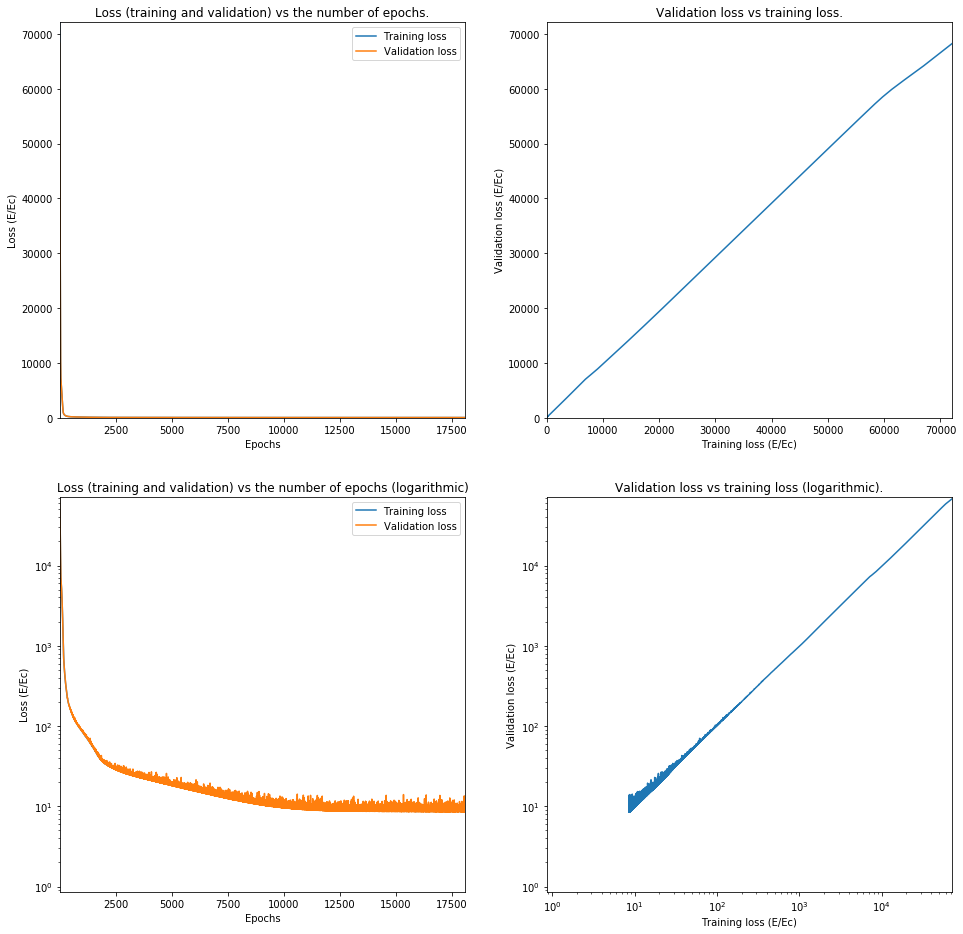

Train on 62644 samples, validate on 15662 samples
Epoch 1/20000
62644/62644 [==============================] - 2s 26us/step - loss: 110861.8771 - val_loss: 104139.7682
Epoch 2/20000
62644/62644 [==============================] - 2s 25us/step - loss: 95200.5956 - val_loss: 89140.7628
Epoch 3/20000
62644/62644 [==============================] - 2s 25us/step - loss: 81090.5197 - val_loss: 75758.4630
Epoch 4/20000
62644/62644 [==============================] - 2s 25us/step - loss: 68954.1648 - val_loss: 64685.3728
Epoch 5/20000
62644/62644 [==============================] - 2s 25us/step - loss: 59720.2803 - val_loss: 56815.0719
Epoch 6/20000
62644/62644 [==============================] - 2s 25us/step - loss: 53658.0850 - val_loss: 51786.0914
Epoch 7/20000
62644/62644 [==============================] - 2s 25us/step - loss: 49870.0215 - val_loss: 48553.6570
Epoch 8/20000
62644/62644 [==============================] - 2s 25us/step - loss: 47410.3303 - val_loss: 46353.1885
Epoch 9/20000
62644/

62644/62644 [==============================] - 2s 25us/step - loss: 431.2997 - val_loss: 429.2603
Epoch 144/20000
62644/62644 [==============================] - 2s 25us/step - loss: 428.3713 - val_loss: 426.6682
Epoch 145/20000
62644/62644 [==============================] - 2s 25us/step - loss: 425.4666 - val_loss: 424.2871
Epoch 146/20000
62644/62644 [==============================] - 2s 25us/step - loss: 422.4388 - val_loss: 420.5151
Epoch 147/20000
62644/62644 [==============================] - 2s 24us/step - loss: 419.7370 - val_loss: 419.0071
Epoch 148/20000
62644/62644 [==============================] - 2s 25us/step - loss: 416.7143 - val_loss: 414.5959
Epoch 149/20000
62644/62644 [==============================] - 2s 25us/step - loss: 413.7873 - val_loss: 412.4330
Epoch 150/20000
62644/62644 [==============================] - 2s 25us/step - loss: 411.0619 - val_loss: 409.1175
Epoch 151/20000
62644/62644 [==============================] - 2s 25us/step - loss: 408.2857 - val_loss:

62644/62644 [==============================] - 2s 25us/step - loss: 232.6899 - val_loss: 231.5461
Epoch 216/20000
62644/62644 [==============================] - 2s 25us/step - loss: 230.1841 - val_loss: 228.9202
Epoch 217/20000
62644/62644 [==============================] - 2s 25us/step - loss: 227.6478 - val_loss: 229.7071
Epoch 218/20000
62644/62644 [==============================] - 2s 25us/step - loss: 225.1207 - val_loss: 223.9801
Epoch 219/20000
62644/62644 [==============================] - 2s 25us/step - loss: 222.7803 - val_loss: 221.3998
Epoch 220/20000
62644/62644 [==============================] - 2s 25us/step - loss: 219.9300 - val_loss: 220.6897
Epoch 221/20000
62644/62644 [==============================] - 2s 25us/step - loss: 217.5679 - val_loss: 216.8685
Epoch 222/20000
62644/62644 [==============================] - 2s 25us/step - loss: 215.1168 - val_loss: 214.4785
Epoch 223/20000
62644/62644 [==============================] - 2s 25us/step - loss: 212.5679 - val_loss:

62644/62644 [==============================] - 2s 26us/step - loss: 90.0566 - val_loss: 89.5597
Epoch 288/20000
62644/62644 [==============================] - 2s 26us/step - loss: 89.0190 - val_loss: 87.9760
Epoch 289/20000
62644/62644 [==============================] - 2s 26us/step - loss: 87.8931 - val_loss: 87.2545
Epoch 290/20000
62644/62644 [==============================] - 2s 26us/step - loss: 86.9612 - val_loss: 87.2376
Epoch 291/20000
62644/62644 [==============================] - 2s 26us/step - loss: 85.8276 - val_loss: 84.4686
Epoch 292/20000
62644/62644 [==============================] - 2s 26us/step - loss: 84.7589 - val_loss: 83.4505
Epoch 293/20000
62644/62644 [==============================] - 2s 26us/step - loss: 83.8714 - val_loss: 82.9034
Epoch 294/20000
62644/62644 [==============================] - 2s 26us/step - loss: 83.0013 - val_loss: 81.9759
Epoch 295/20000
62644/62644 [==============================] - 2s 26us/step - loss: 82.1951 - val_loss: 81.4088
Epoch 29

62644/62644 [==============================] - 2s 25us/step - loss: 42.4730 - val_loss: 41.5309
Epoch 434/20000
62644/62644 [==============================] - 2s 25us/step - loss: 42.3955 - val_loss: 41.3529
Epoch 435/20000
62644/62644 [==============================] - 2s 25us/step - loss: 42.3393 - val_loss: 42.3950
Epoch 436/20000
62644/62644 [==============================] - 2s 26us/step - loss: 41.9821 - val_loss: 43.0149
Epoch 437/20000
62644/62644 [==============================] - 2s 26us/step - loss: 41.9122 - val_loss: 43.9643
Epoch 438/20000
62644/62644 [==============================] - 2s 25us/step - loss: 41.9035 - val_loss: 41.8744
Epoch 439/20000
62644/62644 [==============================] - 2s 26us/step - loss: 41.6192 - val_loss: 41.0187
Epoch 440/20000
62644/62644 [==============================] - 2s 26us/step - loss: 41.5245 - val_loss: 42.7589
Epoch 441/20000
62644/62644 [==============================] - 2s 25us/step - loss: 41.3511 - val_loss: 40.5696
Epoch 44

62644/62644 [==============================] - 2s 25us/step - loss: 28.1743 - val_loss: 28.0255
Epoch 580/20000
62644/62644 [==============================] - 2s 26us/step - loss: 28.1571 - val_loss: 27.7510
Epoch 581/20000
62644/62644 [==============================] - 2s 26us/step - loss: 28.0369 - val_loss: 28.3636
Epoch 582/20000
62644/62644 [==============================] - 2s 26us/step - loss: 27.9977 - val_loss: 28.5833
Epoch 583/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.8926 - val_loss: 28.3589
Epoch 584/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.8517 - val_loss: 27.3098
Epoch 585/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.8872 - val_loss: 27.2869
Epoch 586/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.7808 - val_loss: 28.5276
Epoch 587/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.6583 - val_loss: 27.1746
Epoch 58

62644/62644 [==============================] - 2s 25us/step - loss: 21.6950 - val_loss: 21.3383
Epoch 726/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.5887 - val_loss: 21.7813
Epoch 727/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.6496 - val_loss: 21.3555
Epoch 728/20000
62644/62644 [==============================] - 2s 26us/step - loss: 21.6143 - val_loss: 23.7759
Epoch 729/20000
62644/62644 [==============================] - 2s 26us/step - loss: 21.7000 - val_loss: 21.5304
Epoch 730/20000
62644/62644 [==============================] - 2s 26us/step - loss: 21.5953 - val_loss: 21.7929
Epoch 731/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.5515 - val_loss: 22.2747
Epoch 732/20000
62644/62644 [==============================] - 2s 26us/step - loss: 21.6149 - val_loss: 24.3116
Epoch 733/20000
62644/62644 [==============================] - 2s 25us/step - loss: 21.5365 - val_loss: 21.4168
Epoch 73

62644/62644 [==============================] - 2s 25us/step - loss: 19.4202 - val_loss: 19.2019
Epoch 872/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.4852 - val_loss: 20.3709
Epoch 873/20000
62644/62644 [==============================] - 2s 26us/step - loss: 19.2904 - val_loss: 19.2656
Epoch 874/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.3859 - val_loss: 19.2050
Epoch 875/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.2701 - val_loss: 19.3156
Epoch 876/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.2579 - val_loss: 19.0083
Epoch 877/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.3053 - val_loss: 19.2272
Epoch 878/20000
62644/62644 [==============================] - 2s 26us/step - loss: 19.4055 - val_loss: 20.4984
Epoch 879/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.1551 - val_loss: 19.5645
Epoch 88

62644/62644 [==============================] - 2s 25us/step - loss: 18.2615 - val_loss: 18.2283
Epoch 1018/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.1651 - val_loss: 17.9098
Epoch 1019/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.1714 - val_loss: 19.7898
Epoch 1020/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.2152 - val_loss: 17.9408
Epoch 1021/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.2144 - val_loss: 18.8411
Epoch 1022/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.1808 - val_loss: 18.1659
Epoch 1023/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.1682 - val_loss: 19.8485
Epoch 1024/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.1912 - val_loss: 18.3036
Epoch 1025/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.2165 - val_loss: 18.7014


62644/62644 [==============================] - 2s 26us/step - loss: 17.3314 - val_loss: 17.0750
Epoch 1162/20000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4500 - val_loss: 17.4135
Epoch 1163/20000
62644/62644 [==============================] - 2s 27us/step - loss: 17.3947 - val_loss: 20.0639
Epoch 1164/20000
62644/62644 [==============================] - 2s 27us/step - loss: 17.3605 - val_loss: 17.4815
Epoch 1165/20000
62644/62644 [==============================] - 2s 26us/step - loss: 17.3548 - val_loss: 17.1595
Epoch 1166/20000
62644/62644 [==============================] - 2s 26us/step - loss: 17.3439 - val_loss: 17.3799
Epoch 1167/20000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3244 - val_loss: 17.3850
Epoch 1168/20000
62644/62644 [==============================] - 2s 28us/step - loss: 17.3245 - val_loss: 17.1808
Epoch 1169/20000
62644/62644 [==============================] - 2s 27us/step - loss: 17.3492 - val_loss: 17.8889


62644/62644 [==============================] - 2s 24us/step - loss: 16.6842 - val_loss: 17.3703
Epoch 1306/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.6611 - val_loss: 16.8419
Epoch 1307/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.6993 - val_loss: 16.3339
Epoch 1308/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.6012 - val_loss: 17.0400
Epoch 1309/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.6948 - val_loss: 16.8301
Epoch 1310/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.5775 - val_loss: 17.7517
Epoch 1311/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.6389 - val_loss: 16.4972
Epoch 1312/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.6571 - val_loss: 16.3731
Epoch 1313/20000
62644/62644 [==============================] - 2s 26us/step - loss: 16.6485 - val_loss: 17.0285


62644/62644 [==============================] - 2s 25us/step - loss: 16.0852 - val_loss: 16.0367
Epoch 1450/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.9768 - val_loss: 15.8070
Epoch 1451/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.0179 - val_loss: 16.3730
Epoch 1452/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.9823 - val_loss: 16.0611
Epoch 1453/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.9617 - val_loss: 17.3516
Epoch 1454/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.0761 - val_loss: 15.6589
Epoch 1455/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.9319 - val_loss: 16.3891
Epoch 1456/20000
62644/62644 [==============================] - 2s 26us/step - loss: 16.0003 - val_loss: 15.6940
Epoch 1457/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.9106 - val_loss: 15.7356


62644/62644 [==============================] - 2s 24us/step - loss: 15.4320 - val_loss: 17.6263
Epoch 1594/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.4534 - val_loss: 20.8402
Epoch 1595/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.4229 - val_loss: 16.5099
Epoch 1596/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.4085 - val_loss: 15.4378
Epoch 1597/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.3944 - val_loss: 15.9052
Epoch 1598/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.4174 - val_loss: 15.5842
Epoch 1599/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.4996 - val_loss: 15.9704
Epoch 1600/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.3491 - val_loss: 15.0808
Epoch 1601/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.3976 - val_loss: 15.2937


62644/62644 [==============================] - 2s 25us/step - loss: 14.8215 - val_loss: 15.2764
Epoch 1738/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.9053 - val_loss: 14.4913
Epoch 1739/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8673 - val_loss: 14.7359
Epoch 1740/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8115 - val_loss: 14.7466
Epoch 1741/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.9077 - val_loss: 15.1671
Epoch 1742/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8877 - val_loss: 14.6829
Epoch 1743/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8369 - val_loss: 15.0493
Epoch 1744/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8361 - val_loss: 14.6952
Epoch 1745/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8241 - val_loss: 14.5208


62644/62644 [==============================] - 2s 24us/step - loss: 14.3781 - val_loss: 15.7548
Epoch 1882/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.3465 - val_loss: 14.1111
Epoch 1883/20000
62644/62644 [==============================] - 2s 24us/step - loss: 14.3409 - val_loss: 14.4811
Epoch 1884/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4486 - val_loss: 14.8170
Epoch 1885/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.2713 - val_loss: 13.9789
Epoch 1886/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4335 - val_loss: 14.8571
Epoch 1887/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4124 - val_loss: 14.6508
Epoch 1888/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.2458 - val_loss: 14.0055
Epoch 1889/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.3426 - val_loss: 14.2193


62644/62644 [==============================] - 2s 25us/step - loss: 13.7609 - val_loss: 13.9936
Epoch 2026/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.8748 - val_loss: 16.1587
Epoch 2027/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.8705 - val_loss: 13.8204
Epoch 2028/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.8694 - val_loss: 14.2728
Epoch 2029/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.8078 - val_loss: 13.5008
Epoch 2030/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.9203 - val_loss: 13.4342
Epoch 2031/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.8168 - val_loss: 13.9409
Epoch 2032/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.8592 - val_loss: 13.6335
Epoch 2033/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.7513 - val_loss: 13.9832


62644/62644 [==============================] - 2s 25us/step - loss: 13.3608 - val_loss: 14.2948
Epoch 2170/20000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3662 - val_loss: 13.4318
Epoch 2171/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.3862 - val_loss: 13.0217
Epoch 2172/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3442 - val_loss: 13.0557
Epoch 2173/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.4017 - val_loss: 13.6372
Epoch 2174/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.4389 - val_loss: 13.8686
Epoch 2175/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.4315 - val_loss: 13.5373
Epoch 2176/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.4023 - val_loss: 13.4051
Epoch 2177/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.3902 - val_loss: 13.3972


62644/62644 [==============================] - 2s 25us/step - loss: 12.9532 - val_loss: 14.4137
Epoch 2314/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.9064 - val_loss: 12.7234
Epoch 2315/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.9156 - val_loss: 12.9331
Epoch 2316/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.9024 - val_loss: 12.9185
Epoch 2317/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.9857 - val_loss: 12.6433
Epoch 2318/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.9561 - val_loss: 14.2010
Epoch 2319/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.9149 - val_loss: 13.0103
Epoch 2320/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.8903 - val_loss: 12.6513
Epoch 2321/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.0103 - val_loss: 13.2280


62644/62644 [==============================] - 2s 25us/step - loss: 12.5109 - val_loss: 12.4270
Epoch 2458/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.5887 - val_loss: 15.3859
Epoch 2459/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.5075 - val_loss: 12.4295
Epoch 2460/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4731 - val_loss: 13.9144
Epoch 2461/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.5290 - val_loss: 12.4546
Epoch 2462/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.5480 - val_loss: 14.4292
Epoch 2463/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.6496 - val_loss: 13.4888
Epoch 2464/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4711 - val_loss: 17.1973
Epoch 2465/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.5188 - val_loss: 12.3346


62644/62644 [==============================] - 2s 25us/step - loss: 12.2358 - val_loss: 12.2001
Epoch 2602/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.1732 - val_loss: 13.3648
Epoch 2603/20000
62644/62644 [==============================] - 2s 24us/step - loss: 12.1307 - val_loss: 12.4205
Epoch 2604/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0794 - val_loss: 12.1738
Epoch 2605/20000
62644/62644 [==============================] - 2s 24us/step - loss: 12.2505 - val_loss: 14.4116
Epoch 2606/20000
62644/62644 [==============================] - 2s 24us/step - loss: 12.1499 - val_loss: 13.2836
Epoch 2607/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.1198 - val_loss: 12.0903
Epoch 2608/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.1883 - val_loss: 11.8981
Epoch 2609/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.1385 - val_loss: 11.8944


62644/62644 [==============================] - 2s 24us/step - loss: 11.8626 - val_loss: 11.5646
Epoch 2746/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.8823 - val_loss: 12.2392
Epoch 2747/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8913 - val_loss: 11.9108
Epoch 2748/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8533 - val_loss: 12.6827
Epoch 2749/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.8188 - val_loss: 11.5053
Epoch 2750/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.9049 - val_loss: 12.1959
Epoch 2751/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.9008 - val_loss: 11.7054
Epoch 2752/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.8318 - val_loss: 13.4755
Epoch 2753/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8479 - val_loss: 11.7740


62644/62644 [==============================] - 2s 25us/step - loss: 11.5756 - val_loss: 11.4871
Epoch 2890/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4418 - val_loss: 11.2673
Epoch 2891/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.4825 - val_loss: 11.3963
Epoch 2892/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4845 - val_loss: 11.3610
Epoch 2893/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.5508 - val_loss: 11.5140
Epoch 2894/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.5562 - val_loss: 11.1959
Epoch 2895/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.4683 - val_loss: 11.3145
Epoch 2896/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.4749 - val_loss: 11.4392
Epoch 2897/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.5293 - val_loss: 11.6467


62644/62644 [==============================] - 2s 25us/step - loss: 11.2029 - val_loss: 13.2780
Epoch 3034/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.3055 - val_loss: 11.0261
Epoch 3035/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2242 - val_loss: 10.9490
Epoch 3036/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.2810 - val_loss: 10.9805
Epoch 3037/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.2282 - val_loss: 11.0886
Epoch 3038/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.1350 - val_loss: 11.8061
Epoch 3039/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2071 - val_loss: 10.9001
Epoch 3040/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1858 - val_loss: 11.4832
Epoch 3041/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2760 - val_loss: 12.1605


62644/62644 [==============================] - 2s 25us/step - loss: 11.0497 - val_loss: 10.7465
Epoch 3178/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9904 - val_loss: 11.0456
Epoch 3179/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9652 - val_loss: 10.7824
Epoch 3180/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9200 - val_loss: 12.5219
Epoch 3181/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9769 - val_loss: 10.6727
Epoch 3182/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9694 - val_loss: 10.8300
Epoch 3183/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9220 - val_loss: 10.9020
Epoch 3184/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9581 - val_loss: 12.0246
Epoch 3185/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9452 - val_loss: 14.4423


62644/62644 [==============================] - 2s 25us/step - loss: 10.7288 - val_loss: 10.5151
Epoch 3322/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6706 - val_loss: 11.5100
Epoch 3323/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7375 - val_loss: 10.4798
Epoch 3324/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.6959 - val_loss: 10.9605
Epoch 3325/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7424 - val_loss: 10.4687
Epoch 3326/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.6686 - val_loss: 10.7831
Epoch 3327/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.6996 - val_loss: 11.0528
Epoch 3328/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7398 - val_loss: 10.5047
Epoch 3329/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7077 - val_loss: 12.0660


62644/62644 [==============================] - 2s 25us/step - loss: 10.5002 - val_loss: 10.2867
Epoch 3466/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4798 - val_loss: 10.3171
Epoch 3467/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4723 - val_loss: 10.6298
Epoch 3468/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5351 - val_loss: 10.2391
Epoch 3469/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5070 - val_loss: 10.5333
Epoch 3470/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4264 - val_loss: 10.4091
Epoch 3471/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5403 - val_loss: 10.5685
Epoch 3472/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4724 - val_loss: 10.4752
Epoch 3473/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5777 - val_loss: 11.2864


62644/62644 [==============================] - 2s 25us/step - loss: 10.2949 - val_loss: 10.0979
Epoch 3610/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2744 - val_loss: 10.7786
Epoch 3611/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2760 - val_loss: 11.9438
Epoch 3612/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2984 - val_loss: 10.1002
Epoch 3613/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3016 - val_loss: 10.3406
Epoch 3614/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2965 - val_loss: 10.1917
Epoch 3615/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2711 - val_loss: 10.3155
Epoch 3616/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.3109 - val_loss: 10.1020
Epoch 3617/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.3112 - val_loss: 10.1238


Epoch 3754/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1411 - val_loss: 9.8942
Epoch 3755/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1259 - val_loss: 10.0633
Epoch 3756/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1328 - val_loss: 9.9778
Epoch 3757/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1287 - val_loss: 10.8171
Epoch 3758/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1200 - val_loss: 10.1953
Epoch 3759/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2348 - val_loss: 10.1183
Epoch 3760/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1536 - val_loss: 10.0298
Epoch 3761/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1708 - val_loss: 9.9218
Epoch 3762/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0956 - val_

62644/62644 [==============================] - 2s 26us/step - loss: 10.0070 - val_loss: 9.7179
Epoch 3900/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0084 - val_loss: 10.0781
Epoch 3901/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9815 - val_loss: 9.7223
Epoch 3902/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0287 - val_loss: 9.8017
Epoch 3903/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9449 - val_loss: 9.7748
Epoch 3904/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.9979 - val_loss: 10.3231
Epoch 3905/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9159 - val_loss: 11.7848
Epoch 3906/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9045 - val_loss: 9.7248
Epoch 3907/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0264 - val_loss: 10.0391
Epoch 3908

62644/62644 [==============================] - 2s 26us/step - loss: 9.8090 - val_loss: 9.6762
Epoch 4046/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7679 - val_loss: 9.7521
Epoch 4047/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8002 - val_loss: 9.8462
Epoch 4048/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8227 - val_loss: 10.8217
Epoch 4049/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8339 - val_loss: 9.7969
Epoch 4050/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7939 - val_loss: 9.8064
Epoch 4051/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7620 - val_loss: 9.6572
Epoch 4052/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7725 - val_loss: 9.7636
Epoch 4053/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8933 - val_loss: 10.5790
Epoch 4054/20000

62644/62644 [==============================] - 2s 25us/step - loss: 9.6823 - val_loss: 11.4998
Epoch 4192/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6407 - val_loss: 9.7112
Epoch 4193/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7844 - val_loss: 9.5095
Epoch 4194/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7203 - val_loss: 9.8559
Epoch 4195/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8034 - val_loss: 9.6320
Epoch 4196/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6628 - val_loss: 9.7315
Epoch 4197/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7334 - val_loss: 9.7113
Epoch 4198/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6761 - val_loss: 9.8956
Epoch 4199/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7335 - val_loss: 9.8947
Epoch 4200/20000


Epoch 4338/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6538 - val_loss: 11.0286
Epoch 4339/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5819 - val_loss: 9.5026
Epoch 4340/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6352 - val_loss: 10.1807
Epoch 4341/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5770 - val_loss: 10.4294
Epoch 4342/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5966 - val_loss: 9.9739
Epoch 4343/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6643 - val_loss: 10.2095
Epoch 4344/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5971 - val_loss: 9.3944
Epoch 4345/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5685 - val_loss: 9.5011
Epoch 4346/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6266 - val_loss: 9.50

62644/62644 [==============================] - 2s 26us/step - loss: 9.4698 - val_loss: 9.5318
Epoch 4485/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4582 - val_loss: 10.8008
Epoch 4486/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4976 - val_loss: 10.1236
Epoch 4487/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5163 - val_loss: 10.4521
Epoch 4488/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4959 - val_loss: 9.2759
Epoch 4489/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4702 - val_loss: 9.7559
Epoch 4490/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4983 - val_loss: 9.7680
Epoch 4491/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4815 - val_loss: 9.7703
Epoch 4492/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4843 - val_loss: 9.6321
Epoch 4493/2000

Epoch 4558/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3941 - val_loss: 9.7176
Epoch 4559/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4598 - val_loss: 11.9674
Epoch 4560/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4628 - val_loss: 12.2414
Epoch 4561/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4708 - val_loss: 9.2705
Epoch 4562/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3680 - val_loss: 9.3194
Epoch 4563/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4813 - val_loss: 9.5137
Epoch 4564/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4115 - val_loss: 12.9330
Epoch 4565/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4756 - val_loss: 9.5413
Epoch 4566/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4389 - val_loss: 9.513

Epoch 4705/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3311 - val_loss: 9.5008
Epoch 4706/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3425 - val_loss: 9.1659
Epoch 4707/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3926 - val_loss: 9.7526
Epoch 4708/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3287 - val_loss: 10.6557
Epoch 4709/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3054 - val_loss: 10.2993
Epoch 4710/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3456 - val_loss: 9.7835
Epoch 4711/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3774 - val_loss: 9.3774
Epoch 4712/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3831 - val_loss: 11.2266
Epoch 4713/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3249 - val_loss: 10.87

Epoch 4852/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3333 - val_loss: 9.1841
Epoch 4853/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2932 - val_loss: 9.2911
Epoch 4854/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3439 - val_loss: 9.2106
Epoch 4855/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1879 - val_loss: 9.3091
Epoch 4856/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3031 - val_loss: 11.1003
Epoch 4857/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2975 - val_loss: 10.2823
Epoch 4858/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3708 - val_loss: 9.3352
Epoch 4859/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3410 - val_loss: 9.9154
Epoch 4860/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2547 - val_loss: 9.8334

Epoch 4999/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2337 - val_loss: 9.0766
Epoch 5000/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1640 - val_loss: 9.0552
Epoch 5001/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2589 - val_loss: 9.1093
Epoch 5002/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2225 - val_loss: 9.0702
Epoch 5003/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1669 - val_loss: 9.2778
Epoch 5004/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1774 - val_loss: 9.4563
Epoch 5005/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2028 - val_loss: 10.5765
Epoch 5006/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1267 - val_loss: 9.7924
Epoch 5007/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2759 - val_loss: 9.2635


Epoch 5146/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2077 - val_loss: 9.0281
Epoch 5147/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2019 - val_loss: 9.4491
Epoch 5148/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2330 - val_loss: 9.8312
Epoch 5149/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0680 - val_loss: 9.3521
Epoch 5150/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1860 - val_loss: 9.2414
Epoch 5151/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1850 - val_loss: 9.0791
Epoch 5152/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1120 - val_loss: 9.1097
Epoch 5153/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1560 - val_loss: 10.4340
Epoch 5154/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1684 - val_loss: 9.0463


Epoch 5293/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1438 - val_loss: 8.9937
Epoch 5294/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2316 - val_loss: 9.2802
Epoch 5295/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1168 - val_loss: 9.0030
Epoch 5296/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1332 - val_loss: 9.4710
Epoch 5297/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.0126 - val_loss: 9.7771
Epoch 5298/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.0849 - val_loss: 10.1785
Epoch 5299/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0799 - val_loss: 9.1718
Epoch 5300/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1169 - val_loss: 9.6284
Epoch 5301/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1377 - val_loss: 8.9844


Epoch 5440/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0317 - val_loss: 9.0573
Epoch 5441/20000
62644/62644 [==============================] - 2s 36us/step - loss: 9.1379 - val_loss: 9.1726
Epoch 5442/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0185 - val_loss: 9.2922
Epoch 5443/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1357 - val_loss: 9.5853
Epoch 5444/20000
62644/62644 [==============================] - 3s 41us/step - loss: 9.1124 - val_loss: 9.9540
Epoch 5445/20000
62644/62644 [==============================] - 2s 39us/step - loss: 9.0220 - val_loss: 9.1513
Epoch 5446/20000
62644/62644 [==============================] - 2s 40us/step - loss: 9.0479 - val_loss: 11.9424
Epoch 5447/20000
62644/62644 [==============================] - 2s 36us/step - loss: 9.1084 - val_loss: 9.0722
Epoch 5448/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0521 - val_loss: 9.0902


Epoch 5587/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.0205 - val_loss: 9.8975
Epoch 5588/20000
62644/62644 [==============================] - 2s 36us/step - loss: 9.0186 - val_loss: 8.9923
Epoch 5589/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0330 - val_loss: 8.9910
Epoch 5590/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0783 - val_loss: 9.6876
Epoch 5591/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0039 - val_loss: 9.4239
Epoch 5592/20000
62644/62644 [==============================] - 2s 36us/step - loss: 9.0347 - val_loss: 9.2714
Epoch 5593/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.1171 - val_loss: 9.9413
Epoch 5594/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.0173 - val_loss: 9.6296
Epoch 5595/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.0479 - val_loss: 13.9124


Epoch 5734/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.9628 - val_loss: 8.9065
Epoch 5735/20000
62644/62644 [==============================] - 3s 45us/step - loss: 9.0199 - val_loss: 9.3737
Epoch 5736/20000
62644/62644 [==============================] - 2s 40us/step - loss: 9.0883 - val_loss: 10.2344
Epoch 5737/20000
62644/62644 [==============================] - 2s 40us/step - loss: 8.9788 - val_loss: 9.0644
Epoch 5738/20000
62644/62644 [==============================] - 2s 39us/step - loss: 8.9816 - val_loss: 8.8599
Epoch 5739/20000
62644/62644 [==============================] - 3s 42us/step - loss: 8.9568 - val_loss: 9.0541
Epoch 5740/20000
62644/62644 [==============================] - 3s 41us/step - loss: 8.9894 - val_loss: 9.3270
Epoch 5741/20000
62644/62644 [==============================] - 3s 42us/step - loss: 8.9975 - val_loss: 8.9636
Epoch 5742/20000
62644/62644 [==============================] - 2s 39us/step - loss: 8.9722 - val_loss: 9.5787


Epoch 5881/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9468 - val_loss: 8.9820
Epoch 5882/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9523 - val_loss: 8.9022
Epoch 5883/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9249 - val_loss: 8.9292
Epoch 5884/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9932 - val_loss: 9.3577
Epoch 5885/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9622 - val_loss: 9.0854
Epoch 5886/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9941 - val_loss: 9.0278
Epoch 5887/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0428 - val_loss: 8.8457
Epoch 5888/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9358 - val_loss: 9.0428
Epoch 5889/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9501 - val_loss: 8.8924
E

Epoch 6028/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.0067 - val_loss: 9.0729
Epoch 6029/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8311 - val_loss: 9.0396
Epoch 6030/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9403 - val_loss: 8.8405
Epoch 6031/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.9202 - val_loss: 9.9216
Epoch 6032/20000
62644/62644 [==============================] - 2s 29us/step - loss: 8.9128 - val_loss: 9.1261
Epoch 6033/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9144 - val_loss: 10.0477
Epoch 6034/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.9453 - val_loss: 8.8899
Epoch 6035/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.0254 - val_loss: 9.4789
Epoch 6036/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9594 - val_loss: 9.8867


Epoch 6175/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8445 - val_loss: 8.9982
Epoch 6176/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9809 - val_loss: 8.8738
Epoch 6177/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8910 - val_loss: 9.5537
Epoch 6178/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9592 - val_loss: 9.3460
Epoch 6179/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9003 - val_loss: 9.0680
Epoch 6180/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8715 - val_loss: 9.9249
Epoch 6181/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8256 - val_loss: 8.9862
Epoch 6182/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9336 - val_loss: 8.9434
Epoch 6183/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9204 - val_loss: 8.8312
E

Epoch 6322/20000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8575 - val_loss: 10.0449
Epoch 6323/20000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8099 - val_loss: 9.0795
Epoch 6324/20000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9063 - val_loss: 9.2448
Epoch 6325/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9154 - val_loss: 9.8738
Epoch 6326/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8779 - val_loss: 8.8620
Epoch 6327/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.8429 - val_loss: 8.8625
Epoch 6328/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.9122 - val_loss: 8.8641
Epoch 6329/20000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8247 - val_loss: 8.7913
Epoch 6330/20000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8068 - val_loss: 8.8214


Epoch 6469/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8733 - val_loss: 9.1802
Epoch 6470/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8797 - val_loss: 8.9389
Epoch 6471/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8905 - val_loss: 8.7725
Epoch 6472/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7353 - val_loss: 9.0058
Epoch 6473/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8908 - val_loss: 9.4235
Epoch 6474/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7774 - val_loss: 9.6455
Epoch 6475/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8916 - val_loss: 13.1045
Epoch 6476/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9471 - val_loss: 8.7669
Epoch 6477/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9099 - val_loss: 8.8762


Epoch 6616/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8242 - val_loss: 9.2812
Epoch 6617/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8704 - val_loss: 8.8873
Epoch 6618/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8544 - val_loss: 9.5529
Epoch 6619/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8618 - val_loss: 9.9521
Epoch 6620/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8826 - val_loss: 9.0505
Epoch 6621/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9405 - val_loss: 10.1211
Epoch 6622/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8288 - val_loss: 10.4069
Epoch 6623/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8351 - val_loss: 8.7799
Epoch 6624/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8216 - val_loss: 8.7673

Epoch 6763/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8340 - val_loss: 9.1213
Epoch 6764/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8053 - val_loss: 8.7413
Epoch 6765/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9018 - val_loss: 9.0365
Epoch 6766/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8363 - val_loss: 8.7282
Epoch 6767/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8849 - val_loss: 9.2982
Epoch 6768/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9121 - val_loss: 10.2600
Epoch 6769/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8632 - val_loss: 8.7644
Epoch 6770/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8578 - val_loss: 8.7255
Epoch 6771/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8218 - val_loss: 8.8663


Epoch 6910/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8527 - val_loss: 8.8313
Epoch 6911/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8562 - val_loss: 9.1202
Epoch 6912/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8760 - val_loss: 8.7688
Epoch 6913/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8309 - val_loss: 8.8896
Epoch 6914/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7417 - val_loss: 9.3965
Epoch 6915/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8724 - val_loss: 8.6984
Epoch 6916/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8362 - val_loss: 9.7525
Epoch 6917/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8205 - val_loss: 8.8637
Epoch 6918/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7880 - val_loss: 8.7472
E

Epoch 6984/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8284 - val_loss: 8.7902
Epoch 6985/20000
62644/62644 [==============================] - 2s 29us/step - loss: 8.8240 - val_loss: 9.4128
Epoch 6986/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8092 - val_loss: 9.0253
Epoch 6987/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8185 - val_loss: 8.9090
Epoch 6988/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8135 - val_loss: 8.7365
Epoch 6989/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7787 - val_loss: 8.8355
Epoch 6990/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8339 - val_loss: 8.7302
Epoch 6991/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7568 - val_loss: 8.8229
Epoch 6992/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8326 - val_loss: 8.7365
E

Epoch 7131/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8034 - val_loss: 8.7257
Epoch 7132/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8889 - val_loss: 8.8680
Epoch 7133/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7694 - val_loss: 9.7209
Epoch 7134/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8241 - val_loss: 8.8288
Epoch 7135/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8166 - val_loss: 8.7033
Epoch 7136/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8591 - val_loss: 9.4808
Epoch 7137/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8118 - val_loss: 8.7763
Epoch 7138/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8645 - val_loss: 12.4279
Epoch 7139/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7989 - val_loss: 8.9297


Epoch 7278/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8474 - val_loss: 8.9468
Epoch 7279/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8483 - val_loss: 8.7140
Epoch 7280/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.6928 - val_loss: 9.5932
Epoch 7281/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8399 - val_loss: 9.0356
Epoch 7282/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.8099 - val_loss: 9.2776
Epoch 7283/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.8266 - val_loss: 8.6946
Epoch 7284/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.8528 - val_loss: 8.9248
Epoch 7285/20000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7960 - val_loss: 12.8941
Epoch 7286/20000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7909 - val_loss: 9.2167


Epoch 7425/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8075 - val_loss: 8.9330
Epoch 7426/20000
62644/62644 [==============================] - 2s 29us/step - loss: 8.7940 - val_loss: 8.6730
Epoch 7427/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7977 - val_loss: 9.5823
Epoch 7428/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7348 - val_loss: 8.9702
Epoch 7429/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.8627 - val_loss: 8.8294
Epoch 7430/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8130 - val_loss: 8.6792
Epoch 7431/20000
62644/62644 [==============================] - 2s 29us/step - loss: 8.7714 - val_loss: 8.8064
Epoch 7432/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.8074 - val_loss: 8.7790
Epoch 7433/20000
62644/62644 [==============================] - 2s 29us/step - loss: 8.8646 - val_loss: 8.7266
E

Epoch 7572/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7375 - val_loss: 12.0550
Epoch 7573/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7602 - val_loss: 8.7947
Epoch 7574/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7337 - val_loss: 8.9079
Epoch 7575/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7730 - val_loss: 8.8330
Epoch 7576/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8136 - val_loss: 8.6877
Epoch 7577/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7801 - val_loss: 9.5926
Epoch 7578/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7709 - val_loss: 8.7716
Epoch 7579/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8272 - val_loss: 9.4414
Epoch 7580/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7749 - val_loss: 10.0007

Epoch 7719/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7098 - val_loss: 8.8114
Epoch 7720/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8082 - val_loss: 8.7184
Epoch 7721/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7616 - val_loss: 8.9366
Epoch 7722/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7761 - val_loss: 8.6668
Epoch 7723/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7487 - val_loss: 8.7158
Epoch 7724/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7356 - val_loss: 8.7382
Epoch 7725/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7833 - val_loss: 8.7198
Epoch 7726/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7693 - val_loss: 9.5927
Epoch 7727/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7533 - val_loss: 8.9112
E

Epoch 7866/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7701 - val_loss: 8.9220
Epoch 7867/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7624 - val_loss: 8.9031
Epoch 7868/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8128 - val_loss: 10.1038
Epoch 7869/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8105 - val_loss: 8.7003
Epoch 7870/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7921 - val_loss: 9.2467
Epoch 7871/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8428 - val_loss: 8.6529
Epoch 7872/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8105 - val_loss: 9.0203
Epoch 7873/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7930 - val_loss: 11.4008
Epoch 7874/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8476 - val_loss: 8.7342

Epoch 8013/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6945 - val_loss: 8.9820
Epoch 8014/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7564 - val_loss: 9.1694
Epoch 8015/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7210 - val_loss: 9.3247
Epoch 8016/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7832 - val_loss: 8.9785
Epoch 8017/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7462 - val_loss: 8.7597
Epoch 8018/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7545 - val_loss: 9.7582
Epoch 8019/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8232 - val_loss: 8.7729
Epoch 8020/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7513 - val_loss: 8.7729
Epoch 8021/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7341 - val_loss: 8.9452
E

Epoch 8160/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7904 - val_loss: 8.8374
Epoch 8161/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7127 - val_loss: 8.8931
Epoch 8162/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7529 - val_loss: 8.7318
Epoch 8163/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8353 - val_loss: 9.2553
Epoch 8164/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7644 - val_loss: 9.7670
Epoch 8165/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7745 - val_loss: 8.9037
Epoch 8166/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7019 - val_loss: 10.2781
Epoch 8167/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8414 - val_loss: 8.7497
Epoch 8168/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7579 - val_loss: 8.6679


Epoch 8307/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7470 - val_loss: 9.0799
Epoch 8308/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7730 - val_loss: 8.7193
Epoch 8309/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7027 - val_loss: 9.0034
Epoch 8310/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8463 - val_loss: 8.9988
Epoch 8311/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7504 - val_loss: 9.1457
Epoch 8312/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7415 - val_loss: 9.0430
Epoch 8313/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7119 - val_loss: 9.2440
Epoch 8314/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8180 - val_loss: 9.1708
Epoch 8315/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7914 - val_loss: 8.7504
E

Epoch 8454/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7763 - val_loss: 8.9891
Epoch 8455/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7716 - val_loss: 8.6899
Epoch 8456/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7542 - val_loss: 8.8362
Epoch 8457/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7602 - val_loss: 8.7016
Epoch 8458/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7396 - val_loss: 8.9766
Epoch 8459/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7774 - val_loss: 9.9466
Epoch 8460/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7851 - val_loss: 11.0692
Epoch 8461/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8015 - val_loss: 9.6770
Epoch 8462/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7503 - val_loss: 9.1646


Epoch 8601/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8275 - val_loss: 9.2849
Epoch 8602/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7396 - val_loss: 9.1169
Epoch 8603/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6953 - val_loss: 9.0066
Epoch 8604/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7769 - val_loss: 8.7472
Epoch 8605/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7596 - val_loss: 8.8116
Epoch 8606/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8114 - val_loss: 10.2100
Epoch 8607/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7247 - val_loss: 10.3273
Epoch 8608/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7023 - val_loss: 8.8475
Epoch 8609/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7750 - val_loss: 8.7060

Epoch 8748/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7877 - val_loss: 8.9229
Epoch 8749/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7316 - val_loss: 8.8851
Epoch 8750/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7714 - val_loss: 8.7913
Epoch 8751/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7301 - val_loss: 8.7593
Epoch 8752/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7383 - val_loss: 8.8427
Epoch 8753/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7508 - val_loss: 13.5053
Epoch 8754/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7790 - val_loss: 8.7520
Epoch 8755/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7291 - val_loss: 8.6479
Epoch 8756/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7138 - val_loss: 8.8303


Epoch 8895/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7728 - val_loss: 8.9536
Epoch 8896/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8621 - val_loss: 8.7413
Epoch 8897/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6756 - val_loss: 8.8695
Epoch 8898/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7703 - val_loss: 8.6511
Epoch 8899/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7727 - val_loss: 9.5539
Epoch 8900/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6912 - val_loss: 9.3972
Epoch 8901/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8418 - val_loss: 8.9656
Epoch 8902/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7841 - val_loss: 12.3364
Epoch 8903/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7472 - val_loss: 9.5060


Epoch 9042/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7189 - val_loss: 8.6536
Epoch 9043/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7717 - val_loss: 8.6293
Epoch 9044/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6948 - val_loss: 11.9886
Epoch 9045/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7668 - val_loss: 9.2185
Epoch 9046/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7492 - val_loss: 8.6261
Epoch 9047/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7609 - val_loss: 8.6306
Epoch 9048/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7159 - val_loss: 8.6922
Epoch 9049/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7733 - val_loss: 8.6209
Epoch 9050/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7121 - val_loss: 8.9802


Epoch 9189/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7915 - val_loss: 8.6283
Epoch 9190/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7498 - val_loss: 9.0777
Epoch 9191/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7074 - val_loss: 8.8320
Epoch 9192/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7546 - val_loss: 8.6045
Epoch 9193/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7298 - val_loss: 8.9972
Epoch 9194/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7746 - val_loss: 8.7199
Epoch 9195/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6798 - val_loss: 8.9009
Epoch 9196/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6864 - val_loss: 8.7722
Epoch 9197/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7406 - val_loss: 9.1389
E

Epoch 9336/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8116 - val_loss: 8.6966
Epoch 9337/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7228 - val_loss: 8.6635
Epoch 9338/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7302 - val_loss: 10.5043
Epoch 9339/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7339 - val_loss: 8.6038
Epoch 9340/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7186 - val_loss: 9.9279
Epoch 9341/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7132 - val_loss: 8.6935
Epoch 9342/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6565 - val_loss: 8.7070
Epoch 9343/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7980 - val_loss: 11.3580
Epoch 9344/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6750 - val_loss: 9.7473

Epoch 9483/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7552 - val_loss: 8.7584
Epoch 9484/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6673 - val_loss: 11.2122
Epoch 9485/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8038 - val_loss: 8.8649
Epoch 9486/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6833 - val_loss: 8.7421
Epoch 9487/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7938 - val_loss: 8.8375
Epoch 9488/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7230 - val_loss: 8.8418
Epoch 9489/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7012 - val_loss: 8.7550
Epoch 9490/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6754 - val_loss: 8.7703
Epoch 9491/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7230 - val_loss: 8.6343


Epoch 9630/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7309 - val_loss: 9.6092
Epoch 9631/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6883 - val_loss: 10.1753
Epoch 9632/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.8126 - val_loss: 9.6073
Epoch 9633/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7575 - val_loss: 9.2071
Epoch 9634/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7140 - val_loss: 11.1350
Epoch 9635/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7823 - val_loss: 8.7696
Epoch 9636/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7911 - val_loss: 8.6143
Epoch 9637/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7395 - val_loss: 9.2022
Epoch 9638/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7413 - val_loss: 9.5753

Epoch 9777/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7235 - val_loss: 9.1189
Epoch 9778/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6807 - val_loss: 8.7607
Epoch 9779/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7478 - val_loss: 8.6208
Epoch 9780/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7057 - val_loss: 8.7530
Epoch 9781/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7425 - val_loss: 8.7481
Epoch 9782/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6648 - val_loss: 9.3877
Epoch 9783/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7711 - val_loss: 8.7973
Epoch 9784/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7005 - val_loss: 9.0087
Epoch 9785/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7175 - val_loss: 9.5176
E

Epoch 9924/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7108 - val_loss: 8.5913
Epoch 9925/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6851 - val_loss: 8.8834
Epoch 9926/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7181 - val_loss: 9.5664
Epoch 9927/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7459 - val_loss: 8.7218
Epoch 9928/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7223 - val_loss: 8.7301
Epoch 9929/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7121 - val_loss: 8.8458
Epoch 9930/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7202 - val_loss: 8.6222
Epoch 9931/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6940 - val_loss: 9.9193
Epoch 9932/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7199 - val_loss: 11.5720


62644/62644 [==============================] - 2s 25us/step - loss: 8.7793 - val_loss: 9.9159
Epoch 10071/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7474 - val_loss: 8.6002
Epoch 10072/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6982 - val_loss: 9.8674
Epoch 10073/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6686 - val_loss: 8.8436
Epoch 10074/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6649 - val_loss: 8.8778
Epoch 10075/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7238 - val_loss: 9.2265
Epoch 10076/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6871 - val_loss: 8.8373
Epoch 10077/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7392 - val_loss: 9.6187
Epoch 10078/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7370 - val_loss: 9.0665
Epoch 1007

62644/62644 [==============================] - 2s 25us/step - loss: 8.7096 - val_loss: 8.5794
Epoch 10217/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7132 - val_loss: 8.6658
Epoch 10218/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7824 - val_loss: 8.7744
Epoch 10219/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7418 - val_loss: 8.5988
Epoch 10220/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8041 - val_loss: 8.8267
Epoch 10221/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6766 - val_loss: 8.6336
Epoch 10222/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7380 - val_loss: 9.0566
Epoch 10223/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7815 - val_loss: 10.6078
Epoch 10224/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7538 - val_loss: 8.7432
Epoch 102

62644/62644 [==============================] - 2s 25us/step - loss: 8.6948 - val_loss: 10.9237
Epoch 10363/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7805 - val_loss: 9.3325
Epoch 10364/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7206 - val_loss: 8.6268
Epoch 10365/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7266 - val_loss: 8.7557
Epoch 10366/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7535 - val_loss: 8.5950
Epoch 10367/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7671 - val_loss: 10.0735
Epoch 10368/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7878 - val_loss: 8.8132
Epoch 10369/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7472 - val_loss: 8.8352
Epoch 10370/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6876 - val_loss: 8.7883
Epoch 10

62644/62644 [==============================] - 2s 24us/step - loss: 8.7181 - val_loss: 9.6231
Epoch 10509/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7361 - val_loss: 8.6457
Epoch 10510/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7091 - val_loss: 8.9187
Epoch 10511/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6766 - val_loss: 8.6511
Epoch 10512/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8166 - val_loss: 8.6323
Epoch 10513/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7824 - val_loss: 8.8629
Epoch 10514/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7036 - val_loss: 8.6272
Epoch 10515/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6600 - val_loss: 9.5039
Epoch 10516/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6992 - val_loss: 8.6461
Epoch 1051

62644/62644 [==============================] - 2s 25us/step - loss: 8.7089 - val_loss: 8.7198
Epoch 10655/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7028 - val_loss: 9.6998
Epoch 10656/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7741 - val_loss: 11.2861
Epoch 10657/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7369 - val_loss: 10.2764
Epoch 10658/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6426 - val_loss: 8.6466
Epoch 10659/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7125 - val_loss: 8.6465
Epoch 10660/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7475 - val_loss: 10.8340
Epoch 10661/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6206 - val_loss: 8.6404
Epoch 10662/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7047 - val_loss: 9.3226
Epoch 1

62644/62644 [==============================] - 2s 25us/step - loss: 8.7868 - val_loss: 8.6087
Epoch 10801/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6583 - val_loss: 9.5492
Epoch 10802/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6677 - val_loss: 9.5123
Epoch 10803/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7150 - val_loss: 8.6288
Epoch 10804/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7137 - val_loss: 9.3301
Epoch 10805/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6753 - val_loss: 8.6613
Epoch 10806/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6996 - val_loss: 8.6304
Epoch 10807/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7161 - val_loss: 11.2005
Epoch 10808/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7295 - val_loss: 8.8826
Epoch 108

62644/62644 [==============================] - 2s 25us/step - loss: 8.7092 - val_loss: 8.6368
Epoch 10947/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7269 - val_loss: 8.9584
Epoch 10948/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6303 - val_loss: 8.6112
Epoch 10949/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7503 - val_loss: 8.9237
Epoch 10950/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7033 - val_loss: 8.9153
Epoch 10951/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7329 - val_loss: 9.0971
Epoch 10952/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6957 - val_loss: 9.6449
Epoch 10953/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7495 - val_loss: 9.2193
Epoch 10954/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7613 - val_loss: 8.6058
Epoch 1095

62644/62644 [==============================] - 2s 25us/step - loss: 8.7915 - val_loss: 8.5769
Epoch 11093/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6991 - val_loss: 8.5859
Epoch 11094/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7981 - val_loss: 8.8418
Epoch 11095/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6780 - val_loss: 9.0330
Epoch 11096/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7140 - val_loss: 9.0085
Epoch 11097/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6718 - val_loss: 8.6499
Epoch 11098/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6808 - val_loss: 8.9433
Epoch 11099/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6961 - val_loss: 8.7493
Epoch 11100/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6685 - val_loss: 8.9508
Epoch 1110

62644/62644 [==============================] - 2s 25us/step - loss: 8.7063 - val_loss: 9.3229
Epoch 11239/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6694 - val_loss: 9.3392
Epoch 11240/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7301 - val_loss: 8.8784
Epoch 11241/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6793 - val_loss: 8.7022
Epoch 11242/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6486 - val_loss: 10.2334
Epoch 11243/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6953 - val_loss: 8.6753
Epoch 11244/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6580 - val_loss: 9.0120
Epoch 11245/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6940 - val_loss: 8.6178
Epoch 11246/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7086 - val_loss: 8.6927
Epoch 112

62644/62644 [==============================] - 2s 25us/step - loss: 8.6633 - val_loss: 8.6189
Epoch 11385/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6741 - val_loss: 8.6507
Epoch 11386/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7257 - val_loss: 8.6040
Epoch 11387/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6960 - val_loss: 10.1218
Epoch 11388/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6160 - val_loss: 8.7256
Epoch 11389/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7102 - val_loss: 8.6367
Epoch 11390/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6054 - val_loss: 8.5844
Epoch 11391/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7045 - val_loss: 9.4318
Epoch 11392/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6810 - val_loss: 8.6867
Epoch 113

62644/62644 [==============================] - 2s 25us/step - loss: 8.7274 - val_loss: 8.5750
Epoch 11531/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7139 - val_loss: 8.5790
Epoch 11532/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7622 - val_loss: 9.1117
Epoch 11533/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7123 - val_loss: 9.5495
Epoch 11534/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6509 - val_loss: 9.1009
Epoch 11535/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7469 - val_loss: 8.8742
Epoch 11536/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7278 - val_loss: 9.5046
Epoch 11537/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6737 - val_loss: 9.4146
Epoch 11538/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6645 - val_loss: 8.8390
Epoch 1153

62644/62644 [==============================] - 2s 24us/step - loss: 8.7323 - val_loss: 8.9608
Epoch 11677/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6712 - val_loss: 8.6507
Epoch 11678/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6324 - val_loss: 9.3662
Epoch 11679/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6930 - val_loss: 9.0079
Epoch 11680/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6554 - val_loss: 8.8015
Epoch 11681/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7353 - val_loss: 8.5915
Epoch 11682/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7757 - val_loss: 9.4973
Epoch 11683/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6427 - val_loss: 9.2965
Epoch 11684/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6181 - val_loss: 8.7652
Epoch 1168

62644/62644 [==============================] - 2s 24us/step - loss: 8.6600 - val_loss: 8.7850
Epoch 11823/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6935 - val_loss: 8.6151
Epoch 11824/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7191 - val_loss: 9.1792
Epoch 11825/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6544 - val_loss: 8.6522
Epoch 11826/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6870 - val_loss: 9.0885
Epoch 11827/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6513 - val_loss: 9.3648
Epoch 11828/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.5861 - val_loss: 8.8155
Epoch 11829/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6749 - val_loss: 8.7600
Epoch 11830/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6657 - val_loss: 8.6352
Epoch 1183

62644/62644 [==============================] - 2s 25us/step - loss: 8.6641 - val_loss: 9.7257
Epoch 11969/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6719 - val_loss: 8.7262
Epoch 11970/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6699 - val_loss: 8.7842
Epoch 11971/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6848 - val_loss: 9.3363
Epoch 11972/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7025 - val_loss: 8.7181
Epoch 11973/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6739 - val_loss: 8.7029
Epoch 11974/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7312 - val_loss: 8.6190
Epoch 11975/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6810 - val_loss: 8.6721
Epoch 11976/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6788 - val_loss: 8.6376
Epoch 1197

62644/62644 [==============================] - 2s 25us/step - loss: 8.6356 - val_loss: 9.3219
Epoch 12115/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6063 - val_loss: 9.2575
Epoch 12116/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6589 - val_loss: 9.1374
Epoch 12117/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6113 - val_loss: 8.9529
Epoch 12118/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7456 - val_loss: 8.6734
Epoch 12119/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7542 - val_loss: 8.8150
Epoch 12120/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6579 - val_loss: 8.5707
Epoch 12121/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7412 - val_loss: 9.3267
Epoch 12122/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6674 - val_loss: 8.5660
Epoch 1212

62644/62644 [==============================] - 2s 25us/step - loss: 8.6548 - val_loss: 9.5492
Epoch 12261/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7431 - val_loss: 8.9456
Epoch 12262/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6899 - val_loss: 10.5992
Epoch 12263/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6942 - val_loss: 8.6643
Epoch 12264/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7196 - val_loss: 9.1373
Epoch 12265/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6476 - val_loss: 8.6620
Epoch 12266/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7392 - val_loss: 8.8157
Epoch 12267/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6736 - val_loss: 9.3444
Epoch 12268/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7285 - val_loss: 8.6596
Epoch 122

62644/62644 [==============================] - 2s 24us/step - loss: 8.6751 - val_loss: 8.8170
Epoch 12407/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6923 - val_loss: 9.2313
Epoch 12408/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6514 - val_loss: 8.6167
Epoch 12409/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.7275 - val_loss: 9.2413
Epoch 12410/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6416 - val_loss: 9.0001
Epoch 12411/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6519 - val_loss: 8.6543
Epoch 12412/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6055 - val_loss: 9.1332
Epoch 12413/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6787 - val_loss: 8.7310
Epoch 12414/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6642 - val_loss: 8.5601
Epoch 1241

62644/62644 [==============================] - 2s 25us/step - loss: 8.6775 - val_loss: 9.4527
Epoch 12553/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7618 - val_loss: 8.7922
Epoch 12554/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6633 - val_loss: 9.7329
Epoch 12555/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6309 - val_loss: 8.8737
Epoch 12556/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6278 - val_loss: 8.5599
Epoch 12557/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6945 - val_loss: 8.7191
Epoch 12558/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7021 - val_loss: 8.7690
Epoch 12559/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7431 - val_loss: 9.1896
Epoch 12560/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7458 - val_loss: 9.0384
Epoch 1256

62644/62644 [==============================] - 2s 24us/step - loss: 8.6482 - val_loss: 8.5895
Epoch 12699/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.6702 - val_loss: 9.0958
Epoch 12700/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7141 - val_loss: 9.1386
Epoch 12701/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6515 - val_loss: 8.6106
Epoch 12702/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7379 - val_loss: 11.0534
Epoch 12703/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7157 - val_loss: 9.5009
Epoch 12704/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7226 - val_loss: 8.5992
Epoch 12705/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6989 - val_loss: 8.5599
Epoch 12706/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.6937 - val_loss: 8.6288
Epoch 127

62644/62644 [==============================] - 2s 25us/step - loss: 8.7684 - val_loss: 8.9162
Epoch 12845/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7426 - val_loss: 8.5752
Epoch 12846/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6916 - val_loss: 10.7136
Epoch 12847/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6164 - val_loss: 8.7164
Epoch 12848/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7361 - val_loss: 9.8186
Epoch 12849/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6649 - val_loss: 8.8682
Epoch 12850/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6763 - val_loss: 9.3155
Epoch 12851/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6287 - val_loss: 9.1565
Epoch 12852/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6646 - val_loss: 8.6340
Epoch 128

62644/62644 [==============================] - 2s 25us/step - loss: 8.6744 - val_loss: 8.6864
Epoch 12991/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6570 - val_loss: 9.1248
Epoch 12992/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6764 - val_loss: 8.6933
Epoch 12993/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7555 - val_loss: 8.9090
Epoch 12994/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6766 - val_loss: 8.8121
Epoch 12995/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6453 - val_loss: 8.7838
Epoch 12996/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8001 - val_loss: 8.7777
Epoch 12997/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7331 - val_loss: 9.5613
Epoch 12998/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7644 - val_loss: 8.6651
Epoch 1299

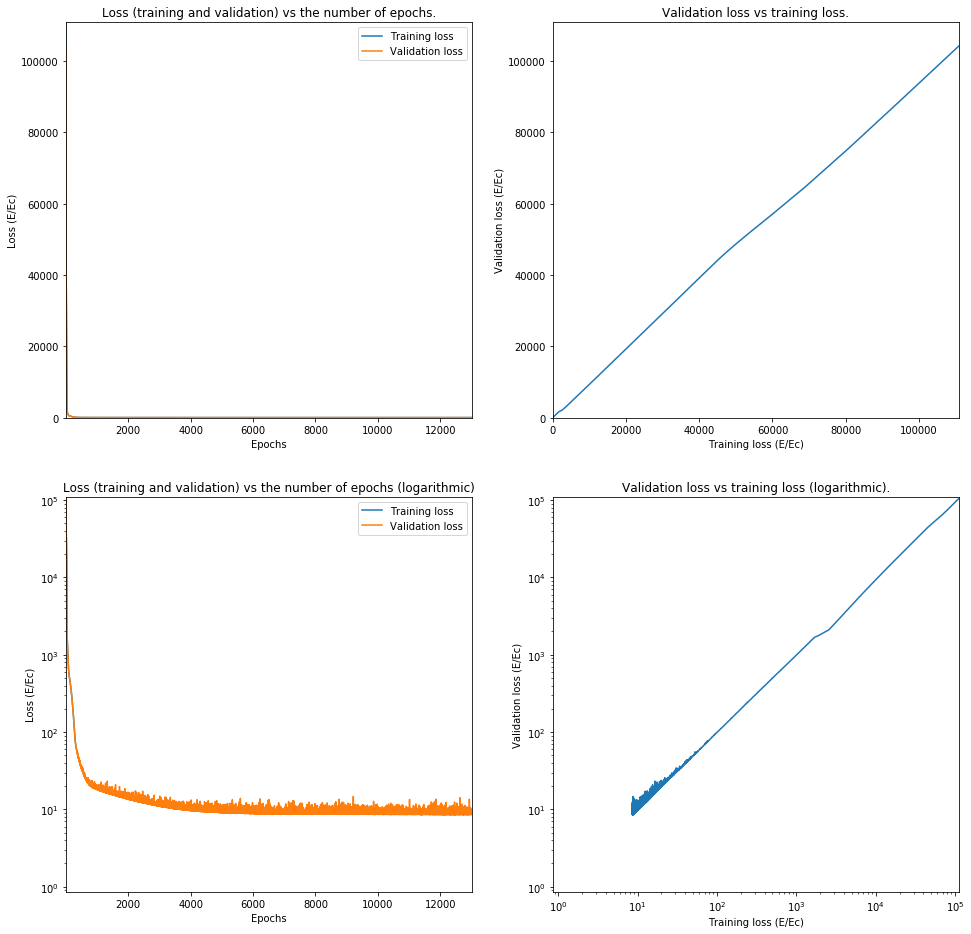

Train on 62644 samples, validate on 15662 samples
Epoch 1/20000
62644/62644 [==============================] - 2s 27us/step - loss: 456484.2870 - val_loss: 449620.6438
Epoch 2/20000
62644/62644 [==============================] - 2s 25us/step - loss: 438383.9671 - val_loss: 431460.8151
Epoch 3/20000
62644/62644 [==============================] - 2s 25us/step - loss: 420293.6520 - val_loss: 413272.6348
Epoch 4/20000
62644/62644 [==============================] - 2s 25us/step - loss: 402228.1124 - val_loss: 395131.2328
Epoch 5/20000
62644/62644 [==============================] - 2s 25us/step - loss: 384134.6027 - val_loss: 376939.7367
Epoch 6/20000
62644/62644 [==============================] - 2s 25us/step - loss: 366027.4892 - val_loss: 358746.8498
Epoch 7/20000
62644/62644 [==============================] - 2s 25us/step - loss: 347980.5154 - val_loss: 340641.4864
Epoch 8/20000
62644/62644 [==============================] - 2s 25us/step - loss: 329929.5708 - val_loss: 322490.2865
Epoch 

62644/62644 [==============================] - 2s 25us/step - loss: 129.0084 - val_loss: 127.9194
Epoch 144/20000
62644/62644 [==============================] - 2s 25us/step - loss: 126.3924 - val_loss: 125.0297
Epoch 145/20000
62644/62644 [==============================] - 2s 25us/step - loss: 123.4811 - val_loss: 122.7543
Epoch 146/20000
62644/62644 [==============================] - 2s 25us/step - loss: 120.9791 - val_loss: 120.0629
Epoch 147/20000
62644/62644 [==============================] - 2s 25us/step - loss: 118.2728 - val_loss: 117.3306
Epoch 148/20000
62644/62644 [==============================] - 2s 25us/step - loss: 115.8314 - val_loss: 114.6339
Epoch 149/20000
62644/62644 [==============================] - 2s 25us/step - loss: 113.0909 - val_loss: 112.3665
Epoch 150/20000
62644/62644 [==============================] - 2s 25us/step - loss: 110.4476 - val_loss: 109.3228
Epoch 151/20000
62644/62644 [==============================] - 2s 25us/step - loss: 107.7279 - val_loss:

62644/62644 [==============================] - 2s 25us/step - loss: 25.2877 - val_loss: 29.6152
Epoch 217/20000
62644/62644 [==============================] - 2s 25us/step - loss: 25.1658 - val_loss: 25.4193
Epoch 218/20000
62644/62644 [==============================] - 2s 25us/step - loss: 25.0954 - val_loss: 25.1887
Epoch 219/20000
62644/62644 [==============================] - 2s 25us/step - loss: 24.8817 - val_loss: 25.6316
Epoch 220/20000
62644/62644 [==============================] - 2s 25us/step - loss: 24.8701 - val_loss: 26.1311
Epoch 221/20000
62644/62644 [==============================] - 2s 25us/step - loss: 24.8849 - val_loss: 25.4831
Epoch 222/20000
62644/62644 [==============================] - 2s 25us/step - loss: 24.6133 - val_loss: 24.5881
Epoch 223/20000
62644/62644 [==============================] - 2s 25us/step - loss: 24.6687 - val_loss: 24.8322
Epoch 224/20000
62644/62644 [==============================] - 2s 25us/step - loss: 24.5211 - val_loss: 25.1273
Epoch 22

62644/62644 [==============================] - 2s 25us/step - loss: 17.9304 - val_loss: 17.8518
Epoch 363/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.9333 - val_loss: 20.8997
Epoch 364/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.9824 - val_loss: 19.2732
Epoch 365/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.8852 - val_loss: 18.1349
Epoch 366/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.8537 - val_loss: 17.7647
Epoch 367/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.8143 - val_loss: 18.3378
Epoch 368/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.7835 - val_loss: 18.4843
Epoch 369/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.7539 - val_loss: 17.6549
Epoch 370/20000
62644/62644 [==============================] - 2s 25us/step - loss: 17.6508 - val_loss: 18.6948
Epoch 37

62644/62644 [==============================] - 2s 25us/step - loss: 14.5278 - val_loss: 14.5740
Epoch 509/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.5008 - val_loss: 15.0120
Epoch 510/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4052 - val_loss: 14.3909
Epoch 511/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4765 - val_loss: 14.9603
Epoch 512/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4313 - val_loss: 14.3088
Epoch 513/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4041 - val_loss: 14.3548
Epoch 514/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4919 - val_loss: 14.5002
Epoch 515/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.3991 - val_loss: 15.5310
Epoch 516/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4585 - val_loss: 18.6615
Epoch 51

62644/62644 [==============================] - 2s 25us/step - loss: 12.5397 - val_loss: 12.4916
Epoch 655/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4313 - val_loss: 12.6679
Epoch 656/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.5856 - val_loss: 12.3734
Epoch 657/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4360 - val_loss: 13.4550
Epoch 658/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4379 - val_loss: 14.5203
Epoch 659/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4076 - val_loss: 13.7254
Epoch 660/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4680 - val_loss: 12.2499
Epoch 661/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.3902 - val_loss: 12.8576
Epoch 662/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4126 - val_loss: 13.6310
Epoch 66

62644/62644 [==============================] - 2s 27us/step - loss: 11.2890 - val_loss: 11.1223
Epoch 801/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4055 - val_loss: 11.0646
Epoch 802/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2013 - val_loss: 11.4733
Epoch 803/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2335 - val_loss: 11.0289
Epoch 804/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2442 - val_loss: 11.7404
Epoch 805/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2709 - val_loss: 11.1057
Epoch 806/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2550 - val_loss: 11.6147
Epoch 807/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2913 - val_loss: 11.2006
Epoch 808/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1447 - val_loss: 11.0981
Epoch 80

62644/62644 [==============================] - 2s 25us/step - loss: 10.6214 - val_loss: 11.4255
Epoch 947/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5782 - val_loss: 10.8289
Epoch 948/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5826 - val_loss: 10.7912
Epoch 949/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5998 - val_loss: 10.3624
Epoch 950/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5489 - val_loss: 10.8616
Epoch 951/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5630 - val_loss: 10.9745
Epoch 952/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5338 - val_loss: 11.2110
Epoch 953/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5499 - val_loss: 11.4095
Epoch 954/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.6247 - val_loss: 11.1181
Epoch 95

62644/62644 [==============================] - 2s 25us/step - loss: 10.3414 - val_loss: 10.1777
Epoch 1020/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3731 - val_loss: 12.6066
Epoch 1021/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3605 - val_loss: 10.6022
Epoch 1022/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3204 - val_loss: 11.2164
Epoch 1023/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4032 - val_loss: 11.4654
Epoch 1024/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3569 - val_loss: 10.2476
Epoch 1025/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3036 - val_loss: 10.3199
Epoch 1026/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3056 - val_loss: 10.5471
Epoch 1027/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3375 - val_loss: 10.7654


62644/62644 [==============================] - 2s 25us/step - loss: 10.1209 - val_loss: 9.9790
Epoch 1164/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0216 - val_loss: 9.9294
Epoch 1165/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0228 - val_loss: 9.9374
Epoch 1166/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0138 - val_loss: 10.1713
Epoch 1167/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9981 - val_loss: 9.9271
Epoch 1168/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0098 - val_loss: 9.9797
Epoch 1169/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0405 - val_loss: 10.3294
Epoch 1170/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0058 - val_loss: 9.9805
Epoch 1171/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0502 - val_loss: 10.2065
Epoch 1

62644/62644 [==============================] - 2s 25us/step - loss: 9.9429 - val_loss: 9.9200
Epoch 1310/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8494 - val_loss: 10.1284
Epoch 1311/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8184 - val_loss: 10.0633
Epoch 1312/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8347 - val_loss: 10.7280
Epoch 1313/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8340 - val_loss: 10.1044
Epoch 1314/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9408 - val_loss: 10.6184
Epoch 1315/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8507 - val_loss: 10.1440
Epoch 1316/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8351 - val_loss: 10.2145
Epoch 1317/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8768 - val_loss: 10.3447
Epoch 1318

62644/62644 [==============================] - 2s 25us/step - loss: 9.7285 - val_loss: 11.8728
Epoch 1456/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7794 - val_loss: 9.6922
Epoch 1457/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6441 - val_loss: 9.7841
Epoch 1458/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6827 - val_loss: 9.6183
Epoch 1459/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7259 - val_loss: 10.2783
Epoch 1460/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7398 - val_loss: 10.1973
Epoch 1461/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6726 - val_loss: 10.7307
Epoch 1462/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7214 - val_loss: 9.9593
Epoch 1463/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6932 - val_loss: 10.0389
Epoch 1464/20

62644/62644 [==============================] - 2s 26us/step - loss: 9.6601 - val_loss: 9.6933
Epoch 1602/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5938 - val_loss: 9.6199
Epoch 1603/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5790 - val_loss: 9.5785
Epoch 1604/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6492 - val_loss: 10.4752
Epoch 1605/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5064 - val_loss: 9.6470
Epoch 1606/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6431 - val_loss: 9.6948
Epoch 1607/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5616 - val_loss: 9.5189
Epoch 1608/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6314 - val_loss: 9.5690
Epoch 1609/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5769 - val_loss: 9.6752
Epoch 1610/20000


62644/62644 [==============================] - 2s 25us/step - loss: 9.4909 - val_loss: 11.0758
Epoch 1748/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4895 - val_loss: 10.0463
Epoch 1749/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5731 - val_loss: 10.2291
Epoch 1750/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4733 - val_loss: 10.0261
Epoch 1751/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4221 - val_loss: 10.9384
Epoch 1752/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4523 - val_loss: 9.4787
Epoch 1753/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5109 - val_loss: 9.9069
Epoch 1754/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5833 - val_loss: 9.8027
Epoch 1755/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5651 - val_loss: 10.0013
Epoch 1756/2

Epoch 1894/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4337 - val_loss: 9.5893
Epoch 1895/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3735 - val_loss: 9.9843
Epoch 1896/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4116 - val_loss: 9.8841
Epoch 1897/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4845 - val_loss: 9.8166
Epoch 1898/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3818 - val_loss: 9.6367
Epoch 1899/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4350 - val_loss: 9.3533
Epoch 1900/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4219 - val_loss: 10.9914
Epoch 1901/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4351 - val_loss: 10.8230
Epoch 1902/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4453 - val_loss: 9.4322

Epoch 2041/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4072 - val_loss: 9.3307
Epoch 2042/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3552 - val_loss: 10.0416
Epoch 2043/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2923 - val_loss: 9.6865
Epoch 2044/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4302 - val_loss: 9.7983
Epoch 2045/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3747 - val_loss: 10.3720
Epoch 2046/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3368 - val_loss: 9.5261
Epoch 2047/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3773 - val_loss: 9.3224
Epoch 2048/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3159 - val_loss: 9.4276
Epoch 2049/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4066 - val_loss: 9.8821

Epoch 2188/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2785 - val_loss: 9.3658
Epoch 2189/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3715 - val_loss: 10.2607
Epoch 2190/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3026 - val_loss: 10.3417
Epoch 2191/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2782 - val_loss: 10.0252
Epoch 2192/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2907 - val_loss: 10.3312
Epoch 2193/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3055 - val_loss: 9.3288
Epoch 2194/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3490 - val_loss: 9.6424
Epoch 2195/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3387 - val_loss: 9.2661
Epoch 2196/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2803 - val_loss: 10.2

62644/62644 [==============================] - 2s 25us/step - loss: 9.2018 - val_loss: 9.2472
Epoch 2335/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2522 - val_loss: 12.8783
Epoch 2336/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3190 - val_loss: 9.4435
Epoch 2337/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3071 - val_loss: 10.5827
Epoch 2338/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2633 - val_loss: 9.9957
Epoch 2339/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2261 - val_loss: 9.9071
Epoch 2340/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2790 - val_loss: 9.4355
Epoch 2341/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3173 - val_loss: 9.4587
Epoch 2342/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2712 - val_loss: 9.8462
Epoch 2343/20000

Epoch 2408/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2615 - val_loss: 9.5446
Epoch 2409/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2350 - val_loss: 9.3441
Epoch 2410/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2670 - val_loss: 10.6602
Epoch 2411/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2904 - val_loss: 9.2694
Epoch 2412/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2069 - val_loss: 9.4850
Epoch 2413/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2351 - val_loss: 11.0970
Epoch 2414/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3589 - val_loss: 12.9631
Epoch 2415/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2573 - val_loss: 9.5928
Epoch 2416/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3410 - val_loss: 9.162

62644/62644 [==============================] - 2s 25us/step - loss: 9.1983 - val_loss: 10.9404
Epoch 2555/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1909 - val_loss: 9.2182
Epoch 2556/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2582 - val_loss: 10.5461
Epoch 2557/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2472 - val_loss: 9.2684
Epoch 2558/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2219 - val_loss: 9.3000
Epoch 2559/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1633 - val_loss: 9.5411
Epoch 2560/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2380 - val_loss: 9.3359
Epoch 2561/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2511 - val_loss: 9.2205
Epoch 2562/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1965 - val_loss: 9.2991
Epoch 2563/20000

Epoch 2628/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2204 - val_loss: 9.4807
Epoch 2629/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2470 - val_loss: 9.3669
Epoch 2630/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1030 - val_loss: 9.3119
Epoch 2631/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2049 - val_loss: 9.1746
Epoch 2632/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1724 - val_loss: 9.6004
Epoch 2633/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2512 - val_loss: 9.1555
Epoch 2634/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1623 - val_loss: 9.6257
Epoch 2635/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1818 - val_loss: 9.3507
Epoch 2636/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1633 - val_loss: 9.1642
E

Epoch 2775/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1922 - val_loss: 11.0790
Epoch 2776/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2295 - val_loss: 10.3606
Epoch 2777/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1354 - val_loss: 9.3152
Epoch 2778/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2097 - val_loss: 10.1039
Epoch 2779/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1450 - val_loss: 9.0945
Epoch 2780/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2400 - val_loss: 9.4928
Epoch 2781/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1701 - val_loss: 9.1489
Epoch 2782/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2127 - val_loss: 9.5665
Epoch 2783/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2481 - val_loss: 9.145

Epoch 2922/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1340 - val_loss: 9.1546
Epoch 2923/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1627 - val_loss: 9.3472
Epoch 2924/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1397 - val_loss: 9.1344
Epoch 2925/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1132 - val_loss: 9.0828
Epoch 2926/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0882 - val_loss: 11.5987
Epoch 2927/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1540 - val_loss: 9.3064
Epoch 2928/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1455 - val_loss: 9.3482
Epoch 2929/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1720 - val_loss: 9.3384
Epoch 2930/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1337 - val_loss: 9.8740


Epoch 3069/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0355 - val_loss: 9.2560
Epoch 3070/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1224 - val_loss: 10.3631
Epoch 3071/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0604 - val_loss: 9.3350
Epoch 3072/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0645 - val_loss: 9.1130
Epoch 3073/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1015 - val_loss: 9.1855
Epoch 3074/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0893 - val_loss: 9.0418
Epoch 3075/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1922 - val_loss: 9.0940
Epoch 3076/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1666 - val_loss: 9.2143
Epoch 3077/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0906 - val_loss: 10.1579

Epoch 3216/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1201 - val_loss: 9.2137
Epoch 3217/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0886 - val_loss: 9.8334
Epoch 3218/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1052 - val_loss: 9.1598
Epoch 3219/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0477 - val_loss: 9.4300
Epoch 3220/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1106 - val_loss: 9.2603
Epoch 3221/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0461 - val_loss: 9.2558
Epoch 3222/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0698 - val_loss: 9.1005
Epoch 3223/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0824 - val_loss: 9.1376
Epoch 3224/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1382 - val_loss: 9.1171
E

Epoch 3363/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0645 - val_loss: 9.1619
Epoch 3364/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0401 - val_loss: 9.4406
Epoch 3365/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0895 - val_loss: 9.4914
Epoch 3366/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1396 - val_loss: 10.3651
Epoch 3367/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0664 - val_loss: 9.3676
Epoch 3368/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0965 - val_loss: 9.5597
Epoch 3369/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0951 - val_loss: 9.6383
Epoch 3370/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1121 - val_loss: 9.8692
Epoch 3371/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0845 - val_loss: 9.7689


Epoch 3510/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1009 - val_loss: 9.5940
Epoch 3511/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1011 - val_loss: 9.6251
Epoch 3512/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0531 - val_loss: 9.0803
Epoch 3513/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0963 - val_loss: 9.0130
Epoch 3514/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0516 - val_loss: 9.7350
Epoch 3515/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0129 - val_loss: 9.1618
Epoch 3516/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0173 - val_loss: 9.0676
Epoch 3517/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0318 - val_loss: 9.6585
Epoch 3518/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0680 - val_loss: 9.2867
E

Epoch 3657/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0506 - val_loss: 9.0038
Epoch 3658/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0593 - val_loss: 9.1239
Epoch 3659/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0511 - val_loss: 10.3086
Epoch 3660/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0949 - val_loss: 9.1376
Epoch 3661/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0220 - val_loss: 10.4002
Epoch 3662/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0907 - val_loss: 9.0411
Epoch 3663/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9827 - val_loss: 9.7031
Epoch 3664/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1137 - val_loss: 9.1555
Epoch 3665/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0067 - val_loss: 9.0925

Epoch 3804/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0655 - val_loss: 9.1888
Epoch 3805/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9930 - val_loss: 9.0448
Epoch 3806/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0421 - val_loss: 8.9852
Epoch 3807/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0625 - val_loss: 9.1829
Epoch 3808/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0429 - val_loss: 9.8142
Epoch 3809/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0672 - val_loss: 8.9857
Epoch 3810/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0650 - val_loss: 9.0751
Epoch 3811/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0489 - val_loss: 9.1014
Epoch 3812/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0386 - val_loss: 9.0414
E

Epoch 3951/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1264 - val_loss: 9.6291
Epoch 3952/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0428 - val_loss: 9.8872
Epoch 3953/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0277 - val_loss: 9.3965
Epoch 3954/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0697 - val_loss: 9.9021
Epoch 3955/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0365 - val_loss: 9.5269
Epoch 3956/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9897 - val_loss: 9.6143
Epoch 3957/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0032 - val_loss: 9.0386
Epoch 3958/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9506 - val_loss: 9.6221
Epoch 3959/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0387 - val_loss: 8.9690
E

Epoch 4098/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9434 - val_loss: 9.4033
Epoch 4099/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0158 - val_loss: 10.4291
Epoch 4100/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0017 - val_loss: 9.3620
Epoch 4101/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0457 - val_loss: 9.3521
Epoch 4102/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9660 - val_loss: 8.9472
Epoch 4103/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0553 - val_loss: 8.9458
Epoch 4104/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9882 - val_loss: 10.1002
Epoch 4105/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0179 - val_loss: 9.8203
Epoch 4106/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0262 - val_loss: 9.1497

Epoch 4245/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9805 - val_loss: 9.0442
Epoch 4246/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9739 - val_loss: 9.2281
Epoch 4247/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0155 - val_loss: 9.3309
Epoch 4248/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0798 - val_loss: 8.9315
Epoch 4249/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0086 - val_loss: 8.9108
Epoch 4250/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0411 - val_loss: 9.6077
Epoch 4251/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9930 - val_loss: 9.1692
Epoch 4252/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0119 - val_loss: 9.5182
Epoch 4253/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0471 - val_loss: 8.9237
E

Epoch 4392/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9222 - val_loss: 11.0662
Epoch 4393/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9499 - val_loss: 9.4361
Epoch 4394/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9904 - val_loss: 8.9916
Epoch 4395/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9888 - val_loss: 8.9026
Epoch 4396/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9413 - val_loss: 9.1182
Epoch 4397/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9552 - val_loss: 8.9060
Epoch 4398/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9974 - val_loss: 8.9874
Epoch 4399/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9522 - val_loss: 9.2250
Epoch 4400/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0495 - val_loss: 9.5930


Epoch 4539/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9759 - val_loss: 10.5342
Epoch 4540/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0395 - val_loss: 8.9214
Epoch 4541/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9846 - val_loss: 9.2854
Epoch 4542/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9311 - val_loss: 9.4980
Epoch 4543/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9911 - val_loss: 9.0129
Epoch 4544/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9515 - val_loss: 8.9317
Epoch 4545/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9516 - val_loss: 9.0741
Epoch 4546/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9425 - val_loss: 8.9094
Epoch 4547/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9256 - val_loss: 9.9561


Epoch 4686/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0068 - val_loss: 9.9450
Epoch 4687/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9940 - val_loss: 9.0112
Epoch 4688/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9553 - val_loss: 9.1235
Epoch 4689/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9856 - val_loss: 8.9193
Epoch 4690/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9827 - val_loss: 10.3349
Epoch 4691/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0519 - val_loss: 9.1098
Epoch 4692/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9695 - val_loss: 9.6878
Epoch 4693/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9835 - val_loss: 9.1891
Epoch 4694/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9820 - val_loss: 10.1421

Epoch 4833/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9221 - val_loss: 9.9110
Epoch 4834/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0736 - val_loss: 10.9180
Epoch 4835/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9459 - val_loss: 9.7827
Epoch 4836/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9890 - val_loss: 8.9672
Epoch 4837/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9371 - val_loss: 9.1774
Epoch 4838/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9754 - val_loss: 9.3655
Epoch 4839/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0565 - val_loss: 9.6372
Epoch 4840/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8892 - val_loss: 8.9003
Epoch 4841/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0157 - val_loss: 9.1390


Epoch 4980/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9453 - val_loss: 8.8873
Epoch 4981/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9521 - val_loss: 9.0043
Epoch 4982/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9364 - val_loss: 9.0599
Epoch 4983/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9254 - val_loss: 9.2174
Epoch 4984/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0000 - val_loss: 10.4824
Epoch 4985/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0687 - val_loss: 8.9922
Epoch 4986/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8583 - val_loss: 9.3903
Epoch 4987/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9691 - val_loss: 8.8912
Epoch 4988/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0136 - val_loss: 9.1633


Epoch 5127/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9515 - val_loss: 8.8638
Epoch 5128/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9762 - val_loss: 9.1594
Epoch 5129/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9282 - val_loss: 8.9088
Epoch 5130/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8899 - val_loss: 9.1898
Epoch 5131/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9259 - val_loss: 9.4417
Epoch 5132/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9455 - val_loss: 9.4095
Epoch 5133/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8982 - val_loss: 9.3199
Epoch 5134/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9989 - val_loss: 10.2859
Epoch 5135/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9222 - val_loss: 8.9953


Epoch 5274/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9442 - val_loss: 9.1629
Epoch 5275/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9880 - val_loss: 8.9141
Epoch 5276/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9331 - val_loss: 9.0244
Epoch 5277/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9025 - val_loss: 9.0063
Epoch 5278/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8860 - val_loss: 9.2474
Epoch 5279/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9986 - val_loss: 10.5868
Epoch 5280/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9148 - val_loss: 10.8053
Epoch 5281/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9321 - val_loss: 9.0056
Epoch 5282/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8742 - val_loss: 10.260

Epoch 5421/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8747 - val_loss: 9.2012
Epoch 5422/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9861 - val_loss: 9.0847
Epoch 5423/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9355 - val_loss: 8.8428
Epoch 5424/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9534 - val_loss: 9.1391
Epoch 5425/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9519 - val_loss: 10.2905
Epoch 5426/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8830 - val_loss: 8.8636
Epoch 5427/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9405 - val_loss: 9.6228
Epoch 5428/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8203 - val_loss: 8.8863
Epoch 5429/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9554 - val_loss: 8.9089


Epoch 5568/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9628 - val_loss: 10.2496
Epoch 5569/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9603 - val_loss: 8.8864
Epoch 5570/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9960 - val_loss: 9.2872
Epoch 5571/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8889 - val_loss: 10.2521
Epoch 5572/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8579 - val_loss: 8.9438
Epoch 5573/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9487 - val_loss: 9.2256
Epoch 5574/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8690 - val_loss: 8.8220
Epoch 5575/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8506 - val_loss: 8.8491
Epoch 5576/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8650 - val_loss: 9.3012

Epoch 5715/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9352 - val_loss: 9.2363
Epoch 5716/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9423 - val_loss: 8.8619
Epoch 5717/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8744 - val_loss: 9.2477
Epoch 5718/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8657 - val_loss: 8.8715
Epoch 5719/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9426 - val_loss: 8.8255
Epoch 5720/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8653 - val_loss: 9.0307
Epoch 5721/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9441 - val_loss: 9.2922
Epoch 5722/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8482 - val_loss: 9.5136
Epoch 5723/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8880 - val_loss: 9.0945
E

Epoch 5862/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8456 - val_loss: 8.9454
Epoch 5863/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8811 - val_loss: 9.1747
Epoch 5864/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8731 - val_loss: 12.1617
Epoch 5865/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9284 - val_loss: 8.8651
Epoch 5866/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9326 - val_loss: 9.0018
Epoch 5867/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8678 - val_loss: 9.5773
Epoch 5868/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8832 - val_loss: 9.1244
Epoch 5869/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9729 - val_loss: 9.0616
Epoch 5870/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8986 - val_loss: 8.9004


Epoch 6009/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8566 - val_loss: 9.2593
Epoch 6010/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9254 - val_loss: 9.0315
Epoch 6011/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8614 - val_loss: 10.1272
Epoch 6012/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8557 - val_loss: 8.8388
Epoch 6013/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8628 - val_loss: 9.8038
Epoch 6014/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9076 - val_loss: 9.3605
Epoch 6015/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8832 - val_loss: 9.1948
Epoch 6016/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9040 - val_loss: 8.7773
Epoch 6017/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8442 - val_loss: 8.7764


Epoch 6156/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7988 - val_loss: 8.8359
Epoch 6157/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9240 - val_loss: 8.9920
Epoch 6158/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9270 - val_loss: 9.0535
Epoch 6159/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9434 - val_loss: 8.8227
Epoch 6160/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8763 - val_loss: 9.3390
Epoch 6161/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8824 - val_loss: 8.9826
Epoch 6162/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8702 - val_loss: 9.0639
Epoch 6163/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9357 - val_loss: 9.5068
Epoch 6164/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.8935 - val_loss: 10.4509


Epoch 6303/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9232 - val_loss: 8.9917
Epoch 6304/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8921 - val_loss: 11.0836
Epoch 6305/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8986 - val_loss: 9.1482
Epoch 6306/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8918 - val_loss: 8.8598
Epoch 6307/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8162 - val_loss: 9.4011
Epoch 6308/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8532 - val_loss: 9.6636
Epoch 6309/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9001 - val_loss: 8.8267
Epoch 6310/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8600 - val_loss: 9.1917
Epoch 6311/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8116 - val_loss: 9.6196


Epoch 6450/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8901 - val_loss: 8.8615
Epoch 6451/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8730 - val_loss: 9.1537
Epoch 6452/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8701 - val_loss: 8.9308
Epoch 6453/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8114 - val_loss: 9.8714
Epoch 6454/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8965 - val_loss: 8.9257
Epoch 6455/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8621 - val_loss: 8.7871
Epoch 6456/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8659 - val_loss: 10.3115
Epoch 6457/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8258 - val_loss: 9.0751
Epoch 6458/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8034 - val_loss: 8.8292


Epoch 6597/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8364 - val_loss: 9.4303
Epoch 6598/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8669 - val_loss: 8.9404
Epoch 6599/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9423 - val_loss: 9.8131
Epoch 6600/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8229 - val_loss: 12.0762
Epoch 6601/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8764 - val_loss: 9.0558
Epoch 6602/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8451 - val_loss: 8.8665
Epoch 6603/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8470 - val_loss: 8.9991
Epoch 6604/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8878 - val_loss: 8.9647
Epoch 6605/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8387 - val_loss: 9.1906


Epoch 6744/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8286 - val_loss: 10.1270
Epoch 6745/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8735 - val_loss: 9.6237
Epoch 6746/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7961 - val_loss: 8.8721
Epoch 6747/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9116 - val_loss: 9.1175
Epoch 6748/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8329 - val_loss: 8.9549
Epoch 6749/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8786 - val_loss: 8.9075
Epoch 6750/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8279 - val_loss: 8.8001
Epoch 6751/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8301 - val_loss: 9.0290
Epoch 6752/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8814 - val_loss: 9.8690


Epoch 6891/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7785 - val_loss: 8.8736
Epoch 6892/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8808 - val_loss: 9.7697
Epoch 6893/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8583 - val_loss: 9.8847
Epoch 6894/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8202 - val_loss: 8.7478
Epoch 6895/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8846 - val_loss: 8.7841
Epoch 6896/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8177 - val_loss: 10.0008
Epoch 6897/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8955 - val_loss: 9.3613
Epoch 6898/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8410 - val_loss: 9.0224
Epoch 6899/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9325 - val_loss: 9.7201


Epoch 7038/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8101 - val_loss: 8.7876
Epoch 7039/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8729 - val_loss: 8.7223
Epoch 7040/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8159 - val_loss: 9.1113
Epoch 7041/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8320 - val_loss: 9.1986
Epoch 7042/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8195 - val_loss: 10.3421
Epoch 7043/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8963 - val_loss: 8.8446
Epoch 7044/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8840 - val_loss: 9.1133
Epoch 7045/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8351 - val_loss: 8.8141
Epoch 7046/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8476 - val_loss: 9.6359


Epoch 7185/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8270 - val_loss: 8.7396
Epoch 7186/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7492 - val_loss: 10.4876
Epoch 7187/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8481 - val_loss: 8.8085
Epoch 7188/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8292 - val_loss: 8.9355
Epoch 7189/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7336 - val_loss: 8.8138
Epoch 7190/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9021 - val_loss: 9.1999
Epoch 7191/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9061 - val_loss: 9.2064
Epoch 7192/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8156 - val_loss: 9.4185
Epoch 7193/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8848 - val_loss: 8.8676


Epoch 7332/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8099 - val_loss: 8.8194
Epoch 7333/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7848 - val_loss: 9.0360
Epoch 7334/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8642 - val_loss: 9.1788
Epoch 7335/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8938 - val_loss: 8.8189
Epoch 7336/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7974 - val_loss: 9.7021
Epoch 7337/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8291 - val_loss: 10.1432
Epoch 7338/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7770 - val_loss: 9.6887
Epoch 7339/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8080 - val_loss: 9.2029
Epoch 7340/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8234 - val_loss: 9.2424


Epoch 7479/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8050 - val_loss: 9.7996
Epoch 7480/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8093 - val_loss: 8.7060
Epoch 7481/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7906 - val_loss: 9.7420
Epoch 7482/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8525 - val_loss: 8.7318
Epoch 7483/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7879 - val_loss: 8.7027
Epoch 7484/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9011 - val_loss: 9.3636
Epoch 7485/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8418 - val_loss: 9.0661
Epoch 7486/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8221 - val_loss: 8.7474
Epoch 7487/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8202 - val_loss: 9.1571
E

Epoch 7626/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8112 - val_loss: 8.9101
Epoch 7627/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7806 - val_loss: 9.7716
Epoch 7628/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7875 - val_loss: 9.1877
Epoch 7629/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7961 - val_loss: 9.3591
Epoch 7630/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7524 - val_loss: 9.3031
Epoch 7631/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7624 - val_loss: 8.8967
Epoch 7632/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8246 - val_loss: 9.0455
Epoch 7633/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8278 - val_loss: 8.8436
Epoch 7634/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8141 - val_loss: 10.8166


Epoch 7773/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7914 - val_loss: 9.6599
Epoch 7774/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8791 - val_loss: 9.0811
Epoch 7775/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7412 - val_loss: 8.7372
Epoch 7776/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7636 - val_loss: 8.8336
Epoch 7777/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7586 - val_loss: 9.1220
Epoch 7778/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7604 - val_loss: 8.9259
Epoch 7779/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7897 - val_loss: 9.3087
Epoch 7780/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8518 - val_loss: 9.0521
Epoch 7781/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7700 - val_loss: 8.6932
E

Epoch 7920/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8264 - val_loss: 9.5935
Epoch 7921/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7659 - val_loss: 8.8598
Epoch 7922/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7825 - val_loss: 9.1361
Epoch 7923/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7849 - val_loss: 10.1321
Epoch 7924/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7886 - val_loss: 9.3656
Epoch 7925/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7875 - val_loss: 8.7563
Epoch 7926/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8539 - val_loss: 8.7185
Epoch 7927/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7711 - val_loss: 8.8317
Epoch 7928/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8024 - val_loss: 9.1991


Epoch 8067/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8205 - val_loss: 9.2201
Epoch 8068/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7899 - val_loss: 8.7970
Epoch 8069/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8268 - val_loss: 9.4111
Epoch 8070/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8001 - val_loss: 8.9987
Epoch 8071/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7716 - val_loss: 8.7522
Epoch 8072/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8108 - val_loss: 9.3016
Epoch 8073/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7855 - val_loss: 8.6725
Epoch 8074/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8370 - val_loss: 8.7048
Epoch 8075/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8062 - val_loss: 8.7438
E

Epoch 8214/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7573 - val_loss: 9.2823
Epoch 8215/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8297 - val_loss: 9.3569
Epoch 8216/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8495 - val_loss: 9.0244
Epoch 8217/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7877 - val_loss: 9.1152
Epoch 8218/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7847 - val_loss: 9.4030
Epoch 8219/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8442 - val_loss: 9.5207
Epoch 8220/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7316 - val_loss: 8.6841
Epoch 8221/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8059 - val_loss: 9.0744
Epoch 8222/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8552 - val_loss: 8.8248
E

Epoch 8361/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7697 - val_loss: 8.9064
Epoch 8362/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7785 - val_loss: 8.7744
Epoch 8363/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8136 - val_loss: 9.8162
Epoch 8364/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7664 - val_loss: 10.5718
Epoch 8365/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8764 - val_loss: 9.1416
Epoch 8366/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7878 - val_loss: 8.9788
Epoch 8367/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7278 - val_loss: 9.5392
Epoch 8368/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8451 - val_loss: 8.8665
Epoch 8369/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7679 - val_loss: 9.8633


Epoch 8508/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7796 - val_loss: 8.8290
Epoch 8509/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7543 - val_loss: 8.9679
Epoch 8510/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7849 - val_loss: 8.8016
Epoch 8511/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7254 - val_loss: 10.1115
Epoch 8512/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7542 - val_loss: 10.1001
Epoch 8513/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7528 - val_loss: 8.8351
Epoch 8514/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8313 - val_loss: 8.9343
Epoch 8515/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7505 - val_loss: 8.9955
Epoch 8516/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7673 - val_loss: 8.7468

Epoch 8655/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7904 - val_loss: 8.6712
Epoch 8656/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8249 - val_loss: 8.7872
Epoch 8657/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8461 - val_loss: 8.7024
Epoch 8658/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8480 - val_loss: 9.2054
Epoch 8659/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7538 - val_loss: 10.4095
Epoch 8660/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7126 - val_loss: 10.0065
Epoch 8661/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7526 - val_loss: 9.3945
Epoch 8662/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7212 - val_loss: 9.1285
Epoch 8663/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8578 - val_loss: 8.6749

Epoch 8802/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.8013 - val_loss: 9.4317
Epoch 8803/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7132 - val_loss: 8.7506
Epoch 8804/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8455 - val_loss: 8.9361
Epoch 8805/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7650 - val_loss: 8.8243
Epoch 8806/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7876 - val_loss: 9.3833
Epoch 8807/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7549 - val_loss: 8.8294
Epoch 8808/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7655 - val_loss: 8.8872
Epoch 8809/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8112 - val_loss: 9.9363
Epoch 8810/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7657 - val_loss: 9.3536
E

Epoch 8949/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7522 - val_loss: 9.0481
Epoch 8950/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8141 - val_loss: 8.8142
Epoch 8951/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7645 - val_loss: 8.7886
Epoch 8952/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7866 - val_loss: 8.8601
Epoch 8953/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7218 - val_loss: 10.7054
Epoch 8954/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7453 - val_loss: 8.8851
Epoch 8955/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7916 - val_loss: 9.5585
Epoch 8956/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7075 - val_loss: 8.6705
Epoch 8957/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8059 - val_loss: 8.8049


Epoch 9096/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8343 - val_loss: 9.4787
Epoch 9097/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7498 - val_loss: 8.9116
Epoch 9098/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7340 - val_loss: 10.3172
Epoch 9099/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8627 - val_loss: 9.7277
Epoch 9100/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7836 - val_loss: 9.2384
Epoch 9101/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8439 - val_loss: 10.4951
Epoch 9102/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7928 - val_loss: 8.8282
Epoch 9103/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8039 - val_loss: 9.1961
Epoch 9104/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8616 - val_loss: 8.8534

Epoch 9243/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7517 - val_loss: 8.6426
Epoch 9244/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7742 - val_loss: 8.9075
Epoch 9245/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7260 - val_loss: 8.8363
Epoch 9246/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7836 - val_loss: 8.7885
Epoch 9247/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8264 - val_loss: 8.9796
Epoch 9248/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8402 - val_loss: 8.9302
Epoch 9249/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7781 - val_loss: 8.8841
Epoch 9250/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8119 - val_loss: 9.2379
Epoch 9251/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6912 - val_loss: 9.3260
E

Epoch 9390/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7880 - val_loss: 9.2553
Epoch 9391/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6783 - val_loss: 9.1304
Epoch 9392/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7371 - val_loss: 9.6752
Epoch 9393/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7255 - val_loss: 9.6147
Epoch 9394/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8121 - val_loss: 9.0700
Epoch 9395/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8521 - val_loss: 8.9759
Epoch 9396/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7003 - val_loss: 9.0487
Epoch 9397/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7913 - val_loss: 8.8185
Epoch 9398/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8386 - val_loss: 8.8436
E

Epoch 9537/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7755 - val_loss: 9.9720
Epoch 9538/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7552 - val_loss: 9.0077
Epoch 9539/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7586 - val_loss: 8.7336
Epoch 9540/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7984 - val_loss: 8.6903
Epoch 9541/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7140 - val_loss: 8.7317
Epoch 9542/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7830 - val_loss: 8.7617
Epoch 9543/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7195 - val_loss: 8.6604
Epoch 9544/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7158 - val_loss: 8.8174
Epoch 9545/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7190 - val_loss: 9.4234
E

Epoch 9684/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7751 - val_loss: 8.7050
Epoch 9685/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7455 - val_loss: 9.8721
Epoch 9686/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7714 - val_loss: 8.6487
Epoch 9687/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7391 - val_loss: 9.0106
Epoch 9688/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7762 - val_loss: 8.6824
Epoch 9689/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8055 - val_loss: 8.7325
Epoch 9690/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7452 - val_loss: 9.0495
Epoch 9691/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7287 - val_loss: 9.4857
Epoch 9692/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7758 - val_loss: 8.9539
E

Epoch 9831/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7087 - val_loss: 8.6694
Epoch 9832/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7138 - val_loss: 8.9036
Epoch 9833/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7752 - val_loss: 8.6997
Epoch 9834/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8518 - val_loss: 8.7198
Epoch 9835/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6790 - val_loss: 9.8487
Epoch 9836/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7524 - val_loss: 9.3361
Epoch 9837/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7039 - val_loss: 8.6628
Epoch 9838/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7942 - val_loss: 8.7672
Epoch 9839/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7126 - val_loss: 8.8656
E

Epoch 9978/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7302 - val_loss: 8.8777
Epoch 9979/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7752 - val_loss: 8.7950
Epoch 9980/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7823 - val_loss: 8.9827
Epoch 9981/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7660 - val_loss: 8.6616
Epoch 9982/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6837 - val_loss: 8.6558
Epoch 9983/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7194 - val_loss: 9.2136
Epoch 9984/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8013 - val_loss: 8.9351
Epoch 9985/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7496 - val_loss: 10.2553
Epoch 9986/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7500 - val_loss: 9.2436


62644/62644 [==============================] - 2s 26us/step - loss: 8.7832 - val_loss: 8.7973
Epoch 10125/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7807 - val_loss: 9.3124
Epoch 10126/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7112 - val_loss: 9.0427
Epoch 10127/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7552 - val_loss: 9.2029
Epoch 10128/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7916 - val_loss: 9.7896
Epoch 10129/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7718 - val_loss: 8.7530
Epoch 10130/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7226 - val_loss: 9.2864
Epoch 10131/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6828 - val_loss: 8.6368
Epoch 10132/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7299 - val_loss: 8.6126
Epoch 1013

62644/62644 [==============================] - 2s 25us/step - loss: 8.6823 - val_loss: 8.6654
Epoch 10271/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6884 - val_loss: 8.6349
Epoch 10272/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7487 - val_loss: 8.6633
Epoch 10273/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7973 - val_loss: 9.2435
Epoch 10274/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8191 - val_loss: 9.1032
Epoch 10275/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7424 - val_loss: 8.7492
Epoch 10276/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7256 - val_loss: 8.6488
Epoch 10277/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7525 - val_loss: 8.7368
Epoch 10278/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7993 - val_loss: 9.4146
Epoch 1027

62644/62644 [==============================] - 2s 26us/step - loss: 8.7874 - val_loss: 10.1675
Epoch 10417/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7323 - val_loss: 8.9729
Epoch 10418/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7542 - val_loss: 9.0372
Epoch 10419/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7378 - val_loss: 9.8719
Epoch 10420/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7286 - val_loss: 8.8938
Epoch 10421/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7805 - val_loss: 8.7115
Epoch 10422/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6821 - val_loss: 8.7992
Epoch 10423/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6816 - val_loss: 8.6859
Epoch 10424/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7559 - val_loss: 8.9691
Epoch 104

62644/62644 [==============================] - 2s 26us/step - loss: 8.8062 - val_loss: 9.0070
Epoch 10563/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7110 - val_loss: 9.0111
Epoch 10564/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8225 - val_loss: 9.0628
Epoch 10565/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7103 - val_loss: 9.6999
Epoch 10566/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7380 - val_loss: 8.8079
Epoch 10567/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8041 - val_loss: 8.7208
Epoch 10568/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7744 - val_loss: 9.0965
Epoch 10569/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7134 - val_loss: 8.6270
Epoch 10570/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7497 - val_loss: 8.6570
Epoch 1057

62644/62644 [==============================] - 2s 26us/step - loss: 8.7964 - val_loss: 8.6301
Epoch 10709/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7053 - val_loss: 9.3440
Epoch 10710/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7824 - val_loss: 11.1877
Epoch 10711/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7574 - val_loss: 8.9479
Epoch 10712/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7273 - val_loss: 9.8810
Epoch 10713/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7431 - val_loss: 8.8033
Epoch 10714/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.7021 - val_loss: 9.2990
Epoch 10715/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7408 - val_loss: 8.8988
Epoch 10716/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7170 - val_loss: 8.9332
Epoch 107

62644/62644 [==============================] - 2s 26us/step - loss: 8.7991 - val_loss: 8.6367
Epoch 10855/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6756 - val_loss: 9.3882
Epoch 10856/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7641 - val_loss: 8.8711
Epoch 10857/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7533 - val_loss: 8.6176
Epoch 10858/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7548 - val_loss: 9.6251
Epoch 10859/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7364 - val_loss: 9.6430
Epoch 10860/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7943 - val_loss: 9.0400
Epoch 10861/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7765 - val_loss: 8.6224
Epoch 10862/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7463 - val_loss: 8.6833
Epoch 1086

62644/62644 [==============================] - 2s 26us/step - loss: 8.6738 - val_loss: 8.7782
Epoch 11001/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7613 - val_loss: 9.6347
Epoch 11002/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7356 - val_loss: 8.6440
Epoch 11003/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7175 - val_loss: 9.0042
Epoch 11004/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7315 - val_loss: 10.0806
Epoch 11005/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8009 - val_loss: 9.1129
Epoch 11006/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7343 - val_loss: 10.0905
Epoch 11007/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7094 - val_loss: 8.8372
Epoch 11008/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6898 - val_loss: 8.7360
Epoch 11

62644/62644 [==============================] - 2s 26us/step - loss: 8.7324 - val_loss: 9.5786
Epoch 11147/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6642 - val_loss: 8.6776
Epoch 11148/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6917 - val_loss: 8.6557
Epoch 11149/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6876 - val_loss: 9.2128
Epoch 11150/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7124 - val_loss: 8.7426
Epoch 11151/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7102 - val_loss: 8.6442
Epoch 11152/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7628 - val_loss: 9.2572
Epoch 11153/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7845 - val_loss: 10.2672
Epoch 11154/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7040 - val_loss: 10.3033
Epoch 11

62644/62644 [==============================] - 2s 26us/step - loss: 8.7526 - val_loss: 9.1979
Epoch 11293/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7253 - val_loss: 9.2128
Epoch 11294/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7253 - val_loss: 9.6854
Epoch 11295/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7033 - val_loss: 8.6476
Epoch 11296/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7261 - val_loss: 8.8175
Epoch 11297/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8152 - val_loss: 8.8849
Epoch 11298/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7079 - val_loss: 9.9769
Epoch 11299/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6903 - val_loss: 9.0478
Epoch 11300/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6874 - val_loss: 8.8186
Epoch 1130

62644/62644 [==============================] - 2s 26us/step - loss: 8.7298 - val_loss: 10.0088
Epoch 11439/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6858 - val_loss: 8.6901
Epoch 11440/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7214 - val_loss: 8.9157
Epoch 11441/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8168 - val_loss: 8.7491
Epoch 11442/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6811 - val_loss: 10.1831
Epoch 11443/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7038 - val_loss: 8.9139
Epoch 11444/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7039 - val_loss: 8.6950
Epoch 11445/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6915 - val_loss: 9.8893
Epoch 11446/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7536 - val_loss: 8.8330
Epoch 11

62644/62644 [==============================] - 2s 26us/step - loss: 8.6425 - val_loss: 8.6211
Epoch 11585/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7161 - val_loss: 9.5540
Epoch 11586/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7767 - val_loss: 9.1239
Epoch 11587/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6677 - val_loss: 8.6228
Epoch 11588/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7283 - val_loss: 9.5915
Epoch 11589/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7708 - val_loss: 8.6584
Epoch 11590/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7015 - val_loss: 9.9590
Epoch 11591/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7081 - val_loss: 10.6823
Epoch 11592/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8478 - val_loss: 8.9274
Epoch 115

62644/62644 [==============================] - 2s 26us/step - loss: 8.7039 - val_loss: 8.8027
Epoch 11731/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7213 - val_loss: 8.6744
Epoch 11732/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.7270 - val_loss: 9.2209
Epoch 11733/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7369 - val_loss: 13.8834
Epoch 11734/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7245 - val_loss: 8.6417
Epoch 11735/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7068 - val_loss: 8.7355
Epoch 11736/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7020 - val_loss: 8.7996
Epoch 11737/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7172 - val_loss: 8.7305
Epoch 11738/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7029 - val_loss: 9.9098
Epoch 117

62644/62644 [==============================] - 2s 26us/step - loss: 8.7221 - val_loss: 9.3956
Epoch 11877/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7466 - val_loss: 8.9243
Epoch 11878/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8094 - val_loss: 8.7567
Epoch 11879/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6863 - val_loss: 8.5974
Epoch 11880/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6972 - val_loss: 8.9190
Epoch 11881/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6507 - val_loss: 10.2991
Epoch 11882/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7539 - val_loss: 8.6573
Epoch 11883/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6521 - val_loss: 8.7022
Epoch 11884/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7032 - val_loss: 8.7314
Epoch 118

62644/62644 [==============================] - 2s 26us/step - loss: 8.7278 - val_loss: 8.7580
Epoch 12023/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7131 - val_loss: 8.6595
Epoch 12024/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6992 - val_loss: 8.7190
Epoch 12025/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7292 - val_loss: 8.7632
Epoch 12026/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6706 - val_loss: 8.6746
Epoch 12027/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7121 - val_loss: 9.1797
Epoch 12028/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7250 - val_loss: 8.8341
Epoch 12029/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7223 - val_loss: 8.7093
Epoch 12030/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6801 - val_loss: 8.6715
Epoch 1203

62644/62644 [==============================] - 2s 26us/step - loss: 8.6684 - val_loss: 9.5720
Epoch 12169/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7639 - val_loss: 8.6078
Epoch 12170/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6955 - val_loss: 10.2890
Epoch 12171/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8057 - val_loss: 10.2313
Epoch 12172/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7156 - val_loss: 11.0398
Epoch 12173/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7100 - val_loss: 9.3379
Epoch 12174/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7251 - val_loss: 9.7249
Epoch 12175/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7124 - val_loss: 8.6067
Epoch 12176/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7726 - val_loss: 9.0802
Epoch 1

62644/62644 [==============================] - 2s 26us/step - loss: 8.6703 - val_loss: 8.6561
Epoch 12315/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7432 - val_loss: 8.7968
Epoch 12316/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7387 - val_loss: 8.6789
Epoch 12317/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7390 - val_loss: 8.6892
Epoch 12318/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7150 - val_loss: 8.6786
Epoch 12319/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7466 - val_loss: 8.6474
Epoch 12320/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7822 - val_loss: 8.9664
Epoch 12321/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7180 - val_loss: 9.0964
Epoch 12322/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7442 - val_loss: 9.8431
Epoch 1232

62644/62644 [==============================] - 2s 26us/step - loss: 8.6760 - val_loss: 10.6595
Epoch 12461/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8316 - val_loss: 8.6945
Epoch 12462/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7205 - val_loss: 8.5856
Epoch 12463/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7115 - val_loss: 8.5716
Epoch 12464/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6923 - val_loss: 9.0970
Epoch 12465/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6487 - val_loss: 8.5670
Epoch 12466/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6962 - val_loss: 9.1291
Epoch 12467/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6913 - val_loss: 8.7170
Epoch 12468/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7118 - val_loss: 9.0161
Epoch 124

62644/62644 [==============================] - 2s 26us/step - loss: 8.7388 - val_loss: 9.1817
Epoch 12607/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7217 - val_loss: 9.2115
Epoch 12608/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6701 - val_loss: 8.9874
Epoch 12609/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7312 - val_loss: 8.8245
Epoch 12610/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7409 - val_loss: 9.3144
Epoch 12611/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6432 - val_loss: 8.7323
Epoch 12612/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6738 - val_loss: 8.5876
Epoch 12613/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7006 - val_loss: 8.6814
Epoch 12614/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6953 - val_loss: 9.3393
Epoch 1261

62644/62644 [==============================] - 2s 26us/step - loss: 8.6793 - val_loss: 8.9379
Epoch 12753/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7261 - val_loss: 8.8966
Epoch 12754/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7012 - val_loss: 9.9483
Epoch 12755/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7367 - val_loss: 8.5894
Epoch 12756/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6516 - val_loss: 9.0326
Epoch 12757/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6942 - val_loss: 8.7982
Epoch 12758/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7407 - val_loss: 11.8167
Epoch 12759/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7684 - val_loss: 8.6759
Epoch 12760/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7316 - val_loss: 10.3317
Epoch 12

62644/62644 [==============================] - 2s 26us/step - loss: 8.6864 - val_loss: 8.6713
Epoch 12899/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6999 - val_loss: 8.9130
Epoch 12900/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6867 - val_loss: 8.6846
Epoch 12901/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7048 - val_loss: 8.6406
Epoch 12902/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6574 - val_loss: 8.8109
Epoch 12903/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7356 - val_loss: 8.7284
Epoch 12904/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6979 - val_loss: 8.6428
Epoch 12905/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8068 - val_loss: 8.7055
Epoch 12906/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7330 - val_loss: 10.1615
Epoch 129

62644/62644 [==============================] - 2s 26us/step - loss: 8.6416 - val_loss: 8.7164
Epoch 13045/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7417 - val_loss: 8.5535
Epoch 13046/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7104 - val_loss: 8.6783
Epoch 13047/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6810 - val_loss: 8.7294
Epoch 13048/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7123 - val_loss: 9.0049
Epoch 13049/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6980 - val_loss: 9.2723
Epoch 13050/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7712 - val_loss: 10.1804
Epoch 13051/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7182 - val_loss: 8.6531
Epoch 13052/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6664 - val_loss: 8.7675
Epoch 130

62644/62644 [==============================] - 2s 26us/step - loss: 8.6938 - val_loss: 8.9505
Epoch 13191/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6572 - val_loss: 9.2045
Epoch 13192/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.6744 - val_loss: 8.7642
Epoch 13193/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6078 - val_loss: 8.5629
Epoch 13194/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7269 - val_loss: 9.4076
Epoch 13195/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7020 - val_loss: 8.9619
Epoch 13196/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6259 - val_loss: 11.8778
Epoch 13197/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6844 - val_loss: 10.0126
Epoch 13198/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6647 - val_loss: 9.0421
Epoch 13

62644/62644 [==============================] - 2s 27us/step - loss: 8.6969 - val_loss: 8.7005
Epoch 13337/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7165 - val_loss: 8.6995
Epoch 13338/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6980 - val_loss: 8.6539
Epoch 13339/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6857 - val_loss: 9.7652
Epoch 13340/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6863 - val_loss: 8.8090
Epoch 13341/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7103 - val_loss: 9.5774
Epoch 13342/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6799 - val_loss: 9.0730
Epoch 13343/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7368 - val_loss: 8.7548
Epoch 13344/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.7111 - val_loss: 10.4061
Epoch 133

62644/62644 [==============================] - 2s 26us/step - loss: 8.7076 - val_loss: 8.6796
Epoch 13483/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7319 - val_loss: 8.9210
Epoch 13484/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7446 - val_loss: 9.6928
Epoch 13485/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6955 - val_loss: 9.6263
Epoch 13486/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7303 - val_loss: 9.8613
Epoch 13487/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7245 - val_loss: 9.0002
Epoch 13488/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6299 - val_loss: 8.6551
Epoch 13489/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6698 - val_loss: 8.7221
Epoch 13490/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6229 - val_loss: 8.6590
Epoch 1349

62644/62644 [==============================] - 2s 26us/step - loss: 8.6962 - val_loss: 8.5916
Epoch 13629/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6972 - val_loss: 9.7637
Epoch 13630/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.6878 - val_loss: 9.4664
Epoch 13631/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6941 - val_loss: 9.4452
Epoch 13632/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6661 - val_loss: 8.8663
Epoch 13633/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6589 - val_loss: 8.8925
Epoch 13634/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6538 - val_loss: 9.3541
Epoch 13635/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6808 - val_loss: 8.7867
Epoch 13636/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7101 - val_loss: 8.6721
Epoch 1363

62644/62644 [==============================] - 2s 26us/step - loss: 8.6847 - val_loss: 8.8523
Epoch 13775/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6885 - val_loss: 9.1489
Epoch 13776/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7348 - val_loss: 11.2173
Epoch 13777/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.6130 - val_loss: 8.5736
Epoch 13778/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7843 - val_loss: 8.9986
Epoch 13779/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6267 - val_loss: 9.1440
Epoch 13780/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6632 - val_loss: 8.5809
Epoch 13781/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6304 - val_loss: 8.5589
Epoch 13782/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7139 - val_loss: 9.4733
Epoch 137

62644/62644 [==============================] - 2s 26us/step - loss: 8.6733 - val_loss: 8.5732
Epoch 13921/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6542 - val_loss: 8.6934
Epoch 13922/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7028 - val_loss: 8.7734
Epoch 13923/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6776 - val_loss: 10.0751
Epoch 13924/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7164 - val_loss: 8.5414
Epoch 13925/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7029 - val_loss: 8.8928
Epoch 13926/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7036 - val_loss: 9.2615
Epoch 13927/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6209 - val_loss: 8.6615
Epoch 13928/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6404 - val_loss: 8.7579
Epoch 139

62644/62644 [==============================] - 2s 26us/step - loss: 8.6688 - val_loss: 8.8678
Epoch 14067/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7048 - val_loss: 10.1390
Epoch 14068/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7452 - val_loss: 8.5705
Epoch 14069/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7223 - val_loss: 8.5883
Epoch 14070/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6338 - val_loss: 8.6298
Epoch 14071/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6440 - val_loss: 9.2196
Epoch 14072/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7051 - val_loss: 8.5764
Epoch 14073/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6943 - val_loss: 8.5641
Epoch 14074/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7043 - val_loss: 8.6489
Epoch 140

62644/62644 [==============================] - 2s 26us/step - loss: 8.6496 - val_loss: 11.2278
Epoch 14213/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7490 - val_loss: 9.7208
Epoch 14214/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7053 - val_loss: 8.5644
Epoch 14215/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6802 - val_loss: 10.6605
Epoch 14216/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6926 - val_loss: 8.8493
Epoch 14217/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6651 - val_loss: 8.6253
Epoch 14218/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6447 - val_loss: 9.4195
Epoch 14219/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7402 - val_loss: 8.6247
Epoch 14220/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7541 - val_loss: 8.5663
Epoch 14

62644/62644 [==============================] - 2s 26us/step - loss: 8.6601 - val_loss: 11.1802
Epoch 14359/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7862 - val_loss: 9.1539
Epoch 14360/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6660 - val_loss: 8.6935
Epoch 14361/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6794 - val_loss: 9.0577
Epoch 14362/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6628 - val_loss: 9.7392
Epoch 14363/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7035 - val_loss: 9.4621
Epoch 14364/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6598 - val_loss: 8.6223
Epoch 14365/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6101 - val_loss: 8.6395
Epoch 14366/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7541 - val_loss: 9.3532
Epoch 143

62644/62644 [==============================] - 2s 26us/step - loss: 8.6165 - val_loss: 10.3230
Epoch 14505/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7378 - val_loss: 12.8224
Epoch 14506/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6717 - val_loss: 8.5853
Epoch 14507/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6513 - val_loss: 9.1630
Epoch 14508/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7258 - val_loss: 8.6537
Epoch 14509/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6992 - val_loss: 9.0715
Epoch 14510/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7187 - val_loss: 8.6746
Epoch 14511/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6655 - val_loss: 9.9142
Epoch 14512/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7124 - val_loss: 8.8758
Epoch 14

62644/62644 [==============================] - 2s 26us/step - loss: 8.6818 - val_loss: 8.8624
Epoch 14651/20000
62644/62644 [==============================] - 2s 27us/step - loss: 8.6916 - val_loss: 10.3049
Epoch 14652/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.7312 - val_loss: 8.7920
Epoch 14653/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.6168 - val_loss: 9.4729
Epoch 14654/20000
62644/62644 [==============================] - 2s 28us/step - loss: 8.7264 - val_loss: 8.6470
Epoch 14655/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6578 - val_loss: 8.6230
Epoch 14656/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6612 - val_loss: 8.6434
Epoch 14657/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8086 - val_loss: 8.5650
Epoch 14658/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6546 - val_loss: 8.9452
Epoch 146

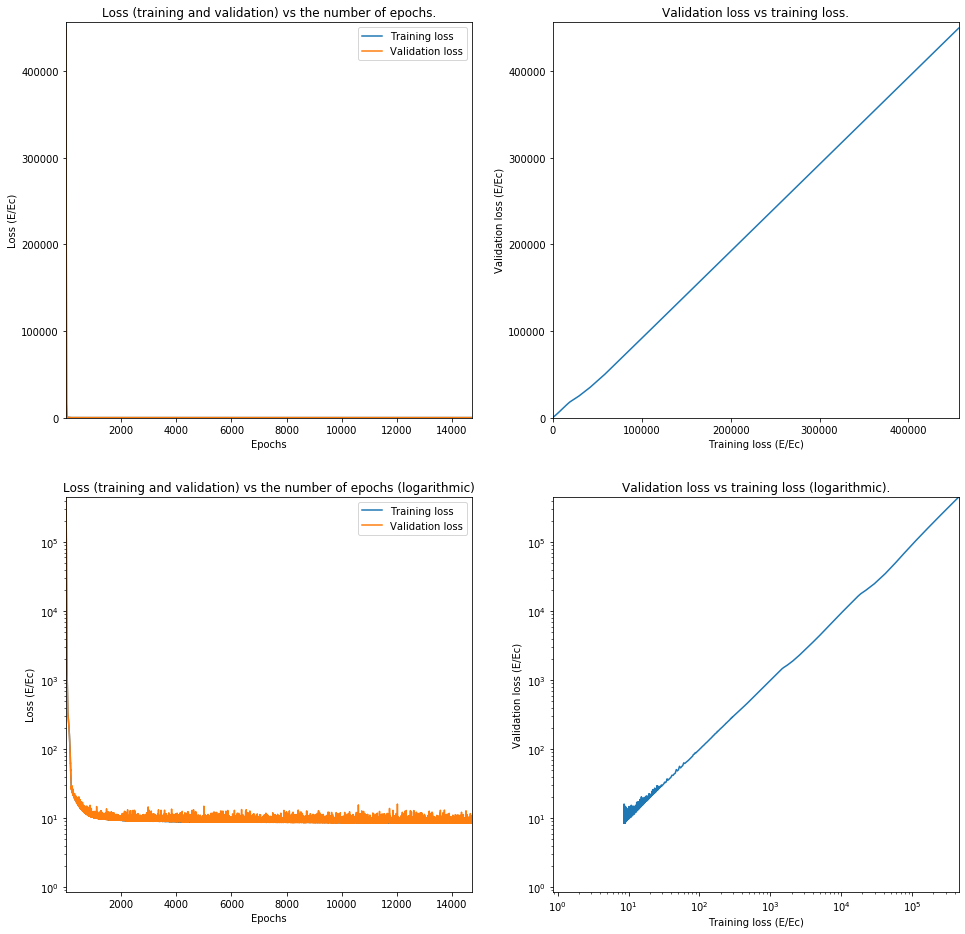

In [18]:
name = 'LinearNetwork'
settingsNetwork = [inputSize, ['Dense', 1, 'linear', True]]
learningRate = 1*10**-5
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=20000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)


8.79599197031675


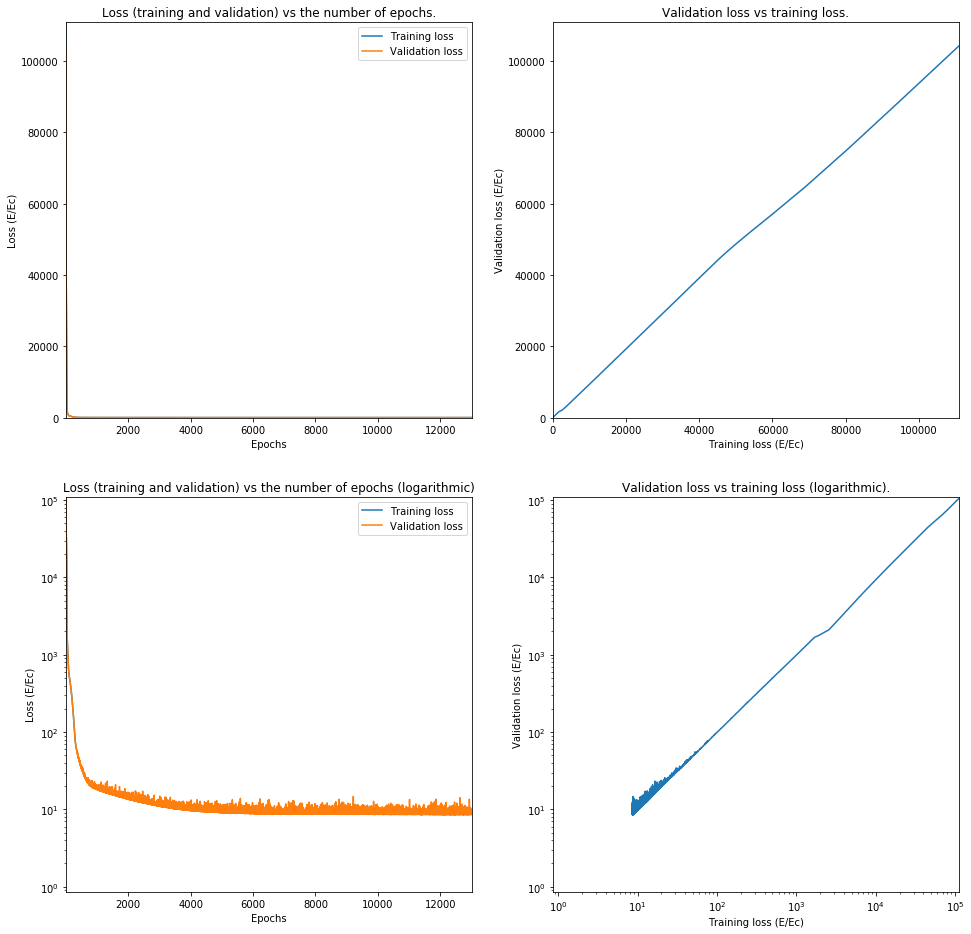

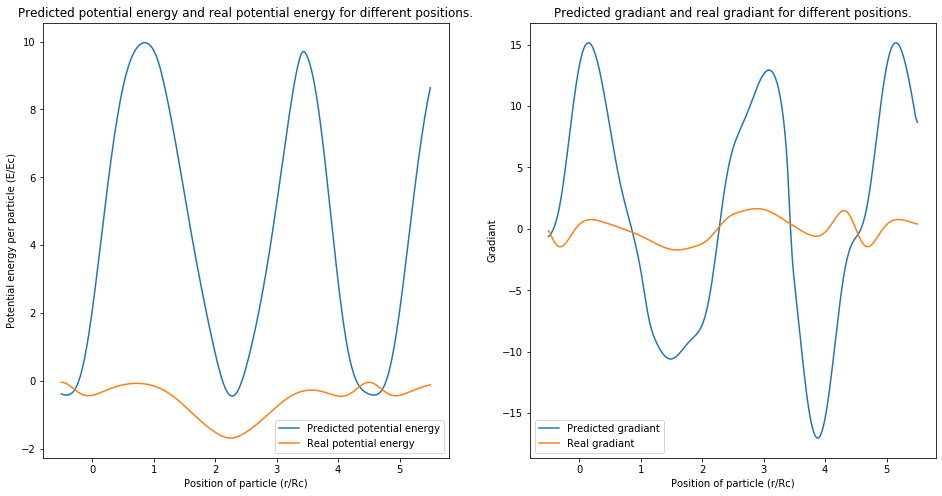

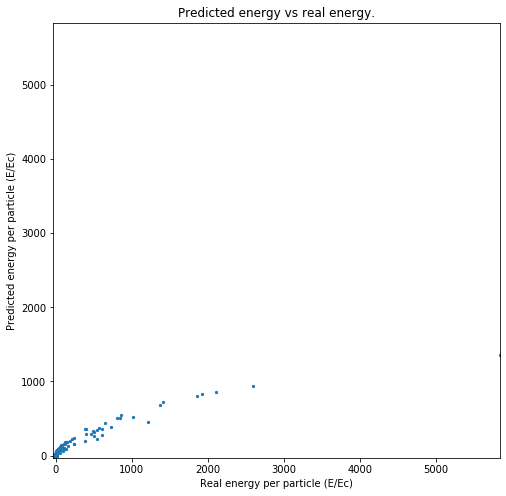

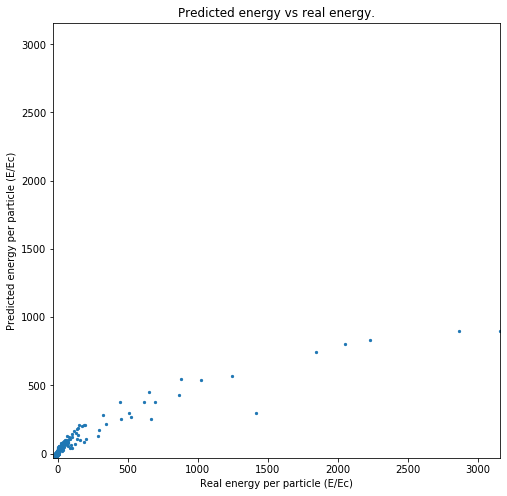

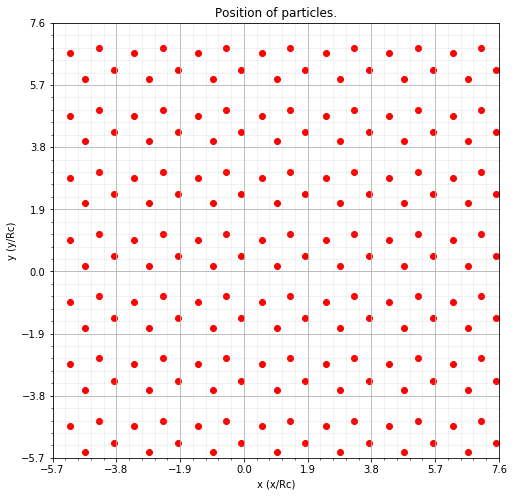

For index 36454 Predicted -9.074186 was -13.8138842409


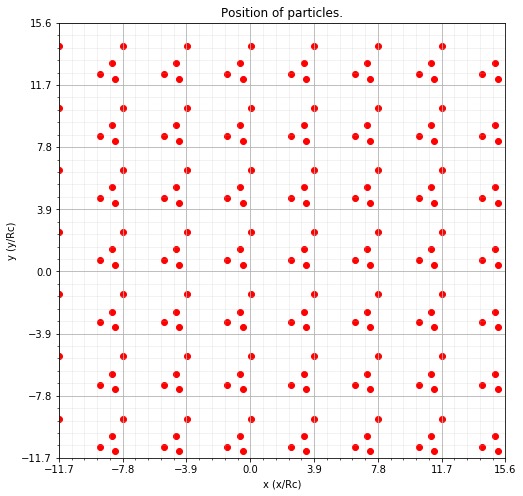

For index 77919 Predicted -0.80148125 was -1.5139580448


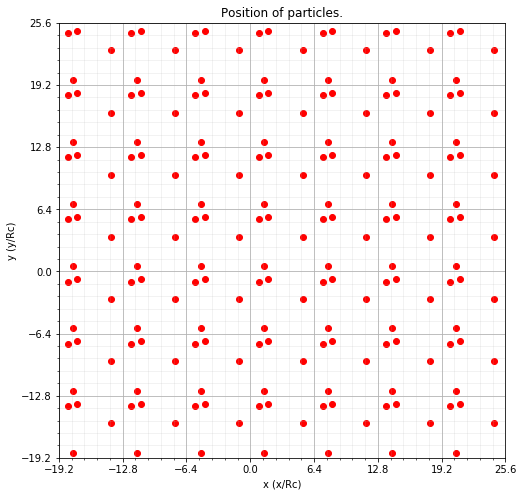

For index 2658 Predicted 1.6771317 was -0.2987796588


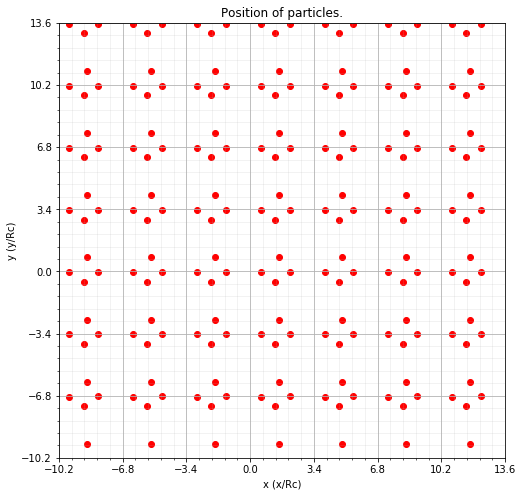

For index 64234 Predicted -3.430746 was -2.2130348202


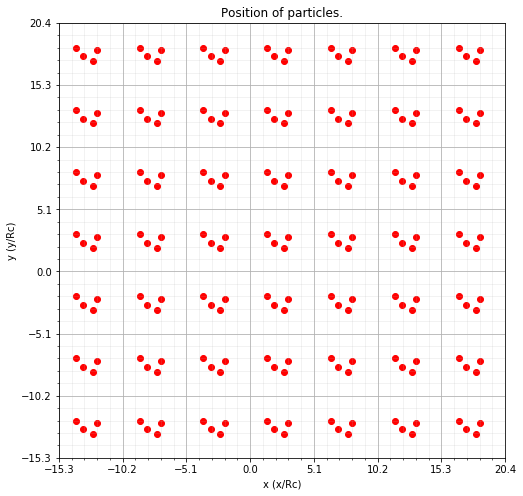

For index 10829 Predicted -4.2805386 was -2.1429048869


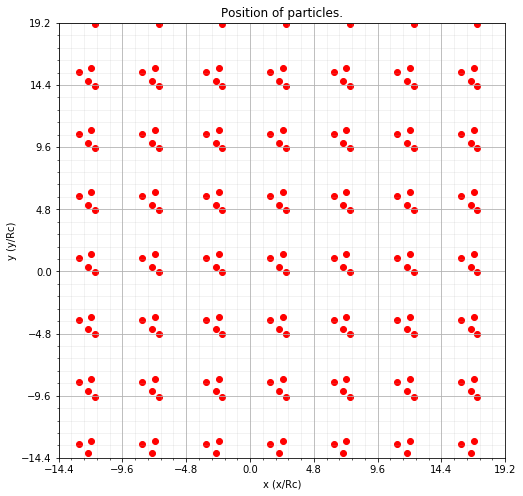

For index 69204 Predicted 47.937943 was 14.3631368483


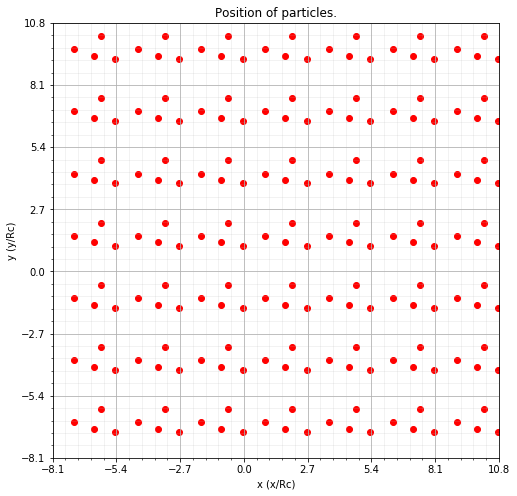

For index 53656 Predicted -4.2245464 was -3.9330538275


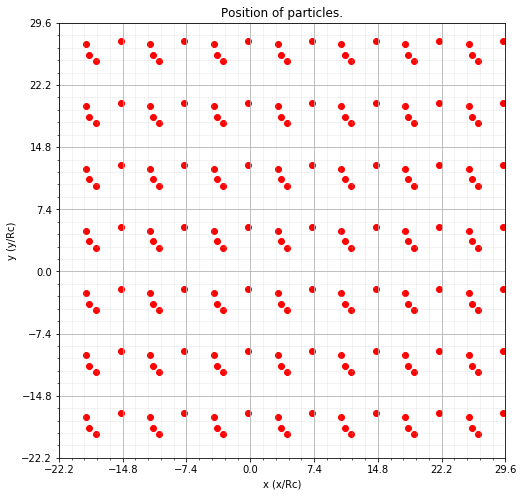

For index 59107 Predicted 3.1662655 was -0.21047515360000002


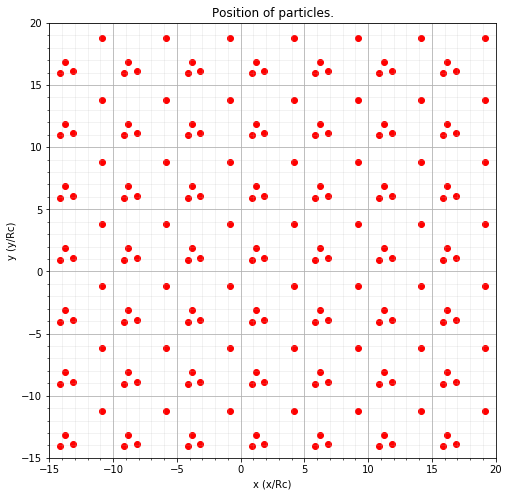

For index 967 Predicted -1.1939754 was -1.314398845


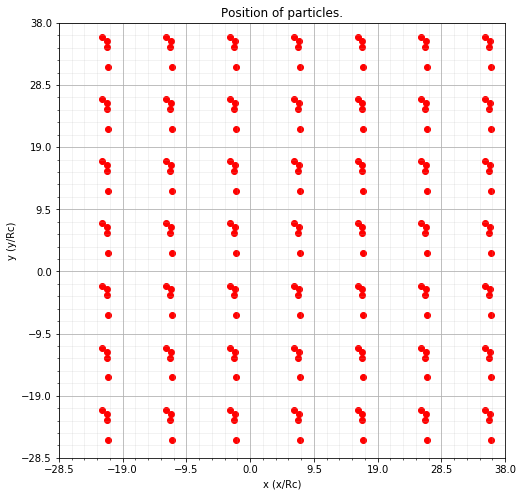

For index 51647 Predicted -3.3342876 was -0.7539948609


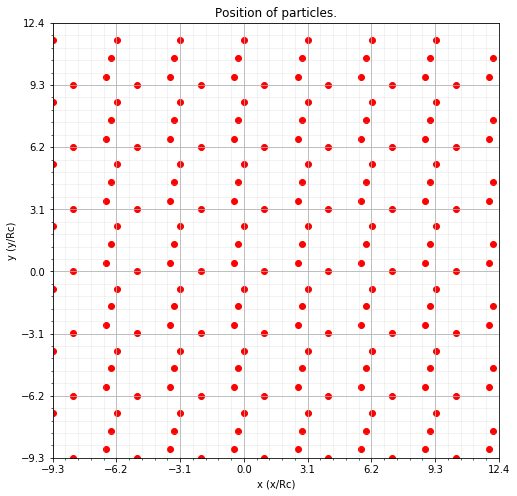

For index 76912 Predicted -1.5757732 was -1.1216862668
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 1)                 13        
Total params: 13
Trainable params: 13
Non-trainable params: 0
_________________________________________________________________
Layer 0:  [array([[-5.4094326e-01],
       [-1.2672330e-01],
       [-1.7155760e-03],
       [ 8.0358628e-03],
       [ 3.9423689e-02],
       [ 8.0789141e-03],
       [-5.3136130e-03],
       [-4.0242281e-03],
       [-6.3344266e-04],
       [ 7.7468587e-07],
       [ 3.4650022e-04],
       [ 2.8009480e-04]], dtype=float32), array([-21.719786], dtype=float32)]


In [19]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())

models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

## Model 1: 1 Dense layer small softplus

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_17 (Dense)             (None, 12)                156       
_________________________________________________________________
dense_18 (Dense)             (None, 1)                 13        
Total params: 169
Trainable params: 169
Non-trainable params: 0
_________________________________________________________________
78306/78306 [==============================] - 1s 13us/step
85343.97058185596
Layer 0:  [array([[-0.24815592,  0.23165727,  0.01724768, -0.16124475,  0.35097736,
        -0.45356953,  0.01898581,  0.44918948,  0.16161984, -0.23645917,
         0.03984666,  0.04387116],
       [ 0.57768446,  0.6554809 ,  0.03794748,  0.42768973, -0.66845894,
         0.5919923 ,  0.12975514, -0.28178033, -0.53590715,  0.5588674 ,
        -0.08643359,  0.66680104],
       [-0.5777249 , -0.56580675, -0.3857465 , -0.28111845,  0.079

62644/62644 [==============================] - 3s 41us/step - loss: 4366.9154 - val_loss: 4317.6186
Epoch 44/25000
62644/62644 [==============================] - 3s 41us/step - loss: 4302.0139 - val_loss: 4256.3339
Epoch 45/25000
62644/62644 [==============================] - 2s 37us/step - loss: 4239.2787 - val_loss: 4198.6768
Epoch 46/25000
62644/62644 [==============================] - 2s 35us/step - loss: 4178.2754 - val_loss: 4139.8897
Epoch 47/25000
62644/62644 [==============================] - 2s 32us/step - loss: 4118.9568 - val_loss: 4084.1014
Epoch 48/25000
62644/62644 [==============================] - 2s 32us/step - loss: 4061.5736 - val_loss: 4030.5670
Epoch 49/25000
62644/62644 [==============================] - 2s 32us/step - loss: 4006.0923 - val_loss: 3978.4782
Epoch 50/25000
62644/62644 [==============================] - 2s 31us/step - loss: 3952.2303 - val_loss: 3926.7337
Epoch 51/25000
62644/62644 [==============================] - 2s 32us/step - loss: 3899.7795 - 

62644/62644 [==============================] - 2s 31us/step - loss: 1785.0644 - val_loss: 1798.7341
Epoch 115/25000
62644/62644 [==============================] - 2s 31us/step - loss: 1765.7381 - val_loss: 1778.4293
Epoch 116/25000
62644/62644 [==============================] - 2s 31us/step - loss: 1746.7230 - val_loss: 1759.2196
Epoch 117/25000
62644/62644 [==============================] - 2s 32us/step - loss: 1727.8951 - val_loss: 1739.9547
Epoch 118/25000
62644/62644 [==============================] - 2s 32us/step - loss: 1709.6501 - val_loss: 1721.3832
Epoch 119/25000
62644/62644 [==============================] - 2s 33us/step - loss: 1691.4925 - val_loss: 1703.4121
Epoch 120/25000
62644/62644 [==============================] - 2s 31us/step - loss: 1673.8533 - val_loss: 1685.0530
Epoch 121/25000
62644/62644 [==============================] - 2s 32us/step - loss: 1656.3364 - val_loss: 1666.6763
Epoch 122/25000
62644/62644 [==============================] - 2s 32us/step - loss: 1638

Epoch 185/25000
62644/62644 [==============================] - 2s 33us/step - loss: 938.2341 - val_loss: 944.7980
Epoch 186/25000
62644/62644 [==============================] - 2s 32us/step - loss: 930.0994 - val_loss: 935.8153
Epoch 187/25000
62644/62644 [==============================] - 2s 32us/step - loss: 922.0501 - val_loss: 928.0925
Epoch 188/25000
62644/62644 [==============================] - 2s 32us/step - loss: 914.1018 - val_loss: 920.8592
Epoch 189/25000
62644/62644 [==============================] - 2s 31us/step - loss: 905.8933 - val_loss: 912.5745
Epoch 190/25000
62644/62644 [==============================] - 2s 31us/step - loss: 897.7753 - val_loss: 903.0162
Epoch 191/25000
62644/62644 [==============================] - 2s 31us/step - loss: 889.9757 - val_loss: 895.6135
Epoch 192/25000
62644/62644 [==============================] - 2s 31us/step - loss: 881.9831 - val_loss: 888.0880
Epoch 193/25000
62644/62644 [==============================] - 2s 31us/step - loss: 874.

Epoch 257/25000
62644/62644 [==============================] - 2s 31us/step - loss: 406.3218 - val_loss: 411.6928
Epoch 258/25000
62644/62644 [==============================] - 2s 34us/step - loss: 402.7931 - val_loss: 407.9451
Epoch 259/25000
62644/62644 [==============================] - 2s 32us/step - loss: 399.2160 - val_loss: 404.1603
Epoch 260/25000
62644/62644 [==============================] - 2s 31us/step - loss: 395.7134 - val_loss: 400.9678
Epoch 261/25000
62644/62644 [==============================] - 2s 32us/step - loss: 392.1970 - val_loss: 397.3975
Epoch 262/25000
62644/62644 [==============================] - 2s 31us/step - loss: 388.7038 - val_loss: 393.3844
Epoch 263/25000
62644/62644 [==============================] - 2s 31us/step - loss: 385.3008 - val_loss: 389.7554
Epoch 264/25000
62644/62644 [==============================] - 2s 31us/step - loss: 381.8570 - val_loss: 386.2931
Epoch 265/25000
62644/62644 [==============================] - 2s 30us/step - loss: 378.

Epoch 329/25000
62644/62644 [==============================] - 2s 31us/step - loss: 205.3257 - val_loss: 206.3189
Epoch 330/25000
62644/62644 [==============================] - 2s 31us/step - loss: 203.2058 - val_loss: 204.0052
Epoch 331/25000
62644/62644 [==============================] - 2s 31us/step - loss: 201.1321 - val_loss: 202.0844
Epoch 332/25000
62644/62644 [==============================] - 2s 31us/step - loss: 199.0888 - val_loss: 199.8753
Epoch 333/25000
62644/62644 [==============================] - 2s 31us/step - loss: 197.0802 - val_loss: 198.1674
Epoch 334/25000
62644/62644 [==============================] - 2s 30us/step - loss: 195.0353 - val_loss: 195.5327
Epoch 335/25000
62644/62644 [==============================] - 2s 31us/step - loss: 193.0819 - val_loss: 193.4532
Epoch 336/25000
62644/62644 [==============================] - 2s 31us/step - loss: 191.0617 - val_loss: 191.2701
Epoch 337/25000
62644/62644 [==============================] - 2s 32us/step - loss: 189.

Epoch 401/25000
62644/62644 [==============================] - 2s 31us/step - loss: 93.5377 - val_loss: 95.5954
Epoch 402/25000
62644/62644 [==============================] - 2s 31us/step - loss: 92.6677 - val_loss: 94.0721
Epoch 403/25000
62644/62644 [==============================] - 2s 31us/step - loss: 91.8536 - val_loss: 93.5796
Epoch 404/25000
62644/62644 [==============================] - 2s 31us/step - loss: 91.0319 - val_loss: 92.8738
Epoch 405/25000
62644/62644 [==============================] - 2s 31us/step - loss: 90.2844 - val_loss: 91.7651
Epoch 406/25000
62644/62644 [==============================] - 2s 31us/step - loss: 89.4519 - val_loss: 91.0306
Epoch 407/25000
62644/62644 [==============================] - 2s 31us/step - loss: 88.7008 - val_loss: 90.3797
Epoch 408/25000
62644/62644 [==============================] - 2s 31us/step - loss: 87.8996 - val_loss: 89.5359
Epoch 409/25000
62644/62644 [==============================] - 2s 31us/step - loss: 87.1825 - val_loss: 

62644/62644 [==============================] - 2s 31us/step - loss: 57.2993 - val_loss: 59.5646
Epoch 475/25000
62644/62644 [==============================] - 2s 31us/step - loss: 57.1599 - val_loss: 59.4654
Epoch 476/25000
62644/62644 [==============================] - 2s 31us/step - loss: 56.9460 - val_loss: 59.1661
Epoch 477/25000
62644/62644 [==============================] - 2s 31us/step - loss: 56.7178 - val_loss: 58.7530
Epoch 478/25000
62644/62644 [==============================] - 2s 31us/step - loss: 56.5398 - val_loss: 58.7447
Epoch 479/25000
62644/62644 [==============================] - 2s 31us/step - loss: 56.4136 - val_loss: 58.3820
Epoch 480/25000
62644/62644 [==============================] - 2s 31us/step - loss: 56.1900 - val_loss: 58.1715
Epoch 481/25000
62644/62644 [==============================] - 2s 31us/step - loss: 56.0177 - val_loss: 57.9746
Epoch 482/25000
62644/62644 [==============================] - 2s 31us/step - loss: 55.8744 - val_loss: 57.8010
Epoch 48

62644/62644 [==============================] - 2s 33us/step - loss: 48.1922 - val_loss: 49.9787
Epoch 548/25000
62644/62644 [==============================] - 2s 32us/step - loss: 48.0866 - val_loss: 49.9022
Epoch 549/25000
62644/62644 [==============================] - 2s 32us/step - loss: 48.0255 - val_loss: 49.8632
Epoch 550/25000
62644/62644 [==============================] - 2s 31us/step - loss: 47.9444 - val_loss: 49.9781
Epoch 551/25000
62644/62644 [==============================] - 2s 31us/step - loss: 47.8339 - val_loss: 49.6551
Epoch 552/25000
62644/62644 [==============================] - 2s 31us/step - loss: 47.7642 - val_loss: 49.7173
Epoch 553/25000
62644/62644 [==============================] - 2s 31us/step - loss: 47.6795 - val_loss: 49.5876
Epoch 554/25000
62644/62644 [==============================] - 2s 32us/step - loss: 47.5511 - val_loss: 49.4468
Epoch 555/25000
62644/62644 [==============================] - 2s 32us/step - loss: 47.4705 - val_loss: 49.2732
Epoch 55

62644/62644 [==============================] - 2s 32us/step - loss: 42.3310 - val_loss: 44.0817
Epoch 621/25000
62644/62644 [==============================] - 2s 34us/step - loss: 42.2326 - val_loss: 44.4370
Epoch 622/25000
62644/62644 [==============================] - 2s 32us/step - loss: 42.2097 - val_loss: 44.6144
Epoch 623/25000
62644/62644 [==============================] - 2s 31us/step - loss: 42.1838 - val_loss: 44.1574
Epoch 624/25000
62644/62644 [==============================] - 2s 31us/step - loss: 42.0692 - val_loss: 43.7658
Epoch 625/25000
62644/62644 [==============================] - 2s 32us/step - loss: 42.0312 - val_loss: 43.7198
Epoch 626/25000
62644/62644 [==============================] - 2s 31us/step - loss: 41.9781 - val_loss: 43.8767
Epoch 627/25000
62644/62644 [==============================] - 2s 31us/step - loss: 41.9397 - val_loss: 43.7967
Epoch 628/25000
62644/62644 [==============================] - 2s 31us/step - loss: 41.8089 - val_loss: 43.6188
Epoch 62

62644/62644 [==============================] - 2s 31us/step - loss: 38.2510 - val_loss: 40.0176
Epoch 694/25000
62644/62644 [==============================] - 2s 31us/step - loss: 38.2325 - val_loss: 40.3040
Epoch 695/25000
62644/62644 [==============================] - 2s 31us/step - loss: 38.1363 - val_loss: 39.9275
Epoch 696/25000
62644/62644 [==============================] - 2s 31us/step - loss: 38.1063 - val_loss: 40.0934
Epoch 697/25000
62644/62644 [==============================] - 2s 31us/step - loss: 38.0550 - val_loss: 39.8293
Epoch 698/25000
62644/62644 [==============================] - 2s 31us/step - loss: 38.0074 - val_loss: 39.7847
Epoch 699/25000
62644/62644 [==============================] - 2s 31us/step - loss: 37.9567 - val_loss: 39.8666
Epoch 700/25000
62644/62644 [==============================] - 2s 32us/step - loss: 37.9617 - val_loss: 40.0549
Epoch 701/25000
62644/62644 [==============================] - 2s 31us/step - loss: 37.8561 - val_loss: 39.7109
Epoch 70

62644/62644 [==============================] - 2s 32us/step - loss: 34.9345 - val_loss: 36.7386
Epoch 767/25000
62644/62644 [==============================] - 2s 30us/step - loss: 34.9187 - val_loss: 36.8533
Epoch 768/25000
62644/62644 [==============================] - 2s 30us/step - loss: 34.8534 - val_loss: 36.9889
Epoch 769/25000
62644/62644 [==============================] - 2s 30us/step - loss: 34.8143 - val_loss: 36.6551
Epoch 770/25000
62644/62644 [==============================] - 2s 30us/step - loss: 34.8089 - val_loss: 36.5506
Epoch 771/25000
62644/62644 [==============================] - 2s 30us/step - loss: 34.7129 - val_loss: 36.6166
Epoch 772/25000
62644/62644 [==============================] - 2s 30us/step - loss: 34.7021 - val_loss: 36.5944
Epoch 773/25000
62644/62644 [==============================] - 2s 31us/step - loss: 34.6750 - val_loss: 36.4748
Epoch 774/25000
62644/62644 [==============================] - 2s 30us/step - loss: 34.5988 - val_loss: 36.4935
Epoch 77

62644/62644 [==============================] - 2s 32us/step - loss: 32.2269 - val_loss: 34.1900
Epoch 840/25000
62644/62644 [==============================] - 2s 32us/step - loss: 32.1860 - val_loss: 34.0913
Epoch 841/25000
62644/62644 [==============================] - 2s 34us/step - loss: 32.1566 - val_loss: 33.9712
Epoch 842/25000
62644/62644 [==============================] - 2s 32us/step - loss: 32.1527 - val_loss: 35.9202
Epoch 843/25000
62644/62644 [==============================] - 2s 33us/step - loss: 32.0901 - val_loss: 34.0411
Epoch 844/25000
62644/62644 [==============================] - 2s 33us/step - loss: 32.0656 - val_loss: 33.8332
Epoch 845/25000
62644/62644 [==============================] - 2s 32us/step - loss: 32.0241 - val_loss: 33.8894
Epoch 846/25000
62644/62644 [==============================] - 2s 33us/step - loss: 31.9675 - val_loss: 33.8319
Epoch 847/25000
62644/62644 [==============================] - 2s 33us/step - loss: 31.9750 - val_loss: 33.7599
Epoch 84

62644/62644 [==============================] - 2s 38us/step - loss: 30.0133 - val_loss: 32.0271
Epoch 913/25000
62644/62644 [==============================] - 2s 37us/step - loss: 29.9631 - val_loss: 31.7720
Epoch 914/25000
62644/62644 [==============================] - 2s 34us/step - loss: 29.9637 - val_loss: 31.7112
Epoch 915/25000
62644/62644 [==============================] - 2s 37us/step - loss: 29.9577 - val_loss: 31.6547
Epoch 916/25000
62644/62644 [==============================] - 2s 35us/step - loss: 29.9112 - val_loss: 31.5887
Epoch 917/25000
62644/62644 [==============================] - 2s 38us/step - loss: 29.8656 - val_loss: 31.7436
Epoch 918/25000
62644/62644 [==============================] - 2s 37us/step - loss: 29.8157 - val_loss: 32.1248
Epoch 919/25000
62644/62644 [==============================] - 2s 35us/step - loss: 29.8212 - val_loss: 31.9589
Epoch 920/25000
62644/62644 [==============================] - 2s 35us/step - loss: 29.7678 - val_loss: 31.9277
Epoch 92

62644/62644 [==============================] - 2s 36us/step - loss: 28.1884 - val_loss: 29.8472
Epoch 986/25000
62644/62644 [==============================] - 2s 34us/step - loss: 28.1127 - val_loss: 29.8551
Epoch 987/25000
62644/62644 [==============================] - 2s 32us/step - loss: 28.0614 - val_loss: 30.1660
Epoch 988/25000
62644/62644 [==============================] - 2s 31us/step - loss: 28.0496 - val_loss: 29.8518
Epoch 989/25000
62644/62644 [==============================] - 2s 31us/step - loss: 28.0260 - val_loss: 30.2953
Epoch 990/25000
62644/62644 [==============================] - 2s 32us/step - loss: 28.0054 - val_loss: 29.7957
Epoch 991/25000
62644/62644 [==============================] - 2s 32us/step - loss: 27.9875 - val_loss: 29.9808
Epoch 992/25000
62644/62644 [==============================] - 2s 31us/step - loss: 27.9354 - val_loss: 29.8294
Epoch 993/25000
62644/62644 [==============================] - 2s 32us/step - loss: 27.9501 - val_loss: 29.8443
Epoch 99

Epoch 1058/25000
62644/62644 [==============================] - 2s 35us/step - loss: 26.4912 - val_loss: 28.1637
Epoch 1059/25000
62644/62644 [==============================] - 2s 34us/step - loss: 26.4613 - val_loss: 28.1097
Epoch 1060/25000
62644/62644 [==============================] - 2s 34us/step - loss: 26.4184 - val_loss: 28.7244
Epoch 1061/25000
62644/62644 [==============================] - 2s 33us/step - loss: 26.4151 - val_loss: 28.0604
Epoch 1062/25000
62644/62644 [==============================] - 2s 33us/step - loss: 26.3730 - val_loss: 28.1754
Epoch 1063/25000
62644/62644 [==============================] - 2s 33us/step - loss: 26.3953 - val_loss: 28.0581
Epoch 1064/25000
62644/62644 [==============================] - 2s 33us/step - loss: 26.3821 - val_loss: 28.0728
Epoch 1065/25000
62644/62644 [==============================] - 2s 32us/step - loss: 26.3671 - val_loss: 28.0325
Epoch 1066/25000
62644/62644 [==============================] - 2s 30us/step - loss: 26.3408 - v

62644/62644 [==============================] - 2s 29us/step - loss: 25.0645 - val_loss: 27.6495
Epoch 1131/25000
62644/62644 [==============================] - 2s 29us/step - loss: 25.0411 - val_loss: 26.7504
Epoch 1132/25000
62644/62644 [==============================] - 2s 29us/step - loss: 25.0087 - val_loss: 26.8758
Epoch 1133/25000
62644/62644 [==============================] - 2s 29us/step - loss: 25.0244 - val_loss: 27.1133
Epoch 1134/25000
62644/62644 [==============================] - 2s 28us/step - loss: 24.9489 - val_loss: 26.7455
Epoch 1135/25000
62644/62644 [==============================] - 2s 29us/step - loss: 24.9892 - val_loss: 26.6431
Epoch 1136/25000
62644/62644 [==============================] - 2s 29us/step - loss: 24.9581 - val_loss: 26.8601
Epoch 1137/25000
62644/62644 [==============================] - 2s 29us/step - loss: 24.9134 - val_loss: 26.8640
Epoch 1138/25000
62644/62644 [==============================] - 2s 29us/step - loss: 24.9011 - val_loss: 27.0977


62644/62644 [==============================] - 2s 29us/step - loss: 23.7325 - val_loss: 25.3837
Epoch 1203/25000
62644/62644 [==============================] - 2s 30us/step - loss: 23.7116 - val_loss: 25.3363
Epoch 1204/25000
62644/62644 [==============================] - 2s 29us/step - loss: 23.7178 - val_loss: 25.3502
Epoch 1205/25000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6727 - val_loss: 25.3136
Epoch 1206/25000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6511 - val_loss: 25.3227
Epoch 1207/25000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6536 - val_loss: 25.2270
Epoch 1208/25000
62644/62644 [==============================] - 2s 30us/step - loss: 23.6247 - val_loss: 26.2011
Epoch 1209/25000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6347 - val_loss: 25.2861
Epoch 1210/25000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6370 - val_loss: 25.1686


62644/62644 [==============================] - 2s 33us/step - loss: 22.5251 - val_loss: 24.3297
Epoch 1275/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.5100 - val_loss: 24.6783
Epoch 1276/25000
62644/62644 [==============================] - 2s 31us/step - loss: 22.5103 - val_loss: 24.1966
Epoch 1277/25000
62644/62644 [==============================] - 2s 34us/step - loss: 22.4341 - val_loss: 24.0715
Epoch 1278/25000
62644/62644 [==============================] - 2s 33us/step - loss: 22.4346 - val_loss: 23.9920
Epoch 1279/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.4755 - val_loss: 24.0894
Epoch 1280/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.4455 - val_loss: 23.9498
Epoch 1281/25000
62644/62644 [==============================] - 2s 30us/step - loss: 22.4356 - val_loss: 24.4455
Epoch 1282/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.3837 - val_loss: 24.0608


62644/62644 [==============================] - 2s 30us/step - loss: 21.4016 - val_loss: 23.0207
Epoch 1347/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.3723 - val_loss: 23.8377
Epoch 1348/25000
62644/62644 [==============================] - 2s 29us/step - loss: 21.3634 - val_loss: 23.2497
Epoch 1349/25000
62644/62644 [==============================] - 2s 30us/step - loss: 21.3776 - val_loss: 23.0268
Epoch 1350/25000
62644/62644 [==============================] - 2s 31us/step - loss: 21.3448 - val_loss: 22.8803
Epoch 1351/25000
62644/62644 [==============================] - 2s 33us/step - loss: 21.3483 - val_loss: 22.9094
Epoch 1352/25000
62644/62644 [==============================] - 2s 34us/step - loss: 21.3154 - val_loss: 22.9511
Epoch 1353/25000
62644/62644 [==============================] - 2s 36us/step - loss: 21.2756 - val_loss: 23.0735
Epoch 1354/25000
62644/62644 [==============================] - 2s 33us/step - loss: 21.2792 - val_loss: 22.8869


62644/62644 [==============================] - 2s 35us/step - loss: 20.3691 - val_loss: 22.1624
Epoch 1419/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.3450 - val_loss: 21.8804
Epoch 1420/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.3847 - val_loss: 22.4435
Epoch 1421/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.3508 - val_loss: 22.1208
Epoch 1422/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.3394 - val_loss: 21.7951
Epoch 1423/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.3201 - val_loss: 22.0224
Epoch 1424/25000
62644/62644 [==============================] - 2s 35us/step - loss: 20.3274 - val_loss: 21.8083
Epoch 1425/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.2602 - val_loss: 22.0742
Epoch 1426/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.3006 - val_loss: 22.0482


62644/62644 [==============================] - 2s 37us/step - loss: 19.4822 - val_loss: 20.8611
Epoch 1491/25000
62644/62644 [==============================] - 2s 40us/step - loss: 19.4468 - val_loss: 21.0874
Epoch 1492/25000
62644/62644 [==============================] - 2s 38us/step - loss: 19.4332 - val_loss: 21.0026
Epoch 1493/25000
62644/62644 [==============================] - 3s 45us/step - loss: 19.4729 - val_loss: 20.8629
Epoch 1494/25000
62644/62644 [==============================] - 3s 42us/step - loss: 19.4157 - val_loss: 20.8538
Epoch 1495/25000
62644/62644 [==============================] - 3s 44us/step - loss: 19.4141 - val_loss: 21.0579
Epoch 1496/25000
62644/62644 [==============================] - 3s 41us/step - loss: 19.3560 - val_loss: 20.8231
Epoch 1497/25000
62644/62644 [==============================] - 3s 41us/step - loss: 19.3596 - val_loss: 20.8310
Epoch 1498/25000
62644/62644 [==============================] - 2s 36us/step - loss: 19.3446 - val_loss: 22.6435


62644/62644 [==============================] - 2s 34us/step - loss: 18.6033 - val_loss: 19.9810
Epoch 1563/25000
62644/62644 [==============================] - 2s 37us/step - loss: 18.5982 - val_loss: 20.1739
Epoch 1564/25000
62644/62644 [==============================] - 2s 38us/step - loss: 18.5888 - val_loss: 19.9551
Epoch 1565/25000
62644/62644 [==============================] - 2s 37us/step - loss: 18.5343 - val_loss: 19.9772
Epoch 1566/25000
62644/62644 [==============================] - 2s 36us/step - loss: 18.5610 - val_loss: 19.9257
Epoch 1567/25000
62644/62644 [==============================] - 2s 33us/step - loss: 18.5451 - val_loss: 20.2091
Epoch 1568/25000
62644/62644 [==============================] - 2s 33us/step - loss: 18.5373 - val_loss: 20.1689
Epoch 1569/25000
62644/62644 [==============================] - 2s 35us/step - loss: 18.5340 - val_loss: 20.0021
Epoch 1570/25000
62644/62644 [==============================] - 2s 39us/step - loss: 18.5031 - val_loss: 20.3111


62644/62644 [==============================] - 2s 36us/step - loss: 17.8105 - val_loss: 19.3456
Epoch 1635/25000
62644/62644 [==============================] - 2s 37us/step - loss: 17.8186 - val_loss: 19.1841
Epoch 1636/25000
62644/62644 [==============================] - 2s 37us/step - loss: 17.7684 - val_loss: 19.1579
Epoch 1637/25000
62644/62644 [==============================] - 2s 34us/step - loss: 17.7926 - val_loss: 19.1162
Epoch 1638/25000
62644/62644 [==============================] - 2s 35us/step - loss: 17.8186 - val_loss: 19.5273
Epoch 1639/25000
62644/62644 [==============================] - 2s 36us/step - loss: 17.7538 - val_loss: 19.1509
Epoch 1640/25000
62644/62644 [==============================] - 2s 35us/step - loss: 17.7296 - val_loss: 19.3402
Epoch 1641/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.7521 - val_loss: 19.1048
Epoch 1642/25000
62644/62644 [==============================] - 2s 33us/step - loss: 17.7176 - val_loss: 19.2673


62644/62644 [==============================] - 2s 32us/step - loss: 17.0889 - val_loss: 18.7641
Epoch 1707/25000
62644/62644 [==============================] - 2s 33us/step - loss: 17.0612 - val_loss: 18.5167
Epoch 1708/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.0392 - val_loss: 18.7348
Epoch 1709/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.0422 - val_loss: 18.5399
Epoch 1710/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.0601 - val_loss: 18.6544
Epoch 1711/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.0520 - val_loss: 18.3621
Epoch 1712/25000
62644/62644 [==============================] - 2s 33us/step - loss: 17.0342 - val_loss: 18.7755
Epoch 1713/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.0643 - val_loss: 18.4211
Epoch 1714/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.0218 - val_loss: 18.4035


62644/62644 [==============================] - 2s 36us/step - loss: 16.4484 - val_loss: 17.6487
Epoch 1779/25000
62644/62644 [==============================] - 2s 39us/step - loss: 16.4226 - val_loss: 18.1839
Epoch 1780/25000
62644/62644 [==============================] - 2s 37us/step - loss: 16.4747 - val_loss: 17.9562
Epoch 1781/25000
62644/62644 [==============================] - 2s 35us/step - loss: 16.4688 - val_loss: 18.0690
Epoch 1782/25000
62644/62644 [==============================] - 2s 34us/step - loss: 16.3797 - val_loss: 17.6808
Epoch 1783/25000
62644/62644 [==============================] - 2s 34us/step - loss: 16.4000 - val_loss: 17.6871
Epoch 1784/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.3618 - val_loss: 17.6718
Epoch 1785/25000
62644/62644 [==============================] - 2s 33us/step - loss: 16.3923 - val_loss: 17.6861
Epoch 1786/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.3760 - val_loss: 17.6583


62644/62644 [==============================] - 2s 31us/step - loss: 15.8452 - val_loss: 17.0847
Epoch 1851/25000
62644/62644 [==============================] - 2s 35us/step - loss: 15.8699 - val_loss: 17.0091
Epoch 1852/25000
62644/62644 [==============================] - 2s 33us/step - loss: 15.8293 - val_loss: 17.1607
Epoch 1853/25000
62644/62644 [==============================] - 2s 35us/step - loss: 15.8006 - val_loss: 17.1145
Epoch 1854/25000
62644/62644 [==============================] - 2s 33us/step - loss: 15.7711 - val_loss: 17.0284
Epoch 1855/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.8134 - val_loss: 17.1748
Epoch 1856/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.7664 - val_loss: 17.3214
Epoch 1857/25000
62644/62644 [==============================] - 2s 34us/step - loss: 15.7647 - val_loss: 17.0412
Epoch 1858/25000
62644/62644 [==============================] - 2s 34us/step - loss: 15.7725 - val_loss: 16.9214


62644/62644 [==============================] - 2s 35us/step - loss: 15.3655 - val_loss: 16.7109
Epoch 1923/25000
62644/62644 [==============================] - 2s 34us/step - loss: 15.3175 - val_loss: 17.2473
Epoch 1924/25000
62644/62644 [==============================] - 2s 33us/step - loss: 15.3385 - val_loss: 16.6961
Epoch 1925/25000
62644/62644 [==============================] - 2s 33us/step - loss: 15.3558 - val_loss: 16.5366
Epoch 1926/25000
62644/62644 [==============================] - 2s 35us/step - loss: 15.3011 - val_loss: 16.8599
Epoch 1927/25000
62644/62644 [==============================] - 2s 35us/step - loss: 15.3047 - val_loss: 16.5541
Epoch 1928/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.3069 - val_loss: 16.8356
Epoch 1929/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.3128 - val_loss: 16.5789
Epoch 1930/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.3049 - val_loss: 16.5161


62644/62644 [==============================] - 2s 32us/step - loss: 14.9284 - val_loss: 16.0374
Epoch 1995/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.9277 - val_loss: 16.3013
Epoch 1996/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.9302 - val_loss: 16.0479
Epoch 1997/25000
62644/62644 [==============================] - 2s 34us/step - loss: 14.9489 - val_loss: 16.2626
Epoch 1998/25000
62644/62644 [==============================] - 2s 35us/step - loss: 14.9148 - val_loss: 16.0307
Epoch 1999/25000
62644/62644 [==============================] - 2s 34us/step - loss: 14.9320 - val_loss: 16.6362
Epoch 2000/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.8912 - val_loss: 16.1244
Epoch 2001/25000
62644/62644 [==============================] - 2s 34us/step - loss: 14.9242 - val_loss: 16.0230
Epoch 2002/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.9067 - val_loss: 16.3579


62644/62644 [==============================] - 2s 30us/step - loss: 14.6117 - val_loss: 15.5975
Epoch 2067/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.6086 - val_loss: 15.6263
Epoch 2068/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.6033 - val_loss: 16.3355
Epoch 2069/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.5980 - val_loss: 15.6884
Epoch 2070/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.6255 - val_loss: 15.6051
Epoch 2071/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.5884 - val_loss: 15.6457
Epoch 2072/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.5559 - val_loss: 15.6190
Epoch 2073/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.5574 - val_loss: 15.5617
Epoch 2074/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.5800 - val_loss: 15.6778


62644/62644 [==============================] - 2s 32us/step - loss: 14.3188 - val_loss: 15.3473
Epoch 2139/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.3296 - val_loss: 15.4972
Epoch 2140/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.3318 - val_loss: 15.4866
Epoch 2141/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3195 - val_loss: 15.9111
Epoch 2142/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3060 - val_loss: 15.5558
Epoch 2143/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3121 - val_loss: 15.5739
Epoch 2144/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3294 - val_loss: 15.2595
Epoch 2145/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.2681 - val_loss: 15.4613
Epoch 2146/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.2989 - val_loss: 15.3861


62644/62644 [==============================] - 2s 31us/step - loss: 14.0687 - val_loss: 15.2195
Epoch 2211/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0876 - val_loss: 14.9806
Epoch 2212/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.0941 - val_loss: 15.4177
Epoch 2213/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.0660 - val_loss: 15.1050
Epoch 2214/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0588 - val_loss: 14.9277
Epoch 2215/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0512 - val_loss: 15.4188
Epoch 2216/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0607 - val_loss: 14.9225
Epoch 2217/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0990 - val_loss: 14.9428
Epoch 2218/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0634 - val_loss: 15.0250


62644/62644 [==============================] - 2s 30us/step - loss: 13.8505 - val_loss: 14.9144
Epoch 2283/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.8177 - val_loss: 14.9384
Epoch 2284/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.8684 - val_loss: 16.1906
Epoch 2285/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.8521 - val_loss: 14.6941
Epoch 2286/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.8476 - val_loss: 14.6679
Epoch 2287/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.8420 - val_loss: 15.0143
Epoch 2288/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.8333 - val_loss: 14.7107
Epoch 2289/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.8085 - val_loss: 14.7230
Epoch 2290/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.8425 - val_loss: 14.7788


62644/62644 [==============================] - 2s 29us/step - loss: 13.6524 - val_loss: 14.6770
Epoch 2355/25000
62644/62644 [==============================] - 2s 29us/step - loss: 13.6431 - val_loss: 14.8050
Epoch 2356/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.6567 - val_loss: 14.5100
Epoch 2357/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.6412 - val_loss: 14.6917
Epoch 2358/25000
62644/62644 [==============================] - 2s 29us/step - loss: 13.6579 - val_loss: 14.7444
Epoch 2359/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.6271 - val_loss: 14.8571
Epoch 2360/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.6203 - val_loss: 14.7787
Epoch 2361/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.6410 - val_loss: 14.9076
Epoch 2362/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.6072 - val_loss: 14.5199


62644/62644 [==============================] - 2s 33us/step - loss: 13.5022 - val_loss: 14.8058
Epoch 2427/25000
62644/62644 [==============================] - 2s 32us/step - loss: 13.4513 - val_loss: 15.1505
Epoch 2428/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.4724 - val_loss: 14.2421
Epoch 2429/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.4538 - val_loss: 14.2959
Epoch 2430/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.4456 - val_loss: 14.2410
Epoch 2431/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.4605 - val_loss: 14.3055
Epoch 2432/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.4461 - val_loss: 14.2446
Epoch 2433/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.4460 - val_loss: 14.5809
Epoch 2434/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.4442 - val_loss: 14.3597


62644/62644 [==============================] - 2s 30us/step - loss: 13.2688 - val_loss: 14.6502
Epoch 2499/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.2741 - val_loss: 14.5847
Epoch 2500/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.2957 - val_loss: 13.9958
Epoch 2501/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.3077 - val_loss: 15.3210
Epoch 2502/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.2823 - val_loss: 14.0797
Epoch 2503/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.2509 - val_loss: 14.1796
Epoch 2504/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.2871 - val_loss: 14.0947
Epoch 2505/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.2654 - val_loss: 14.0710
Epoch 2506/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.2887 - val_loss: 13.9765


62644/62644 [==============================] - 2s 34us/step - loss: 13.1209 - val_loss: 13.8231
Epoch 2571/25000
62644/62644 [==============================] - 2s 36us/step - loss: 13.1029 - val_loss: 13.8263
Epoch 2572/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.1163 - val_loss: 13.8849
Epoch 2573/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.1106 - val_loss: 14.4531
Epoch 2574/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.1271 - val_loss: 14.1452
Epoch 2575/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.1314 - val_loss: 13.9094
Epoch 2576/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.1156 - val_loss: 13.8629
Epoch 2577/25000
62644/62644 [==============================] - 2s 32us/step - loss: 13.1216 - val_loss: 13.8210
Epoch 2578/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.1080 - val_loss: 13.8294


62644/62644 [==============================] - 2s 30us/step - loss: 13.0071 - val_loss: 14.0225
Epoch 2643/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.9834 - val_loss: 13.9607
Epoch 2644/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.0030 - val_loss: 14.0661
Epoch 2645/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.9776 - val_loss: 13.9393
Epoch 2646/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.9477 - val_loss: 13.7009
Epoch 2647/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.9925 - val_loss: 13.7517
Epoch 2648/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.9866 - val_loss: 13.6489
Epoch 2649/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.9556 - val_loss: 13.8719
Epoch 2650/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.9928 - val_loss: 13.6603


62644/62644 [==============================] - 2s 30us/step - loss: 12.8098 - val_loss: 13.4762
Epoch 2715/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.8496 - val_loss: 13.5104
Epoch 2716/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.8426 - val_loss: 13.5455
Epoch 2717/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.8515 - val_loss: 13.4780
Epoch 2718/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.8179 - val_loss: 13.5371
Epoch 2719/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.8220 - val_loss: 13.6352
Epoch 2720/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.8198 - val_loss: 13.6356
Epoch 2721/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.8103 - val_loss: 13.8612
Epoch 2722/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.8090 - val_loss: 13.5293


62644/62644 [==============================] - 2s 35us/step - loss: 12.7135 - val_loss: 13.5695
Epoch 2787/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.7300 - val_loss: 13.3557
Epoch 2788/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.7214 - val_loss: 13.3038
Epoch 2789/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.6949 - val_loss: 13.4501
Epoch 2790/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.6939 - val_loss: 13.6513
Epoch 2791/25000
62644/62644 [==============================] - 2s 37us/step - loss: 12.7413 - val_loss: 13.3564
Epoch 2792/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.6905 - val_loss: 13.6531
Epoch 2793/25000
62644/62644 [==============================] - 2s 37us/step - loss: 12.7096 - val_loss: 13.4248
Epoch 2794/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.6931 - val_loss: 13.5366


62644/62644 [==============================] - 2s 31us/step - loss: 12.5680 - val_loss: 13.5550
Epoch 2859/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.6192 - val_loss: 13.5533
Epoch 2860/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.5920 - val_loss: 13.3695
Epoch 2861/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.5804 - val_loss: 13.1734
Epoch 2862/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.5897 - val_loss: 13.4643
Epoch 2863/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.6319 - val_loss: 13.2930
Epoch 2864/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.6164 - val_loss: 13.3082
Epoch 2865/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.5954 - val_loss: 13.2483
Epoch 2866/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.5850 - val_loss: 13.2569


62644/62644 [==============================] - 2s 32us/step - loss: 12.5402 - val_loss: 13.2067
Epoch 2931/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.4971 - val_loss: 13.1773
Epoch 2932/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.4945 - val_loss: 13.0997
Epoch 2933/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.4951 - val_loss: 13.3158
Epoch 2934/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.4688 - val_loss: 13.0726
Epoch 2935/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.5057 - val_loss: 13.7298
Epoch 2936/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.4848 - val_loss: 13.3316
Epoch 2937/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.4647 - val_loss: 13.0911
Epoch 2938/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.4689 - val_loss: 13.0262


62644/62644 [==============================] - 2s 34us/step - loss: 12.4180 - val_loss: 13.1536
Epoch 3003/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.3949 - val_loss: 12.9406
Epoch 3004/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.3890 - val_loss: 12.9517
Epoch 3005/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.3960 - val_loss: 12.9225
Epoch 3006/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.3919 - val_loss: 13.2203
Epoch 3007/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.3961 - val_loss: 13.1213
Epoch 3008/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.3815 - val_loss: 13.4137
Epoch 3009/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.3912 - val_loss: 13.0417
Epoch 3010/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.3482 - val_loss: 13.7694


62644/62644 [==============================] - 2s 33us/step - loss: 12.3203 - val_loss: 12.8548
Epoch 3075/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2937 - val_loss: 12.9028
Epoch 3076/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.3566 - val_loss: 13.6599
Epoch 3077/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2927 - val_loss: 13.0224
Epoch 3078/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.2949 - val_loss: 13.1835
Epoch 3079/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2920 - val_loss: 12.8473
Epoch 3080/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.3071 - val_loss: 13.1499
Epoch 3081/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.2725 - val_loss: 12.9004
Epoch 3082/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2932 - val_loss: 13.0029


62644/62644 [==============================] - 2s 33us/step - loss: 12.2113 - val_loss: 12.9399
Epoch 3147/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2051 - val_loss: 12.8318
Epoch 3148/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.1920 - val_loss: 12.9466
Epoch 3149/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2183 - val_loss: 12.8812
Epoch 3150/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2290 - val_loss: 13.5477
Epoch 3151/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2298 - val_loss: 12.8239
Epoch 3152/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2077 - val_loss: 12.7536
Epoch 3153/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2103 - val_loss: 13.2166
Epoch 3154/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2311 - val_loss: 12.7205


62644/62644 [==============================] - 2s 31us/step - loss: 12.1574 - val_loss: 12.7343
Epoch 3219/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.1471 - val_loss: 12.7025
Epoch 3220/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.1309 - val_loss: 12.8187
Epoch 3221/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.1370 - val_loss: 12.8830
Epoch 3222/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.1020 - val_loss: 12.7591
Epoch 3223/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.1238 - val_loss: 12.6400
Epoch 3224/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.1089 - val_loss: 12.7592
Epoch 3225/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.1244 - val_loss: 12.6813
Epoch 3226/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.1193 - val_loss: 12.7459


62644/62644 [==============================] - 2s 32us/step - loss: 12.0581 - val_loss: 12.7004
Epoch 3291/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.0409 - val_loss: 12.7604
Epoch 3292/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.0615 - val_loss: 12.5902
Epoch 3293/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.0282 - val_loss: 12.9446
Epoch 3294/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.0570 - val_loss: 12.5601
Epoch 3295/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.0548 - val_loss: 12.6720
Epoch 3296/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.0396 - val_loss: 12.7018
Epoch 3297/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.0299 - val_loss: 12.5737
Epoch 3298/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.0315 - val_loss: 12.8742


62644/62644 [==============================] - 2s 32us/step - loss: 11.9676 - val_loss: 13.2994
Epoch 3363/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.9965 - val_loss: 12.6119
Epoch 3364/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.0073 - val_loss: 12.5936
Epoch 3365/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.9657 - val_loss: 12.5731
Epoch 3366/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.9935 - val_loss: 12.7362
Epoch 3367/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.9633 - val_loss: 12.5173
Epoch 3368/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.0062 - val_loss: 12.7297
Epoch 3369/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.0118 - val_loss: 13.5129
Epoch 3370/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.0161 - val_loss: 12.6173


62644/62644 [==============================] - 2s 36us/step - loss: 11.9266 - val_loss: 12.4455
Epoch 3435/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.9348 - val_loss: 12.5340
Epoch 3436/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.9143 - val_loss: 12.6441
Epoch 3437/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.9120 - val_loss: 12.5209
Epoch 3438/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.9294 - val_loss: 13.8111
Epoch 3439/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.9059 - val_loss: 12.5456
Epoch 3440/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.9224 - val_loss: 13.7051
Epoch 3441/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.9524 - val_loss: 12.4591
Epoch 3442/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.9165 - val_loss: 12.4559


62644/62644 [==============================] - 2s 32us/step - loss: 11.9020 - val_loss: 12.8919
Epoch 3507/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8560 - val_loss: 13.0440
Epoch 3508/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8692 - val_loss: 12.6808
Epoch 3509/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8950 - val_loss: 12.6128
Epoch 3510/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8744 - val_loss: 12.4132
Epoch 3511/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.8595 - val_loss: 12.3875
Epoch 3512/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8846 - val_loss: 12.5536
Epoch 3513/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8880 - val_loss: 12.3824
Epoch 3514/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8518 - val_loss: 12.5017


62644/62644 [==============================] - 2s 36us/step - loss: 11.8435 - val_loss: 12.5824
Epoch 3579/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.8150 - val_loss: 12.4678
Epoch 3580/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.8083 - val_loss: 12.3710
Epoch 3581/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.8582 - val_loss: 12.3525
Epoch 3582/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.8171 - val_loss: 12.3863
Epoch 3583/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.7847 - val_loss: 12.3547
Epoch 3584/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.8046 - val_loss: 12.5598
Epoch 3585/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.8029 - val_loss: 12.3159
Epoch 3586/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.7994 - val_loss: 12.5223


62644/62644 [==============================] - 2s 35us/step - loss: 11.7667 - val_loss: 12.2721
Epoch 3651/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.7671 - val_loss: 12.3574
Epoch 3652/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.7718 - val_loss: 14.2140
Epoch 3653/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.7802 - val_loss: 12.3186
Epoch 3654/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.7688 - val_loss: 12.5482
Epoch 3655/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.7517 - val_loss: 12.5403
Epoch 3656/25000
62644/62644 [==============================] - 2s 38us/step - loss: 11.7631 - val_loss: 12.5929
Epoch 3657/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.7408 - val_loss: 12.2297
Epoch 3658/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.7787 - val_loss: 12.5302


62644/62644 [==============================] - 2s 35us/step - loss: 11.7505 - val_loss: 12.5303
Epoch 3723/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.7043 - val_loss: 12.1865
Epoch 3724/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.6977 - val_loss: 12.5905
Epoch 3725/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.7075 - val_loss: 12.2067
Epoch 3726/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.7052 - val_loss: 12.3761
Epoch 3727/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.7030 - val_loss: 12.1734
Epoch 3728/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.7135 - val_loss: 12.3036
Epoch 3729/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.7046 - val_loss: 12.5399
Epoch 3730/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.7247 - val_loss: 12.5729


62644/62644 [==============================] - 2s 33us/step - loss: 11.6579 - val_loss: 12.4944
Epoch 3795/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.6630 - val_loss: 12.4624
Epoch 3796/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.6727 - val_loss: 12.1321
Epoch 3797/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.6514 - val_loss: 12.2244
Epoch 3798/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.6673 - val_loss: 12.3157
Epoch 3799/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.6689 - val_loss: 12.3080
Epoch 3800/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.6513 - val_loss: 12.5256
Epoch 3801/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.6683 - val_loss: 12.1583
Epoch 3802/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.6657 - val_loss: 12.3611


62644/62644 [==============================] - 2s 30us/step - loss: 11.6298 - val_loss: 12.1064
Epoch 3867/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.6037 - val_loss: 12.2268
Epoch 3868/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.6475 - val_loss: 12.6616
Epoch 3869/25000
62644/62644 [==============================] - 2s 38us/step - loss: 11.5917 - val_loss: 12.7138
Epoch 3870/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.6372 - val_loss: 12.1317
Epoch 3871/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.6217 - val_loss: 12.2323
Epoch 3872/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.6333 - val_loss: 12.4338
Epoch 3873/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.6484 - val_loss: 12.4141
Epoch 3874/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.5912 - val_loss: 12.2446


62644/62644 [==============================] - 2s 35us/step - loss: 11.5642 - val_loss: 12.4889
Epoch 3939/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.5915 - val_loss: 12.4207
Epoch 3940/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.5787 - val_loss: 12.1466
Epoch 3941/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.5673 - val_loss: 12.1785
Epoch 3942/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.5742 - val_loss: 12.4639
Epoch 3943/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.5805 - val_loss: 12.1354
Epoch 3944/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.5640 - val_loss: 12.6319
Epoch 3945/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.5807 - val_loss: 12.1593
Epoch 3946/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.5749 - val_loss: 12.1362


62644/62644 [==============================] - 2s 36us/step - loss: 11.5287 - val_loss: 12.1108
Epoch 4011/25000
62644/62644 [==============================] - 2s 40us/step - loss: 11.5445 - val_loss: 12.1626
Epoch 4012/25000
62644/62644 [==============================] - 2s 39us/step - loss: 11.5106 - val_loss: 12.3893
Epoch 4013/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.5285 - val_loss: 12.0260
Epoch 4014/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.5372 - val_loss: 12.1391
Epoch 4015/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.5664 - val_loss: 11.9811
Epoch 4016/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.5291 - val_loss: 12.3203
Epoch 4017/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.5333 - val_loss: 12.0276
Epoch 4018/25000
62644/62644 [==============================] - 2s 38us/step - loss: 11.5013 - val_loss: 12.0789


62644/62644 [==============================] - 2s 32us/step - loss: 11.4905 - val_loss: 12.0208
Epoch 4083/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.5106 - val_loss: 11.9889
Epoch 4084/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.5149 - val_loss: 12.0934
Epoch 4085/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.4795 - val_loss: 11.9640
Epoch 4086/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4735 - val_loss: 12.0927
Epoch 4087/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4768 - val_loss: 12.1616
Epoch 4088/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4948 - val_loss: 12.0596
Epoch 4089/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.5148 - val_loss: 11.9788
Epoch 4090/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4832 - val_loss: 12.1990


62644/62644 [==============================] - 2s 34us/step - loss: 11.4384 - val_loss: 12.2334
Epoch 4155/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.4824 - val_loss: 11.9074
Epoch 4156/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4768 - val_loss: 11.9548
Epoch 4157/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4583 - val_loss: 11.9851
Epoch 4158/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4766 - val_loss: 12.0623
Epoch 4159/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.4742 - val_loss: 12.0672
Epoch 4160/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.4193 - val_loss: 11.9198
Epoch 4161/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4712 - val_loss: 11.9353
Epoch 4162/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4366 - val_loss: 12.1972


62644/62644 [==============================] - 2s 32us/step - loss: 11.4176 - val_loss: 12.1263
Epoch 4227/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4163 - val_loss: 11.9821
Epoch 4228/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4302 - val_loss: 11.9995
Epoch 4229/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.3778 - val_loss: 12.0857
Epoch 4230/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.4333 - val_loss: 12.0951
Epoch 4231/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.4153 - val_loss: 11.9744
Epoch 4232/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4218 - val_loss: 11.9665
Epoch 4233/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.3915 - val_loss: 11.9437
Epoch 4234/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.3916 - val_loss: 12.0468


62644/62644 [==============================] - 3s 42us/step - loss: 11.3737 - val_loss: 12.4274
Epoch 4299/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.3699 - val_loss: 12.3321
Epoch 4300/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.3703 - val_loss: 11.9210
Epoch 4301/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.3625 - val_loss: 12.3575
Epoch 4302/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.3758 - val_loss: 12.2007
Epoch 4303/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.3934 - val_loss: 11.8684
Epoch 4304/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.3571 - val_loss: 11.8710
Epoch 4305/25000
62644/62644 [==============================] - 2s 39us/step - loss: 11.3967 - val_loss: 11.8623
Epoch 4306/25000
62644/62644 [==============================] - 2s 38us/step - loss: 11.3737 - val_loss: 12.0928


62644/62644 [==============================] - 2s 33us/step - loss: 11.3551 - val_loss: 11.8904
Epoch 4371/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.3391 - val_loss: 11.9180
Epoch 4372/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.3787 - val_loss: 11.8324
Epoch 4373/25000
62644/62644 [==============================] - 2s 39us/step - loss: 11.3163 - val_loss: 11.7947
Epoch 4374/25000
62644/62644 [==============================] - 2s 38us/step - loss: 11.3330 - val_loss: 11.8436
Epoch 4375/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.3869 - val_loss: 12.3423
Epoch 4376/25000
62644/62644 [==============================] - 3s 41us/step - loss: 11.3913 - val_loss: 11.7631
Epoch 4377/25000
62644/62644 [==============================] - 2s 40us/step - loss: 11.3190 - val_loss: 11.8511
Epoch 4378/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.3407 - val_loss: 11.8561


62644/62644 [==============================] - 2s 36us/step - loss: 11.3258 - val_loss: 12.6624
Epoch 4443/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2979 - val_loss: 12.1628
Epoch 4444/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.3280 - val_loss: 12.1098
Epoch 4445/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.3162 - val_loss: 11.9288
Epoch 4446/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.2879 - val_loss: 11.8965
Epoch 4447/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.2909 - val_loss: 11.7406
Epoch 4448/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2825 - val_loss: 11.9283
Epoch 4449/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2790 - val_loss: 11.8534
Epoch 4450/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.3241 - val_loss: 11.9437


62644/62644 [==============================] - 2s 32us/step - loss: 11.2876 - val_loss: 11.7308
Epoch 4515/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2980 - val_loss: 11.7499
Epoch 4516/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.2579 - val_loss: 12.2706
Epoch 4517/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.2857 - val_loss: 12.1267
Epoch 4518/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.2921 - val_loss: 11.8528
Epoch 4519/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.2966 - val_loss: 11.8708
Epoch 4520/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.2881 - val_loss: 11.7494
Epoch 4521/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2720 - val_loss: 11.7237
Epoch 4522/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2789 - val_loss: 11.8558


62644/62644 [==============================] - 2s 33us/step - loss: 11.2707 - val_loss: 13.1883
Epoch 4587/25000
62644/62644 [==============================] - 2s 38us/step - loss: 11.2028 - val_loss: 11.8624
Epoch 4588/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.2505 - val_loss: 11.6751
Epoch 4589/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.2196 - val_loss: 11.7227
Epoch 4590/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.2424 - val_loss: 12.1941
Epoch 4591/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2063 - val_loss: 12.4479
Epoch 4592/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2268 - val_loss: 11.6821
Epoch 4593/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.2316 - val_loss: 11.7884
Epoch 4594/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.2124 - val_loss: 11.8858


62644/62644 [==============================] - 2s 32us/step - loss: 11.2159 - val_loss: 12.0755
Epoch 4659/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.1993 - val_loss: 11.7197
Epoch 4660/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.2085 - val_loss: 12.0831
Epoch 4661/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.1848 - val_loss: 11.7855
Epoch 4662/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.1893 - val_loss: 11.8293
Epoch 4663/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.2445 - val_loss: 11.6260
Epoch 4664/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.1871 - val_loss: 11.7213
Epoch 4665/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.2007 - val_loss: 11.6640
Epoch 4666/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.1675 - val_loss: 11.9731


62644/62644 [==============================] - 2s 33us/step - loss: 11.1639 - val_loss: 11.6315
Epoch 4731/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.1687 - val_loss: 11.6461
Epoch 4732/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.1743 - val_loss: 11.6458
Epoch 4733/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.1815 - val_loss: 11.6762
Epoch 4734/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.1724 - val_loss: 11.8653
Epoch 4735/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.1623 - val_loss: 11.5810
Epoch 4736/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.1358 - val_loss: 11.9535
Epoch 4737/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.1561 - val_loss: 12.0116
Epoch 4738/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.1679 - val_loss: 11.6547


62644/62644 [==============================] - 2s 33us/step - loss: 11.1257 - val_loss: 11.9350
Epoch 4803/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.1402 - val_loss: 11.6675
Epoch 4804/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.1499 - val_loss: 11.7771
Epoch 4805/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.1224 - val_loss: 12.9172
Epoch 4806/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.1479 - val_loss: 11.5957
Epoch 4807/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.1540 - val_loss: 11.9887
Epoch 4808/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.1150 - val_loss: 11.5881
Epoch 4809/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.1092 - val_loss: 11.5417
Epoch 4810/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.1507 - val_loss: 11.7738


62644/62644 [==============================] - 2s 32us/step - loss: 11.0931 - val_loss: 11.6085
Epoch 4875/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.0777 - val_loss: 11.5476
Epoch 4876/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.0567 - val_loss: 11.8620
Epoch 4877/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.0776 - val_loss: 11.7248
Epoch 4878/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.1063 - val_loss: 11.6637
Epoch 4879/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0984 - val_loss: 11.6553
Epoch 4880/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.0676 - val_loss: 11.6201
Epoch 4881/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.0854 - val_loss: 11.6858
Epoch 4882/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.0892 - val_loss: 11.5183


62644/62644 [==============================] - 2s 32us/step - loss: 11.0579 - val_loss: 11.7921
Epoch 4947/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.0356 - val_loss: 11.5909
Epoch 4948/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0576 - val_loss: 11.6478
Epoch 4949/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0874 - val_loss: 11.5412
Epoch 4950/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0791 - val_loss: 11.6308
Epoch 4951/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.0553 - val_loss: 11.5047
Epoch 4952/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.0307 - val_loss: 12.0856
Epoch 4953/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.0592 - val_loss: 11.4525
Epoch 4954/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.0665 - val_loss: 11.5230


62644/62644 [==============================] - 2s 32us/step - loss: 11.0462 - val_loss: 11.9011
Epoch 5019/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.0105 - val_loss: 11.6300
Epoch 5020/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0195 - val_loss: 11.4207
Epoch 5021/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.0255 - val_loss: 11.6794
Epoch 5022/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.0444 - val_loss: 11.4653
Epoch 5023/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0282 - val_loss: 11.6468
Epoch 5024/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0073 - val_loss: 11.4673
Epoch 5025/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0216 - val_loss: 11.5836
Epoch 5026/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9737 - val_loss: 12.1331


62644/62644 [==============================] - 2s 33us/step - loss: 10.9835 - val_loss: 11.3938
Epoch 5091/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.9876 - val_loss: 11.5098
Epoch 5092/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9741 - val_loss: 11.4701
Epoch 5093/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.9888 - val_loss: 11.3781
Epoch 5094/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.9808 - val_loss: 11.3845
Epoch 5095/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.9653 - val_loss: 11.4365
Epoch 5096/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.9799 - val_loss: 11.4033
Epoch 5097/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.9981 - val_loss: 11.3963
Epoch 5098/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.0020 - val_loss: 11.4277


62644/62644 [==============================] - 2s 34us/step - loss: 10.9187 - val_loss: 11.3600
Epoch 5163/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.9156 - val_loss: 11.4788
Epoch 5164/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9143 - val_loss: 11.4226
Epoch 5165/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9480 - val_loss: 11.4178
Epoch 5166/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.9270 - val_loss: 11.3648
Epoch 5167/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9076 - val_loss: 11.4728
Epoch 5168/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.9364 - val_loss: 11.4078
Epoch 5169/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9248 - val_loss: 11.6200
Epoch 5170/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9298 - val_loss: 11.4046


62644/62644 [==============================] - 2s 29us/step - loss: 10.9006 - val_loss: 11.3322
Epoch 5235/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.8837 - val_loss: 11.7669
Epoch 5236/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9015 - val_loss: 11.3579
Epoch 5237/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.8904 - val_loss: 11.5055
Epoch 5238/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.9213 - val_loss: 11.3605
Epoch 5239/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.8978 - val_loss: 11.4468
Epoch 5240/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.9051 - val_loss: 11.3478
Epoch 5241/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.9014 - val_loss: 11.6711
Epoch 5242/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.9083 - val_loss: 11.4883


62644/62644 [==============================] - 2s 32us/step - loss: 10.8993 - val_loss: 11.3578
Epoch 5307/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.8724 - val_loss: 11.5405
Epoch 5308/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.8718 - val_loss: 11.7014
Epoch 5309/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.8269 - val_loss: 11.3526
Epoch 5310/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.8109 - val_loss: 11.8367
Epoch 5311/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.8357 - val_loss: 11.6928
Epoch 5312/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.8621 - val_loss: 11.4172
Epoch 5313/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.8476 - val_loss: 11.3425
Epoch 5314/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.8245 - val_loss: 11.4316


62644/62644 [==============================] - 2s 34us/step - loss: 10.8242 - val_loss: 11.3507
Epoch 5379/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.8019 - val_loss: 12.8227
Epoch 5380/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.8316 - val_loss: 11.2305
Epoch 5381/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.8327 - val_loss: 11.2540
Epoch 5382/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.8163 - val_loss: 11.3057
Epoch 5383/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.8250 - val_loss: 11.2951
Epoch 5384/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.8268 - val_loss: 11.2275
Epoch 5385/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.7962 - val_loss: 11.2981
Epoch 5386/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.8075 - val_loss: 11.3460


62644/62644 [==============================] - 2s 32us/step - loss: 10.7549 - val_loss: 11.2360
Epoch 5451/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.7471 - val_loss: 11.1842
Epoch 5452/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.7761 - val_loss: 11.1623
Epoch 5453/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7744 - val_loss: 11.3212
Epoch 5454/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.7619 - val_loss: 11.1470
Epoch 5455/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.7916 - val_loss: 11.3844
Epoch 5456/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.7482 - val_loss: 11.1981
Epoch 5457/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.7548 - val_loss: 11.3950
Epoch 5458/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.7784 - val_loss: 11.3235


62644/62644 [==============================] - 2s 35us/step - loss: 10.7285 - val_loss: 11.1290
Epoch 5523/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.7471 - val_loss: 11.3628
Epoch 5524/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.7277 - val_loss: 12.1822
Epoch 5525/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.7288 - val_loss: 11.3516
Epoch 5526/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.6903 - val_loss: 11.2429
Epoch 5527/25000
62644/62644 [==============================] - 3s 46us/step - loss: 10.7123 - val_loss: 11.2217
Epoch 5528/25000
62644/62644 [==============================] - 3s 41us/step - loss: 10.7283 - val_loss: 11.1472
Epoch 5529/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.7248 - val_loss: 11.3933
Epoch 5530/25000
62644/62644 [==============================] - 3s 41us/step - loss: 10.7140 - val_loss: 11.2298


62644/62644 [==============================] - 2s 35us/step - loss: 10.6537 - val_loss: 12.2010
Epoch 5595/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6785 - val_loss: 11.3960
Epoch 5596/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6446 - val_loss: 11.1372
Epoch 5597/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6585 - val_loss: 11.2982
Epoch 5598/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.6669 - val_loss: 11.5307
Epoch 5599/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.6747 - val_loss: 11.0639
Epoch 5600/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6738 - val_loss: 11.0711
Epoch 5601/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.6470 - val_loss: 11.0420
Epoch 5602/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6798 - val_loss: 11.0446


62644/62644 [==============================] - 2s 32us/step - loss: 10.5767 - val_loss: 11.0847
Epoch 5667/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5725 - val_loss: 11.0080
Epoch 5668/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.5682 - val_loss: 11.1847
Epoch 5669/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.5935 - val_loss: 11.0745
Epoch 5670/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.5562 - val_loss: 11.2639
Epoch 5671/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5818 - val_loss: 11.2018
Epoch 5672/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.5588 - val_loss: 11.1412
Epoch 5673/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.5724 - val_loss: 11.1539
Epoch 5674/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.5669 - val_loss: 10.9575


62644/62644 [==============================] - 2s 30us/step - loss: 10.5165 - val_loss: 11.2058
Epoch 5739/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.5022 - val_loss: 11.1923
Epoch 5740/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.5020 - val_loss: 11.1414
Epoch 5741/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.5362 - val_loss: 10.9459
Epoch 5742/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.4654 - val_loss: 11.3811
Epoch 5743/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.4981 - val_loss: 11.4166
Epoch 5744/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5115 - val_loss: 11.0170
Epoch 5745/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.5022 - val_loss: 11.0404
Epoch 5746/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.4941 - val_loss: 11.0754


62644/62644 [==============================] - 2s 38us/step - loss: 10.4201 - val_loss: 10.9035
Epoch 5811/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.4193 - val_loss: 10.8155
Epoch 5812/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.3950 - val_loss: 10.8669
Epoch 5813/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.4267 - val_loss: 11.1543
Epoch 5814/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.4317 - val_loss: 11.1166
Epoch 5815/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.4148 - val_loss: 10.8469
Epoch 5816/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.4098 - val_loss: 11.1284
Epoch 5817/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.4337 - val_loss: 10.7965
Epoch 5818/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.4210 - val_loss: 10.8467


62644/62644 [==============================] - 2s 32us/step - loss: 10.3473 - val_loss: 10.9609
Epoch 5883/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3419 - val_loss: 10.9364
Epoch 5884/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3579 - val_loss: 10.9832
Epoch 5885/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.4008 - val_loss: 11.0603
Epoch 5886/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3304 - val_loss: 10.9949
Epoch 5887/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3136 - val_loss: 10.8545
Epoch 5888/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3492 - val_loss: 10.9065
Epoch 5889/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3316 - val_loss: 10.9292
Epoch 5890/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3279 - val_loss: 10.7972


62644/62644 [==============================] - 2s 32us/step - loss: 10.2733 - val_loss: 10.6675
Epoch 5955/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2512 - val_loss: 10.6208
Epoch 5956/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2203 - val_loss: 10.7365
Epoch 5957/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2800 - val_loss: 11.3126
Epoch 5958/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2382 - val_loss: 10.6077
Epoch 5959/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2254 - val_loss: 10.8432
Epoch 5960/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2493 - val_loss: 10.8033
Epoch 5961/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2078 - val_loss: 10.7060
Epoch 5962/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2560 - val_loss: 10.7750


62644/62644 [==============================] - 2s 37us/step - loss: 10.1901 - val_loss: 10.5955
Epoch 6027/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1844 - val_loss: 10.8422
Epoch 6028/25000
62644/62644 [==============================] - 3s 41us/step - loss: 10.1629 - val_loss: 10.9379
Epoch 6029/25000
62644/62644 [==============================] - 3s 44us/step - loss: 10.1635 - val_loss: 10.6007
Epoch 6030/25000
62644/62644 [==============================] - 3s 46us/step - loss: 10.2010 - val_loss: 11.2518
Epoch 6031/25000
62644/62644 [==============================] - 3s 41us/step - loss: 10.1977 - val_loss: 10.8018
Epoch 6032/25000
62644/62644 [==============================] - 3s 44us/step - loss: 10.1773 - val_loss: 10.5798
Epoch 6033/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.1715 - val_loss: 10.6577
Epoch 6034/25000
62644/62644 [==============================] - 3s 42us/step - loss: 10.1838 - val_loss: 10.6881


62644/62644 [==============================] - 2s 35us/step - loss: 10.1274 - val_loss: 10.5858
Epoch 6099/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.1501 - val_loss: 11.1688
Epoch 6100/25000
62644/62644 [==============================] - 3s 41us/step - loss: 10.1125 - val_loss: 10.5981
Epoch 6101/25000
62644/62644 [==============================] - 3s 42us/step - loss: 10.1342 - val_loss: 10.5348
Epoch 6102/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1474 - val_loss: 10.5626
Epoch 6103/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1432 - val_loss: 11.1731
Epoch 6104/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1565 - val_loss: 10.6092
Epoch 6105/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1441 - val_loss: 10.6362
Epoch 6106/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1524 - val_loss: 10.6352


62644/62644 [==============================] - 2s 38us/step - loss: 10.0784 - val_loss: 10.5346
Epoch 6171/25000
62644/62644 [==============================] - 3s 40us/step - loss: 10.1117 - val_loss: 10.6196
Epoch 6172/25000
62644/62644 [==============================] - 3s 48us/step - loss: 10.1017 - val_loss: 10.8715
Epoch 6173/25000
62644/62644 [==============================] - 3s 40us/step - loss: 10.1122 - val_loss: 10.5276
Epoch 6174/25000
62644/62644 [==============================] - 3s 42us/step - loss: 10.0808 - val_loss: 10.8174
Epoch 6175/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1272 - val_loss: 10.5942
Epoch 6176/25000
62644/62644 [==============================] - 3s 45us/step - loss: 10.1056 - val_loss: 11.1636
Epoch 6177/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.1318 - val_loss: 11.2011
Epoch 6178/25000
62644/62644 [==============================] - 3s 41us/step - loss: 10.1032 - val_loss: 10.7591


62644/62644 [==============================] - 2s 37us/step - loss: 10.0815 - val_loss: 10.5533
Epoch 6243/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.0761 - val_loss: 10.6859
Epoch 6244/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.0735 - val_loss: 10.5449
Epoch 6245/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0750 - val_loss: 10.4426
Epoch 6246/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0904 - val_loss: 10.7449
Epoch 6247/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0963 - val_loss: 11.1233
Epoch 6248/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0598 - val_loss: 10.5401
Epoch 6249/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0503 - val_loss: 10.5771
Epoch 6250/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0557 - val_loss: 10.6651


62644/62644 [==============================] - 2s 37us/step - loss: 10.0335 - val_loss: 10.4262
Epoch 6315/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0491 - val_loss: 10.4966
Epoch 6316/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0517 - val_loss: 10.4580
Epoch 6317/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0636 - val_loss: 10.9759
Epoch 6318/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0239 - val_loss: 10.4481
Epoch 6319/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0573 - val_loss: 10.7579
Epoch 6320/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0366 - val_loss: 11.1257
Epoch 6321/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1029 - val_loss: 10.4172
Epoch 6322/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0380 - val_loss: 10.5386


62644/62644 [==============================] - 2s 35us/step - loss: 10.0290 - val_loss: 11.2576
Epoch 6387/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0030 - val_loss: 10.4671
Epoch 6388/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9791 - val_loss: 11.3515
Epoch 6389/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0362 - val_loss: 10.4398
Epoch 6390/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0222 - val_loss: 10.7839
Epoch 6391/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.9861 - val_loss: 10.5325
Epoch 6392/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0201 - val_loss: 10.4330
Epoch 6393/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.0220 - val_loss: 10.3477
Epoch 6394/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0174 - val_loss: 10.4487
Ep

62644/62644 [==============================] - 2s 36us/step - loss: 9.9953 - val_loss: 10.3820
Epoch 6460/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9678 - val_loss: 10.3668
Epoch 6461/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9426 - val_loss: 10.3381
Epoch 6462/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0016 - val_loss: 10.4066
Epoch 6463/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.9380 - val_loss: 10.5333
Epoch 6464/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9424 - val_loss: 10.4403
Epoch 6465/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9635 - val_loss: 10.6694
Epoch 6466/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9627 - val_loss: 11.2531
Epoch 6467/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9429 - val_loss: 10.3468
Epoch 64

62644/62644 [==============================] - 2s 35us/step - loss: 9.9435 - val_loss: 10.3584
Epoch 6533/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.9443 - val_loss: 10.4936
Epoch 6534/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.9200 - val_loss: 10.3802
Epoch 6535/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.9414 - val_loss: 10.3856
Epoch 6536/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9067 - val_loss: 10.2883
Epoch 6537/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9206 - val_loss: 11.0132
Epoch 6538/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9402 - val_loss: 10.6005
Epoch 6539/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.9321 - val_loss: 10.3236
Epoch 6540/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.9166 - val_loss: 10.4575
Epoch 654

62644/62644 [==============================] - 2s 38us/step - loss: 9.9039 - val_loss: 10.2691
Epoch 6606/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.8922 - val_loss: 10.8782
Epoch 6607/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9023 - val_loss: 10.4432
Epoch 6608/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9021 - val_loss: 10.3130
Epoch 6609/25000
62644/62644 [==============================] - 3s 46us/step - loss: 9.9258 - val_loss: 10.3948
Epoch 6610/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.8977 - val_loss: 10.3346
Epoch 6611/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.8830 - val_loss: 10.2816
Epoch 6612/25000
62644/62644 [==============================] - 3s 46us/step - loss: 9.8854 - val_loss: 10.3551
Epoch 6613/25000
62644/62644 [==============================] - 3s 43us/step - loss: 9.8964 - val_loss: 10.2861
Epoch 661

62644/62644 [==============================] - 2s 36us/step - loss: 9.9019 - val_loss: 10.2519
Epoch 6679/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8821 - val_loss: 10.2517
Epoch 6680/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8584 - val_loss: 10.3220
Epoch 6681/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8662 - val_loss: 10.6471
Epoch 6682/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8787 - val_loss: 10.3336
Epoch 6683/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8895 - val_loss: 10.3826
Epoch 6684/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8922 - val_loss: 10.2456
Epoch 6685/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.8764 - val_loss: 10.5946
Epoch 6686/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8705 - val_loss: 10.3644
Epoch 668

62644/62644 [==============================] - 2s 37us/step - loss: 9.8328 - val_loss: 10.4506
Epoch 6752/25000
62644/62644 [==============================] - 3s 40us/step - loss: 9.8515 - val_loss: 10.7327
Epoch 6753/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.8644 - val_loss: 10.4743
Epoch 6754/25000
62644/62644 [==============================] - 2s 40us/step - loss: 9.8688 - val_loss: 10.3980
Epoch 6755/25000
62644/62644 [==============================] - 2s 40us/step - loss: 9.8496 - val_loss: 10.4494
Epoch 6756/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.8371 - val_loss: 10.3760
Epoch 6757/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.8403 - val_loss: 10.3212
Epoch 6758/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.8668 - val_loss: 10.5653
Epoch 6759/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8400 - val_loss: 10.4926
Epoch 676

62644/62644 [==============================] - 2s 36us/step - loss: 9.8042 - val_loss: 10.6426
Epoch 6825/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.8562 - val_loss: 10.2360
Epoch 6826/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.8225 - val_loss: 10.6511
Epoch 6827/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.8115 - val_loss: 10.1752
Epoch 6828/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8212 - val_loss: 10.2855
Epoch 6829/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8323 - val_loss: 10.2678
Epoch 6830/25000
62644/62644 [==============================] - 3s 44us/step - loss: 9.8507 - val_loss: 10.5877
Epoch 6831/25000
62644/62644 [==============================] - 3s 45us/step - loss: 9.7968 - val_loss: 10.2404
Epoch 6832/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.8340 - val_loss: 10.4101
Epoch 683

62644/62644 [==============================] - 2s 33us/step - loss: 9.7920 - val_loss: 10.1869
Epoch 6898/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8229 - val_loss: 10.1886
Epoch 6899/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8057 - val_loss: 10.4777
Epoch 6900/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7884 - val_loss: 10.5594
Epoch 6901/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7989 - val_loss: 10.1693
Epoch 6902/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.8296 - val_loss: 11.1190
Epoch 6903/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8080 - val_loss: 10.4509
Epoch 6904/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7974 - val_loss: 10.2942
Epoch 6905/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8208 - val_loss: 10.3671
Epoch 690

62644/62644 [==============================] - 2s 36us/step - loss: 9.7697 - val_loss: 10.5509
Epoch 6971/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7762 - val_loss: 10.6228
Epoch 6972/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7802 - val_loss: 10.1524
Epoch 6973/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7693 - val_loss: 10.4182
Epoch 6974/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7734 - val_loss: 10.4865
Epoch 6975/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7678 - val_loss: 10.1334
Epoch 6976/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7733 - val_loss: 10.1528
Epoch 6977/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7688 - val_loss: 10.3838
Epoch 6978/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7983 - val_loss: 10.5847
Epoch 697

62644/62644 [==============================] - 2s 36us/step - loss: 9.7555 - val_loss: 10.2883
Epoch 7044/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7510 - val_loss: 10.1649
Epoch 7045/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7596 - val_loss: 10.2174
Epoch 7046/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7256 - val_loss: 10.2689
Epoch 7047/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7988 - val_loss: 10.2986
Epoch 7048/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7082 - val_loss: 10.2323
Epoch 7049/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7392 - val_loss: 10.4590
Epoch 7050/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7453 - val_loss: 10.4726
Epoch 7051/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7677 - val_loss: 10.7924
Epoch 705

62644/62644 [==============================] - 2s 35us/step - loss: 9.7043 - val_loss: 10.0709
Epoch 7117/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7485 - val_loss: 10.1023
Epoch 7118/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7343 - val_loss: 10.1716
Epoch 7119/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7389 - val_loss: 10.1276
Epoch 7120/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.7529 - val_loss: 10.2791
Epoch 7121/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7181 - val_loss: 10.1535
Epoch 7122/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7052 - val_loss: 10.2119
Epoch 7123/25000
62644/62644 [==============================] - 3s 40us/step - loss: 9.7250 - val_loss: 10.7210
Epoch 7124/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.7181 - val_loss: 10.0910
Epoch 712

62644/62644 [==============================] - 2s 32us/step - loss: 9.7290 - val_loss: 10.2581
Epoch 7190/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7237 - val_loss: 10.0758
Epoch 7191/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6912 - val_loss: 10.1191
Epoch 7192/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6944 - val_loss: 10.2223
Epoch 7193/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7140 - val_loss: 10.0886
Epoch 7194/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7000 - val_loss: 10.1071
Epoch 7195/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6815 - val_loss: 10.5475
Epoch 7196/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7170 - val_loss: 10.3074
Epoch 7197/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6891 - val_loss: 11.0622
Epoch 719

62644/62644 [==============================] - 2s 32us/step - loss: 9.6992 - val_loss: 10.1546
Epoch 7263/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6685 - val_loss: 10.4697
Epoch 7264/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6974 - val_loss: 10.5436
Epoch 7265/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6547 - val_loss: 10.2638
Epoch 7266/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7043 - val_loss: 10.5864
Epoch 7267/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7096 - val_loss: 10.1592
Epoch 7268/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6987 - val_loss: 10.0806
Epoch 7269/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7417 - val_loss: 10.2238
Epoch 7270/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6967 - val_loss: 10.1647
Epoch 727

62644/62644 [==============================] - 2s 31us/step - loss: 9.6616 - val_loss: 10.1536
Epoch 7336/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6207 - val_loss: 10.0311
Epoch 7337/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6786 - val_loss: 10.0333
Epoch 7338/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6343 - val_loss: 10.1002
Epoch 7339/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6625 - val_loss: 10.2707
Epoch 7340/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6682 - val_loss: 10.1442
Epoch 7341/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6620 - val_loss: 10.2374
Epoch 7342/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6455 - val_loss: 10.0540
Epoch 7343/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6872 - val_loss: 9.9894
Epoch 7344

62644/62644 [==============================] - 2s 33us/step - loss: 9.6426 - val_loss: 10.1671
Epoch 7409/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6228 - val_loss: 10.0039
Epoch 7410/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6386 - val_loss: 10.0033
Epoch 7411/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6268 - val_loss: 10.2810
Epoch 7412/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6385 - val_loss: 9.9803
Epoch 7413/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6200 - val_loss: 10.0623
Epoch 7414/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6522 - val_loss: 10.0063
Epoch 7415/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6287 - val_loss: 10.0716
Epoch 7416/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6225 - val_loss: 10.0316
Epoch 7417

62644/62644 [==============================] - 2s 34us/step - loss: 9.6015 - val_loss: 10.1059
Epoch 7482/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6267 - val_loss: 10.0067
Epoch 7483/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6045 - val_loss: 9.9740
Epoch 7484/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6182 - val_loss: 9.9811
Epoch 7485/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5817 - val_loss: 10.0046
Epoch 7486/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6326 - val_loss: 10.0223
Epoch 7487/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6150 - val_loss: 9.9979
Epoch 7488/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6318 - val_loss: 9.9855
Epoch 7489/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5881 - val_loss: 10.0991
Epoch 7490/25

62644/62644 [==============================] - 2s 36us/step - loss: 9.5948 - val_loss: 10.0889
Epoch 7555/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5982 - val_loss: 10.1689
Epoch 7556/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5987 - val_loss: 10.0936
Epoch 7557/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6076 - val_loss: 10.0467
Epoch 7558/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6116 - val_loss: 10.4396
Epoch 7559/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5829 - val_loss: 9.9744
Epoch 7560/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6109 - val_loss: 10.0996
Epoch 7561/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5565 - val_loss: 10.2119
Epoch 7562/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5794 - val_loss: 9.9683
Epoch 7563/

62644/62644 [==============================] - 2s 33us/step - loss: 9.5674 - val_loss: 9.9469
Epoch 7628/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5696 - val_loss: 9.8982
Epoch 7629/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5651 - val_loss: 10.6137
Epoch 7630/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5586 - val_loss: 10.1394
Epoch 7631/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5700 - val_loss: 9.9243
Epoch 7632/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5832 - val_loss: 10.0965
Epoch 7633/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5866 - val_loss: 10.0019
Epoch 7634/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5531 - val_loss: 10.0522
Epoch 7635/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5890 - val_loss: 10.1621
Epoch 7636/2

62644/62644 [==============================] - 2s 35us/step - loss: 9.6154 - val_loss: 9.8795
Epoch 7701/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5204 - val_loss: 9.8931
Epoch 7702/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5426 - val_loss: 9.9671
Epoch 7703/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5424 - val_loss: 9.8957
Epoch 7704/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5260 - val_loss: 10.2457
Epoch 7705/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5405 - val_loss: 9.9902
Epoch 7706/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5332 - val_loss: 10.1003
Epoch 7707/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5275 - val_loss: 10.0222
Epoch 7708/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5240 - val_loss: 9.9558
Epoch 7709/2500

62644/62644 [==============================] - 2s 34us/step - loss: 9.5464 - val_loss: 9.8862
Epoch 7774/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5011 - val_loss: 9.9316
Epoch 7775/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5338 - val_loss: 9.9946
Epoch 7776/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5362 - val_loss: 10.1717
Epoch 7777/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5351 - val_loss: 10.2767
Epoch 7778/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5032 - val_loss: 10.0289
Epoch 7779/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5360 - val_loss: 10.2344
Epoch 7780/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5545 - val_loss: 9.9554
Epoch 7781/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5322 - val_loss: 9.8944
Epoch 7782/250

62644/62644 [==============================] - 2s 33us/step - loss: 9.4994 - val_loss: 9.9004
Epoch 7847/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4880 - val_loss: 10.4085
Epoch 7848/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5209 - val_loss: 10.3884
Epoch 7849/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5177 - val_loss: 9.8760
Epoch 7850/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4936 - val_loss: 10.1473
Epoch 7851/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5002 - val_loss: 9.9392
Epoch 7852/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4928 - val_loss: 10.1892
Epoch 7853/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5453 - val_loss: 9.8475
Epoch 7854/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5118 - val_loss: 10.0677
Epoch 7855/25

62644/62644 [==============================] - 2s 34us/step - loss: 9.4708 - val_loss: 10.0523
Epoch 7920/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4881 - val_loss: 10.1090
Epoch 7921/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4766 - val_loss: 9.9342
Epoch 7922/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4721 - val_loss: 10.1271
Epoch 7923/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4921 - val_loss: 9.9249
Epoch 7924/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4971 - val_loss: 9.8976
Epoch 7925/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4706 - val_loss: 9.8696
Epoch 7926/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4928 - val_loss: 9.9988
Epoch 7927/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4802 - val_loss: 10.5957
Epoch 7928/250

Epoch 7993/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4731 - val_loss: 9.8124
Epoch 7994/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4732 - val_loss: 10.1254
Epoch 7995/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4463 - val_loss: 9.8953
Epoch 7996/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4648 - val_loss: 9.8751
Epoch 7997/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4782 - val_loss: 9.8022
Epoch 7998/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4290 - val_loss: 10.0686
Epoch 7999/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4603 - val_loss: 10.3052
Epoch 8000/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.4667 - val_loss: 10.1491
Epoch 8001/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.4637 - val_loss: 9.96

62644/62644 [==============================] - 2s 34us/step - loss: 9.4323 - val_loss: 9.7783
Epoch 8067/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4863 - val_loss: 9.8164
Epoch 8068/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4414 - val_loss: 9.8014
Epoch 8069/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4869 - val_loss: 10.0947
Epoch 8070/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4553 - val_loss: 10.0385
Epoch 8071/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4142 - val_loss: 10.2777
Epoch 8072/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4340 - val_loss: 9.7811
Epoch 8073/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4228 - val_loss: 9.8519
Epoch 8074/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4301 - val_loss: 9.8778
Epoch 8075/2500

62644/62644 [==============================] - 2s 34us/step - loss: 9.4668 - val_loss: 9.7974
Epoch 8140/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.4145 - val_loss: 9.7662
Epoch 8141/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4101 - val_loss: 10.6547
Epoch 8142/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4507 - val_loss: 9.7466
Epoch 8143/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4037 - val_loss: 9.7724
Epoch 8144/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4179 - val_loss: 9.7662
Epoch 8145/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4359 - val_loss: 9.8683
Epoch 8146/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4260 - val_loss: 9.7539
Epoch 8147/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4267 - val_loss: 9.7431
Epoch 8148/25000


62644/62644 [==============================] - 2s 36us/step - loss: 9.4400 - val_loss: 9.7837
Epoch 8213/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.3614 - val_loss: 9.8079
Epoch 8214/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4361 - val_loss: 9.8552
Epoch 8215/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4007 - val_loss: 9.9073
Epoch 8216/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4223 - val_loss: 9.9590
Epoch 8217/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.3908 - val_loss: 9.7727
Epoch 8218/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4336 - val_loss: 10.4314
Epoch 8219/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4157 - val_loss: 9.8077
Epoch 8220/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3820 - val_loss: 9.9389
Epoch 8221/25000


62644/62644 [==============================] - 2s 35us/step - loss: 9.3777 - val_loss: 10.0164
Epoch 8286/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3890 - val_loss: 9.8559
Epoch 8287/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4039 - val_loss: 9.8792
Epoch 8288/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3636 - val_loss: 10.0212
Epoch 8289/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3821 - val_loss: 9.7832
Epoch 8290/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4073 - val_loss: 9.7368
Epoch 8291/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3748 - val_loss: 9.8119
Epoch 8292/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3805 - val_loss: 9.8045
Epoch 8293/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3854 - val_loss: 10.2426
Epoch 8294/2500

Epoch 8359/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3393 - val_loss: 10.0060
Epoch 8360/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3938 - val_loss: 10.0557
Epoch 8361/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3626 - val_loss: 9.8519
Epoch 8362/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3755 - val_loss: 9.9232
Epoch 8363/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3284 - val_loss: 10.5473
Epoch 8364/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3469 - val_loss: 9.8545
Epoch 8365/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3773 - val_loss: 9.8031
Epoch 8366/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3488 - val_loss: 9.6862
Epoch 8367/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3594 - val_loss: 9.732

62644/62644 [==============================] - 2s 36us/step - loss: 9.3306 - val_loss: 10.2267
Epoch 8433/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3449 - val_loss: 10.2640
Epoch 8434/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.3360 - val_loss: 9.8956
Epoch 8435/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3400 - val_loss: 9.6883
Epoch 8436/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3568 - val_loss: 9.7700
Epoch 8437/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3402 - val_loss: 9.8598
Epoch 8438/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3490 - val_loss: 9.6615
Epoch 8439/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3265 - val_loss: 9.6730
Epoch 8440/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3599 - val_loss: 9.7081
Epoch 8441/25000

Epoch 8506/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3534 - val_loss: 9.6423
Epoch 8507/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3035 - val_loss: 9.7180
Epoch 8508/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3082 - val_loss: 9.6766
Epoch 8509/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3226 - val_loss: 9.9584
Epoch 8510/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3478 - val_loss: 10.0155
Epoch 8511/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3129 - val_loss: 9.6923
Epoch 8512/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3514 - val_loss: 9.6470
Epoch 8513/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3204 - val_loss: 9.7931
Epoch 8514/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3145 - val_loss: 9.6893


62644/62644 [==============================] - 2s 34us/step - loss: 9.2961 - val_loss: 9.7102
Epoch 8580/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2613 - val_loss: 9.8600
Epoch 8581/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3013 - val_loss: 9.6982
Epoch 8582/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3195 - val_loss: 9.7091
Epoch 8583/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2955 - val_loss: 9.7200
Epoch 8584/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3091 - val_loss: 9.7568
Epoch 8585/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2970 - val_loss: 9.6474
Epoch 8586/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2872 - val_loss: 9.9555
Epoch 8587/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2970 - val_loss: 10.0064
Epoch 8588/25000


Epoch 8653/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2599 - val_loss: 9.8306
Epoch 8654/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2660 - val_loss: 9.7429
Epoch 8655/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2995 - val_loss: 9.7357
Epoch 8656/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2505 - val_loss: 9.7509
Epoch 8657/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2289 - val_loss: 9.9139
Epoch 8658/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2635 - val_loss: 9.6638
Epoch 8659/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2495 - val_loss: 10.1932
Epoch 8660/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2825 - val_loss: 9.6280
Epoch 8661/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2865 - val_loss: 9.9064


62644/62644 [==============================] - 2s 34us/step - loss: 9.2621 - val_loss: 9.7235
Epoch 8727/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2414 - val_loss: 9.8602
Epoch 8728/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2931 - val_loss: 9.8597
Epoch 8729/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2710 - val_loss: 9.5998
Epoch 8730/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2786 - val_loss: 9.8169
Epoch 8731/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2365 - val_loss: 9.6412
Epoch 8732/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2711 - val_loss: 9.6570
Epoch 8733/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2634 - val_loss: 9.5993
Epoch 8734/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2202 - val_loss: 9.5905
Epoch 8735/25000
6

Epoch 8800/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.2251 - val_loss: 9.6316
Epoch 8801/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.2271 - val_loss: 9.8034
Epoch 8802/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.2260 - val_loss: 10.2485
Epoch 8803/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2348 - val_loss: 9.6630
Epoch 8804/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2285 - val_loss: 9.5592
Epoch 8805/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2358 - val_loss: 9.5355
Epoch 8806/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2223 - val_loss: 9.5997
Epoch 8807/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2466 - val_loss: 10.9338
Epoch 8808/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2461 - val_loss: 10.038

62644/62644 [==============================] - 2s 31us/step - loss: 9.2137 - val_loss: 9.6540
Epoch 8874/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1987 - val_loss: 9.5567
Epoch 8875/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2273 - val_loss: 9.5337
Epoch 8876/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2066 - val_loss: 9.5772
Epoch 8877/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2280 - val_loss: 9.5626
Epoch 8878/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1847 - val_loss: 9.8113
Epoch 8879/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1999 - val_loss: 9.7027
Epoch 8880/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2311 - val_loss: 9.6159
Epoch 8881/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1869 - val_loss: 10.3467
Epoch 8882/25000


Epoch 8947/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1922 - val_loss: 9.9980
Epoch 8948/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2129 - val_loss: 9.5278
Epoch 8949/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1801 - val_loss: 9.7720
Epoch 8950/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1604 - val_loss: 9.5690
Epoch 8951/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1933 - val_loss: 9.5820
Epoch 8952/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2021 - val_loss: 10.1581
Epoch 8953/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1972 - val_loss: 9.5619
Epoch 8954/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2009 - val_loss: 9.8373
Epoch 8955/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1717 - val_loss: 9.6556


62644/62644 [==============================] - 2s 30us/step - loss: 9.1742 - val_loss: 9.4976
Epoch 9021/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1861 - val_loss: 9.6438
Epoch 9022/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1476 - val_loss: 9.5971
Epoch 9023/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1663 - val_loss: 9.6262
Epoch 9024/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1504 - val_loss: 9.5202
Epoch 9025/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1703 - val_loss: 9.5247
Epoch 9026/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1496 - val_loss: 9.5159
Epoch 9027/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1586 - val_loss: 9.9279
Epoch 9028/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1642 - val_loss: 9.4899
Epoch 9029/25000
6

Epoch 9094/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1150 - val_loss: 9.7640
Epoch 9095/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1594 - val_loss: 9.5513
Epoch 9096/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1514 - val_loss: 9.6609
Epoch 9097/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1577 - val_loss: 9.8053
Epoch 9098/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1489 - val_loss: 9.4358
Epoch 9099/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1283 - val_loss: 9.5630
Epoch 9100/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1360 - val_loss: 9.6134
Epoch 9101/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1487 - val_loss: 9.5833
Epoch 9102/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1692 - val_loss: 9.5065
E

62644/62644 [==============================] - 2s 31us/step - loss: 9.1092 - val_loss: 9.9293
Epoch 9168/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1160 - val_loss: 9.6756
Epoch 9169/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1385 - val_loss: 9.5108
Epoch 9170/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1077 - val_loss: 9.5857
Epoch 9171/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1593 - val_loss: 9.4443
Epoch 9172/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1189 - val_loss: 9.5573
Epoch 9173/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0976 - val_loss: 9.4759
Epoch 9174/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1231 - val_loss: 9.8413
Epoch 9175/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0948 - val_loss: 9.4715
Epoch 9176/25000
6

Epoch 9241/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1112 - val_loss: 9.4309
Epoch 9242/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0936 - val_loss: 9.7298
Epoch 9243/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0796 - val_loss: 9.4495
Epoch 9244/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1111 - val_loss: 9.4683
Epoch 9245/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1043 - val_loss: 9.4701
Epoch 9246/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1340 - val_loss: 9.5299
Epoch 9247/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1100 - val_loss: 9.8601
Epoch 9248/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0906 - val_loss: 9.4085
Epoch 9249/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1221 - val_loss: 9.4465
E

62644/62644 [==============================] - 2s 31us/step - loss: 9.0947 - val_loss: 9.4043
Epoch 9315/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0537 - val_loss: 9.9485
Epoch 9316/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0792 - val_loss: 9.7712
Epoch 9317/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1064 - val_loss: 9.5866
Epoch 9318/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1104 - val_loss: 9.4344
Epoch 9319/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0625 - val_loss: 9.4458
Epoch 9320/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1080 - val_loss: 9.3649
Epoch 9321/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1075 - val_loss: 9.4736
Epoch 9322/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0676 - val_loss: 9.4081
Epoch 9323/25000
6

Epoch 9388/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0634 - val_loss: 9.4267
Epoch 9389/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0806 - val_loss: 9.5286
Epoch 9390/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0414 - val_loss: 10.0246
Epoch 9391/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0596 - val_loss: 9.4628
Epoch 9392/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0575 - val_loss: 9.3987
Epoch 9393/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0422 - val_loss: 9.5455
Epoch 9394/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0462 - val_loss: 9.4598
Epoch 9395/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.0779 - val_loss: 9.3790
Epoch 9396/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0599 - val_loss: 9.6321


62644/62644 [==============================] - 2s 31us/step - loss: 9.0239 - val_loss: 9.6821
Epoch 9462/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0704 - val_loss: 9.3543
Epoch 9463/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0130 - val_loss: 9.3556
Epoch 9464/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.0678 - val_loss: 9.3902
Epoch 9465/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0131 - val_loss: 9.5055
Epoch 9466/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0577 - val_loss: 9.3271
Epoch 9467/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0269 - val_loss: 9.8957
Epoch 9468/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0874 - val_loss: 10.7758
Epoch 9469/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0582 - val_loss: 10.1437
Epoch 9470/25000

Epoch 9535/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0124 - val_loss: 9.5002
Epoch 9536/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0207 - val_loss: 9.7486
Epoch 9537/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0092 - val_loss: 9.3538
Epoch 9538/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.0076 - val_loss: 9.9558
Epoch 9539/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0320 - val_loss: 9.5217
Epoch 9540/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0008 - val_loss: 9.3667
Epoch 9541/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9968 - val_loss: 9.3165
Epoch 9542/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0122 - val_loss: 10.2311
Epoch 9543/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0194 - val_loss: 9.4028


62644/62644 [==============================] - 2s 31us/step - loss: 8.9707 - val_loss: 9.3465
Epoch 9609/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0060 - val_loss: 9.8315
Epoch 9610/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9902 - val_loss: 9.3089
Epoch 9611/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.9905 - val_loss: 9.3575
Epoch 9612/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.0020 - val_loss: 9.5807
Epoch 9613/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.9978 - val_loss: 9.3505
Epoch 9614/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0179 - val_loss: 9.5420
Epoch 9615/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9813 - val_loss: 9.2892
Epoch 9616/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9706 - val_loss: 9.4923
Epoch 9617/25000
6

Epoch 9682/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9423 - val_loss: 9.3480
Epoch 9683/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.9431 - val_loss: 9.4141
Epoch 9684/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.9699 - val_loss: 9.4736
Epoch 9685/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9577 - val_loss: 9.4880
Epoch 9686/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9884 - val_loss: 9.3237
Epoch 9687/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9694 - val_loss: 9.3326
Epoch 9688/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9877 - val_loss: 9.3502
Epoch 9689/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9699 - val_loss: 9.3116
Epoch 9690/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9755 - val_loss: 9.3466
E

Epoch 9756/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9413 - val_loss: 9.2713
Epoch 9757/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9577 - val_loss: 9.3030
Epoch 9758/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9451 - val_loss: 9.5802
Epoch 9759/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9237 - val_loss: 9.3758
Epoch 9760/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9792 - val_loss: 9.3105
Epoch 9761/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9293 - val_loss: 9.2974
Epoch 9762/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9811 - val_loss: 9.2506
Epoch 9763/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9505 - val_loss: 9.8632
Epoch 9764/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9586 - val_loss: 9.2459
E

62644/62644 [==============================] - 2s 30us/step - loss: 8.9383 - val_loss: 10.1471
Epoch 9830/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9173 - val_loss: 9.4100
Epoch 9831/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9072 - val_loss: 9.3738
Epoch 9832/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9572 - val_loss: 9.3638
Epoch 9833/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8996 - val_loss: 9.3342
Epoch 9834/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9192 - val_loss: 10.0393
Epoch 9835/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9123 - val_loss: 9.2734
Epoch 9836/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9115 - val_loss: 9.2506
Epoch 9837/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9555 - val_loss: 9.3364
Epoch 9838/25000

Epoch 9903/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9230 - val_loss: 9.4180
Epoch 9904/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9210 - val_loss: 9.2121
Epoch 9905/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9040 - val_loss: 9.2260
Epoch 9906/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8786 - val_loss: 9.3491
Epoch 9907/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.9155 - val_loss: 9.4478
Epoch 9908/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9218 - val_loss: 9.2797
Epoch 9909/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9043 - val_loss: 9.2965
Epoch 9910/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.9055 - val_loss: 9.1943
Epoch 9911/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.9075 - val_loss: 9.6930
E

Epoch 9977/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.8917 - val_loss: 9.5934
Epoch 9978/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.8843 - val_loss: 9.2991
Epoch 9979/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.9125 - val_loss: 9.3200
Epoch 9980/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8843 - val_loss: 9.1714
Epoch 9981/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.9136 - val_loss: 9.5200
Epoch 9982/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8716 - val_loss: 9.4893
Epoch 9983/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.8886 - val_loss: 9.2518
Epoch 9984/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9090 - val_loss: 9.2807
Epoch 9985/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8750 - val_loss: 9.5633
E

62644/62644 [==============================] - 2s 30us/step - loss: 8.8503 - val_loss: 9.2014
Epoch 10051/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8526 - val_loss: 9.4353
Epoch 10052/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8829 - val_loss: 9.2702
Epoch 10053/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8874 - val_loss: 9.3724
Epoch 10054/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8644 - val_loss: 10.0142
Epoch 10055/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8528 - val_loss: 9.2089
Epoch 10056/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8413 - val_loss: 9.4337
Epoch 10057/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8454 - val_loss: 9.9524
Epoch 10058/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8629 - val_loss: 9.3865
Epoch 100

62644/62644 [==============================] - 2s 30us/step - loss: 8.8444 - val_loss: 9.2544
Epoch 10124/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8826 - val_loss: 9.1468
Epoch 10125/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8503 - val_loss: 9.4299
Epoch 10126/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8227 - val_loss: 9.6204
Epoch 10127/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8721 - val_loss: 9.8921
Epoch 10128/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8664 - val_loss: 9.1287
Epoch 10129/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8427 - val_loss: 9.3596
Epoch 10130/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8311 - val_loss: 9.2343
Epoch 10131/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8520 - val_loss: 9.1315
Epoch 1013

62644/62644 [==============================] - 2s 30us/step - loss: 8.8218 - val_loss: 9.1181
Epoch 10197/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8088 - val_loss: 9.2628
Epoch 10198/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.8026 - val_loss: 9.5834
Epoch 10199/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8273 - val_loss: 9.1134
Epoch 10200/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7962 - val_loss: 9.1701
Epoch 10201/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8110 - val_loss: 9.1558
Epoch 10202/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8347 - val_loss: 9.4451
Epoch 10203/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.8289 - val_loss: 9.1849
Epoch 10204/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8438 - val_loss: 9.3731
Epoch 1020

62644/62644 [==============================] - 2s 29us/step - loss: 8.7991 - val_loss: 9.0812
Epoch 10270/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7937 - val_loss: 9.1332
Epoch 10271/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8079 - val_loss: 9.2244
Epoch 10272/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8019 - val_loss: 9.3652
Epoch 10273/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8170 - val_loss: 9.2231
Epoch 10274/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8093 - val_loss: 9.2714
Epoch 10275/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7879 - val_loss: 9.2645
Epoch 10276/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7950 - val_loss: 9.2451
Epoch 10277/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7762 - val_loss: 9.3280
Epoch 1027

62644/62644 [==============================] - 2s 31us/step - loss: 8.7667 - val_loss: 9.2153
Epoch 10343/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.7814 - val_loss: 9.2713
Epoch 10344/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7919 - val_loss: 9.5749
Epoch 10345/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7981 - val_loss: 9.1741
Epoch 10346/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7817 - val_loss: 9.1714
Epoch 10347/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7823 - val_loss: 9.0977
Epoch 10348/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.7794 - val_loss: 9.0909
Epoch 10349/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7829 - val_loss: 9.4107
Epoch 10350/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.7759 - val_loss: 9.4260
Epoch 1035

62644/62644 [==============================] - 2s 34us/step - loss: 8.7343 - val_loss: 9.2544
Epoch 10416/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7779 - val_loss: 9.4074
Epoch 10417/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7743 - val_loss: 9.1623
Epoch 10418/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7828 - val_loss: 9.0575
Epoch 10419/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7886 - val_loss: 9.2017
Epoch 10420/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7798 - val_loss: 9.0571
Epoch 10421/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7759 - val_loss: 10.3544
Epoch 10422/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7573 - val_loss: 9.1685
Epoch 10423/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7556 - val_loss: 9.0707
Epoch 104

62644/62644 [==============================] - 2s 32us/step - loss: 8.7677 - val_loss: 9.1302
Epoch 10489/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7155 - val_loss: 9.2971
Epoch 10490/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7393 - val_loss: 9.4447
Epoch 10491/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7596 - val_loss: 9.8200
Epoch 10492/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7195 - val_loss: 9.3202
Epoch 10493/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7537 - val_loss: 9.0445
Epoch 10494/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7326 - val_loss: 9.4038
Epoch 10495/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7513 - val_loss: 9.0333
Epoch 10496/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7455 - val_loss: 9.3759
Epoch 1049

62644/62644 [==============================] - 2s 31us/step - loss: 8.7176 - val_loss: 9.6000
Epoch 10562/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7522 - val_loss: 9.6099
Epoch 10563/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7093 - val_loss: 9.0567
Epoch 10564/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7104 - val_loss: 9.2331
Epoch 10565/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7192 - val_loss: 9.0298
Epoch 10566/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7493 - val_loss: 9.1678
Epoch 10567/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7435 - val_loss: 9.2618
Epoch 10568/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7411 - val_loss: 9.0597
Epoch 10569/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7383 - val_loss: 9.0038
Epoch 1057

62644/62644 [==============================] - 2s 31us/step - loss: 8.7075 - val_loss: 9.0157
Epoch 10635/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7187 - val_loss: 9.1611
Epoch 10636/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7528 - val_loss: 8.9804
Epoch 10637/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7230 - val_loss: 9.3077
Epoch 10638/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7110 - val_loss: 9.0162
Epoch 10639/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7048 - val_loss: 9.0016
Epoch 10640/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6886 - val_loss: 8.9773
Epoch 10641/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7239 - val_loss: 9.2046
Epoch 10642/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6849 - val_loss: 9.3408
Epoch 1064

62644/62644 [==============================] - 2s 33us/step - loss: 8.7097 - val_loss: 9.0181
Epoch 10708/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6704 - val_loss: 8.9764
Epoch 10709/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6990 - val_loss: 9.0063
Epoch 10710/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6968 - val_loss: 9.0653
Epoch 10711/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6857 - val_loss: 9.0026
Epoch 10712/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6980 - val_loss: 9.0822
Epoch 10713/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6903 - val_loss: 9.0164
Epoch 10714/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7165 - val_loss: 8.9918
Epoch 10715/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6808 - val_loss: 9.0158
Epoch 1071

62644/62644 [==============================] - 2s 31us/step - loss: 8.6841 - val_loss: 9.0776
Epoch 10781/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6613 - val_loss: 8.9687
Epoch 10782/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6830 - val_loss: 8.9928
Epoch 10783/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7022 - val_loss: 9.1088
Epoch 10784/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6620 - val_loss: 9.0234
Epoch 10785/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6860 - val_loss: 9.3028
Epoch 10786/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6653 - val_loss: 9.3383
Epoch 10787/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6610 - val_loss: 9.1896
Epoch 10788/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6534 - val_loss: 9.1471
Epoch 1078

62644/62644 [==============================] - 2s 31us/step - loss: 8.6679 - val_loss: 9.6106
Epoch 10854/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6627 - val_loss: 9.1420
Epoch 10855/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6709 - val_loss: 9.0290
Epoch 10856/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6587 - val_loss: 9.1548
Epoch 10857/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6551 - val_loss: 9.0405
Epoch 10858/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6621 - val_loss: 8.9156
Epoch 10859/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6311 - val_loss: 9.0634
Epoch 10860/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6390 - val_loss: 9.3115
Epoch 10861/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6345 - val_loss: 9.1090
Epoch 1086

62644/62644 [==============================] - 2s 31us/step - loss: 8.6677 - val_loss: 9.4010
Epoch 10927/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6466 - val_loss: 8.8966
Epoch 10928/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6464 - val_loss: 8.9786
Epoch 10929/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6544 - val_loss: 9.0568
Epoch 10930/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6624 - val_loss: 8.9965
Epoch 10931/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6337 - val_loss: 8.9040
Epoch 10932/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6410 - val_loss: 8.9732
Epoch 10933/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6437 - val_loss: 9.0758
Epoch 10934/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6432 - val_loss: 9.1909
Epoch 1093

62644/62644 [==============================] - 2s 30us/step - loss: 8.6264 - val_loss: 9.4581
Epoch 11000/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6437 - val_loss: 9.6504
Epoch 11001/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6527 - val_loss: 8.9684
Epoch 11002/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6235 - val_loss: 8.9362
Epoch 11003/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6370 - val_loss: 9.1750
Epoch 11004/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6342 - val_loss: 8.9661
Epoch 11005/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6252 - val_loss: 8.9339
Epoch 11006/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6204 - val_loss: 9.0493
Epoch 11007/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6339 - val_loss: 9.3755
Epoch 1100

62644/62644 [==============================] - 2s 32us/step - loss: 8.6029 - val_loss: 9.2152
Epoch 11073/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6193 - val_loss: 8.9295
Epoch 11074/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6141 - val_loss: 8.9351
Epoch 11075/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6250 - val_loss: 8.9595
Epoch 11076/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6095 - val_loss: 9.1516
Epoch 11077/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6297 - val_loss: 8.8906
Epoch 11078/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5918 - val_loss: 8.9013
Epoch 11079/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5997 - val_loss: 8.9315
Epoch 11080/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5892 - val_loss: 8.8700
Epoch 1108

62644/62644 [==============================] - 2s 31us/step - loss: 8.6073 - val_loss: 8.9266
Epoch 11146/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5817 - val_loss: 8.9262
Epoch 11147/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5939 - val_loss: 8.8826
Epoch 11148/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5857 - val_loss: 9.0421
Epoch 11149/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5833 - val_loss: 8.8812
Epoch 11150/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5754 - val_loss: 8.9086
Epoch 11151/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6160 - val_loss: 9.3500
Epoch 11152/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6236 - val_loss: 8.9726
Epoch 11153/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6073 - val_loss: 9.5206
Epoch 1115

62644/62644 [==============================] - 2s 30us/step - loss: 8.5935 - val_loss: 8.8622
Epoch 11219/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5862 - val_loss: 9.4041
Epoch 11220/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5937 - val_loss: 8.9462
Epoch 11221/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5628 - val_loss: 8.9133
Epoch 11222/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5712 - val_loss: 9.0618
Epoch 11223/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5918 - val_loss: 8.8717
Epoch 11224/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5993 - val_loss: 8.8470
Epoch 11225/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5740 - val_loss: 8.8610
Epoch 11226/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5781 - val_loss: 8.8727
Epoch 1122

62644/62644 [==============================] - 2s 30us/step - loss: 8.5723 - val_loss: 8.9252
Epoch 11292/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5250 - val_loss: 8.9771
Epoch 11293/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5847 - val_loss: 8.9255
Epoch 11294/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5672 - val_loss: 8.9050
Epoch 11295/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5690 - val_loss: 8.8661
Epoch 11296/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5697 - val_loss: 8.8707
Epoch 11297/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5613 - val_loss: 8.9719
Epoch 11298/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5910 - val_loss: 8.8531
Epoch 11299/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5710 - val_loss: 8.9036
Epoch 1130

62644/62644 [==============================] - 2s 32us/step - loss: 8.5584 - val_loss: 9.5362
Epoch 11365/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5621 - val_loss: 8.8827
Epoch 11366/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6025 - val_loss: 8.8990
Epoch 11367/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.5614 - val_loss: 9.0256
Epoch 11368/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5414 - val_loss: 8.9271
Epoch 11369/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5676 - val_loss: 8.8187
Epoch 11370/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5197 - val_loss: 8.9162
Epoch 11371/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5768 - val_loss: 9.1065
Epoch 11372/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5914 - val_loss: 8.9062
Epoch 1137

62644/62644 [==============================] - 2s 32us/step - loss: 8.5389 - val_loss: 8.8952
Epoch 11438/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5662 - val_loss: 8.8646
Epoch 11439/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5645 - val_loss: 8.9442
Epoch 11440/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5463 - val_loss: 8.8416
Epoch 11441/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5352 - val_loss: 8.8524
Epoch 11442/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5779 - val_loss: 8.8488
Epoch 11443/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5476 - val_loss: 8.9375
Epoch 11444/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5203 - val_loss: 8.9335
Epoch 11445/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5414 - val_loss: 8.9341
Epoch 1144

62644/62644 [==============================] - 2s 31us/step - loss: 8.5343 - val_loss: 9.3294
Epoch 11511/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5625 - val_loss: 8.9928
Epoch 11512/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5609 - val_loss: 9.0747
Epoch 11513/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5135 - val_loss: 9.0798
Epoch 11514/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5738 - val_loss: 9.0260
Epoch 11515/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5176 - val_loss: 8.8434
Epoch 11516/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5497 - val_loss: 8.8577
Epoch 11517/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5681 - val_loss: 8.8560
Epoch 11518/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5485 - val_loss: 8.8335
Epoch 1151

62644/62644 [==============================] - 2s 31us/step - loss: 8.5215 - val_loss: 8.8378
Epoch 11584/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5525 - val_loss: 8.8207
Epoch 11585/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5568 - val_loss: 9.1357
Epoch 11586/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5493 - val_loss: 8.8209
Epoch 11587/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5414 - val_loss: 9.0422
Epoch 11588/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5208 - val_loss: 9.1922
Epoch 11589/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5502 - val_loss: 8.9407
Epoch 11590/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5305 - val_loss: 8.8352
Epoch 11591/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5349 - val_loss: 8.9073
Epoch 1159

62644/62644 [==============================] - 2s 32us/step - loss: 8.5113 - val_loss: 9.2084
Epoch 11657/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5377 - val_loss: 8.9012
Epoch 11658/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5389 - val_loss: 9.0617
Epoch 11659/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5208 - val_loss: 8.7770
Epoch 11660/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5376 - val_loss: 8.9951
Epoch 11661/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5413 - val_loss: 8.8942
Epoch 11662/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5202 - val_loss: 8.8157
Epoch 11663/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5161 - val_loss: 9.8797
Epoch 11664/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5568 - val_loss: 8.8090
Epoch 1166

62644/62644 [==============================] - 2s 33us/step - loss: 8.4979 - val_loss: 8.8327
Epoch 11730/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.5308 - val_loss: 8.9438
Epoch 11731/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5403 - val_loss: 8.8105
Epoch 11732/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5632 - val_loss: 8.8342
Epoch 11733/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5524 - val_loss: 9.2412
Epoch 11734/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5052 - val_loss: 9.0180
Epoch 11735/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5276 - val_loss: 8.8155
Epoch 11736/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5145 - val_loss: 8.8607
Epoch 11737/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4934 - val_loss: 8.9040
Epoch 1173

62644/62644 [==============================] - 2s 34us/step - loss: 8.5264 - val_loss: 9.0955
Epoch 11803/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5029 - val_loss: 8.8038
Epoch 11804/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.5040 - val_loss: 8.9516
Epoch 11805/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5008 - val_loss: 8.8035
Epoch 11806/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5161 - val_loss: 8.8388
Epoch 11807/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.5247 - val_loss: 9.0374
Epoch 11808/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5098 - val_loss: 8.7909
Epoch 11809/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.5055 - val_loss: 8.7697
Epoch 11810/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5147 - val_loss: 9.3099
Epoch 1181

62644/62644 [==============================] - 2s 31us/step - loss: 8.4872 - val_loss: 8.8700
Epoch 11876/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4890 - val_loss: 8.8081
Epoch 11877/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5084 - val_loss: 9.1864
Epoch 11878/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4828 - val_loss: 9.0659
Epoch 11879/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4862 - val_loss: 9.2655
Epoch 11880/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5189 - val_loss: 9.2442
Epoch 11881/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5033 - val_loss: 9.0110
Epoch 11882/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4916 - val_loss: 8.8847
Epoch 11883/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4955 - val_loss: 9.4612
Epoch 1188

62644/62644 [==============================] - 2s 30us/step - loss: 8.5036 - val_loss: 8.7985
Epoch 11949/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4551 - val_loss: 8.8112
Epoch 11950/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4935 - val_loss: 8.8855
Epoch 11951/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4953 - val_loss: 8.8793
Epoch 11952/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4989 - val_loss: 9.1150
Epoch 11953/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5062 - val_loss: 8.8905
Epoch 11954/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5033 - val_loss: 9.1092
Epoch 11955/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5100 - val_loss: 8.7814
Epoch 11956/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5184 - val_loss: 8.7504
Epoch 1195

62644/62644 [==============================] - 2s 32us/step - loss: 8.4933 - val_loss: 9.6260
Epoch 12022/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4908 - val_loss: 9.2908
Epoch 12023/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4747 - val_loss: 8.8058
Epoch 12024/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.5051 - val_loss: 8.7398
Epoch 12025/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4725 - val_loss: 8.8045
Epoch 12026/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4868 - val_loss: 9.2106
Epoch 12027/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4944 - val_loss: 9.3954
Epoch 12028/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4724 - val_loss: 8.7274
Epoch 12029/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4857 - val_loss: 8.8887
Epoch 1203

62644/62644 [==============================] - 2s 32us/step - loss: 8.4822 - val_loss: 9.5043
Epoch 12095/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4766 - val_loss: 8.9926
Epoch 12096/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4971 - val_loss: 8.9520
Epoch 12097/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4518 - val_loss: 8.7448
Epoch 12098/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4934 - val_loss: 9.0122
Epoch 12099/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4751 - val_loss: 8.7927
Epoch 12100/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4710 - val_loss: 9.0507
Epoch 12101/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5025 - val_loss: 8.8089
Epoch 12102/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4718 - val_loss: 8.9978
Epoch 1210

62644/62644 [==============================] - 2s 31us/step - loss: 8.4705 - val_loss: 8.9092
Epoch 12168/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4829 - val_loss: 8.8279
Epoch 12169/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4684 - val_loss: 8.7730
Epoch 12170/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.5067 - val_loss: 9.4860
Epoch 12171/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4648 - val_loss: 8.7415
Epoch 12172/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4909 - val_loss: 8.7482
Epoch 12173/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4984 - val_loss: 8.8436
Epoch 12174/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4882 - val_loss: 8.7225
Epoch 12175/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4817 - val_loss: 8.7996
Epoch 1217

62644/62644 [==============================] - 2s 32us/step - loss: 8.4668 - val_loss: 8.7220
Epoch 12241/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4555 - val_loss: 9.1378
Epoch 12242/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4474 - val_loss: 9.4004
Epoch 12243/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4814 - val_loss: 8.7769
Epoch 12244/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4714 - val_loss: 8.8099
Epoch 12245/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4918 - val_loss: 8.7266
Epoch 12246/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4488 - val_loss: 8.7816
Epoch 12247/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4716 - val_loss: 8.7709
Epoch 12248/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4444 - val_loss: 8.9879
Epoch 1224

62644/62644 [==============================] - 2s 31us/step - loss: 8.4364 - val_loss: 8.7809
Epoch 12314/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4751 - val_loss: 8.9253
Epoch 12315/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4624 - val_loss: 8.9154
Epoch 12316/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4593 - val_loss: 8.8758
Epoch 12317/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4826 - val_loss: 8.8122
Epoch 12318/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4880 - val_loss: 8.7363
Epoch 12319/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4504 - val_loss: 8.7727
Epoch 12320/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4695 - val_loss: 8.7070
Epoch 12321/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4709 - val_loss: 8.7267
Epoch 1232

62644/62644 [==============================] - 2s 31us/step - loss: 8.4438 - val_loss: 8.7104
Epoch 12387/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4841 - val_loss: 9.1234
Epoch 12388/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4606 - val_loss: 9.1551
Epoch 12389/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4719 - val_loss: 8.9008
Epoch 12390/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4571 - val_loss: 8.7859
Epoch 12391/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4511 - val_loss: 9.0568
Epoch 12392/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4559 - val_loss: 8.7078
Epoch 12393/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4364 - val_loss: 8.9017
Epoch 12394/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4708 - val_loss: 8.7393
Epoch 1239

62644/62644 [==============================] - 2s 32us/step - loss: 8.4715 - val_loss: 8.8787
Epoch 12460/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4545 - val_loss: 9.2393
Epoch 12461/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4547 - val_loss: 8.7806
Epoch 12462/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4596 - val_loss: 8.7062
Epoch 12463/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4695 - val_loss: 9.0076
Epoch 12464/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4167 - val_loss: 8.7314
Epoch 12465/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4743 - val_loss: 8.7033
Epoch 12466/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4516 - val_loss: 8.7860
Epoch 12467/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4400 - val_loss: 8.7044
Epoch 1246

62644/62644 [==============================] - 2s 32us/step - loss: 8.4348 - val_loss: 8.7599
Epoch 12533/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4321 - val_loss: 8.8842
Epoch 12534/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4337 - val_loss: 8.8550
Epoch 12535/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4450 - val_loss: 8.8054
Epoch 12536/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4389 - val_loss: 8.7191
Epoch 12537/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4637 - val_loss: 8.6906
Epoch 12538/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4235 - val_loss: 8.7276
Epoch 12539/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4366 - val_loss: 8.8242
Epoch 12540/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4628 - val_loss: 9.3888
Epoch 1254

62644/62644 [==============================] - 2s 30us/step - loss: 8.4322 - val_loss: 8.7441
Epoch 12606/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4557 - val_loss: 9.3743
Epoch 12607/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4534 - val_loss: 9.1659
Epoch 12608/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4408 - val_loss: 8.7164
Epoch 12609/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4515 - val_loss: 8.8809
Epoch 12610/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4546 - val_loss: 8.7421
Epoch 12611/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4385 - val_loss: 8.8520
Epoch 12612/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4335 - val_loss: 8.9158
Epoch 12613/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4260 - val_loss: 8.8731
Epoch 1261

62644/62644 [==============================] - 2s 31us/step - loss: 8.4673 - val_loss: 8.9166
Epoch 12679/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4552 - val_loss: 8.7801
Epoch 12680/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4120 - val_loss: 8.8744
Epoch 12681/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4367 - val_loss: 8.8447
Epoch 12682/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4599 - val_loss: 9.1875
Epoch 12683/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4172 - val_loss: 9.4285
Epoch 12684/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4425 - val_loss: 8.7367
Epoch 12685/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4691 - val_loss: 8.6812
Epoch 12686/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4128 - val_loss: 9.2160
Epoch 1268

62644/62644 [==============================] - 2s 33us/step - loss: 8.4672 - val_loss: 8.9352
Epoch 12752/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4520 - val_loss: 8.8637
Epoch 12753/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4494 - val_loss: 9.8556
Epoch 12754/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4298 - val_loss: 8.7237
Epoch 12755/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4257 - val_loss: 8.8169
Epoch 12756/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4400 - val_loss: 8.7030
Epoch 12757/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4376 - val_loss: 9.0216
Epoch 12758/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4300 - val_loss: 8.9263
Epoch 12759/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4272 - val_loss: 9.0058
Epoch 1276

62644/62644 [==============================] - 2s 31us/step - loss: 8.4395 - val_loss: 8.9367
Epoch 12825/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4218 - val_loss: 8.7098
Epoch 12826/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4180 - val_loss: 8.7024
Epoch 12827/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4345 - val_loss: 8.8322
Epoch 12828/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4051 - val_loss: 8.7900
Epoch 12829/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4416 - val_loss: 8.9526
Epoch 12830/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4270 - val_loss: 8.8303
Epoch 12831/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4126 - val_loss: 8.6736
Epoch 12832/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4261 - val_loss: 8.7677
Epoch 1283

62644/62644 [==============================] - 2s 30us/step - loss: 8.4121 - val_loss: 8.8177
Epoch 12898/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4335 - val_loss: 8.6822
Epoch 12899/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4324 - val_loss: 8.7263
Epoch 12900/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.4363 - val_loss: 8.7207
Epoch 12901/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4362 - val_loss: 8.8558
Epoch 12902/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4123 - val_loss: 8.7124
Epoch 12903/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4595 - val_loss: 8.7969
Epoch 12904/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4108 - val_loss: 9.2036
Epoch 12905/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3997 - val_loss: 8.7537
Epoch 1290

62644/62644 [==============================] - 2s 32us/step - loss: 8.4157 - val_loss: 8.9353
Epoch 12971/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.4099 - val_loss: 8.6734
Epoch 12972/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4395 - val_loss: 8.6628
Epoch 12973/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4406 - val_loss: 8.6725
Epoch 12974/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4077 - val_loss: 9.2565
Epoch 12975/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4395 - val_loss: 8.7750
Epoch 12976/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4474 - val_loss: 8.6995
Epoch 12977/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4246 - val_loss: 8.7141
Epoch 12978/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4204 - val_loss: 8.7558
Epoch 1297

62644/62644 [==============================] - 2s 31us/step - loss: 8.4172 - val_loss: 8.7282
Epoch 13044/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4019 - val_loss: 8.7152
Epoch 13045/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4047 - val_loss: 8.7061
Epoch 13046/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4003 - val_loss: 8.7327
Epoch 13047/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4423 - val_loss: 8.7190
Epoch 13048/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4415 - val_loss: 8.7040
Epoch 13049/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4102 - val_loss: 9.7295
Epoch 13050/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4213 - val_loss: 9.1005
Epoch 13051/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4254 - val_loss: 8.9083
Epoch 1305

62644/62644 [==============================] - 2s 31us/step - loss: 8.4556 - val_loss: 8.8483
Epoch 13117/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4066 - val_loss: 8.7739
Epoch 13118/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4032 - val_loss: 8.7572
Epoch 13119/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4074 - val_loss: 8.7634
Epoch 13120/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3995 - val_loss: 8.6886
Epoch 13121/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4435 - val_loss: 8.7310
Epoch 13122/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4203 - val_loss: 8.8588
Epoch 13123/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4221 - val_loss: 9.2437
Epoch 13124/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4209 - val_loss: 8.6762
Epoch 1312

62644/62644 [==============================] - 2s 31us/step - loss: 8.4326 - val_loss: 8.8043
Epoch 13190/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3982 - val_loss: 8.7258
Epoch 13191/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.4157 - val_loss: 9.7703
Epoch 13192/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3874 - val_loss: 8.9225
Epoch 13193/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4328 - val_loss: 9.0185
Epoch 13194/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4068 - val_loss: 8.7573
Epoch 13195/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4165 - val_loss: 8.8715
Epoch 13196/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4060 - val_loss: 8.6979
Epoch 13197/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4167 - val_loss: 8.8935
Epoch 1319

62644/62644 [==============================] - 2s 31us/step - loss: 8.3939 - val_loss: 9.0053
Epoch 13263/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4105 - val_loss: 8.8985
Epoch 13264/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4061 - val_loss: 9.2559
Epoch 13265/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.4380 - val_loss: 8.6629
Epoch 13266/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3914 - val_loss: 8.9445
Epoch 13267/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4117 - val_loss: 8.7535
Epoch 13268/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4139 - val_loss: 9.6445
Epoch 13269/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.4222 - val_loss: 8.7452
Epoch 13270/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3735 - val_loss: 8.6761
Epoch 1327

62644/62644 [==============================] - 2s 31us/step - loss: 8.4297 - val_loss: 8.6858
Epoch 13336/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4332 - val_loss: 8.6991
Epoch 13337/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4208 - val_loss: 8.7532
Epoch 13338/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4073 - val_loss: 9.2936
Epoch 13339/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4326 - val_loss: 8.7411
Epoch 13340/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4186 - val_loss: 9.3003
Epoch 13341/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.4155 - val_loss: 8.7763
Epoch 13342/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4162 - val_loss: 8.7721
Epoch 13343/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4070 - val_loss: 8.6573
Epoch 1334

62644/62644 [==============================] - 2s 33us/step - loss: 8.4200 - val_loss: 8.8061
Epoch 13409/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3819 - val_loss: 8.7376
Epoch 13410/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4031 - val_loss: 8.7241
Epoch 13411/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4061 - val_loss: 8.7470
Epoch 13412/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3913 - val_loss: 8.7292
Epoch 13413/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4021 - val_loss: 8.7356
Epoch 13414/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4289 - val_loss: 8.8715
Epoch 13415/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4137 - val_loss: 9.1454
Epoch 13416/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4033 - val_loss: 8.6594
Epoch 1341

62644/62644 [==============================] - 2s 31us/step - loss: 8.3861 - val_loss: 8.6439
Epoch 13482/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4374 - val_loss: 8.8301
Epoch 13483/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3854 - val_loss: 8.8289
Epoch 13484/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3823 - val_loss: 9.0744
Epoch 13485/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4309 - val_loss: 8.9161
Epoch 13486/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.4354 - val_loss: 8.7881
Epoch 13487/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4036 - val_loss: 8.9077
Epoch 13488/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3777 - val_loss: 8.6789
Epoch 13489/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3832 - val_loss: 9.0766
Epoch 1349

62644/62644 [==============================] - 2s 32us/step - loss: 8.4199 - val_loss: 8.6787
Epoch 13555/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4285 - val_loss: 8.8083
Epoch 13556/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3755 - val_loss: 9.3551
Epoch 13557/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4142 - val_loss: 8.8833
Epoch 13558/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3695 - val_loss: 9.1121
Epoch 13559/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3869 - val_loss: 8.7588
Epoch 13560/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4120 - val_loss: 8.6813
Epoch 13561/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3858 - val_loss: 8.7816
Epoch 13562/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4086 - val_loss: 8.8264
Epoch 1356

62644/62644 [==============================] - 2s 30us/step - loss: 8.3925 - val_loss: 8.8379
Epoch 13628/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3753 - val_loss: 9.1487
Epoch 13629/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4066 - val_loss: 8.7803
Epoch 13630/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4067 - val_loss: 9.5620
Epoch 13631/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3879 - val_loss: 8.8531
Epoch 13632/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3853 - val_loss: 8.8408
Epoch 13633/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4162 - val_loss: 8.7383
Epoch 13634/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3915 - val_loss: 8.6732
Epoch 13635/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4097 - val_loss: 8.7008
Epoch 1363

62644/62644 [==============================] - 2s 32us/step - loss: 8.3684 - val_loss: 8.6524
Epoch 13701/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4208 - val_loss: 8.6709
Epoch 13702/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4047 - val_loss: 9.4737
Epoch 13703/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3904 - val_loss: 8.7740
Epoch 13704/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4233 - val_loss: 8.6461
Epoch 13705/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4105 - val_loss: 9.2022
Epoch 13706/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3823 - val_loss: 8.9227
Epoch 13707/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3990 - val_loss: 8.6837
Epoch 13708/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3764 - val_loss: 8.9750
Epoch 1370

62644/62644 [==============================] - 2s 30us/step - loss: 8.3740 - val_loss: 8.6912
Epoch 13774/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3737 - val_loss: 9.0139
Epoch 13775/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4251 - val_loss: 8.9950
Epoch 13776/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3869 - val_loss: 8.7208
Epoch 13777/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3970 - val_loss: 8.7322
Epoch 13778/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4064 - val_loss: 8.7443
Epoch 13779/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3939 - val_loss: 8.9156
Epoch 13780/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3822 - val_loss: 8.7051
Epoch 13781/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3891 - val_loss: 8.7687
Epoch 1378

62644/62644 [==============================] - 2s 31us/step - loss: 8.4342 - val_loss: 9.2186
Epoch 13847/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4086 - val_loss: 8.7024
Epoch 13848/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3905 - val_loss: 8.6241
Epoch 13849/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3888 - val_loss: 8.8898
Epoch 13850/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4306 - val_loss: 8.6879
Epoch 13851/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3777 - val_loss: 8.7575
Epoch 13852/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3793 - val_loss: 8.7891
Epoch 13853/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3805 - val_loss: 8.8928
Epoch 13854/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3874 - val_loss: 8.6347
Epoch 1385

62644/62644 [==============================] - 2s 32us/step - loss: 8.3859 - val_loss: 8.6501
Epoch 13920/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3880 - val_loss: 8.6972
Epoch 13921/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4003 - val_loss: 8.8219
Epoch 13922/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3953 - val_loss: 8.7571
Epoch 13923/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3606 - val_loss: 8.8041
Epoch 13924/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3673 - val_loss: 8.8579
Epoch 13925/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4033 - val_loss: 8.6630
Epoch 13926/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4103 - val_loss: 8.6213
Epoch 13927/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3765 - val_loss: 9.0147
Epoch 1392

62644/62644 [==============================] - 2s 32us/step - loss: 8.3516 - val_loss: 8.6689
Epoch 13993/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3812 - val_loss: 8.6274
Epoch 13994/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3724 - val_loss: 8.7107
Epoch 13995/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.4059 - val_loss: 8.6561
Epoch 13996/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3624 - val_loss: 8.9945
Epoch 13997/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3934 - val_loss: 8.9305
Epoch 13998/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3750 - val_loss: 8.6624
Epoch 13999/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3936 - val_loss: 8.9672
Epoch 14000/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3943 - val_loss: 9.3794
Epoch 1400

62644/62644 [==============================] - 2s 33us/step - loss: 8.3551 - val_loss: 8.6906
Epoch 14066/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3498 - val_loss: 8.7969
Epoch 14067/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3950 - val_loss: 8.8520
Epoch 14068/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3593 - val_loss: 8.6195
Epoch 14069/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3856 - val_loss: 8.9995
Epoch 14070/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3658 - val_loss: 8.8149
Epoch 14071/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3890 - val_loss: 8.8289
Epoch 14072/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3811 - val_loss: 8.6048
Epoch 14073/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4133 - val_loss: 8.6899
Epoch 1407

62644/62644 [==============================] - 2s 30us/step - loss: 8.3840 - val_loss: 8.9701
Epoch 14139/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3973 - val_loss: 8.7148
Epoch 14140/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3856 - val_loss: 8.6796
Epoch 14141/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3941 - val_loss: 8.6921
Epoch 14142/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3624 - val_loss: 8.9810
Epoch 14143/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3617 - val_loss: 8.7964
Epoch 14144/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3642 - val_loss: 8.6480
Epoch 14145/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3655 - val_loss: 9.4073
Epoch 14146/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3542 - val_loss: 8.7116
Epoch 1414

62644/62644 [==============================] - 2s 33us/step - loss: 8.3921 - val_loss: 9.0432
Epoch 14212/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3370 - val_loss: 9.2247
Epoch 14213/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3814 - val_loss: 8.9318
Epoch 14214/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3925 - val_loss: 8.6485
Epoch 14215/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3673 - val_loss: 8.7898
Epoch 14216/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3886 - val_loss: 8.9546
Epoch 14217/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3759 - val_loss: 8.7783
Epoch 14218/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3951 - val_loss: 8.7924
Epoch 14219/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3973 - val_loss: 8.9487
Epoch 1422

62644/62644 [==============================] - 2s 31us/step - loss: 8.3862 - val_loss: 9.1301
Epoch 14285/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3901 - val_loss: 8.6608
Epoch 14286/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3805 - val_loss: 8.7804
Epoch 14287/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3738 - val_loss: 8.6855
Epoch 14288/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3671 - val_loss: 8.7328
Epoch 14289/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3834 - val_loss: 8.6321
Epoch 14290/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3864 - val_loss: 8.5978
Epoch 14291/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3687 - val_loss: 8.6975
Epoch 14292/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3495 - val_loss: 8.8042
Epoch 1429

62644/62644 [==============================] - 2s 31us/step - loss: 8.3797 - val_loss: 8.7776
Epoch 14358/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3829 - val_loss: 8.7525
Epoch 14359/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3670 - val_loss: 8.7170
Epoch 14360/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3789 - val_loss: 8.8762
Epoch 14361/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3973 - val_loss: 9.0539
Epoch 14362/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3759 - val_loss: 8.8527
Epoch 14363/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3805 - val_loss: 8.6178
Epoch 14364/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3915 - val_loss: 8.7023
Epoch 14365/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3433 - val_loss: 8.8626
Epoch 1436

62644/62644 [==============================] - 2s 31us/step - loss: 8.3700 - val_loss: 9.1834
Epoch 14431/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3735 - val_loss: 9.0165
Epoch 14432/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3847 - val_loss: 8.9840
Epoch 14433/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3570 - val_loss: 8.9858
Epoch 14434/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4244 - val_loss: 9.2283
Epoch 14435/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3825 - val_loss: 8.7837
Epoch 14436/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3529 - val_loss: 8.6376
Epoch 14437/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3923 - val_loss: 9.1829
Epoch 14438/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3555 - val_loss: 8.9583
Epoch 1443

62644/62644 [==============================] - 2s 30us/step - loss: 8.3792 - val_loss: 8.8265
Epoch 14504/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3960 - val_loss: 8.9593
Epoch 14505/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3689 - val_loss: 8.8983
Epoch 14506/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3827 - val_loss: 8.7635
Epoch 14507/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3642 - val_loss: 8.8343
Epoch 14508/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3968 - val_loss: 8.9189
Epoch 14509/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3674 - val_loss: 8.5895
Epoch 14510/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3714 - val_loss: 8.7844
Epoch 14511/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3672 - val_loss: 8.7254
Epoch 1451

62644/62644 [==============================] - 2s 31us/step - loss: 8.3751 - val_loss: 8.8256
Epoch 14577/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3560 - val_loss: 8.7222
Epoch 14578/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4108 - val_loss: 8.8869
Epoch 14579/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3379 - val_loss: 8.6704
Epoch 14580/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3814 - val_loss: 8.6540
Epoch 14581/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3443 - val_loss: 9.1534
Epoch 14582/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3697 - val_loss: 9.2624
Epoch 14583/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3531 - val_loss: 8.6413
Epoch 14584/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3885 - val_loss: 8.7843
Epoch 1458

62644/62644 [==============================] - 2s 30us/step - loss: 8.3583 - val_loss: 8.8845
Epoch 14650/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3398 - val_loss: 9.0799
Epoch 14651/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3566 - val_loss: 8.8996
Epoch 14652/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3767 - val_loss: 8.6477
Epoch 14653/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3414 - val_loss: 8.7049
Epoch 14654/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3461 - val_loss: 8.7446
Epoch 14655/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3798 - val_loss: 9.0331
Epoch 14656/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3789 - val_loss: 8.6583
Epoch 14657/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3561 - val_loss: 8.8527
Epoch 1465

62644/62644 [==============================] - 2s 33us/step - loss: 8.3648 - val_loss: 9.9280
Epoch 14723/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3677 - val_loss: 8.5777
Epoch 14724/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3647 - val_loss: 8.6373
Epoch 14725/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3514 - val_loss: 8.7763
Epoch 14726/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3588 - val_loss: 9.0908
Epoch 14727/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4032 - val_loss: 8.6636
Epoch 14728/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3709 - val_loss: 8.6911
Epoch 14729/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3780 - val_loss: 8.6302
Epoch 14730/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3565 - val_loss: 8.7583
Epoch 1473

62644/62644 [==============================] - 2s 33us/step - loss: 8.3564 - val_loss: 8.5818
Epoch 14796/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3910 - val_loss: 8.8726
Epoch 14797/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3593 - val_loss: 8.7012
Epoch 14798/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3557 - val_loss: 8.5762
Epoch 14799/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3714 - val_loss: 8.6723
Epoch 14800/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3390 - val_loss: 8.6778
Epoch 14801/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3749 - val_loss: 8.9263
Epoch 14802/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3465 - val_loss: 8.8206
Epoch 14803/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3640 - val_loss: 9.3541
Epoch 1480

62644/62644 [==============================] - 2s 32us/step - loss: 8.3895 - val_loss: 8.6938
Epoch 14869/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3418 - val_loss: 8.8558
Epoch 14870/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3572 - val_loss: 8.8251
Epoch 14871/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3475 - val_loss: 8.7266
Epoch 14872/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3328 - val_loss: 8.6229
Epoch 14873/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3302 - val_loss: 8.7655
Epoch 14874/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3645 - val_loss: 8.8020
Epoch 14875/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3604 - val_loss: 9.7642
Epoch 14876/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3612 - val_loss: 8.8100
Epoch 1487

62644/62644 [==============================] - 2s 32us/step - loss: 8.3416 - val_loss: 8.8147
Epoch 14942/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4102 - val_loss: 8.7228
Epoch 14943/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3427 - val_loss: 8.7956
Epoch 14944/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3594 - val_loss: 8.6960
Epoch 14945/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3345 - val_loss: 8.9247
Epoch 14946/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3534 - val_loss: 8.5889
Epoch 14947/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3354 - val_loss: 8.7009
Epoch 14948/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3716 - val_loss: 9.1024
Epoch 14949/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.4043 - val_loss: 9.2754
Epoch 1495

62644/62644 [==============================] - 2s 32us/step - loss: 8.3447 - val_loss: 8.7435
Epoch 15015/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3504 - val_loss: 8.7262
Epoch 15016/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3539 - val_loss: 8.5911
Epoch 15017/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3485 - val_loss: 8.7945
Epoch 15018/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3495 - val_loss: 9.2048
Epoch 15019/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3589 - val_loss: 8.6571
Epoch 15020/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3594 - val_loss: 8.9347
Epoch 15021/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3439 - val_loss: 9.1247
Epoch 15022/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3440 - val_loss: 9.1180
Epoch 1502

62644/62644 [==============================] - 2s 32us/step - loss: 8.3663 - val_loss: 8.5962
Epoch 15088/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3329 - val_loss: 8.6272
Epoch 15089/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3624 - val_loss: 8.8476
Epoch 15090/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3472 - val_loss: 8.6674
Epoch 15091/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3403 - val_loss: 8.6806
Epoch 15092/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3504 - val_loss: 8.7412
Epoch 15093/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3421 - val_loss: 8.6249
Epoch 15094/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3448 - val_loss: 8.8046
Epoch 15095/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3862 - val_loss: 9.0532
Epoch 1509

62644/62644 [==============================] - 2s 32us/step - loss: 8.3123 - val_loss: 8.5892
Epoch 15161/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3509 - val_loss: 8.6510
Epoch 15162/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3092 - val_loss: 8.5842
Epoch 15163/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3518 - val_loss: 8.5979
Epoch 15164/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3413 - val_loss: 8.9500
Epoch 15165/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3542 - val_loss: 8.6881
Epoch 15166/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3869 - val_loss: 8.6356
Epoch 15167/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3259 - val_loss: 8.9266
Epoch 15168/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3424 - val_loss: 8.5877
Epoch 1516

62644/62644 [==============================] - 2s 30us/step - loss: 8.3279 - val_loss: 8.7363
Epoch 15234/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3459 - val_loss: 8.5772
Epoch 15235/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3330 - val_loss: 8.5616
Epoch 15236/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3496 - val_loss: 8.7991
Epoch 15237/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3469 - val_loss: 8.5950
Epoch 15238/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3264 - val_loss: 8.6370
Epoch 15239/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3192 - val_loss: 9.0041
Epoch 15240/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3565 - val_loss: 8.7780
Epoch 15241/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3614 - val_loss: 8.9401
Epoch 1524

62644/62644 [==============================] - 2s 32us/step - loss: 8.3641 - val_loss: 8.6219
Epoch 15307/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3668 - val_loss: 8.6967
Epoch 15308/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3593 - val_loss: 9.0298
Epoch 15309/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3463 - val_loss: 8.5677
Epoch 15310/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3354 - val_loss: 8.7286
Epoch 15311/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3597 - val_loss: 8.6061
Epoch 15312/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3290 - val_loss: 8.8230
Epoch 15313/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3274 - val_loss: 8.8797
Epoch 15314/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3194 - val_loss: 8.6710
Epoch 1531

62644/62644 [==============================] - 2s 31us/step - loss: 8.3392 - val_loss: 8.5944
Epoch 15380/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3359 - val_loss: 9.3693
Epoch 15381/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3562 - val_loss: 9.0378
Epoch 15382/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3225 - val_loss: 8.6904
Epoch 15383/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3457 - val_loss: 8.5629
Epoch 15384/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3341 - val_loss: 8.5803
Epoch 15385/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3355 - val_loss: 9.1899
Epoch 15386/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3559 - val_loss: 8.5634
Epoch 15387/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3406 - val_loss: 8.8793
Epoch 1538

62644/62644 [==============================] - 2s 32us/step - loss: 8.3493 - val_loss: 8.6328
Epoch 15453/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3191 - val_loss: 9.1158
Epoch 15454/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3335 - val_loss: 9.0033
Epoch 15455/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3247 - val_loss: 8.7309
Epoch 15456/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3488 - val_loss: 8.6080
Epoch 15457/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3400 - val_loss: 8.6961
Epoch 15458/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3461 - val_loss: 8.8486
Epoch 15459/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3426 - val_loss: 8.5897
Epoch 15460/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3317 - val_loss: 9.3565
Epoch 1546

62644/62644 [==============================] - 2s 31us/step - loss: 8.3240 - val_loss: 8.6960
Epoch 15526/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3200 - val_loss: 8.5998
Epoch 15527/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3124 - val_loss: 8.6069
Epoch 15528/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3000 - val_loss: 8.9764
Epoch 15529/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3310 - val_loss: 8.8536
Epoch 15530/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3330 - val_loss: 8.9067
Epoch 15531/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3374 - val_loss: 8.6489
Epoch 15532/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3730 - val_loss: 9.3333
Epoch 15533/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3334 - val_loss: 8.8224
Epoch 1553

62644/62644 [==============================] - 2s 31us/step - loss: 8.3429 - val_loss: 8.7064
Epoch 15599/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3651 - val_loss: 8.5739
Epoch 15600/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3392 - val_loss: 8.9231
Epoch 15601/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3442 - val_loss: 8.6803
Epoch 15602/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3532 - val_loss: 9.1052
Epoch 15603/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3625 - val_loss: 8.8611
Epoch 15604/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3366 - val_loss: 8.6151
Epoch 15605/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3374 - val_loss: 9.1888
Epoch 15606/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3639 - val_loss: 8.5471
Epoch 1560

62644/62644 [==============================] - 2s 31us/step - loss: 8.3070 - val_loss: 8.6990
Epoch 15672/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3541 - val_loss: 8.9376
Epoch 15673/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3201 - val_loss: 8.7154
Epoch 15674/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3681 - val_loss: 8.5474
Epoch 15675/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3362 - val_loss: 8.6452
Epoch 15676/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3388 - val_loss: 8.7384
Epoch 15677/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3368 - val_loss: 8.5996
Epoch 15678/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3489 - val_loss: 8.5570
Epoch 15679/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2987 - val_loss: 8.6908
Epoch 1568

62644/62644 [==============================] - 2s 33us/step - loss: 8.3296 - val_loss: 8.7631
Epoch 15745/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3384 - val_loss: 9.0451
Epoch 15746/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3189 - val_loss: 8.9166
Epoch 15747/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3449 - val_loss: 8.6490
Epoch 15748/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3172 - val_loss: 8.8649
Epoch 15749/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3123 - val_loss: 8.6614
Epoch 15750/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3164 - val_loss: 8.7298
Epoch 15751/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3059 - val_loss: 9.0671
Epoch 15752/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3248 - val_loss: 8.8215
Epoch 1575

62644/62644 [==============================] - 2s 34us/step - loss: 8.3249 - val_loss: 8.5975
Epoch 15818/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3073 - val_loss: 8.5350
Epoch 15819/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3105 - val_loss: 8.8096
Epoch 15820/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3789 - val_loss: 8.5436
Epoch 15821/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3391 - val_loss: 8.6356
Epoch 15822/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3297 - val_loss: 8.5267
Epoch 15823/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3478 - val_loss: 8.6377
Epoch 15824/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3125 - val_loss: 8.5431
Epoch 15825/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3210 - val_loss: 8.6696
Epoch 1582

62644/62644 [==============================] - 2s 34us/step - loss: 8.3304 - val_loss: 8.5815
Epoch 15891/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3163 - val_loss: 8.5398
Epoch 15892/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3432 - val_loss: 8.6107
Epoch 15893/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3250 - val_loss: 9.1194
Epoch 15894/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3141 - val_loss: 8.6740
Epoch 15895/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3379 - val_loss: 8.8998
Epoch 15896/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3645 - val_loss: 8.6422
Epoch 15897/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3230 - val_loss: 8.6598
Epoch 15898/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3157 - val_loss: 8.6229
Epoch 1589

62644/62644 [==============================] - 2s 34us/step - loss: 8.3140 - val_loss: 8.6053
Epoch 15964/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3568 - val_loss: 8.5571
Epoch 15965/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3179 - val_loss: 9.2687
Epoch 15966/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3370 - val_loss: 8.9067
Epoch 15967/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3016 - val_loss: 8.7838
Epoch 15968/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2975 - val_loss: 8.5480
Epoch 15969/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3244 - val_loss: 8.8607
Epoch 15970/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3519 - val_loss: 8.5815
Epoch 15971/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3253 - val_loss: 8.6053
Epoch 1597

62644/62644 [==============================] - 2s 30us/step - loss: 8.3031 - val_loss: 8.6816
Epoch 16037/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3362 - val_loss: 9.4670
Epoch 16038/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3067 - val_loss: 8.6678
Epoch 16039/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2963 - val_loss: 9.1070
Epoch 16040/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3269 - val_loss: 8.7164
Epoch 16041/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3163 - val_loss: 8.7507
Epoch 16042/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3145 - val_loss: 9.2132
Epoch 16043/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3206 - val_loss: 8.5509
Epoch 16044/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3033 - val_loss: 8.5689
Epoch 1604

62644/62644 [==============================] - 2s 31us/step - loss: 8.3138 - val_loss: 8.6990
Epoch 16110/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3142 - val_loss: 8.6051
Epoch 16111/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3077 - val_loss: 9.2039
Epoch 16112/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3008 - val_loss: 8.5305
Epoch 16113/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3443 - val_loss: 8.6881
Epoch 16114/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2994 - val_loss: 8.7700
Epoch 16115/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.2987 - val_loss: 8.7062
Epoch 16116/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3067 - val_loss: 8.7069
Epoch 16117/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3255 - val_loss: 8.7285
Epoch 1611

62644/62644 [==============================] - 2s 31us/step - loss: 8.3062 - val_loss: 8.7213
Epoch 16183/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3256 - val_loss: 9.0206
Epoch 16184/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3053 - val_loss: 8.7736
Epoch 16185/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3610 - val_loss: 8.5678
Epoch 16186/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3080 - val_loss: 8.5863
Epoch 16187/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3055 - val_loss: 8.5482
Epoch 16188/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2909 - val_loss: 8.8728
Epoch 16189/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3561 - val_loss: 8.9022
Epoch 16190/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2968 - val_loss: 8.6461
Epoch 1619

62644/62644 [==============================] - 2s 32us/step - loss: 8.3375 - val_loss: 8.7101
Epoch 16256/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.3192 - val_loss: 8.9677
Epoch 16257/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3078 - val_loss: 8.7326
Epoch 16258/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3154 - val_loss: 8.7444
Epoch 16259/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3353 - val_loss: 9.6221
Epoch 16260/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3182 - val_loss: 9.0093
Epoch 16261/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2920 - val_loss: 8.5241
Epoch 16262/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3029 - val_loss: 8.7549
Epoch 16263/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3197 - val_loss: 8.7746
Epoch 1626

62644/62644 [==============================] - 2s 31us/step - loss: 8.3007 - val_loss: 9.7050
Epoch 16329/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3108 - val_loss: 8.7483
Epoch 16330/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2901 - val_loss: 8.7990
Epoch 16331/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3334 - val_loss: 8.5366
Epoch 16332/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3127 - val_loss: 8.6011
Epoch 16333/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2975 - val_loss: 8.6930
Epoch 16334/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3187 - val_loss: 8.6125
Epoch 16335/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3142 - val_loss: 8.6631
Epoch 16336/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3126 - val_loss: 8.5632
Epoch 1633

62644/62644 [==============================] - 2s 30us/step - loss: 8.3379 - val_loss: 8.5552
Epoch 16402/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2826 - val_loss: 8.6257
Epoch 16403/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3137 - val_loss: 9.6247
Epoch 16404/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3412 - val_loss: 8.6414
Epoch 16405/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3262 - val_loss: 8.9022
Epoch 16406/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3301 - val_loss: 8.7794
Epoch 16407/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3010 - val_loss: 9.1500
Epoch 16408/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2850 - val_loss: 8.5232
Epoch 16409/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3275 - val_loss: 8.6371
Epoch 1641

62644/62644 [==============================] - 2s 30us/step - loss: 8.3143 - val_loss: 8.8490
Epoch 16475/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3339 - val_loss: 8.6041
Epoch 16476/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3053 - val_loss: 8.5527
Epoch 16477/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3164 - val_loss: 8.5297
Epoch 16478/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2960 - val_loss: 8.7311
Epoch 16479/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3153 - val_loss: 8.6989
Epoch 16480/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3252 - val_loss: 8.8674
Epoch 16481/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3284 - val_loss: 8.9922
Epoch 16482/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2981 - val_loss: 8.6851
Epoch 1648

62644/62644 [==============================] - 2s 33us/step - loss: 8.3232 - val_loss: 8.7655
Epoch 16548/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3070 - val_loss: 8.5595
Epoch 16549/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3002 - val_loss: 8.6497
Epoch 16550/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3105 - val_loss: 8.6410
Epoch 16551/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2825 - val_loss: 8.5288
Epoch 16552/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3050 - val_loss: 8.6250
Epoch 16553/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3144 - val_loss: 8.8993
Epoch 16554/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2961 - val_loss: 8.5444
Epoch 16555/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3061 - val_loss: 8.5386
Epoch 1655

62644/62644 [==============================] - 2s 33us/step - loss: 8.2952 - val_loss: 8.8463
Epoch 16621/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2891 - val_loss: 8.5390
Epoch 16622/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3113 - val_loss: 8.5343
Epoch 16623/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3501 - val_loss: 8.5609
Epoch 16624/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2799 - val_loss: 8.5729
Epoch 16625/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3023 - val_loss: 8.5678
Epoch 16626/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3045 - val_loss: 8.7229
Epoch 16627/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3093 - val_loss: 8.5524
Epoch 16628/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3124 - val_loss: 8.5699
Epoch 1662

62644/62644 [==============================] - 2s 31us/step - loss: 8.2865 - val_loss: 8.8521
Epoch 16694/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2988 - val_loss: 8.9661
Epoch 16695/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3032 - val_loss: 8.5107
Epoch 16696/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2913 - val_loss: 8.7570
Epoch 16697/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3429 - val_loss: 8.6862
Epoch 16698/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3317 - val_loss: 8.8623
Epoch 16699/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2816 - val_loss: 8.5393
Epoch 16700/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3109 - val_loss: 8.5778
Epoch 16701/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2972 - val_loss: 8.5612
Epoch 1670

62644/62644 [==============================] - 2s 30us/step - loss: 8.2820 - val_loss: 8.5134
Epoch 16767/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2836 - val_loss: 8.6728
Epoch 16768/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2941 - val_loss: 8.5784
Epoch 16769/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2955 - val_loss: 8.6473
Epoch 16770/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2987 - val_loss: 8.5581
Epoch 16771/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2962 - val_loss: 8.5165
Epoch 16772/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2792 - val_loss: 8.7617
Epoch 16773/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2966 - val_loss: 9.3468
Epoch 16774/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3072 - val_loss: 8.7245
Epoch 1677

62644/62644 [==============================] - 2s 34us/step - loss: 8.2893 - val_loss: 8.5170
Epoch 16840/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.2874 - val_loss: 8.6095
Epoch 16841/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3136 - val_loss: 8.7897
Epoch 16842/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2921 - val_loss: 8.9139
Epoch 16843/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2835 - val_loss: 8.5048
Epoch 16844/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2890 - val_loss: 8.8899
Epoch 16845/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.3187 - val_loss: 8.5857
Epoch 16846/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.2809 - val_loss: 8.6243
Epoch 16847/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2889 - val_loss: 8.6518
Epoch 1684

62644/62644 [==============================] - 2s 30us/step - loss: 8.2954 - val_loss: 8.6224
Epoch 16913/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3276 - val_loss: 8.7297
Epoch 16914/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2922 - val_loss: 8.6024
Epoch 16915/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3044 - val_loss: 8.5815
Epoch 16916/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2858 - val_loss: 8.7442
Epoch 16917/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3027 - val_loss: 8.6416
Epoch 16918/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2774 - val_loss: 8.5393
Epoch 16919/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3193 - val_loss: 8.5520
Epoch 16920/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2742 - val_loss: 8.6852
Epoch 1692

62644/62644 [==============================] - 2s 32us/step - loss: 8.2832 - val_loss: 8.8140
Epoch 16986/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3151 - val_loss: 8.5750
Epoch 16987/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3148 - val_loss: 8.5466
Epoch 16988/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2989 - val_loss: 9.0342
Epoch 16989/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2942 - val_loss: 8.5035
Epoch 16990/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2838 - val_loss: 8.6557
Epoch 16991/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2881 - val_loss: 8.6278
Epoch 16992/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2948 - val_loss: 8.5599
Epoch 16993/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2842 - val_loss: 8.5385
Epoch 1699

62644/62644 [==============================] - 2s 32us/step - loss: 8.2735 - val_loss: 8.5616
Epoch 17059/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3089 - val_loss: 8.9621
Epoch 17060/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2923 - val_loss: 9.0053
Epoch 17061/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2954 - val_loss: 9.1064
Epoch 17062/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3199 - val_loss: 8.6016
Epoch 17063/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2877 - val_loss: 8.9875
Epoch 17064/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2980 - val_loss: 8.9973
Epoch 17065/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3031 - val_loss: 8.5952
Epoch 17066/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2823 - val_loss: 8.5551
Epoch 1706

62644/62644 [==============================] - 2s 31us/step - loss: 8.3077 - val_loss: 8.5186
Epoch 17132/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3058 - val_loss: 9.5288
Epoch 17133/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2688 - val_loss: 8.5982
Epoch 17134/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3044 - val_loss: 8.5555
Epoch 17135/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2739 - val_loss: 8.6111
Epoch 17136/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2976 - val_loss: 8.9246
Epoch 17137/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3160 - val_loss: 8.9913
Epoch 17138/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2847 - val_loss: 8.5053
Epoch 17139/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2795 - val_loss: 8.8404
Epoch 1714

62644/62644 [==============================] - 2s 31us/step - loss: 8.3148 - val_loss: 8.7801
Epoch 17205/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3039 - val_loss: 8.5240
Epoch 17206/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2758 - val_loss: 8.6778
Epoch 17207/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3029 - val_loss: 8.5889
Epoch 17208/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2608 - val_loss: 8.8268
Epoch 17209/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2699 - val_loss: 8.5678
Epoch 17210/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2921 - val_loss: 8.5280
Epoch 17211/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2902 - val_loss: 8.8227
Epoch 17212/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2673 - val_loss: 8.6818
Epoch 1721

62644/62644 [==============================] - 2s 30us/step - loss: 8.2656 - val_loss: 8.5372
Epoch 17278/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2981 - val_loss: 8.5064
Epoch 17279/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3002 - val_loss: 8.5340
Epoch 17280/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2898 - val_loss: 8.5908
Epoch 17281/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2623 - val_loss: 8.5398
Epoch 17282/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3039 - val_loss: 8.8733
Epoch 17283/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2845 - val_loss: 8.5050
Epoch 17284/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2593 - val_loss: 8.6732
Epoch 17285/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2925 - val_loss: 9.4607
Epoch 1728

62644/62644 [==============================] - 2s 31us/step - loss: 8.3005 - val_loss: 8.5313
Epoch 17351/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3016 - val_loss: 8.6154
Epoch 17352/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2689 - val_loss: 8.6524
Epoch 17353/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2844 - val_loss: 8.6174
Epoch 17354/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2426 - val_loss: 8.5468
Epoch 17355/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2913 - val_loss: 8.6518
Epoch 17356/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2716 - val_loss: 8.6738
Epoch 17357/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2554 - val_loss: 8.4946
Epoch 17358/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2715 - val_loss: 8.6369
Epoch 1735

62644/62644 [==============================] - 2s 31us/step - loss: 8.2546 - val_loss: 8.5121
Epoch 17424/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2803 - val_loss: 8.6045
Epoch 17425/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3139 - val_loss: 8.5968
Epoch 17426/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2726 - val_loss: 8.5447
Epoch 17427/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2784 - val_loss: 8.7436
Epoch 17428/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2779 - val_loss: 8.5213
Epoch 17429/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2755 - val_loss: 8.6006
Epoch 17430/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3002 - val_loss: 9.0885
Epoch 17431/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2842 - val_loss: 8.7309
Epoch 1743

62644/62644 [==============================] - 2s 34us/step - loss: 8.2766 - val_loss: 8.6179
Epoch 17497/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2950 - val_loss: 8.5514
Epoch 17498/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.2889 - val_loss: 8.7292
Epoch 17499/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.2625 - val_loss: 8.6455
Epoch 17500/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3006 - val_loss: 8.5404
Epoch 17501/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2671 - val_loss: 8.5149
Epoch 17502/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2661 - val_loss: 8.6716
Epoch 17503/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2913 - val_loss: 8.5157
Epoch 17504/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.3080 - val_loss: 8.8256
Epoch 1750

62644/62644 [==============================] - 2s 32us/step - loss: 8.3098 - val_loss: 8.6624
Epoch 17570/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2700 - val_loss: 8.6049
Epoch 17571/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2681 - val_loss: 9.0368
Epoch 17572/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2972 - val_loss: 8.9858
Epoch 17573/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2932 - val_loss: 9.3319
Epoch 17574/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3185 - val_loss: 8.5590
Epoch 17575/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2739 - val_loss: 8.7897
Epoch 17576/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2808 - val_loss: 8.5221
Epoch 17577/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2768 - val_loss: 8.5702
Epoch 1757

62644/62644 [==============================] - 2s 34us/step - loss: 8.2902 - val_loss: 9.0233
Epoch 17643/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2966 - val_loss: 9.1462
Epoch 17644/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2966 - val_loss: 8.6775
Epoch 17645/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3144 - val_loss: 8.6070
Epoch 17646/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2621 - val_loss: 8.5496
Epoch 17647/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2925 - val_loss: 8.6983
Epoch 17648/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2817 - val_loss: 8.5312
Epoch 17649/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2552 - val_loss: 8.5281
Epoch 17650/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2607 - val_loss: 8.5850
Epoch 1765

62644/62644 [==============================] - 2s 33us/step - loss: 8.2985 - val_loss: 8.5326
Epoch 17716/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2567 - val_loss: 8.6465
Epoch 17717/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2808 - val_loss: 8.7096
Epoch 17718/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2518 - val_loss: 8.8817
Epoch 17719/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2716 - val_loss: 8.6751
Epoch 17720/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2629 - val_loss: 8.7558
Epoch 17721/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2961 - val_loss: 8.8891
Epoch 17722/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2903 - val_loss: 8.4785
Epoch 17723/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2757 - val_loss: 8.6269
Epoch 1772

62644/62644 [==============================] - 2s 34us/step - loss: 8.2700 - val_loss: 8.5159
Epoch 17789/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.3085 - val_loss: 8.4777
Epoch 17790/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.2767 - val_loss: 8.6134
Epoch 17791/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.2811 - val_loss: 8.6299
Epoch 17792/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2784 - val_loss: 8.7063
Epoch 17793/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2536 - val_loss: 8.6048
Epoch 17794/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2548 - val_loss: 8.5237
Epoch 17795/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2752 - val_loss: 8.5769
Epoch 17796/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2703 - val_loss: 8.5946
Epoch 1779

62644/62644 [==============================] - 2s 30us/step - loss: 8.2786 - val_loss: 8.6172
Epoch 17862/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.3158 - val_loss: 8.5656
Epoch 17863/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2597 - val_loss: 8.5665
Epoch 17864/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2545 - val_loss: 8.7248
Epoch 17865/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2735 - val_loss: 9.1345
Epoch 17866/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2827 - val_loss: 9.0499
Epoch 17867/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.3098 - val_loss: 8.5066
Epoch 17868/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2644 - val_loss: 8.4797
Epoch 17869/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2772 - val_loss: 8.6276
Epoch 1787

62644/62644 [==============================] - 2s 32us/step - loss: 8.2648 - val_loss: 8.6881
Epoch 17935/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2497 - val_loss: 8.5727
Epoch 17936/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2741 - val_loss: 8.6584
Epoch 17937/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.2522 - val_loss: 8.4919
Epoch 17938/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2662 - val_loss: 8.6224
Epoch 17939/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2823 - val_loss: 9.1268
Epoch 17940/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2444 - val_loss: 8.5874
Epoch 17941/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2859 - val_loss: 8.5304
Epoch 17942/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2801 - val_loss: 8.8416
Epoch 1794

62644/62644 [==============================] - 2s 30us/step - loss: 8.2539 - val_loss: 8.5542
Epoch 18008/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2303 - val_loss: 8.9358
Epoch 18009/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2170 - val_loss: 8.4701
Epoch 18010/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2559 - val_loss: 8.4340
Epoch 18011/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2273 - val_loss: 8.5836
Epoch 18012/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2274 - val_loss: 8.5181
Epoch 18013/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2560 - val_loss: 8.5359
Epoch 18014/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2257 - val_loss: 8.8758
Epoch 18015/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.2482 - val_loss: 8.8448
Epoch 1801

62644/62644 [==============================] - 2s 32us/step - loss: 8.2405 - val_loss: 8.4940
Epoch 18081/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.2492 - val_loss: 8.4858
Epoch 18082/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2191 - val_loss: 8.6027
Epoch 18083/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2180 - val_loss: 9.3126
Epoch 18084/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2534 - val_loss: 8.6507
Epoch 18085/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2420 - val_loss: 8.5065
Epoch 18086/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2213 - val_loss: 8.6326
Epoch 18087/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2133 - val_loss: 8.4906
Epoch 18088/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2050 - val_loss: 8.5742
Epoch 1808

62644/62644 [==============================] - 2s 32us/step - loss: 8.2417 - val_loss: 8.4794
Epoch 18154/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1921 - val_loss: 8.5558
Epoch 18155/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.2320 - val_loss: 8.4221
Epoch 18156/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2037 - val_loss: 8.4653
Epoch 18157/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2525 - val_loss: 8.5596
Epoch 18158/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2028 - val_loss: 8.4470
Epoch 18159/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2338 - val_loss: 8.4526
Epoch 18160/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2209 - val_loss: 8.9037
Epoch 18161/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2005 - val_loss: 8.4371
Epoch 1816

62644/62644 [==============================] - 2s 30us/step - loss: 8.2002 - val_loss: 8.4417
Epoch 18227/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2067 - val_loss: 8.4885
Epoch 18228/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2396 - val_loss: 8.4703
Epoch 18229/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2269 - val_loss: 8.6096
Epoch 18230/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.2491 - val_loss: 8.5487
Epoch 18231/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2319 - val_loss: 8.4942
Epoch 18232/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1943 - val_loss: 8.4717
Epoch 18233/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2224 - val_loss: 8.7842
Epoch 18234/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2253 - val_loss: 8.6161
Epoch 1823

62644/62644 [==============================] - 2s 31us/step - loss: 8.2024 - val_loss: 8.4162
Epoch 18300/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2192 - val_loss: 8.5547
Epoch 18301/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1920 - val_loss: 9.0148
Epoch 18302/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1934 - val_loss: 8.5941
Epoch 18303/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2397 - val_loss: 8.5622
Epoch 18304/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.2281 - val_loss: 8.5118
Epoch 18305/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1895 - val_loss: 8.6097
Epoch 18306/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.2214 - val_loss: 8.5049
Epoch 18307/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1976 - val_loss: 9.2523
Epoch 1830

62644/62644 [==============================] - 2s 32us/step - loss: 8.1883 - val_loss: 8.9548
Epoch 18373/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1533 - val_loss: 8.7578
Epoch 18374/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1649 - val_loss: 8.4422
Epoch 18375/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1686 - val_loss: 8.4552
Epoch 18376/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1601 - val_loss: 9.5830
Epoch 18377/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1972 - val_loss: 9.4012
Epoch 18378/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1687 - val_loss: 8.4789
Epoch 18379/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1560 - val_loss: 8.4028
Epoch 18380/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1996 - val_loss: 8.5835
Epoch 1838

62644/62644 [==============================] - 2s 31us/step - loss: 8.1429 - val_loss: 8.8907
Epoch 18446/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1499 - val_loss: 8.4409
Epoch 18447/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1689 - val_loss: 8.4049
Epoch 18448/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1220 - val_loss: 8.4052
Epoch 18449/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1696 - val_loss: 8.4068
Epoch 18450/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1605 - val_loss: 8.4782
Epoch 18451/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1611 - val_loss: 8.3733
Epoch 18452/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1567 - val_loss: 8.6692
Epoch 18453/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1475 - val_loss: 8.4569
Epoch 1845

62644/62644 [==============================] - 2s 32us/step - loss: 8.1608 - val_loss: 8.3752
Epoch 18519/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1807 - val_loss: 8.4088
Epoch 18520/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1839 - val_loss: 8.6151
Epoch 18521/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1449 - val_loss: 9.2581
Epoch 18522/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1863 - val_loss: 9.2013
Epoch 18523/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1406 - val_loss: 8.4140
Epoch 18524/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1539 - val_loss: 8.4543
Epoch 18525/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1599 - val_loss: 9.4426
Epoch 18526/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1722 - val_loss: 8.6598
Epoch 1852

62644/62644 [==============================] - 2s 31us/step - loss: 8.1450 - val_loss: 8.5237
Epoch 18592/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1266 - val_loss: 8.4520
Epoch 18593/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1840 - val_loss: 8.6503
Epoch 18594/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1426 - val_loss: 8.4025
Epoch 18595/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1629 - val_loss: 8.6865
Epoch 18596/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1313 - val_loss: 8.6606
Epoch 18597/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1508 - val_loss: 8.6234
Epoch 18598/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1517 - val_loss: 8.4229
Epoch 18599/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1664 - val_loss: 8.7643
Epoch 1860

62644/62644 [==============================] - 2s 32us/step - loss: 8.1230 - val_loss: 8.5736
Epoch 18665/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1292 - val_loss: 8.5191
Epoch 18666/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1554 - val_loss: 8.4362
Epoch 18667/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1504 - val_loss: 8.4194
Epoch 18668/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1479 - val_loss: 8.5478
Epoch 18669/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1266 - val_loss: 8.5765
Epoch 18670/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1406 - val_loss: 8.5411
Epoch 18671/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1687 - val_loss: 8.4904
Epoch 18672/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1255 - val_loss: 8.7039
Epoch 1867

62644/62644 [==============================] - 2s 30us/step - loss: 8.1576 - val_loss: 8.9099
Epoch 18738/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1328 - val_loss: 8.3732
Epoch 18739/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1357 - val_loss: 8.7288
Epoch 18740/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1164 - val_loss: 8.3896
Epoch 18741/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1551 - val_loss: 8.5055
Epoch 18742/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1447 - val_loss: 8.4571
Epoch 18743/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1619 - val_loss: 8.6210
Epoch 18744/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1300 - val_loss: 9.0078
Epoch 18745/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1643 - val_loss: 8.5600
Epoch 1874

62644/62644 [==============================] - 2s 32us/step - loss: 8.1377 - val_loss: 8.4803
Epoch 18811/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1314 - val_loss: 8.4152
Epoch 18812/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1459 - val_loss: 8.3788
Epoch 18813/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1401 - val_loss: 8.7106
Epoch 18814/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1142 - val_loss: 9.0766
Epoch 18815/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1485 - val_loss: 8.4699
Epoch 18816/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1655 - val_loss: 8.4304
Epoch 18817/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1457 - val_loss: 8.4329
Epoch 18818/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1383 - val_loss: 8.5189
Epoch 1881

62644/62644 [==============================] - 2s 33us/step - loss: 8.1470 - val_loss: 8.4624
Epoch 18884/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.1556 - val_loss: 8.7487
Epoch 18885/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1555 - val_loss: 8.6584
Epoch 18886/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1700 - val_loss: 8.4760
Epoch 18887/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1851 - val_loss: 8.4507
Epoch 18888/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1256 - val_loss: 8.5995
Epoch 18889/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1462 - val_loss: 8.5290
Epoch 18890/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1256 - val_loss: 8.4466
Epoch 18891/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1453 - val_loss: 8.4848
Epoch 1889

62644/62644 [==============================] - 2s 31us/step - loss: 8.1420 - val_loss: 9.0486
Epoch 18957/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1461 - val_loss: 8.4287
Epoch 18958/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1379 - val_loss: 8.5214
Epoch 18959/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1386 - val_loss: 8.9330
Epoch 18960/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1665 - val_loss: 8.5975
Epoch 18961/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.1656 - val_loss: 8.6116
Epoch 18962/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1331 - val_loss: 8.6284
Epoch 18963/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1299 - val_loss: 8.4753
Epoch 18964/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.1426 - val_loss: 8.4243
Epoch 1896

62644/62644 [==============================] - 2s 33us/step - loss: 8.1528 - val_loss: 8.5049
Epoch 19030/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1377 - val_loss: 8.6223
Epoch 19031/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1581 - val_loss: 8.3823
Epoch 19032/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1268 - val_loss: 8.4925
Epoch 19033/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1255 - val_loss: 8.4187
Epoch 19034/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1210 - val_loss: 8.4096
Epoch 19035/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1410 - val_loss: 8.6340
Epoch 19036/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1307 - val_loss: 8.4937
Epoch 19037/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1355 - val_loss: 8.4521
Epoch 1903

62644/62644 [==============================] - 2s 31us/step - loss: 8.1253 - val_loss: 8.5176
Epoch 19103/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1367 - val_loss: 8.3945
Epoch 19104/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1196 - val_loss: 8.4959
Epoch 19105/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1555 - val_loss: 8.4434
Epoch 19106/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1201 - val_loss: 8.3856
Epoch 19107/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1261 - val_loss: 8.4027
Epoch 19108/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1192 - val_loss: 8.7320
Epoch 19109/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1013 - val_loss: 8.4029
Epoch 19110/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1436 - val_loss: 8.4214
Epoch 1911

62644/62644 [==============================] - 2s 31us/step - loss: 8.1036 - val_loss: 8.4423
Epoch 19176/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.1318 - val_loss: 8.4365
Epoch 19177/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.1179 - val_loss: 8.3866
Epoch 19178/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.1160 - val_loss: 8.4122
Epoch 19179/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1495 - val_loss: 8.5532
Epoch 19180/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.1233 - val_loss: 8.8494
Epoch 19181/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.1381 - val_loss: 8.7118
Epoch 19182/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1380 - val_loss: 8.4887
Epoch 19183/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1355 - val_loss: 8.5042
Epoch 1918

62644/62644 [==============================] - 2s 32us/step - loss: 8.1424 - val_loss: 8.3692
Epoch 19249/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1447 - val_loss: 8.3436
Epoch 19250/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1232 - val_loss: 8.4746
Epoch 19251/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1382 - val_loss: 8.6667
Epoch 19252/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1521 - val_loss: 8.5979
Epoch 19253/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1120 - val_loss: 8.4445
Epoch 19254/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1537 - val_loss: 8.6511
Epoch 19255/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1124 - val_loss: 8.4322
Epoch 19256/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0976 - val_loss: 8.5670
Epoch 1925

62644/62644 [==============================] - 2s 35us/step - loss: 8.1062 - val_loss: 8.7914
Epoch 19322/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.1245 - val_loss: 8.3442
Epoch 19323/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.1576 - val_loss: 8.5103
Epoch 19324/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.1025 - val_loss: 8.4919
Epoch 19325/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.1279 - val_loss: 8.4018
Epoch 19326/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.1236 - val_loss: 8.4061
Epoch 19327/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.1131 - val_loss: 8.5574
Epoch 19328/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.1477 - val_loss: 8.3690
Epoch 19329/25000
62644/62644 [==============================] - 3s 40us/step - loss: 8.1094 - val_loss: 8.4713
Epoch 1933

62644/62644 [==============================] - 2s 31us/step - loss: 8.1145 - val_loss: 8.5471
Epoch 19395/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1450 - val_loss: 8.4058
Epoch 19396/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1303 - val_loss: 8.4584
Epoch 19397/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1229 - val_loss: 9.1783
Epoch 19398/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1231 - val_loss: 8.4769
Epoch 19399/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0971 - val_loss: 8.3309
Epoch 19400/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1080 - val_loss: 8.4420
Epoch 19401/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1131 - val_loss: 8.3863
Epoch 19402/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1566 - val_loss: 8.4096
Epoch 1940

62644/62644 [==============================] - 2s 30us/step - loss: 8.1363 - val_loss: 8.5106
Epoch 19468/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1245 - val_loss: 8.3920
Epoch 19469/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1360 - val_loss: 8.4387
Epoch 19470/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1345 - val_loss: 8.6705
Epoch 19471/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1284 - val_loss: 8.3275
Epoch 19472/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1502 - val_loss: 8.4393
Epoch 19473/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1373 - val_loss: 8.3940
Epoch 19474/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0769 - val_loss: 8.6240
Epoch 19475/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1696 - val_loss: 8.5333
Epoch 1947

62644/62644 [==============================] - 2s 30us/step - loss: 8.1416 - val_loss: 8.9122
Epoch 19541/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1267 - val_loss: 8.8864
Epoch 19542/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1188 - val_loss: 8.4077
Epoch 19543/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1031 - val_loss: 8.4595
Epoch 19544/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1160 - val_loss: 8.3446
Epoch 19545/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1160 - val_loss: 8.4372
Epoch 19546/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1167 - val_loss: 8.4054
Epoch 19547/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1150 - val_loss: 8.3759
Epoch 19548/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1107 - val_loss: 8.4853
Epoch 1954

62644/62644 [==============================] - 2s 32us/step - loss: 8.1309 - val_loss: 8.4917
Epoch 19614/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1184 - val_loss: 8.3495
Epoch 19615/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0869 - val_loss: 8.8058
Epoch 19616/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1108 - val_loss: 8.3700
Epoch 19617/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1165 - val_loss: 8.3880
Epoch 19618/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0990 - val_loss: 8.3314
Epoch 19619/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1101 - val_loss: 9.4115
Epoch 19620/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1230 - val_loss: 8.3320
Epoch 19621/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1216 - val_loss: 8.4442
Epoch 1962

62644/62644 [==============================] - 2s 30us/step - loss: 8.1012 - val_loss: 8.4316
Epoch 19687/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0967 - val_loss: 8.4368
Epoch 19688/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.1012 - val_loss: 8.4369
Epoch 19689/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1286 - val_loss: 8.6883
Epoch 19690/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0891 - val_loss: 8.6589
Epoch 19691/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1331 - val_loss: 8.5083
Epoch 19692/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1377 - val_loss: 8.4972
Epoch 19693/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1063 - val_loss: 8.4539
Epoch 19694/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1272 - val_loss: 8.7108
Epoch 1969

62644/62644 [==============================] - 2s 30us/step - loss: 8.1500 - val_loss: 8.5014
Epoch 19760/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1110 - val_loss: 8.5784
Epoch 19761/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1189 - val_loss: 8.6965
Epoch 19762/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1122 - val_loss: 8.4564
Epoch 19763/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0880 - val_loss: 8.6348
Epoch 19764/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1077 - val_loss: 8.3778
Epoch 19765/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1246 - val_loss: 8.6051
Epoch 19766/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1019 - val_loss: 8.6183
Epoch 19767/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.1004 - val_loss: 8.4264
Epoch 1976

62644/62644 [==============================] - 2s 32us/step - loss: 8.1189 - val_loss: 8.3197
Epoch 19833/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.1113 - val_loss: 8.3979
Epoch 19834/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.1144 - val_loss: 8.3983
Epoch 19835/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.0940 - val_loss: 8.4392
Epoch 19836/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1102 - val_loss: 8.4593
Epoch 19837/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0979 - val_loss: 8.3836
Epoch 19838/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1019 - val_loss: 8.4044
Epoch 19839/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1289 - val_loss: 8.4642
Epoch 19840/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1095 - val_loss: 9.2472
Epoch 1984

62644/62644 [==============================] - 2s 32us/step - loss: 8.1127 - val_loss: 8.6519
Epoch 19906/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1262 - val_loss: 8.4712
Epoch 19907/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1136 - val_loss: 8.3350
Epoch 19908/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1009 - val_loss: 8.5713
Epoch 19909/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1075 - val_loss: 8.5292
Epoch 19910/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1121 - val_loss: 9.2091
Epoch 19911/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1111 - val_loss: 8.3220
Epoch 19912/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1008 - val_loss: 8.6252
Epoch 19913/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0934 - val_loss: 8.4032
Epoch 1991

62644/62644 [==============================] - 2s 31us/step - loss: 8.0903 - val_loss: 8.4345
Epoch 19979/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0919 - val_loss: 8.3768
Epoch 19980/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1085 - val_loss: 8.8456
Epoch 19981/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0911 - val_loss: 8.3216
Epoch 19982/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1032 - val_loss: 8.6105
Epoch 19983/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1017 - val_loss: 8.3489
Epoch 19984/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1171 - val_loss: 8.4048
Epoch 19985/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0991 - val_loss: 8.3886
Epoch 19986/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0886 - val_loss: 8.3162
Epoch 1998

62644/62644 [==============================] - 2s 30us/step - loss: 8.1031 - val_loss: 8.4238
Epoch 20052/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1146 - val_loss: 8.9856
Epoch 20053/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1202 - val_loss: 8.3773
Epoch 20054/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0888 - val_loss: 8.6712
Epoch 20055/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1031 - val_loss: 8.3139
Epoch 20056/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0854 - val_loss: 9.0041
Epoch 20057/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1320 - val_loss: 8.3282
Epoch 20058/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1080 - val_loss: 8.3786
Epoch 20059/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1051 - val_loss: 8.6972
Epoch 2006

62644/62644 [==============================] - 2s 31us/step - loss: 8.1033 - val_loss: 8.3930
Epoch 20125/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0961 - val_loss: 8.3615
Epoch 20126/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0985 - val_loss: 8.4064
Epoch 20127/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0865 - val_loss: 8.4915
Epoch 20128/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0701 - val_loss: 8.5152
Epoch 20129/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0968 - val_loss: 8.5763
Epoch 20130/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1055 - val_loss: 8.3265
Epoch 20131/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1005 - val_loss: 8.4081
Epoch 20132/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1019 - val_loss: 8.6814
Epoch 2013

62644/62644 [==============================] - 2s 32us/step - loss: 8.0931 - val_loss: 8.4894
Epoch 20198/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.0749 - val_loss: 8.3940
Epoch 20199/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.0712 - val_loss: 8.3382
Epoch 20200/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.1015 - val_loss: 8.9930
Epoch 20201/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.1059 - val_loss: 8.5126
Epoch 20202/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.0961 - val_loss: 8.4082
Epoch 20203/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0842 - val_loss: 9.5177
Epoch 20204/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0999 - val_loss: 8.8401
Epoch 20205/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.1355 - val_loss: 8.3447
Epoch 2020

62644/62644 [==============================] - 2s 30us/step - loss: 8.1144 - val_loss: 8.3957
Epoch 20271/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0903 - val_loss: 8.3168
Epoch 20272/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1302 - val_loss: 8.3618
Epoch 20273/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1022 - val_loss: 8.8657
Epoch 20274/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0892 - val_loss: 8.3075
Epoch 20275/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0965 - val_loss: 8.3406
Epoch 20276/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0763 - val_loss: 8.8751
Epoch 20277/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0944 - val_loss: 9.8511
Epoch 20278/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0789 - val_loss: 8.4578
Epoch 2027

62644/62644 [==============================] - 2s 30us/step - loss: 8.0892 - val_loss: 8.3784
Epoch 20344/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1239 - val_loss: 8.3620
Epoch 20345/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1068 - val_loss: 8.5184
Epoch 20346/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0877 - val_loss: 8.3646
Epoch 20347/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0821 - val_loss: 8.4413
Epoch 20348/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0935 - val_loss: 8.3314
Epoch 20349/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0809 - val_loss: 8.3916
Epoch 20350/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1118 - val_loss: 8.4657
Epoch 20351/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0928 - val_loss: 8.4235
Epoch 2035

62644/62644 [==============================] - 2s 30us/step - loss: 8.0902 - val_loss: 8.4787
Epoch 20417/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0940 - val_loss: 8.6398
Epoch 20418/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0787 - val_loss: 8.5685
Epoch 20419/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0946 - val_loss: 8.4960
Epoch 20420/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0953 - val_loss: 8.4282
Epoch 20421/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0960 - val_loss: 8.4542
Epoch 20422/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0851 - val_loss: 8.4645
Epoch 20423/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1065 - val_loss: 8.3904
Epoch 20424/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0849 - val_loss: 8.8373
Epoch 2042

62644/62644 [==============================] - 2s 30us/step - loss: 8.0802 - val_loss: 8.5684
Epoch 20490/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0856 - val_loss: 9.1707
Epoch 20491/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0701 - val_loss: 8.3375
Epoch 20492/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0979 - val_loss: 9.3003
Epoch 20493/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1091 - val_loss: 8.3307
Epoch 20494/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0800 - val_loss: 8.3143
Epoch 20495/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0822 - val_loss: 8.6549
Epoch 20496/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0814 - val_loss: 9.0791
Epoch 20497/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1034 - val_loss: 8.3163
Epoch 2049

62644/62644 [==============================] - 2s 32us/step - loss: 8.1056 - val_loss: 8.5076
Epoch 20563/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1101 - val_loss: 8.5627
Epoch 20564/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0842 - val_loss: 8.5414
Epoch 20565/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0658 - val_loss: 8.3967
Epoch 20566/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1235 - val_loss: 8.4907
Epoch 20567/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1247 - val_loss: 9.1185
Epoch 20568/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0670 - val_loss: 8.3178
Epoch 20569/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0603 - val_loss: 8.3654
Epoch 20570/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0859 - val_loss: 8.3777
Epoch 2057

62644/62644 [==============================] - 2s 30us/step - loss: 8.0845 - val_loss: 9.7853
Epoch 20636/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0585 - val_loss: 8.6196
Epoch 20637/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0599 - val_loss: 9.0273
Epoch 20638/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0817 - val_loss: 8.3411
Epoch 20639/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0912 - val_loss: 8.4961
Epoch 20640/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0506 - val_loss: 8.5543
Epoch 20641/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1260 - val_loss: 9.2648
Epoch 20642/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0992 - val_loss: 8.3112
Epoch 20643/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0777 - val_loss: 8.4592
Epoch 2064

62644/62644 [==============================] - 2s 30us/step - loss: 8.0811 - val_loss: 8.3029
Epoch 20709/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0519 - val_loss: 8.3288
Epoch 20710/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0527 - val_loss: 8.5360
Epoch 20711/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0453 - val_loss: 8.3112
Epoch 20712/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0847 - val_loss: 8.4576
Epoch 20713/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0520 - val_loss: 8.5972
Epoch 20714/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1005 - val_loss: 8.2990
Epoch 20715/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0843 - val_loss: 8.3349
Epoch 20716/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0499 - val_loss: 8.8914
Epoch 2071

62644/62644 [==============================] - 2s 31us/step - loss: 8.0798 - val_loss: 8.5170
Epoch 20782/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0800 - val_loss: 8.3019
Epoch 20783/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0965 - val_loss: 8.5108
Epoch 20784/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0899 - val_loss: 8.4724
Epoch 20785/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0699 - val_loss: 8.3436
Epoch 20786/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1191 - val_loss: 8.5165
Epoch 20787/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1273 - val_loss: 8.3149
Epoch 20788/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.1006 - val_loss: 8.3846
Epoch 20789/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0957 - val_loss: 8.4214
Epoch 2079

62644/62644 [==============================] - 2s 30us/step - loss: 8.0663 - val_loss: 8.6446
Epoch 20855/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0621 - val_loss: 8.3139
Epoch 20856/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0881 - val_loss: 8.3217
Epoch 20857/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0558 - val_loss: 8.2840
Epoch 20858/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0903 - val_loss: 8.4515
Epoch 20859/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1264 - val_loss: 8.3320
Epoch 20860/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0695 - val_loss: 8.3448
Epoch 20861/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0750 - val_loss: 8.4558
Epoch 20862/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0948 - val_loss: 8.3278
Epoch 2086

62644/62644 [==============================] - 2s 30us/step - loss: 8.0633 - val_loss: 8.3116
Epoch 20928/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0743 - val_loss: 8.3028
Epoch 20929/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1415 - val_loss: 8.4333
Epoch 20930/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0389 - val_loss: 8.3309
Epoch 20931/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0735 - val_loss: 8.4934
Epoch 20932/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0843 - val_loss: 8.3157
Epoch 20933/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0498 - val_loss: 8.4067
Epoch 20934/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0718 - val_loss: 8.3234
Epoch 20935/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0797 - val_loss: 8.3654
Epoch 2093

62644/62644 [==============================] - 2s 31us/step - loss: 8.0763 - val_loss: 8.3320
Epoch 21001/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0546 - val_loss: 8.3486
Epoch 21002/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0811 - val_loss: 8.6945
Epoch 21003/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0817 - val_loss: 8.8184
Epoch 21004/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0489 - val_loss: 8.4401
Epoch 21005/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1052 - val_loss: 8.3717
Epoch 21006/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0722 - val_loss: 8.4358
Epoch 21007/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0624 - val_loss: 8.4002
Epoch 21008/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0691 - val_loss: 8.5084
Epoch 2100

62644/62644 [==============================] - 2s 31us/step - loss: 8.0912 - val_loss: 8.3619
Epoch 21074/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0742 - val_loss: 8.3358
Epoch 21075/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0556 - val_loss: 8.4113
Epoch 21076/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0655 - val_loss: 8.4308
Epoch 21077/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0821 - val_loss: 8.4583
Epoch 21078/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0643 - val_loss: 8.4227
Epoch 21079/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0744 - val_loss: 8.3712
Epoch 21080/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0718 - val_loss: 8.6900
Epoch 21081/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0702 - val_loss: 8.5289
Epoch 2108

62644/62644 [==============================] - 2s 33us/step - loss: 8.0689 - val_loss: 8.4585
Epoch 21147/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0591 - val_loss: 8.6203
Epoch 21148/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0486 - val_loss: 8.3341
Epoch 21149/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0564 - val_loss: 8.2997
Epoch 21150/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0534 - val_loss: 8.8746
Epoch 21151/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0584 - val_loss: 8.5594
Epoch 21152/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0591 - val_loss: 8.3135
Epoch 21153/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0712 - val_loss: 8.3555
Epoch 21154/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0791 - val_loss: 8.6406
Epoch 2115

62644/62644 [==============================] - 2s 31us/step - loss: 8.0528 - val_loss: 8.3267
Epoch 21220/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0488 - val_loss: 8.4724
Epoch 21221/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0741 - val_loss: 8.6743
Epoch 21222/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0693 - val_loss: 8.3037
Epoch 21223/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0534 - val_loss: 8.3000
Epoch 21224/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0609 - val_loss: 8.5674
Epoch 21225/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0513 - val_loss: 8.4019
Epoch 21226/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0517 - val_loss: 8.3350
Epoch 21227/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.1017 - val_loss: 8.4233
Epoch 2122

62644/62644 [==============================] - 2s 31us/step - loss: 8.0725 - val_loss: 8.5291
Epoch 21293/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0573 - val_loss: 8.3287
Epoch 21294/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0778 - val_loss: 8.7570
Epoch 21295/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0378 - val_loss: 8.3627
Epoch 21296/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0578 - val_loss: 8.3328
Epoch 21297/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0884 - val_loss: 8.2985
Epoch 21298/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0572 - val_loss: 8.3597
Epoch 21299/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0774 - val_loss: 8.6562
Epoch 21300/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0400 - val_loss: 8.2872
Epoch 2130

62644/62644 [==============================] - 2s 30us/step - loss: 8.0596 - val_loss: 8.4899
Epoch 21366/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0639 - val_loss: 8.3570
Epoch 21367/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0691 - val_loss: 8.3226
Epoch 21368/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0802 - val_loss: 8.3897
Epoch 21369/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0435 - val_loss: 8.5151
Epoch 21370/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0534 - val_loss: 8.3563
Epoch 21371/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0604 - val_loss: 8.4415
Epoch 21372/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0724 - val_loss: 8.3222
Epoch 21373/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0545 - val_loss: 8.2878
Epoch 2137

62644/62644 [==============================] - 2s 30us/step - loss: 8.0814 - val_loss: 8.2872
Epoch 21439/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0576 - val_loss: 8.3266
Epoch 21440/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0615 - val_loss: 8.4237
Epoch 21441/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0459 - val_loss: 8.5673
Epoch 21442/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0772 - val_loss: 8.5459
Epoch 21443/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0474 - val_loss: 8.4991
Epoch 21444/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0613 - val_loss: 8.3408
Epoch 21445/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0698 - val_loss: 8.3370
Epoch 21446/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0660 - val_loss: 8.4424
Epoch 2144

62644/62644 [==============================] - 2s 30us/step - loss: 8.1086 - val_loss: 9.2802
Epoch 21512/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0602 - val_loss: 8.4337
Epoch 21513/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0440 - val_loss: 8.3250
Epoch 21514/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0427 - val_loss: 8.3762
Epoch 21515/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0597 - val_loss: 8.6343
Epoch 21516/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0289 - val_loss: 8.3242
Epoch 21517/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0630 - val_loss: 8.2898
Epoch 21518/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0720 - val_loss: 8.9222
Epoch 21519/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0377 - val_loss: 8.3421
Epoch 2152

62644/62644 [==============================] - 2s 30us/step - loss: 8.0260 - val_loss: 8.2819
Epoch 21585/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0715 - val_loss: 8.4742
Epoch 21586/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0423 - val_loss: 8.4960
Epoch 21587/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0875 - val_loss: 8.3202
Epoch 21588/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0689 - val_loss: 8.4206
Epoch 21589/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0612 - val_loss: 8.4280
Epoch 21590/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0202 - val_loss: 8.6782
Epoch 21591/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0739 - val_loss: 8.5242
Epoch 21592/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0616 - val_loss: 8.3180
Epoch 2159

62644/62644 [==============================] - 2s 30us/step - loss: 8.0695 - val_loss: 8.8310
Epoch 21658/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.0503 - val_loss: 8.2878
Epoch 21659/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0420 - val_loss: 8.8863
Epoch 21660/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.1015 - val_loss: 8.3010
Epoch 21661/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0714 - val_loss: 8.4610
Epoch 21662/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0498 - val_loss: 8.5736
Epoch 21663/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0700 - val_loss: 8.4448
Epoch 21664/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0541 - val_loss: 8.6160
Epoch 21665/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0642 - val_loss: 8.2866
Epoch 2166

62644/62644 [==============================] - 2s 31us/step - loss: 8.0405 - val_loss: 8.4403
Epoch 21731/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0637 - val_loss: 8.2984
Epoch 21732/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0749 - val_loss: 8.5280
Epoch 21733/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0289 - val_loss: 8.4921
Epoch 21734/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0528 - val_loss: 8.2942
Epoch 21735/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0204 - val_loss: 8.4374
Epoch 21736/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.0640 - val_loss: 8.7422
Epoch 21737/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0421 - val_loss: 8.3790
Epoch 21738/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0354 - val_loss: 8.3486
Epoch 2173

62644/62644 [==============================] - 2s 30us/step - loss: 8.0145 - val_loss: 8.2788
Epoch 21804/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0432 - val_loss: 8.3120
Epoch 21805/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0871 - val_loss: 8.3129
Epoch 21806/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0529 - val_loss: 8.2649
Epoch 21807/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0727 - val_loss: 9.0131
Epoch 21808/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0391 - val_loss: 8.3039
Epoch 21809/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0845 - val_loss: 8.5292
Epoch 21810/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0592 - val_loss: 8.3602
Epoch 21811/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0486 - val_loss: 8.3803
Epoch 2181

62644/62644 [==============================] - 2s 30us/step - loss: 8.0315 - val_loss: 8.4421
Epoch 21877/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0332 - val_loss: 8.2878
Epoch 21878/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0118 - val_loss: 8.2964
Epoch 21879/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0234 - val_loss: 8.3262
Epoch 21880/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0562 - val_loss: 8.7383
Epoch 21881/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0530 - val_loss: 8.4812
Epoch 21882/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0623 - val_loss: 8.3028
Epoch 21883/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0441 - val_loss: 8.2679
Epoch 21884/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0642 - val_loss: 8.3131
Epoch 2188

62644/62644 [==============================] - 2s 33us/step - loss: 8.0110 - val_loss: 8.2756
Epoch 21950/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0467 - val_loss: 8.6376
Epoch 21951/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0484 - val_loss: 8.4174
Epoch 21952/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0397 - val_loss: 8.3403
Epoch 21953/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0129 - val_loss: 8.4742
Epoch 21954/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0576 - val_loss: 8.3162
Epoch 21955/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0552 - val_loss: 8.6011
Epoch 21956/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0391 - val_loss: 8.3632
Epoch 21957/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0303 - val_loss: 8.5596
Epoch 2195

62644/62644 [==============================] - 2s 32us/step - loss: 8.0564 - val_loss: 8.2599
Epoch 22023/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0447 - val_loss: 8.4438
Epoch 22024/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0402 - val_loss: 8.2950
Epoch 22025/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0427 - val_loss: 8.4747
Epoch 22026/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0218 - val_loss: 8.4296
Epoch 22027/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0288 - val_loss: 8.3141
Epoch 22028/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0815 - val_loss: 8.4111
Epoch 22029/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0435 - val_loss: 8.6590
Epoch 22030/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0322 - val_loss: 8.4187
Epoch 2203

62644/62644 [==============================] - 2s 31us/step - loss: 8.0442 - val_loss: 8.6289
Epoch 22096/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0594 - val_loss: 8.3946
Epoch 22097/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0322 - val_loss: 8.3000
Epoch 22098/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0457 - val_loss: 8.4549
Epoch 22099/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0303 - val_loss: 8.4048
Epoch 22100/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0377 - val_loss: 8.4209
Epoch 22101/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0388 - val_loss: 8.3140
Epoch 22102/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0222 - val_loss: 8.4589
Epoch 22103/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0176 - val_loss: 8.2759
Epoch 2210

62644/62644 [==============================] - 2s 30us/step - loss: 8.0386 - val_loss: 8.2826
Epoch 22169/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0537 - val_loss: 8.3522
Epoch 22170/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0347 - val_loss: 8.3753
Epoch 22171/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0719 - val_loss: 8.3086
Epoch 22172/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0399 - val_loss: 8.3232
Epoch 22173/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0696 - val_loss: 8.7865
Epoch 22174/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0480 - val_loss: 8.6008
Epoch 22175/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0371 - val_loss: 8.2590
Epoch 22176/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0371 - val_loss: 8.3290
Epoch 2217

62644/62644 [==============================] - 2s 31us/step - loss: 8.0298 - val_loss: 8.3029
Epoch 22242/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0381 - val_loss: 8.2633
Epoch 22243/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0380 - val_loss: 8.2615
Epoch 22244/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0235 - val_loss: 8.5681
Epoch 22245/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0556 - val_loss: 8.2815
Epoch 22246/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0327 - val_loss: 8.2592
Epoch 22247/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0286 - val_loss: 8.5739
Epoch 22248/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0411 - val_loss: 8.5795
Epoch 22249/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0333 - val_loss: 8.7071
Epoch 2225

62644/62644 [==============================] - 2s 31us/step - loss: 8.0568 - val_loss: 8.2442
Epoch 22315/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0314 - val_loss: 8.5028
Epoch 22316/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0320 - val_loss: 8.3335
Epoch 22317/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0589 - val_loss: 8.5611
Epoch 22318/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0415 - val_loss: 9.0439
Epoch 22319/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0097 - val_loss: 10.2223
Epoch 22320/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0510 - val_loss: 8.9236
Epoch 22321/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0366 - val_loss: 8.3153
Epoch 22322/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0358 - val_loss: 8.4984
Epoch 223

62644/62644 [==============================] - 2s 32us/step - loss: 8.0358 - val_loss: 8.2869
Epoch 22388/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0255 - val_loss: 8.3614
Epoch 22389/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0235 - val_loss: 8.3155
Epoch 22390/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0288 - val_loss: 8.5544
Epoch 22391/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0463 - val_loss: 8.2917
Epoch 22392/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0145 - val_loss: 8.3989
Epoch 22393/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0377 - val_loss: 8.3595
Epoch 22394/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.0336 - val_loss: 8.4572
Epoch 22395/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0477 - val_loss: 8.2792
Epoch 2239

62644/62644 [==============================] - 2s 29us/step - loss: 8.0077 - val_loss: 8.5548
Epoch 22461/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0419 - val_loss: 8.2853
Epoch 22462/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0186 - val_loss: 8.6607
Epoch 22463/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0155 - val_loss: 8.3275
Epoch 22464/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0044 - val_loss: 8.3748
Epoch 22465/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0421 - val_loss: 8.6360
Epoch 22466/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0421 - val_loss: 8.3805
Epoch 22467/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0247 - val_loss: 8.2547
Epoch 22468/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0239 - val_loss: 8.2409
Epoch 2246

62644/62644 [==============================] - 2s 30us/step - loss: 8.0297 - val_loss: 8.4202
Epoch 22534/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0444 - val_loss: 8.7928
Epoch 22535/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0393 - val_loss: 8.2315
Epoch 22536/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0202 - val_loss: 8.3401
Epoch 22537/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0250 - val_loss: 8.3392
Epoch 22538/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0130 - val_loss: 8.6409
Epoch 22539/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0584 - val_loss: 8.5759
Epoch 22540/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0546 - val_loss: 8.6345
Epoch 22541/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0485 - val_loss: 8.5501
Epoch 2254

62644/62644 [==============================] - 2s 30us/step - loss: 8.0317 - val_loss: 8.7810
Epoch 22607/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0123 - val_loss: 8.2595
Epoch 22608/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0196 - val_loss: 8.8511
Epoch 22609/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0213 - val_loss: 8.3762
Epoch 22610/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0347 - val_loss: 8.9876
Epoch 22611/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0138 - val_loss: 8.2600
Epoch 22612/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0326 - val_loss: 8.7787
Epoch 22613/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0325 - val_loss: 8.3820
Epoch 22614/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0289 - val_loss: 8.2431
Epoch 2261

62644/62644 [==============================] - 2s 30us/step - loss: 8.0312 - val_loss: 8.2766
Epoch 22680/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9981 - val_loss: 8.2940
Epoch 22681/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0344 - val_loss: 10.0559
Epoch 22682/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0243 - val_loss: 8.3654
Epoch 22683/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0205 - val_loss: 8.5717
Epoch 22684/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0169 - val_loss: 8.2498
Epoch 22685/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0384 - val_loss: 8.2770
Epoch 22686/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0288 - val_loss: 8.3082
Epoch 22687/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0306 - val_loss: 8.5020
Epoch 226

62644/62644 [==============================] - 2s 30us/step - loss: 8.0127 - val_loss: 8.5509
Epoch 22753/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0274 - val_loss: 8.3513
Epoch 22754/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0052 - val_loss: 8.8844
Epoch 22755/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0120 - val_loss: 8.2870
Epoch 22756/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0389 - val_loss: 8.9018
Epoch 22757/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0315 - val_loss: 8.2446
Epoch 22758/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0155 - val_loss: 8.2779
Epoch 22759/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0300 - val_loss: 8.6304
Epoch 22760/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0176 - val_loss: 8.7580
Epoch 2276

62644/62644 [==============================] - 2s 30us/step - loss: 8.0232 - val_loss: 8.3548
Epoch 22826/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0394 - val_loss: 8.6137
Epoch 22827/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0312 - val_loss: 8.3513
Epoch 22828/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0179 - val_loss: 8.5108
Epoch 22829/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0027 - val_loss: 8.2830
Epoch 22830/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0029 - val_loss: 8.5131
Epoch 22831/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0089 - val_loss: 8.2465
Epoch 22832/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9990 - val_loss: 8.3801
Epoch 22833/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0157 - val_loss: 8.3796
Epoch 2283

62644/62644 [==============================] - 2s 30us/step - loss: 8.0131 - val_loss: 8.5913
Epoch 22899/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0308 - val_loss: 8.8065
Epoch 22900/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0263 - val_loss: 9.4150
Epoch 22901/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0219 - val_loss: 8.5130
Epoch 22902/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0442 - val_loss: 9.0140
Epoch 22903/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0005 - val_loss: 8.4157
Epoch 22904/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0076 - val_loss: 8.5682
Epoch 22905/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0587 - val_loss: 8.4100
Epoch 22906/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0412 - val_loss: 8.3871
Epoch 2290

62644/62644 [==============================] - 2s 30us/step - loss: 8.0074 - val_loss: 8.4824
Epoch 22972/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0400 - val_loss: 8.4870
Epoch 22973/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0285 - val_loss: 8.6186
Epoch 22974/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0334 - val_loss: 8.3268
Epoch 22975/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0402 - val_loss: 8.2703
Epoch 22976/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0044 - val_loss: 8.7832
Epoch 22977/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0247 - val_loss: 8.2476
Epoch 22978/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0175 - val_loss: 8.2282
Epoch 22979/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0311 - val_loss: 8.4565
Epoch 2298

62644/62644 [==============================] - 2s 31us/step - loss: 8.0188 - val_loss: 8.2573
Epoch 23045/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0124 - val_loss: 8.8199
Epoch 23046/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9941 - val_loss: 8.7529
Epoch 23047/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0222 - val_loss: 8.3716
Epoch 23048/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0260 - val_loss: 8.5123
Epoch 23049/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0225 - val_loss: 9.0371
Epoch 23050/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0052 - val_loss: 9.2887
Epoch 23051/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0366 - val_loss: 8.8959
Epoch 23052/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0246 - val_loss: 8.2642
Epoch 2305

62644/62644 [==============================] - 2s 31us/step - loss: 7.9849 - val_loss: 8.2717
Epoch 23118/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0054 - val_loss: 8.4458
Epoch 23119/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0168 - val_loss: 8.2354
Epoch 23120/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9916 - val_loss: 8.5310
Epoch 23121/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0104 - val_loss: 8.5430
Epoch 23122/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0042 - val_loss: 8.5909
Epoch 23123/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0121 - val_loss: 8.2509
Epoch 23124/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0376 - val_loss: 8.2505
Epoch 23125/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9949 - val_loss: 8.5125
Epoch 2312

62644/62644 [==============================] - 2s 32us/step - loss: 8.0205 - val_loss: 8.4640
Epoch 23191/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9933 - val_loss: 8.2341
Epoch 23192/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0285 - val_loss: 8.3185
Epoch 23193/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0455 - val_loss: 8.3181
Epoch 23194/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0267 - val_loss: 8.4215
Epoch 23195/25000
62644/62644 [==============================] - 2s 33us/step - loss: 7.9944 - val_loss: 8.6985
Epoch 23196/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0261 - val_loss: 8.3557
Epoch 23197/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0089 - val_loss: 8.5149
Epoch 23198/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.0195 - val_loss: 8.2433
Epoch 2319

62644/62644 [==============================] - 2s 31us/step - loss: 8.0214 - val_loss: 8.8068
Epoch 23264/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0392 - val_loss: 8.9583
Epoch 23265/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0089 - val_loss: 8.2877
Epoch 23266/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9967 - val_loss: 8.3971
Epoch 23267/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0356 - val_loss: 8.5144
Epoch 23268/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9948 - val_loss: 8.3163
Epoch 23269/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9937 - val_loss: 8.2517
Epoch 23270/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0003 - val_loss: 8.4992
Epoch 23271/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0074 - val_loss: 8.2394
Epoch 2327

62644/62644 [==============================] - 2s 31us/step - loss: 7.9998 - val_loss: 8.3549
Epoch 23337/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0175 - val_loss: 8.2189
Epoch 23338/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0214 - val_loss: 8.3597
Epoch 23339/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9696 - val_loss: 8.2543
Epoch 23340/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0084 - val_loss: 8.4401
Epoch 23341/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0032 - val_loss: 8.2193
Epoch 23342/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9945 - val_loss: 8.3185
Epoch 23343/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9993 - val_loss: 8.2749
Epoch 23344/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9899 - val_loss: 8.2667
Epoch 2334

62644/62644 [==============================] - 2s 31us/step - loss: 8.0242 - val_loss: 8.7724
Epoch 23410/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0461 - val_loss: 8.2675
Epoch 23411/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9866 - val_loss: 8.5798
Epoch 23412/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0119 - val_loss: 8.5316
Epoch 23413/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9868 - val_loss: 8.2909
Epoch 23414/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9937 - val_loss: 8.8391
Epoch 23415/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9881 - val_loss: 8.3475
Epoch 23416/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9974 - val_loss: 8.2946
Epoch 23417/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0302 - val_loss: 8.4771
Epoch 2341

62644/62644 [==============================] - 2s 30us/step - loss: 8.0043 - val_loss: 8.3530
Epoch 23483/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0029 - val_loss: 8.7799
Epoch 23484/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0177 - val_loss: 8.2274
Epoch 23485/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9962 - val_loss: 8.2405
Epoch 23486/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0116 - val_loss: 8.6064
Epoch 23487/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9804 - val_loss: 8.4553
Epoch 23488/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0073 - val_loss: 8.3859
Epoch 23489/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0210 - val_loss: 8.2444
Epoch 23490/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0078 - val_loss: 8.4364
Epoch 2349

62644/62644 [==============================] - 2s 32us/step - loss: 8.0125 - val_loss: 8.8381
Epoch 23556/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0096 - val_loss: 8.4067
Epoch 23557/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9988 - val_loss: 8.4780
Epoch 23558/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0105 - val_loss: 8.9950
Epoch 23559/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0321 - val_loss: 8.3035
Epoch 23560/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0126 - val_loss: 8.4039
Epoch 23561/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0354 - val_loss: 8.4742
Epoch 23562/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.0082 - val_loss: 8.2769
Epoch 23563/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0081 - val_loss: 8.2593
Epoch 2356

62644/62644 [==============================] - 2s 31us/step - loss: 8.0081 - val_loss: 8.2231
Epoch 23629/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9984 - val_loss: 8.2852
Epoch 23630/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0143 - val_loss: 8.3620
Epoch 23631/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9895 - val_loss: 8.2100
Epoch 23632/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0261 - val_loss: 8.3995
Epoch 23633/25000
62644/62644 [==============================] - 2s 34us/step - loss: 7.9767 - val_loss: 8.2395
Epoch 23634/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.0130 - val_loss: 9.0428
Epoch 23635/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0023 - val_loss: 8.3273
Epoch 23636/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.0021 - val_loss: 8.5124
Epoch 2363

62644/62644 [==============================] - 2s 31us/step - loss: 8.0049 - val_loss: 8.2264
Epoch 23702/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0091 - val_loss: 8.4028
Epoch 23703/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0051 - val_loss: 9.2753
Epoch 23704/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0163 - val_loss: 8.2101
Epoch 23705/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9965 - val_loss: 8.2423
Epoch 23706/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9967 - val_loss: 8.5120
Epoch 23707/25000
62644/62644 [==============================] - 2s 33us/step - loss: 7.9859 - val_loss: 8.3026
Epoch 23708/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0033 - val_loss: 8.5115
Epoch 23709/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9892 - val_loss: 8.2121
Epoch 2371

62644/62644 [==============================] - 2s 31us/step - loss: 7.9977 - val_loss: 8.6700
Epoch 23775/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9782 - val_loss: 8.2470
Epoch 23776/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9748 - val_loss: 8.3170
Epoch 23777/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9858 - val_loss: 8.3254
Epoch 23778/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9839 - val_loss: 8.4644
Epoch 23779/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9756 - val_loss: 8.3649
Epoch 23780/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9918 - val_loss: 8.4988
Epoch 23781/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0030 - val_loss: 8.3252
Epoch 23782/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0054 - val_loss: 8.2003
Epoch 2378

62644/62644 [==============================] - 2s 31us/step - loss: 8.0165 - val_loss: 8.2211
Epoch 23848/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0082 - val_loss: 8.2369
Epoch 23849/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0182 - val_loss: 8.4892
Epoch 23850/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0109 - val_loss: 8.2555
Epoch 23851/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0008 - val_loss: 8.3641
Epoch 23852/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9977 - val_loss: 8.2269
Epoch 23853/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0050 - val_loss: 8.6082
Epoch 23854/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0092 - val_loss: 8.2654
Epoch 23855/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9904 - val_loss: 8.2358
Epoch 2385

62644/62644 [==============================] - 2s 30us/step - loss: 8.0073 - val_loss: 8.5648
Epoch 23921/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9844 - val_loss: 8.2678
Epoch 23922/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.0047 - val_loss: 8.3238
Epoch 23923/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.0124 - val_loss: 8.3222
Epoch 23924/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9743 - val_loss: 8.2877
Epoch 23925/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0022 - val_loss: 8.5993
Epoch 23926/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9804 - val_loss: 8.2047
Epoch 23927/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0349 - val_loss: 8.4063
Epoch 23928/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9802 - val_loss: 8.6149
Epoch 2392

62644/62644 [==============================] - 2s 31us/step - loss: 7.9845 - val_loss: 8.9038
Epoch 23994/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0138 - val_loss: 8.3567
Epoch 23995/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9915 - val_loss: 8.3034
Epoch 23996/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9805 - val_loss: 8.3466
Epoch 23997/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0223 - val_loss: 8.1933
Epoch 23998/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0163 - val_loss: 9.2560
Epoch 23999/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9746 - val_loss: 8.3297
Epoch 24000/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9932 - val_loss: 8.3329
Epoch 24001/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0253 - val_loss: 8.5495
Epoch 2400

62644/62644 [==============================] - 2s 31us/step - loss: 7.9801 - val_loss: 8.3540
Epoch 24067/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9671 - val_loss: 8.3806
Epoch 24068/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9863 - val_loss: 8.1900
Epoch 24069/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9844 - val_loss: 8.3950
Epoch 24070/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0006 - val_loss: 8.3257
Epoch 24071/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9752 - val_loss: 8.2899
Epoch 24072/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9929 - val_loss: 8.4136
Epoch 24073/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9809 - val_loss: 8.3398
Epoch 24074/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0054 - val_loss: 8.2276
Epoch 2407

62644/62644 [==============================] - 2s 31us/step - loss: 7.9937 - val_loss: 9.0573
Epoch 24140/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9619 - val_loss: 8.2662
Epoch 24141/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0049 - val_loss: 8.3186
Epoch 24142/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9756 - val_loss: 8.2007
Epoch 24143/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9886 - val_loss: 8.2541
Epoch 24144/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0022 - val_loss: 8.2195
Epoch 24145/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0030 - val_loss: 8.6085
Epoch 24146/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9909 - val_loss: 8.3779
Epoch 24147/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9692 - val_loss: 8.6648
Epoch 2414

62644/62644 [==============================] - 2s 31us/step - loss: 7.9667 - val_loss: 8.3633
Epoch 24213/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9924 - val_loss: 8.1717
Epoch 24214/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9846 - val_loss: 8.2237
Epoch 24215/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9917 - val_loss: 8.2064
Epoch 24216/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9670 - val_loss: 8.2274
Epoch 24217/25000
62644/62644 [==============================] - 2s 33us/step - loss: 7.9520 - val_loss: 8.2317
Epoch 24218/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0145 - val_loss: 8.1899
Epoch 24219/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9933 - val_loss: 8.4661
Epoch 24220/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.0262 - val_loss: 8.6043
Epoch 2422

62644/62644 [==============================] - 2s 32us/step - loss: 7.9788 - val_loss: 8.4126
Epoch 24286/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9793 - val_loss: 8.3329
Epoch 24287/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9559 - val_loss: 8.7763
Epoch 24288/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9880 - val_loss: 8.5587
Epoch 24289/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9759 - val_loss: 8.3221
Epoch 24290/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9700 - val_loss: 8.3212
Epoch 24291/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9756 - val_loss: 8.4826
Epoch 24292/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9873 - val_loss: 8.7267
Epoch 24293/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9965 - val_loss: 8.6585
Epoch 2429

62644/62644 [==============================] - 2s 31us/step - loss: 7.9906 - val_loss: 8.2849
Epoch 24359/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9890 - val_loss: 8.2002
Epoch 24360/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9757 - val_loss: 8.5551
Epoch 24361/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9934 - val_loss: 8.6364
Epoch 24362/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9867 - val_loss: 8.5972
Epoch 24363/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9929 - val_loss: 8.2438
Epoch 24364/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9635 - val_loss: 8.5177
Epoch 24365/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9510 - val_loss: 8.1869
Epoch 24366/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9742 - val_loss: 8.2277
Epoch 2436

62644/62644 [==============================] - 2s 31us/step - loss: 7.9778 - val_loss: 8.3134
Epoch 24432/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9675 - val_loss: 8.3797
Epoch 24433/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9836 - val_loss: 8.1989
Epoch 24434/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9639 - val_loss: 8.5095
Epoch 24435/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9850 - val_loss: 8.2994
Epoch 24436/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9848 - val_loss: 8.3848
Epoch 24437/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0107 - val_loss: 8.4523
Epoch 24438/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0247 - val_loss: 8.2766
Epoch 24439/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9786 - val_loss: 8.5114
Epoch 2444

62644/62644 [==============================] - 2s 31us/step - loss: 8.0099 - val_loss: 8.3023
Epoch 24505/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9738 - val_loss: 8.2769
Epoch 24506/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9927 - val_loss: 8.1994
Epoch 24507/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0023 - val_loss: 8.2687
Epoch 24508/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9937 - val_loss: 8.2205
Epoch 24509/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9867 - val_loss: 8.1858
Epoch 24510/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9762 - val_loss: 8.3659
Epoch 24511/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9889 - val_loss: 8.3526
Epoch 24512/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9904 - val_loss: 8.4289
Epoch 2451

62644/62644 [==============================] - 2s 32us/step - loss: 7.9829 - val_loss: 8.4823
Epoch 24578/25000
62644/62644 [==============================] - 2s 33us/step - loss: 7.9956 - val_loss: 8.2246
Epoch 24579/25000
62644/62644 [==============================] - 2s 33us/step - loss: 7.9913 - val_loss: 8.1850
Epoch 24580/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9902 - val_loss: 8.3535
Epoch 24581/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9735 - val_loss: 8.2230
Epoch 24582/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9451 - val_loss: 8.2895
Epoch 24583/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9870 - val_loss: 8.2222
Epoch 24584/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9887 - val_loss: 8.4348
Epoch 24585/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9775 - val_loss: 8.7635
Epoch 2458

62644/62644 [==============================] - 2s 31us/step - loss: 7.9731 - val_loss: 8.6578
Epoch 24651/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9811 - val_loss: 8.3454
Epoch 24652/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9637 - val_loss: 8.2447
Epoch 24653/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9651 - val_loss: 8.4968
Epoch 24654/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9692 - val_loss: 8.5991
Epoch 24655/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9852 - val_loss: 8.3190
Epoch 24656/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9761 - val_loss: 8.4428
Epoch 24657/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9885 - val_loss: 8.2126
Epoch 24658/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9944 - val_loss: 8.2243
Epoch 2465

62644/62644 [==============================] - 2s 30us/step - loss: 7.9988 - val_loss: 8.5444
Epoch 24724/25000
62644/62644 [==============================] - 2s 33us/step - loss: 7.9670 - val_loss: 8.1739
Epoch 24725/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9488 - val_loss: 8.3488
Epoch 24726/25000
62644/62644 [==============================] - 2s 29us/step - loss: 7.9747 - val_loss: 8.7649
Epoch 24727/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9775 - val_loss: 8.5524
Epoch 24728/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9590 - val_loss: 8.8581
Epoch 24729/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.0074 - val_loss: 8.2818
Epoch 24730/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9909 - val_loss: 8.6048
Epoch 24731/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9564 - val_loss: 8.3309
Epoch 2473

62644/62644 [==============================] - 2s 30us/step - loss: 7.9587 - val_loss: 8.3994
Epoch 24797/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9467 - val_loss: 8.2516
Epoch 24798/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9809 - val_loss: 8.5876
Epoch 24799/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9849 - val_loss: 8.1604
Epoch 24800/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9687 - val_loss: 8.2034
Epoch 24801/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9674 - val_loss: 8.1872
Epoch 24802/25000
62644/62644 [==============================] - 2s 29us/step - loss: 7.9426 - val_loss: 8.2770
Epoch 24803/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9494 - val_loss: 8.1912
Epoch 24804/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9539 - val_loss: 8.2209
Epoch 2480

62644/62644 [==============================] - 2s 30us/step - loss: 7.9748 - val_loss: 8.1859
Epoch 24870/25000
62644/62644 [==============================] - 2s 29us/step - loss: 7.9697 - val_loss: 8.2039
Epoch 24871/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9918 - val_loss: 8.2962
Epoch 24872/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9854 - val_loss: 8.4565
Epoch 24873/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9571 - val_loss: 8.2295
Epoch 24874/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9539 - val_loss: 8.2274
Epoch 24875/25000
62644/62644 [==============================] - 2s 29us/step - loss: 7.9646 - val_loss: 8.2311
Epoch 24876/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.0237 - val_loss: 8.2048
Epoch 24877/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9714 - val_loss: 8.9348
Epoch 2487

62644/62644 [==============================] - 2s 30us/step - loss: 7.9517 - val_loss: 8.1589
Epoch 24943/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9839 - val_loss: 8.2821
Epoch 24944/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9646 - val_loss: 8.1833
Epoch 24945/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9709 - val_loss: 8.1852
Epoch 24946/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9622 - val_loss: 8.1518
Epoch 24947/25000
62644/62644 [==============================] - 2s 31us/step - loss: 7.9777 - val_loss: 8.2040
Epoch 24948/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9649 - val_loss: 8.7622
Epoch 24949/25000
62644/62644 [==============================] - 2s 32us/step - loss: 7.9693 - val_loss: 8.1430
Epoch 24950/25000
62644/62644 [==============================] - 2s 30us/step - loss: 7.9748 - val_loss: 8.6928
Epoch 2495

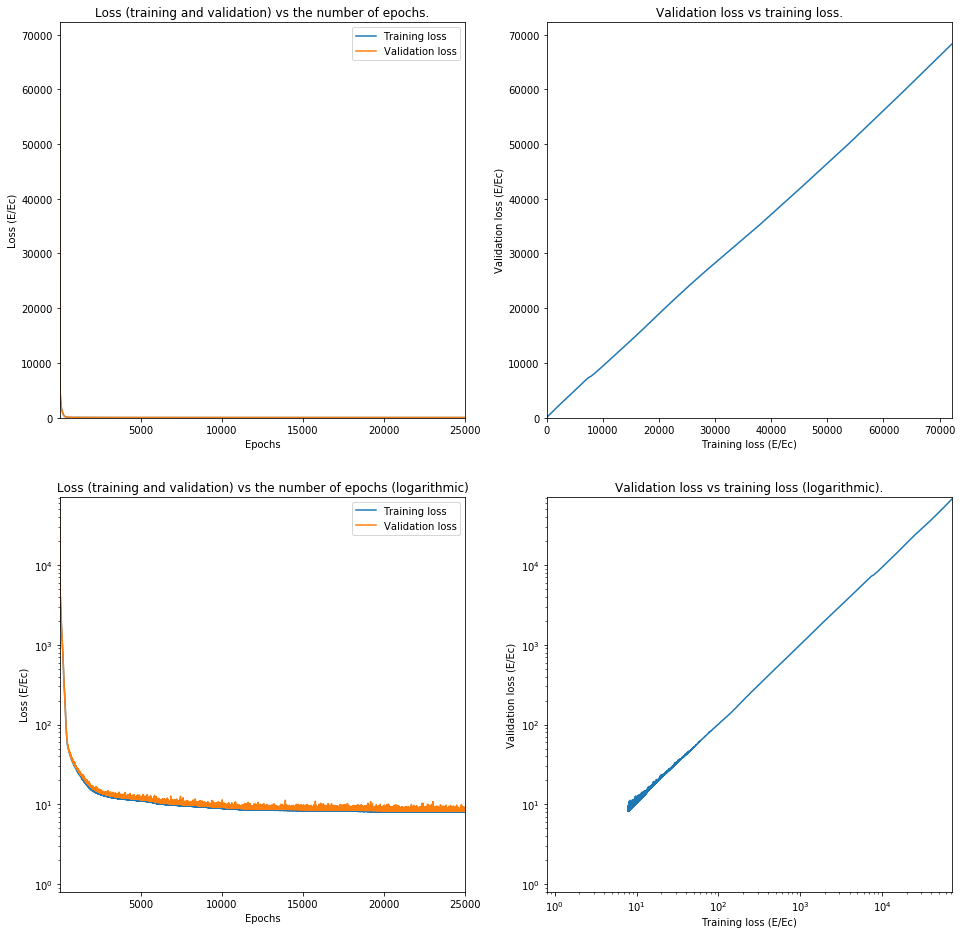

Train on 62644 samples, validate on 15662 samples
Epoch 1/25000
62644/62644 [==============================] - 2s 34us/step - loss: 106414.6719 - val_loss: 99312.0491
Epoch 2/25000
62644/62644 [==============================] - 2s 32us/step - loss: 91410.8969 - val_loss: 84457.4915
Epoch 3/25000
62644/62644 [==============================] - 2s 31us/step - loss: 77075.5059 - val_loss: 70467.1198
Epoch 4/25000
62644/62644 [==============================] - 2s 32us/step - loss: 63740.0080 - val_loss: 57658.7275
Epoch 5/25000
62644/62644 [==============================] - 2s 32us/step - loss: 51931.8048 - val_loss: 47070.3818
Epoch 6/25000
62644/62644 [==============================] - 2s 31us/step - loss: 42721.9496 - val_loss: 39058.6198
Epoch 7/25000
62644/62644 [==============================] - 2s 31us/step - loss: 35962.4019 - val_loss: 33585.4175
Epoch 8/25000
62644/62644 [==============================] - 2s 34us/step - loss: 31843.6133 - val_loss: 30616.3181
Epoch 9/25000
62644/6

62644/62644 [==============================] - 2s 34us/step - loss: 3009.4827 - val_loss: 3042.9064
Epoch 72/25000
62644/62644 [==============================] - 2s 32us/step - loss: 2979.4008 - val_loss: 3012.1924
Epoch 73/25000
62644/62644 [==============================] - 2s 32us/step - loss: 2948.7943 - val_loss: 2981.4337
Epoch 74/25000
62644/62644 [==============================] - 2s 32us/step - loss: 2919.2392 - val_loss: 2951.6377
Epoch 75/25000
62644/62644 [==============================] - 2s 32us/step - loss: 2889.4250 - val_loss: 2921.8435
Epoch 76/25000
62644/62644 [==============================] - 2s 31us/step - loss: 2859.5863 - val_loss: 2890.8212
Epoch 77/25000
62644/62644 [==============================] - 2s 31us/step - loss: 2829.5845 - val_loss: 2859.2394
Epoch 78/25000
62644/62644 [==============================] - 2s 32us/step - loss: 2798.8924 - val_loss: 2828.7394
Epoch 79/25000
62644/62644 [==============================] - 2s 31us/step - loss: 2769.2329 - 

62644/62644 [==============================] - 2s 33us/step - loss: 1077.1833 - val_loss: 1075.7012
Epoch 143/25000
62644/62644 [==============================] - 2s 36us/step - loss: 1056.4432 - val_loss: 1053.0217
Epoch 144/25000
62644/62644 [==============================] - 2s 34us/step - loss: 1035.6080 - val_loss: 1031.5698
Epoch 145/25000
62644/62644 [==============================] - 2s 35us/step - loss: 1015.0981 - val_loss: 1012.2556
Epoch 146/25000
62644/62644 [==============================] - 2s 32us/step - loss: 995.4852 - val_loss: 991.2728
Epoch 147/25000
62644/62644 [==============================] - 2s 34us/step - loss: 976.7201 - val_loss: 971.8912
Epoch 148/25000
62644/62644 [==============================] - 2s 32us/step - loss: 958.1744 - val_loss: 953.2757
Epoch 149/25000
62644/62644 [==============================] - 2s 31us/step - loss: 940.1601 - val_loss: 935.5495
Epoch 150/25000
62644/62644 [==============================] - 2s 32us/step - loss: 922.1779 - v

Epoch 214/25000
62644/62644 [==============================] - 2s 33us/step - loss: 439.4203 - val_loss: 442.7768
Epoch 215/25000
62644/62644 [==============================] - 2s 33us/step - loss: 434.9187 - val_loss: 434.1468
Epoch 216/25000
62644/62644 [==============================] - 2s 35us/step - loss: 430.2228 - val_loss: 431.7603
Epoch 217/25000
62644/62644 [==============================] - 2s 34us/step - loss: 425.7433 - val_loss: 424.5811
Epoch 218/25000
62644/62644 [==============================] - 2s 34us/step - loss: 420.8819 - val_loss: 420.9347
Epoch 219/25000
62644/62644 [==============================] - 2s 33us/step - loss: 416.5119 - val_loss: 414.7655
Epoch 220/25000
62644/62644 [==============================] - 2s 32us/step - loss: 412.0850 - val_loss: 410.5650
Epoch 221/25000
62644/62644 [==============================] - 2s 34us/step - loss: 407.4865 - val_loss: 406.3286
Epoch 222/25000
62644/62644 [==============================] - 2s 34us/step - loss: 403.

Epoch 286/25000
62644/62644 [==============================] - 2s 33us/step - loss: 195.2574 - val_loss: 195.7758
Epoch 287/25000
62644/62644 [==============================] - 2s 32us/step - loss: 193.1494 - val_loss: 194.5497
Epoch 288/25000
62644/62644 [==============================] - 2s 33us/step - loss: 191.2477 - val_loss: 192.6065
Epoch 289/25000
62644/62644 [==============================] - 2s 32us/step - loss: 189.0670 - val_loss: 189.2353
Epoch 290/25000
62644/62644 [==============================] - 2s 35us/step - loss: 187.0497 - val_loss: 187.2204
Epoch 291/25000
62644/62644 [==============================] - 2s 33us/step - loss: 185.0667 - val_loss: 185.1967
Epoch 292/25000
62644/62644 [==============================] - 2s 34us/step - loss: 183.0455 - val_loss: 184.1568
Epoch 293/25000
62644/62644 [==============================] - 2s 33us/step - loss: 181.3563 - val_loss: 181.5106
Epoch 294/25000
62644/62644 [==============================] - 2s 34us/step - loss: 179.

Epoch 358/25000
62644/62644 [==============================] - 2s 33us/step - loss: 97.0841 - val_loss: 97.2712
Epoch 359/25000
62644/62644 [==============================] - 2s 34us/step - loss: 96.4566 - val_loss: 97.1736
Epoch 360/25000
62644/62644 [==============================] - 2s 33us/step - loss: 95.6937 - val_loss: 95.7799
Epoch 361/25000
62644/62644 [==============================] - 2s 36us/step - loss: 94.8747 - val_loss: 95.0997
Epoch 362/25000
62644/62644 [==============================] - 2s 35us/step - loss: 94.1189 - val_loss: 94.1781
Epoch 363/25000
62644/62644 [==============================] - 2s 34us/step - loss: 93.3847 - val_loss: 94.7800
Epoch 364/25000
62644/62644 [==============================] - 2s 33us/step - loss: 92.6192 - val_loss: 92.9962
Epoch 365/25000
62644/62644 [==============================] - 2s 33us/step - loss: 91.8182 - val_loss: 91.8018
Epoch 366/25000
62644/62644 [==============================] - 2s 32us/step - loss: 91.1743 - val_loss: 

62644/62644 [==============================] - 2s 33us/step - loss: 59.1036 - val_loss: 60.1863
Epoch 432/25000
62644/62644 [==============================] - 2s 33us/step - loss: 58.6015 - val_loss: 58.8957
Epoch 433/25000
62644/62644 [==============================] - 2s 33us/step - loss: 58.4149 - val_loss: 59.1930
Epoch 434/25000
62644/62644 [==============================] - 2s 33us/step - loss: 57.9890 - val_loss: 58.4749
Epoch 435/25000
62644/62644 [==============================] - 2s 33us/step - loss: 57.7928 - val_loss: 58.0685
Epoch 436/25000
62644/62644 [==============================] - 2s 32us/step - loss: 57.4755 - val_loss: 57.5758
Epoch 437/25000
62644/62644 [==============================] - 2s 33us/step - loss: 57.0585 - val_loss: 57.4307
Epoch 438/25000
62644/62644 [==============================] - 2s 34us/step - loss: 56.7312 - val_loss: 56.8381
Epoch 439/25000
62644/62644 [==============================] - 2s 33us/step - loss: 56.5647 - val_loss: 57.3612
Epoch 44

62644/62644 [==============================] - 2s 33us/step - loss: 40.8826 - val_loss: 41.3641
Epoch 505/25000
62644/62644 [==============================] - 2s 33us/step - loss: 40.6669 - val_loss: 40.8193
Epoch 506/25000
62644/62644 [==============================] - 2s 33us/step - loss: 40.4636 - val_loss: 40.7079
Epoch 507/25000
62644/62644 [==============================] - 2s 34us/step - loss: 40.1866 - val_loss: 41.0070
Epoch 508/25000
62644/62644 [==============================] - 2s 34us/step - loss: 40.0267 - val_loss: 40.6613
Epoch 509/25000
62644/62644 [==============================] - 2s 34us/step - loss: 39.8553 - val_loss: 39.8421
Epoch 510/25000
62644/62644 [==============================] - 2s 33us/step - loss: 39.6703 - val_loss: 42.6787
Epoch 511/25000
62644/62644 [==============================] - 2s 34us/step - loss: 39.4783 - val_loss: 39.4633
Epoch 512/25000
62644/62644 [==============================] - 2s 34us/step - loss: 39.2284 - val_loss: 41.1095
Epoch 51

62644/62644 [==============================] - 2s 33us/step - loss: 28.0616 - val_loss: 28.0263
Epoch 578/25000
62644/62644 [==============================] - 2s 33us/step - loss: 27.8897 - val_loss: 28.2889
Epoch 579/25000
62644/62644 [==============================] - 2s 33us/step - loss: 27.7298 - val_loss: 28.8503
Epoch 580/25000
62644/62644 [==============================] - 2s 34us/step - loss: 27.5985 - val_loss: 27.6824
Epoch 581/25000
62644/62644 [==============================] - 2s 34us/step - loss: 27.4379 - val_loss: 27.5248
Epoch 582/25000
62644/62644 [==============================] - 2s 33us/step - loss: 27.3189 - val_loss: 28.2761
Epoch 583/25000
62644/62644 [==============================] - 2s 34us/step - loss: 27.1440 - val_loss: 27.1905
Epoch 584/25000
62644/62644 [==============================] - 2s 34us/step - loss: 27.0610 - val_loss: 27.9892
Epoch 585/25000
62644/62644 [==============================] - 2s 34us/step - loss: 26.9715 - val_loss: 28.7867
Epoch 58

62644/62644 [==============================] - 2s 34us/step - loss: 19.7994 - val_loss: 19.8823
Epoch 651/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.7099 - val_loss: 20.0969
Epoch 652/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.6634 - val_loss: 19.7952
Epoch 653/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.5036 - val_loss: 19.9753
Epoch 654/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.4875 - val_loss: 20.1921
Epoch 655/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.3800 - val_loss: 19.7631
Epoch 656/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.2765 - val_loss: 19.5108
Epoch 657/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.2236 - val_loss: 19.3818
Epoch 658/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.1746 - val_loss: 19.2744
Epoch 65

62644/62644 [==============================] - 2s 34us/step - loss: 15.5581 - val_loss: 15.5644
Epoch 724/25000
62644/62644 [==============================] - 2s 33us/step - loss: 15.4435 - val_loss: 16.5122
Epoch 725/25000
62644/62644 [==============================] - 2s 34us/step - loss: 15.4041 - val_loss: 15.9457
Epoch 726/25000
62644/62644 [==============================] - 2s 34us/step - loss: 15.3796 - val_loss: 16.0908
Epoch 727/25000
62644/62644 [==============================] - 2s 34us/step - loss: 15.2774 - val_loss: 16.2530
Epoch 728/25000
62644/62644 [==============================] - 2s 33us/step - loss: 15.3049 - val_loss: 15.5556
Epoch 729/25000
62644/62644 [==============================] - 2s 34us/step - loss: 15.2674 - val_loss: 15.3677
Epoch 730/25000
62644/62644 [==============================] - 2s 33us/step - loss: 15.2142 - val_loss: 15.2940
Epoch 731/25000
62644/62644 [==============================] - 2s 36us/step - loss: 15.1374 - val_loss: 15.2705
Epoch 73

62644/62644 [==============================] - 2s 33us/step - loss: 13.3783 - val_loss: 13.3570
Epoch 797/25000
62644/62644 [==============================] - 2s 36us/step - loss: 13.3109 - val_loss: 13.5793
Epoch 798/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.3130 - val_loss: 13.7354
Epoch 799/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.2723 - val_loss: 13.5107
Epoch 800/25000
62644/62644 [==============================] - 2s 35us/step - loss: 13.2343 - val_loss: 13.5977
Epoch 801/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.2236 - val_loss: 13.9033
Epoch 802/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.1713 - val_loss: 13.5335
Epoch 803/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.2180 - val_loss: 13.2263
Epoch 804/25000
62644/62644 [==============================] - 2s 37us/step - loss: 13.1963 - val_loss: 13.2240
Epoch 80

62644/62644 [==============================] - 2s 34us/step - loss: 12.0113 - val_loss: 12.4976
Epoch 870/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.0495 - val_loss: 13.7590
Epoch 871/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.0850 - val_loss: 12.2163
Epoch 872/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.0462 - val_loss: 13.0321
Epoch 873/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.9758 - val_loss: 13.5604
Epoch 874/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.0033 - val_loss: 12.0779
Epoch 875/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.9924 - val_loss: 12.8675
Epoch 876/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.0368 - val_loss: 12.1111
Epoch 877/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.9527 - val_loss: 11.9968
Epoch 87

62644/62644 [==============================] - 2s 34us/step - loss: 11.3115 - val_loss: 11.6058
Epoch 943/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.3456 - val_loss: 11.4646
Epoch 944/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.3617 - val_loss: 12.6067
Epoch 945/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.2863 - val_loss: 11.3063
Epoch 946/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.3717 - val_loss: 11.5137
Epoch 947/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2520 - val_loss: 11.3065
Epoch 948/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.2731 - val_loss: 11.3440
Epoch 949/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2671 - val_loss: 11.3026
Epoch 950/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2555 - val_loss: 11.3126
Epoch 95

62644/62644 [==============================] - 2s 33us/step - loss: 10.9127 - val_loss: 10.9385
Epoch 1016/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.9424 - val_loss: 13.8326
Epoch 1017/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9401 - val_loss: 10.9207
Epoch 1018/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.9762 - val_loss: 11.0500
Epoch 1019/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.9001 - val_loss: 10.9841
Epoch 1020/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.9566 - val_loss: 11.6858
Epoch 1021/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.8923 - val_loss: 11.2340
Epoch 1022/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.9511 - val_loss: 11.3886
Epoch 1023/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.9006 - val_loss: 11.3922


62644/62644 [==============================] - 2s 33us/step - loss: 10.6739 - val_loss: 10.8029
Epoch 1088/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6929 - val_loss: 10.8640
Epoch 1089/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6925 - val_loss: 10.7971
Epoch 1090/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7073 - val_loss: 10.8408
Epoch 1091/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6312 - val_loss: 10.8311
Epoch 1092/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7143 - val_loss: 11.4740
Epoch 1093/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.6941 - val_loss: 10.6813
Epoch 1094/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.7029 - val_loss: 10.6521
Epoch 1095/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6413 - val_loss: 10.7612


62644/62644 [==============================] - 2s 33us/step - loss: 10.5794 - val_loss: 12.5032
Epoch 1160/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.4997 - val_loss: 10.5579
Epoch 1161/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.5405 - val_loss: 10.4927
Epoch 1162/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.5094 - val_loss: 12.6823
Epoch 1163/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4587 - val_loss: 10.8218
Epoch 1164/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4546 - val_loss: 10.4975
Epoch 1165/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.5272 - val_loss: 10.5268
Epoch 1166/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.5319 - val_loss: 10.8179
Epoch 1167/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4818 - val_loss: 10.8900


62644/62644 [==============================] - 2s 34us/step - loss: 10.3632 - val_loss: 10.4316
Epoch 1232/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3695 - val_loss: 10.3559
Epoch 1233/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3402 - val_loss: 10.6019
Epoch 1234/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3672 - val_loss: 12.8451
Epoch 1235/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.4098 - val_loss: 12.4610
Epoch 1236/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3977 - val_loss: 10.7111
Epoch 1237/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3410 - val_loss: 10.3838
Epoch 1238/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3645 - val_loss: 11.7358
Epoch 1239/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.4366 - val_loss: 10.5299


62644/62644 [==============================] - 2s 34us/step - loss: 10.3098 - val_loss: 12.1710
Epoch 1304/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3351 - val_loss: 11.7836
Epoch 1305/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2157 - val_loss: 10.2618
Epoch 1306/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2449 - val_loss: 10.4770
Epoch 1307/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2387 - val_loss: 10.4488
Epoch 1308/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2246 - val_loss: 11.6607
Epoch 1309/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2720 - val_loss: 11.0505
Epoch 1310/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2063 - val_loss: 10.9185
Epoch 1311/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2237 - val_loss: 10.2786


62644/62644 [==============================] - 2s 31us/step - loss: 10.1585 - val_loss: 10.2092
Epoch 1376/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1253 - val_loss: 12.4131
Epoch 1377/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1444 - val_loss: 10.1680
Epoch 1378/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1666 - val_loss: 10.4397
Epoch 1379/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1753 - val_loss: 10.1656
Epoch 1380/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1326 - val_loss: 10.4227
Epoch 1381/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1354 - val_loss: 10.4634
Epoch 1382/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1136 - val_loss: 10.1745
Epoch 1383/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0786 - val_loss: 10.1408


62644/62644 [==============================] - 2s 34us/step - loss: 10.1118 - val_loss: 10.9539
Epoch 1448/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0377 - val_loss: 10.2037
Epoch 1449/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0305 - val_loss: 10.3695
Epoch 1450/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0411 - val_loss: 10.2121
Epoch 1451/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0335 - val_loss: 10.3543
Epoch 1452/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1550 - val_loss: 10.5236
Epoch 1453/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0365 - val_loss: 10.0767
Epoch 1454/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0393 - val_loss: 10.1293
Epoch 1455/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1011 - val_loss: 10.6568


Epoch 1520/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0288 - val_loss: 10.2385
Epoch 1521/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9904 - val_loss: 10.2524
Epoch 1522/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9790 - val_loss: 10.1727
Epoch 1523/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9946 - val_loss: 10.0591
Epoch 1524/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9581 - val_loss: 10.3686
Epoch 1525/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9371 - val_loss: 10.0700
Epoch 1526/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0191 - val_loss: 10.2187
Epoch 1527/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9930 - val_loss: 10.2155
Epoch 1528/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9525 - val_loss

62644/62644 [==============================] - 2s 31us/step - loss: 9.8944 - val_loss: 10.0655
Epoch 1594/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9034 - val_loss: 10.4155
Epoch 1595/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9330 - val_loss: 10.7108
Epoch 1596/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8979 - val_loss: 9.9548
Epoch 1597/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9219 - val_loss: 10.4433
Epoch 1598/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9692 - val_loss: 10.0573
Epoch 1599/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8874 - val_loss: 10.0588
Epoch 1600/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8949 - val_loss: 10.2767
Epoch 1601/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8635 - val_loss: 10.0802
Epoch 1602

62644/62644 [==============================] - 2s 38us/step - loss: 9.8368 - val_loss: 9.9572
Epoch 1667/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8866 - val_loss: 11.0016
Epoch 1668/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8454 - val_loss: 9.9282
Epoch 1669/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.8413 - val_loss: 9.9921
Epoch 1670/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.8493 - val_loss: 10.0545
Epoch 1671/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8203 - val_loss: 10.2124
Epoch 1672/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8221 - val_loss: 10.8738
Epoch 1673/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8287 - val_loss: 10.3128
Epoch 1674/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.9334 - val_loss: 10.5562
Epoch 1675/2

62644/62644 [==============================] - 2s 37us/step - loss: 9.7650 - val_loss: 10.3576
Epoch 1740/25000
62644/62644 [==============================] - 2s 40us/step - loss: 9.7875 - val_loss: 10.0588
Epoch 1741/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7895 - val_loss: 10.2338
Epoch 1742/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.8780 - val_loss: 10.0530
Epoch 1743/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8493 - val_loss: 10.6876
Epoch 1744/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7873 - val_loss: 10.2661
Epoch 1745/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7833 - val_loss: 10.1212
Epoch 1746/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7575 - val_loss: 10.1033
Epoch 1747/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8031 - val_loss: 10.8799
Epoch 174

62644/62644 [==============================] - 2s 32us/step - loss: 9.7385 - val_loss: 10.4358
Epoch 1813/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7398 - val_loss: 10.2502
Epoch 1814/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7337 - val_loss: 9.8475
Epoch 1815/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7996 - val_loss: 9.9709
Epoch 1816/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7199 - val_loss: 10.4884
Epoch 1817/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7724 - val_loss: 9.8621
Epoch 1818/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7842 - val_loss: 11.0453
Epoch 1819/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7771 - val_loss: 9.9660
Epoch 1820/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7875 - val_loss: 12.9574
Epoch 1821/25

62644/62644 [==============================] - 2s 31us/step - loss: 9.7416 - val_loss: 9.9209
Epoch 1886/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7199 - val_loss: 10.6740
Epoch 1887/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6871 - val_loss: 10.8427
Epoch 1888/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8025 - val_loss: 10.1284
Epoch 1889/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7880 - val_loss: 10.5801
Epoch 1890/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7505 - val_loss: 10.0895
Epoch 1891/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7193 - val_loss: 9.9436
Epoch 1892/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7118 - val_loss: 10.2111
Epoch 1893/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7125 - val_loss: 9.9938
Epoch 1894/2

62644/62644 [==============================] - 2s 32us/step - loss: 9.6751 - val_loss: 9.8180
Epoch 1959/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7448 - val_loss: 10.0930
Epoch 1960/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7532 - val_loss: 9.8658
Epoch 1961/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6655 - val_loss: 10.0644
Epoch 1962/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6866 - val_loss: 10.0101
Epoch 1963/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6617 - val_loss: 9.8653
Epoch 1964/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7125 - val_loss: 10.8320
Epoch 1965/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7662 - val_loss: 9.9280
Epoch 1966/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6480 - val_loss: 11.2505
Epoch 1967/25

62644/62644 [==============================] - 2s 31us/step - loss: 9.6635 - val_loss: 9.7929
Epoch 2032/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6978 - val_loss: 9.7697
Epoch 2033/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6212 - val_loss: 9.8046
Epoch 2034/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6544 - val_loss: 10.3419
Epoch 2035/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7030 - val_loss: 9.8215
Epoch 2036/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6502 - val_loss: 10.1361
Epoch 2037/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6764 - val_loss: 10.7495
Epoch 2038/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6768 - val_loss: 9.9822
Epoch 2039/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6607 - val_loss: 9.7878
Epoch 2040/2500

62644/62644 [==============================] - 2s 33us/step - loss: 9.6762 - val_loss: 9.8393
Epoch 2105/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6319 - val_loss: 9.7928
Epoch 2106/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6375 - val_loss: 10.4898
Epoch 2107/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6451 - val_loss: 9.7934
Epoch 2108/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7187 - val_loss: 9.8899
Epoch 2109/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6476 - val_loss: 9.7138
Epoch 2110/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6863 - val_loss: 10.9352
Epoch 2111/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5661 - val_loss: 10.2906
Epoch 2112/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6413 - val_loss: 10.8384
Epoch 2113/250

62644/62644 [==============================] - 2s 32us/step - loss: 9.5534 - val_loss: 10.0673
Epoch 2178/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6243 - val_loss: 11.2087
Epoch 2179/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6344 - val_loss: 10.3355
Epoch 2180/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6257 - val_loss: 9.8817
Epoch 2181/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6294 - val_loss: 10.3761
Epoch 2182/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5695 - val_loss: 9.9784
Epoch 2183/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5938 - val_loss: 9.8334
Epoch 2184/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5750 - val_loss: 10.3768
Epoch 2185/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.6477 - val_loss: 9.7642
Epoch 2186/25

62644/62644 [==============================] - 2s 31us/step - loss: 9.5588 - val_loss: 10.0486
Epoch 2251/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6413 - val_loss: 11.3429
Epoch 2252/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5580 - val_loss: 9.6563
Epoch 2253/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6683 - val_loss: 11.4134
Epoch 2254/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6241 - val_loss: 9.9213
Epoch 2255/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5142 - val_loss: 9.8061
Epoch 2256/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5867 - val_loss: 10.7534
Epoch 2257/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5513 - val_loss: 9.8381
Epoch 2258/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6580 - val_loss: 10.3620
Epoch 2259/25

62644/62644 [==============================] - 2s 32us/step - loss: 9.5334 - val_loss: 10.0907
Epoch 2324/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6063 - val_loss: 9.8491
Epoch 2325/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5438 - val_loss: 9.6508
Epoch 2326/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5596 - val_loss: 9.6447
Epoch 2327/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6085 - val_loss: 10.6655
Epoch 2328/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5506 - val_loss: 9.8656
Epoch 2329/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5877 - val_loss: 9.7657
Epoch 2330/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5436 - val_loss: 9.6405
Epoch 2331/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5526 - val_loss: 9.6315
Epoch 2332/25000

62644/62644 [==============================] - 2s 33us/step - loss: 9.4914 - val_loss: 9.8143
Epoch 2397/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5286 - val_loss: 10.3648
Epoch 2398/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6106 - val_loss: 9.6620
Epoch 2399/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5203 - val_loss: 9.6730
Epoch 2400/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5164 - val_loss: 9.8092
Epoch 2401/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5291 - val_loss: 9.7447
Epoch 2402/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5384 - val_loss: 9.6227
Epoch 2403/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5210 - val_loss: 9.6991
Epoch 2404/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5458 - val_loss: 9.7489
Epoch 2405/25000


62644/62644 [==============================] - 2s 32us/step - loss: 9.4581 - val_loss: 11.9769
Epoch 2470/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4789 - val_loss: 9.5971
Epoch 2471/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5386 - val_loss: 9.6736
Epoch 2472/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5358 - val_loss: 9.6058
Epoch 2473/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5567 - val_loss: 9.6451
Epoch 2474/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5038 - val_loss: 11.0726
Epoch 2475/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5412 - val_loss: 9.8230
Epoch 2476/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5232 - val_loss: 9.8357
Epoch 2477/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5102 - val_loss: 9.6036
Epoch 2478/25000

Epoch 2543/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5345 - val_loss: 10.5670
Epoch 2544/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5127 - val_loss: 9.7742
Epoch 2545/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5440 - val_loss: 9.7235
Epoch 2546/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4994 - val_loss: 10.0923
Epoch 2547/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4731 - val_loss: 9.9623
Epoch 2548/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5021 - val_loss: 9.6244
Epoch 2549/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5016 - val_loss: 9.6229
Epoch 2550/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4711 - val_loss: 9.6195
Epoch 2551/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5000 - val_loss: 10.023

62644/62644 [==============================] - 2s 32us/step - loss: 9.4399 - val_loss: 10.7326
Epoch 2617/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5324 - val_loss: 9.6202
Epoch 2618/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5359 - val_loss: 9.6150
Epoch 2619/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4891 - val_loss: 11.2870
Epoch 2620/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4458 - val_loss: 9.6039
Epoch 2621/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4892 - val_loss: 9.9875
Epoch 2622/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4593 - val_loss: 11.3610
Epoch 2623/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5587 - val_loss: 9.8378
Epoch 2624/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4446 - val_loss: 9.9092
Epoch 2625/2500

62644/62644 [==============================] - 2s 32us/step - loss: 9.4868 - val_loss: 9.9748
Epoch 2690/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4626 - val_loss: 9.6889
Epoch 2691/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3992 - val_loss: 9.5560
Epoch 2692/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5037 - val_loss: 9.6835
Epoch 2693/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4505 - val_loss: 10.7090
Epoch 2694/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5046 - val_loss: 10.2966
Epoch 2695/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4560 - val_loss: 9.5749
Epoch 2696/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4258 - val_loss: 9.5515
Epoch 2697/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4799 - val_loss: 9.8715
Epoch 2698/25000

Epoch 2763/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4243 - val_loss: 9.6354
Epoch 2764/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4337 - val_loss: 11.3636
Epoch 2765/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4602 - val_loss: 10.2245
Epoch 2766/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4414 - val_loss: 10.0512
Epoch 2767/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4334 - val_loss: 9.5583
Epoch 2768/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4867 - val_loss: 9.6294
Epoch 2769/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4416 - val_loss: 10.7739
Epoch 2770/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4165 - val_loss: 9.5404
Epoch 2771/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4097 - val_loss: 9.67

62644/62644 [==============================] - 2s 34us/step - loss: 9.3797 - val_loss: 10.3507
Epoch 2837/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4376 - val_loss: 9.5979
Epoch 2838/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3924 - val_loss: 10.1442
Epoch 2839/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4237 - val_loss: 9.5465
Epoch 2840/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3949 - val_loss: 9.8144
Epoch 2841/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4617 - val_loss: 9.5281
Epoch 2842/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4337 - val_loss: 10.4214
Epoch 2843/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4499 - val_loss: 9.6989
Epoch 2844/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4706 - val_loss: 9.8424
Epoch 2845/2500

Epoch 2910/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4677 - val_loss: 9.9951
Epoch 2911/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4379 - val_loss: 9.7047
Epoch 2912/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4580 - val_loss: 9.6006
Epoch 2913/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4197 - val_loss: 9.5054
Epoch 2914/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4250 - val_loss: 10.2921
Epoch 2915/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4467 - val_loss: 9.9095
Epoch 2916/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4106 - val_loss: 9.5478
Epoch 2917/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4510 - val_loss: 9.5603
Epoch 2918/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4276 - val_loss: 10.5186

62644/62644 [==============================] - 2s 31us/step - loss: 9.3963 - val_loss: 9.5535
Epoch 2984/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4771 - val_loss: 10.0171
Epoch 2985/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4236 - val_loss: 9.4806
Epoch 2986/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4556 - val_loss: 10.0337
Epoch 2987/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3771 - val_loss: 9.7875
Epoch 2988/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3999 - val_loss: 9.5681
Epoch 2989/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4187 - val_loss: 10.3131
Epoch 2990/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4404 - val_loss: 9.5213
Epoch 2991/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4098 - val_loss: 9.4949
Epoch 2992/2500

Epoch 3057/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4266 - val_loss: 9.4702
Epoch 3058/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4076 - val_loss: 11.0712
Epoch 3059/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4322 - val_loss: 10.2352
Epoch 3060/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3346 - val_loss: 10.7712
Epoch 3061/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3792 - val_loss: 9.6183
Epoch 3062/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4129 - val_loss: 9.5121
Epoch 3063/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4001 - val_loss: 9.6492
Epoch 3064/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3940 - val_loss: 9.6495
Epoch 3065/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3596 - val_loss: 10.06

62644/62644 [==============================] - 2s 34us/step - loss: 9.3713 - val_loss: 9.9431
Epoch 3131/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3262 - val_loss: 9.5058
Epoch 3132/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3951 - val_loss: 10.0357
Epoch 3133/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3468 - val_loss: 9.6642
Epoch 3134/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4274 - val_loss: 9.5450
Epoch 3135/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4269 - val_loss: 9.5509
Epoch 3136/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3239 - val_loss: 9.8339
Epoch 3137/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3851 - val_loss: 10.1550
Epoch 3138/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3699 - val_loss: 9.6820
Epoch 3139/25000

Epoch 3204/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3127 - val_loss: 10.0993
Epoch 3205/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3759 - val_loss: 10.1799
Epoch 3206/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3052 - val_loss: 9.4602
Epoch 3207/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3498 - val_loss: 9.7939
Epoch 3208/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3536 - val_loss: 11.4892
Epoch 3209/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3602 - val_loss: 9.5015
Epoch 3210/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3840 - val_loss: 9.9233
Epoch 3211/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3461 - val_loss: 10.7010
Epoch 3212/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3122 - val_loss: 9.82

62644/62644 [==============================] - 2s 32us/step - loss: 9.3825 - val_loss: 10.5619
Epoch 3278/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3765 - val_loss: 9.6082
Epoch 3279/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3085 - val_loss: 9.7794
Epoch 3280/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3363 - val_loss: 11.5715
Epoch 3281/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3489 - val_loss: 9.5065
Epoch 3282/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2918 - val_loss: 9.4412
Epoch 3283/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3381 - val_loss: 9.6454
Epoch 3284/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3332 - val_loss: 9.8497
Epoch 3285/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3410 - val_loss: 9.4611
Epoch 3286/25000

62644/62644 [==============================] - 2s 34us/step - loss: 9.3220 - val_loss: 9.6214
Epoch 3351/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3498 - val_loss: 11.8412
Epoch 3352/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3500 - val_loss: 10.0247
Epoch 3353/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3690 - val_loss: 9.4567
Epoch 3354/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3457 - val_loss: 9.5008
Epoch 3355/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3367 - val_loss: 9.5305
Epoch 3356/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3029 - val_loss: 9.6289
Epoch 3357/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3125 - val_loss: 10.1440
Epoch 3358/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3481 - val_loss: 9.4390
Epoch 3359/2500

Epoch 3424/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3432 - val_loss: 10.3091
Epoch 3425/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3364 - val_loss: 9.4049
Epoch 3426/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3038 - val_loss: 9.5307
Epoch 3427/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3463 - val_loss: 9.9357
Epoch 3428/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3085 - val_loss: 9.9919
Epoch 3429/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3003 - val_loss: 9.4567
Epoch 3430/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3557 - val_loss: 9.4786
Epoch 3431/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3429 - val_loss: 9.4338
Epoch 3432/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3195 - val_loss: 9.7761


62644/62644 [==============================] - 2s 31us/step - loss: 9.3161 - val_loss: 9.6703
Epoch 3498/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3161 - val_loss: 10.2253
Epoch 3499/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2883 - val_loss: 9.4138
Epoch 3500/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2601 - val_loss: 9.5510
Epoch 3501/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3384 - val_loss: 9.5459
Epoch 3502/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2629 - val_loss: 9.4086
Epoch 3503/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3062 - val_loss: 10.1159
Epoch 3504/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3414 - val_loss: 9.4201
Epoch 3505/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2878 - val_loss: 9.4078
Epoch 3506/25000

Epoch 3571/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3400 - val_loss: 9.4879
Epoch 3572/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2960 - val_loss: 9.3733
Epoch 3573/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2847 - val_loss: 9.6825
Epoch 3574/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3520 - val_loss: 9.4585
Epoch 3575/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3470 - val_loss: 9.5037
Epoch 3576/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3142 - val_loss: 9.7343
Epoch 3577/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2778 - val_loss: 9.7671
Epoch 3578/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3266 - val_loss: 9.4667
Epoch 3579/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3389 - val_loss: 10.2555


62644/62644 [==============================] - 2s 32us/step - loss: 9.2387 - val_loss: 9.9806
Epoch 3645/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2467 - val_loss: 9.7097
Epoch 3646/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3808 - val_loss: 10.5413
Epoch 3647/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2962 - val_loss: 10.6697
Epoch 3648/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2903 - val_loss: 10.1444
Epoch 3649/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2678 - val_loss: 9.4135
Epoch 3650/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3331 - val_loss: 9.3932
Epoch 3651/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2403 - val_loss: 9.3927
Epoch 3652/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2857 - val_loss: 9.8187
Epoch 3653/2500

Epoch 3718/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2551 - val_loss: 9.9969
Epoch 3719/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2504 - val_loss: 9.8695
Epoch 3720/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2515 - val_loss: 10.5213
Epoch 3721/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2725 - val_loss: 9.4629
Epoch 3722/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3360 - val_loss: 9.6295
Epoch 3723/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2802 - val_loss: 9.3890
Epoch 3724/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2868 - val_loss: 9.3933
Epoch 3725/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2789 - val_loss: 9.3862
Epoch 3726/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3133 - val_loss: 9.5074


62644/62644 [==============================] - 2s 32us/step - loss: 9.2342 - val_loss: 9.3493
Epoch 3792/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2618 - val_loss: 10.4888
Epoch 3793/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3186 - val_loss: 9.4266
Epoch 3794/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2596 - val_loss: 11.8392
Epoch 3795/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2848 - val_loss: 9.4878
Epoch 3796/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2641 - val_loss: 10.0280
Epoch 3797/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2753 - val_loss: 9.9315
Epoch 3798/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2910 - val_loss: 11.6479
Epoch 3799/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2399 - val_loss: 9.5715
Epoch 3800/250

Epoch 3865/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2671 - val_loss: 9.7075
Epoch 3866/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2600 - val_loss: 9.3656
Epoch 3867/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2804 - val_loss: 10.7937
Epoch 3868/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2434 - val_loss: 10.2684
Epoch 3869/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2896 - val_loss: 9.9589
Epoch 3870/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2277 - val_loss: 9.3617
Epoch 3871/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2352 - val_loss: 9.7391
Epoch 3872/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3130 - val_loss: 11.3083
Epoch 3873/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2135 - val_loss: 9.461

62644/62644 [==============================] - 2s 31us/step - loss: 9.1742 - val_loss: 10.6943
Epoch 3939/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2943 - val_loss: 9.6864
Epoch 3940/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1796 - val_loss: 9.3997
Epoch 3941/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1919 - val_loss: 9.3335
Epoch 3942/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2935 - val_loss: 9.3539
Epoch 3943/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2053 - val_loss: 9.3792
Epoch 3944/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2525 - val_loss: 9.6427
Epoch 3945/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1990 - val_loss: 9.4506
Epoch 3946/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2248 - val_loss: 9.4886
Epoch 3947/25000


Epoch 4012/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2145 - val_loss: 9.3245
Epoch 4013/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2283 - val_loss: 9.9866
Epoch 4014/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2095 - val_loss: 9.4909
Epoch 4015/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2576 - val_loss: 10.5818
Epoch 4016/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2518 - val_loss: 9.3436
Epoch 4017/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2364 - val_loss: 10.2046
Epoch 4018/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2234 - val_loss: 9.3891
Epoch 4019/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2124 - val_loss: 9.6143
Epoch 4020/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2454 - val_loss: 9.3564

62644/62644 [==============================] - 2s 31us/step - loss: 9.2690 - val_loss: 9.2952
Epoch 4086/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2205 - val_loss: 9.7879
Epoch 4087/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2547 - val_loss: 9.9016
Epoch 4088/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2768 - val_loss: 11.5934
Epoch 4089/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1738 - val_loss: 9.4164
Epoch 4090/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2546 - val_loss: 10.4278
Epoch 4091/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2216 - val_loss: 9.3801
Epoch 4092/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2225 - val_loss: 9.5472
Epoch 4093/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2522 - val_loss: 12.0063
Epoch 4094/2500

62644/62644 [==============================] - 2s 33us/step - loss: 9.2148 - val_loss: 9.4418
Epoch 4159/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1880 - val_loss: 9.5580
Epoch 4160/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2419 - val_loss: 9.3347
Epoch 4161/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1993 - val_loss: 9.6868
Epoch 4162/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2469 - val_loss: 10.0009
Epoch 4163/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2343 - val_loss: 10.3487
Epoch 4164/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2091 - val_loss: 10.1906
Epoch 4165/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2158 - val_loss: 9.4803
Epoch 4166/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1675 - val_loss: 9.8800
Epoch 4167/2500

Epoch 4232/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2212 - val_loss: 10.6726
Epoch 4233/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1840 - val_loss: 9.5207
Epoch 4234/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1950 - val_loss: 9.8493
Epoch 4235/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2008 - val_loss: 10.7814
Epoch 4236/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2191 - val_loss: 9.2790
Epoch 4237/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1922 - val_loss: 10.4996
Epoch 4238/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2281 - val_loss: 10.2707
Epoch 4239/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2163 - val_loss: 9.5326
Epoch 4240/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2390 - val_loss: 10.1

62644/62644 [==============================] - 2s 31us/step - loss: 9.1985 - val_loss: 9.2747
Epoch 4306/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1850 - val_loss: 10.4793
Epoch 4307/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1835 - val_loss: 9.4019
Epoch 4308/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2150 - val_loss: 10.3442
Epoch 4309/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1278 - val_loss: 9.7550
Epoch 4310/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2438 - val_loss: 9.5404
Epoch 4311/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1447 - val_loss: 9.3163
Epoch 4312/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2286 - val_loss: 9.6439
Epoch 4313/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1555 - val_loss: 9.5736
Epoch 4314/25000

Epoch 4379/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2039 - val_loss: 9.9811
Epoch 4380/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1484 - val_loss: 9.9335
Epoch 4381/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2069 - val_loss: 9.3052
Epoch 4382/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1990 - val_loss: 9.4668
Epoch 4383/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2026 - val_loss: 9.5484
Epoch 4384/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1617 - val_loss: 9.2870
Epoch 4385/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1668 - val_loss: 10.1432
Epoch 4386/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1886 - val_loss: 9.2979
Epoch 4387/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2372 - val_loss: 9.3345


62644/62644 [==============================] - 2s 31us/step - loss: 9.1083 - val_loss: 9.6005
Epoch 4453/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1750 - val_loss: 9.2986
Epoch 4454/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1377 - val_loss: 9.4385
Epoch 4455/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1490 - val_loss: 9.4074
Epoch 4456/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2454 - val_loss: 9.2536
Epoch 4457/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1813 - val_loss: 9.3257
Epoch 4458/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1774 - val_loss: 9.6099
Epoch 4459/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1773 - val_loss: 9.5928
Epoch 4460/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2065 - val_loss: 10.2632
Epoch 4461/25000


Epoch 4526/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1619 - val_loss: 9.6368
Epoch 4527/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1321 - val_loss: 9.4290
Epoch 4528/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1583 - val_loss: 9.3932
Epoch 4529/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1880 - val_loss: 12.5521
Epoch 4530/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1635 - val_loss: 9.5946
Epoch 4531/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1691 - val_loss: 9.2293
Epoch 4532/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1951 - val_loss: 9.2628
Epoch 4533/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1565 - val_loss: 9.4744
Epoch 4534/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1419 - val_loss: 9.2613


62644/62644 [==============================] - 2s 31us/step - loss: 9.1482 - val_loss: 9.3461
Epoch 4600/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1724 - val_loss: 9.4640
Epoch 4601/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2073 - val_loss: 9.3133
Epoch 4602/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1709 - val_loss: 9.3090
Epoch 4603/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2132 - val_loss: 9.4445
Epoch 4604/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1375 - val_loss: 9.4108
Epoch 4605/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1451 - val_loss: 9.4751
Epoch 4606/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1477 - val_loss: 9.9268
Epoch 4607/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2227 - val_loss: 10.2537
Epoch 4608/25000


Epoch 4673/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1464 - val_loss: 9.2504
Epoch 4674/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1777 - val_loss: 9.3086
Epoch 4675/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1386 - val_loss: 9.2838
Epoch 4676/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1148 - val_loss: 9.7583
Epoch 4677/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1442 - val_loss: 9.6674
Epoch 4678/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1326 - val_loss: 9.3219
Epoch 4679/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1857 - val_loss: 9.9876
Epoch 4680/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1470 - val_loss: 9.3866
Epoch 4681/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1573 - val_loss: 9.3069
E

62644/62644 [==============================] - 2s 32us/step - loss: 9.2166 - val_loss: 10.8165
Epoch 4747/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1303 - val_loss: 9.5429
Epoch 4748/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1736 - val_loss: 9.4228
Epoch 4749/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1068 - val_loss: 11.0201
Epoch 4750/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1376 - val_loss: 9.3230
Epoch 4751/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1611 - val_loss: 9.3797
Epoch 4752/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.1761 - val_loss: 10.7124
Epoch 4753/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1761 - val_loss: 10.8640
Epoch 4754/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2010 - val_loss: 9.2637
Epoch 4755/250

Epoch 4820/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.1112 - val_loss: 11.9050
Epoch 4821/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.1507 - val_loss: 9.2668
Epoch 4822/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.1705 - val_loss: 9.1989
Epoch 4823/25000
62644/62644 [==============================] - 3s 46us/step - loss: 9.1249 - val_loss: 10.5821
Epoch 4824/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1424 - val_loss: 9.7235
Epoch 4825/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1545 - val_loss: 9.3968
Epoch 4826/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1636 - val_loss: 9.8455
Epoch 4827/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1869 - val_loss: 9.5318
Epoch 4828/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1580 - val_loss: 9.8282

62644/62644 [==============================] - 2s 32us/step - loss: 9.1532 - val_loss: 9.7801
Epoch 4894/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1066 - val_loss: 9.4353
Epoch 4895/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1024 - val_loss: 9.2575
Epoch 4896/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1010 - val_loss: 9.5134
Epoch 4897/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1134 - val_loss: 9.6908
Epoch 4898/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2439 - val_loss: 9.4218
Epoch 4899/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1510 - val_loss: 11.7936
Epoch 4900/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1123 - val_loss: 9.1912
Epoch 4901/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0687 - val_loss: 9.3573
Epoch 4902/25000


Epoch 4967/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1163 - val_loss: 9.2247
Epoch 4968/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0642 - val_loss: 9.5083
Epoch 4969/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1877 - val_loss: 9.2131
Epoch 4970/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1199 - val_loss: 9.3700
Epoch 4971/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0885 - val_loss: 9.3842
Epoch 4972/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1599 - val_loss: 9.5684
Epoch 4973/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1019 - val_loss: 10.0022
Epoch 4974/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1702 - val_loss: 9.2282
Epoch 4975/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1415 - val_loss: 9.3303


62644/62644 [==============================] - 2s 31us/step - loss: 9.1389 - val_loss: 9.2351
Epoch 5041/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1362 - val_loss: 9.6646
Epoch 5042/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1064 - val_loss: 9.2775
Epoch 5043/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0744 - val_loss: 9.3381
Epoch 5044/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1755 - val_loss: 9.2001
Epoch 5045/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1157 - val_loss: 10.3199
Epoch 5046/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0705 - val_loss: 9.2003
Epoch 5047/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1520 - val_loss: 9.5307
Epoch 5048/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0928 - val_loss: 9.6559
Epoch 5049/25000


Epoch 5114/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0899 - val_loss: 9.4861
Epoch 5115/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1142 - val_loss: 9.9366
Epoch 5116/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1308 - val_loss: 9.4489
Epoch 5117/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1148 - val_loss: 10.2897
Epoch 5118/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0631 - val_loss: 9.3086
Epoch 5119/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1219 - val_loss: 10.7426
Epoch 5120/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1234 - val_loss: 9.6793
Epoch 5121/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0799 - val_loss: 9.1999
Epoch 5122/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0677 - val_loss: 9.5184

62644/62644 [==============================] - 2s 31us/step - loss: 9.0665 - val_loss: 9.2878
Epoch 5188/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0779 - val_loss: 9.6776
Epoch 5189/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1002 - val_loss: 9.7063
Epoch 5190/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1330 - val_loss: 10.3338
Epoch 5191/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1089 - val_loss: 9.4588
Epoch 5192/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0918 - val_loss: 9.4539
Epoch 5193/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1534 - val_loss: 9.4590
Epoch 5194/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1029 - val_loss: 10.2025
Epoch 5195/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0989 - val_loss: 10.0820
Epoch 5196/2500

Epoch 5261/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1691 - val_loss: 9.1515
Epoch 5262/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0976 - val_loss: 9.3901
Epoch 5263/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0643 - val_loss: 10.1188
Epoch 5264/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0430 - val_loss: 9.6487
Epoch 5265/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0784 - val_loss: 9.5861
Epoch 5266/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1677 - val_loss: 10.0296
Epoch 5267/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1004 - val_loss: 9.1776
Epoch 5268/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1047 - val_loss: 9.2765
Epoch 5269/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0995 - val_loss: 9.2068

62644/62644 [==============================] - 2s 33us/step - loss: 9.0842 - val_loss: 9.1969
Epoch 5335/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0839 - val_loss: 9.3258
Epoch 5336/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0854 - val_loss: 9.1746
Epoch 5337/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0701 - val_loss: 9.2161
Epoch 5338/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0716 - val_loss: 9.9178
Epoch 5339/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1392 - val_loss: 9.2636
Epoch 5340/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0545 - val_loss: 9.2484
Epoch 5341/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0677 - val_loss: 9.4013
Epoch 5342/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1244 - val_loss: 9.1917
Epoch 5343/25000
6

Epoch 5408/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0626 - val_loss: 9.1705
Epoch 5409/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0751 - val_loss: 9.6172
Epoch 5410/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0988 - val_loss: 9.2127
Epoch 5411/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1444 - val_loss: 9.2717
Epoch 5412/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1178 - val_loss: 9.3233
Epoch 5413/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0920 - val_loss: 9.8362
Epoch 5414/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0981 - val_loss: 10.4408
Epoch 5415/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0149 - val_loss: 9.2011
Epoch 5416/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1186 - val_loss: 9.3852


62644/62644 [==============================] - 2s 33us/step - loss: 9.0775 - val_loss: 9.1379
Epoch 5482/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0621 - val_loss: 9.5350
Epoch 5483/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0523 - val_loss: 9.3935
Epoch 5484/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0772 - val_loss: 10.5411
Epoch 5485/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0996 - val_loss: 9.4002
Epoch 5486/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0301 - val_loss: 9.4507
Epoch 5487/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1103 - val_loss: 9.5529
Epoch 5488/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0389 - val_loss: 9.2746
Epoch 5489/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1590 - val_loss: 9.2056
Epoch 5490/25000


Epoch 5555/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1229 - val_loss: 9.4741
Epoch 5556/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0707 - val_loss: 9.1463
Epoch 5557/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0840 - val_loss: 9.8439
Epoch 5558/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1423 - val_loss: 9.1287
Epoch 5559/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0673 - val_loss: 9.7268
Epoch 5560/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1379 - val_loss: 9.2393
Epoch 5561/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0268 - val_loss: 9.1285
Epoch 5562/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0767 - val_loss: 9.2341
Epoch 5563/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0483 - val_loss: 9.2745
E

62644/62644 [==============================] - 2s 31us/step - loss: 9.0443 - val_loss: 9.3423
Epoch 5629/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0410 - val_loss: 9.2965
Epoch 5630/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0475 - val_loss: 9.2487
Epoch 5631/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0343 - val_loss: 9.8890
Epoch 5632/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0370 - val_loss: 9.2725
Epoch 5633/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0037 - val_loss: 9.3029
Epoch 5634/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0198 - val_loss: 9.1236
Epoch 5635/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0580 - val_loss: 9.2034
Epoch 5636/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0499 - val_loss: 9.1402
Epoch 5637/25000
6

Epoch 5702/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0161 - val_loss: 10.7864
Epoch 5703/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0540 - val_loss: 9.4135
Epoch 5704/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0869 - val_loss: 9.7233
Epoch 5705/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0859 - val_loss: 9.1868
Epoch 5706/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0714 - val_loss: 9.1329
Epoch 5707/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0080 - val_loss: 9.6174
Epoch 5708/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0626 - val_loss: 9.8992
Epoch 5709/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0888 - val_loss: 9.2640
Epoch 5710/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1383 - val_loss: 9.2083


62644/62644 [==============================] - 2s 32us/step - loss: 9.0352 - val_loss: 9.5252
Epoch 5776/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9996 - val_loss: 9.8802
Epoch 5777/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1170 - val_loss: 9.1442
Epoch 5778/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0527 - val_loss: 9.2034
Epoch 5779/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0208 - val_loss: 9.5476
Epoch 5780/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0368 - val_loss: 9.7736
Epoch 5781/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0295 - val_loss: 9.3423
Epoch 5782/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0295 - val_loss: 9.2759
Epoch 5783/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0129 - val_loss: 9.1376
Epoch 5784/25000
6

Epoch 5849/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0852 - val_loss: 9.2937
Epoch 5850/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0250 - val_loss: 9.2741
Epoch 5851/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0335 - val_loss: 10.4571
Epoch 5852/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0168 - val_loss: 9.3284
Epoch 5853/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0730 - val_loss: 11.5330
Epoch 5854/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0162 - val_loss: 9.7995
Epoch 5855/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9969 - val_loss: 9.3178
Epoch 5856/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0269 - val_loss: 9.1620
Epoch 5857/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0401 - val_loss: 9.2446

62644/62644 [==============================] - 2s 32us/step - loss: 9.0191 - val_loss: 9.2959
Epoch 5923/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0251 - val_loss: 9.1176
Epoch 5924/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9995 - val_loss: 9.1364
Epoch 5925/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0735 - val_loss: 9.1524
Epoch 5926/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0157 - val_loss: 9.5731
Epoch 5927/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0618 - val_loss: 9.2886
Epoch 5928/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9941 - val_loss: 10.7311
Epoch 5929/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9953 - val_loss: 10.3682
Epoch 5930/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0258 - val_loss: 9.9353
Epoch 5931/25000

Epoch 5996/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0630 - val_loss: 9.5776
Epoch 5997/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0568 - val_loss: 9.1854
Epoch 5998/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0152 - val_loss: 9.5204
Epoch 5999/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0785 - val_loss: 9.2147
Epoch 6000/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9751 - val_loss: 9.4676
Epoch 6001/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0062 - val_loss: 9.2091
Epoch 6002/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0159 - val_loss: 10.4217
Epoch 6003/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0146 - val_loss: 9.0954
Epoch 6004/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0823 - val_loss: 9.7854


62644/62644 [==============================] - 2s 31us/step - loss: 9.0187 - val_loss: 9.7924
Epoch 6070/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0197 - val_loss: 9.1363
Epoch 6071/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0172 - val_loss: 9.1295
Epoch 6072/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0264 - val_loss: 10.0063
Epoch 6073/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0632 - val_loss: 9.2591
Epoch 6074/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9974 - val_loss: 9.5459
Epoch 6075/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0608 - val_loss: 9.4781
Epoch 6076/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0866 - val_loss: 9.7717
Epoch 6077/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0521 - val_loss: 9.1928
Epoch 6078/25000


Epoch 6143/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0471 - val_loss: 9.1398
Epoch 6144/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0264 - val_loss: 9.4362
Epoch 6145/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1092 - val_loss: 9.1294
Epoch 6146/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9865 - val_loss: 9.3410
Epoch 6147/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0254 - val_loss: 9.1561
Epoch 6148/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0013 - val_loss: 9.4756
Epoch 6149/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0190 - val_loss: 9.1978
Epoch 6150/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0146 - val_loss: 9.3937
Epoch 6151/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0086 - val_loss: 9.2081
E

62644/62644 [==============================] - 2s 32us/step - loss: 9.0057 - val_loss: 9.2261
Epoch 6217/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0432 - val_loss: 9.4653
Epoch 6218/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9848 - val_loss: 9.0979
Epoch 6219/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0576 - val_loss: 10.1117
Epoch 6220/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9868 - val_loss: 9.2287
Epoch 6221/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9953 - val_loss: 9.1109
Epoch 6222/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9979 - val_loss: 9.5710
Epoch 6223/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9692 - val_loss: 9.2287
Epoch 6224/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9847 - val_loss: 9.1997
Epoch 6225/25000


Epoch 6290/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9538 - val_loss: 9.1088
Epoch 6291/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9838 - val_loss: 9.0883
Epoch 6292/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9521 - val_loss: 9.0718
Epoch 6293/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9844 - val_loss: 9.0830
Epoch 6294/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9769 - val_loss: 9.2654
Epoch 6295/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0538 - val_loss: 9.0619
Epoch 6296/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0504 - val_loss: 9.9015
Epoch 6297/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0127 - val_loss: 9.5798
Epoch 6298/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9998 - val_loss: 9.6873
E

62644/62644 [==============================] - 2s 32us/step - loss: 8.9779 - val_loss: 9.0855
Epoch 6364/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9707 - val_loss: 9.0803
Epoch 6365/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9576 - val_loss: 9.0592
Epoch 6366/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9903 - val_loss: 9.1970
Epoch 6367/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0061 - val_loss: 9.2291
Epoch 6368/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9611 - val_loss: 9.3104
Epoch 6369/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0015 - val_loss: 9.3358
Epoch 6370/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0352 - val_loss: 9.4534
Epoch 6371/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0279 - val_loss: 9.4749
Epoch 6372/25000
6

Epoch 6437/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0004 - val_loss: 9.0640
Epoch 6438/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0175 - val_loss: 9.2126
Epoch 6439/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9758 - val_loss: 9.2411
Epoch 6440/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0222 - val_loss: 9.0584
Epoch 6441/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9229 - val_loss: 9.4747
Epoch 6442/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0567 - val_loss: 9.1933
Epoch 6443/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0442 - val_loss: 9.0946
Epoch 6444/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0047 - val_loss: 9.1049
Epoch 6445/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0098 - val_loss: 9.8100
E

62644/62644 [==============================] - 2s 32us/step - loss: 8.9936 - val_loss: 9.0405
Epoch 6511/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0003 - val_loss: 9.0510
Epoch 6512/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0161 - val_loss: 12.6973
Epoch 6513/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9520 - val_loss: 9.2047
Epoch 6514/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9935 - val_loss: 9.0938
Epoch 6515/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0328 - val_loss: 9.4983
Epoch 6516/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0162 - val_loss: 9.1436
Epoch 6517/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9141 - val_loss: 9.2018
Epoch 6518/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9972 - val_loss: 9.8101
Epoch 6519/25000


Epoch 6584/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9830 - val_loss: 9.0793
Epoch 6585/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0311 - val_loss: 10.3380
Epoch 6586/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9411 - val_loss: 9.1566
Epoch 6587/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9937 - val_loss: 9.2254
Epoch 6588/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9790 - val_loss: 9.8877
Epoch 6589/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9539 - val_loss: 9.4262
Epoch 6590/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9224 - val_loss: 9.3564
Epoch 6591/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9949 - val_loss: 9.8852
Epoch 6592/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0034 - val_loss: 9.0658


62644/62644 [==============================] - 2s 31us/step - loss: 8.9555 - val_loss: 9.5156
Epoch 6658/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9780 - val_loss: 9.0617
Epoch 6659/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0353 - val_loss: 9.7256
Epoch 6660/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0149 - val_loss: 9.6093
Epoch 6661/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9648 - val_loss: 9.0808
Epoch 6662/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9972 - val_loss: 9.0883
Epoch 6663/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0145 - val_loss: 9.2198
Epoch 6664/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0194 - val_loss: 10.4002
Epoch 6665/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0331 - val_loss: 9.4038
Epoch 6666/25000


Epoch 6731/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9257 - val_loss: 9.2369
Epoch 6732/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9639 - val_loss: 9.6829
Epoch 6733/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0085 - val_loss: 9.7362
Epoch 6734/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9979 - val_loss: 9.3665
Epoch 6735/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9696 - val_loss: 13.9363
Epoch 6736/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0482 - val_loss: 9.1198
Epoch 6737/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0203 - val_loss: 9.0357
Epoch 6738/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9869 - val_loss: 9.0862
Epoch 6739/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9890 - val_loss: 9.6503


62644/62644 [==============================] - 2s 31us/step - loss: 9.0284 - val_loss: 9.3913
Epoch 6805/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0400 - val_loss: 9.3882
Epoch 6806/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9582 - val_loss: 9.3384
Epoch 6807/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9564 - val_loss: 9.8966
Epoch 6808/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9634 - val_loss: 9.1712
Epoch 6809/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0021 - val_loss: 9.0891
Epoch 6810/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9551 - val_loss: 9.0406
Epoch 6811/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9936 - val_loss: 9.0630
Epoch 6812/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9894 - val_loss: 9.3251
Epoch 6813/25000
6

Epoch 6878/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9610 - val_loss: 9.1380
Epoch 6879/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9371 - val_loss: 9.6491
Epoch 6880/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9545 - val_loss: 9.8748
Epoch 6881/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9653 - val_loss: 9.7100
Epoch 6882/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9817 - val_loss: 9.7669
Epoch 6883/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0168 - val_loss: 9.1095
Epoch 6884/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9307 - val_loss: 9.2263
Epoch 6885/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9534 - val_loss: 9.0141
Epoch 6886/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9430 - val_loss: 9.0429
E

62644/62644 [==============================] - 2s 31us/step - loss: 8.9526 - val_loss: 9.1267
Epoch 6952/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9915 - val_loss: 9.0138
Epoch 6953/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8950 - val_loss: 9.0654
Epoch 6954/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9512 - val_loss: 10.1741
Epoch 6955/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9419 - val_loss: 9.6958
Epoch 6956/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9208 - val_loss: 9.0228
Epoch 6957/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9142 - val_loss: 9.1968
Epoch 6958/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9689 - val_loss: 9.7392
Epoch 6959/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9833 - val_loss: 9.1197
Epoch 6960/25000


Epoch 7025/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9226 - val_loss: 9.4108
Epoch 7026/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9237 - val_loss: 9.3224
Epoch 7027/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9765 - val_loss: 10.1436
Epoch 7028/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0035 - val_loss: 10.1982
Epoch 7029/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9456 - val_loss: 9.2562
Epoch 7030/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9568 - val_loss: 9.6087
Epoch 7031/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0059 - val_loss: 9.3343
Epoch 7032/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9642 - val_loss: 9.2649
Epoch 7033/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9125 - val_loss: 9.2004

62644/62644 [==============================] - 2s 31us/step - loss: 9.0178 - val_loss: 9.4040
Epoch 7099/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9544 - val_loss: 9.1559
Epoch 7100/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9400 - val_loss: 9.0442
Epoch 7101/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9299 - val_loss: 9.6252
Epoch 7102/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9666 - val_loss: 9.4816
Epoch 7103/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9265 - val_loss: 9.0735
Epoch 7104/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9459 - val_loss: 9.1091
Epoch 7105/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0551 - val_loss: 9.0766
Epoch 7106/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9618 - val_loss: 9.7262
Epoch 7107/25000
6

Epoch 7172/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9118 - val_loss: 10.0188
Epoch 7173/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9330 - val_loss: 9.1694
Epoch 7174/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9665 - val_loss: 9.2299
Epoch 7175/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9728 - val_loss: 9.0617
Epoch 7176/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8939 - val_loss: 8.9881
Epoch 7177/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0121 - val_loss: 9.9638
Epoch 7178/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9425 - val_loss: 9.4959
Epoch 7179/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9517 - val_loss: 9.1873
Epoch 7180/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9234 - val_loss: 9.4510


62644/62644 [==============================] - 2s 31us/step - loss: 8.9132 - val_loss: 9.1765
Epoch 7246/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9388 - val_loss: 9.0482
Epoch 7247/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9521 - val_loss: 9.1408
Epoch 7248/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9127 - val_loss: 9.4040
Epoch 7249/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8976 - val_loss: 9.4072
Epoch 7250/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9171 - val_loss: 9.8518
Epoch 7251/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9368 - val_loss: 9.0619
Epoch 7252/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9772 - val_loss: 10.0820
Epoch 7253/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9385 - val_loss: 10.2003
Epoch 7254/25000

Epoch 7319/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9548 - val_loss: 8.9866
Epoch 7320/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9913 - val_loss: 10.4645
Epoch 7321/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9839 - val_loss: 9.3830
Epoch 7322/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9626 - val_loss: 9.0350
Epoch 7323/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9202 - val_loss: 10.6288
Epoch 7324/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9026 - val_loss: 9.0055
Epoch 7325/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9854 - val_loss: 10.0419
Epoch 7326/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9009 - val_loss: 9.2241
Epoch 7327/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9759 - val_loss: 10.29

62644/62644 [==============================] - 2s 32us/step - loss: 8.8981 - val_loss: 9.3584
Epoch 7393/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9594 - val_loss: 9.0023
Epoch 7394/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9054 - val_loss: 9.2402
Epoch 7395/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9513 - val_loss: 9.7349
Epoch 7396/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9627 - val_loss: 9.1225
Epoch 7397/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9689 - val_loss: 9.6225
Epoch 7398/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9587 - val_loss: 9.8511
Epoch 7399/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8654 - val_loss: 10.0483
Epoch 7400/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9269 - val_loss: 10.5444
Epoch 7401/25000

Epoch 7466/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9394 - val_loss: 8.9998
Epoch 7467/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8828 - val_loss: 8.9823
Epoch 7468/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9329 - val_loss: 8.9645
Epoch 7469/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8953 - val_loss: 9.1240
Epoch 7470/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9194 - val_loss: 10.5428
Epoch 7471/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8965 - val_loss: 9.0132
Epoch 7472/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9432 - val_loss: 9.2300
Epoch 7473/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9296 - val_loss: 9.1413
Epoch 7474/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9169 - val_loss: 9.0589


62644/62644 [==============================] - 2s 33us/step - loss: 8.8967 - val_loss: 8.9813
Epoch 7540/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8931 - val_loss: 9.1779
Epoch 7541/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9594 - val_loss: 9.1974
Epoch 7542/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9297 - val_loss: 9.1560
Epoch 7543/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8987 - val_loss: 9.0302
Epoch 7544/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8856 - val_loss: 9.2201
Epoch 7545/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9511 - val_loss: 9.5929
Epoch 7546/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8813 - val_loss: 9.6558
Epoch 7547/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9359 - val_loss: 9.6365
Epoch 7548/25000
6

Epoch 7613/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8786 - val_loss: 9.1038
Epoch 7614/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9397 - val_loss: 8.9744
Epoch 7615/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9241 - val_loss: 9.3111
Epoch 7616/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8809 - val_loss: 8.9706
Epoch 7617/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9041 - val_loss: 9.4453
Epoch 7618/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9301 - val_loss: 9.5013
Epoch 7619/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9432 - val_loss: 9.6017
Epoch 7620/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9590 - val_loss: 9.4416
Epoch 7621/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8656 - val_loss: 8.9997
E

62644/62644 [==============================] - 2s 31us/step - loss: 8.9295 - val_loss: 9.0920
Epoch 7687/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9211 - val_loss: 8.9669
Epoch 7688/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8945 - val_loss: 9.9190
Epoch 7689/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8626 - val_loss: 10.0185
Epoch 7690/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8933 - val_loss: 9.0169
Epoch 7691/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8999 - val_loss: 9.4607
Epoch 7692/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9526 - val_loss: 8.9652
Epoch 7693/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8868 - val_loss: 9.7699
Epoch 7694/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8659 - val_loss: 9.1968
Epoch 7695/25000


Epoch 7760/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8478 - val_loss: 9.9416
Epoch 7761/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8852 - val_loss: 9.2988
Epoch 7762/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8684 - val_loss: 9.3270
Epoch 7763/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8563 - val_loss: 8.9574
Epoch 7764/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8820 - val_loss: 9.5467
Epoch 7765/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9204 - val_loss: 9.1319
Epoch 7766/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9730 - val_loss: 9.4547
Epoch 7767/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8264 - val_loss: 9.0168
Epoch 7768/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9352 - val_loss: 9.6169
E

62644/62644 [==============================] - 2s 31us/step - loss: 8.9098 - val_loss: 9.0592
Epoch 7834/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9324 - val_loss: 8.9527
Epoch 7835/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8928 - val_loss: 8.9760
Epoch 7836/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8531 - val_loss: 10.0746
Epoch 7837/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9141 - val_loss: 9.9789
Epoch 7838/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8804 - val_loss: 9.3159
Epoch 7839/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9229 - val_loss: 9.5754
Epoch 7840/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8865 - val_loss: 8.9719
Epoch 7841/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8751 - val_loss: 9.1485
Epoch 7842/25000


Epoch 7907/25000
62644/62644 [==============================] - 3s 41us/step - loss: 8.9053 - val_loss: 9.0625
Epoch 7908/25000
62644/62644 [==============================] - 3s 41us/step - loss: 8.8766 - val_loss: 9.2840
Epoch 7909/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.8752 - val_loss: 8.9445
Epoch 7910/25000
62644/62644 [==============================] - 3s 41us/step - loss: 8.8961 - val_loss: 9.0437
Epoch 7911/25000
62644/62644 [==============================] - 3s 41us/step - loss: 8.9269 - val_loss: 9.1398
Epoch 7912/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.8801 - val_loss: 9.4112
Epoch 7913/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.9046 - val_loss: 8.9772
Epoch 7914/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8824 - val_loss: 8.9481
Epoch 7915/25000
62644/62644 [==============================] - 3s 40us/step - loss: 8.9183 - val_loss: 9.1045
E

62644/62644 [==============================] - 2s 33us/step - loss: 8.9007 - val_loss: 9.0559
Epoch 7981/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9492 - val_loss: 9.3242
Epoch 7982/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8985 - val_loss: 9.3597
Epoch 7983/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8677 - val_loss: 8.9455
Epoch 7984/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9088 - val_loss: 9.6608
Epoch 7985/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9242 - val_loss: 9.8140
Epoch 7986/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8692 - val_loss: 9.1460
Epoch 7987/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.9258 - val_loss: 9.0317
Epoch 7988/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8439 - val_loss: 9.0339
Epoch 7989/25000
6

Epoch 8054/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8570 - val_loss: 9.1207
Epoch 8055/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9425 - val_loss: 9.9659
Epoch 8056/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9050 - val_loss: 9.1208
Epoch 8057/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8753 - val_loss: 9.8505
Epoch 8058/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9021 - val_loss: 8.9659
Epoch 8059/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9599 - val_loss: 9.0223
Epoch 8060/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8771 - val_loss: 8.9867
Epoch 8061/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9413 - val_loss: 8.9691
Epoch 8062/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9155 - val_loss: 9.3037
E

62644/62644 [==============================] - 2s 31us/step - loss: 8.9218 - val_loss: 9.5516
Epoch 8128/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9351 - val_loss: 9.2177
Epoch 8129/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9691 - val_loss: 9.2169
Epoch 8130/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8879 - val_loss: 9.9844
Epoch 8131/25000
62644/62644 [==============================] - 2s 29us/step - loss: 8.8740 - val_loss: 9.3698
Epoch 8132/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8665 - val_loss: 9.0092
Epoch 8133/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8916 - val_loss: 9.0507
Epoch 8134/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8872 - val_loss: 8.9481
Epoch 8135/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8965 - val_loss: 9.0118
Epoch 8136/25000
6

Epoch 8201/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8642 - val_loss: 9.4045
Epoch 8202/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8837 - val_loss: 9.1698
Epoch 8203/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8101 - val_loss: 8.9348
Epoch 8204/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9405 - val_loss: 9.0841
Epoch 8205/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9226 - val_loss: 10.8593
Epoch 8206/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8702 - val_loss: 9.8867
Epoch 8207/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8930 - val_loss: 9.2274
Epoch 8208/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9088 - val_loss: 9.2278
Epoch 8209/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9007 - val_loss: 9.4134


62644/62644 [==============================] - 2s 30us/step - loss: 8.8799 - val_loss: 8.9226
Epoch 8275/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8830 - val_loss: 9.0758
Epoch 8276/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8444 - val_loss: 9.4739
Epoch 8277/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8770 - val_loss: 9.5130
Epoch 8278/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8388 - val_loss: 10.0514
Epoch 8279/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9087 - val_loss: 9.1172
Epoch 8280/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9095 - val_loss: 10.7679
Epoch 8281/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8162 - val_loss: 9.0812
Epoch 8282/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9063 - val_loss: 8.9723
Epoch 8283/25000

Epoch 8348/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8979 - val_loss: 9.1609
Epoch 8349/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8789 - val_loss: 9.0182
Epoch 8350/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8965 - val_loss: 11.4831
Epoch 8351/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9248 - val_loss: 9.1144
Epoch 8352/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8422 - val_loss: 9.9687
Epoch 8353/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8722 - val_loss: 8.9419
Epoch 8354/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8835 - val_loss: 9.3668
Epoch 8355/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7779 - val_loss: 9.0469
Epoch 8356/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8743 - val_loss: 9.3510


62644/62644 [==============================] - 2s 31us/step - loss: 8.8954 - val_loss: 9.1915
Epoch 8422/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8670 - val_loss: 9.3288
Epoch 8423/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8355 - val_loss: 8.9551
Epoch 8424/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9288 - val_loss: 9.1026
Epoch 8425/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8301 - val_loss: 9.0380
Epoch 8426/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9044 - val_loss: 9.0455
Epoch 8427/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8415 - val_loss: 9.2775
Epoch 8428/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8554 - val_loss: 9.0982
Epoch 8429/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8969 - val_loss: 9.0209
Epoch 8430/25000
6

Epoch 8495/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8654 - val_loss: 8.9465
Epoch 8496/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8639 - val_loss: 8.9594
Epoch 8497/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8912 - val_loss: 8.8911
Epoch 8498/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8636 - val_loss: 8.9306
Epoch 8499/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8675 - val_loss: 8.9664
Epoch 8500/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8307 - val_loss: 9.7670
Epoch 8501/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9173 - val_loss: 9.1506
Epoch 8502/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7973 - val_loss: 9.0266
Epoch 8503/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8602 - val_loss: 8.9574
E

62644/62644 [==============================] - 2s 30us/step - loss: 8.7742 - val_loss: 9.6699
Epoch 8569/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8088 - val_loss: 9.0760
Epoch 8570/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8637 - val_loss: 9.6383
Epoch 8571/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8451 - val_loss: 8.9991
Epoch 8572/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8692 - val_loss: 8.9257
Epoch 8573/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8401 - val_loss: 8.9718
Epoch 8574/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8658 - val_loss: 9.0845
Epoch 8575/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8386 - val_loss: 9.3416
Epoch 8576/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9423 - val_loss: 9.0438
Epoch 8577/25000
6

Epoch 8642/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8554 - val_loss: 9.5003
Epoch 8643/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8317 - val_loss: 9.1777
Epoch 8644/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8083 - val_loss: 9.0982
Epoch 8645/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7996 - val_loss: 9.0086
Epoch 8646/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8166 - val_loss: 8.9301
Epoch 8647/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8769 - val_loss: 8.9584
Epoch 8648/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7940 - val_loss: 9.4374
Epoch 8649/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8131 - val_loss: 9.2288
Epoch 8650/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8235 - val_loss: 9.5362
E

62644/62644 [==============================] - 2s 35us/step - loss: 8.8815 - val_loss: 9.0195
Epoch 8716/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8809 - val_loss: 8.9801
Epoch 8717/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8619 - val_loss: 9.3228
Epoch 8718/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8337 - val_loss: 9.5520
Epoch 8719/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8258 - val_loss: 9.5669
Epoch 8720/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8478 - val_loss: 9.3605
Epoch 8721/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8378 - val_loss: 9.3395
Epoch 8722/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8304 - val_loss: 8.9150
Epoch 8723/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8755 - val_loss: 9.0783
Epoch 8724/25000
6

Epoch 8789/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8469 - val_loss: 8.9077
Epoch 8790/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8393 - val_loss: 9.0120
Epoch 8791/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8241 - val_loss: 8.9683
Epoch 8792/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8393 - val_loss: 8.9355
Epoch 8793/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8649 - val_loss: 10.6661
Epoch 8794/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7921 - val_loss: 9.2369
Epoch 8795/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8419 - val_loss: 10.4794
Epoch 8796/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8411 - val_loss: 9.0253
Epoch 8797/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8691 - val_loss: 10.043

62644/62644 [==============================] - 2s 34us/step - loss: 8.9580 - val_loss: 9.1253
Epoch 8863/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8380 - val_loss: 9.0118
Epoch 8864/25000
62644/62644 [==============================] - 3s 40us/step - loss: 8.8615 - val_loss: 8.9057
Epoch 8865/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8862 - val_loss: 8.9155
Epoch 8866/25000
62644/62644 [==============================] - 3s 41us/step - loss: 8.8647 - val_loss: 10.3264
Epoch 8867/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8376 - val_loss: 8.9841
Epoch 8868/25000
62644/62644 [==============================] - 3s 41us/step - loss: 8.8687 - val_loss: 8.9215
Epoch 8869/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8232 - val_loss: 9.3052
Epoch 8870/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8349 - val_loss: 9.4488
Epoch 8871/25000


Epoch 8936/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8277 - val_loss: 8.8724
Epoch 8937/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8092 - val_loss: 9.0334
Epoch 8938/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9352 - val_loss: 8.8912
Epoch 8939/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8886 - val_loss: 9.0208
Epoch 8940/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8030 - val_loss: 11.3944
Epoch 8941/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8773 - val_loss: 9.0487
Epoch 8942/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8625 - val_loss: 9.1851
Epoch 8943/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7886 - val_loss: 9.1202
Epoch 8944/25000
62644/62644 [==============================] - 3s 40us/step - loss: 8.8486 - val_loss: 8.9330


62644/62644 [==============================] - 2s 33us/step - loss: 8.8322 - val_loss: 9.0771
Epoch 9010/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8621 - val_loss: 9.1086
Epoch 9011/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8363 - val_loss: 9.4494
Epoch 9012/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9009 - val_loss: 9.6148
Epoch 9013/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8571 - val_loss: 9.0597
Epoch 9014/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8248 - val_loss: 8.9896
Epoch 9015/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.8449 - val_loss: 8.9312
Epoch 9016/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.9172 - val_loss: 8.8860
Epoch 9017/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7782 - val_loss: 8.9122
Epoch 9018/25000
6

Epoch 9083/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9069 - val_loss: 8.8930
Epoch 9084/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8897 - val_loss: 9.5248
Epoch 9085/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8322 - val_loss: 9.0524
Epoch 9086/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7861 - val_loss: 8.8573
Epoch 9087/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8389 - val_loss: 9.6648
Epoch 9088/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8263 - val_loss: 8.8651
Epoch 9089/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8420 - val_loss: 9.2059
Epoch 9090/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8137 - val_loss: 9.2192
Epoch 9091/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8162 - val_loss: 8.9061
E

62644/62644 [==============================] - 2s 36us/step - loss: 8.7596 - val_loss: 9.5082
Epoch 9157/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8470 - val_loss: 9.7727
Epoch 9158/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8265 - val_loss: 9.1927
Epoch 9159/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8207 - val_loss: 9.5459
Epoch 9160/25000
62644/62644 [==============================] - 3s 45us/step - loss: 8.8461 - val_loss: 9.0245
Epoch 9161/25000
62644/62644 [==============================] - 3s 48us/step - loss: 8.8168 - val_loss: 9.0191
Epoch 9162/25000
62644/62644 [==============================] - 3s 45us/step - loss: 8.8458 - val_loss: 9.8332
Epoch 9163/25000
62644/62644 [==============================] - 3s 44us/step - loss: 8.8301 - val_loss: 9.8047
Epoch 9164/25000
62644/62644 [==============================] - 3s 40us/step - loss: 8.8791 - val_loss: 8.8830
Epoch 9165/25000
6

Epoch 9230/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8665 - val_loss: 8.9749
Epoch 9231/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.9222 - val_loss: 8.9854
Epoch 9232/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8311 - val_loss: 8.9026
Epoch 9233/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8876 - val_loss: 8.9195
Epoch 9234/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7482 - val_loss: 8.8665
Epoch 9235/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.9267 - val_loss: 9.1194
Epoch 9236/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.7847 - val_loss: 9.3443
Epoch 9237/25000
62644/62644 [==============================] - 3s 41us/step - loss: 8.7980 - val_loss: 9.0392
Epoch 9238/25000
62644/62644 [==============================] - 2s 40us/step - loss: 8.8113 - val_loss: 9.2877
E

62644/62644 [==============================] - 2s 37us/step - loss: 8.8855 - val_loss: 9.1870
Epoch 9304/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8118 - val_loss: 8.9702
Epoch 9305/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8486 - val_loss: 8.9141
Epoch 9306/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8390 - val_loss: 8.8839
Epoch 9307/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8597 - val_loss: 9.0205
Epoch 9308/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8305 - val_loss: 9.0630
Epoch 9309/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8207 - val_loss: 9.2108
Epoch 9310/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8420 - val_loss: 8.9301
Epoch 9311/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8663 - val_loss: 9.1544
Epoch 9312/25000
6

Epoch 9377/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8610 - val_loss: 9.0296
Epoch 9378/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7757 - val_loss: 9.4286
Epoch 9379/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7995 - val_loss: 8.9641
Epoch 9380/25000
62644/62644 [==============================] - 3s 41us/step - loss: 8.8283 - val_loss: 9.1690
Epoch 9381/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.8893 - val_loss: 9.0920
Epoch 9382/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7804 - val_loss: 9.4371
Epoch 9383/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.8076 - val_loss: 8.8965
Epoch 9384/25000
62644/62644 [==============================] - 3s 40us/step - loss: 8.8615 - val_loss: 9.2522
Epoch 9385/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.8185 - val_loss: 9.0742
E

62644/62644 [==============================] - 2s 34us/step - loss: 8.8893 - val_loss: 8.9029
Epoch 9451/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8825 - val_loss: 8.9728
Epoch 9452/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7709 - val_loss: 8.9453
Epoch 9453/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8785 - val_loss: 9.2364
Epoch 9454/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7586 - val_loss: 9.5416
Epoch 9455/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8138 - val_loss: 9.6332
Epoch 9456/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8162 - val_loss: 9.3448
Epoch 9457/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8052 - val_loss: 8.8766
Epoch 9458/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8433 - val_loss: 9.1565
Epoch 9459/25000
6

Epoch 9524/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8162 - val_loss: 8.9330
Epoch 9525/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8098 - val_loss: 10.5890
Epoch 9526/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7774 - val_loss: 9.9997
Epoch 9527/25000
62644/62644 [==============================] - 2s 40us/step - loss: 8.8376 - val_loss: 8.8809
Epoch 9528/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8320 - val_loss: 9.0614
Epoch 9529/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8142 - val_loss: 9.0136
Epoch 9530/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7725 - val_loss: 9.0489
Epoch 9531/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8522 - val_loss: 9.0849
Epoch 9532/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8607 - val_loss: 8.9071


62644/62644 [==============================] - 2s 34us/step - loss: 8.8147 - val_loss: 10.7093
Epoch 9598/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7712 - val_loss: 9.1474
Epoch 9599/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8120 - val_loss: 9.3568
Epoch 9600/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8123 - val_loss: 9.3506
Epoch 9601/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8344 - val_loss: 9.0209
Epoch 9602/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7947 - val_loss: 8.9172
Epoch 9603/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8062 - val_loss: 8.8480
Epoch 9604/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8241 - val_loss: 9.8073
Epoch 9605/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7574 - val_loss: 8.9092
Epoch 9606/25000


Epoch 9671/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8172 - val_loss: 8.8907
Epoch 9672/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7562 - val_loss: 10.0760
Epoch 9673/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8110 - val_loss: 8.9179
Epoch 9674/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7757 - val_loss: 10.8615
Epoch 9675/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7872 - val_loss: 9.6244
Epoch 9676/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7690 - val_loss: 8.9804
Epoch 9677/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8453 - val_loss: 9.0830
Epoch 9678/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7875 - val_loss: 8.9555
Epoch 9679/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8239 - val_loss: 9.3480

62644/62644 [==============================] - 2s 32us/step - loss: 8.7925 - val_loss: 9.1520
Epoch 9745/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8244 - val_loss: 8.8893
Epoch 9746/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8322 - val_loss: 10.3736
Epoch 9747/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8391 - val_loss: 9.0298
Epoch 9748/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8007 - val_loss: 9.4101
Epoch 9749/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8517 - val_loss: 8.8760
Epoch 9750/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8301 - val_loss: 8.8493
Epoch 9751/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8718 - val_loss: 9.4668
Epoch 9752/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8057 - val_loss: 8.8647
Epoch 9753/25000


Epoch 9818/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8475 - val_loss: 9.9563
Epoch 9819/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7962 - val_loss: 9.1450
Epoch 9820/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8193 - val_loss: 8.9070
Epoch 9821/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8359 - val_loss: 8.8733
Epoch 9822/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8218 - val_loss: 8.8464
Epoch 9823/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7774 - val_loss: 10.2964
Epoch 9824/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8419 - val_loss: 10.8323
Epoch 9825/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8823 - val_loss: 9.1062
Epoch 9826/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8250 - val_loss: 10.765

62644/62644 [==============================] - 2s 38us/step - loss: 8.7830 - val_loss: 9.1889
Epoch 9892/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7910 - val_loss: 8.8614
Epoch 9893/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8356 - val_loss: 8.9104
Epoch 9894/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7962 - val_loss: 8.8587
Epoch 9895/25000
62644/62644 [==============================] - 2s 40us/step - loss: 8.7804 - val_loss: 8.9615
Epoch 9896/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8280 - val_loss: 8.9516
Epoch 9897/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8246 - val_loss: 8.9604
Epoch 9898/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8206 - val_loss: 9.0130
Epoch 9899/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7859 - val_loss: 9.1636
Epoch 9900/25000
6

Epoch 9965/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8556 - val_loss: 9.0107
Epoch 9966/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7795 - val_loss: 9.3414
Epoch 9967/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8534 - val_loss: 8.8433
Epoch 9968/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7638 - val_loss: 9.4826
Epoch 9969/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8186 - val_loss: 8.9112
Epoch 9970/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8127 - val_loss: 9.0494
Epoch 9971/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7676 - val_loss: 9.7112
Epoch 9972/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8193 - val_loss: 9.1162
Epoch 9973/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8178 - val_loss: 9.5196
E

62644/62644 [==============================] - 2s 31us/step - loss: 8.8391 - val_loss: 8.8346
Epoch 10039/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7423 - val_loss: 10.1799
Epoch 10040/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8095 - val_loss: 9.0808
Epoch 10041/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7947 - val_loss: 9.1023
Epoch 10042/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7962 - val_loss: 9.7599
Epoch 10043/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8297 - val_loss: 8.8476
Epoch 10044/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8327 - val_loss: 9.0229
Epoch 10045/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8231 - val_loss: 8.9394
Epoch 10046/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7726 - val_loss: 8.9565
Epoch 100

62644/62644 [==============================] - 2s 34us/step - loss: 8.7991 - val_loss: 10.1873
Epoch 10112/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7856 - val_loss: 8.8510
Epoch 10113/25000
62644/62644 [==============================] - 3s 42us/step - loss: 8.7977 - val_loss: 9.4920
Epoch 10114/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8280 - val_loss: 9.6123
Epoch 10115/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7847 - val_loss: 9.7019
Epoch 10116/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8320 - val_loss: 9.2958
Epoch 10117/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7575 - val_loss: 8.9283
Epoch 10118/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8421 - val_loss: 9.6239
Epoch 10119/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7642 - val_loss: 8.8248
Epoch 101

62644/62644 [==============================] - 2s 34us/step - loss: 8.7498 - val_loss: 9.9132
Epoch 10185/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7866 - val_loss: 8.9348
Epoch 10186/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7947 - val_loss: 8.9540
Epoch 10187/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7751 - val_loss: 9.1572
Epoch 10188/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8446 - val_loss: 9.9121
Epoch 10189/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7662 - val_loss: 8.8138
Epoch 10190/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8080 - val_loss: 8.9149
Epoch 10191/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8363 - val_loss: 9.1643
Epoch 10192/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8275 - val_loss: 9.0930
Epoch 1019

62644/62644 [==============================] - 2s 35us/step - loss: 8.7654 - val_loss: 8.9048
Epoch 10258/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8220 - val_loss: 9.0425
Epoch 10259/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7951 - val_loss: 8.8686
Epoch 10260/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7723 - val_loss: 8.9803
Epoch 10261/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8467 - val_loss: 8.9131
Epoch 10262/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8182 - val_loss: 8.8685
Epoch 10263/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7728 - val_loss: 8.8939
Epoch 10264/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.9023 - val_loss: 9.5252
Epoch 10265/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8488 - val_loss: 8.8427
Epoch 1026

62644/62644 [==============================] - 2s 37us/step - loss: 8.8337 - val_loss: 8.8633
Epoch 10331/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7283 - val_loss: 8.8232
Epoch 10332/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.8435 - val_loss: 9.0377
Epoch 10333/25000
62644/62644 [==============================] - 3s 40us/step - loss: 8.7551 - val_loss: 8.8842
Epoch 10334/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7452 - val_loss: 8.9440
Epoch 10335/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7856 - val_loss: 9.9028
Epoch 10336/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8003 - val_loss: 8.9733
Epoch 10337/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7486 - val_loss: 9.1852
Epoch 10338/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7893 - val_loss: 9.1209
Epoch 1033

62644/62644 [==============================] - 2s 40us/step - loss: 8.7877 - val_loss: 8.8277
Epoch 10404/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7571 - val_loss: 8.8429
Epoch 10405/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8222 - val_loss: 9.0514
Epoch 10406/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8728 - val_loss: 8.8018
Epoch 10407/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7709 - val_loss: 9.6838
Epoch 10408/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7883 - val_loss: 8.8374
Epoch 10409/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6932 - val_loss: 9.0083
Epoch 10410/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7747 - val_loss: 9.9556
Epoch 10411/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8317 - val_loss: 9.6114
Epoch 1041

62644/62644 [==============================] - 2s 35us/step - loss: 8.7063 - val_loss: 9.2312
Epoch 10477/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.8284 - val_loss: 9.4402
Epoch 10478/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7730 - val_loss: 9.2396
Epoch 10479/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8141 - val_loss: 9.5611
Epoch 10480/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7481 - val_loss: 9.0259
Epoch 10481/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8310 - val_loss: 8.9886
Epoch 10482/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7637 - val_loss: 8.8898
Epoch 10483/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7475 - val_loss: 9.3046
Epoch 10484/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7667 - val_loss: 8.8026
Epoch 1048

62644/62644 [==============================] - 2s 38us/step - loss: 8.7549 - val_loss: 8.8449
Epoch 10550/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7574 - val_loss: 9.5156
Epoch 10551/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8277 - val_loss: 8.8697
Epoch 10552/25000
62644/62644 [==============================] - 3s 41us/step - loss: 8.8044 - val_loss: 9.4234
Epoch 10553/25000
62644/62644 [==============================] - 3s 43us/step - loss: 8.7563 - val_loss: 9.0207
Epoch 10554/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.8476 - val_loss: 9.0606
Epoch 10555/25000
62644/62644 [==============================] - 3s 43us/step - loss: 8.7568 - val_loss: 8.9716
Epoch 10556/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.7625 - val_loss: 8.8012
Epoch 10557/25000
62644/62644 [==============================] - 2s 40us/step - loss: 8.7872 - val_loss: 8.9499
Epoch 1055

62644/62644 [==============================] - 2s 35us/step - loss: 8.7740 - val_loss: 9.2009
Epoch 10623/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7689 - val_loss: 9.2915
Epoch 10624/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7305 - val_loss: 8.8725
Epoch 10625/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.7470 - val_loss: 9.9837
Epoch 10626/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7493 - val_loss: 9.3586
Epoch 10627/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8066 - val_loss: 9.1457
Epoch 10628/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7591 - val_loss: 10.2448
Epoch 10629/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7349 - val_loss: 8.8197
Epoch 10630/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8003 - val_loss: 9.1906
Epoch 106

62644/62644 [==============================] - 2s 37us/step - loss: 8.8310 - val_loss: 9.4787
Epoch 10696/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7216 - val_loss: 9.2061
Epoch 10697/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7753 - val_loss: 9.2579
Epoch 10698/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7606 - val_loss: 8.8426
Epoch 10699/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7653 - val_loss: 9.0504
Epoch 10700/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7375 - val_loss: 8.8073
Epoch 10701/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8059 - val_loss: 8.9264
Epoch 10702/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7522 - val_loss: 8.8601
Epoch 10703/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7017 - val_loss: 8.8531
Epoch 1070

62644/62644 [==============================] - 2s 37us/step - loss: 8.7747 - val_loss: 9.0063
Epoch 10769/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7582 - val_loss: 9.3079
Epoch 10770/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.8102 - val_loss: 9.7429
Epoch 10771/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7417 - val_loss: 8.9187
Epoch 10772/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7674 - val_loss: 9.1067
Epoch 10773/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7982 - val_loss: 10.7776
Epoch 10774/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7960 - val_loss: 8.8489
Epoch 10775/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7546 - val_loss: 8.8579
Epoch 10776/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7405 - val_loss: 8.7998
Epoch 107

62644/62644 [==============================] - 2s 31us/step - loss: 8.7392 - val_loss: 8.8326
Epoch 10842/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7970 - val_loss: 9.5370
Epoch 10843/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7694 - val_loss: 11.0298
Epoch 10844/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7527 - val_loss: 8.7798
Epoch 10845/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7819 - val_loss: 8.9217
Epoch 10846/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7334 - val_loss: 9.4319
Epoch 10847/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7891 - val_loss: 8.9976
Epoch 10848/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7747 - val_loss: 10.6920
Epoch 10849/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7632 - val_loss: 9.5361
Epoch 10

62644/62644 [==============================] - 3s 43us/step - loss: 8.7227 - val_loss: 9.5438
Epoch 10915/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7832 - val_loss: 10.1331
Epoch 10916/25000
62644/62644 [==============================] - 2s 40us/step - loss: 8.7474 - val_loss: 8.7885
Epoch 10917/25000
62644/62644 [==============================] - 3s 40us/step - loss: 8.7506 - val_loss: 10.2620
Epoch 10918/25000
62644/62644 [==============================] - 3s 43us/step - loss: 8.7302 - val_loss: 9.7559
Epoch 10919/25000
62644/62644 [==============================] - 3s 40us/step - loss: 8.7640 - val_loss: 8.8079
Epoch 10920/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8135 - val_loss: 8.9403
Epoch 10921/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7582 - val_loss: 8.7835
Epoch 10922/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7458 - val_loss: 8.8112
Epoch 10

62644/62644 [==============================] - 2s 39us/step - loss: 8.7077 - val_loss: 10.3239
Epoch 10988/25000
62644/62644 [==============================] - 3s 41us/step - loss: 8.7922 - val_loss: 8.7789
Epoch 10989/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.8028 - val_loss: 8.7903
Epoch 10990/25000
62644/62644 [==============================] - 3s 40us/step - loss: 8.7406 - val_loss: 8.8848
Epoch 10991/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7540 - val_loss: 8.7776
Epoch 10992/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7981 - val_loss: 8.7865
Epoch 10993/25000
62644/62644 [==============================] - 3s 42us/step - loss: 8.7484 - val_loss: 9.4827
Epoch 10994/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7557 - val_loss: 8.9251
Epoch 10995/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8365 - val_loss: 8.9735
Epoch 109

62644/62644 [==============================] - 2s 39us/step - loss: 8.7553 - val_loss: 8.8023
Epoch 11061/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6998 - val_loss: 9.4146
Epoch 11062/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7668 - val_loss: 8.8810
Epoch 11063/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8745 - val_loss: 8.9071
Epoch 11064/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7171 - val_loss: 8.8534
Epoch 11065/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7165 - val_loss: 9.6393
Epoch 11066/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7330 - val_loss: 8.8553
Epoch 11067/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7320 - val_loss: 8.7888
Epoch 11068/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7833 - val_loss: 8.9119
Epoch 1106

62644/62644 [==============================] - 2s 34us/step - loss: 8.6935 - val_loss: 8.8125
Epoch 11134/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8028 - val_loss: 9.3672
Epoch 11135/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7786 - val_loss: 9.5499
Epoch 11136/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7557 - val_loss: 9.0566
Epoch 11137/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8046 - val_loss: 8.7706
Epoch 11138/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6807 - val_loss: 8.8423
Epoch 11139/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8067 - val_loss: 9.1346
Epoch 11140/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7113 - val_loss: 8.9972
Epoch 11141/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6941 - val_loss: 8.8015
Epoch 1114

62644/62644 [==============================] - 2s 33us/step - loss: 8.7726 - val_loss: 9.7929
Epoch 11207/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7194 - val_loss: 8.7838
Epoch 11208/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7474 - val_loss: 8.9174
Epoch 11209/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7316 - val_loss: 8.7659
Epoch 11210/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7812 - val_loss: 8.7803
Epoch 11211/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8529 - val_loss: 8.8044
Epoch 11212/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7677 - val_loss: 9.8353
Epoch 11213/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7413 - val_loss: 10.0567
Epoch 11214/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7074 - val_loss: 8.7650
Epoch 112

62644/62644 [==============================] - 2s 35us/step - loss: 8.7635 - val_loss: 8.9912
Epoch 11280/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7436 - val_loss: 9.0323
Epoch 11281/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7470 - val_loss: 8.8194
Epoch 11282/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7638 - val_loss: 9.3262
Epoch 11283/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7387 - val_loss: 8.9091
Epoch 11284/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7480 - val_loss: 8.8353
Epoch 11285/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7456 - val_loss: 8.7612
Epoch 11286/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7612 - val_loss: 9.0396
Epoch 11287/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7766 - val_loss: 9.2127
Epoch 1128

62644/62644 [==============================] - 2s 34us/step - loss: 8.7611 - val_loss: 8.7862
Epoch 11353/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7062 - val_loss: 8.8012
Epoch 11354/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7326 - val_loss: 8.7542
Epoch 11355/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7485 - val_loss: 8.7711
Epoch 11356/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7241 - val_loss: 8.9130
Epoch 11357/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7705 - val_loss: 9.2885
Epoch 11358/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7439 - val_loss: 9.1087
Epoch 11359/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7735 - val_loss: 8.9086
Epoch 11360/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7356 - val_loss: 8.9707
Epoch 1136

62644/62644 [==============================] - 3s 40us/step - loss: 8.6931 - val_loss: 8.9790
Epoch 11426/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7735 - val_loss: 9.5192
Epoch 11427/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7632 - val_loss: 8.9757
Epoch 11428/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7668 - val_loss: 8.8085
Epoch 11429/25000
62644/62644 [==============================] - 2s 40us/step - loss: 8.7560 - val_loss: 8.8832
Epoch 11430/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7857 - val_loss: 8.7978
Epoch 11431/25000
62644/62644 [==============================] - 3s 40us/step - loss: 8.6899 - val_loss: 10.1605
Epoch 11432/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7199 - val_loss: 8.8070
Epoch 11433/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7136 - val_loss: 9.7223
Epoch 114

62644/62644 [==============================] - 2s 35us/step - loss: 8.7030 - val_loss: 9.3897
Epoch 11499/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7490 - val_loss: 8.8385
Epoch 11500/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7404 - val_loss: 8.7597
Epoch 11501/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7799 - val_loss: 8.8544
Epoch 11502/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7760 - val_loss: 8.9140
Epoch 11503/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7331 - val_loss: 9.4293
Epoch 11504/25000
62644/62644 [==============================] - 3s 41us/step - loss: 8.7493 - val_loss: 8.9755
Epoch 11505/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6976 - val_loss: 9.4501
Epoch 11506/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7175 - val_loss: 9.8230
Epoch 1150

62644/62644 [==============================] - 2s 35us/step - loss: 8.7569 - val_loss: 8.9308
Epoch 11572/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7500 - val_loss: 9.1902
Epoch 11573/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7060 - val_loss: 9.6435
Epoch 11574/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8506 - val_loss: 8.8750
Epoch 11575/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7422 - val_loss: 8.8085
Epoch 11576/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7264 - val_loss: 9.0813
Epoch 11577/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7621 - val_loss: 9.7805
Epoch 11578/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7818 - val_loss: 9.8349
Epoch 11579/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7361 - val_loss: 9.1796
Epoch 1158

62644/62644 [==============================] - 2s 39us/step - loss: 8.7537 - val_loss: 8.7869
Epoch 11645/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7280 - val_loss: 9.0053
Epoch 11646/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7256 - val_loss: 9.1663
Epoch 11647/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7421 - val_loss: 9.1440
Epoch 11648/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7169 - val_loss: 8.9645
Epoch 11649/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6831 - val_loss: 8.8962
Epoch 11650/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7155 - val_loss: 8.8142
Epoch 11651/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7157 - val_loss: 9.6642
Epoch 11652/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7208 - val_loss: 9.2730
Epoch 1165

62644/62644 [==============================] - 2s 35us/step - loss: 8.7877 - val_loss: 8.9912
Epoch 11718/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7016 - val_loss: 10.4041
Epoch 11719/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7540 - val_loss: 8.7986
Epoch 11720/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7147 - val_loss: 8.8521
Epoch 11721/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7182 - val_loss: 9.0282
Epoch 11722/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7825 - val_loss: 8.8655
Epoch 11723/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.7656 - val_loss: 8.8172
Epoch 11724/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7655 - val_loss: 8.7975
Epoch 11725/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7799 - val_loss: 8.8331
Epoch 117

62644/62644 [==============================] - 2s 35us/step - loss: 8.6904 - val_loss: 8.9633
Epoch 11791/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7468 - val_loss: 8.7463
Epoch 11792/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7602 - val_loss: 9.1456
Epoch 11793/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7140 - val_loss: 9.1398
Epoch 11794/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7285 - val_loss: 8.8126
Epoch 11795/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.6977 - val_loss: 9.1095
Epoch 11796/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7333 - val_loss: 8.8994
Epoch 11797/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7333 - val_loss: 9.2969
Epoch 11798/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7299 - val_loss: 9.2847
Epoch 1179

62644/62644 [==============================] - 2s 37us/step - loss: 8.7110 - val_loss: 9.3858
Epoch 11864/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7094 - val_loss: 9.9207
Epoch 11865/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7032 - val_loss: 10.0145
Epoch 11866/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7718 - val_loss: 10.3147
Epoch 11867/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.7016 - val_loss: 9.5222
Epoch 11868/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7201 - val_loss: 8.7347
Epoch 11869/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7550 - val_loss: 9.0204
Epoch 11870/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7721 - val_loss: 9.2760
Epoch 11871/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7324 - val_loss: 8.9204
Epoch 11

62644/62644 [==============================] - 2s 33us/step - loss: 8.7394 - val_loss: 9.4023
Epoch 11937/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8015 - val_loss: 8.9640
Epoch 11938/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7370 - val_loss: 8.7910
Epoch 11939/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6970 - val_loss: 9.1054
Epoch 11940/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7704 - val_loss: 9.6736
Epoch 11941/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7405 - val_loss: 8.7474
Epoch 11942/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7171 - val_loss: 9.4607
Epoch 11943/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7238 - val_loss: 9.5381
Epoch 11944/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7225 - val_loss: 9.0549
Epoch 1194

62644/62644 [==============================] - 2s 33us/step - loss: 8.7286 - val_loss: 9.0985
Epoch 12010/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8104 - val_loss: 9.1036
Epoch 12011/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7271 - val_loss: 9.4934
Epoch 12012/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7208 - val_loss: 9.0552
Epoch 12013/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7065 - val_loss: 9.3486
Epoch 12014/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7731 - val_loss: 9.0653
Epoch 12015/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7634 - val_loss: 9.0494
Epoch 12016/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6931 - val_loss: 9.1855
Epoch 12017/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7250 - val_loss: 8.8379
Epoch 1201

62644/62644 [==============================] - 2s 34us/step - loss: 8.7820 - val_loss: 8.9279
Epoch 12083/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6757 - val_loss: 8.9293
Epoch 12084/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7620 - val_loss: 8.8077
Epoch 12085/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7113 - val_loss: 9.0974
Epoch 12086/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7721 - val_loss: 9.6612
Epoch 12087/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7015 - val_loss: 9.0663
Epoch 12088/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7043 - val_loss: 8.7790
Epoch 12089/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7337 - val_loss: 9.1997
Epoch 12090/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7358 - val_loss: 8.7786
Epoch 1209

62644/62644 [==============================] - 2s 35us/step - loss: 8.7142 - val_loss: 8.8441
Epoch 12156/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7392 - val_loss: 9.4834
Epoch 12157/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7290 - val_loss: 8.8116
Epoch 12158/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7340 - val_loss: 8.9461
Epoch 12159/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7108 - val_loss: 8.8002
Epoch 12160/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7808 - val_loss: 8.7989
Epoch 12161/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6725 - val_loss: 9.5106
Epoch 12162/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7330 - val_loss: 9.0566
Epoch 12163/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6565 - val_loss: 9.9131
Epoch 1216

62644/62644 [==============================] - 2s 35us/step - loss: 8.7015 - val_loss: 8.8304
Epoch 12229/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7722 - val_loss: 9.7948
Epoch 12230/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6862 - val_loss: 9.1722
Epoch 12231/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7003 - val_loss: 9.2701
Epoch 12232/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7660 - val_loss: 9.3967
Epoch 12233/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7055 - val_loss: 9.6427
Epoch 12234/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7609 - val_loss: 8.9812
Epoch 12235/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7934 - val_loss: 8.7964
Epoch 12236/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7741 - val_loss: 9.0122
Epoch 1223

62644/62644 [==============================] - 2s 30us/step - loss: 8.7041 - val_loss: 8.7365
Epoch 12302/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7605 - val_loss: 8.9738
Epoch 12303/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7460 - val_loss: 9.6649
Epoch 12304/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7242 - val_loss: 8.7781
Epoch 12305/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6930 - val_loss: 8.9448
Epoch 12306/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7613 - val_loss: 8.7791
Epoch 12307/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7127 - val_loss: 8.7571
Epoch 12308/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7298 - val_loss: 8.9265
Epoch 12309/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7248 - val_loss: 8.7542
Epoch 1231

62644/62644 [==============================] - 2s 32us/step - loss: 8.7229 - val_loss: 9.4571
Epoch 12375/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6855 - val_loss: 9.1785
Epoch 12376/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6933 - val_loss: 10.0402
Epoch 12377/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7214 - val_loss: 8.7457
Epoch 12378/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6898 - val_loss: 9.8558
Epoch 12379/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7496 - val_loss: 8.7777
Epoch 12380/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7443 - val_loss: 9.1973
Epoch 12381/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6823 - val_loss: 8.9739
Epoch 12382/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7078 - val_loss: 8.8552
Epoch 123

62644/62644 [==============================] - 2s 30us/step - loss: 8.6993 - val_loss: 8.9385
Epoch 12448/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7132 - val_loss: 8.8168
Epoch 12449/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7562 - val_loss: 8.8519
Epoch 12450/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7363 - val_loss: 8.8217
Epoch 12451/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6538 - val_loss: 8.9052
Epoch 12452/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6994 - val_loss: 8.7956
Epoch 12453/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7291 - val_loss: 8.7520
Epoch 12454/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6690 - val_loss: 9.0069
Epoch 12455/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7066 - val_loss: 8.9941
Epoch 1245

62644/62644 [==============================] - 2s 30us/step - loss: 8.6840 - val_loss: 9.4954
Epoch 12521/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7493 - val_loss: 8.8218
Epoch 12522/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6851 - val_loss: 8.9660
Epoch 12523/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7241 - val_loss: 9.4301
Epoch 12524/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7178 - val_loss: 8.8204
Epoch 12525/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7322 - val_loss: 8.9976
Epoch 12526/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8074 - val_loss: 9.7164
Epoch 12527/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7374 - val_loss: 8.7761
Epoch 12528/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7430 - val_loss: 8.9992
Epoch 1252

62644/62644 [==============================] - 2s 33us/step - loss: 8.7597 - val_loss: 8.8800
Epoch 12594/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6792 - val_loss: 9.8179
Epoch 12595/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7142 - val_loss: 9.2656
Epoch 12596/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7263 - val_loss: 8.8084
Epoch 12597/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6768 - val_loss: 8.7606
Epoch 12598/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6725 - val_loss: 8.7258
Epoch 12599/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6950 - val_loss: 8.7778
Epoch 12600/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7305 - val_loss: 9.1977
Epoch 12601/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6965 - val_loss: 8.7504
Epoch 1260

62644/62644 [==============================] - 2s 32us/step - loss: 8.7346 - val_loss: 9.9063
Epoch 12667/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7499 - val_loss: 9.8619
Epoch 12668/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6905 - val_loss: 8.8978
Epoch 12669/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6535 - val_loss: 8.8937
Epoch 12670/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7971 - val_loss: 9.4573
Epoch 12671/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7033 - val_loss: 9.0906
Epoch 12672/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7938 - val_loss: 10.9641
Epoch 12673/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6991 - val_loss: 8.7970
Epoch 12674/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7294 - val_loss: 8.7518
Epoch 126

62644/62644 [==============================] - 2s 35us/step - loss: 8.7239 - val_loss: 8.8046
Epoch 12740/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7335 - val_loss: 9.2117
Epoch 12741/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7412 - val_loss: 8.8822
Epoch 12742/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.7444 - val_loss: 8.7558
Epoch 12743/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7398 - val_loss: 8.9202
Epoch 12744/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7292 - val_loss: 8.8592
Epoch 12745/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6925 - val_loss: 8.7631
Epoch 12746/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7092 - val_loss: 8.7616
Epoch 12747/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7402 - val_loss: 8.9365
Epoch 1274

62644/62644 [==============================] - 2s 35us/step - loss: 8.6990 - val_loss: 9.2479
Epoch 12813/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6378 - val_loss: 9.0037
Epoch 12814/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6798 - val_loss: 8.9271
Epoch 12815/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7053 - val_loss: 10.2148
Epoch 12816/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7114 - val_loss: 9.4959
Epoch 12817/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6539 - val_loss: 9.2940
Epoch 12818/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6935 - val_loss: 8.9075
Epoch 12819/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6439 - val_loss: 9.1165
Epoch 12820/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7863 - val_loss: 8.7296
Epoch 128

62644/62644 [==============================] - 2s 34us/step - loss: 8.6710 - val_loss: 8.7168
Epoch 12886/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7073 - val_loss: 8.7421
Epoch 12887/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7223 - val_loss: 9.5797
Epoch 12888/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6516 - val_loss: 8.8797
Epoch 12889/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6916 - val_loss: 8.8165
Epoch 12890/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7199 - val_loss: 9.3892
Epoch 12891/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7024 - val_loss: 9.1071
Epoch 12892/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6889 - val_loss: 9.3399
Epoch 12893/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.6960 - val_loss: 9.0806
Epoch 1289

62644/62644 [==============================] - 2s 33us/step - loss: 8.7136 - val_loss: 8.7361
Epoch 12959/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7292 - val_loss: 8.7891
Epoch 12960/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6932 - val_loss: 8.7456
Epoch 12961/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6632 - val_loss: 8.7232
Epoch 12962/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6941 - val_loss: 9.0753
Epoch 12963/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7085 - val_loss: 8.8678
Epoch 12964/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7155 - val_loss: 9.2139
Epoch 12965/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6982 - val_loss: 8.7221
Epoch 12966/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6502 - val_loss: 9.0535
Epoch 1296

62644/62644 [==============================] - 2s 33us/step - loss: 8.7086 - val_loss: 9.1445
Epoch 13032/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6804 - val_loss: 10.1574
Epoch 13033/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6782 - val_loss: 9.1760
Epoch 13034/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7487 - val_loss: 9.6404
Epoch 13035/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8007 - val_loss: 10.6436
Epoch 13036/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7256 - val_loss: 9.0201
Epoch 13037/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6887 - val_loss: 8.8726
Epoch 13038/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7741 - val_loss: 8.8109
Epoch 13039/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7168 - val_loss: 8.9715
Epoch 13

62644/62644 [==============================] - 2s 32us/step - loss: 8.6946 - val_loss: 8.8988
Epoch 13105/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6538 - val_loss: 8.7164
Epoch 13106/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7179 - val_loss: 8.9329
Epoch 13107/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7297 - val_loss: 8.9751
Epoch 13108/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6799 - val_loss: 8.9353
Epoch 13109/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6086 - val_loss: 10.3985
Epoch 13110/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7028 - val_loss: 9.4411
Epoch 13111/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6610 - val_loss: 8.8406
Epoch 13112/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7158 - val_loss: 8.7137
Epoch 131

62644/62644 [==============================] - 2s 33us/step - loss: 8.7185 - val_loss: 9.5997
Epoch 13178/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6738 - val_loss: 8.8050
Epoch 13179/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6832 - val_loss: 8.8234
Epoch 13180/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6436 - val_loss: 8.7404
Epoch 13181/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6658 - val_loss: 9.5768
Epoch 13182/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7360 - val_loss: 8.8474
Epoch 13183/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7272 - val_loss: 9.1910
Epoch 13184/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6643 - val_loss: 8.8109
Epoch 13185/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6411 - val_loss: 8.9998
Epoch 1318

62644/62644 [==============================] - 2s 31us/step - loss: 8.6793 - val_loss: 8.7609
Epoch 13251/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7765 - val_loss: 9.1610
Epoch 13252/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6974 - val_loss: 10.5644
Epoch 13253/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7005 - val_loss: 8.7631
Epoch 13254/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6598 - val_loss: 8.7751
Epoch 13255/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7087 - val_loss: 8.9288
Epoch 13256/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6606 - val_loss: 9.4180
Epoch 13257/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7075 - val_loss: 9.5193
Epoch 13258/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6575 - val_loss: 9.2544
Epoch 132

62644/62644 [==============================] - 2s 31us/step - loss: 8.6542 - val_loss: 9.0074
Epoch 13324/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7257 - val_loss: 10.3457
Epoch 13325/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7110 - val_loss: 8.9705
Epoch 13326/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7344 - val_loss: 9.1304
Epoch 13327/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6571 - val_loss: 8.7540
Epoch 13328/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6691 - val_loss: 8.6974
Epoch 13329/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7002 - val_loss: 9.3296
Epoch 13330/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6817 - val_loss: 8.8051
Epoch 13331/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6706 - val_loss: 8.8455
Epoch 133

62644/62644 [==============================] - 2s 32us/step - loss: 8.6872 - val_loss: 8.8064
Epoch 13397/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7193 - val_loss: 9.1153
Epoch 13398/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6834 - val_loss: 8.9017
Epoch 13399/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6576 - val_loss: 9.0670
Epoch 13400/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7098 - val_loss: 10.9936
Epoch 13401/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6652 - val_loss: 8.8623
Epoch 13402/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6483 - val_loss: 8.8906
Epoch 13403/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6875 - val_loss: 9.0185
Epoch 13404/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7071 - val_loss: 9.8149
Epoch 134

62644/62644 [==============================] - 2s 31us/step - loss: 8.6575 - val_loss: 8.8701
Epoch 13470/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7119 - val_loss: 8.7490
Epoch 13471/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6655 - val_loss: 8.9618
Epoch 13472/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6773 - val_loss: 8.9836
Epoch 13473/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7764 - val_loss: 8.7578
Epoch 13474/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6370 - val_loss: 9.5413
Epoch 13475/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7684 - val_loss: 8.7373
Epoch 13476/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6814 - val_loss: 10.1639
Epoch 13477/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7292 - val_loss: 9.3175
Epoch 134

62644/62644 [==============================] - 2s 31us/step - loss: 8.6208 - val_loss: 9.4074
Epoch 13543/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7500 - val_loss: 8.8473
Epoch 13544/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7241 - val_loss: 8.7132
Epoch 13545/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6609 - val_loss: 8.7349
Epoch 13546/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6190 - val_loss: 8.9439
Epoch 13547/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7063 - val_loss: 8.7059
Epoch 13548/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6936 - val_loss: 8.7432
Epoch 13549/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7130 - val_loss: 8.8721
Epoch 13550/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7290 - val_loss: 9.2107
Epoch 1355

62644/62644 [==============================] - 2s 32us/step - loss: 8.6641 - val_loss: 8.9044
Epoch 13616/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6541 - val_loss: 8.7803
Epoch 13617/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7134 - val_loss: 8.7881
Epoch 13618/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6828 - val_loss: 8.7267
Epoch 13619/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7292 - val_loss: 9.4034
Epoch 13620/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6700 - val_loss: 9.2109
Epoch 13621/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6809 - val_loss: 9.3088
Epoch 13622/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6937 - val_loss: 8.8984
Epoch 13623/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6427 - val_loss: 9.0700
Epoch 1362

62644/62644 [==============================] - 2s 31us/step - loss: 8.6876 - val_loss: 8.7862
Epoch 13689/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6956 - val_loss: 9.2717
Epoch 13690/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7299 - val_loss: 9.0194
Epoch 13691/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6652 - val_loss: 9.4841
Epoch 13692/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6942 - val_loss: 11.4202
Epoch 13693/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6755 - val_loss: 9.1295
Epoch 13694/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7099 - val_loss: 9.4108
Epoch 13695/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7289 - val_loss: 9.1985
Epoch 13696/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6466 - val_loss: 8.9683
Epoch 136

62644/62644 [==============================] - 2s 32us/step - loss: 8.7497 - val_loss: 8.7322
Epoch 13762/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7575 - val_loss: 9.0241
Epoch 13763/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6221 - val_loss: 8.7172
Epoch 13764/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6648 - val_loss: 8.6852
Epoch 13765/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6829 - val_loss: 10.5321
Epoch 13766/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6411 - val_loss: 9.0276
Epoch 13767/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6760 - val_loss: 10.6998
Epoch 13768/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7042 - val_loss: 8.8853
Epoch 13769/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7378 - val_loss: 9.2350
Epoch 13

62644/62644 [==============================] - 2s 32us/step - loss: 8.6767 - val_loss: 9.2460
Epoch 13835/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6793 - val_loss: 8.7431
Epoch 13836/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6478 - val_loss: 8.9773
Epoch 13837/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6469 - val_loss: 9.0267
Epoch 13838/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6318 - val_loss: 8.9210
Epoch 13839/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6842 - val_loss: 9.2836
Epoch 13840/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6347 - val_loss: 10.7639
Epoch 13841/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6684 - val_loss: 8.6850
Epoch 13842/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6659 - val_loss: 8.6919
Epoch 138

62644/62644 [==============================] - 2s 31us/step - loss: 8.7701 - val_loss: 9.1349
Epoch 13908/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6664 - val_loss: 8.6994
Epoch 13909/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6669 - val_loss: 9.4334
Epoch 13910/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6670 - val_loss: 8.7971
Epoch 13911/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6581 - val_loss: 8.7191
Epoch 13912/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6527 - val_loss: 9.6168
Epoch 13913/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7108 - val_loss: 9.2638
Epoch 13914/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6728 - val_loss: 8.8061
Epoch 13915/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7543 - val_loss: 9.2329
Epoch 1391

62644/62644 [==============================] - 2s 30us/step - loss: 8.6699 - val_loss: 8.6948
Epoch 13981/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6607 - val_loss: 8.7407
Epoch 13982/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6546 - val_loss: 9.1510
Epoch 13983/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7043 - val_loss: 9.2295
Epoch 13984/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7149 - val_loss: 8.7060
Epoch 13985/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6840 - val_loss: 8.8332
Epoch 13986/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7171 - val_loss: 8.8378
Epoch 13987/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6257 - val_loss: 9.1813
Epoch 13988/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6799 - val_loss: 9.3850
Epoch 1398

62644/62644 [==============================] - 2s 31us/step - loss: 8.6655 - val_loss: 8.7193
Epoch 14054/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6125 - val_loss: 8.6812
Epoch 14055/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6412 - val_loss: 8.7827
Epoch 14056/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6861 - val_loss: 8.9912
Epoch 14057/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6688 - val_loss: 8.8811
Epoch 14058/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6648 - val_loss: 8.8591
Epoch 14059/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6229 - val_loss: 8.6853
Epoch 14060/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6208 - val_loss: 9.0294
Epoch 14061/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.6664 - val_loss: 10.1578
Epoch 140

62644/62644 [==============================] - 2s 39us/step - loss: 8.6344 - val_loss: 8.8469
Epoch 14127/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6397 - val_loss: 10.1359
Epoch 14128/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6768 - val_loss: 8.8583
Epoch 14129/25000
62644/62644 [==============================] - 3s 41us/step - loss: 8.6984 - val_loss: 8.9376
Epoch 14130/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6572 - val_loss: 9.1473
Epoch 14131/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7335 - val_loss: 10.1343
Epoch 14132/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7004 - val_loss: 8.9957
Epoch 14133/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6196 - val_loss: 9.1533
Epoch 14134/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7046 - val_loss: 8.9564
Epoch 14

62644/62644 [==============================] - 2s 33us/step - loss: 8.7365 - val_loss: 9.0145
Epoch 14200/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6457 - val_loss: 8.8311
Epoch 14201/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6692 - val_loss: 8.7344
Epoch 14202/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7148 - val_loss: 8.8004
Epoch 14203/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6817 - val_loss: 8.8786
Epoch 14204/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6714 - val_loss: 8.6790
Epoch 14205/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5858 - val_loss: 8.8482
Epoch 14206/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7430 - val_loss: 8.8032
Epoch 14207/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6392 - val_loss: 9.1599
Epoch 1420

62644/62644 [==============================] - 2s 34us/step - loss: 8.6452 - val_loss: 8.9672
Epoch 14273/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6484 - val_loss: 8.7784
Epoch 14274/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6415 - val_loss: 9.5456
Epoch 14275/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6855 - val_loss: 8.8163
Epoch 14276/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6476 - val_loss: 9.0678
Epoch 14277/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6813 - val_loss: 11.1901
Epoch 14278/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6637 - val_loss: 8.7693
Epoch 14279/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6624 - val_loss: 9.0974
Epoch 14280/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6547 - val_loss: 8.7258
Epoch 142

62644/62644 [==============================] - 2s 32us/step - loss: 8.6105 - val_loss: 8.8075
Epoch 14346/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6655 - val_loss: 8.8426
Epoch 14347/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6927 - val_loss: 8.7699
Epoch 14348/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6904 - val_loss: 8.7037
Epoch 14349/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6374 - val_loss: 8.9878
Epoch 14350/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7380 - val_loss: 9.2973
Epoch 14351/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6563 - val_loss: 8.6919
Epoch 14352/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6427 - val_loss: 9.0170
Epoch 14353/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6473 - val_loss: 9.3324
Epoch 1435

62644/62644 [==============================] - 2s 32us/step - loss: 8.7122 - val_loss: 8.9968
Epoch 14419/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5921 - val_loss: 8.8364
Epoch 14420/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7595 - val_loss: 8.9113
Epoch 14421/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6301 - val_loss: 8.9125
Epoch 14422/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7301 - val_loss: 8.7018
Epoch 14423/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6023 - val_loss: 8.8439
Epoch 14424/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7164 - val_loss: 9.5250
Epoch 14425/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7179 - val_loss: 10.0754
Epoch 14426/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6692 - val_loss: 8.7554
Epoch 144

62644/62644 [==============================] - 2s 31us/step - loss: 8.6438 - val_loss: 9.0400
Epoch 14492/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6455 - val_loss: 8.7611
Epoch 14493/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6860 - val_loss: 8.6858
Epoch 14494/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7166 - val_loss: 8.7131
Epoch 14495/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6705 - val_loss: 8.6948
Epoch 14496/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6076 - val_loss: 8.8936
Epoch 14497/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6310 - val_loss: 8.6704
Epoch 14498/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7130 - val_loss: 8.8766
Epoch 14499/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6161 - val_loss: 8.8759
Epoch 1450

62644/62644 [==============================] - 2s 30us/step - loss: 8.6192 - val_loss: 9.5663
Epoch 14565/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6209 - val_loss: 8.7395
Epoch 14566/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6760 - val_loss: 8.7545
Epoch 14567/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6774 - val_loss: 8.8137
Epoch 14568/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6264 - val_loss: 9.4016
Epoch 14569/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6878 - val_loss: 8.8193
Epoch 14570/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6691 - val_loss: 8.9952
Epoch 14571/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6861 - val_loss: 8.8092
Epoch 14572/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6226 - val_loss: 8.6592
Epoch 1457

62644/62644 [==============================] - 2s 32us/step - loss: 8.6420 - val_loss: 9.5084
Epoch 14638/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6440 - val_loss: 8.9988
Epoch 14639/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6768 - val_loss: 8.7383
Epoch 14640/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7308 - val_loss: 8.9812
Epoch 14641/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6485 - val_loss: 9.1899
Epoch 14642/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.7295 - val_loss: 10.3953
Epoch 14643/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6826 - val_loss: 8.6833
Epoch 14644/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7349 - val_loss: 8.8368
Epoch 14645/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6624 - val_loss: 8.7548
Epoch 146

62644/62644 [==============================] - 2s 32us/step - loss: 8.6797 - val_loss: 8.7632
Epoch 14711/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.5866 - val_loss: 8.6564
Epoch 14712/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7063 - val_loss: 10.1449
Epoch 14713/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6114 - val_loss: 8.6894
Epoch 14714/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.6917 - val_loss: 8.7518
Epoch 14715/25000
62644/62644 [==============================] - 3s 43us/step - loss: 8.6315 - val_loss: 8.6672
Epoch 14716/25000
62644/62644 [==============================] - 3s 46us/step - loss: 8.6698 - val_loss: 9.3109
Epoch 14717/25000
62644/62644 [==============================] - 3s 44us/step - loss: 8.6576 - val_loss: 10.8621
Epoch 14718/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6707 - val_loss: 8.7110
Epoch 14

62644/62644 [==============================] - 2s 33us/step - loss: 8.7383 - val_loss: 8.8105
Epoch 14784/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7013 - val_loss: 8.9128
Epoch 14785/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6592 - val_loss: 8.7385
Epoch 14786/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6276 - val_loss: 8.7692
Epoch 14787/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6676 - val_loss: 8.8600
Epoch 14788/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6298 - val_loss: 8.6701
Epoch 14789/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7284 - val_loss: 10.2414
Epoch 14790/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7267 - val_loss: 8.7861
Epoch 14791/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6912 - val_loss: 10.1002
Epoch 14

62644/62644 [==============================] - 2s 35us/step - loss: 8.6422 - val_loss: 10.5097
Epoch 14857/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5940 - val_loss: 8.7306
Epoch 14858/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6615 - val_loss: 8.7409
Epoch 14859/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6733 - val_loss: 8.6693
Epoch 14860/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6384 - val_loss: 9.7916
Epoch 14861/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6225 - val_loss: 8.7038
Epoch 14862/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6757 - val_loss: 8.7000
Epoch 14863/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6766 - val_loss: 9.3885
Epoch 14864/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6537 - val_loss: 8.7537
Epoch 148

62644/62644 [==============================] - 2s 32us/step - loss: 8.6814 - val_loss: 9.1965
Epoch 14930/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6612 - val_loss: 9.1962
Epoch 14931/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6445 - val_loss: 8.8968
Epoch 14932/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6448 - val_loss: 8.6456
Epoch 14933/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6164 - val_loss: 9.8490
Epoch 14934/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6684 - val_loss: 8.6612
Epoch 14935/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6339 - val_loss: 9.7841
Epoch 14936/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6359 - val_loss: 9.7196
Epoch 14937/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6812 - val_loss: 9.4496
Epoch 1493

62644/62644 [==============================] - 2s 36us/step - loss: 8.7580 - val_loss: 8.6977
Epoch 15003/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6671 - val_loss: 8.6827
Epoch 15004/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6483 - val_loss: 8.7025
Epoch 15005/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6928 - val_loss: 8.8604
Epoch 15006/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6411 - val_loss: 9.2214
Epoch 15007/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.7019 - val_loss: 11.2976
Epoch 15008/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6834 - val_loss: 11.3852
Epoch 15009/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.6806 - val_loss: 9.1826
Epoch 15010/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6537 - val_loss: 8.7647
Epoch 15

62644/62644 [==============================] - 2s 32us/step - loss: 8.6401 - val_loss: 8.7382
Epoch 15076/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6541 - val_loss: 8.6879
Epoch 15077/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6932 - val_loss: 8.9751
Epoch 15078/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6276 - val_loss: 9.1983
Epoch 15079/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5979 - val_loss: 8.7361
Epoch 15080/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6523 - val_loss: 12.1182
Epoch 15081/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6868 - val_loss: 8.6802
Epoch 15082/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6773 - val_loss: 10.3258
Epoch 15083/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6717 - val_loss: 8.9131
Epoch 15

62644/62644 [==============================] - 2s 32us/step - loss: 8.6557 - val_loss: 8.6630
Epoch 15149/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6829 - val_loss: 9.2894
Epoch 15150/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6575 - val_loss: 8.8791
Epoch 15151/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6757 - val_loss: 9.7512
Epoch 15152/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7314 - val_loss: 10.2652
Epoch 15153/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6702 - val_loss: 9.9548
Epoch 15154/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7015 - val_loss: 8.7262
Epoch 15155/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6793 - val_loss: 8.7093
Epoch 15156/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6880 - val_loss: 8.6988
Epoch 151

62644/62644 [==============================] - 2s 34us/step - loss: 8.6376 - val_loss: 9.0254
Epoch 15222/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6011 - val_loss: 8.9505
Epoch 15223/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6287 - val_loss: 8.7650
Epoch 15224/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6264 - val_loss: 8.9263
Epoch 15225/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6104 - val_loss: 8.7538
Epoch 15226/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6432 - val_loss: 9.0245
Epoch 15227/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6520 - val_loss: 9.2233
Epoch 15228/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6285 - val_loss: 8.9068
Epoch 15229/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6316 - val_loss: 8.6469
Epoch 1523

62644/62644 [==============================] - 2s 35us/step - loss: 8.6423 - val_loss: 8.7279
Epoch 15295/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6285 - val_loss: 8.8956
Epoch 15296/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6303 - val_loss: 10.3477
Epoch 15297/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6671 - val_loss: 8.6711
Epoch 15298/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6268 - val_loss: 8.6710
Epoch 15299/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6953 - val_loss: 9.1668
Epoch 15300/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6634 - val_loss: 9.6872
Epoch 15301/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6814 - val_loss: 9.2581
Epoch 15302/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6438 - val_loss: 8.7181
Epoch 153

62644/62644 [==============================] - 2s 31us/step - loss: 8.6404 - val_loss: 8.6472
Epoch 15368/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6160 - val_loss: 8.7856
Epoch 15369/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6836 - val_loss: 9.1866
Epoch 15370/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6273 - val_loss: 8.7309
Epoch 15371/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5878 - val_loss: 8.8464
Epoch 15372/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6888 - val_loss: 8.8027
Epoch 15373/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5790 - val_loss: 8.9896
Epoch 15374/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6308 - val_loss: 10.6049
Epoch 15375/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7032 - val_loss: 8.9415
Epoch 153

62644/62644 [==============================] - 2s 32us/step - loss: 8.7121 - val_loss: 8.9254
Epoch 15441/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5668 - val_loss: 8.7110
Epoch 15442/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6418 - val_loss: 10.4040
Epoch 15443/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6370 - val_loss: 9.1539
Epoch 15444/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6416 - val_loss: 9.0167
Epoch 15445/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6536 - val_loss: 9.0536
Epoch 15446/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6653 - val_loss: 8.7806
Epoch 15447/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6676 - val_loss: 9.2904
Epoch 15448/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5987 - val_loss: 8.7521
Epoch 154

62644/62644 [==============================] - 2s 34us/step - loss: 8.6289 - val_loss: 9.9315
Epoch 15514/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6622 - val_loss: 8.6589
Epoch 15515/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6441 - val_loss: 10.3964
Epoch 15516/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6191 - val_loss: 8.8892
Epoch 15517/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6576 - val_loss: 8.8715
Epoch 15518/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6377 - val_loss: 9.3497
Epoch 15519/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5632 - val_loss: 9.8423
Epoch 15520/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6465 - val_loss: 8.7533
Epoch 15521/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7128 - val_loss: 8.6829
Epoch 155

62644/62644 [==============================] - 2s 30us/step - loss: 8.6568 - val_loss: 8.7233
Epoch 15587/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6669 - val_loss: 8.8212
Epoch 15588/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6914 - val_loss: 8.8929
Epoch 15589/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6485 - val_loss: 8.7226
Epoch 15590/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6785 - val_loss: 8.9884
Epoch 15591/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6656 - val_loss: 8.6744
Epoch 15592/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6565 - val_loss: 8.9725
Epoch 15593/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6054 - val_loss: 11.7961
Epoch 15594/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6364 - val_loss: 9.1860
Epoch 155

62644/62644 [==============================] - 2s 31us/step - loss: 8.7402 - val_loss: 9.1426
Epoch 15660/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5937 - val_loss: 8.6742
Epoch 15661/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6704 - val_loss: 8.8595
Epoch 15662/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6807 - val_loss: 8.8347
Epoch 15663/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6444 - val_loss: 8.6621
Epoch 15664/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6719 - val_loss: 8.8228
Epoch 15665/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6467 - val_loss: 9.0433
Epoch 15666/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5966 - val_loss: 11.9542
Epoch 15667/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6388 - val_loss: 8.7160
Epoch 156

62644/62644 [==============================] - 2s 31us/step - loss: 8.5843 - val_loss: 9.3714
Epoch 15733/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6209 - val_loss: 9.2197
Epoch 15734/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6176 - val_loss: 9.0185
Epoch 15735/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6608 - val_loss: 8.9239
Epoch 15736/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6616 - val_loss: 8.6948
Epoch 15737/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6662 - val_loss: 8.9047
Epoch 15738/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6490 - val_loss: 8.8757
Epoch 15739/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6315 - val_loss: 9.8836
Epoch 15740/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6868 - val_loss: 8.9090
Epoch 1574

62644/62644 [==============================] - 2s 30us/step - loss: 8.6330 - val_loss: 8.7144
Epoch 15806/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6216 - val_loss: 9.6918
Epoch 15807/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.7011 - val_loss: 8.6635
Epoch 15808/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6378 - val_loss: 8.6640
Epoch 15809/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7024 - val_loss: 8.9002
Epoch 15810/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6343 - val_loss: 8.6507
Epoch 15811/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7273 - val_loss: 8.8021
Epoch 15812/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6095 - val_loss: 9.8046
Epoch 15813/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6387 - val_loss: 9.1381
Epoch 1581

62644/62644 [==============================] - 2s 39us/step - loss: 8.6145 - val_loss: 8.6425
Epoch 15879/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6746 - val_loss: 8.7401
Epoch 15880/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6334 - val_loss: 9.4205
Epoch 15881/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6513 - val_loss: 9.0006
Epoch 15882/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6398 - val_loss: 9.1874
Epoch 15883/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.7157 - val_loss: 8.6571
Epoch 15884/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.5889 - val_loss: 8.7253
Epoch 15885/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6514 - val_loss: 8.6555
Epoch 15886/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6803 - val_loss: 8.9036
Epoch 1588

62644/62644 [==============================] - 2s 30us/step - loss: 8.6681 - val_loss: 8.7857
Epoch 15952/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6265 - val_loss: 8.6520
Epoch 15953/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6557 - val_loss: 8.7502
Epoch 15954/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6250 - val_loss: 9.8615
Epoch 15955/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6513 - val_loss: 9.6616
Epoch 15956/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.5887 - val_loss: 8.6384
Epoch 15957/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6427 - val_loss: 9.4208
Epoch 15958/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.6819 - val_loss: 8.8398
Epoch 15959/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6151 - val_loss: 8.7279
Epoch 1596

62644/62644 [==============================] - 2s 31us/step - loss: 8.5592 - val_loss: 8.8080
Epoch 16025/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6266 - val_loss: 8.9722
Epoch 16026/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6048 - val_loss: 8.6499
Epoch 16027/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6469 - val_loss: 8.8560
Epoch 16028/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6052 - val_loss: 8.6530
Epoch 16029/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6410 - val_loss: 8.6601
Epoch 16030/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5580 - val_loss: 9.6880
Epoch 16031/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5932 - val_loss: 9.0348
Epoch 16032/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6675 - val_loss: 9.1370
Epoch 1603

62644/62644 [==============================] - 2s 32us/step - loss: 8.7270 - val_loss: 9.3790
Epoch 16098/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6351 - val_loss: 8.8034
Epoch 16099/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6185 - val_loss: 9.1875
Epoch 16100/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6252 - val_loss: 8.6408
Epoch 16101/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6096 - val_loss: 8.9408
Epoch 16102/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6251 - val_loss: 8.6727
Epoch 16103/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5885 - val_loss: 9.4955
Epoch 16104/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6726 - val_loss: 9.3602
Epoch 16105/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6325 - val_loss: 8.7062
Epoch 1610

62644/62644 [==============================] - 2s 32us/step - loss: 8.6277 - val_loss: 8.6814
Epoch 16171/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5914 - val_loss: 9.3112
Epoch 16172/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6519 - val_loss: 9.2136
Epoch 16173/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.5813 - val_loss: 8.6499
Epoch 16174/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.7111 - val_loss: 9.2870
Epoch 16175/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6769 - val_loss: 9.6849
Epoch 16176/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.6426 - val_loss: 8.6634
Epoch 16177/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.5979 - val_loss: 9.0223
Epoch 16178/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.7244 - val_loss: 9.1445
Epoch 1617

62644/62644 [==============================] - 2s 34us/step - loss: 8.6352 - val_loss: 8.7349
Epoch 16244/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6069 - val_loss: 9.0804
Epoch 16245/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6602 - val_loss: 8.6441
Epoch 16246/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6399 - val_loss: 8.8053
Epoch 16247/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5645 - val_loss: 9.7886
Epoch 16248/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6151 - val_loss: 8.7217
Epoch 16249/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6274 - val_loss: 8.6516
Epoch 16250/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6733 - val_loss: 9.3506
Epoch 16251/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7073 - val_loss: 9.8532
Epoch 1625

62644/62644 [==============================] - 2s 34us/step - loss: 8.5464 - val_loss: 9.2335
Epoch 16317/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6230 - val_loss: 8.7264
Epoch 16318/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.5977 - val_loss: 8.9808
Epoch 16319/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6268 - val_loss: 9.0178
Epoch 16320/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.5899 - val_loss: 9.1304
Epoch 16321/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.6543 - val_loss: 8.6609
Epoch 16322/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6520 - val_loss: 8.6198
Epoch 16323/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6527 - val_loss: 8.9555
Epoch 16324/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6383 - val_loss: 9.4012
Epoch 1632

62644/62644 [==============================] - 2s 35us/step - loss: 8.6216 - val_loss: 9.0446
Epoch 16390/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6207 - val_loss: 8.7408
Epoch 16391/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5982 - val_loss: 8.7310
Epoch 16392/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5600 - val_loss: 8.6803
Epoch 16393/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6777 - val_loss: 8.7978
Epoch 16394/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.5912 - val_loss: 8.9858
Epoch 16395/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6306 - val_loss: 8.6364
Epoch 16396/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6571 - val_loss: 8.6214
Epoch 16397/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6576 - val_loss: 9.2003
Epoch 1639

62644/62644 [==============================] - 2s 35us/step - loss: 8.6066 - val_loss: 8.7351
Epoch 16463/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5991 - val_loss: 8.9268
Epoch 16464/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6991 - val_loss: 9.0561
Epoch 16465/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6458 - val_loss: 8.8320
Epoch 16466/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5983 - val_loss: 8.6483
Epoch 16467/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6824 - val_loss: 8.7677
Epoch 16468/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6367 - val_loss: 9.3230
Epoch 16469/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6229 - val_loss: 8.7089
Epoch 16470/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5853 - val_loss: 8.7185
Epoch 1647

62644/62644 [==============================] - 2s 35us/step - loss: 8.6448 - val_loss: 8.6972
Epoch 16536/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6259 - val_loss: 9.3826
Epoch 16537/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6126 - val_loss: 8.6979
Epoch 16538/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6684 - val_loss: 9.0944
Epoch 16539/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6941 - val_loss: 9.1621
Epoch 16540/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6770 - val_loss: 10.1702
Epoch 16541/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.6504 - val_loss: 9.1897
Epoch 16542/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.5658 - val_loss: 8.7476
Epoch 16543/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6452 - val_loss: 8.8371
Epoch 165

62644/62644 [==============================] - 2s 36us/step - loss: 8.5851 - val_loss: 8.6760
Epoch 16609/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6201 - val_loss: 8.7565
Epoch 16610/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5943 - val_loss: 8.7432
Epoch 16611/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5793 - val_loss: 8.9481
Epoch 16612/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6587 - val_loss: 9.7324
Epoch 16613/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6074 - val_loss: 8.6732
Epoch 16614/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6172 - val_loss: 9.5533
Epoch 16615/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6010 - val_loss: 9.6900
Epoch 16616/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6040 - val_loss: 8.6359
Epoch 1661

62644/62644 [==============================] - 2s 35us/step - loss: 8.6180 - val_loss: 8.8738
Epoch 16682/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6274 - val_loss: 8.8069
Epoch 16683/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6272 - val_loss: 8.6729
Epoch 16684/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.5711 - val_loss: 9.0630
Epoch 16685/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5702 - val_loss: 8.6394
Epoch 16686/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6869 - val_loss: 8.9582
Epoch 16687/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6592 - val_loss: 8.7037
Epoch 16688/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6496 - val_loss: 9.6676
Epoch 16689/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6438 - val_loss: 8.9972
Epoch 1669

62644/62644 [==============================] - 2s 34us/step - loss: 8.6365 - val_loss: 9.0274
Epoch 16755/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.7146 - val_loss: 9.3539
Epoch 16756/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6033 - val_loss: 11.1035
Epoch 16757/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6115 - val_loss: 9.1977
Epoch 16758/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6054 - val_loss: 8.6537
Epoch 16759/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6313 - val_loss: 8.9444
Epoch 16760/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6375 - val_loss: 9.5592
Epoch 16761/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.6548 - val_loss: 10.1192
Epoch 16762/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6736 - val_loss: 8.7524
Epoch 16

62644/62644 [==============================] - 2s 35us/step - loss: 8.6560 - val_loss: 8.8721
Epoch 16828/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6425 - val_loss: 8.6683
Epoch 16829/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6081 - val_loss: 9.0343
Epoch 16830/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6466 - val_loss: 8.6545
Epoch 16831/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6185 - val_loss: 8.7481
Epoch 16832/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.6852 - val_loss: 8.7723
Epoch 16833/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.6037 - val_loss: 9.0923
Epoch 16834/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.6630 - val_loss: 8.7142
Epoch 16835/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.6038 - val_loss: 8.9709
Epoch 1683

62644/62644 [==============================] - 2s 34us/step - loss: 8.6001 - val_loss: 8.8136
Epoch 16901/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6126 - val_loss: 14.0822
Epoch 16902/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6511 - val_loss: 9.2419
Epoch 16903/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6257 - val_loss: 8.8676
Epoch 16904/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6021 - val_loss: 9.0925
Epoch 16905/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6336 - val_loss: 8.7786
Epoch 16906/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6241 - val_loss: 8.7883
Epoch 16907/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6279 - val_loss: 8.6507
Epoch 16908/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5434 - val_loss: 9.1048
Epoch 169

62644/62644 [==============================] - 2s 34us/step - loss: 8.6042 - val_loss: 9.0245
Epoch 16974/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6316 - val_loss: 9.1523
Epoch 16975/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6303 - val_loss: 8.9744
Epoch 16976/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6112 - val_loss: 9.2090
Epoch 16977/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6051 - val_loss: 8.7177
Epoch 16978/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6167 - val_loss: 8.9685
Epoch 16979/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6698 - val_loss: 8.9137
Epoch 16980/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6130 - val_loss: 8.6980
Epoch 16981/25000
62644/62644 [==============================] - 2s 39us/step - loss: 8.6278 - val_loss: 9.0840
Epoch 1698

62644/62644 [==============================] - 2s 33us/step - loss: 8.6273 - val_loss: 8.8159
Epoch 17047/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6414 - val_loss: 8.7998
Epoch 17048/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6705 - val_loss: 9.0003
Epoch 17049/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6704 - val_loss: 8.6357
Epoch 17050/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6483 - val_loss: 9.2459
Epoch 17051/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6504 - val_loss: 8.7073
Epoch 17052/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6429 - val_loss: 10.4854
Epoch 17053/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6040 - val_loss: 9.9220
Epoch 17054/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6984 - val_loss: 8.7329
Epoch 170

62644/62644 [==============================] - 2s 36us/step - loss: 8.6002 - val_loss: 9.0789
Epoch 17120/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6116 - val_loss: 9.3155
Epoch 17121/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5889 - val_loss: 8.6953
Epoch 17122/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.6566 - val_loss: 9.1655
Epoch 17123/25000
62644/62644 [==============================] - 2s 37us/step - loss: 8.6880 - val_loss: 8.6445
Epoch 17124/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6039 - val_loss: 9.5908
Epoch 17125/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6713 - val_loss: 9.3331
Epoch 17126/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6821 - val_loss: 8.6766
Epoch 17127/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.5988 - val_loss: 9.4739
Epoch 1712

62644/62644 [==============================] - 2s 34us/step - loss: 8.5988 - val_loss: 9.6407
Epoch 17193/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6210 - val_loss: 8.7156
Epoch 17194/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6133 - val_loss: 8.8371
Epoch 17195/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5938 - val_loss: 8.9299
Epoch 17196/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6626 - val_loss: 10.3563
Epoch 17197/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6101 - val_loss: 8.6336
Epoch 17198/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5913 - val_loss: 8.6360
Epoch 17199/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6266 - val_loss: 9.4170
Epoch 17200/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5986 - val_loss: 10.0486
Epoch 17

62644/62644 [==============================] - 2s 35us/step - loss: 8.6508 - val_loss: 8.9177
Epoch 17266/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6353 - val_loss: 9.4770
Epoch 17267/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6418 - val_loss: 9.0651
Epoch 17268/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5983 - val_loss: 8.8791
Epoch 17269/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5939 - val_loss: 8.6716
Epoch 17270/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6282 - val_loss: 8.9270
Epoch 17271/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5899 - val_loss: 9.1134
Epoch 17272/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6360 - val_loss: 8.9120
Epoch 17273/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6161 - val_loss: 9.3493
Epoch 1727

62644/62644 [==============================] - 2s 34us/step - loss: 8.7072 - val_loss: 8.8671
Epoch 17339/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5986 - val_loss: 8.8704
Epoch 17340/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6094 - val_loss: 8.8487
Epoch 17341/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6657 - val_loss: 8.8684
Epoch 17342/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5940 - val_loss: 8.8149
Epoch 17343/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6289 - val_loss: 8.8638
Epoch 17344/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6133 - val_loss: 8.6424
Epoch 17345/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6238 - val_loss: 9.2204
Epoch 17346/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5872 - val_loss: 8.9269
Epoch 1734

62644/62644 [==============================] - 2s 34us/step - loss: 8.6223 - val_loss: 8.6059
Epoch 17412/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6381 - val_loss: 8.7823
Epoch 17413/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5828 - val_loss: 8.6190
Epoch 17414/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6100 - val_loss: 8.6781
Epoch 17415/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5485 - val_loss: 8.7345
Epoch 17416/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.6552 - val_loss: 8.7429
Epoch 17417/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6560 - val_loss: 9.0687
Epoch 17418/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6144 - val_loss: 8.6806
Epoch 17419/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6440 - val_loss: 9.6171
Epoch 1742

62644/62644 [==============================] - 2s 34us/step - loss: 8.6208 - val_loss: 8.8638
Epoch 17485/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.5541 - val_loss: 8.6209
Epoch 17486/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6320 - val_loss: 9.2234
Epoch 17487/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6023 - val_loss: 8.8008
Epoch 17488/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6117 - val_loss: 8.7643
Epoch 17489/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6642 - val_loss: 8.7598
Epoch 17490/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.5711 - val_loss: 8.7028
Epoch 17491/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.6444 - val_loss: 8.6916
Epoch 17492/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6340 - val_loss: 9.6608
Epoch 1749

62644/62644 [==============================] - 2s 36us/step - loss: 8.6270 - val_loss: 8.6820
Epoch 17558/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6318 - val_loss: 8.6958
Epoch 17559/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6132 - val_loss: 8.6465
Epoch 17560/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6288 - val_loss: 9.3561
Epoch 17561/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6421 - val_loss: 8.6433
Epoch 17562/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.5710 - val_loss: 8.6453
Epoch 17563/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.6413 - val_loss: 8.6816
Epoch 17564/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.6602 - val_loss: 8.7524
Epoch 17565/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.6029 - val_loss: 9.0899
Epoch 1756

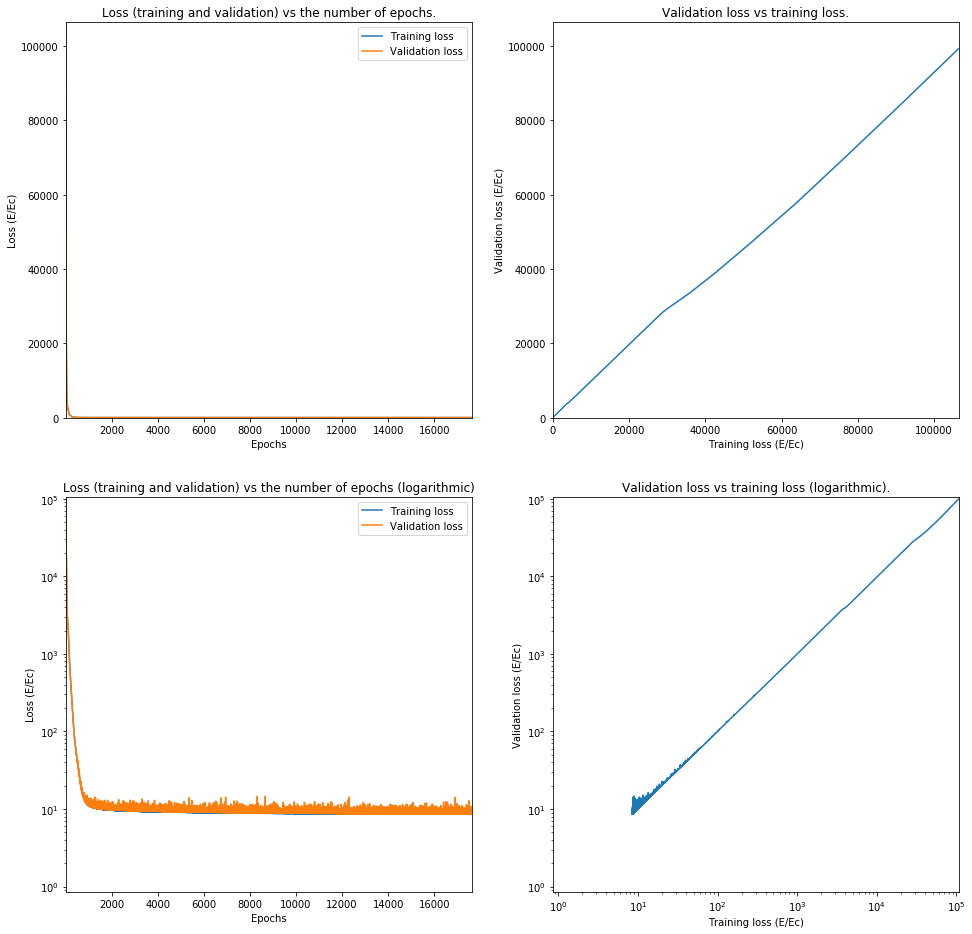

Train on 62644 samples, validate on 15662 samples
Epoch 1/25000
62644/62644 [==============================] - 2s 39us/step - loss: 206764.7627 - val_loss: 200348.9449
Epoch 2/25000
62644/62644 [==============================] - 2s 37us/step - loss: 189774.5428 - val_loss: 183329.4166
Epoch 3/25000
62644/62644 [==============================] - 2s 36us/step - loss: 172887.9624 - val_loss: 166396.2456
Epoch 4/25000
62644/62644 [==============================] - 2s 37us/step - loss: 156085.1540 - val_loss: 149544.2105
Epoch 5/25000
62644/62644 [==============================] - 2s 38us/step - loss: 139372.8895 - val_loss: 132778.9762
Epoch 6/25000
62644/62644 [==============================] - 2s 38us/step - loss: 122905.7831 - val_loss: 116356.3373
Epoch 7/25000
62644/62644 [==============================] - 2s 39us/step - loss: 106960.4058 - val_loss: 100696.1391
Epoch 8/25000
62644/62644 [==============================] - 2s 37us/step - loss: 91994.4089 - val_loss: 86064.6238
Epoch 9/

62644/62644 [==============================] - 2s 37us/step - loss: 3859.5353 - val_loss: 3910.2209
Epoch 72/25000
62644/62644 [==============================] - 2s 36us/step - loss: 3810.2672 - val_loss: 3858.3268
Epoch 73/25000
62644/62644 [==============================] - 2s 36us/step - loss: 3761.5120 - val_loss: 3806.8160
Epoch 74/25000
62644/62644 [==============================] - 2s 36us/step - loss: 3711.5829 - val_loss: 3755.0355
Epoch 75/25000
62644/62644 [==============================] - 2s 35us/step - loss: 3661.7601 - val_loss: 3703.4518
Epoch 76/25000
62644/62644 [==============================] - 2s 35us/step - loss: 3612.1605 - val_loss: 3652.7046
Epoch 77/25000
62644/62644 [==============================] - 2s 36us/step - loss: 3563.5650 - val_loss: 3603.9276
Epoch 78/25000
62644/62644 [==============================] - 2s 35us/step - loss: 3515.0785 - val_loss: 3552.3949
Epoch 79/25000
62644/62644 [==============================] - 2s 35us/step - loss: 3466.6869 - 

62644/62644 [==============================] - 2s 36us/step - loss: 1029.3224 - val_loss: 1021.7803
Epoch 143/25000
62644/62644 [==============================] - 2s 36us/step - loss: 1005.5119 - val_loss: 998.5762
Epoch 144/25000
62644/62644 [==============================] - 2s 37us/step - loss: 982.2274 - val_loss: 974.8900
Epoch 145/25000
62644/62644 [==============================] - 2s 36us/step - loss: 959.4813 - val_loss: 953.6195
Epoch 146/25000
62644/62644 [==============================] - 2s 36us/step - loss: 936.4932 - val_loss: 930.2940
Epoch 147/25000
62644/62644 [==============================] - 2s 36us/step - loss: 914.1993 - val_loss: 908.3966
Epoch 148/25000
62644/62644 [==============================] - 2s 36us/step - loss: 892.2442 - val_loss: 886.1432
Epoch 149/25000
62644/62644 [==============================] - 2s 36us/step - loss: 870.2997 - val_loss: 866.0050
Epoch 150/25000
62644/62644 [==============================] - 2s 35us/step - loss: 849.2214 - val_lo

Epoch 214/25000
62644/62644 [==============================] - 2s 35us/step - loss: 379.9369 - val_loss: 380.5954
Epoch 215/25000
62644/62644 [==============================] - 2s 34us/step - loss: 378.5563 - val_loss: 377.7299
Epoch 216/25000
62644/62644 [==============================] - 2s 34us/step - loss: 377.1303 - val_loss: 376.6527
Epoch 217/25000
62644/62644 [==============================] - 2s 35us/step - loss: 375.6871 - val_loss: 374.9305
Epoch 218/25000
62644/62644 [==============================] - 2s 34us/step - loss: 374.4180 - val_loss: 375.0414
Epoch 219/25000
62644/62644 [==============================] - 2s 34us/step - loss: 373.1795 - val_loss: 372.2590
Epoch 220/25000
62644/62644 [==============================] - 2s 34us/step - loss: 371.8346 - val_loss: 372.0255
Epoch 221/25000
62644/62644 [==============================] - 2s 34us/step - loss: 370.4982 - val_loss: 369.6550
Epoch 222/25000
62644/62644 [==============================] - 2s 35us/step - loss: 369.

Epoch 286/25000
62644/62644 [==============================] - 2s 37us/step - loss: 297.7491 - val_loss: 296.5516
Epoch 287/25000
62644/62644 [==============================] - 2s 36us/step - loss: 296.6320 - val_loss: 295.8132
Epoch 288/25000
62644/62644 [==============================] - 2s 35us/step - loss: 295.8101 - val_loss: 299.1155
Epoch 289/25000
62644/62644 [==============================] - 2s 36us/step - loss: 294.8327 - val_loss: 293.5934
Epoch 290/25000
62644/62644 [==============================] - 2s 36us/step - loss: 293.9238 - val_loss: 292.8560
Epoch 291/25000
62644/62644 [==============================] - 2s 37us/step - loss: 293.0217 - val_loss: 291.9437
Epoch 292/25000
62644/62644 [==============================] - 2s 37us/step - loss: 292.0162 - val_loss: 290.9942
Epoch 293/25000
62644/62644 [==============================] - 2s 36us/step - loss: 291.0955 - val_loss: 291.6863
Epoch 294/25000
62644/62644 [==============================] - 2s 36us/step - loss: 290.

Epoch 358/25000
62644/62644 [==============================] - 2s 36us/step - loss: 238.3872 - val_loss: 240.1069
Epoch 359/25000
62644/62644 [==============================] - 2s 36us/step - loss: 237.5258 - val_loss: 236.5740
Epoch 360/25000
62644/62644 [==============================] - 2s 36us/step - loss: 237.0257 - val_loss: 238.9784
Epoch 361/25000
62644/62644 [==============================] - 2s 35us/step - loss: 236.2960 - val_loss: 235.0331
Epoch 362/25000
62644/62644 [==============================] - 2s 36us/step - loss: 235.4946 - val_loss: 233.8814
Epoch 363/25000
62644/62644 [==============================] - 2s 35us/step - loss: 234.8331 - val_loss: 234.4823
Epoch 364/25000
62644/62644 [==============================] - 2s 36us/step - loss: 234.0159 - val_loss: 233.8185
Epoch 365/25000
62644/62644 [==============================] - 2s 36us/step - loss: 233.3302 - val_loss: 231.9533
Epoch 366/25000
62644/62644 [==============================] - 2s 36us/step - loss: 232.

Epoch 430/25000
62644/62644 [==============================] - 2s 35us/step - loss: 192.9513 - val_loss: 192.1096
Epoch 431/25000
62644/62644 [==============================] - 2s 35us/step - loss: 192.4175 - val_loss: 191.5935
Epoch 432/25000
62644/62644 [==============================] - 2s 36us/step - loss: 191.6995 - val_loss: 190.9278
Epoch 433/25000
62644/62644 [==============================] - 2s 35us/step - loss: 191.2768 - val_loss: 190.0671
Epoch 434/25000
62644/62644 [==============================] - 2s 35us/step - loss: 190.6730 - val_loss: 190.2473
Epoch 435/25000
62644/62644 [==============================] - 2s 36us/step - loss: 190.2735 - val_loss: 189.2622
Epoch 436/25000
62644/62644 [==============================] - 2s 35us/step - loss: 189.5840 - val_loss: 189.3360
Epoch 437/25000
62644/62644 [==============================] - 2s 35us/step - loss: 189.2126 - val_loss: 188.0624
Epoch 438/25000
62644/62644 [==============================] - 2s 36us/step - loss: 188.

Epoch 502/25000
62644/62644 [==============================] - 2s 35us/step - loss: 159.6213 - val_loss: 159.6092
Epoch 503/25000
62644/62644 [==============================] - 2s 35us/step - loss: 159.2013 - val_loss: 159.1965
Epoch 504/25000
62644/62644 [==============================] - 2s 36us/step - loss: 158.7913 - val_loss: 158.5849
Epoch 505/25000
62644/62644 [==============================] - 2s 36us/step - loss: 158.5612 - val_loss: 159.5329
Epoch 506/25000
62644/62644 [==============================] - 2s 36us/step - loss: 158.0864 - val_loss: 158.0109
Epoch 507/25000
62644/62644 [==============================] - 2s 36us/step - loss: 157.6953 - val_loss: 157.5471
Epoch 508/25000
62644/62644 [==============================] - 2s 36us/step - loss: 157.4062 - val_loss: 163.3138
Epoch 509/25000
62644/62644 [==============================] - 2s 34us/step - loss: 157.0806 - val_loss: 156.7170
Epoch 510/25000
62644/62644 [==============================] - 2s 35us/step - loss: 156.

Epoch 574/25000
62644/62644 [==============================] - 2s 35us/step - loss: 134.0457 - val_loss: 133.6394
Epoch 575/25000
62644/62644 [==============================] - 2s 35us/step - loss: 133.4106 - val_loss: 132.9629
Epoch 576/25000
62644/62644 [==============================] - 2s 35us/step - loss: 132.8698 - val_loss: 132.1351
Epoch 577/25000
62644/62644 [==============================] - 2s 35us/step - loss: 132.2830 - val_loss: 132.3230
Epoch 578/25000
62644/62644 [==============================] - 2s 36us/step - loss: 131.9327 - val_loss: 131.8396
Epoch 579/25000
62644/62644 [==============================] - 2s 35us/step - loss: 131.5652 - val_loss: 130.8080
Epoch 580/25000
62644/62644 [==============================] - 2s 35us/step - loss: 131.0479 - val_loss: 130.2217
Epoch 581/25000
62644/62644 [==============================] - 2s 35us/step - loss: 130.5681 - val_loss: 130.6729
Epoch 582/25000
62644/62644 [==============================] - 2s 35us/step - loss: 130.

Epoch 646/25000
62644/62644 [==============================] - 2s 35us/step - loss: 98.1701 - val_loss: 98.1678
Epoch 647/25000
62644/62644 [==============================] - 2s 36us/step - loss: 97.8335 - val_loss: 97.9715
Epoch 648/25000
62644/62644 [==============================] - 2s 36us/step - loss: 97.5225 - val_loss: 97.7817
Epoch 649/25000
62644/62644 [==============================] - 2s 35us/step - loss: 97.3583 - val_loss: 97.3432
Epoch 650/25000
62644/62644 [==============================] - 2s 36us/step - loss: 96.8583 - val_loss: 97.1157
Epoch 651/25000
62644/62644 [==============================] - 2s 36us/step - loss: 96.6439 - val_loss: 96.9546
Epoch 652/25000
62644/62644 [==============================] - 2s 35us/step - loss: 96.5679 - val_loss: 97.4084
Epoch 653/25000
62644/62644 [==============================] - 2s 36us/step - loss: 96.2417 - val_loss: 97.5247
Epoch 654/25000
62644/62644 [==============================] - 2s 36us/step - loss: 96.0668 - val_loss: 

62644/62644 [==============================] - 2s 35us/step - loss: 88.9380 - val_loss: 89.4170
Epoch 720/25000
62644/62644 [==============================] - 2s 35us/step - loss: 88.7895 - val_loss: 89.2157
Epoch 721/25000
62644/62644 [==============================] - 2s 35us/step - loss: 88.8363 - val_loss: 89.7012
Epoch 722/25000
62644/62644 [==============================] - 2s 35us/step - loss: 88.5999 - val_loss: 89.8125
Epoch 723/25000
62644/62644 [==============================] - 2s 35us/step - loss: 88.6293 - val_loss: 89.0947
Epoch 724/25000
62644/62644 [==============================] - 2s 34us/step - loss: 88.6068 - val_loss: 89.1095
Epoch 725/25000
62644/62644 [==============================] - 2s 35us/step - loss: 88.4779 - val_loss: 88.9515
Epoch 726/25000
62644/62644 [==============================] - 2s 35us/step - loss: 88.3417 - val_loss: 88.7720
Epoch 727/25000
62644/62644 [==============================] - 2s 35us/step - loss: 88.3299 - val_loss: 88.6828
Epoch 72

62644/62644 [==============================] - 2s 35us/step - loss: 83.2407 - val_loss: 83.7260
Epoch 793/25000
62644/62644 [==============================] - 2s 35us/step - loss: 83.2395 - val_loss: 83.6473
Epoch 794/25000
62644/62644 [==============================] - 2s 35us/step - loss: 83.1740 - val_loss: 84.1816
Epoch 795/25000
62644/62644 [==============================] - 2s 35us/step - loss: 83.0163 - val_loss: 83.4332
Epoch 796/25000
62644/62644 [==============================] - 2s 35us/step - loss: 82.9379 - val_loss: 84.2634
Epoch 797/25000
62644/62644 [==============================] - 2s 36us/step - loss: 82.8332 - val_loss: 83.6762
Epoch 798/25000
62644/62644 [==============================] - 2s 35us/step - loss: 82.7858 - val_loss: 84.3569
Epoch 799/25000
62644/62644 [==============================] - 2s 35us/step - loss: 82.7564 - val_loss: 83.7853
Epoch 800/25000
62644/62644 [==============================] - 2s 34us/step - loss: 82.6828 - val_loss: 83.3150
Epoch 80

62644/62644 [==============================] - 2s 37us/step - loss: 78.2171 - val_loss: 78.8766
Epoch 866/25000
62644/62644 [==============================] - 2s 36us/step - loss: 78.1276 - val_loss: 78.6371
Epoch 867/25000
62644/62644 [==============================] - 2s 36us/step - loss: 78.1311 - val_loss: 78.5170
Epoch 868/25000
62644/62644 [==============================] - 2s 37us/step - loss: 78.0335 - val_loss: 78.5753
Epoch 869/25000
62644/62644 [==============================] - 2s 35us/step - loss: 77.9539 - val_loss: 78.3848
Epoch 870/25000
62644/62644 [==============================] - 2s 38us/step - loss: 77.8871 - val_loss: 79.6623
Epoch 871/25000
62644/62644 [==============================] - 2s 37us/step - loss: 77.7943 - val_loss: 78.6457
Epoch 872/25000
62644/62644 [==============================] - 2s 37us/step - loss: 77.7070 - val_loss: 78.7709
Epoch 873/25000
62644/62644 [==============================] - 2s 35us/step - loss: 77.7686 - val_loss: 78.1336
Epoch 87

62644/62644 [==============================] - 2s 35us/step - loss: 73.7930 - val_loss: 75.8398
Epoch 939/25000
62644/62644 [==============================] - 2s 35us/step - loss: 73.7377 - val_loss: 74.7329
Epoch 940/25000
62644/62644 [==============================] - 2s 34us/step - loss: 73.6139 - val_loss: 74.0638
Epoch 941/25000
62644/62644 [==============================] - 2s 35us/step - loss: 73.5258 - val_loss: 74.5280
Epoch 942/25000
62644/62644 [==============================] - 2s 36us/step - loss: 73.4149 - val_loss: 74.2722
Epoch 943/25000
62644/62644 [==============================] - 2s 36us/step - loss: 73.5203 - val_loss: 75.3858
Epoch 944/25000
62644/62644 [==============================] - 2s 36us/step - loss: 73.3717 - val_loss: 73.9812
Epoch 945/25000
62644/62644 [==============================] - 2s 36us/step - loss: 73.3471 - val_loss: 74.6695
Epoch 946/25000
62644/62644 [==============================] - 2s 35us/step - loss: 73.2280 - val_loss: 74.6917
Epoch 94

62644/62644 [==============================] - 2s 38us/step - loss: 69.7785 - val_loss: 70.2722
Epoch 1012/25000
62644/62644 [==============================] - 2s 38us/step - loss: 69.6862 - val_loss: 70.5973
Epoch 1013/25000
62644/62644 [==============================] - 2s 38us/step - loss: 69.5560 - val_loss: 70.0427
Epoch 1014/25000
62644/62644 [==============================] - 2s 36us/step - loss: 69.4367 - val_loss: 70.5306
Epoch 1015/25000
62644/62644 [==============================] - 2s 36us/step - loss: 69.4187 - val_loss: 69.9545
Epoch 1016/25000
62644/62644 [==============================] - 2s 36us/step - loss: 69.4082 - val_loss: 70.6632
Epoch 1017/25000
62644/62644 [==============================] - 2s 35us/step - loss: 69.3751 - val_loss: 70.2992
Epoch 1018/25000
62644/62644 [==============================] - 2s 37us/step - loss: 69.3807 - val_loss: 70.0855
Epoch 1019/25000
62644/62644 [==============================] - 2s 35us/step - loss: 69.3671 - val_loss: 69.6953


62644/62644 [==============================] - 2s 36us/step - loss: 65.9697 - val_loss: 66.5691
Epoch 1084/25000
62644/62644 [==============================] - 2s 36us/step - loss: 65.9838 - val_loss: 66.8682
Epoch 1085/25000
62644/62644 [==============================] - 2s 36us/step - loss: 65.8590 - val_loss: 66.8148
Epoch 1086/25000
62644/62644 [==============================] - 2s 35us/step - loss: 65.8807 - val_loss: 66.5181
Epoch 1087/25000
62644/62644 [==============================] - 2s 39us/step - loss: 65.7744 - val_loss: 66.2607
Epoch 1088/25000
62644/62644 [==============================] - 2s 38us/step - loss: 65.7675 - val_loss: 66.8865
Epoch 1089/25000
62644/62644 [==============================] - 2s 35us/step - loss: 65.6542 - val_loss: 66.2627
Epoch 1090/25000
62644/62644 [==============================] - 2s 35us/step - loss: 65.7477 - val_loss: 66.3875
Epoch 1091/25000
62644/62644 [==============================] - 2s 36us/step - loss: 65.5976 - val_loss: 66.3618


62644/62644 [==============================] - 2s 35us/step - loss: 62.4926 - val_loss: 63.2421
Epoch 1156/25000
62644/62644 [==============================] - 2s 35us/step - loss: 62.4939 - val_loss: 64.1391
Epoch 1157/25000
62644/62644 [==============================] - 2s 35us/step - loss: 62.4883 - val_loss: 63.1997
Epoch 1158/25000
62644/62644 [==============================] - 2s 38us/step - loss: 62.4581 - val_loss: 65.4860
Epoch 1159/25000
62644/62644 [==============================] - 2s 38us/step - loss: 62.3480 - val_loss: 62.8806
Epoch 1160/25000
62644/62644 [==============================] - 2s 35us/step - loss: 62.3402 - val_loss: 62.6974
Epoch 1161/25000
62644/62644 [==============================] - 2s 35us/step - loss: 62.2685 - val_loss: 62.8043
Epoch 1162/25000
62644/62644 [==============================] - 2s 34us/step - loss: 62.3033 - val_loss: 63.8517
Epoch 1163/25000
62644/62644 [==============================] - 2s 35us/step - loss: 62.3005 - val_loss: 62.6094


62644/62644 [==============================] - 2s 35us/step - loss: 59.2225 - val_loss: 60.3226
Epoch 1228/25000
62644/62644 [==============================] - 2s 36us/step - loss: 59.3163 - val_loss: 59.8889
Epoch 1229/25000
62644/62644 [==============================] - 2s 34us/step - loss: 59.1396 - val_loss: 59.8838
Epoch 1230/25000
62644/62644 [==============================] - 2s 36us/step - loss: 59.0675 - val_loss: 61.3577
Epoch 1231/25000
62644/62644 [==============================] - 2s 36us/step - loss: 59.0860 - val_loss: 59.7193
Epoch 1232/25000
62644/62644 [==============================] - 2s 35us/step - loss: 59.0463 - val_loss: 60.1194
Epoch 1233/25000
62644/62644 [==============================] - 2s 36us/step - loss: 59.1374 - val_loss: 59.5085
Epoch 1234/25000
62644/62644 [==============================] - 2s 35us/step - loss: 58.8662 - val_loss: 60.3655
Epoch 1235/25000
62644/62644 [==============================] - 2s 36us/step - loss: 58.9217 - val_loss: 59.2382


62644/62644 [==============================] - 2s 35us/step - loss: 56.0967 - val_loss: 56.6545
Epoch 1300/25000
62644/62644 [==============================] - 2s 37us/step - loss: 55.9807 - val_loss: 57.1814
Epoch 1301/25000
62644/62644 [==============================] - 2s 35us/step - loss: 56.1028 - val_loss: 56.5576
Epoch 1302/25000
62644/62644 [==============================] - 2s 36us/step - loss: 55.9478 - val_loss: 56.3297
Epoch 1303/25000
62644/62644 [==============================] - 2s 34us/step - loss: 55.9935 - val_loss: 56.2996
Epoch 1304/25000
62644/62644 [==============================] - 2s 35us/step - loss: 55.8194 - val_loss: 56.2532
Epoch 1305/25000
62644/62644 [==============================] - 2s 36us/step - loss: 55.8524 - val_loss: 56.4307
Epoch 1306/25000
62644/62644 [==============================] - 2s 35us/step - loss: 55.7756 - val_loss: 56.4818
Epoch 1307/25000
62644/62644 [==============================] - 2s 34us/step - loss: 55.8394 - val_loss: 56.6899


62644/62644 [==============================] - 2s 34us/step - loss: 53.0306 - val_loss: 55.7617
Epoch 1372/25000
62644/62644 [==============================] - 2s 34us/step - loss: 52.9727 - val_loss: 53.4175
Epoch 1373/25000
62644/62644 [==============================] - 2s 35us/step - loss: 52.9379 - val_loss: 53.9919
Epoch 1374/25000
62644/62644 [==============================] - 2s 35us/step - loss: 52.8500 - val_loss: 53.4766
Epoch 1375/25000
62644/62644 [==============================] - 2s 35us/step - loss: 52.9017 - val_loss: 53.3710
Epoch 1376/25000
62644/62644 [==============================] - 2s 37us/step - loss: 52.7918 - val_loss: 53.1288
Epoch 1377/25000
62644/62644 [==============================] - 2s 34us/step - loss: 52.8710 - val_loss: 53.2123
Epoch 1378/25000
62644/62644 [==============================] - 2s 36us/step - loss: 52.6773 - val_loss: 53.1553
Epoch 1379/25000
62644/62644 [==============================] - 2s 35us/step - loss: 52.6987 - val_loss: 53.2601


62644/62644 [==============================] - 2s 36us/step - loss: 49.7671 - val_loss: 50.3350
Epoch 1444/25000
62644/62644 [==============================] - 2s 35us/step - loss: 49.8144 - val_loss: 50.1991
Epoch 1445/25000
62644/62644 [==============================] - 2s 34us/step - loss: 49.7398 - val_loss: 50.3039
Epoch 1446/25000
62644/62644 [==============================] - 2s 36us/step - loss: 49.7036 - val_loss: 50.0283
Epoch 1447/25000
62644/62644 [==============================] - 2s 35us/step - loss: 49.6102 - val_loss: 50.0381
Epoch 1448/25000
62644/62644 [==============================] - 2s 35us/step - loss: 49.5764 - val_loss: 51.7547
Epoch 1449/25000
62644/62644 [==============================] - 2s 35us/step - loss: 49.5509 - val_loss: 49.9786
Epoch 1450/25000
62644/62644 [==============================] - 2s 36us/step - loss: 49.4577 - val_loss: 50.6858
Epoch 1451/25000
62644/62644 [==============================] - 2s 35us/step - loss: 49.4452 - val_loss: 50.1276


62644/62644 [==============================] - 2s 35us/step - loss: 46.4580 - val_loss: 47.2643
Epoch 1516/25000
62644/62644 [==============================] - 2s 36us/step - loss: 46.3318 - val_loss: 47.0076
Epoch 1517/25000
62644/62644 [==============================] - 2s 36us/step - loss: 46.3581 - val_loss: 46.9639
Epoch 1518/25000
62644/62644 [==============================] - 2s 36us/step - loss: 46.3345 - val_loss: 48.0059
Epoch 1519/25000
62644/62644 [==============================] - 2s 36us/step - loss: 46.2788 - val_loss: 46.4856
Epoch 1520/25000
62644/62644 [==============================] - 2s 36us/step - loss: 46.1678 - val_loss: 46.6751
Epoch 1521/25000
62644/62644 [==============================] - 2s 36us/step - loss: 46.1902 - val_loss: 46.7770
Epoch 1522/25000
62644/62644 [==============================] - 2s 36us/step - loss: 46.1360 - val_loss: 46.4940
Epoch 1523/25000
62644/62644 [==============================] - 2s 36us/step - loss: 45.9886 - val_loss: 46.4807


62644/62644 [==============================] - 2s 35us/step - loss: 42.9004 - val_loss: 43.5762
Epoch 1588/25000
62644/62644 [==============================] - 2s 35us/step - loss: 42.8715 - val_loss: 43.6196
Epoch 1589/25000
62644/62644 [==============================] - 2s 34us/step - loss: 42.8747 - val_loss: 42.9519
Epoch 1590/25000
62644/62644 [==============================] - 2s 34us/step - loss: 42.8453 - val_loss: 43.0172
Epoch 1591/25000
62644/62644 [==============================] - 2s 34us/step - loss: 42.7078 - val_loss: 42.9273
Epoch 1592/25000
62644/62644 [==============================] - 2s 33us/step - loss: 42.7234 - val_loss: 42.8306
Epoch 1593/25000
62644/62644 [==============================] - 2s 34us/step - loss: 42.6395 - val_loss: 43.2309
Epoch 1594/25000
62644/62644 [==============================] - 2s 34us/step - loss: 42.6374 - val_loss: 43.2896
Epoch 1595/25000
62644/62644 [==============================] - 2s 34us/step - loss: 42.5575 - val_loss: 42.7094


62644/62644 [==============================] - 2s 37us/step - loss: 39.4249 - val_loss: 39.4694
Epoch 1660/25000
62644/62644 [==============================] - 2s 35us/step - loss: 39.2829 - val_loss: 39.5021
Epoch 1661/25000
62644/62644 [==============================] - 2s 35us/step - loss: 39.2243 - val_loss: 39.3875
Epoch 1662/25000
62644/62644 [==============================] - 2s 35us/step - loss: 39.1662 - val_loss: 40.3190
Epoch 1663/25000
62644/62644 [==============================] - 2s 35us/step - loss: 39.1320 - val_loss: 39.5200
Epoch 1664/25000
62644/62644 [==============================] - 2s 35us/step - loss: 39.0192 - val_loss: 39.1657
Epoch 1665/25000
62644/62644 [==============================] - 2s 34us/step - loss: 39.1561 - val_loss: 40.5514
Epoch 1666/25000
62644/62644 [==============================] - 2s 36us/step - loss: 39.0244 - val_loss: 39.1300
Epoch 1667/25000
62644/62644 [==============================] - 2s 36us/step - loss: 38.8925 - val_loss: 39.0401


62644/62644 [==============================] - 2s 36us/step - loss: 37.1135 - val_loss: 37.3046
Epoch 1732/25000
62644/62644 [==============================] - 2s 35us/step - loss: 37.0955 - val_loss: 37.2211
Epoch 1733/25000
62644/62644 [==============================] - 2s 37us/step - loss: 37.0163 - val_loss: 37.6207
Epoch 1734/25000
62644/62644 [==============================] - 2s 36us/step - loss: 37.0170 - val_loss: 37.2250
Epoch 1735/25000
62644/62644 [==============================] - 2s 36us/step - loss: 36.9685 - val_loss: 37.1147
Epoch 1736/25000
62644/62644 [==============================] - 2s 36us/step - loss: 36.9125 - val_loss: 37.2615
Epoch 1737/25000
62644/62644 [==============================] - 2s 36us/step - loss: 36.8657 - val_loss: 37.3176
Epoch 1738/25000
62644/62644 [==============================] - 2s 35us/step - loss: 36.9819 - val_loss: 37.7599
Epoch 1739/25000
62644/62644 [==============================] - 2s 35us/step - loss: 36.9254 - val_loss: 37.2094


62644/62644 [==============================] - 2s 34us/step - loss: 35.6021 - val_loss: 35.9300
Epoch 1804/25000
62644/62644 [==============================] - 2s 36us/step - loss: 35.5296 - val_loss: 35.8673
Epoch 1805/25000
62644/62644 [==============================] - 2s 36us/step - loss: 35.5839 - val_loss: 36.4700
Epoch 1806/25000
62644/62644 [==============================] - 2s 35us/step - loss: 35.4720 - val_loss: 36.5279
Epoch 1807/25000
62644/62644 [==============================] - 2s 36us/step - loss: 35.4375 - val_loss: 35.6148
Epoch 1808/25000
62644/62644 [==============================] - 2s 36us/step - loss: 35.5237 - val_loss: 35.6689
Epoch 1809/25000
62644/62644 [==============================] - 2s 35us/step - loss: 35.3469 - val_loss: 35.9964
Epoch 1810/25000
62644/62644 [==============================] - 2s 38us/step - loss: 35.4342 - val_loss: 35.5324
Epoch 1811/25000
62644/62644 [==============================] - 2s 37us/step - loss: 35.4195 - val_loss: 35.7771


62644/62644 [==============================] - 2s 35us/step - loss: 34.2393 - val_loss: 34.7500
Epoch 1876/25000
62644/62644 [==============================] - 2s 34us/step - loss: 34.2896 - val_loss: 34.4053
Epoch 1877/25000
62644/62644 [==============================] - 2s 36us/step - loss: 34.1291 - val_loss: 34.4043
Epoch 1878/25000
62644/62644 [==============================] - 2s 35us/step - loss: 34.0645 - val_loss: 34.5163
Epoch 1879/25000
62644/62644 [==============================] - 2s 35us/step - loss: 34.2442 - val_loss: 34.3496
Epoch 1880/25000
62644/62644 [==============================] - 2s 34us/step - loss: 34.0484 - val_loss: 34.3247
Epoch 1881/25000
62644/62644 [==============================] - 2s 36us/step - loss: 34.1185 - val_loss: 34.4942
Epoch 1882/25000
62644/62644 [==============================] - 2s 35us/step - loss: 34.0403 - val_loss: 35.6964
Epoch 1883/25000
62644/62644 [==============================] - 2s 35us/step - loss: 34.0148 - val_loss: 34.2687


62644/62644 [==============================] - 2s 35us/step - loss: 33.0808 - val_loss: 33.0980
Epoch 1948/25000
62644/62644 [==============================] - 2s 35us/step - loss: 32.9991 - val_loss: 33.2604
Epoch 1949/25000
62644/62644 [==============================] - 2s 35us/step - loss: 33.0325 - val_loss: 33.2254
Epoch 1950/25000
62644/62644 [==============================] - 2s 37us/step - loss: 32.9710 - val_loss: 33.2496
Epoch 1951/25000
62644/62644 [==============================] - 2s 37us/step - loss: 32.8811 - val_loss: 33.4069
Epoch 1952/25000
62644/62644 [==============================] - 2s 38us/step - loss: 32.9151 - val_loss: 33.0564
Epoch 1953/25000
62644/62644 [==============================] - 2s 37us/step - loss: 32.9815 - val_loss: 32.9875
Epoch 1954/25000
62644/62644 [==============================] - 2s 37us/step - loss: 32.8450 - val_loss: 33.2144
Epoch 1955/25000
62644/62644 [==============================] - 2s 36us/step - loss: 32.8958 - val_loss: 33.0807


62644/62644 [==============================] - 2s 35us/step - loss: 31.8404 - val_loss: 31.8383
Epoch 2020/25000
62644/62644 [==============================] - 2s 35us/step - loss: 31.8949 - val_loss: 31.9291
Epoch 2021/25000
62644/62644 [==============================] - 2s 36us/step - loss: 31.9435 - val_loss: 31.9798
Epoch 2022/25000
62644/62644 [==============================] - 2s 35us/step - loss: 31.8263 - val_loss: 32.7978
Epoch 2023/25000
62644/62644 [==============================] - 2s 35us/step - loss: 31.8502 - val_loss: 32.3447
Epoch 2024/25000
62644/62644 [==============================] - 2s 35us/step - loss: 31.7618 - val_loss: 32.6757
Epoch 2025/25000
62644/62644 [==============================] - 2s 35us/step - loss: 31.7467 - val_loss: 31.8109
Epoch 2026/25000
62644/62644 [==============================] - 2s 34us/step - loss: 31.7040 - val_loss: 32.7958
Epoch 2027/25000
62644/62644 [==============================] - 2s 34us/step - loss: 31.7246 - val_loss: 32.7047


62644/62644 [==============================] - 2s 39us/step - loss: 30.6893 - val_loss: 30.8116
Epoch 2092/25000
62644/62644 [==============================] - 2s 38us/step - loss: 30.7774 - val_loss: 33.3194
Epoch 2093/25000
62644/62644 [==============================] - 2s 36us/step - loss: 30.7946 - val_loss: 32.2125
Epoch 2094/25000
62644/62644 [==============================] - 2s 35us/step - loss: 30.7094 - val_loss: 30.9087
Epoch 2095/25000
62644/62644 [==============================] - 2s 35us/step - loss: 30.7218 - val_loss: 31.9488
Epoch 2096/25000
62644/62644 [==============================] - 2s 35us/step - loss: 30.6673 - val_loss: 31.2579
Epoch 2097/25000
62644/62644 [==============================] - 2s 36us/step - loss: 30.5822 - val_loss: 31.1636
Epoch 2098/25000
62644/62644 [==============================] - 2s 36us/step - loss: 30.6441 - val_loss: 30.7016
Epoch 2099/25000
62644/62644 [==============================] - 2s 36us/step - loss: 30.6845 - val_loss: 32.5562


62644/62644 [==============================] - 2s 35us/step - loss: 29.6458 - val_loss: 29.7758
Epoch 2164/25000
62644/62644 [==============================] - 2s 35us/step - loss: 29.6330 - val_loss: 31.0552
Epoch 2165/25000
62644/62644 [==============================] - 2s 36us/step - loss: 29.6748 - val_loss: 30.5448
Epoch 2166/25000
62644/62644 [==============================] - 2s 36us/step - loss: 29.6057 - val_loss: 30.2049
Epoch 2167/25000
62644/62644 [==============================] - 2s 36us/step - loss: 29.7272 - val_loss: 30.2386
Epoch 2168/25000
62644/62644 [==============================] - 2s 36us/step - loss: 29.6077 - val_loss: 29.7266
Epoch 2169/25000
62644/62644 [==============================] - 2s 37us/step - loss: 29.6419 - val_loss: 29.9067
Epoch 2170/25000
62644/62644 [==============================] - 2s 36us/step - loss: 29.5828 - val_loss: 32.1713
Epoch 2171/25000
62644/62644 [==============================] - 2s 37us/step - loss: 29.5921 - val_loss: 29.6234


62644/62644 [==============================] - 2s 35us/step - loss: 28.6105 - val_loss: 29.0141
Epoch 2236/25000
62644/62644 [==============================] - 2s 37us/step - loss: 28.6048 - val_loss: 28.6788
Epoch 2237/25000
62644/62644 [==============================] - 2s 37us/step - loss: 28.5935 - val_loss: 29.8783
Epoch 2238/25000
62644/62644 [==============================] - 2s 35us/step - loss: 28.6961 - val_loss: 28.7175
Epoch 2239/25000
62644/62644 [==============================] - 2s 37us/step - loss: 28.7096 - val_loss: 28.7356
Epoch 2240/25000
62644/62644 [==============================] - 2s 36us/step - loss: 28.5708 - val_loss: 28.6480
Epoch 2241/25000
62644/62644 [==============================] - 2s 37us/step - loss: 28.6295 - val_loss: 29.4036
Epoch 2242/25000
62644/62644 [==============================] - 2s 35us/step - loss: 28.5916 - val_loss: 29.1655
Epoch 2243/25000
62644/62644 [==============================] - 2s 35us/step - loss: 28.5601 - val_loss: 28.7606


62644/62644 [==============================] - 2s 35us/step - loss: 27.7428 - val_loss: 30.2354
Epoch 2308/25000
62644/62644 [==============================] - 2s 35us/step - loss: 27.6626 - val_loss: 27.9493
Epoch 2309/25000
62644/62644 [==============================] - 2s 34us/step - loss: 27.5982 - val_loss: 27.6211
Epoch 2310/25000
62644/62644 [==============================] - 2s 34us/step - loss: 27.5998 - val_loss: 27.8058
Epoch 2311/25000
62644/62644 [==============================] - 2s 35us/step - loss: 27.6229 - val_loss: 28.0420
Epoch 2312/25000
62644/62644 [==============================] - 2s 35us/step - loss: 27.6956 - val_loss: 27.9261
Epoch 2313/25000
62644/62644 [==============================] - 2s 36us/step - loss: 27.5766 - val_loss: 28.4076
Epoch 2314/25000
62644/62644 [==============================] - 2s 34us/step - loss: 27.5936 - val_loss: 27.7332
Epoch 2315/25000
62644/62644 [==============================] - 2s 36us/step - loss: 27.5971 - val_loss: 27.6147


62644/62644 [==============================] - 2s 35us/step - loss: 26.7831 - val_loss: 26.6749
Epoch 2380/25000
62644/62644 [==============================] - 2s 35us/step - loss: 26.6977 - val_loss: 26.7136
Epoch 2381/25000
62644/62644 [==============================] - 2s 36us/step - loss: 26.6303 - val_loss: 29.1390
Epoch 2382/25000
62644/62644 [==============================] - 2s 35us/step - loss: 26.6928 - val_loss: 27.0175
Epoch 2383/25000
62644/62644 [==============================] - 2s 35us/step - loss: 26.7109 - val_loss: 27.2340
Epoch 2384/25000
62644/62644 [==============================] - 2s 35us/step - loss: 26.7039 - val_loss: 26.6371
Epoch 2385/25000
62644/62644 [==============================] - 2s 36us/step - loss: 26.6182 - val_loss: 26.5829
Epoch 2386/25000
62644/62644 [==============================] - 2s 36us/step - loss: 26.5937 - val_loss: 27.4093
Epoch 2387/25000
62644/62644 [==============================] - 2s 36us/step - loss: 26.6045 - val_loss: 27.4854


62644/62644 [==============================] - 2s 38us/step - loss: 25.8025 - val_loss: 26.8600
Epoch 2452/25000
62644/62644 [==============================] - 2s 38us/step - loss: 25.7570 - val_loss: 25.9054
Epoch 2453/25000
62644/62644 [==============================] - 2s 39us/step - loss: 25.7404 - val_loss: 25.8594
Epoch 2454/25000
62644/62644 [==============================] - 2s 38us/step - loss: 25.8141 - val_loss: 25.7043
Epoch 2455/25000
62644/62644 [==============================] - 2s 38us/step - loss: 25.7470 - val_loss: 26.1154
Epoch 2456/25000
62644/62644 [==============================] - 2s 36us/step - loss: 25.7458 - val_loss: 26.5825
Epoch 2457/25000
62644/62644 [==============================] - 2s 38us/step - loss: 25.7935 - val_loss: 26.2556
Epoch 2458/25000
62644/62644 [==============================] - 2s 35us/step - loss: 25.6712 - val_loss: 25.7566
Epoch 2459/25000
62644/62644 [==============================] - 2s 34us/step - loss: 25.6048 - val_loss: 25.8635


62644/62644 [==============================] - 2s 35us/step - loss: 24.9007 - val_loss: 25.8501
Epoch 2524/25000
62644/62644 [==============================] - 2s 36us/step - loss: 25.0013 - val_loss: 24.8636
Epoch 2525/25000
62644/62644 [==============================] - 2s 35us/step - loss: 24.8197 - val_loss: 25.1513
Epoch 2526/25000
62644/62644 [==============================] - 2s 35us/step - loss: 24.9180 - val_loss: 24.9992
Epoch 2527/25000
62644/62644 [==============================] - 2s 35us/step - loss: 24.8660 - val_loss: 24.9109
Epoch 2528/25000
62644/62644 [==============================] - 2s 37us/step - loss: 24.8541 - val_loss: 25.0515
Epoch 2529/25000
62644/62644 [==============================] - 2s 37us/step - loss: 24.9346 - val_loss: 25.6019
Epoch 2530/25000
62644/62644 [==============================] - 2s 37us/step - loss: 24.8212 - val_loss: 25.2042
Epoch 2531/25000
62644/62644 [==============================] - 2s 35us/step - loss: 24.7617 - val_loss: 24.7473


62644/62644 [==============================] - 2s 37us/step - loss: 24.1186 - val_loss: 24.0401
Epoch 2596/25000
62644/62644 [==============================] - 2s 36us/step - loss: 24.0390 - val_loss: 24.0745
Epoch 2597/25000
62644/62644 [==============================] - 2s 36us/step - loss: 24.0917 - val_loss: 24.0972
Epoch 2598/25000
62644/62644 [==============================] - 2s 36us/step - loss: 24.0284 - val_loss: 24.2517
Epoch 2599/25000
62644/62644 [==============================] - 2s 35us/step - loss: 24.0689 - val_loss: 23.9928
Epoch 2600/25000
62644/62644 [==============================] - 2s 37us/step - loss: 24.0286 - val_loss: 24.4683
Epoch 2601/25000
62644/62644 [==============================] - 2s 37us/step - loss: 24.0526 - val_loss: 24.0350
Epoch 2602/25000
62644/62644 [==============================] - 2s 35us/step - loss: 24.0666 - val_loss: 24.3869
Epoch 2603/25000
62644/62644 [==============================] - 2s 37us/step - loss: 24.0098 - val_loss: 24.6662


62644/62644 [==============================] - 2s 37us/step - loss: 23.3412 - val_loss: 23.3397
Epoch 2668/25000
62644/62644 [==============================] - 2s 37us/step - loss: 23.3545 - val_loss: 23.9380
Epoch 2669/25000
62644/62644 [==============================] - 2s 36us/step - loss: 23.2569 - val_loss: 26.3154
Epoch 2670/25000
62644/62644 [==============================] - 2s 35us/step - loss: 23.2928 - val_loss: 26.8446
Epoch 2671/25000
62644/62644 [==============================] - 2s 35us/step - loss: 23.3095 - val_loss: 23.7168
Epoch 2672/25000
62644/62644 [==============================] - 2s 36us/step - loss: 23.2249 - val_loss: 24.5198
Epoch 2673/25000
62644/62644 [==============================] - 2s 35us/step - loss: 23.1890 - val_loss: 23.3770
Epoch 2674/25000
62644/62644 [==============================] - 2s 35us/step - loss: 23.3090 - val_loss: 23.8388
Epoch 2675/25000
62644/62644 [==============================] - 2s 35us/step - loss: 23.2681 - val_loss: 23.6833


62644/62644 [==============================] - 2s 34us/step - loss: 22.6576 - val_loss: 23.5201
Epoch 2740/25000
62644/62644 [==============================] - 2s 34us/step - loss: 22.4848 - val_loss: 22.8847
Epoch 2741/25000
62644/62644 [==============================] - 2s 35us/step - loss: 22.5229 - val_loss: 25.1450
Epoch 2742/25000
62644/62644 [==============================] - 2s 34us/step - loss: 22.5663 - val_loss: 22.8855
Epoch 2743/25000
62644/62644 [==============================] - 2s 34us/step - loss: 22.5001 - val_loss: 22.9637
Epoch 2744/25000
62644/62644 [==============================] - 2s 34us/step - loss: 22.5634 - val_loss: 22.9888
Epoch 2745/25000
62644/62644 [==============================] - 2s 34us/step - loss: 22.5693 - val_loss: 22.6494
Epoch 2746/25000
62644/62644 [==============================] - 2s 35us/step - loss: 22.5956 - val_loss: 22.5541
Epoch 2747/25000
62644/62644 [==============================] - 2s 35us/step - loss: 22.5284 - val_loss: 23.4171


62644/62644 [==============================] - 2s 35us/step - loss: 21.9281 - val_loss: 22.1597
Epoch 2812/25000
62644/62644 [==============================] - 2s 34us/step - loss: 21.8819 - val_loss: 23.6499
Epoch 2813/25000
62644/62644 [==============================] - 2s 35us/step - loss: 21.8640 - val_loss: 22.1409
Epoch 2814/25000
62644/62644 [==============================] - 2s 35us/step - loss: 21.8850 - val_loss: 21.9780
Epoch 2815/25000
62644/62644 [==============================] - 2s 36us/step - loss: 21.8965 - val_loss: 21.8439
Epoch 2816/25000
62644/62644 [==============================] - 2s 36us/step - loss: 21.9474 - val_loss: 21.8982
Epoch 2817/25000
62644/62644 [==============================] - 2s 36us/step - loss: 21.8997 - val_loss: 21.8266
Epoch 2818/25000
62644/62644 [==============================] - 2s 36us/step - loss: 21.8714 - val_loss: 25.0151
Epoch 2819/25000
62644/62644 [==============================] - 2s 35us/step - loss: 21.8452 - val_loss: 22.0444


62644/62644 [==============================] - 2s 36us/step - loss: 21.4872 - val_loss: 21.6212
Epoch 2884/25000
62644/62644 [==============================] - 2s 36us/step - loss: 21.4538 - val_loss: 21.2278
Epoch 2885/25000
62644/62644 [==============================] - 2s 35us/step - loss: 21.3588 - val_loss: 21.2261
Epoch 2886/25000
62644/62644 [==============================] - 2s 35us/step - loss: 21.3759 - val_loss: 21.1947
Epoch 2887/25000
62644/62644 [==============================] - 2s 35us/step - loss: 21.4449 - val_loss: 21.5244
Epoch 2888/25000
62644/62644 [==============================] - 2s 36us/step - loss: 21.3150 - val_loss: 21.1865
Epoch 2889/25000
62644/62644 [==============================] - 2s 36us/step - loss: 21.3641 - val_loss: 21.5671
Epoch 2890/25000
62644/62644 [==============================] - 2s 35us/step - loss: 21.3355 - val_loss: 23.1222
Epoch 2891/25000
62644/62644 [==============================] - 2s 35us/step - loss: 21.3644 - val_loss: 21.8986


62644/62644 [==============================] - 2s 35us/step - loss: 20.9270 - val_loss: 21.3626
Epoch 2956/25000
62644/62644 [==============================] - 2s 35us/step - loss: 20.8985 - val_loss: 21.2697
Epoch 2957/25000
62644/62644 [==============================] - 2s 35us/step - loss: 20.9273 - val_loss: 23.0351
Epoch 2958/25000
62644/62644 [==============================] - 2s 35us/step - loss: 21.0082 - val_loss: 21.5633
Epoch 2959/25000
62644/62644 [==============================] - 2s 35us/step - loss: 20.9122 - val_loss: 20.8601
Epoch 2960/25000
62644/62644 [==============================] - 2s 35us/step - loss: 20.9602 - val_loss: 21.8011
Epoch 2961/25000
62644/62644 [==============================] - 2s 35us/step - loss: 20.9225 - val_loss: 22.4497
Epoch 2962/25000
62644/62644 [==============================] - 2s 35us/step - loss: 20.9272 - val_loss: 20.9963
Epoch 2963/25000
62644/62644 [==============================] - 2s 34us/step - loss: 20.8774 - val_loss: 21.4522


62644/62644 [==============================] - 2s 34us/step - loss: 20.5685 - val_loss: 20.6407
Epoch 3028/25000
62644/62644 [==============================] - 2s 34us/step - loss: 20.5685 - val_loss: 20.6444
Epoch 3029/25000
62644/62644 [==============================] - 2s 34us/step - loss: 20.5147 - val_loss: 21.0337
Epoch 3030/25000
62644/62644 [==============================] - 2s 34us/step - loss: 20.5379 - val_loss: 21.6519
Epoch 3031/25000
62644/62644 [==============================] - 2s 34us/step - loss: 20.5784 - val_loss: 20.7255
Epoch 3032/25000
62644/62644 [==============================] - 2s 34us/step - loss: 20.4884 - val_loss: 20.4914
Epoch 3033/25000
62644/62644 [==============================] - 2s 34us/step - loss: 20.5900 - val_loss: 20.3191
Epoch 3034/25000
62644/62644 [==============================] - 2s 35us/step - loss: 20.4682 - val_loss: 20.8563
Epoch 3035/25000
62644/62644 [==============================] - 2s 34us/step - loss: 20.5542 - val_loss: 23.2284


62644/62644 [==============================] - 2s 33us/step - loss: 20.2272 - val_loss: 21.1024
Epoch 3100/25000
62644/62644 [==============================] - 2s 35us/step - loss: 20.2957 - val_loss: 20.3327
Epoch 3101/25000
62644/62644 [==============================] - 3s 41us/step - loss: 20.2304 - val_loss: 20.0008
Epoch 3102/25000
62644/62644 [==============================] - 3s 43us/step - loss: 20.2681 - val_loss: 21.4786
Epoch 3103/25000
62644/62644 [==============================] - 3s 41us/step - loss: 20.1439 - val_loss: 20.3999
Epoch 3104/25000
62644/62644 [==============================] - 3s 42us/step - loss: 20.2013 - val_loss: 21.4853
Epoch 3105/25000
62644/62644 [==============================] - 2s 40us/step - loss: 20.2869 - val_loss: 20.0058
Epoch 3106/25000
62644/62644 [==============================] - 2s 33us/step - loss: 20.2488 - val_loss: 20.5559
Epoch 3107/25000
62644/62644 [==============================] - 2s 35us/step - loss: 20.2018 - val_loss: 20.1752


62644/62644 [==============================] - 2s 32us/step - loss: 19.9569 - val_loss: 20.2321
Epoch 3172/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.9809 - val_loss: 20.2875
Epoch 3173/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.9137 - val_loss: 20.0571
Epoch 3174/25000
62644/62644 [==============================] - 2s 34us/step - loss: 20.0102 - val_loss: 21.6756
Epoch 3175/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.8604 - val_loss: 20.0292
Epoch 3176/25000
62644/62644 [==============================] - 2s 38us/step - loss: 19.9167 - val_loss: 19.8327
Epoch 3177/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.9916 - val_loss: 21.9553
Epoch 3178/25000
62644/62644 [==============================] - 2s 38us/step - loss: 19.8818 - val_loss: 19.6820
Epoch 3179/25000
62644/62644 [==============================] - 2s 37us/step - loss: 19.9233 - val_loss: 19.7401


62644/62644 [==============================] - 2s 37us/step - loss: 19.6393 - val_loss: 19.5517
Epoch 3244/25000
62644/62644 [==============================] - 2s 35us/step - loss: 19.6916 - val_loss: 19.4478
Epoch 3245/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.7047 - val_loss: 20.7892
Epoch 3246/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.6124 - val_loss: 19.4181
Epoch 3247/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.7185 - val_loss: 19.7834
Epoch 3248/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.7019 - val_loss: 20.4041
Epoch 3249/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.6259 - val_loss: 19.5679
Epoch 3250/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.6555 - val_loss: 19.8746
Epoch 3251/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.7155 - val_loss: 19.5997


62644/62644 [==============================] - 2s 35us/step - loss: 19.4804 - val_loss: 19.4951
Epoch 3316/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.5382 - val_loss: 19.7580
Epoch 3317/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.4341 - val_loss: 22.5747
Epoch 3318/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.4659 - val_loss: 20.3963
Epoch 3319/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.4789 - val_loss: 19.4027
Epoch 3320/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.4724 - val_loss: 19.2672
Epoch 3321/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.4420 - val_loss: 20.0210
Epoch 3322/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.4965 - val_loss: 19.3665
Epoch 3323/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.4894 - val_loss: 19.5564


62644/62644 [==============================] - 2s 33us/step - loss: 19.2825 - val_loss: 19.3089
Epoch 3388/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.3030 - val_loss: 19.3583
Epoch 3389/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.2813 - val_loss: 23.0439
Epoch 3390/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.2289 - val_loss: 20.2952
Epoch 3391/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.3139 - val_loss: 18.9832
Epoch 3392/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.2909 - val_loss: 19.1777
Epoch 3393/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.3189 - val_loss: 18.9810
Epoch 3394/25000
62644/62644 [==============================] - 2s 30us/step - loss: 19.2581 - val_loss: 19.0952
Epoch 3395/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.2639 - val_loss: 19.1377


62644/62644 [==============================] - 2s 32us/step - loss: 19.1184 - val_loss: 20.4562
Epoch 3460/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.1591 - val_loss: 19.4567
Epoch 3461/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.0571 - val_loss: 18.7305
Epoch 3462/25000
62644/62644 [==============================] - 2s 35us/step - loss: 19.0260 - val_loss: 18.9825
Epoch 3463/25000
62644/62644 [==============================] - 2s 36us/step - loss: 19.1390 - val_loss: 18.8038
Epoch 3464/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.0191 - val_loss: 21.5142
Epoch 3465/25000
62644/62644 [==============================] - 2s 36us/step - loss: 19.0325 - val_loss: 19.0789
Epoch 3466/25000
62644/62644 [==============================] - 2s 35us/step - loss: 19.0578 - val_loss: 18.8086
Epoch 3467/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.0395 - val_loss: 18.7838


62644/62644 [==============================] - 2s 39us/step - loss: 18.9025 - val_loss: 18.7219
Epoch 3532/25000
62644/62644 [==============================] - 2s 37us/step - loss: 18.9279 - val_loss: 18.7458
Epoch 3533/25000
62644/62644 [==============================] - 2s 37us/step - loss: 18.8909 - val_loss: 18.6609
Epoch 3534/25000
62644/62644 [==============================] - 3s 42us/step - loss: 18.9061 - val_loss: 18.6947
Epoch 3535/25000
62644/62644 [==============================] - 3s 45us/step - loss: 18.9555 - val_loss: 18.6442
Epoch 3536/25000
62644/62644 [==============================] - 2s 35us/step - loss: 18.9096 - val_loss: 18.5333
Epoch 3537/25000
62644/62644 [==============================] - 2s 35us/step - loss: 18.8472 - val_loss: 18.5604
Epoch 3538/25000
62644/62644 [==============================] - 2s 38us/step - loss: 18.8799 - val_loss: 20.0380
Epoch 3539/25000
62644/62644 [==============================] - 2s 40us/step - loss: 18.9788 - val_loss: 18.6580


62644/62644 [==============================] - 2s 32us/step - loss: 18.7845 - val_loss: 18.6952
Epoch 3604/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.7963 - val_loss: 21.9349
Epoch 3605/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.6680 - val_loss: 18.7664
Epoch 3606/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.8520 - val_loss: 20.0503
Epoch 3607/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.8167 - val_loss: 18.4894
Epoch 3608/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.6816 - val_loss: 18.6165
Epoch 3609/25000
62644/62644 [==============================] - 2s 33us/step - loss: 18.7833 - val_loss: 18.5536
Epoch 3610/25000
62644/62644 [==============================] - 2s 33us/step - loss: 18.7244 - val_loss: 18.4641
Epoch 3611/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.6892 - val_loss: 18.5363


62644/62644 [==============================] - 2s 34us/step - loss: 18.5926 - val_loss: 19.7213
Epoch 3676/25000
62644/62644 [==============================] - 2s 34us/step - loss: 18.5796 - val_loss: 18.2791
Epoch 3677/25000
62644/62644 [==============================] - 2s 35us/step - loss: 18.6164 - val_loss: 19.4234
Epoch 3678/25000
62644/62644 [==============================] - 2s 34us/step - loss: 18.6021 - val_loss: 18.5287
Epoch 3679/25000
62644/62644 [==============================] - 2s 34us/step - loss: 18.6078 - val_loss: 20.4542
Epoch 3680/25000
62644/62644 [==============================] - 2s 35us/step - loss: 18.5088 - val_loss: 18.6031
Epoch 3681/25000
62644/62644 [==============================] - 2s 35us/step - loss: 18.5962 - val_loss: 19.8334
Epoch 3682/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.5878 - val_loss: 18.3103
Epoch 3683/25000
62644/62644 [==============================] - 2s 34us/step - loss: 18.6070 - val_loss: 18.6204


62644/62644 [==============================] - 2s 30us/step - loss: 18.4669 - val_loss: 19.0109
Epoch 3748/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.4266 - val_loss: 18.6480
Epoch 3749/25000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4549 - val_loss: 18.0597
Epoch 3750/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.4499 - val_loss: 18.1005
Epoch 3751/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.4438 - val_loss: 18.7443
Epoch 3752/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.3879 - val_loss: 18.0662
Epoch 3753/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.4090 - val_loss: 18.1535
Epoch 3754/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.4098 - val_loss: 19.6162
Epoch 3755/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.4402 - val_loss: 18.7749


62644/62644 [==============================] - 2s 30us/step - loss: 18.3485 - val_loss: 18.0942
Epoch 3820/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.3434 - val_loss: 18.4100
Epoch 3821/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.1768 - val_loss: 21.4340
Epoch 3822/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.3031 - val_loss: 17.9741
Epoch 3823/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.2986 - val_loss: 17.9316
Epoch 3824/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.2458 - val_loss: 19.0968
Epoch 3825/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.2423 - val_loss: 17.9266
Epoch 3826/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.2906 - val_loss: 18.5276
Epoch 3827/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.3413 - val_loss: 18.0366


62644/62644 [==============================] - 2s 29us/step - loss: 18.2420 - val_loss: 18.6868
Epoch 3892/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.1241 - val_loss: 17.7940
Epoch 3893/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.2421 - val_loss: 18.0856
Epoch 3894/25000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1350 - val_loss: 17.8867
Epoch 3895/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.1881 - val_loss: 18.5368
Epoch 3896/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.1211 - val_loss: 18.9777
Epoch 3897/25000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1598 - val_loss: 17.9424
Epoch 3898/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.1311 - val_loss: 17.7554
Epoch 3899/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.1592 - val_loss: 17.8431


62644/62644 [==============================] - 2s 29us/step - loss: 18.0751 - val_loss: 17.7239
Epoch 3964/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9578 - val_loss: 17.6402
Epoch 3965/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.0266 - val_loss: 18.0109
Epoch 3966/25000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0269 - val_loss: 18.6209
Epoch 3967/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.1201 - val_loss: 17.9667
Epoch 3968/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.0542 - val_loss: 19.6693
Epoch 3969/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.1000 - val_loss: 17.7840
Epoch 3970/25000
62644/62644 [==============================] - 2s 30us/step - loss: 18.0805 - val_loss: 17.6715
Epoch 3971/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.9912 - val_loss: 18.8213


62644/62644 [==============================] - 2s 29us/step - loss: 18.0473 - val_loss: 17.7535
Epoch 4036/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9963 - val_loss: 17.7815
Epoch 4037/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8755 - val_loss: 17.6144
Epoch 4038/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9809 - val_loss: 17.7950
Epoch 4039/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.9627 - val_loss: 17.5947
Epoch 4040/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.8783 - val_loss: 17.6811
Epoch 4041/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9708 - val_loss: 17.5927
Epoch 4042/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.8006 - val_loss: 17.5402
Epoch 4043/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8772 - val_loss: 17.8273


62644/62644 [==============================] - 2s 29us/step - loss: 17.7149 - val_loss: 17.7044
Epoch 4108/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.7938 - val_loss: 18.0798
Epoch 4109/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.7850 - val_loss: 18.1690
Epoch 4110/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8249 - val_loss: 18.2588
Epoch 4111/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8783 - val_loss: 17.5050
Epoch 4112/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8486 - val_loss: 17.5729
Epoch 4113/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7472 - val_loss: 21.7893
Epoch 4114/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8631 - val_loss: 17.3791
Epoch 4115/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7552 - val_loss: 18.6903


62644/62644 [==============================] - 2s 31us/step - loss: 17.7312 - val_loss: 18.9459
Epoch 4180/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.6735 - val_loss: 17.6169
Epoch 4181/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.6846 - val_loss: 17.2796
Epoch 4182/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.6727 - val_loss: 17.4339
Epoch 4183/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.6530 - val_loss: 17.8112
Epoch 4184/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.6744 - val_loss: 17.3358
Epoch 4185/25000
62644/62644 [==============================] - 2s 33us/step - loss: 17.6762 - val_loss: 17.3094
Epoch 4186/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.6878 - val_loss: 17.3568
Epoch 4187/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.6737 - val_loss: 17.2727


62644/62644 [==============================] - 2s 30us/step - loss: 17.5740 - val_loss: 17.9096
Epoch 4252/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5056 - val_loss: 17.5068
Epoch 4253/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.5936 - val_loss: 17.8036
Epoch 4254/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.5421 - val_loss: 17.5420
Epoch 4255/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5677 - val_loss: 17.9461
Epoch 4256/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.5026 - val_loss: 17.7141
Epoch 4257/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5580 - val_loss: 18.0283
Epoch 4258/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.5695 - val_loss: 18.9292
Epoch 4259/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5316 - val_loss: 17.2625


62644/62644 [==============================] - 2s 33us/step - loss: 17.4322 - val_loss: 17.0972
Epoch 4324/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.4761 - val_loss: 17.4555
Epoch 4325/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.5398 - val_loss: 17.2769
Epoch 4326/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.4506 - val_loss: 17.2112
Epoch 4327/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5256 - val_loss: 18.5018
Epoch 4328/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3777 - val_loss: 17.2029
Epoch 4329/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3893 - val_loss: 18.0528
Epoch 4330/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.5244 - val_loss: 17.1102
Epoch 4331/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5469 - val_loss: 19.2198


62644/62644 [==============================] - 2s 29us/step - loss: 17.3433 - val_loss: 17.6248
Epoch 4396/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.4286 - val_loss: 17.1479
Epoch 4397/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.3417 - val_loss: 17.2474
Epoch 4398/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4272 - val_loss: 17.2425
Epoch 4399/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.2928 - val_loss: 16.9936
Epoch 4400/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.2704 - val_loss: 17.2097
Epoch 4401/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.3673 - val_loss: 17.1392
Epoch 4402/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.3625 - val_loss: 17.4992
Epoch 4403/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3510 - val_loss: 16.9364


62644/62644 [==============================] - 2s 30us/step - loss: 17.2118 - val_loss: 18.2748
Epoch 4468/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2741 - val_loss: 17.1325
Epoch 4469/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.1829 - val_loss: 17.1842
Epoch 4470/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.2324 - val_loss: 16.9215
Epoch 4471/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2624 - val_loss: 17.0513
Epoch 4472/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.1967 - val_loss: 16.8504
Epoch 4473/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.2801 - val_loss: 16.9829
Epoch 4474/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2707 - val_loss: 18.4094
Epoch 4475/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2280 - val_loss: 16.8640


62644/62644 [==============================] - 2s 29us/step - loss: 17.2218 - val_loss: 16.7429
Epoch 4540/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1644 - val_loss: 17.2176
Epoch 4541/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2200 - val_loss: 18.1782
Epoch 4542/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.1946 - val_loss: 17.3881
Epoch 4543/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.1584 - val_loss: 17.1560
Epoch 4544/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.2063 - val_loss: 18.3742
Epoch 4545/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1180 - val_loss: 17.3501
Epoch 4546/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0982 - val_loss: 17.2844
Epoch 4547/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1310 - val_loss: 16.9482


62644/62644 [==============================] - 2s 29us/step - loss: 17.0176 - val_loss: 16.9204
Epoch 4612/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0819 - val_loss: 17.0022
Epoch 4613/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9966 - val_loss: 17.0893
Epoch 4614/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9811 - val_loss: 16.6528
Epoch 4615/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0000 - val_loss: 16.9910
Epoch 4616/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.0122 - val_loss: 17.1375
Epoch 4617/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0832 - val_loss: 17.1962
Epoch 4618/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0009 - val_loss: 16.7987
Epoch 4619/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.0781 - val_loss: 17.1655


62644/62644 [==============================] - 2s 29us/step - loss: 17.0284 - val_loss: 19.1719
Epoch 4684/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.0063 - val_loss: 18.4263
Epoch 4685/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9466 - val_loss: 16.6578
Epoch 4686/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.9929 - val_loss: 16.7050
Epoch 4687/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0082 - val_loss: 16.7486
Epoch 4688/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8916 - val_loss: 16.7827
Epoch 4689/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9618 - val_loss: 16.8837
Epoch 4690/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9714 - val_loss: 18.3402
Epoch 4691/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9334 - val_loss: 17.6075


62644/62644 [==============================] - 2s 29us/step - loss: 16.8675 - val_loss: 16.6778
Epoch 4756/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7581 - val_loss: 16.5505
Epoch 4757/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8137 - val_loss: 16.5726
Epoch 4758/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.8077 - val_loss: 16.6491
Epoch 4759/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.9150 - val_loss: 16.4691
Epoch 4760/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8518 - val_loss: 16.7522
Epoch 4761/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8405 - val_loss: 16.8041
Epoch 4762/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.8479 - val_loss: 17.1234
Epoch 4763/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8023 - val_loss: 16.4876


62644/62644 [==============================] - 2s 29us/step - loss: 16.7062 - val_loss: 16.5633
Epoch 4828/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7053 - val_loss: 16.3723
Epoch 4829/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.7667 - val_loss: 16.4781
Epoch 4830/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.6562 - val_loss: 16.4208
Epoch 4831/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.7288 - val_loss: 16.6227
Epoch 4832/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.7487 - val_loss: 17.4697
Epoch 4833/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.8371 - val_loss: 17.5508
Epoch 4834/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.6670 - val_loss: 17.7492
Epoch 4835/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.7683 - val_loss: 16.8452


62644/62644 [==============================] - 2s 30us/step - loss: 16.6468 - val_loss: 16.4122
Epoch 4900/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.6421 - val_loss: 16.3811
Epoch 4901/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5945 - val_loss: 16.7334
Epoch 4902/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6276 - val_loss: 16.2893
Epoch 4903/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6696 - val_loss: 16.7068
Epoch 4904/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.6783 - val_loss: 16.5376
Epoch 4905/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.6211 - val_loss: 16.2850
Epoch 4906/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.7035 - val_loss: 16.2492
Epoch 4907/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7043 - val_loss: 18.6252


62644/62644 [==============================] - 2s 29us/step - loss: 16.5242 - val_loss: 16.6065
Epoch 4972/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.5747 - val_loss: 17.0635
Epoch 4973/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5410 - val_loss: 16.9123
Epoch 4974/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5971 - val_loss: 16.3342
Epoch 4975/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5675 - val_loss: 16.4509
Epoch 4976/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.4730 - val_loss: 17.3082
Epoch 4977/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6188 - val_loss: 16.6490
Epoch 4978/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5384 - val_loss: 16.2822
Epoch 4979/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5579 - val_loss: 17.3708


62644/62644 [==============================] - 2s 29us/step - loss: 16.5683 - val_loss: 16.2917
Epoch 5044/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.4554 - val_loss: 17.2134
Epoch 5045/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4304 - val_loss: 16.1588
Epoch 5046/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5396 - val_loss: 16.5205
Epoch 5047/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4510 - val_loss: 16.1952
Epoch 5048/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.4586 - val_loss: 16.1023
Epoch 5049/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4226 - val_loss: 16.1844
Epoch 5050/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4557 - val_loss: 16.1035
Epoch 5051/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4352 - val_loss: 17.3424


62644/62644 [==============================] - 2s 29us/step - loss: 16.4550 - val_loss: 16.9368
Epoch 5116/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3176 - val_loss: 16.4771
Epoch 5117/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4228 - val_loss: 16.1140
Epoch 5118/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3231 - val_loss: 16.2350
Epoch 5119/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4179 - val_loss: 16.1976
Epoch 5120/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.3371 - val_loss: 16.8061
Epoch 5121/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4105 - val_loss: 16.9158
Epoch 5122/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4229 - val_loss: 16.7542
Epoch 5123/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3981 - val_loss: 16.4276


62644/62644 [==============================] - 2s 29us/step - loss: 16.3062 - val_loss: 16.3441
Epoch 5188/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.3015 - val_loss: 15.9871
Epoch 5189/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.2937 - val_loss: 17.4909
Epoch 5190/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2659 - val_loss: 17.9798
Epoch 5191/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3146 - val_loss: 19.0868
Epoch 5192/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.3271 - val_loss: 16.0832
Epoch 5193/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2591 - val_loss: 15.9972
Epoch 5194/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2734 - val_loss: 15.9078
Epoch 5195/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3084 - val_loss: 16.0364


62644/62644 [==============================] - 2s 29us/step - loss: 16.1999 - val_loss: 16.8062
Epoch 5260/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1677 - val_loss: 17.4700
Epoch 5261/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2152 - val_loss: 15.9447
Epoch 5262/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1681 - val_loss: 16.1366
Epoch 5263/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1619 - val_loss: 16.5414
Epoch 5264/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.2200 - val_loss: 15.9289
Epoch 5265/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1859 - val_loss: 16.2403
Epoch 5266/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1507 - val_loss: 15.8902
Epoch 5267/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2196 - val_loss: 16.0119


62644/62644 [==============================] - 2s 30us/step - loss: 16.1587 - val_loss: 15.8319
Epoch 5332/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1365 - val_loss: 15.8467
Epoch 5333/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1775 - val_loss: 15.7529
Epoch 5334/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1057 - val_loss: 15.9205
Epoch 5335/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2093 - val_loss: 15.9904
Epoch 5336/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1576 - val_loss: 15.9558
Epoch 5337/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1187 - val_loss: 15.7664
Epoch 5338/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1858 - val_loss: 16.0157
Epoch 5339/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1172 - val_loss: 15.8522


62644/62644 [==============================] - 2s 29us/step - loss: 16.0237 - val_loss: 15.7448
Epoch 5404/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.0848 - val_loss: 16.5255
Epoch 5405/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0545 - val_loss: 15.9914
Epoch 5406/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0798 - val_loss: 15.8230
Epoch 5407/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0478 - val_loss: 15.9097
Epoch 5408/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0676 - val_loss: 15.6801
Epoch 5409/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0346 - val_loss: 15.8237
Epoch 5410/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0853 - val_loss: 15.8887
Epoch 5411/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0574 - val_loss: 15.7722


62644/62644 [==============================] - 2s 30us/step - loss: 15.9418 - val_loss: 17.5024
Epoch 5476/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9715 - val_loss: 16.3083
Epoch 5477/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9329 - val_loss: 15.6277
Epoch 5478/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.9804 - val_loss: 16.0804
Epoch 5479/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.0395 - val_loss: 15.7555
Epoch 5480/25000
62644/62644 [==============================] - 2s 33us/step - loss: 15.9809 - val_loss: 15.6794
Epoch 5481/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.9707 - val_loss: 15.6819
Epoch 5482/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9428 - val_loss: 15.7885
Epoch 5483/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.9227 - val_loss: 15.6037


62644/62644 [==============================] - 2s 30us/step - loss: 15.9207 - val_loss: 15.7590
Epoch 5548/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.8812 - val_loss: 15.6980
Epoch 5549/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.8898 - val_loss: 16.6374
Epoch 5550/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.9592 - val_loss: 15.5866
Epoch 5551/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.9477 - val_loss: 16.7041
Epoch 5552/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8390 - val_loss: 15.5789
Epoch 5553/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.8592 - val_loss: 16.1435
Epoch 5554/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9109 - val_loss: 15.5688
Epoch 5555/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.8736 - val_loss: 15.6541


62644/62644 [==============================] - 2s 29us/step - loss: 15.7707 - val_loss: 15.9195
Epoch 5620/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.8162 - val_loss: 16.2901
Epoch 5621/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7617 - val_loss: 16.2095
Epoch 5622/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.8630 - val_loss: 15.7204
Epoch 5623/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7984 - val_loss: 15.6941
Epoch 5624/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8889 - val_loss: 15.6013
Epoch 5625/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8335 - val_loss: 16.2850
Epoch 5626/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.8476 - val_loss: 15.6010
Epoch 5627/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.7034 - val_loss: 15.8370


62644/62644 [==============================] - 2s 29us/step - loss: 15.7404 - val_loss: 15.7665
Epoch 5692/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8060 - val_loss: 15.4754
Epoch 5693/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7482 - val_loss: 15.7136
Epoch 5694/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7155 - val_loss: 16.0524
Epoch 5695/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6807 - val_loss: 16.2015
Epoch 5696/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7022 - val_loss: 15.4765
Epoch 5697/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7507 - val_loss: 15.5371
Epoch 5698/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.7404 - val_loss: 16.3354
Epoch 5699/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7144 - val_loss: 16.1007


62644/62644 [==============================] - 2s 30us/step - loss: 15.6406 - val_loss: 15.5100
Epoch 5764/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6870 - val_loss: 15.4956
Epoch 5765/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5807 - val_loss: 15.4351
Epoch 5766/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.7615 - val_loss: 15.3750
Epoch 5767/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6493 - val_loss: 16.2048
Epoch 5768/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6646 - val_loss: 16.1555
Epoch 5769/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6222 - val_loss: 16.2161
Epoch 5770/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6505 - val_loss: 15.2879
Epoch 5771/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6653 - val_loss: 15.2837


62644/62644 [==============================] - 2s 29us/step - loss: 15.5632 - val_loss: 15.4278
Epoch 5836/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6202 - val_loss: 15.3525
Epoch 5837/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.6837 - val_loss: 15.5513
Epoch 5838/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5048 - val_loss: 15.5668
Epoch 5839/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.5355 - val_loss: 15.2911
Epoch 5840/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.6376 - val_loss: 18.2399
Epoch 5841/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6390 - val_loss: 15.5323
Epoch 5842/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5987 - val_loss: 15.3649
Epoch 5843/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5984 - val_loss: 15.2900


62644/62644 [==============================] - 2s 29us/step - loss: 15.4442 - val_loss: 16.3463
Epoch 5908/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5034 - val_loss: 15.3571
Epoch 5909/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.5409 - val_loss: 15.5123
Epoch 5910/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5579 - val_loss: 15.6595
Epoch 5911/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.5017 - val_loss: 15.1780
Epoch 5912/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5078 - val_loss: 15.7117
Epoch 5913/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4363 - val_loss: 15.2782
Epoch 5914/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4252 - val_loss: 15.4340
Epoch 5915/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.5044 - val_loss: 16.3145


62644/62644 [==============================] - 2s 29us/step - loss: 15.4279 - val_loss: 15.2819
Epoch 5980/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3610 - val_loss: 15.1435
Epoch 5981/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.4095 - val_loss: 15.9008
Epoch 5982/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3684 - val_loss: 16.0099
Epoch 5983/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.4095 - val_loss: 15.2544
Epoch 5984/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4346 - val_loss: 15.3852
Epoch 5985/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3900 - val_loss: 15.8750
Epoch 5986/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4511 - val_loss: 15.7497
Epoch 5987/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4878 - val_loss: 15.9321


62644/62644 [==============================] - 2s 29us/step - loss: 15.3395 - val_loss: 15.1173
Epoch 6052/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3117 - val_loss: 15.1123
Epoch 6053/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3404 - val_loss: 15.0206
Epoch 6054/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4377 - val_loss: 15.2894
Epoch 6055/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3553 - val_loss: 15.2091
Epoch 6056/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3889 - val_loss: 15.0563
Epoch 6057/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3119 - val_loss: 15.0454
Epoch 6058/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3550 - val_loss: 15.0838
Epoch 6059/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3864 - val_loss: 16.6284


62644/62644 [==============================] - 2s 31us/step - loss: 15.3364 - val_loss: 15.1631
Epoch 6124/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.3609 - val_loss: 15.4079
Epoch 6125/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.3312 - val_loss: 15.0565
Epoch 6126/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.2969 - val_loss: 14.9547
Epoch 6127/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.3113 - val_loss: 15.6637
Epoch 6128/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.2551 - val_loss: 15.1968
Epoch 6129/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.2819 - val_loss: 17.0995
Epoch 6130/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.2503 - val_loss: 15.0769
Epoch 6131/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.3380 - val_loss: 15.0276


62644/62644 [==============================] - 2s 29us/step - loss: 15.2412 - val_loss: 15.1020
Epoch 6196/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.2836 - val_loss: 15.0918
Epoch 6197/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.2323 - val_loss: 19.0945
Epoch 6198/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.1577 - val_loss: 14.9151
Epoch 6199/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.2521 - val_loss: 15.4462
Epoch 6200/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2099 - val_loss: 15.0178
Epoch 6201/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.2117 - val_loss: 14.9856
Epoch 6202/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2233 - val_loss: 15.7775
Epoch 6203/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1535 - val_loss: 15.3715


62644/62644 [==============================] - 2s 29us/step - loss: 15.1023 - val_loss: 15.4153
Epoch 6268/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1778 - val_loss: 16.4972
Epoch 6269/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1086 - val_loss: 15.4803
Epoch 6270/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1055 - val_loss: 16.6656
Epoch 6271/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1256 - val_loss: 15.2212
Epoch 6272/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.1618 - val_loss: 15.0777
Epoch 6273/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.1114 - val_loss: 15.3281
Epoch 6274/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1832 - val_loss: 14.8030
Epoch 6275/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1083 - val_loss: 14.8575


62644/62644 [==============================] - 2s 30us/step - loss: 15.0912 - val_loss: 14.8433
Epoch 6340/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1262 - val_loss: 15.5516
Epoch 6341/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0482 - val_loss: 14.8616
Epoch 6342/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.0984 - val_loss: 15.5051
Epoch 6343/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0493 - val_loss: 14.8751
Epoch 6344/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0398 - val_loss: 15.4339
Epoch 6345/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.1199 - val_loss: 15.2166
Epoch 6346/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1314 - val_loss: 15.0288
Epoch 6347/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0513 - val_loss: 14.7930


62644/62644 [==============================] - 2s 29us/step - loss: 14.9998 - val_loss: 16.7949
Epoch 6412/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0488 - val_loss: 14.6847
Epoch 6413/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0228 - val_loss: 16.0414
Epoch 6414/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0395 - val_loss: 14.8894
Epoch 6415/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9268 - val_loss: 17.6318
Epoch 6416/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0043 - val_loss: 14.8519
Epoch 6417/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0701 - val_loss: 14.7290
Epoch 6418/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9800 - val_loss: 14.8791
Epoch 6419/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.9798 - val_loss: 15.7052


62644/62644 [==============================] - 2s 29us/step - loss: 15.0009 - val_loss: 14.6820
Epoch 6484/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8656 - val_loss: 14.9353
Epoch 6485/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9096 - val_loss: 14.8806
Epoch 6486/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0013 - val_loss: 14.6646
Epoch 6487/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8740 - val_loss: 15.0175
Epoch 6488/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9637 - val_loss: 16.1905
Epoch 6489/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9415 - val_loss: 14.6848
Epoch 6490/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9491 - val_loss: 16.8036
Epoch 6491/25000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0359 - val_loss: 14.6267


62644/62644 [==============================] - 2s 30us/step - loss: 14.8556 - val_loss: 15.0756
Epoch 6556/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9165 - val_loss: 15.0863
Epoch 6557/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9073 - val_loss: 15.4664
Epoch 6558/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8422 - val_loss: 14.5510
Epoch 6559/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.8297 - val_loss: 14.7207
Epoch 6560/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9272 - val_loss: 14.5480
Epoch 6561/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.8773 - val_loss: 14.6439
Epoch 6562/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9650 - val_loss: 14.5307
Epoch 6563/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.8825 - val_loss: 15.1542


62644/62644 [==============================] - 2s 29us/step - loss: 14.8064 - val_loss: 15.1071
Epoch 6628/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8776 - val_loss: 14.4960
Epoch 6629/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8346 - val_loss: 15.2458
Epoch 6630/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7794 - val_loss: 14.4947
Epoch 6631/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8536 - val_loss: 14.4762
Epoch 6632/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8309 - val_loss: 14.4734
Epoch 6633/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8079 - val_loss: 15.8338
Epoch 6634/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.7675 - val_loss: 14.6907
Epoch 6635/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.8705 - val_loss: 16.3057


62644/62644 [==============================] - 2s 30us/step - loss: 14.7334 - val_loss: 14.5734
Epoch 6700/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6475 - val_loss: 14.4872
Epoch 6701/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7111 - val_loss: 18.7872
Epoch 6702/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7772 - val_loss: 15.2814
Epoch 6703/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.7205 - val_loss: 14.6013
Epoch 6704/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8650 - val_loss: 15.3933
Epoch 6705/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.6562 - val_loss: 14.8664
Epoch 6706/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7519 - val_loss: 14.4192
Epoch 6707/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.8213 - val_loss: 14.4634


62644/62644 [==============================] - 2s 29us/step - loss: 14.6024 - val_loss: 14.4965
Epoch 6772/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7491 - val_loss: 15.6182
Epoch 6773/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6884 - val_loss: 14.4038
Epoch 6774/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.6907 - val_loss: 14.4303
Epoch 6775/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6565 - val_loss: 15.3736
Epoch 6776/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6045 - val_loss: 17.0541
Epoch 6777/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6129 - val_loss: 14.4953
Epoch 6778/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6428 - val_loss: 14.5851
Epoch 6779/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6552 - val_loss: 16.1515


62644/62644 [==============================] - 2s 30us/step - loss: 14.6541 - val_loss: 15.1097
Epoch 6844/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5861 - val_loss: 14.4607
Epoch 6845/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.5554 - val_loss: 14.3137
Epoch 6846/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.6437 - val_loss: 14.6264
Epoch 6847/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6445 - val_loss: 14.8661
Epoch 6848/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.5937 - val_loss: 14.3667
Epoch 6849/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.5538 - val_loss: 14.3135
Epoch 6850/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.6529 - val_loss: 14.3766
Epoch 6851/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5751 - val_loss: 14.4987


62644/62644 [==============================] - 2s 30us/step - loss: 14.5227 - val_loss: 14.7892
Epoch 6916/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5817 - val_loss: 14.7823
Epoch 6917/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5202 - val_loss: 14.6531
Epoch 6918/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5912 - val_loss: 14.5659
Epoch 6919/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.5868 - val_loss: 14.2780
Epoch 6920/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5648 - val_loss: 14.5139
Epoch 6921/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.5034 - val_loss: 14.2214
Epoch 6922/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5550 - val_loss: 15.9930
Epoch 6923/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5820 - val_loss: 14.7601


62644/62644 [==============================] - 2s 30us/step - loss: 14.4541 - val_loss: 14.4094
Epoch 6988/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4739 - val_loss: 15.1764
Epoch 6989/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5061 - val_loss: 14.5984
Epoch 6990/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4656 - val_loss: 14.2198
Epoch 6991/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4751 - val_loss: 15.2945
Epoch 6992/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5827 - val_loss: 14.1761
Epoch 6993/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4664 - val_loss: 15.6842
Epoch 6994/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4644 - val_loss: 14.2428
Epoch 6995/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4354 - val_loss: 14.5954


62644/62644 [==============================] - 2s 29us/step - loss: 14.4257 - val_loss: 14.3516
Epoch 7060/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4608 - val_loss: 14.7537
Epoch 7061/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3268 - val_loss: 14.2612
Epoch 7062/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3929 - val_loss: 14.1396
Epoch 7063/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4344 - val_loss: 14.2123
Epoch 7064/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.5350 - val_loss: 14.1333
Epoch 7065/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.4344 - val_loss: 14.1301
Epoch 7066/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4028 - val_loss: 14.4146
Epoch 7067/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3880 - val_loss: 14.2230


62644/62644 [==============================] - 2s 31us/step - loss: 14.3776 - val_loss: 15.1594
Epoch 7132/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.3947 - val_loss: 14.0706
Epoch 7133/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.3321 - val_loss: 14.7639
Epoch 7134/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3716 - val_loss: 16.9730
Epoch 7135/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3513 - val_loss: 14.1950
Epoch 7136/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3840 - val_loss: 14.3567
Epoch 7137/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3856 - val_loss: 14.1066
Epoch 7138/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3707 - val_loss: 14.9968
Epoch 7139/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3360 - val_loss: 14.1858


62644/62644 [==============================] - 2s 30us/step - loss: 14.2894 - val_loss: 14.1459
Epoch 7204/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3782 - val_loss: 14.3021
Epoch 7205/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3428 - val_loss: 14.4388
Epoch 7206/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2558 - val_loss: 15.3687
Epoch 7207/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2797 - val_loss: 14.0407
Epoch 7208/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2428 - val_loss: 14.3843
Epoch 7209/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2407 - val_loss: 14.1544
Epoch 7210/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3594 - val_loss: 14.0442
Epoch 7211/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3895 - val_loss: 14.3630


62644/62644 [==============================] - 2s 30us/step - loss: 14.3184 - val_loss: 14.0165
Epoch 7276/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1832 - val_loss: 16.3958
Epoch 7277/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2494 - val_loss: 14.8185
Epoch 7278/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2961 - val_loss: 14.6030
Epoch 7279/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2796 - val_loss: 14.0266
Epoch 7280/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2818 - val_loss: 15.7199
Epoch 7281/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2344 - val_loss: 15.0697
Epoch 7282/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1916 - val_loss: 14.4079
Epoch 7283/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1595 - val_loss: 14.3208


62644/62644 [==============================] - 2s 30us/step - loss: 14.1659 - val_loss: 13.9232
Epoch 7348/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2025 - val_loss: 15.1721
Epoch 7349/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1667 - val_loss: 15.1323
Epoch 7350/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1590 - val_loss: 14.0957
Epoch 7351/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1867 - val_loss: 14.2284
Epoch 7352/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2042 - val_loss: 14.0536
Epoch 7353/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2263 - val_loss: 13.9326
Epoch 7354/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1645 - val_loss: 14.3111
Epoch 7355/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2067 - val_loss: 13.9192


62644/62644 [==============================] - 2s 30us/step - loss: 14.0976 - val_loss: 14.2130
Epoch 7420/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1322 - val_loss: 14.7890
Epoch 7421/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0726 - val_loss: 14.0536
Epoch 7422/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1593 - val_loss: 13.8274
Epoch 7423/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1151 - val_loss: 13.8862
Epoch 7424/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1217 - val_loss: 13.8911
Epoch 7425/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0844 - val_loss: 13.9167
Epoch 7426/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1342 - val_loss: 13.8347
Epoch 7427/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.1787 - val_loss: 14.8225


62644/62644 [==============================] - 2s 30us/step - loss: 14.0532 - val_loss: 13.9355
Epoch 7492/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1057 - val_loss: 14.4452
Epoch 7493/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.1041 - val_loss: 13.9442
Epoch 7494/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.0929 - val_loss: 14.1434
Epoch 7495/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.1045 - val_loss: 14.0881
Epoch 7496/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1227 - val_loss: 13.8119
Epoch 7497/25000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0396 - val_loss: 14.0896
Epoch 7498/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0732 - val_loss: 14.1680
Epoch 7499/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.0637 - val_loss: 14.0037


62644/62644 [==============================] - 2s 30us/step - loss: 14.0604 - val_loss: 13.9812
Epoch 7564/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0114 - val_loss: 13.8232
Epoch 7565/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0004 - val_loss: 13.9151
Epoch 7566/25000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9655 - val_loss: 13.8436
Epoch 7567/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.9886 - val_loss: 14.2264
Epoch 7568/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.9749 - val_loss: 13.7163
Epoch 7569/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.9984 - val_loss: 16.4680
Epoch 7570/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.9860 - val_loss: 13.9481
Epoch 7571/25000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0420 - val_loss: 15.1248


62644/62644 [==============================] - 2s 26us/step - loss: 14.0092 - val_loss: 13.6583
Epoch 7636/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.9511 - val_loss: 14.5721
Epoch 7637/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.9517 - val_loss: 13.7850
Epoch 7638/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.9238 - val_loss: 13.8452
Epoch 7639/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.9685 - val_loss: 15.3215
Epoch 7640/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.9550 - val_loss: 15.9698
Epoch 7641/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.9980 - val_loss: 15.5517
Epoch 7642/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8860 - val_loss: 13.7732
Epoch 7643/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.9333 - val_loss: 14.2005


62644/62644 [==============================] - 2s 26us/step - loss: 13.9354 - val_loss: 13.6370
Epoch 7708/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8737 - val_loss: 13.7940
Epoch 7709/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.9099 - val_loss: 13.6019
Epoch 7710/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7979 - val_loss: 13.7843
Epoch 7711/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8498 - val_loss: 16.0811
Epoch 7712/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.9149 - val_loss: 15.5834
Epoch 7713/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.9170 - val_loss: 13.7868
Epoch 7714/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8721 - val_loss: 13.6237
Epoch 7715/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8839 - val_loss: 13.6029


62644/62644 [==============================] - 2s 26us/step - loss: 13.8173 - val_loss: 13.6088
Epoch 7780/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8417 - val_loss: 15.0181
Epoch 7781/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8334 - val_loss: 14.5724
Epoch 7782/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7961 - val_loss: 14.7441
Epoch 7783/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8281 - val_loss: 13.6999
Epoch 7784/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7643 - val_loss: 13.7506
Epoch 7785/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8872 - val_loss: 13.7003
Epoch 7786/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7689 - val_loss: 14.1653
Epoch 7787/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7985 - val_loss: 13.6842


62644/62644 [==============================] - 2s 27us/step - loss: 13.7652 - val_loss: 15.0190
Epoch 7852/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7560 - val_loss: 13.8216
Epoch 7853/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7887 - val_loss: 13.6196
Epoch 7854/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7742 - val_loss: 14.4467
Epoch 7855/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.8049 - val_loss: 13.5116
Epoch 7856/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7531 - val_loss: 13.9363
Epoch 7857/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8002 - val_loss: 13.9994
Epoch 7858/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7717 - val_loss: 15.9664
Epoch 7859/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8300 - val_loss: 13.5222


62644/62644 [==============================] - 2s 26us/step - loss: 13.7969 - val_loss: 13.4859
Epoch 7924/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6955 - val_loss: 13.5342
Epoch 7925/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7382 - val_loss: 13.9448
Epoch 7926/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7065 - val_loss: 13.4638
Epoch 7927/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8032 - val_loss: 13.6084
Epoch 7928/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.6657 - val_loss: 13.8251
Epoch 7929/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7061 - val_loss: 13.8441
Epoch 7930/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7246 - val_loss: 13.8895
Epoch 7931/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7121 - val_loss: 13.6684


62644/62644 [==============================] - 2s 27us/step - loss: 13.6608 - val_loss: 15.7461
Epoch 7996/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7244 - val_loss: 14.0529
Epoch 7997/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6152 - val_loss: 13.5075
Epoch 7998/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6387 - val_loss: 13.5066
Epoch 7999/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6186 - val_loss: 13.7511
Epoch 8000/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.6506 - val_loss: 13.5859
Epoch 8001/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.6877 - val_loss: 13.3929
Epoch 8002/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.6932 - val_loss: 13.4757
Epoch 8003/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.5866 - val_loss: 13.3887


62644/62644 [==============================] - 2s 26us/step - loss: 13.5964 - val_loss: 13.3985
Epoch 8068/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.7053 - val_loss: 14.1895
Epoch 8069/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6116 - val_loss: 13.7782
Epoch 8070/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.6403 - val_loss: 15.3177
Epoch 8071/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.5479 - val_loss: 13.3493
Epoch 8072/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7066 - val_loss: 13.5543
Epoch 8073/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.5272 - val_loss: 13.9482
Epoch 8074/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.6554 - val_loss: 13.3692
Epoch 8075/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.5435 - val_loss: 13.4925


62644/62644 [==============================] - 2s 26us/step - loss: 13.5401 - val_loss: 13.5440
Epoch 8140/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6314 - val_loss: 13.6152
Epoch 8141/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4887 - val_loss: 13.3419
Epoch 8142/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.5575 - val_loss: 13.6107
Epoch 8143/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.4881 - val_loss: 14.4048
Epoch 8144/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.6063 - val_loss: 13.7347
Epoch 8145/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.5757 - val_loss: 13.3602
Epoch 8146/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.4770 - val_loss: 13.7782
Epoch 8147/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.5319 - val_loss: 13.7877


62644/62644 [==============================] - 2s 27us/step - loss: 13.5932 - val_loss: 14.2653
Epoch 8212/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.4804 - val_loss: 13.4639
Epoch 8213/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.5650 - val_loss: 13.4967
Epoch 8214/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4744 - val_loss: 13.7997
Epoch 8215/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4915 - val_loss: 13.2166
Epoch 8216/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.4565 - val_loss: 13.2916
Epoch 8217/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.5086 - val_loss: 13.5376
Epoch 8218/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.5231 - val_loss: 13.7344
Epoch 8219/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.4393 - val_loss: 13.5938


62644/62644 [==============================] - 2s 26us/step - loss: 13.4550 - val_loss: 13.2584
Epoch 8284/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.4748 - val_loss: 15.7540
Epoch 8285/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.4542 - val_loss: 15.6671
Epoch 8286/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3879 - val_loss: 13.6249
Epoch 8287/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4832 - val_loss: 13.1682
Epoch 8288/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.4821 - val_loss: 15.3808
Epoch 8289/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4758 - val_loss: 14.3998
Epoch 8290/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.4695 - val_loss: 13.1936
Epoch 8291/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.5054 - val_loss: 13.3227


62644/62644 [==============================] - 2s 26us/step - loss: 13.3833 - val_loss: 13.3719
Epoch 8356/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3703 - val_loss: 13.1834
Epoch 8357/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.4216 - val_loss: 13.7345
Epoch 8358/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4090 - val_loss: 14.1968
Epoch 8359/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3317 - val_loss: 13.1424
Epoch 8360/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.4180 - val_loss: 13.3046
Epoch 8361/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3734 - val_loss: 13.6940
Epoch 8362/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.3958 - val_loss: 13.2618
Epoch 8363/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.3431 - val_loss: 13.2592


62644/62644 [==============================] - 2s 26us/step - loss: 13.3139 - val_loss: 13.1138
Epoch 8428/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3134 - val_loss: 13.5619
Epoch 8429/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3287 - val_loss: 13.6335
Epoch 8430/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3479 - val_loss: 15.3592
Epoch 8431/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3297 - val_loss: 13.1680
Epoch 8432/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.3385 - val_loss: 14.9151
Epoch 8433/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3197 - val_loss: 14.0888
Epoch 8434/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3550 - val_loss: 13.1114
Epoch 8435/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3165 - val_loss: 13.3981


62644/62644 [==============================] - 2s 26us/step - loss: 13.2359 - val_loss: 14.5187
Epoch 8500/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3259 - val_loss: 13.4373
Epoch 8501/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3051 - val_loss: 13.2733
Epoch 8502/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1732 - val_loss: 13.0288
Epoch 8503/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2919 - val_loss: 13.2917
Epoch 8504/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3228 - val_loss: 13.0250
Epoch 8505/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2646 - val_loss: 13.3652
Epoch 8506/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.2797 - val_loss: 13.8027
Epoch 8507/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.3150 - val_loss: 13.3459


62644/62644 [==============================] - 2s 26us/step - loss: 13.2269 - val_loss: 14.0412
Epoch 8572/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1972 - val_loss: 13.1520
Epoch 8573/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2383 - val_loss: 13.0195
Epoch 8574/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2133 - val_loss: 13.0545
Epoch 8575/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1987 - val_loss: 12.9831
Epoch 8576/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2133 - val_loss: 13.2230
Epoch 8577/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2036 - val_loss: 12.9843
Epoch 8578/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2139 - val_loss: 13.9135
Epoch 8579/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.2137 - val_loss: 13.1215


62644/62644 [==============================] - 2s 26us/step - loss: 13.1336 - val_loss: 12.9669
Epoch 8644/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1957 - val_loss: 13.0654
Epoch 8645/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1835 - val_loss: 13.9182
Epoch 8646/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1815 - val_loss: 13.8350
Epoch 8647/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2505 - val_loss: 14.0652
Epoch 8648/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2093 - val_loss: 13.3604
Epoch 8649/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1840 - val_loss: 13.0073
Epoch 8650/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2135 - val_loss: 13.3443
Epoch 8651/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1659 - val_loss: 12.9728


62644/62644 [==============================] - 2s 26us/step - loss: 13.1612 - val_loss: 13.4129
Epoch 8716/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1135 - val_loss: 12.9368
Epoch 8717/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0735 - val_loss: 13.1117
Epoch 8718/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1341 - val_loss: 12.8939
Epoch 8719/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1209 - val_loss: 13.0726
Epoch 8720/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1876 - val_loss: 12.8957
Epoch 8721/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1718 - val_loss: 13.0592
Epoch 8722/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1034 - val_loss: 12.9456
Epoch 8723/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0951 - val_loss: 13.4823


62644/62644 [==============================] - 2s 26us/step - loss: 13.1483 - val_loss: 13.4261
Epoch 8788/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1193 - val_loss: 13.0413
Epoch 8789/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0966 - val_loss: 14.4300
Epoch 8790/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1103 - val_loss: 13.0455
Epoch 8791/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1048 - val_loss: 12.9094
Epoch 8792/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0366 - val_loss: 15.9044
Epoch 8793/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1475 - val_loss: 12.9064
Epoch 8794/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0961 - val_loss: 13.1270
Epoch 8795/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1127 - val_loss: 13.3514


62644/62644 [==============================] - 2s 26us/step - loss: 12.9819 - val_loss: 13.1892
Epoch 8860/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0505 - val_loss: 12.9257
Epoch 8861/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0776 - val_loss: 12.8260
Epoch 8862/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0105 - val_loss: 13.2968
Epoch 8863/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0358 - val_loss: 12.7658
Epoch 8864/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0379 - val_loss: 13.4340
Epoch 8865/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0331 - val_loss: 13.0066
Epoch 8866/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0440 - val_loss: 13.6737
Epoch 8867/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0876 - val_loss: 12.8693


62644/62644 [==============================] - 2s 27us/step - loss: 12.9721 - val_loss: 15.0530
Epoch 8932/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.0497 - val_loss: 12.8124
Epoch 8933/25000
62644/62644 [==============================] - 2s 27us/step - loss: 13.0190 - val_loss: 12.8284
Epoch 8934/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9855 - val_loss: 13.5161
Epoch 8935/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9795 - val_loss: 12.8163
Epoch 8936/25000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0513 - val_loss: 13.7215
Epoch 8937/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9389 - val_loss: 14.3709
Epoch 8938/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9351 - val_loss: 12.7950
Epoch 8939/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9755 - val_loss: 12.8858


62644/62644 [==============================] - 2s 26us/step - loss: 12.9726 - val_loss: 13.2669
Epoch 9004/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9502 - val_loss: 12.9054
Epoch 9005/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9567 - val_loss: 13.1008
Epoch 9006/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9634 - val_loss: 12.8555
Epoch 9007/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9275 - val_loss: 14.4442
Epoch 9008/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9591 - val_loss: 12.7025
Epoch 9009/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9401 - val_loss: 12.8156
Epoch 9010/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8704 - val_loss: 12.6922
Epoch 9011/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9569 - val_loss: 12.7937


62644/62644 [==============================] - 2s 26us/step - loss: 12.9470 - val_loss: 14.3184
Epoch 9076/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8364 - val_loss: 13.2170
Epoch 9077/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9348 - val_loss: 13.0362
Epoch 9078/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8349 - val_loss: 12.7229
Epoch 9079/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9511 - val_loss: 14.9672
Epoch 9080/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9418 - val_loss: 13.3931
Epoch 9081/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8473 - val_loss: 12.6919
Epoch 9082/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9287 - val_loss: 13.0688
Epoch 9083/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9229 - val_loss: 12.9475


62644/62644 [==============================] - 2s 26us/step - loss: 12.9043 - val_loss: 12.8061
Epoch 9148/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8253 - val_loss: 13.2994
Epoch 9149/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8693 - val_loss: 12.7473
Epoch 9150/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8391 - val_loss: 12.9347
Epoch 9151/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8513 - val_loss: 12.8071
Epoch 9152/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8797 - val_loss: 12.5807
Epoch 9153/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8311 - val_loss: 12.6181
Epoch 9154/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8263 - val_loss: 12.9147
Epoch 9155/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8517 - val_loss: 12.9868


62644/62644 [==============================] - 2s 26us/step - loss: 12.7781 - val_loss: 12.8121
Epoch 9220/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7435 - val_loss: 12.8961
Epoch 9221/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8636 - val_loss: 12.6319
Epoch 9222/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8756 - val_loss: 12.7230
Epoch 9223/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7994 - val_loss: 12.7272
Epoch 9224/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8037 - val_loss: 13.4869
Epoch 9225/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8416 - val_loss: 12.6691
Epoch 9226/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8025 - val_loss: 13.0348
Epoch 9227/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7550 - val_loss: 12.5353


62644/62644 [==============================] - 2s 26us/step - loss: 12.7506 - val_loss: 12.5003
Epoch 9292/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7797 - val_loss: 15.1960
Epoch 9293/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7394 - val_loss: 12.5164
Epoch 9294/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7180 - val_loss: 12.6674
Epoch 9295/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7077 - val_loss: 12.6285
Epoch 9296/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7456 - val_loss: 12.9237
Epoch 9297/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6942 - val_loss: 12.7304
Epoch 9298/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8142 - val_loss: 12.4726
Epoch 9299/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7338 - val_loss: 12.7380


62644/62644 [==============================] - 2s 26us/step - loss: 12.7370 - val_loss: 12.9771
Epoch 9364/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6959 - val_loss: 12.5092
Epoch 9365/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6530 - val_loss: 12.5060
Epoch 9366/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6902 - val_loss: 12.4801
Epoch 9367/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7037 - val_loss: 12.8099
Epoch 9368/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7085 - val_loss: 12.5571
Epoch 9369/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6985 - val_loss: 12.6343
Epoch 9370/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7406 - val_loss: 12.4664
Epoch 9371/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6997 - val_loss: 12.9374


62644/62644 [==============================] - 2s 26us/step - loss: 12.6459 - val_loss: 12.5069
Epoch 9436/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6621 - val_loss: 12.5656
Epoch 9437/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6890 - val_loss: 12.7182
Epoch 9438/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6565 - val_loss: 13.5382
Epoch 9439/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6697 - val_loss: 13.6575
Epoch 9440/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5858 - val_loss: 12.4923
Epoch 9441/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6118 - val_loss: 13.9398
Epoch 9442/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6363 - val_loss: 12.4016
Epoch 9443/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5955 - val_loss: 12.4845


62644/62644 [==============================] - 2s 26us/step - loss: 12.6062 - val_loss: 13.1783
Epoch 9508/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5911 - val_loss: 12.7838
Epoch 9509/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6281 - val_loss: 12.4739
Epoch 9510/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5648 - val_loss: 13.0865
Epoch 9511/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5875 - val_loss: 12.3682
Epoch 9512/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6133 - val_loss: 12.3366
Epoch 9513/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6012 - val_loss: 12.7835
Epoch 9514/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5726 - val_loss: 12.8231
Epoch 9515/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6180 - val_loss: 12.6424


62644/62644 [==============================] - 2s 26us/step - loss: 12.5513 - val_loss: 13.1555
Epoch 9580/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5953 - val_loss: 14.3437
Epoch 9581/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5720 - val_loss: 12.7551
Epoch 9582/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5632 - val_loss: 13.4316
Epoch 9583/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5217 - val_loss: 12.3099
Epoch 9584/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5700 - val_loss: 12.3834
Epoch 9585/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5125 - val_loss: 15.1932
Epoch 9586/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5042 - val_loss: 12.3661
Epoch 9587/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5996 - val_loss: 12.3099


62644/62644 [==============================] - 2s 26us/step - loss: 12.4450 - val_loss: 14.1921
Epoch 9652/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5365 - val_loss: 12.9788
Epoch 9653/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4916 - val_loss: 12.3520
Epoch 9654/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4918 - val_loss: 12.2625
Epoch 9655/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6237 - val_loss: 12.3431
Epoch 9656/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5162 - val_loss: 12.3718
Epoch 9657/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5119 - val_loss: 12.3117
Epoch 9658/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5406 - val_loss: 12.6651
Epoch 9659/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5521 - val_loss: 12.3372


62644/62644 [==============================] - 2s 26us/step - loss: 12.4860 - val_loss: 12.8713
Epoch 9724/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5155 - val_loss: 12.5463
Epoch 9725/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4940 - val_loss: 13.2719
Epoch 9726/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4748 - val_loss: 12.3768
Epoch 9727/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4417 - val_loss: 12.2176
Epoch 9728/25000
62644/62644 [==============================] - 2s 28us/step - loss: 12.4736 - val_loss: 12.2855
Epoch 9729/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.4809 - val_loss: 12.3654
Epoch 9730/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.5290 - val_loss: 12.4671
Epoch 9731/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.5138 - val_loss: 12.7471


62644/62644 [==============================] - 2s 28us/step - loss: 12.4321 - val_loss: 12.1824
Epoch 9796/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3942 - val_loss: 12.1818
Epoch 9797/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4753 - val_loss: 12.2392
Epoch 9798/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4207 - val_loss: 12.2630
Epoch 9799/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4627 - val_loss: 14.3267
Epoch 9800/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4274 - val_loss: 12.1791
Epoch 9801/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4927 - val_loss: 12.4669
Epoch 9802/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3869 - val_loss: 12.1633
Epoch 9803/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.5150 - val_loss: 12.8227


62644/62644 [==============================] - 2s 26us/step - loss: 12.3883 - val_loss: 12.8509
Epoch 9868/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4457 - val_loss: 12.1205
Epoch 9869/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3595 - val_loss: 12.2805
Epoch 9870/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3888 - val_loss: 12.8344
Epoch 9871/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4016 - val_loss: 13.1168
Epoch 9872/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4280 - val_loss: 12.2974
Epoch 9873/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3200 - val_loss: 12.7249
Epoch 9874/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3789 - val_loss: 12.1106
Epoch 9875/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3554 - val_loss: 12.7882


62644/62644 [==============================] - 2s 26us/step - loss: 12.3183 - val_loss: 17.2984
Epoch 9940/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3167 - val_loss: 12.1985
Epoch 9941/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3667 - val_loss: 12.3939
Epoch 9942/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3613 - val_loss: 12.2045
Epoch 9943/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3587 - val_loss: 12.4042
Epoch 9944/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3424 - val_loss: 12.1940
Epoch 9945/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2970 - val_loss: 12.2925
Epoch 9946/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3296 - val_loss: 12.6432
Epoch 9947/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3025 - val_loss: 12.0983


62644/62644 [==============================] - 2s 26us/step - loss: 12.2677 - val_loss: 12.0802
Epoch 10012/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2381 - val_loss: 12.0615
Epoch 10013/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2708 - val_loss: 12.1192
Epoch 10014/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2618 - val_loss: 12.1367
Epoch 10015/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2849 - val_loss: 12.0501
Epoch 10016/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2643 - val_loss: 12.5752
Epoch 10017/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2953 - val_loss: 12.0925
Epoch 10018/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3076 - val_loss: 14.5579
Epoch 10019/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2926 - val_loss: 

62644/62644 [==============================] - 2s 27us/step - loss: 12.2837 - val_loss: 13.1658
Epoch 10084/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2256 - val_loss: 12.8133
Epoch 10085/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2932 - val_loss: 12.0047
Epoch 10086/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2945 - val_loss: 12.5183
Epoch 10087/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3041 - val_loss: 12.0244
Epoch 10088/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2820 - val_loss: 12.0582
Epoch 10089/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2396 - val_loss: 12.4349
Epoch 10090/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2419 - val_loss: 12.5319
Epoch 10091/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3246 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 12.2101 - val_loss: 12.4453
Epoch 10156/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2133 - val_loss: 12.1207
Epoch 10157/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1794 - val_loss: 12.3883
Epoch 10158/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1960 - val_loss: 13.8312
Epoch 10159/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2504 - val_loss: 12.0402
Epoch 10160/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2363 - val_loss: 12.1680
Epoch 10161/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1063 - val_loss: 12.1358
Epoch 10162/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1643 - val_loss: 12.9353
Epoch 10163/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2227 - val_loss: 

62644/62644 [==============================] - 2s 27us/step - loss: 12.1193 - val_loss: 11.9314
Epoch 10228/25000
62644/62644 [==============================] - 2s 28us/step - loss: 12.1332 - val_loss: 13.4663
Epoch 10229/25000
62644/62644 [==============================] - 2s 28us/step - loss: 12.2067 - val_loss: 12.3825
Epoch 10230/25000
62644/62644 [==============================] - 2s 27us/step - loss: 12.1397 - val_loss: 12.9595
Epoch 10231/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1430 - val_loss: 12.3311
Epoch 10232/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1392 - val_loss: 11.9412
Epoch 10233/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0995 - val_loss: 11.9383
Epoch 10234/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2164 - val_loss: 12.4966
Epoch 10235/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1508 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 12.1105 - val_loss: 11.9263
Epoch 10300/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2174 - val_loss: 12.7761
Epoch 10301/25000
62644/62644 [==============================] - 2s 27us/step - loss: 12.0743 - val_loss: 12.9385
Epoch 10302/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1839 - val_loss: 11.9014
Epoch 10303/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0880 - val_loss: 12.6490
Epoch 10304/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1223 - val_loss: 12.2310
Epoch 10305/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1327 - val_loss: 12.2194
Epoch 10306/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1131 - val_loss: 12.0429
Epoch 10307/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1797 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 12.1143 - val_loss: 12.7869
Epoch 10372/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1433 - val_loss: 11.8564
Epoch 10373/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0783 - val_loss: 12.2635
Epoch 10374/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0415 - val_loss: 11.8251
Epoch 10375/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1581 - val_loss: 12.0663
Epoch 10376/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0830 - val_loss: 12.6196
Epoch 10377/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0783 - val_loss: 12.3210
Epoch 10378/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0867 - val_loss: 12.1386
Epoch 10379/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1291 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 12.0694 - val_loss: 12.3114
Epoch 10444/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9672 - val_loss: 12.0592
Epoch 10445/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9671 - val_loss: 13.3430
Epoch 10446/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0396 - val_loss: 11.8991
Epoch 10447/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1178 - val_loss: 13.2571
Epoch 10448/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0752 - val_loss: 11.8500
Epoch 10449/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0564 - val_loss: 12.0265
Epoch 10450/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0942 - val_loss: 11.8713
Epoch 10451/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9988 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 12.0573 - val_loss: 14.0818
Epoch 10516/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0178 - val_loss: 11.8578
Epoch 10517/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0412 - val_loss: 12.2100
Epoch 10518/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0690 - val_loss: 11.9989
Epoch 10519/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0481 - val_loss: 11.7754
Epoch 10520/25000
62644/62644 [==============================] - 2s 27us/step - loss: 12.0237 - val_loss: 11.9095
Epoch 10521/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9756 - val_loss: 13.0487
Epoch 10522/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0228 - val_loss: 12.1058
Epoch 10523/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0434 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 12.0880 - val_loss: 11.7284
Epoch 10588/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9591 - val_loss: 11.7336
Epoch 10589/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9198 - val_loss: 11.8953
Epoch 10590/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9715 - val_loss: 11.8001
Epoch 10591/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9656 - val_loss: 12.7765
Epoch 10592/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0103 - val_loss: 11.6978
Epoch 10593/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9294 - val_loss: 11.9009
Epoch 10594/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9950 - val_loss: 11.7645
Epoch 10595/25000
62644/62644 [==============================] - 2s 26us/step - loss: 12.0239 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.9771 - val_loss: 11.7770
Epoch 10660/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8643 - val_loss: 11.8326
Epoch 10661/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9722 - val_loss: 11.8009
Epoch 10662/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9317 - val_loss: 12.4845
Epoch 10663/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9514 - val_loss: 11.6526
Epoch 10664/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9836 - val_loss: 12.1578
Epoch 10665/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9330 - val_loss: 11.6582
Epoch 10666/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9521 - val_loss: 11.8889
Epoch 10667/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9432 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.8410 - val_loss: 12.2202
Epoch 10732/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8709 - val_loss: 11.6568
Epoch 10733/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8553 - val_loss: 12.7394
Epoch 10734/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8645 - val_loss: 11.7401
Epoch 10735/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8371 - val_loss: 11.9101
Epoch 10736/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8179 - val_loss: 11.6930
Epoch 10737/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.9050 - val_loss: 12.0020
Epoch 10738/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8828 - val_loss: 13.6912
Epoch 10739/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8862 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.7991 - val_loss: 12.1458
Epoch 10804/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8380 - val_loss: 12.5803
Epoch 10805/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8372 - val_loss: 11.6236
Epoch 10806/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8421 - val_loss: 11.7184
Epoch 10807/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7938 - val_loss: 11.7018
Epoch 10808/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7661 - val_loss: 12.0461
Epoch 10809/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7894 - val_loss: 12.1273
Epoch 10810/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8235 - val_loss: 11.7208
Epoch 10811/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8132 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.8154 - val_loss: 11.6629
Epoch 10876/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8008 - val_loss: 11.6483
Epoch 10877/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8142 - val_loss: 11.8636
Epoch 10878/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7681 - val_loss: 11.5845
Epoch 10879/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7653 - val_loss: 11.9042
Epoch 10880/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7880 - val_loss: 11.6983
Epoch 10881/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7971 - val_loss: 11.8722
Epoch 10882/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7569 - val_loss: 12.4306
Epoch 10883/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7416 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.7065 - val_loss: 12.6936
Epoch 10948/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7626 - val_loss: 11.7055
Epoch 10949/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7055 - val_loss: 11.5676
Epoch 10950/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8332 - val_loss: 11.5620
Epoch 10951/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7893 - val_loss: 11.6714
Epoch 10952/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7788 - val_loss: 11.5142
Epoch 10953/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8207 - val_loss: 11.7126
Epoch 10954/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6957 - val_loss: 11.9795
Epoch 10955/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8319 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.7825 - val_loss: 13.4157
Epoch 11020/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7263 - val_loss: 11.5546
Epoch 11021/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7246 - val_loss: 11.4567
Epoch 11022/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6835 - val_loss: 12.1320
Epoch 11023/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.8585 - val_loss: 13.6150
Epoch 11024/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6838 - val_loss: 11.4482
Epoch 11025/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7017 - val_loss: 12.6576
Epoch 11026/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6776 - val_loss: 11.6689
Epoch 11027/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6989 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.8150 - val_loss: 11.6263
Epoch 11092/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7117 - val_loss: 11.5506
Epoch 11093/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7428 - val_loss: 11.6657
Epoch 11094/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6164 - val_loss: 11.5609
Epoch 11095/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.7396 - val_loss: 11.6891
Epoch 11096/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7355 - val_loss: 11.6529
Epoch 11097/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6299 - val_loss: 14.7203
Epoch 11098/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6635 - val_loss: 11.6755
Epoch 11099/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7150 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.6108 - val_loss: 14.1326
Epoch 11164/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5827 - val_loss: 13.1540
Epoch 11165/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6461 - val_loss: 11.7317
Epoch 11166/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5801 - val_loss: 12.9742
Epoch 11167/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5755 - val_loss: 11.7265
Epoch 11168/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6679 - val_loss: 11.8535
Epoch 11169/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6881 - val_loss: 13.5633
Epoch 11170/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6630 - val_loss: 11.4137
Epoch 11171/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6159 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.6077 - val_loss: 11.3724
Epoch 11236/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5916 - val_loss: 12.1093
Epoch 11237/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6419 - val_loss: 12.1263
Epoch 11238/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6821 - val_loss: 11.5532
Epoch 11239/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6163 - val_loss: 11.8347
Epoch 11240/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6139 - val_loss: 11.8528
Epoch 11241/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6278 - val_loss: 11.3540
Epoch 11242/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6010 - val_loss: 11.3453
Epoch 11243/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5979 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.5368 - val_loss: 12.4095
Epoch 11308/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5152 - val_loss: 11.5400
Epoch 11309/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6162 - val_loss: 11.5496
Epoch 11310/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5320 - val_loss: 11.2952
Epoch 11311/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6390 - val_loss: 12.0430
Epoch 11312/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5771 - val_loss: 12.5445
Epoch 11313/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5899 - val_loss: 11.5998
Epoch 11314/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4997 - val_loss: 11.3149
Epoch 11315/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5906 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.5893 - val_loss: 11.4427
Epoch 11380/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4829 - val_loss: 11.3394
Epoch 11381/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5563 - val_loss: 12.2555
Epoch 11382/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5366 - val_loss: 12.0994
Epoch 11383/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4832 - val_loss: 12.0251
Epoch 11384/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5559 - val_loss: 11.3196
Epoch 11385/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.4636 - val_loss: 11.3439
Epoch 11386/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5222 - val_loss: 12.1774
Epoch 11387/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4784 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.4750 - val_loss: 11.3234
Epoch 11452/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4495 - val_loss: 11.4911
Epoch 11453/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4788 - val_loss: 11.4070
Epoch 11454/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4255 - val_loss: 11.5125
Epoch 11455/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4421 - val_loss: 11.5637
Epoch 11456/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4922 - val_loss: 11.8985
Epoch 11457/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4981 - val_loss: 11.3982
Epoch 11458/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4965 - val_loss: 11.8028
Epoch 11459/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5611 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.5042 - val_loss: 11.2186
Epoch 11524/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4116 - val_loss: 11.9163
Epoch 11525/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4293 - val_loss: 11.2179
Epoch 11526/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4870 - val_loss: 11.2220
Epoch 11527/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5034 - val_loss: 11.4666
Epoch 11528/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4677 - val_loss: 12.5634
Epoch 11529/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4213 - val_loss: 11.7620
Epoch 11530/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4549 - val_loss: 12.9663
Epoch 11531/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.4911 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.4010 - val_loss: 11.1671
Epoch 11596/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4094 - val_loss: 11.6587
Epoch 11597/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3616 - val_loss: 11.2451
Epoch 11598/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4300 - val_loss: 11.1697
Epoch 11599/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3841 - val_loss: 11.1667
Epoch 11600/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3868 - val_loss: 11.3766
Epoch 11601/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4590 - val_loss: 11.1501
Epoch 11602/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4432 - val_loss: 12.0573
Epoch 11603/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3750 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.3379 - val_loss: 11.5957
Epoch 11668/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3976 - val_loss: 12.0170
Epoch 11669/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4156 - val_loss: 11.2932
Epoch 11670/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3675 - val_loss: 11.1768
Epoch 11671/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3257 - val_loss: 11.5590
Epoch 11672/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3514 - val_loss: 11.8942
Epoch 11673/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3800 - val_loss: 11.3696
Epoch 11674/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3187 - val_loss: 11.7177
Epoch 11675/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4117 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.3114 - val_loss: 11.1841
Epoch 11740/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3759 - val_loss: 11.3865
Epoch 11741/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3862 - val_loss: 11.7827
Epoch 11742/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3235 - val_loss: 12.0084
Epoch 11743/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2962 - val_loss: 11.2246
Epoch 11744/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3581 - val_loss: 11.4916
Epoch 11745/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3469 - val_loss: 11.1929
Epoch 11746/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2996 - val_loss: 11.1271
Epoch 11747/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3822 - val_loss: 

62644/62644 [==============================] - 2s 27us/step - loss: 11.2950 - val_loss: 11.7133
Epoch 11812/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.3509 - val_loss: 11.1944
Epoch 11813/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2880 - val_loss: 11.2093
Epoch 11814/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2736 - val_loss: 11.1279
Epoch 11815/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2825 - val_loss: 11.4774
Epoch 11816/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2891 - val_loss: 11.4214
Epoch 11817/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2882 - val_loss: 12.2398
Epoch 11818/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3777 - val_loss: 11.1601
Epoch 11819/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3380 - val_loss: 

62644/62644 [==============================] - 2s 27us/step - loss: 11.3034 - val_loss: 11.1794
Epoch 11884/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.2580 - val_loss: 12.0516
Epoch 11885/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.2082 - val_loss: 11.1698
Epoch 11886/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2684 - val_loss: 11.9034
Epoch 11887/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2173 - val_loss: 11.0618
Epoch 11888/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2204 - val_loss: 12.5623
Epoch 11889/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2412 - val_loss: 11.6557
Epoch 11890/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2978 - val_loss: 11.0036
Epoch 11891/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3099 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.2335 - val_loss: 11.2549
Epoch 11956/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.3244 - val_loss: 11.2498
Epoch 11957/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.2156 - val_loss: 11.2374
Epoch 11958/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.2024 - val_loss: 11.1630
Epoch 11959/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.3079 - val_loss: 11.0297
Epoch 11960/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2010 - val_loss: 11.1779
Epoch 11961/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2317 - val_loss: 11.1342
Epoch 11962/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2494 - val_loss: 15.0049
Epoch 11963/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2782 - val_loss: 

62644/62644 [==============================] - 2s 27us/step - loss: 11.2188 - val_loss: 10.9420
Epoch 12028/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.1680 - val_loss: 10.9843
Epoch 12029/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.1389 - val_loss: 11.0742
Epoch 12030/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.2021 - val_loss: 11.0130
Epoch 12031/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2470 - val_loss: 11.4231
Epoch 12032/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.2145 - val_loss: 11.0189
Epoch 12033/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.2578 - val_loss: 11.8033
Epoch 12034/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.1088 - val_loss: 11.0965
Epoch 12035/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.1746 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.1938 - val_loss: 10.9931
Epoch 12100/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.1211 - val_loss: 11.6467
Epoch 12101/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.1807 - val_loss: 12.5390
Epoch 12102/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.1996 - val_loss: 10.9343
Epoch 12103/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.1930 - val_loss: 10.9837
Epoch 12104/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.1290 - val_loss: 11.0446
Epoch 12105/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.1252 - val_loss: 11.3469
Epoch 12106/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.1819 - val_loss: 10.9144
Epoch 12107/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.1387 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.0818 - val_loss: 11.9632
Epoch 12172/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.1496 - val_loss: 11.4703
Epoch 12173/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0443 - val_loss: 11.4911
Epoch 12174/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.1066 - val_loss: 10.9472
Epoch 12175/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0969 - val_loss: 10.9040
Epoch 12176/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.1008 - val_loss: 11.2603
Epoch 12177/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.0690 - val_loss: 11.2155
Epoch 12178/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.0573 - val_loss: 10.9332
Epoch 12179/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.1418 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.0106 - val_loss: 10.9757
Epoch 12244/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0691 - val_loss: 11.4148
Epoch 12245/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2239 - val_loss: 11.9648
Epoch 12246/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0472 - val_loss: 11.0337
Epoch 12247/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0859 - val_loss: 10.9004
Epoch 12248/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.0584 - val_loss: 10.8685
Epoch 12249/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0985 - val_loss: 11.2984
Epoch 12250/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0807 - val_loss: 11.0770
Epoch 12251/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.1334 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.0438 - val_loss: 13.1088
Epoch 12316/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0031 - val_loss: 10.8614
Epoch 12317/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0016 - val_loss: 10.9037
Epoch 12318/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0237 - val_loss: 10.9331
Epoch 12319/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0021 - val_loss: 10.7851
Epoch 12320/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0343 - val_loss: 13.6881
Epoch 12321/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0070 - val_loss: 10.7956
Epoch 12322/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.0553 - val_loss: 12.1591
Epoch 12323/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0846 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.0057 - val_loss: 10.8184
Epoch 12388/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9887 - val_loss: 11.4227
Epoch 12389/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0607 - val_loss: 11.0260
Epoch 12390/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9734 - val_loss: 10.7675
Epoch 12391/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9330 - val_loss: 11.1211
Epoch 12392/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0384 - val_loss: 11.4088
Epoch 12393/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9327 - val_loss: 11.5177
Epoch 12394/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9699 - val_loss: 11.6589
Epoch 12395/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.0358 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 11.0075 - val_loss: 11.1219
Epoch 12460/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9913 - val_loss: 11.5319
Epoch 12461/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9152 - val_loss: 10.8601
Epoch 12462/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9826 - val_loss: 10.7275
Epoch 12463/25000
62644/62644 [==============================] - 2s 27us/step - loss: 11.0010 - val_loss: 10.9949
Epoch 12464/25000
62644/62644 [==============================] - 2s 27us/step - loss: 10.9161 - val_loss: 11.0887
Epoch 12465/25000
62644/62644 [==============================] - 2s 27us/step - loss: 10.9555 - val_loss: 10.9118
Epoch 12466/25000
62644/62644 [==============================] - 2s 27us/step - loss: 10.9340 - val_loss: 11.7263
Epoch 12467/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9612 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.9336 - val_loss: 10.6879
Epoch 12532/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9599 - val_loss: 12.6280
Epoch 12533/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8895 - val_loss: 10.8360
Epoch 12534/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9953 - val_loss: 11.9782
Epoch 12535/25000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0111 - val_loss: 10.8211
Epoch 12536/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9552 - val_loss: 11.7749
Epoch 12537/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9050 - val_loss: 11.2929
Epoch 12538/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8960 - val_loss: 12.1877
Epoch 12539/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9376 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.8955 - val_loss: 10.7684
Epoch 12604/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8698 - val_loss: 10.8468
Epoch 12605/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8774 - val_loss: 11.1223
Epoch 12606/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8679 - val_loss: 11.6810
Epoch 12607/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9286 - val_loss: 10.6978
Epoch 12608/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8933 - val_loss: 11.2594
Epoch 12609/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8853 - val_loss: 10.8165
Epoch 12610/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8988 - val_loss: 11.0509
Epoch 12611/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9196 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.9316 - val_loss: 11.9880
Epoch 12676/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8885 - val_loss: 10.7525
Epoch 12677/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8735 - val_loss: 10.8303
Epoch 12678/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8723 - val_loss: 10.6799
Epoch 12679/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9007 - val_loss: 11.1805
Epoch 12680/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8850 - val_loss: 12.8014
Epoch 12681/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9342 - val_loss: 10.7867
Epoch 12682/25000
62644/62644 [==============================] - 2s 27us/step - loss: 10.8487 - val_loss: 10.6499
Epoch 12683/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.8618 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.8656 - val_loss: 10.6110
Epoch 12748/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8791 - val_loss: 11.7081
Epoch 12749/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8335 - val_loss: 12.2972
Epoch 12750/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8067 - val_loss: 11.0237
Epoch 12751/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8194 - val_loss: 10.7394
Epoch 12752/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7679 - val_loss: 10.6165
Epoch 12753/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8429 - val_loss: 10.9798
Epoch 12754/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8254 - val_loss: 10.7097
Epoch 12755/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8318 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.7575 - val_loss: 10.9177
Epoch 12820/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7386 - val_loss: 10.6212
Epoch 12821/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8250 - val_loss: 11.2916
Epoch 12822/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7533 - val_loss: 11.9147
Epoch 12823/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7220 - val_loss: 11.7583
Epoch 12824/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7928 - val_loss: 11.7430
Epoch 12825/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7939 - val_loss: 11.3244
Epoch 12826/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8211 - val_loss: 11.5132
Epoch 12827/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7784 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.7664 - val_loss: 12.2788
Epoch 12892/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8209 - val_loss: 11.4657
Epoch 12893/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7013 - val_loss: 10.5499
Epoch 12894/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7506 - val_loss: 10.7987
Epoch 12895/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7319 - val_loss: 11.8523
Epoch 12896/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6981 - val_loss: 10.8104
Epoch 12897/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7766 - val_loss: 10.9541
Epoch 12898/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7985 - val_loss: 11.7007
Epoch 12899/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7729 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.7957 - val_loss: 10.5362
Epoch 12964/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7369 - val_loss: 10.5827
Epoch 12965/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7487 - val_loss: 10.6153
Epoch 12966/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7440 - val_loss: 11.0135
Epoch 12967/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7125 - val_loss: 10.4964
Epoch 12968/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6914 - val_loss: 10.5519
Epoch 12969/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7491 - val_loss: 10.6677
Epoch 12970/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7098 - val_loss: 10.6186
Epoch 12971/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6623 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.7805 - val_loss: 10.4913
Epoch 13036/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6804 - val_loss: 10.7207
Epoch 13037/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6745 - val_loss: 10.6216
Epoch 13038/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7078 - val_loss: 10.4599
Epoch 13039/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6791 - val_loss: 11.0228
Epoch 13040/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6337 - val_loss: 10.8832
Epoch 13041/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6550 - val_loss: 10.4711
Epoch 13042/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7078 - val_loss: 10.4747
Epoch 13043/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7370 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.6512 - val_loss: 10.6383
Epoch 13108/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6712 - val_loss: 12.0109
Epoch 13109/25000
62644/62644 [==============================] - 2s 27us/step - loss: 10.7031 - val_loss: 10.5894
Epoch 13110/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6872 - val_loss: 11.7043
Epoch 13111/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6598 - val_loss: 10.4999
Epoch 13112/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6617 - val_loss: 10.5191
Epoch 13113/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6219 - val_loss: 10.8334
Epoch 13114/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6071 - val_loss: 12.5241
Epoch 13115/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6411 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.6274 - val_loss: 10.8896
Epoch 13180/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6291 - val_loss: 10.5169
Epoch 13181/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6450 - val_loss: 10.5348
Epoch 13182/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5847 - val_loss: 10.4023
Epoch 13183/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5567 - val_loss: 11.1512
Epoch 13184/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6002 - val_loss: 10.4152
Epoch 13185/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6327 - val_loss: 10.7591
Epoch 13186/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6233 - val_loss: 12.0738
Epoch 13187/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5832 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.5609 - val_loss: 10.4013
Epoch 13252/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5429 - val_loss: 10.5498
Epoch 13253/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6017 - val_loss: 11.5856
Epoch 13254/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5531 - val_loss: 10.5146
Epoch 13255/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5226 - val_loss: 10.6582
Epoch 13256/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6876 - val_loss: 10.6959
Epoch 13257/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5225 - val_loss: 10.3910
Epoch 13258/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4841 - val_loss: 10.4148
Epoch 13259/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5641 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.5202 - val_loss: 10.3645
Epoch 13324/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6093 - val_loss: 10.5405
Epoch 13325/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6551 - val_loss: 10.5638
Epoch 13326/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4942 - val_loss: 10.4422
Epoch 13327/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4996 - val_loss: 11.6910
Epoch 13328/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5350 - val_loss: 10.3742
Epoch 13329/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5039 - val_loss: 10.3843
Epoch 13330/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4875 - val_loss: 10.9867
Epoch 13331/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5090 - val_loss: 

62644/62644 [==============================] - 2s 28us/step - loss: 10.4743 - val_loss: 10.3180
Epoch 13396/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5384 - val_loss: 10.2735
Epoch 13397/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5210 - val_loss: 10.8812
Epoch 13398/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4853 - val_loss: 10.4381
Epoch 13399/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5034 - val_loss: 10.3521
Epoch 13400/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5283 - val_loss: 10.3036
Epoch 13401/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4825 - val_loss: 10.4091
Epoch 13402/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5167 - val_loss: 10.3128
Epoch 13403/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5269 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.4358 - val_loss: 10.8430
Epoch 13468/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5578 - val_loss: 11.1866
Epoch 13469/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5693 - val_loss: 10.2777
Epoch 13470/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5015 - val_loss: 10.8223
Epoch 13471/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4650 - val_loss: 10.3127
Epoch 13472/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4311 - val_loss: 10.4887
Epoch 13473/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4972 - val_loss: 10.5796
Epoch 13474/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4507 - val_loss: 10.6415
Epoch 13475/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5060 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.4676 - val_loss: 10.3049
Epoch 13540/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4543 - val_loss: 11.5992
Epoch 13541/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3802 - val_loss: 10.6650
Epoch 13542/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4063 - val_loss: 10.4032
Epoch 13543/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4244 - val_loss: 10.7221
Epoch 13544/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4891 - val_loss: 10.9484
Epoch 13545/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4510 - val_loss: 10.3753
Epoch 13546/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3954 - val_loss: 11.8147
Epoch 13547/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4294 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.4400 - val_loss: 10.5706
Epoch 13612/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3408 - val_loss: 10.2293
Epoch 13613/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4286 - val_loss: 10.3548
Epoch 13614/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3775 - val_loss: 10.1781
Epoch 13615/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4295 - val_loss: 11.8098
Epoch 13616/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4010 - val_loss: 10.2752
Epoch 13617/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4160 - val_loss: 11.5131
Epoch 13618/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4141 - val_loss: 10.6790
Epoch 13619/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3662 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.3994 - val_loss: 10.1928
Epoch 13684/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3287 - val_loss: 11.2136
Epoch 13685/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3879 - val_loss: 10.3063
Epoch 13686/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4174 - val_loss: 10.7068
Epoch 13687/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3927 - val_loss: 10.5031
Epoch 13688/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3721 - val_loss: 10.7529
Epoch 13689/25000
62644/62644 [==============================] - 2s 27us/step - loss: 10.3811 - val_loss: 10.4165
Epoch 13690/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3370 - val_loss: 10.3805
Epoch 13691/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3813 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.2765 - val_loss: 10.5692
Epoch 13756/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3147 - val_loss: 10.7110
Epoch 13757/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3992 - val_loss: 11.0092
Epoch 13758/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3911 - val_loss: 10.3879
Epoch 13759/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2950 - val_loss: 10.2130
Epoch 13760/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3690 - val_loss: 10.7136
Epoch 13761/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3382 - val_loss: 10.4908
Epoch 13762/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3520 - val_loss: 10.1760
Epoch 13763/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3294 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.3385 - val_loss: 10.3588
Epoch 13828/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2375 - val_loss: 10.2531
Epoch 13829/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3220 - val_loss: 10.1982
Epoch 13830/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3049 - val_loss: 12.6622
Epoch 13831/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3152 - val_loss: 10.2470
Epoch 13832/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2823 - val_loss: 10.5690
Epoch 13833/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2883 - val_loss: 10.2484
Epoch 13834/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2962 - val_loss: 10.2654
Epoch 13835/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2813 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.2751 - val_loss: 11.3535
Epoch 13900/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3498 - val_loss: 10.2283
Epoch 13901/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2708 - val_loss: 10.3282
Epoch 13902/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2708 - val_loss: 10.1612
Epoch 13903/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2957 - val_loss: 10.4509
Epoch 13904/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2819 - val_loss: 10.7126
Epoch 13905/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3039 - val_loss: 11.9052
Epoch 13906/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2974 - val_loss: 10.1899
Epoch 13907/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2299 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.2832 - val_loss: 10.0682
Epoch 13972/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2813 - val_loss: 10.4641
Epoch 13973/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2903 - val_loss: 10.1220
Epoch 13974/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3210 - val_loss: 10.6617
Epoch 13975/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2368 - val_loss: 10.2779
Epoch 13976/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2763 - val_loss: 10.7344
Epoch 13977/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2733 - val_loss: 10.0916
Epoch 13978/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3231 - val_loss: 11.6553
Epoch 13979/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2559 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.2389 - val_loss: 10.3105
Epoch 14044/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2631 - val_loss: 10.3342
Epoch 14045/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2482 - val_loss: 10.2141
Epoch 14046/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1678 - val_loss: 10.0288
Epoch 14047/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2317 - val_loss: 10.0105
Epoch 14048/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2230 - val_loss: 10.6439
Epoch 14049/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2586 - val_loss: 10.1874
Epoch 14050/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2763 - val_loss: 11.0497
Epoch 14051/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2145 - val_loss: 

62644/62644 [==============================] - 2s 26us/step - loss: 10.0919 - val_loss: 10.1030
Epoch 14116/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1508 - val_loss: 10.0656
Epoch 14117/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1732 - val_loss: 10.2153
Epoch 14118/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1953 - val_loss: 10.0265
Epoch 14119/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1651 - val_loss: 9.9832
Epoch 14120/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1564 - val_loss: 10.2798
Epoch 14121/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2138 - val_loss: 10.2449
Epoch 14122/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2634 - val_loss: 10.9600
Epoch 14123/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2632 - val_loss: 1

62644/62644 [==============================] - 2s 26us/step - loss: 10.1289 - val_loss: 11.0451
Epoch 14188/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1663 - val_loss: 9.9644
Epoch 14189/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1063 - val_loss: 10.0903
Epoch 14190/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1990 - val_loss: 10.6070
Epoch 14191/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1014 - val_loss: 10.0309
Epoch 14192/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1613 - val_loss: 10.9887
Epoch 14193/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1522 - val_loss: 11.9824
Epoch 14194/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2018 - val_loss: 11.2254
Epoch 14195/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1201 - val_loss: 9

62644/62644 [==============================] - 2s 26us/step - loss: 10.1533 - val_loss: 10.1450
Epoch 14260/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2046 - val_loss: 9.9332
Epoch 14261/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1070 - val_loss: 10.0397
Epoch 14262/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2332 - val_loss: 9.9258
Epoch 14263/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0712 - val_loss: 12.0223
Epoch 14264/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0971 - val_loss: 13.8349
Epoch 14265/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1336 - val_loss: 10.3029
Epoch 14266/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1048 - val_loss: 10.0379
Epoch 14267/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1020 - val_loss: 10

62644/62644 [==============================] - 2s 26us/step - loss: 10.1464 - val_loss: 11.8198
Epoch 14332/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1062 - val_loss: 10.6031
Epoch 14333/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0946 - val_loss: 10.2359
Epoch 14334/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0627 - val_loss: 10.0734
Epoch 14335/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1283 - val_loss: 10.0296
Epoch 14336/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0893 - val_loss: 9.8855
Epoch 14337/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1675 - val_loss: 10.7277
Epoch 14338/25000
62644/62644 [==============================] - 2s 27us/step - loss: 10.0711 - val_loss: 9.9098
Epoch 14339/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.1180 - val_loss: 10

62644/62644 [==============================] - 2s 30us/step - loss: 10.0399 - val_loss: 11.1363
Epoch 14404/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0302 - val_loss: 10.0962
Epoch 14405/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0535 - val_loss: 9.9337
Epoch 14406/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0518 - val_loss: 10.3340
Epoch 14407/25000
62644/62644 [==============================] - 2s 27us/step - loss: 10.0897 - val_loss: 11.4037
Epoch 14408/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0631 - val_loss: 9.9596
Epoch 14409/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0802 - val_loss: 9.8539
Epoch 14410/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0738 - val_loss: 10.3044
Epoch 14411/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0452 - val_loss: 10.

62644/62644 [==============================] - 2s 26us/step - loss: 10.0214 - val_loss: 11.0933
Epoch 14476/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0753 - val_loss: 10.2126
Epoch 14477/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0510 - val_loss: 10.6487
Epoch 14478/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0130 - val_loss: 9.8557
Epoch 14479/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9861 - val_loss: 9.8890
Epoch 14480/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0407 - val_loss: 9.9400
Epoch 14481/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0790 - val_loss: 10.1699
Epoch 14482/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0564 - val_loss: 12.2604
Epoch 14483/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0068 - val_loss: 11.1

62644/62644 [==============================] - 2s 26us/step - loss: 10.0867 - val_loss: 11.1112
Epoch 14548/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0320 - val_loss: 11.5274
Epoch 14549/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0147 - val_loss: 10.2050
Epoch 14550/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0328 - val_loss: 9.8325
Epoch 14551/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9692 - val_loss: 9.8045
Epoch 14552/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1433 - val_loss: 10.0824
Epoch 14553/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9868 - val_loss: 10.4869
Epoch 14554/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0317 - val_loss: 11.2457
Epoch 14555/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0024 - val_loss: 10.5

62644/62644 [==============================] - 2s 26us/step - loss: 10.0196 - val_loss: 10.3249
Epoch 14620/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0150 - val_loss: 10.1696
Epoch 14621/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0336 - val_loss: 9.7939
Epoch 14622/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9217 - val_loss: 10.9292
Epoch 14623/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9875 - val_loss: 9.8736
Epoch 14624/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9954 - val_loss: 11.4375
Epoch 14625/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9907 - val_loss: 9.8152
Epoch 14626/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0077 - val_loss: 10.5621
Epoch 14627/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9311 - val_loss: 10.4145


Epoch 14692/25000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0122 - val_loss: 10.1901
Epoch 14693/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9655 - val_loss: 10.2214
Epoch 14694/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9827 - val_loss: 10.0504
Epoch 14695/25000
62644/62644 [==============================] - 2s 27us/step - loss: 10.0415 - val_loss: 9.7573
Epoch 14696/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9076 - val_loss: 9.7973
Epoch 14697/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9758 - val_loss: 9.8971
Epoch 14698/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9828 - val_loss: 9.9766
Epoch 14699/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9678 - val_loss: 10.6273
Epoch 14700/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.8981 - val

Epoch 14765/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9147 - val_loss: 9.7759
Epoch 14766/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9636 - val_loss: 9.9182
Epoch 14767/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9124 - val_loss: 10.3655
Epoch 14768/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9332 - val_loss: 10.1797
Epoch 14769/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9101 - val_loss: 9.7351
Epoch 14770/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9339 - val_loss: 9.8610
Epoch 14771/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9458 - val_loss: 10.3476
Epoch 14772/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9135 - val_loss: 10.2053
Epoch 14773/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9496 - val_l

Epoch 14838/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9048 - val_loss: 9.8000
Epoch 14839/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8757 - val_loss: 10.2425
Epoch 14840/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9540 - val_loss: 10.1916
Epoch 14841/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9115 - val_loss: 9.8274
Epoch 14842/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8717 - val_loss: 10.0381
Epoch 14843/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9092 - val_loss: 9.9722
Epoch 14844/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8556 - val_loss: 9.9038
Epoch 14845/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9435 - val_loss: 10.0078
Epoch 14846/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9243 - val_l

Epoch 14911/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8683 - val_loss: 9.7484
Epoch 14912/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9019 - val_loss: 9.6807
Epoch 14913/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8866 - val_loss: 9.7267
Epoch 14914/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9853 - val_loss: 9.6761
Epoch 14915/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8693 - val_loss: 9.7691
Epoch 14916/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8607 - val_loss: 10.3931
Epoch 14917/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8792 - val_loss: 10.2240
Epoch 14918/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8765 - val_loss: 9.6855
Epoch 14919/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9338 - val_los

Epoch 14984/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8246 - val_loss: 10.3409
Epoch 14985/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8897 - val_loss: 9.8776
Epoch 14986/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9096 - val_loss: 10.7695
Epoch 14987/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8521 - val_loss: 9.9794
Epoch 14988/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8586 - val_loss: 10.7177
Epoch 14989/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7934 - val_loss: 11.3936
Epoch 14990/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8113 - val_loss: 9.9096
Epoch 14991/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8879 - val_loss: 10.0593
Epoch 14992/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8730 - val_

Epoch 15057/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8724 - val_loss: 10.4486
Epoch 15058/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7882 - val_loss: 10.2234
Epoch 15059/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8534 - val_loss: 9.6749
Epoch 15060/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7935 - val_loss: 9.7272
Epoch 15061/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8085 - val_loss: 9.6711
Epoch 15062/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8209 - val_loss: 9.6251
Epoch 15063/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8344 - val_loss: 9.8531
Epoch 15064/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8187 - val_loss: 9.8905
Epoch 15065/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8056 - val_los

Epoch 15130/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7204 - val_loss: 9.6254
Epoch 15131/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8283 - val_loss: 10.1025
Epoch 15132/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7572 - val_loss: 9.8309
Epoch 15133/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8180 - val_loss: 9.7048
Epoch 15134/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7716 - val_loss: 10.1722
Epoch 15135/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7511 - val_loss: 9.7561
Epoch 15136/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8045 - val_loss: 10.2770
Epoch 15137/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8606 - val_loss: 9.6182
Epoch 15138/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8932 - val_lo

Epoch 15203/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8212 - val_loss: 9.6773
Epoch 15204/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8011 - val_loss: 9.6322
Epoch 15205/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8062 - val_loss: 9.7416
Epoch 15206/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7126 - val_loss: 10.8679
Epoch 15207/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7145 - val_loss: 10.4541
Epoch 15208/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7859 - val_loss: 9.7047
Epoch 15209/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8208 - val_loss: 9.9737
Epoch 15210/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8176 - val_loss: 10.0290
Epoch 15211/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7565 - val_lo

Epoch 15276/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7258 - val_loss: 9.7030
Epoch 15277/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7697 - val_loss: 9.6290
Epoch 15278/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6766 - val_loss: 9.7530
Epoch 15279/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6647 - val_loss: 9.7161
Epoch 15280/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7518 - val_loss: 9.8469
Epoch 15281/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7388 - val_loss: 9.5680
Epoch 15282/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7186 - val_loss: 9.5433
Epoch 15283/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7329 - val_loss: 10.4715
Epoch 15284/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7560 - val_loss

Epoch 15349/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6778 - val_loss: 10.2225
Epoch 15350/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7309 - val_loss: 9.5839
Epoch 15351/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7113 - val_loss: 9.7571
Epoch 15352/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7256 - val_loss: 9.5342
Epoch 15353/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7409 - val_loss: 9.7003
Epoch 15354/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7748 - val_loss: 9.6030
Epoch 15355/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7194 - val_loss: 9.6335
Epoch 15356/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7349 - val_loss: 9.5346
Epoch 15357/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6878 - val_loss

62644/62644 [==============================] - 2s 26us/step - loss: 9.6842 - val_loss: 9.5146
Epoch 15423/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6853 - val_loss: 9.5665
Epoch 15424/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7271 - val_loss: 9.5579
Epoch 15425/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6860 - val_loss: 9.7539
Epoch 15426/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7858 - val_loss: 10.4521
Epoch 15427/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7252 - val_loss: 10.6870
Epoch 15428/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7289 - val_loss: 9.5120
Epoch 15429/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6562 - val_loss: 9.7564
Epoch 15430/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6759 - val_loss: 11.5311
Epoch 1

62644/62644 [==============================] - 2s 26us/step - loss: 9.6407 - val_loss: 9.8046
Epoch 15496/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6715 - val_loss: 10.4688
Epoch 15497/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7041 - val_loss: 9.5750
Epoch 15498/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6541 - val_loss: 9.9965
Epoch 15499/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6921 - val_loss: 9.9558
Epoch 15500/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6743 - val_loss: 9.8496
Epoch 15501/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6529 - val_loss: 9.6936
Epoch 15502/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7129 - val_loss: 10.5206
Epoch 15503/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6304 - val_loss: 9.9310
Epoch 15

62644/62644 [==============================] - 2s 26us/step - loss: 9.6376 - val_loss: 9.5242
Epoch 15569/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7211 - val_loss: 9.4517
Epoch 15570/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5807 - val_loss: 9.7784
Epoch 15571/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6124 - val_loss: 10.7340
Epoch 15572/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7116 - val_loss: 9.4623
Epoch 15573/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5756 - val_loss: 9.5046
Epoch 15574/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6087 - val_loss: 10.3355
Epoch 15575/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6297 - val_loss: 10.1610
Epoch 15576/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6992 - val_loss: 9.7652
Epoch 1

62644/62644 [==============================] - 2s 26us/step - loss: 9.5408 - val_loss: 10.8137
Epoch 15642/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6798 - val_loss: 11.4386
Epoch 15643/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5868 - val_loss: 9.4401
Epoch 15644/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6128 - val_loss: 9.5680
Epoch 15645/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6344 - val_loss: 9.5962
Epoch 15646/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5216 - val_loss: 9.5613
Epoch 15647/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5865 - val_loss: 9.9566
Epoch 15648/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5925 - val_loss: 9.4734
Epoch 15649/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6117 - val_loss: 9.4406
Epoch 15

62644/62644 [==============================] - 2s 26us/step - loss: 9.5601 - val_loss: 9.4689
Epoch 15715/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5568 - val_loss: 9.7888
Epoch 15716/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5564 - val_loss: 9.7578
Epoch 15717/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6296 - val_loss: 9.6734
Epoch 15718/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5784 - val_loss: 9.4947
Epoch 15719/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5758 - val_loss: 9.7031
Epoch 15720/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6101 - val_loss: 9.6087
Epoch 15721/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5924 - val_loss: 9.5323
Epoch 15722/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6159 - val_loss: 10.6112
Epoch 157

62644/62644 [==============================] - 2s 26us/step - loss: 9.5916 - val_loss: 10.2691
Epoch 15788/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6048 - val_loss: 9.6373
Epoch 15789/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5938 - val_loss: 9.4604
Epoch 15790/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5730 - val_loss: 9.5485
Epoch 15791/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5360 - val_loss: 9.3898
Epoch 15792/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5488 - val_loss: 9.5123
Epoch 15793/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6255 - val_loss: 9.4270
Epoch 15794/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5226 - val_loss: 9.4650
Epoch 15795/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5650 - val_loss: 9.7518
Epoch 157

62644/62644 [==============================] - 2s 26us/step - loss: 9.5498 - val_loss: 9.4991
Epoch 15861/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5566 - val_loss: 9.5369
Epoch 15862/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5464 - val_loss: 9.8857
Epoch 15863/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5457 - val_loss: 9.9466
Epoch 15864/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5295 - val_loss: 9.6607
Epoch 15865/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5602 - val_loss: 9.5189
Epoch 15866/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5581 - val_loss: 9.7983
Epoch 15867/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5651 - val_loss: 9.4375
Epoch 15868/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5101 - val_loss: 9.4564
Epoch 1586

62644/62644 [==============================] - 2s 26us/step - loss: 9.5745 - val_loss: 10.2059
Epoch 15934/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5054 - val_loss: 10.3058
Epoch 15935/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5411 - val_loss: 9.3383
Epoch 15936/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5177 - val_loss: 9.5161
Epoch 15937/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5350 - val_loss: 9.4175
Epoch 15938/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5135 - val_loss: 9.3832
Epoch 15939/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4795 - val_loss: 9.4760
Epoch 15940/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5286 - val_loss: 9.8419
Epoch 15941/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5153 - val_loss: 9.4222
Epoch 15

62644/62644 [==============================] - 2s 26us/step - loss: 9.4923 - val_loss: 9.7429
Epoch 16007/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5277 - val_loss: 9.3072
Epoch 16008/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4333 - val_loss: 9.3155
Epoch 16009/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4451 - val_loss: 9.8997
Epoch 16010/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4647 - val_loss: 9.7365
Epoch 16011/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4712 - val_loss: 9.4950
Epoch 16012/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4921 - val_loss: 9.6306
Epoch 16013/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5418 - val_loss: 9.9496
Epoch 16014/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4673 - val_loss: 9.4075
Epoch 1601

62644/62644 [==============================] - 2s 26us/step - loss: 9.4944 - val_loss: 9.7360
Epoch 16080/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4545 - val_loss: 10.2363
Epoch 16081/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3957 - val_loss: 10.1505
Epoch 16082/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5118 - val_loss: 9.3007
Epoch 16083/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4782 - val_loss: 9.4130
Epoch 16084/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4830 - val_loss: 9.7825
Epoch 16085/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5404 - val_loss: 10.5143
Epoch 16086/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4749 - val_loss: 9.5253
Epoch 16087/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4474 - val_loss: 9.6305
Epoch 1

62644/62644 [==============================] - 2s 26us/step - loss: 9.5146 - val_loss: 9.4782
Epoch 16153/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4710 - val_loss: 10.3625
Epoch 16154/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4559 - val_loss: 9.9450
Epoch 16155/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4431 - val_loss: 9.3814
Epoch 16156/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4697 - val_loss: 9.3651
Epoch 16157/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4425 - val_loss: 9.3982
Epoch 16158/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4396 - val_loss: 9.3061
Epoch 16159/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5010 - val_loss: 9.8264
Epoch 16160/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4239 - val_loss: 9.4707
Epoch 161

62644/62644 [==============================] - 2s 26us/step - loss: 9.4404 - val_loss: 9.3862
Epoch 16226/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3772 - val_loss: 9.7930
Epoch 16227/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4644 - val_loss: 10.9071
Epoch 16228/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4529 - val_loss: 12.6972
Epoch 16229/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4632 - val_loss: 10.1165
Epoch 16230/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3969 - val_loss: 9.4745
Epoch 16231/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4353 - val_loss: 9.2992
Epoch 16232/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4026 - val_loss: 9.7066
Epoch 16233/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4472 - val_loss: 9.4492
Epoch 1

62644/62644 [==============================] - 2s 26us/step - loss: 9.3770 - val_loss: 9.4616
Epoch 16299/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3919 - val_loss: 9.2729
Epoch 16300/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4163 - val_loss: 9.8514
Epoch 16301/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3422 - val_loss: 9.2164
Epoch 16302/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4551 - val_loss: 9.3205
Epoch 16303/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4513 - val_loss: 9.2788
Epoch 16304/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3655 - val_loss: 10.0330
Epoch 16305/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3689 - val_loss: 9.2187
Epoch 16306/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4241 - val_loss: 9.2462
Epoch 163

62644/62644 [==============================] - 2s 26us/step - loss: 9.4221 - val_loss: 9.2906
Epoch 16372/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3502 - val_loss: 9.1962
Epoch 16373/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3647 - val_loss: 9.8374
Epoch 16374/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4081 - val_loss: 9.6224
Epoch 16375/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3793 - val_loss: 10.1321
Epoch 16376/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3364 - val_loss: 12.5559
Epoch 16377/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3560 - val_loss: 9.4601
Epoch 16378/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3485 - val_loss: 9.5141
Epoch 16379/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3747 - val_loss: 9.8845
Epoch 16

62644/62644 [==============================] - 2s 26us/step - loss: 9.4099 - val_loss: 9.5474
Epoch 16445/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3387 - val_loss: 9.3068
Epoch 16446/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3011 - val_loss: 9.6400
Epoch 16447/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3410 - val_loss: 9.5972
Epoch 16448/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3680 - val_loss: 9.4170
Epoch 16449/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3548 - val_loss: 9.4755
Epoch 16450/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3563 - val_loss: 9.6279
Epoch 16451/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4051 - val_loss: 9.2056
Epoch 16452/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3359 - val_loss: 11.1357
Epoch 164

62644/62644 [==============================] - 2s 26us/step - loss: 9.3178 - val_loss: 9.2988
Epoch 16518/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2930 - val_loss: 9.4383
Epoch 16519/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3245 - val_loss: 9.4834
Epoch 16520/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2541 - val_loss: 9.3768
Epoch 16521/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3882 - val_loss: 9.2252
Epoch 16522/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3988 - val_loss: 9.7723
Epoch 16523/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4672 - val_loss: 9.1548
Epoch 16524/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2621 - val_loss: 9.3679
Epoch 16525/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2949 - val_loss: 9.2759
Epoch 1652

62644/62644 [==============================] - 2s 26us/step - loss: 9.2919 - val_loss: 9.2731
Epoch 16591/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2846 - val_loss: 9.2603
Epoch 16592/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3572 - val_loss: 9.1782
Epoch 16593/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2960 - val_loss: 9.6256
Epoch 16594/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2879 - val_loss: 11.1393
Epoch 16595/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2963 - val_loss: 9.9438
Epoch 16596/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3716 - val_loss: 9.7617
Epoch 16597/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3589 - val_loss: 9.3257
Epoch 16598/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3025 - val_loss: 9.2215
Epoch 165

62644/62644 [==============================] - 2s 26us/step - loss: 9.3153 - val_loss: 9.8756
Epoch 16664/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2983 - val_loss: 9.7445
Epoch 16665/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3268 - val_loss: 9.1167
Epoch 16666/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3726 - val_loss: 9.3088
Epoch 16667/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2484 - val_loss: 9.2215
Epoch 16668/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2312 - val_loss: 9.3866
Epoch 16669/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3506 - val_loss: 9.3288
Epoch 16670/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2674 - val_loss: 9.3850
Epoch 16671/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2857 - val_loss: 9.1681
Epoch 1667

62644/62644 [==============================] - 2s 26us/step - loss: 9.2993 - val_loss: 9.1591
Epoch 16737/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2934 - val_loss: 9.3980
Epoch 16738/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2382 - val_loss: 9.1389
Epoch 16739/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2808 - val_loss: 9.8058
Epoch 16740/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2322 - val_loss: 9.0885
Epoch 16741/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2842 - val_loss: 9.1343
Epoch 16742/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3099 - val_loss: 9.4589
Epoch 16743/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2089 - val_loss: 9.8652
Epoch 16744/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2812 - val_loss: 9.2462
Epoch 1674

62644/62644 [==============================] - 2s 27us/step - loss: 9.2604 - val_loss: 9.0769
Epoch 16810/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2814 - val_loss: 9.0970
Epoch 16811/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2333 - val_loss: 9.1901
Epoch 16812/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2560 - val_loss: 9.5257
Epoch 16813/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2555 - val_loss: 9.1703
Epoch 16814/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2712 - val_loss: 9.5586
Epoch 16815/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2250 - val_loss: 9.5181
Epoch 16816/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2186 - val_loss: 9.0666
Epoch 16817/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2038 - val_loss: 11.5097
Epoch 168

62644/62644 [==============================] - 2s 28us/step - loss: 9.2100 - val_loss: 11.0206
Epoch 16883/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2791 - val_loss: 9.2187
Epoch 16884/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1944 - val_loss: 10.4151
Epoch 16885/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2354 - val_loss: 10.2291
Epoch 16886/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2919 - val_loss: 10.3043
Epoch 16887/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2332 - val_loss: 9.2418
Epoch 16888/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2704 - val_loss: 9.7017
Epoch 16889/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1586 - val_loss: 9.1413
Epoch 16890/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1530 - val_loss: 9.0381
Epoch 

62644/62644 [==============================] - 2s 27us/step - loss: 9.1975 - val_loss: 9.8159
Epoch 16956/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2162 - val_loss: 9.3364
Epoch 16957/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2135 - val_loss: 9.0917
Epoch 16958/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2288 - val_loss: 9.2330
Epoch 16959/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1867 - val_loss: 9.1450
Epoch 16960/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2328 - val_loss: 9.1192
Epoch 16961/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2314 - val_loss: 9.0862
Epoch 16962/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2428 - val_loss: 9.3859
Epoch 16963/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2089 - val_loss: 9.9272
Epoch 1696

62644/62644 [==============================] - 2s 27us/step - loss: 9.2546 - val_loss: 9.1682
Epoch 17029/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1945 - val_loss: 10.2929
Epoch 17030/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3013 - val_loss: 9.3298
Epoch 17031/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1688 - val_loss: 10.4914
Epoch 17032/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1772 - val_loss: 9.7548
Epoch 17033/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1670 - val_loss: 9.0522
Epoch 17034/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1850 - val_loss: 9.5506
Epoch 17035/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1740 - val_loss: 9.2581
Epoch 17036/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1078 - val_loss: 9.5621
Epoch 17

62644/62644 [==============================] - 2s 28us/step - loss: 9.1279 - val_loss: 9.4075
Epoch 17102/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1934 - val_loss: 9.0337
Epoch 17103/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1372 - val_loss: 9.1111
Epoch 17104/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2842 - val_loss: 9.0262
Epoch 17105/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1567 - val_loss: 9.7207
Epoch 17106/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2237 - val_loss: 9.1383
Epoch 17107/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1663 - val_loss: 9.5600
Epoch 17108/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1343 - val_loss: 9.1426
Epoch 17109/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2172 - val_loss: 9.1501
Epoch 1711

62644/62644 [==============================] - 2s 26us/step - loss: 9.1560 - val_loss: 9.0426
Epoch 17175/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1830 - val_loss: 11.0435
Epoch 17176/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0963 - val_loss: 9.2493
Epoch 17177/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2555 - val_loss: 9.2162
Epoch 17178/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1299 - val_loss: 9.2551
Epoch 17179/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1219 - val_loss: 9.5364
Epoch 17180/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1217 - val_loss: 9.5722
Epoch 17181/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1144 - val_loss: 9.2477
Epoch 17182/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1514 - val_loss: 9.9566
Epoch 171

62644/62644 [==============================] - 2s 27us/step - loss: 9.1624 - val_loss: 9.2531
Epoch 17248/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1230 - val_loss: 9.1577
Epoch 17249/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1270 - val_loss: 9.1538
Epoch 17250/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1337 - val_loss: 9.3686
Epoch 17251/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1730 - val_loss: 9.7578
Epoch 17252/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1348 - val_loss: 9.4317
Epoch 17253/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1087 - val_loss: 9.5217
Epoch 17254/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1848 - val_loss: 9.2859
Epoch 17255/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1082 - val_loss: 9.1890
Epoch 1725

62644/62644 [==============================] - 2s 26us/step - loss: 9.0589 - val_loss: 9.0859
Epoch 17321/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1531 - val_loss: 10.1489
Epoch 17322/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0947 - val_loss: 9.0803
Epoch 17323/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1561 - val_loss: 9.1423
Epoch 17324/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1394 - val_loss: 9.0147
Epoch 17325/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0600 - val_loss: 11.0488
Epoch 17326/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1351 - val_loss: 9.1326
Epoch 17327/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0319 - val_loss: 9.5639
Epoch 17328/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1649 - val_loss: 9.0370
Epoch 17

62644/62644 [==============================] - 2s 27us/step - loss: 9.0333 - val_loss: 9.9539
Epoch 17394/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0959 - val_loss: 8.9234
Epoch 17395/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0529 - val_loss: 9.4154
Epoch 17396/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0849 - val_loss: 10.0342
Epoch 17397/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0764 - val_loss: 9.4159
Epoch 17398/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0942 - val_loss: 9.3475
Epoch 17399/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1866 - val_loss: 12.4066
Epoch 17400/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0424 - val_loss: 9.1656
Epoch 17401/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1135 - val_loss: 9.5005
Epoch 17

62644/62644 [==============================] - 2s 27us/step - loss: 9.0717 - val_loss: 9.9182
Epoch 17467/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1067 - val_loss: 8.9281
Epoch 17468/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1394 - val_loss: 9.3457
Epoch 17469/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1812 - val_loss: 9.9407
Epoch 17470/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0512 - val_loss: 9.1720
Epoch 17471/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1096 - val_loss: 11.1912
Epoch 17472/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0490 - val_loss: 9.2254
Epoch 17473/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0378 - val_loss: 8.9740
Epoch 17474/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0752 - val_loss: 9.4197
Epoch 174

62644/62644 [==============================] - 2s 26us/step - loss: 9.0295 - val_loss: 8.9243
Epoch 17540/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0194 - val_loss: 8.9906
Epoch 17541/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0472 - val_loss: 9.1104
Epoch 17542/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0951 - val_loss: 9.0910
Epoch 17543/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0135 - val_loss: 8.9854
Epoch 17544/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1031 - val_loss: 8.9739
Epoch 17545/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0633 - val_loss: 8.9430
Epoch 17546/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0882 - val_loss: 11.6028
Epoch 17547/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0230 - val_loss: 9.8705
Epoch 175

62644/62644 [==============================] - 2s 26us/step - loss: 9.0449 - val_loss: 8.9420
Epoch 17613/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0195 - val_loss: 8.8980
Epoch 17614/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0571 - val_loss: 9.0530
Epoch 17615/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0013 - val_loss: 11.0458
Epoch 17616/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0922 - val_loss: 9.2246
Epoch 17617/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0914 - val_loss: 9.0695
Epoch 17618/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0529 - val_loss: 9.0836
Epoch 17619/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0207 - val_loss: 12.6422
Epoch 17620/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0752 - val_loss: 9.7100
Epoch 17

62644/62644 [==============================] - 2s 28us/step - loss: 9.0048 - val_loss: 9.0273
Epoch 17686/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0075 - val_loss: 9.0590
Epoch 17687/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0539 - val_loss: 9.1141
Epoch 17688/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0043 - val_loss: 9.0592
Epoch 17689/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0100 - val_loss: 8.9842
Epoch 17690/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0402 - val_loss: 9.0191
Epoch 17691/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0257 - val_loss: 8.9435
Epoch 17692/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0159 - val_loss: 8.9298
Epoch 17693/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0044 - val_loss: 9.4986
Epoch 1769

62644/62644 [==============================] - 2s 26us/step - loss: 9.0342 - val_loss: 8.9939
Epoch 17759/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9275 - val_loss: 8.9823
Epoch 17760/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0832 - val_loss: 9.2030
Epoch 17761/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9580 - val_loss: 8.9383
Epoch 17762/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9644 - val_loss: 8.9854
Epoch 17763/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1028 - val_loss: 9.1365
Epoch 17764/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0098 - val_loss: 8.9061
Epoch 17765/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9336 - val_loss: 10.1024
Epoch 17766/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9727 - val_loss: 8.8506
Epoch 177

62644/62644 [==============================] - 2s 26us/step - loss: 8.9296 - val_loss: 9.1255
Epoch 17832/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0138 - val_loss: 8.8512
Epoch 17833/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9589 - val_loss: 9.5644
Epoch 17834/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9746 - val_loss: 9.1368
Epoch 17835/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0677 - val_loss: 9.3328
Epoch 17836/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9741 - val_loss: 9.0837
Epoch 17837/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0613 - val_loss: 9.0930
Epoch 17838/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0138 - val_loss: 9.1113
Epoch 17839/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9808 - val_loss: 9.2726
Epoch 1784

62644/62644 [==============================] - 2s 26us/step - loss: 8.9980 - val_loss: 9.2442
Epoch 17905/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0454 - val_loss: 10.6935
Epoch 17906/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9513 - val_loss: 8.9890
Epoch 17907/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9167 - val_loss: 9.1830
Epoch 17908/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9374 - val_loss: 9.3429
Epoch 17909/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9509 - val_loss: 8.8490
Epoch 17910/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9535 - val_loss: 8.8700
Epoch 17911/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9697 - val_loss: 9.0045
Epoch 17912/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9646 - val_loss: 9.7277
Epoch 179

62644/62644 [==============================] - 2s 26us/step - loss: 8.9607 - val_loss: 9.1161
Epoch 17978/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9470 - val_loss: 8.9921
Epoch 17979/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9295 - val_loss: 8.9127
Epoch 17980/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0033 - val_loss: 9.0909
Epoch 17981/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9651 - val_loss: 10.3837
Epoch 17982/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9277 - val_loss: 9.5069
Epoch 17983/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9617 - val_loss: 9.0733
Epoch 17984/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9194 - val_loss: 9.0479
Epoch 17985/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0020 - val_loss: 8.9214
Epoch 179

62644/62644 [==============================] - 2s 26us/step - loss: 8.9545 - val_loss: 9.5060
Epoch 18051/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9405 - val_loss: 8.7896
Epoch 18052/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9671 - val_loss: 8.7884
Epoch 18053/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9459 - val_loss: 9.1404
Epoch 18054/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9395 - val_loss: 9.2260
Epoch 18055/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9588 - val_loss: 8.8017
Epoch 18056/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9353 - val_loss: 9.6299
Epoch 18057/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.9382 - val_loss: 8.8012
Epoch 18058/25000
62644/62644 [==============================] - 2s 28us/step - loss: 8.9156 - val_loss: 9.0296
Epoch 1805

62644/62644 [==============================] - 2s 26us/step - loss: 8.8892 - val_loss: 9.5694
Epoch 18124/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9164 - val_loss: 8.9856
Epoch 18125/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9168 - val_loss: 8.8414
Epoch 18126/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9819 - val_loss: 9.2047
Epoch 18127/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9128 - val_loss: 8.8396
Epoch 18128/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9033 - val_loss: 8.8234
Epoch 18129/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8716 - val_loss: 9.1137
Epoch 18130/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9503 - val_loss: 8.9081
Epoch 18131/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9320 - val_loss: 8.8833
Epoch 1813

62644/62644 [==============================] - 2s 26us/step - loss: 8.9166 - val_loss: 8.9188
Epoch 18197/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8985 - val_loss: 8.9638
Epoch 18198/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8740 - val_loss: 9.6952
Epoch 18199/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9214 - val_loss: 8.9592
Epoch 18200/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9209 - val_loss: 9.0925
Epoch 18201/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9624 - val_loss: 8.8763
Epoch 18202/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8666 - val_loss: 10.2740
Epoch 18203/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9617 - val_loss: 8.8204
Epoch 18204/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8771 - val_loss: 8.7811
Epoch 182

62644/62644 [==============================] - 2s 26us/step - loss: 8.9054 - val_loss: 9.0057
Epoch 18270/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9162 - val_loss: 8.7930
Epoch 18271/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8351 - val_loss: 8.9963
Epoch 18272/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8980 - val_loss: 8.8034
Epoch 18273/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8618 - val_loss: 10.4808
Epoch 18274/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9396 - val_loss: 10.2700
Epoch 18275/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8577 - val_loss: 9.1566
Epoch 18276/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8765 - val_loss: 8.7992
Epoch 18277/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9441 - val_loss: 8.8039
Epoch 18

62644/62644 [==============================] - 2s 26us/step - loss: 8.8934 - val_loss: 8.8617
Epoch 18343/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8518 - val_loss: 9.0767
Epoch 18344/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9586 - val_loss: 9.3042
Epoch 18345/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8448 - val_loss: 8.9173
Epoch 18346/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9367 - val_loss: 9.4953
Epoch 18347/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9057 - val_loss: 9.0312
Epoch 18348/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9289 - val_loss: 9.4067
Epoch 18349/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8472 - val_loss: 8.9412
Epoch 18350/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8444 - val_loss: 9.0608
Epoch 1835

62644/62644 [==============================] - 2s 26us/step - loss: 8.8169 - val_loss: 8.7899
Epoch 18416/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9011 - val_loss: 9.1997
Epoch 18417/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9089 - val_loss: 9.2066
Epoch 18418/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8457 - val_loss: 9.0664
Epoch 18419/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7921 - val_loss: 8.7788
Epoch 18420/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8801 - val_loss: 9.0322
Epoch 18421/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9333 - val_loss: 8.8859
Epoch 18422/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8609 - val_loss: 9.1679
Epoch 18423/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8791 - val_loss: 8.9775
Epoch 1842

62644/62644 [==============================] - 2s 26us/step - loss: 8.8376 - val_loss: 8.7320
Epoch 18489/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9110 - val_loss: 8.8685
Epoch 18490/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8878 - val_loss: 9.4844
Epoch 18491/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8944 - val_loss: 9.2170
Epoch 18492/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9707 - val_loss: 9.4490
Epoch 18493/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8779 - val_loss: 8.8406
Epoch 18494/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8703 - val_loss: 9.2598
Epoch 18495/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9163 - val_loss: 10.4730
Epoch 18496/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8957 - val_loss: 9.3948
Epoch 184

62644/62644 [==============================] - 2s 26us/step - loss: 8.8555 - val_loss: 9.5994
Epoch 18562/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8390 - val_loss: 9.7611
Epoch 18563/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8624 - val_loss: 9.1258
Epoch 18564/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8047 - val_loss: 9.1437
Epoch 18565/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8646 - val_loss: 9.1836
Epoch 18566/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8243 - val_loss: 8.8716
Epoch 18567/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8505 - val_loss: 8.7713
Epoch 18568/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8330 - val_loss: 8.9568
Epoch 18569/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8065 - val_loss: 8.7659
Epoch 1857

62644/62644 [==============================] - 2s 26us/step - loss: 8.8497 - val_loss: 10.6530
Epoch 18635/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8395 - val_loss: 8.9644
Epoch 18636/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8309 - val_loss: 8.7001
Epoch 18637/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7932 - val_loss: 8.9311
Epoch 18638/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8191 - val_loss: 9.1192
Epoch 18639/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8725 - val_loss: 11.1278
Epoch 18640/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8841 - val_loss: 8.7020
Epoch 18641/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8419 - val_loss: 8.8102
Epoch 18642/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8265 - val_loss: 8.9817
Epoch 18

62644/62644 [==============================] - 2s 26us/step - loss: 8.8431 - val_loss: 9.9270
Epoch 18708/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8195 - val_loss: 9.4725
Epoch 18709/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8421 - val_loss: 8.8316
Epoch 18710/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8357 - val_loss: 12.2420
Epoch 18711/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8677 - val_loss: 8.8386
Epoch 18712/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8280 - val_loss: 9.0051
Epoch 18713/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8028 - val_loss: 8.8220
Epoch 18714/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8588 - val_loss: 8.7173
Epoch 18715/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7956 - val_loss: 8.7593
Epoch 187

62644/62644 [==============================] - 2s 26us/step - loss: 8.7874 - val_loss: 10.7593
Epoch 18781/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8185 - val_loss: 8.8358
Epoch 18782/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8584 - val_loss: 8.8552
Epoch 18783/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8129 - val_loss: 8.7445
Epoch 18784/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8356 - val_loss: 8.7250
Epoch 18785/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8331 - val_loss: 9.5353
Epoch 18786/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7576 - val_loss: 10.7390
Epoch 18787/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8260 - val_loss: 9.1873
Epoch 18788/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7073 - val_loss: 8.6708
Epoch 18

62644/62644 [==============================] - 2s 26us/step - loss: 8.8289 - val_loss: 8.9343
Epoch 18854/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8224 - val_loss: 8.8171
Epoch 18855/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7609 - val_loss: 10.7756
Epoch 18856/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8537 - val_loss: 9.0050
Epoch 18857/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7812 - val_loss: 8.6613
Epoch 18858/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8237 - val_loss: 10.8164
Epoch 18859/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7109 - val_loss: 8.6708
Epoch 18860/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8350 - val_loss: 8.7374
Epoch 18861/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7745 - val_loss: 9.4842
Epoch 18

62644/62644 [==============================] - 2s 26us/step - loss: 8.7681 - val_loss: 8.7557
Epoch 18927/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7593 - val_loss: 9.3203
Epoch 18928/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7942 - val_loss: 9.1753
Epoch 18929/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7864 - val_loss: 9.0117
Epoch 18930/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7101 - val_loss: 9.4316
Epoch 18931/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8330 - val_loss: 8.9485
Epoch 18932/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7402 - val_loss: 8.7144
Epoch 18933/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8033 - val_loss: 10.3495
Epoch 18934/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7777 - val_loss: 8.8447
Epoch 189

62644/62644 [==============================] - 2s 26us/step - loss: 8.7622 - val_loss: 8.7029
Epoch 19000/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7478 - val_loss: 8.8137
Epoch 19001/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7715 - val_loss: 8.6775
Epoch 19002/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7360 - val_loss: 8.9129
Epoch 19003/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7731 - val_loss: 8.8879
Epoch 19004/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7339 - val_loss: 8.7912
Epoch 19005/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7598 - val_loss: 9.9560
Epoch 19006/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7633 - val_loss: 8.6694
Epoch 19007/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7468 - val_loss: 8.7394
Epoch 1900

62644/62644 [==============================] - 2s 26us/step - loss: 8.7450 - val_loss: 8.6522
Epoch 19073/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7901 - val_loss: 8.6467
Epoch 19074/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7904 - val_loss: 10.8578
Epoch 19075/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7747 - val_loss: 10.1389
Epoch 19076/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7415 - val_loss: 9.0907
Epoch 19077/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7647 - val_loss: 8.6777
Epoch 19078/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7852 - val_loss: 8.6419
Epoch 19079/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7101 - val_loss: 9.0729
Epoch 19080/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8757 - val_loss: 10.6278
Epoch 1

62644/62644 [==============================] - 2s 26us/step - loss: 8.6950 - val_loss: 8.6790
Epoch 19146/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7487 - val_loss: 9.8051
Epoch 19147/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7117 - val_loss: 9.1638
Epoch 19148/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8230 - val_loss: 9.4790
Epoch 19149/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7174 - val_loss: 9.2622
Epoch 19150/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7901 - val_loss: 9.6571
Epoch 19151/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7349 - val_loss: 8.8130
Epoch 19152/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7237 - val_loss: 8.9045
Epoch 19153/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7350 - val_loss: 8.6055
Epoch 1915

62644/62644 [==============================] - 2s 26us/step - loss: 8.7056 - val_loss: 9.3941
Epoch 19219/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7531 - val_loss: 8.8956
Epoch 19220/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7118 - val_loss: 8.6258
Epoch 19221/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7151 - val_loss: 9.4526
Epoch 19222/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7321 - val_loss: 10.5184
Epoch 19223/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7548 - val_loss: 11.1277
Epoch 19224/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6976 - val_loss: 8.6316
Epoch 19225/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7090 - val_loss: 10.5689
Epoch 19226/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7442 - val_loss: 8.8565
Epoch 1

62644/62644 [==============================] - 2s 26us/step - loss: 8.6958 - val_loss: 8.6139
Epoch 19292/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7092 - val_loss: 8.5846
Epoch 19293/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7271 - val_loss: 8.8343
Epoch 19294/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6829 - val_loss: 8.8526
Epoch 19295/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6964 - val_loss: 8.6511
Epoch 19296/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6389 - val_loss: 8.7221
Epoch 19297/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7676 - val_loss: 9.6179
Epoch 19298/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7030 - val_loss: 9.5003
Epoch 19299/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7519 - val_loss: 9.1161
Epoch 1930

62644/62644 [==============================] - 2s 26us/step - loss: 8.6823 - val_loss: 8.6372
Epoch 19365/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7230 - val_loss: 9.2931
Epoch 19366/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.6987 - val_loss: 8.6993
Epoch 19367/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7644 - val_loss: 8.6640
Epoch 19368/25000
62644/62644 [==============================] - 2s 28us/step - loss: 8.7335 - val_loss: 8.8484
Epoch 19369/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.7517 - val_loss: 9.2975
Epoch 19370/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7258 - val_loss: 8.6485
Epoch 19371/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7382 - val_loss: 8.8453
Epoch 19372/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6914 - val_loss: 10.8787
Epoch 193

62644/62644 [==============================] - 2s 26us/step - loss: 8.7414 - val_loss: 9.4135
Epoch 19438/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6976 - val_loss: 9.9832
Epoch 19439/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.8022 - val_loss: 9.1309
Epoch 19440/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7267 - val_loss: 9.8110
Epoch 19441/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7196 - val_loss: 8.7490
Epoch 19442/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6962 - val_loss: 9.3254
Epoch 19443/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6308 - val_loss: 8.9392
Epoch 19444/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7201 - val_loss: 8.9448
Epoch 19445/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7143 - val_loss: 8.7109
Epoch 1944

62644/62644 [==============================] - 2s 26us/step - loss: 8.7040 - val_loss: 8.6583
Epoch 19511/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7093 - val_loss: 9.3347
Epoch 19512/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7444 - val_loss: 8.7456
Epoch 19513/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7080 - val_loss: 8.8098
Epoch 19514/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7228 - val_loss: 9.0427
Epoch 19515/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6922 - val_loss: 9.1088
Epoch 19516/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6659 - val_loss: 8.6209
Epoch 19517/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7236 - val_loss: 10.4812
Epoch 19518/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7057 - val_loss: 8.7435
Epoch 195

62644/62644 [==============================] - 2s 26us/step - loss: 8.6876 - val_loss: 8.5664
Epoch 19584/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6120 - val_loss: 8.6531
Epoch 19585/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7116 - val_loss: 8.7645
Epoch 19586/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6655 - val_loss: 8.6809
Epoch 19587/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7630 - val_loss: 8.6452
Epoch 19588/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6045 - val_loss: 8.5617
Epoch 19589/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6942 - val_loss: 8.6170
Epoch 19590/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6688 - val_loss: 8.8189
Epoch 19591/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7077 - val_loss: 8.9035
Epoch 1959

62644/62644 [==============================] - 2s 26us/step - loss: 8.7081 - val_loss: 8.9254
Epoch 19657/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6757 - val_loss: 8.9934
Epoch 19658/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7202 - val_loss: 8.7346
Epoch 19659/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6562 - val_loss: 8.8632
Epoch 19660/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6467 - val_loss: 10.7272
Epoch 19661/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7208 - val_loss: 8.8953
Epoch 19662/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6957 - val_loss: 9.8627
Epoch 19663/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6346 - val_loss: 9.7734
Epoch 19664/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6657 - val_loss: 9.5279
Epoch 196

62644/62644 [==============================] - 2s 26us/step - loss: 8.7023 - val_loss: 8.7809
Epoch 19730/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6813 - val_loss: 8.5674
Epoch 19731/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6515 - val_loss: 8.8792
Epoch 19732/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6349 - val_loss: 8.6148
Epoch 19733/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6164 - val_loss: 10.1696
Epoch 19734/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6326 - val_loss: 9.3242
Epoch 19735/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6164 - val_loss: 8.7578
Epoch 19736/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6518 - val_loss: 8.6998
Epoch 19737/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6510 - val_loss: 8.9360
Epoch 197

62644/62644 [==============================] - 2s 26us/step - loss: 8.6428 - val_loss: 8.5604
Epoch 19803/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6169 - val_loss: 8.7321
Epoch 19804/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6602 - val_loss: 8.5369
Epoch 19805/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6968 - val_loss: 11.5278
Epoch 19806/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6481 - val_loss: 9.4429
Epoch 19807/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6362 - val_loss: 8.6629
Epoch 19808/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7504 - val_loss: 9.5850
Epoch 19809/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7570 - val_loss: 8.7676
Epoch 19810/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6874 - val_loss: 8.7797
Epoch 198

62644/62644 [==============================] - 2s 26us/step - loss: 8.6293 - val_loss: 10.3095
Epoch 19876/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6835 - val_loss: 8.9626
Epoch 19877/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6109 - val_loss: 9.0605
Epoch 19878/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6093 - val_loss: 8.6048
Epoch 19879/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7147 - val_loss: 9.0143
Epoch 19880/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6528 - val_loss: 8.5149
Epoch 19881/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6367 - val_loss: 8.7414
Epoch 19882/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6090 - val_loss: 9.3739
Epoch 19883/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6461 - val_loss: 8.5740
Epoch 198

62644/62644 [==============================] - 2s 26us/step - loss: 8.6442 - val_loss: 8.7413
Epoch 19949/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6517 - val_loss: 9.4617
Epoch 19950/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6442 - val_loss: 8.9552
Epoch 19951/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6608 - val_loss: 8.7263
Epoch 19952/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7077 - val_loss: 8.5438
Epoch 19953/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6341 - val_loss: 8.7083
Epoch 19954/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6907 - val_loss: 8.6651
Epoch 19955/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6801 - val_loss: 8.6799
Epoch 19956/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6313 - val_loss: 9.0611
Epoch 1995

62644/62644 [==============================] - 2s 26us/step - loss: 8.6553 - val_loss: 8.5657
Epoch 20022/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6088 - val_loss: 9.9284
Epoch 20023/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6128 - val_loss: 8.5829
Epoch 20024/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.7162 - val_loss: 8.7585
Epoch 20025/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6789 - val_loss: 8.4999
Epoch 20026/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6322 - val_loss: 8.6542
Epoch 20027/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5926 - val_loss: 9.0891
Epoch 20028/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6150 - val_loss: 8.6096
Epoch 20029/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5636 - val_loss: 9.0600
Epoch 2003

62644/62644 [==============================] - 2s 26us/step - loss: 8.6466 - val_loss: 10.7851
Epoch 20095/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6393 - val_loss: 8.6044
Epoch 20096/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6377 - val_loss: 8.9302
Epoch 20097/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6617 - val_loss: 9.0552
Epoch 20098/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6335 - val_loss: 9.3109
Epoch 20099/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6033 - val_loss: 9.1612
Epoch 20100/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5648 - val_loss: 8.6163
Epoch 20101/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6249 - val_loss: 9.0525
Epoch 20102/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6223 - val_loss: 8.5585
Epoch 201

62644/62644 [==============================] - 2s 26us/step - loss: 8.5669 - val_loss: 8.5010
Epoch 20168/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6008 - val_loss: 8.9459
Epoch 20169/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5974 - val_loss: 8.6537
Epoch 20170/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5658 - val_loss: 8.6856
Epoch 20171/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6629 - val_loss: 8.5841
Epoch 20172/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5706 - val_loss: 8.4763
Epoch 20173/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5897 - val_loss: 8.7194
Epoch 20174/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6737 - val_loss: 9.3511
Epoch 20175/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6068 - val_loss: 8.7247
Epoch 2017

62644/62644 [==============================] - 2s 26us/step - loss: 8.5650 - val_loss: 8.7669
Epoch 20241/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6088 - val_loss: 8.5244
Epoch 20242/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5319 - val_loss: 8.7697
Epoch 20243/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6465 - val_loss: 9.6153
Epoch 20244/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5881 - val_loss: 8.5498
Epoch 20245/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6125 - val_loss: 9.3976
Epoch 20246/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5850 - val_loss: 8.8078
Epoch 20247/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5001 - val_loss: 8.4933
Epoch 20248/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5904 - val_loss: 8.5968
Epoch 2024

62644/62644 [==============================] - 2s 26us/step - loss: 8.6438 - val_loss: 9.8026
Epoch 20314/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5256 - val_loss: 9.6255
Epoch 20315/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6128 - val_loss: 9.6115
Epoch 20316/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6128 - val_loss: 9.3007
Epoch 20317/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6557 - val_loss: 8.6934
Epoch 20318/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5731 - val_loss: 8.5242
Epoch 20319/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6124 - val_loss: 8.4718
Epoch 20320/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6086 - val_loss: 9.0008
Epoch 20321/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6143 - val_loss: 9.0966
Epoch 2032

62644/62644 [==============================] - 2s 26us/step - loss: 8.6058 - val_loss: 9.1318
Epoch 20387/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6285 - val_loss: 8.6487
Epoch 20388/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6269 - val_loss: 8.4637
Epoch 20389/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6102 - val_loss: 8.5888
Epoch 20390/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6442 - val_loss: 9.0102
Epoch 20391/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5631 - val_loss: 10.4465
Epoch 20392/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6003 - val_loss: 8.7167
Epoch 20393/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4907 - val_loss: 8.7900
Epoch 20394/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5887 - val_loss: 8.5083
Epoch 203

62644/62644 [==============================] - 2s 26us/step - loss: 8.4878 - val_loss: 8.7311
Epoch 20460/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6439 - val_loss: 8.5710
Epoch 20461/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5179 - val_loss: 8.5272
Epoch 20462/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5416 - val_loss: 8.6649
Epoch 20463/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5825 - val_loss: 8.6054
Epoch 20464/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5285 - val_loss: 8.6833
Epoch 20465/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6267 - val_loss: 9.3395
Epoch 20466/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5405 - val_loss: 8.8913
Epoch 20467/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5638 - val_loss: 8.7362
Epoch 2046

62644/62644 [==============================] - 2s 26us/step - loss: 8.5612 - val_loss: 10.1786
Epoch 20533/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5593 - val_loss: 8.4812
Epoch 20534/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5701 - val_loss: 8.5488
Epoch 20535/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4896 - val_loss: 9.2697
Epoch 20536/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5366 - val_loss: 8.5508
Epoch 20537/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5760 - val_loss: 8.4239
Epoch 20538/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5348 - val_loss: 9.9626
Epoch 20539/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5268 - val_loss: 8.8084
Epoch 20540/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5561 - val_loss: 8.4447
Epoch 205

62644/62644 [==============================] - 2s 26us/step - loss: 8.5039 - val_loss: 9.0163
Epoch 20606/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4836 - val_loss: 8.3940
Epoch 20607/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.6128 - val_loss: 8.5051
Epoch 20608/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5157 - val_loss: 8.4355
Epoch 20609/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5798 - val_loss: 8.4703
Epoch 20610/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4741 - val_loss: 8.5945
Epoch 20611/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5813 - val_loss: 8.4866
Epoch 20612/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5328 - val_loss: 8.5120
Epoch 20613/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5233 - val_loss: 8.8159
Epoch 2061

62644/62644 [==============================] - 2s 26us/step - loss: 8.5731 - val_loss: 8.4637
Epoch 20679/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5211 - val_loss: 8.4565
Epoch 20680/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5200 - val_loss: 8.4555
Epoch 20681/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5813 - val_loss: 8.4231
Epoch 20682/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5192 - val_loss: 8.8433
Epoch 20683/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5361 - val_loss: 8.3942
Epoch 20684/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5357 - val_loss: 8.4232
Epoch 20685/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4791 - val_loss: 8.4886
Epoch 20686/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5703 - val_loss: 9.5332
Epoch 2068

62644/62644 [==============================] - 2s 26us/step - loss: 8.4748 - val_loss: 8.5479
Epoch 20752/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5275 - val_loss: 9.9107
Epoch 20753/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5515 - val_loss: 8.9790
Epoch 20754/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4976 - val_loss: 8.4393
Epoch 20755/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5418 - val_loss: 8.3932
Epoch 20756/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4743 - val_loss: 8.3884
Epoch 20757/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5318 - val_loss: 8.3572
Epoch 20758/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5441 - val_loss: 8.5541
Epoch 20759/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4835 - val_loss: 8.5554
Epoch 2076

62644/62644 [==============================] - 2s 26us/step - loss: 8.5155 - val_loss: 8.5681
Epoch 20825/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4633 - val_loss: 8.6989
Epoch 20826/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4513 - val_loss: 8.6244
Epoch 20827/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5437 - val_loss: 8.5547
Epoch 20828/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5562 - val_loss: 8.7517
Epoch 20829/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5041 - val_loss: 8.3496
Epoch 20830/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5348 - val_loss: 8.5920
Epoch 20831/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4763 - val_loss: 8.6940
Epoch 20832/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4757 - val_loss: 8.7480
Epoch 2083

62644/62644 [==============================] - 2s 26us/step - loss: 8.4880 - val_loss: 8.8321
Epoch 20898/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4645 - val_loss: 8.3681
Epoch 20899/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4690 - val_loss: 8.4458
Epoch 20900/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3987 - val_loss: 8.6615
Epoch 20901/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4831 - val_loss: 9.2894
Epoch 20902/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4877 - val_loss: 8.3719
Epoch 20903/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5470 - val_loss: 8.8330
Epoch 20904/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4128 - val_loss: 8.5232
Epoch 20905/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4275 - val_loss: 8.7549
Epoch 2090

62644/62644 [==============================] - 2s 26us/step - loss: 8.5003 - val_loss: 8.5098
Epoch 20971/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4737 - val_loss: 8.5018
Epoch 20972/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4982 - val_loss: 8.4475
Epoch 20973/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4641 - val_loss: 8.3716
Epoch 20974/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.4952 - val_loss: 9.5747
Epoch 20975/25000
62644/62644 [==============================] - 2s 28us/step - loss: 8.4837 - val_loss: 8.8973
Epoch 20976/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.4044 - val_loss: 11.3992
Epoch 20977/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.4822 - val_loss: 9.0916
Epoch 20978/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.5017 - val_loss: 8.3019
Epoch 209

62644/62644 [==============================] - 2s 26us/step - loss: 8.5231 - val_loss: 8.4607
Epoch 21044/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4135 - val_loss: 9.1609
Epoch 21045/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4349 - val_loss: 8.9831
Epoch 21046/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4207 - val_loss: 8.3278
Epoch 21047/25000
62644/62644 [==============================] - 2s 28us/step - loss: 8.4933 - val_loss: 8.8705
Epoch 21048/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.4370 - val_loss: 8.4414
Epoch 21049/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.4711 - val_loss: 8.8626
Epoch 21050/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.4827 - val_loss: 8.6426
Epoch 21051/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4927 - val_loss: 9.1860
Epoch 2105

62644/62644 [==============================] - 2s 26us/step - loss: 8.4502 - val_loss: 8.3026
Epoch 21117/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3980 - val_loss: 8.5925
Epoch 21118/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4453 - val_loss: 8.6726
Epoch 21119/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4580 - val_loss: 8.8669
Epoch 21120/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3870 - val_loss: 8.3009
Epoch 21121/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4268 - val_loss: 8.2918
Epoch 21122/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4180 - val_loss: 8.6798
Epoch 21123/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4489 - val_loss: 10.6443
Epoch 21124/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4586 - val_loss: 8.8793
Epoch 211

62644/62644 [==============================] - 2s 26us/step - loss: 8.4340 - val_loss: 9.3614
Epoch 21190/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4114 - val_loss: 8.7071
Epoch 21191/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3975 - val_loss: 8.4033
Epoch 21192/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4439 - val_loss: 9.2668
Epoch 21193/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4665 - val_loss: 8.4812
Epoch 21194/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4321 - val_loss: 8.3905
Epoch 21195/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4091 - val_loss: 9.1006
Epoch 21196/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4342 - val_loss: 8.5509
Epoch 21197/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4409 - val_loss: 8.3486
Epoch 2119

62644/62644 [==============================] - 2s 26us/step - loss: 8.4467 - val_loss: 8.8854
Epoch 21263/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4027 - val_loss: 8.3441
Epoch 21264/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3354 - val_loss: 8.5474
Epoch 21265/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4083 - val_loss: 8.4131
Epoch 21266/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4115 - val_loss: 8.5486
Epoch 21267/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4077 - val_loss: 9.0316
Epoch 21268/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4566 - val_loss: 8.4391
Epoch 21269/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3751 - val_loss: 9.2095
Epoch 21270/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4777 - val_loss: 8.3937
Epoch 2127

62644/62644 [==============================] - 2s 26us/step - loss: 8.3546 - val_loss: 8.3897
Epoch 21336/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4039 - val_loss: 9.5024
Epoch 21337/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4325 - val_loss: 8.2752
Epoch 21338/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4469 - val_loss: 8.8041
Epoch 21339/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3506 - val_loss: 8.2513
Epoch 21340/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3885 - val_loss: 9.0524
Epoch 21341/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4246 - val_loss: 8.4437
Epoch 21342/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3925 - val_loss: 8.5643
Epoch 21343/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4002 - val_loss: 8.5065
Epoch 2134

62644/62644 [==============================] - 2s 26us/step - loss: 8.3623 - val_loss: 9.5695
Epoch 21409/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3893 - val_loss: 8.4106
Epoch 21410/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3798 - val_loss: 9.0303
Epoch 21411/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4015 - val_loss: 8.5513
Epoch 21412/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3235 - val_loss: 8.2428
Epoch 21413/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3721 - val_loss: 8.5069
Epoch 21414/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3823 - val_loss: 9.0629
Epoch 21415/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3196 - val_loss: 8.3170
Epoch 21416/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3759 - val_loss: 8.3213
Epoch 2141

62644/62644 [==============================] - 2s 26us/step - loss: 8.3759 - val_loss: 9.2377
Epoch 21482/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3728 - val_loss: 8.2797
Epoch 21483/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3901 - val_loss: 9.4523
Epoch 21484/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3208 - val_loss: 8.3110
Epoch 21485/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3884 - val_loss: 8.2383
Epoch 21486/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3741 - val_loss: 8.2564
Epoch 21487/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4320 - val_loss: 8.2865
Epoch 21488/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3609 - val_loss: 9.0214
Epoch 21489/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4370 - val_loss: 8.2829
Epoch 2149

62644/62644 [==============================] - 2s 26us/step - loss: 8.3206 - val_loss: 8.5794
Epoch 21555/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3425 - val_loss: 8.1947
Epoch 21556/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2976 - val_loss: 8.2764
Epoch 21557/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3171 - val_loss: 8.2511
Epoch 21558/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2802 - val_loss: 8.3075
Epoch 21559/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3526 - val_loss: 8.2612
Epoch 21560/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4000 - val_loss: 8.6618
Epoch 21561/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3742 - val_loss: 9.0230
Epoch 21562/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4210 - val_loss: 8.7900
Epoch 2156

62644/62644 [==============================] - 2s 26us/step - loss: 8.3221 - val_loss: 9.7813
Epoch 21628/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3087 - val_loss: 8.6698
Epoch 21629/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3352 - val_loss: 8.4275
Epoch 21630/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3213 - val_loss: 8.2763
Epoch 21631/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4067 - val_loss: 8.3179
Epoch 21632/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3482 - val_loss: 8.6830
Epoch 21633/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3366 - val_loss: 10.5707
Epoch 21634/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.4126 - val_loss: 9.4773
Epoch 21635/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3355 - val_loss: 9.7710
Epoch 216

62644/62644 [==============================] - 2s 26us/step - loss: 8.3107 - val_loss: 8.1849
Epoch 21701/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3211 - val_loss: 8.2187
Epoch 21702/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3122 - val_loss: 9.0907
Epoch 21703/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2883 - val_loss: 9.7037
Epoch 21704/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2981 - val_loss: 8.6298
Epoch 21705/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3529 - val_loss: 8.2526
Epoch 21706/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3065 - val_loss: 8.7573
Epoch 21707/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2967 - val_loss: 8.2203
Epoch 21708/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3349 - val_loss: 8.2181
Epoch 2170

62644/62644 [==============================] - 2s 26us/step - loss: 8.3153 - val_loss: 8.1777
Epoch 21774/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3360 - val_loss: 8.3256
Epoch 21775/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.3021 - val_loss: 8.5300
Epoch 21776/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3019 - val_loss: 8.4067
Epoch 21777/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3664 - val_loss: 8.4801
Epoch 21778/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2903 - val_loss: 8.3377
Epoch 21779/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3779 - val_loss: 8.2399
Epoch 21780/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2778 - val_loss: 8.1888
Epoch 21781/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2928 - val_loss: 8.8967
Epoch 2178

62644/62644 [==============================] - 2s 26us/step - loss: 8.2482 - val_loss: 9.4976
Epoch 21847/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3156 - val_loss: 8.9824
Epoch 21848/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2792 - val_loss: 8.1523
Epoch 21849/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2892 - val_loss: 8.2478
Epoch 21850/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3219 - val_loss: 8.7814
Epoch 21851/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2711 - val_loss: 8.5284
Epoch 21852/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3580 - val_loss: 8.8065
Epoch 21853/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3087 - val_loss: 8.1454
Epoch 21854/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2521 - val_loss: 8.4247
Epoch 2185

62644/62644 [==============================] - 2s 26us/step - loss: 8.3656 - val_loss: 8.1642
Epoch 21920/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2907 - val_loss: 8.4157
Epoch 21921/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2974 - val_loss: 8.2988
Epoch 21922/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2563 - val_loss: 8.1601
Epoch 21923/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2694 - val_loss: 8.7006
Epoch 21924/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2543 - val_loss: 8.7240
Epoch 21925/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2175 - val_loss: 8.9981
Epoch 21926/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2912 - val_loss: 8.9737
Epoch 21927/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2867 - val_loss: 8.3035
Epoch 2192

62644/62644 [==============================] - 2s 26us/step - loss: 8.2867 - val_loss: 8.2244
Epoch 21993/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2968 - val_loss: 8.1871
Epoch 21994/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2526 - val_loss: 8.1133
Epoch 21995/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2282 - val_loss: 8.1312
Epoch 21996/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2810 - val_loss: 8.7227
Epoch 21997/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2793 - val_loss: 8.1794
Epoch 21998/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2873 - val_loss: 8.5771
Epoch 21999/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2623 - val_loss: 10.4801
Epoch 22000/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2848 - val_loss: 10.1421
Epoch 22

62644/62644 [==============================] - 2s 26us/step - loss: 8.3150 - val_loss: 8.3733
Epoch 22066/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2260 - val_loss: 8.3191
Epoch 22067/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2560 - val_loss: 8.7901
Epoch 22068/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2857 - val_loss: 8.3931
Epoch 22069/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3050 - val_loss: 8.2774
Epoch 22070/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2336 - val_loss: 8.5581
Epoch 22071/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2407 - val_loss: 9.0352
Epoch 22072/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2144 - val_loss: 8.3088
Epoch 22073/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1974 - val_loss: 8.2865
Epoch 2207

62644/62644 [==============================] - 2s 26us/step - loss: 8.2288 - val_loss: 8.1265
Epoch 22139/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2591 - val_loss: 8.7608
Epoch 22140/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2070 - val_loss: 8.2218
Epoch 22141/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2477 - val_loss: 9.5719
Epoch 22142/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2709 - val_loss: 9.1448
Epoch 22143/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2781 - val_loss: 8.1785
Epoch 22144/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2919 - val_loss: 8.3552
Epoch 22145/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2938 - val_loss: 9.4677
Epoch 22146/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2694 - val_loss: 9.3345
Epoch 2214

62644/62644 [==============================] - 2s 26us/step - loss: 8.2533 - val_loss: 8.2676
Epoch 22212/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2139 - val_loss: 8.1681
Epoch 22213/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2537 - val_loss: 8.5940
Epoch 22214/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1931 - val_loss: 8.1014
Epoch 22215/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1971 - val_loss: 8.0906
Epoch 22216/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2647 - val_loss: 9.5575
Epoch 22217/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1886 - val_loss: 8.4343
Epoch 22218/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2892 - val_loss: 8.8061
Epoch 22219/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1693 - val_loss: 8.3124
Epoch 2222

62644/62644 [==============================] - 2s 26us/step - loss: 8.1728 - val_loss: 8.5445
Epoch 22285/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1864 - val_loss: 8.1404
Epoch 22286/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1893 - val_loss: 8.1540
Epoch 22287/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2173 - val_loss: 8.4863
Epoch 22288/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1832 - val_loss: 9.3396
Epoch 22289/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1964 - val_loss: 10.5419
Epoch 22290/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3274 - val_loss: 8.3609
Epoch 22291/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2408 - val_loss: 8.2866
Epoch 22292/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1859 - val_loss: 8.3095
Epoch 222

62644/62644 [==============================] - 2s 27us/step - loss: 8.1878 - val_loss: 8.3082
Epoch 22358/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1960 - val_loss: 8.2687
Epoch 22359/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2472 - val_loss: 8.0795
Epoch 22360/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.3273 - val_loss: 9.9801
Epoch 22361/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2562 - val_loss: 8.0822
Epoch 22362/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1578 - val_loss: 8.6920
Epoch 22363/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2056 - val_loss: 8.1824
Epoch 22364/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1969 - val_loss: 8.1032
Epoch 22365/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2525 - val_loss: 8.1933
Epoch 2236

62644/62644 [==============================] - 2s 26us/step - loss: 8.1452 - val_loss: 8.1136
Epoch 22431/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2277 - val_loss: 8.4119
Epoch 22432/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2205 - val_loss: 8.2825
Epoch 22433/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2275 - val_loss: 9.0127
Epoch 22434/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1978 - val_loss: 8.5024
Epoch 22435/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1798 - val_loss: 8.3977
Epoch 22436/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1727 - val_loss: 8.2914
Epoch 22437/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2593 - val_loss: 8.6756
Epoch 22438/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2304 - val_loss: 8.1838
Epoch 2243

62644/62644 [==============================] - 2s 26us/step - loss: 8.2017 - val_loss: 8.2665
Epoch 22504/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2037 - val_loss: 8.3127
Epoch 22505/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2140 - val_loss: 8.0801
Epoch 22506/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2119 - val_loss: 8.0729
Epoch 22507/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2089 - val_loss: 8.8168
Epoch 22508/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2228 - val_loss: 8.5825
Epoch 22509/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1571 - val_loss: 8.1054
Epoch 22510/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1352 - val_loss: 9.4866
Epoch 22511/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2284 - val_loss: 8.0483
Epoch 2251

62644/62644 [==============================] - 2s 26us/step - loss: 8.1915 - val_loss: 8.1545
Epoch 22577/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2017 - val_loss: 8.2593
Epoch 22578/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1692 - val_loss: 8.0813
Epoch 22579/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2313 - val_loss: 8.4169
Epoch 22580/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1525 - val_loss: 8.3405
Epoch 22581/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1637 - val_loss: 8.2772
Epoch 22582/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1886 - val_loss: 8.6937
Epoch 22583/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1480 - val_loss: 8.6996
Epoch 22584/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1453 - val_loss: 8.2069
Epoch 2258

62644/62644 [==============================] - 2s 26us/step - loss: 8.1996 - val_loss: 8.0429
Epoch 22650/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1580 - val_loss: 8.3126
Epoch 22651/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1268 - val_loss: 9.4041
Epoch 22652/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1469 - val_loss: 8.2211
Epoch 22653/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1689 - val_loss: 8.1395
Epoch 22654/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1309 - val_loss: 8.0682
Epoch 22655/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1691 - val_loss: 9.8416
Epoch 22656/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1523 - val_loss: 8.1681
Epoch 22657/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1436 - val_loss: 8.0625
Epoch 2265

62644/62644 [==============================] - 2s 26us/step - loss: 8.1327 - val_loss: 8.4654
Epoch 22723/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1638 - val_loss: 8.4661
Epoch 22724/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2054 - val_loss: 8.1542
Epoch 22725/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1649 - val_loss: 8.0349
Epoch 22726/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1566 - val_loss: 8.4877
Epoch 22727/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.2032 - val_loss: 8.1215
Epoch 22728/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.0833 - val_loss: 9.9061
Epoch 22729/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.1096 - val_loss: 8.2569
Epoch 22730/25000
62644/62644 [==============================] - 2s 27us/step - loss: 8.1355 - val_loss: 8.3962
Epoch 2273

62644/62644 [==============================] - 2s 26us/step - loss: 8.1557 - val_loss: 8.0834
Epoch 22796/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.0831 - val_loss: 8.0271
Epoch 22797/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.2388 - val_loss: 8.3866
Epoch 22798/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.0823 - val_loss: 8.2718
Epoch 22799/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1399 - val_loss: 8.1582
Epoch 22800/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1167 - val_loss: 8.5389
Epoch 22801/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.1502 - val_loss: 7.9892
Epoch 22802/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.0956 - val_loss: 8.5535
Epoch 22803/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.0901 - val_loss: 7.9869
Epoch 2280

62644/62644 [==============================] - 1s 23us/step - loss: 8.1148 - val_loss: 8.1734
Epoch 22869/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0958 - val_loss: 8.2520
Epoch 22870/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1173 - val_loss: 8.1266
Epoch 22871/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1326 - val_loss: 9.3208
Epoch 22872/25000
62644/62644 [==============================] - 2s 24us/step - loss: 8.1245 - val_loss: 8.6442
Epoch 22873/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1218 - val_loss: 8.1220
Epoch 22874/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1528 - val_loss: 8.4223
Epoch 22875/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1697 - val_loss: 9.3213
Epoch 22876/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1105 - val_loss: 8.0248
Epoch 2287

62644/62644 [==============================] - 1s 23us/step - loss: 8.1081 - val_loss: 9.8285
Epoch 22942/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1329 - val_loss: 8.1379
Epoch 22943/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0698 - val_loss: 8.2578
Epoch 22944/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0958 - val_loss: 8.2403
Epoch 22945/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0654 - val_loss: 8.6802
Epoch 22946/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1326 - val_loss: 7.9995
Epoch 22947/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1301 - val_loss: 8.0839
Epoch 22948/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0772 - val_loss: 8.1975
Epoch 22949/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1731 - val_loss: 8.0692
Epoch 2295

62644/62644 [==============================] - 1s 23us/step - loss: 8.0693 - val_loss: 8.8094
Epoch 23015/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0990 - val_loss: 8.1370
Epoch 23016/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1103 - val_loss: 8.9101
Epoch 23017/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1178 - val_loss: 8.2615
Epoch 23018/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0622 - val_loss: 7.9818
Epoch 23019/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1054 - val_loss: 7.9844
Epoch 23020/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1631 - val_loss: 8.0278
Epoch 23021/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1254 - val_loss: 8.2789
Epoch 23022/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1429 - val_loss: 9.2517
Epoch 2302

62644/62644 [==============================] - 1s 24us/step - loss: 8.1135 - val_loss: 8.1529
Epoch 23088/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0540 - val_loss: 7.9526
Epoch 23089/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0822 - val_loss: 8.2961
Epoch 23090/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0425 - val_loss: 8.0014
Epoch 23091/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.1141 - val_loss: 8.8141
Epoch 23092/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0514 - val_loss: 8.0596
Epoch 23093/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1096 - val_loss: 9.0179
Epoch 23094/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0788 - val_loss: 8.1313
Epoch 23095/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1119 - val_loss: 8.0689
Epoch 2309

62644/62644 [==============================] - 1s 23us/step - loss: 8.1039 - val_loss: 7.9550
Epoch 23161/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0484 - val_loss: 8.0270
Epoch 23162/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.1082 - val_loss: 8.0400
Epoch 23163/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0841 - val_loss: 9.7833
Epoch 23164/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0882 - val_loss: 8.1273
Epoch 23165/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0796 - val_loss: 8.4222
Epoch 23166/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0904 - val_loss: 8.6793
Epoch 23167/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1530 - val_loss: 8.2556
Epoch 23168/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0929 - val_loss: 8.1965
Epoch 2316

62644/62644 [==============================] - 1s 23us/step - loss: 8.0622 - val_loss: 10.8734
Epoch 23234/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1037 - val_loss: 8.1246
Epoch 23235/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0239 - val_loss: 8.8555
Epoch 23236/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0805 - val_loss: 8.7246
Epoch 23237/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0879 - val_loss: 8.5886
Epoch 23238/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1019 - val_loss: 8.2453
Epoch 23239/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.1469 - val_loss: 8.4045
Epoch 23240/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0480 - val_loss: 7.9986
Epoch 23241/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0276 - val_loss: 8.2302
Epoch 232

62644/62644 [==============================] - 1s 24us/step - loss: 8.0383 - val_loss: 7.9566
Epoch 23307/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.1102 - val_loss: 8.0247
Epoch 23308/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0381 - val_loss: 9.5874
Epoch 23309/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.1059 - val_loss: 9.8239
Epoch 23310/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.1324 - val_loss: 9.0579
Epoch 23311/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0876 - val_loss: 8.9025
Epoch 23312/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0389 - val_loss: 8.9120
Epoch 23313/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0925 - val_loss: 8.1286
Epoch 23314/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0865 - val_loss: 8.2273
Epoch 2331

62644/62644 [==============================] - 1s 24us/step - loss: 8.0615 - val_loss: 8.3935
Epoch 23380/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0389 - val_loss: 9.0326
Epoch 23381/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.1359 - val_loss: 8.4052
Epoch 23382/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0601 - val_loss: 8.1019
Epoch 23383/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.1204 - val_loss: 8.9096
Epoch 23384/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.1021 - val_loss: 7.9535
Epoch 23385/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0399 - val_loss: 7.9951
Epoch 23386/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0261 - val_loss: 8.0206
Epoch 23387/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.1606 - val_loss: 8.3272
Epoch 2338

62644/62644 [==============================] - 1s 24us/step - loss: 8.0148 - val_loss: 8.0651
Epoch 23453/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0519 - val_loss: 8.0960
Epoch 23454/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0566 - val_loss: 8.3080
Epoch 23455/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0345 - val_loss: 8.1952
Epoch 23456/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0405 - val_loss: 8.1098
Epoch 23457/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0198 - val_loss: 8.2328
Epoch 23458/25000
62644/62644 [==============================] - 2s 24us/step - loss: 8.0956 - val_loss: 8.5199
Epoch 23459/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0424 - val_loss: 8.1386
Epoch 23460/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.1029 - val_loss: 8.8891
Epoch 2346

62644/62644 [==============================] - 1s 24us/step - loss: 8.0952 - val_loss: 7.9162
Epoch 23526/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0407 - val_loss: 8.0192
Epoch 23527/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0752 - val_loss: 7.9976
Epoch 23528/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0992 - val_loss: 8.1615
Epoch 23529/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0486 - val_loss: 7.9150
Epoch 23530/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0086 - val_loss: 8.5544
Epoch 23531/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0631 - val_loss: 8.0211
Epoch 23532/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0085 - val_loss: 8.0705
Epoch 23533/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0340 - val_loss: 8.5161
Epoch 2353

62644/62644 [==============================] - 1s 24us/step - loss: 8.0399 - val_loss: 8.4851
Epoch 23599/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0688 - val_loss: 10.2526
Epoch 23600/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0041 - val_loss: 8.4598
Epoch 23601/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0152 - val_loss: 7.9822
Epoch 23602/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0480 - val_loss: 7.9768
Epoch 23603/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0049 - val_loss: 7.9293
Epoch 23604/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0200 - val_loss: 8.1315
Epoch 23605/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0369 - val_loss: 8.0813
Epoch 23606/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0615 - val_loss: 8.9241
Epoch 236

62644/62644 [==============================] - 1s 24us/step - loss: 8.0463 - val_loss: 8.1284
Epoch 23672/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9990 - val_loss: 8.1444
Epoch 23673/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0430 - val_loss: 7.9866
Epoch 23674/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0096 - val_loss: 7.9197
Epoch 23675/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0618 - val_loss: 8.0282
Epoch 23676/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0153 - val_loss: 8.2186
Epoch 23677/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0237 - val_loss: 8.4471
Epoch 23678/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0205 - val_loss: 8.1274
Epoch 23679/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0462 - val_loss: 7.9905
Epoch 2368

62644/62644 [==============================] - 1s 24us/step - loss: 8.0018 - val_loss: 8.2920
Epoch 23745/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0321 - val_loss: 8.0170
Epoch 23746/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0892 - val_loss: 9.3826
Epoch 23747/25000
62644/62644 [==============================] - 2s 24us/step - loss: 7.9940 - val_loss: 8.4348
Epoch 23748/25000
62644/62644 [==============================] - 2s 24us/step - loss: 8.0312 - val_loss: 7.9620
Epoch 23749/25000
62644/62644 [==============================] - 2s 24us/step - loss: 8.0437 - val_loss: 8.4338
Epoch 23750/25000
62644/62644 [==============================] - 2s 24us/step - loss: 8.0260 - val_loss: 7.9857
Epoch 23751/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0651 - val_loss: 8.5875
Epoch 23752/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0070 - val_loss: 7.9861
Epoch 2375

62644/62644 [==============================] - 1s 24us/step - loss: 7.9993 - val_loss: 7.9237
Epoch 23818/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0054 - val_loss: 7.8792
Epoch 23819/25000
62644/62644 [==============================] - 2s 24us/step - loss: 8.0302 - val_loss: 7.9539
Epoch 23820/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0687 - val_loss: 7.9917
Epoch 23821/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0418 - val_loss: 8.3851
Epoch 23822/25000
62644/62644 [==============================] - 2s 24us/step - loss: 8.0745 - val_loss: 8.0380
Epoch 23823/25000
62644/62644 [==============================] - 2s 24us/step - loss: 7.9670 - val_loss: 7.9157
Epoch 23824/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.1139 - val_loss: 7.9048
Epoch 23825/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0418 - val_loss: 8.0445
Epoch 2382

62644/62644 [==============================] - 1s 24us/step - loss: 8.0224 - val_loss: 7.9314
Epoch 23891/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0500 - val_loss: 7.9007
Epoch 23892/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9719 - val_loss: 9.3063
Epoch 23893/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9962 - val_loss: 8.3650
Epoch 23894/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0078 - val_loss: 8.5638
Epoch 23895/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0011 - val_loss: 9.2972
Epoch 23896/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0193 - val_loss: 7.9083
Epoch 23897/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0239 - val_loss: 8.2077
Epoch 23898/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0093 - val_loss: 8.1919
Epoch 2389

62644/62644 [==============================] - 1s 24us/step - loss: 8.0033 - val_loss: 7.8969
Epoch 23964/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9732 - val_loss: 7.8714
Epoch 23965/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0585 - val_loss: 11.2397
Epoch 23966/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9674 - val_loss: 7.9935
Epoch 23967/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9871 - val_loss: 8.4233
Epoch 23968/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0199 - val_loss: 8.0649
Epoch 23969/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9918 - val_loss: 7.8943
Epoch 23970/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9945 - val_loss: 8.2211
Epoch 23971/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0129 - val_loss: 9.3082
Epoch 239

62644/62644 [==============================] - 1s 24us/step - loss: 8.0352 - val_loss: 7.9905
Epoch 24037/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9322 - val_loss: 7.9685
Epoch 24038/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9820 - val_loss: 8.4330
Epoch 24039/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0145 - val_loss: 8.3442
Epoch 24040/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9861 - val_loss: 7.8967
Epoch 24041/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9930 - val_loss: 7.8870
Epoch 24042/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9312 - val_loss: 8.6836
Epoch 24043/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9885 - val_loss: 8.0876
Epoch 24044/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0305 - val_loss: 7.9128
Epoch 2404

62644/62644 [==============================] - 2s 25us/step - loss: 8.0364 - val_loss: 7.8841
Epoch 24110/25000
62644/62644 [==============================] - 2s 24us/step - loss: 7.9397 - val_loss: 11.0751
Epoch 24111/25000
62644/62644 [==============================] - 2s 25us/step - loss: 8.0656 - val_loss: 8.6510
Epoch 24112/25000
62644/62644 [==============================] - 2s 26us/step - loss: 7.9205 - val_loss: 7.9520
Epoch 24113/25000
62644/62644 [==============================] - 2s 26us/step - loss: 7.9455 - val_loss: 7.8666
Epoch 24114/25000
62644/62644 [==============================] - 2s 25us/step - loss: 7.9436 - val_loss: 8.7809
Epoch 24115/25000
62644/62644 [==============================] - 2s 24us/step - loss: 7.9854 - val_loss: 7.8652
Epoch 24116/25000
62644/62644 [==============================] - 2s 24us/step - loss: 7.9359 - val_loss: 8.0297
Epoch 24117/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9808 - val_loss: 7.9145
Epoch 241

62644/62644 [==============================] - 1s 24us/step - loss: 8.0509 - val_loss: 7.9544
Epoch 24183/25000
62644/62644 [==============================] - 2s 26us/step - loss: 8.0028 - val_loss: 8.1793
Epoch 24184/25000
62644/62644 [==============================] - 2s 25us/step - loss: 7.9703 - val_loss: 7.9689
Epoch 24185/25000
62644/62644 [==============================] - 2s 26us/step - loss: 7.9527 - val_loss: 8.5871
Epoch 24186/25000
62644/62644 [==============================] - 2s 25us/step - loss: 7.9593 - val_loss: 7.8915
Epoch 24187/25000
62644/62644 [==============================] - 2s 24us/step - loss: 8.0243 - val_loss: 8.2089
Epoch 24188/25000
62644/62644 [==============================] - 2s 24us/step - loss: 7.9892 - val_loss: 9.7403
Epoch 24189/25000
62644/62644 [==============================] - 2s 24us/step - loss: 7.9336 - val_loss: 8.6413
Epoch 24190/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9079 - val_loss: 7.9424
Epoch 2419

62644/62644 [==============================] - 2s 26us/step - loss: 7.9815 - val_loss: 8.0968
Epoch 24256/25000
62644/62644 [==============================] - 2s 25us/step - loss: 7.9652 - val_loss: 8.1330
Epoch 24257/25000
62644/62644 [==============================] - 2s 25us/step - loss: 7.9197 - val_loss: 7.8391
Epoch 24258/25000
62644/62644 [==============================] - 2s 24us/step - loss: 8.0211 - val_loss: 7.8941
Epoch 24259/25000
62644/62644 [==============================] - 2s 24us/step - loss: 7.9876 - val_loss: 8.0966
Epoch 24260/25000
62644/62644 [==============================] - 2s 24us/step - loss: 8.0417 - val_loss: 8.0931
Epoch 24261/25000
62644/62644 [==============================] - 2s 24us/step - loss: 7.9153 - val_loss: 8.2807
Epoch 24262/25000
62644/62644 [==============================] - 2s 24us/step - loss: 7.9592 - val_loss: 9.1837
Epoch 24263/25000
62644/62644 [==============================] - 2s 24us/step - loss: 8.0297 - val_loss: 7.9598
Epoch 2426

62644/62644 [==============================] - 2s 25us/step - loss: 7.9967 - val_loss: 8.0157
Epoch 24329/25000
62644/62644 [==============================] - 2s 25us/step - loss: 7.9803 - val_loss: 8.3397
Epoch 24330/25000
62644/62644 [==============================] - 2s 25us/step - loss: 8.1093 - val_loss: 8.2948
Epoch 24331/25000
62644/62644 [==============================] - 2s 25us/step - loss: 8.0432 - val_loss: 8.2848
Epoch 24332/25000
62644/62644 [==============================] - 2s 25us/step - loss: 8.0475 - val_loss: 8.0766
Epoch 24333/25000
62644/62644 [==============================] - 2s 25us/step - loss: 8.0179 - val_loss: 8.8039
Epoch 24334/25000
62644/62644 [==============================] - 2s 25us/step - loss: 7.9017 - val_loss: 8.6566
Epoch 24335/25000
62644/62644 [==============================] - 2s 25us/step - loss: 8.0342 - val_loss: 8.7517
Epoch 24336/25000
62644/62644 [==============================] - 2s 25us/step - loss: 7.9946 - val_loss: 9.5468
Epoch 2433

62644/62644 [==============================] - 1s 24us/step - loss: 7.9999 - val_loss: 7.9256
Epoch 24402/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9888 - val_loss: 8.2806
Epoch 24403/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9482 - val_loss: 7.9671
Epoch 24404/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9689 - val_loss: 7.8862
Epoch 24405/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9605 - val_loss: 7.9691
Epoch 24406/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9405 - val_loss: 7.9495
Epoch 24407/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9698 - val_loss: 8.0453
Epoch 24408/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9966 - val_loss: 9.7721
Epoch 24409/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9579 - val_loss: 8.0800
Epoch 2441

62644/62644 [==============================] - 1s 23us/step - loss: 8.0081 - val_loss: 7.9997
Epoch 24475/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9929 - val_loss: 8.0287
Epoch 24476/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0682 - val_loss: 7.8941
Epoch 24477/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9090 - val_loss: 7.8214
Epoch 24478/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0086 - val_loss: 7.8686
Epoch 24479/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0430 - val_loss: 8.3698
Epoch 24480/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9805 - val_loss: 8.1969
Epoch 24481/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9288 - val_loss: 7.8638
Epoch 24482/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9934 - val_loss: 8.9282
Epoch 2448

62644/62644 [==============================] - 1s 24us/step - loss: 7.9412 - val_loss: 8.2512
Epoch 24548/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0128 - val_loss: 8.4388
Epoch 24549/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9055 - val_loss: 8.1154
Epoch 24550/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9556 - val_loss: 7.8974
Epoch 24551/25000
62644/62644 [==============================] - 1s 23us/step - loss: 8.0022 - val_loss: 9.6313
Epoch 24552/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9786 - val_loss: 7.9055
Epoch 24553/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9394 - val_loss: 8.4430
Epoch 24554/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9845 - val_loss: 8.0887
Epoch 24555/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9489 - val_loss: 8.0812
Epoch 2455

62644/62644 [==============================] - 2s 24us/step - loss: 7.9854 - val_loss: 8.5227
Epoch 24621/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9617 - val_loss: 9.5041
Epoch 24622/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9092 - val_loss: 8.3024
Epoch 24623/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9592 - val_loss: 7.8771
Epoch 24624/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9253 - val_loss: 8.9791
Epoch 24625/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9536 - val_loss: 7.9425
Epoch 24626/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9399 - val_loss: 9.0182
Epoch 24627/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9044 - val_loss: 9.0399
Epoch 24628/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0982 - val_loss: 8.2560
Epoch 2462

62644/62644 [==============================] - 1s 24us/step - loss: 7.9267 - val_loss: 8.7661
Epoch 24694/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9512 - val_loss: 8.4049
Epoch 24695/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9914 - val_loss: 7.8774
Epoch 24696/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9566 - val_loss: 8.1278
Epoch 24697/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9333 - val_loss: 7.9096
Epoch 24698/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0479 - val_loss: 8.9398
Epoch 24699/25000
62644/62644 [==============================] - 2s 24us/step - loss: 7.9021 - val_loss: 7.9950
Epoch 24700/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9542 - val_loss: 8.8898
Epoch 24701/25000
62644/62644 [==============================] - 2s 24us/step - loss: 7.8995 - val_loss: 7.9590
Epoch 2470

62644/62644 [==============================] - 2s 24us/step - loss: 7.9743 - val_loss: 7.8647
Epoch 24767/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9803 - val_loss: 7.8535
Epoch 24768/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9744 - val_loss: 7.9298
Epoch 24769/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.8864 - val_loss: 7.9901
Epoch 24770/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9629 - val_loss: 8.6396
Epoch 24771/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0085 - val_loss: 8.3142
Epoch 24772/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.8990 - val_loss: 7.9159
Epoch 24773/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9505 - val_loss: 8.0796
Epoch 24774/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9034 - val_loss: 9.6104
Epoch 2477

62644/62644 [==============================] - 1s 24us/step - loss: 7.8840 - val_loss: 7.9633
Epoch 24840/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0299 - val_loss: 7.9219
Epoch 24841/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9694 - val_loss: 7.8577
Epoch 24842/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9713 - val_loss: 7.8599
Epoch 24843/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9550 - val_loss: 8.1541
Epoch 24844/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0295 - val_loss: 7.8845
Epoch 24845/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.8918 - val_loss: 8.1219
Epoch 24846/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0277 - val_loss: 7.9965
Epoch 24847/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9921 - val_loss: 8.0039
Epoch 2484

62644/62644 [==============================] - 1s 23us/step - loss: 7.9080 - val_loss: 8.0235
Epoch 24913/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9372 - val_loss: 8.1284
Epoch 24914/25000
62644/62644 [==============================] - 1s 24us/step - loss: 8.0510 - val_loss: 7.8201
Epoch 24915/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9710 - val_loss: 8.7845
Epoch 24916/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9262 - val_loss: 8.5078
Epoch 24917/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9258 - val_loss: 7.8909
Epoch 24918/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9631 - val_loss: 12.1497
Epoch 24919/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9308 - val_loss: 7.8317
Epoch 24920/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9854 - val_loss: 7.9444
Epoch 249

62644/62644 [==============================] - 1s 23us/step - loss: 7.9288 - val_loss: 8.2141
Epoch 24986/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9489 - val_loss: 7.8821
Epoch 24987/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9768 - val_loss: 7.8992
Epoch 24988/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9334 - val_loss: 8.1218
Epoch 24989/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9280 - val_loss: 8.7744
Epoch 24990/25000
62644/62644 [==============================] - 1s 24us/step - loss: 7.9768 - val_loss: 8.0094
Epoch 24991/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.8875 - val_loss: 8.0767
Epoch 24992/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.9071 - val_loss: 8.5586
Epoch 24993/25000
62644/62644 [==============================] - 1s 23us/step - loss: 7.8925 - val_loss: 8.1390
Epoch 2499

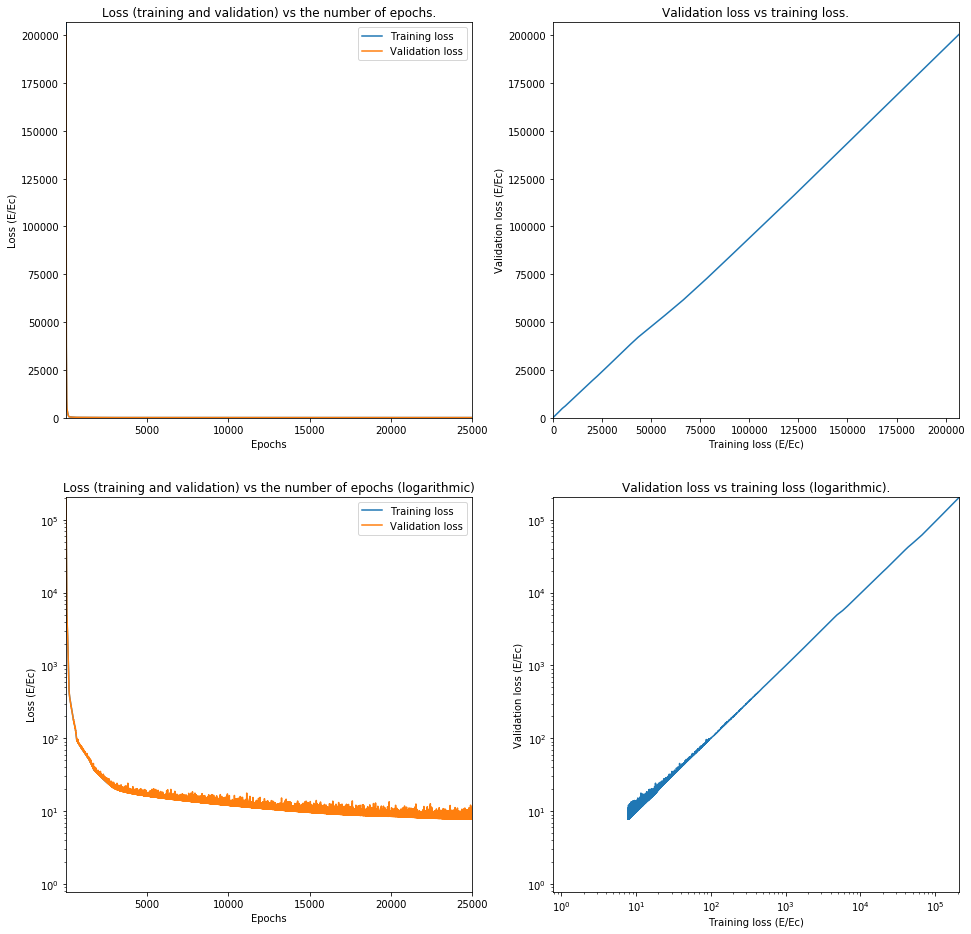

In [24]:
name = 'DenseLayerSmallSoftplus'
settingsNetwork = [inputSize, ['Dense', inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=25000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

19576/19576 [==============================] - 0s 9us/step
8.27889426391759


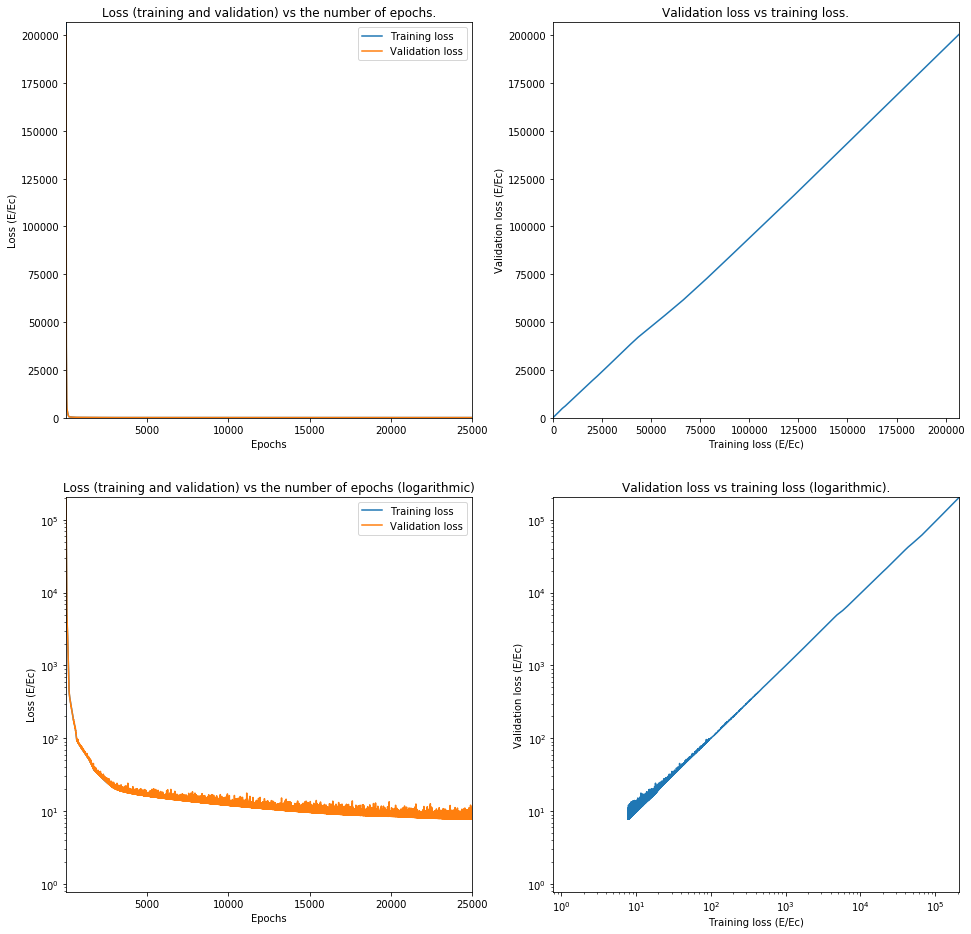

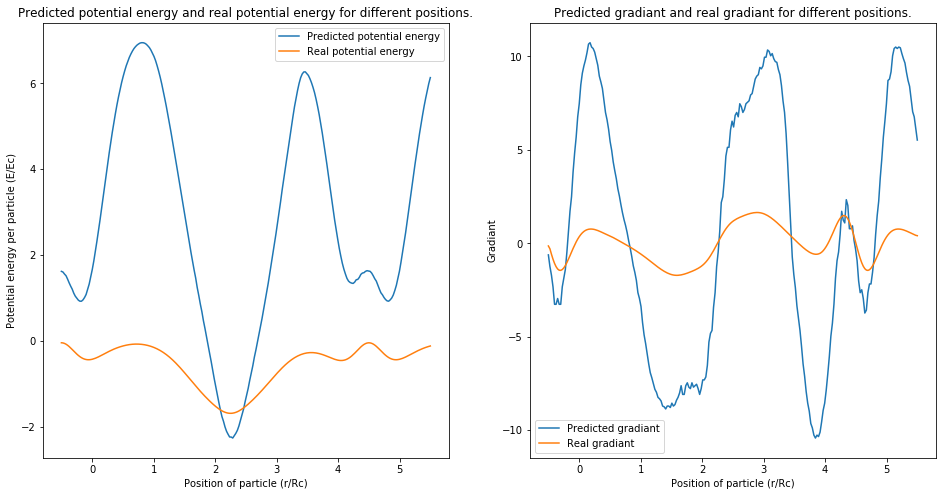

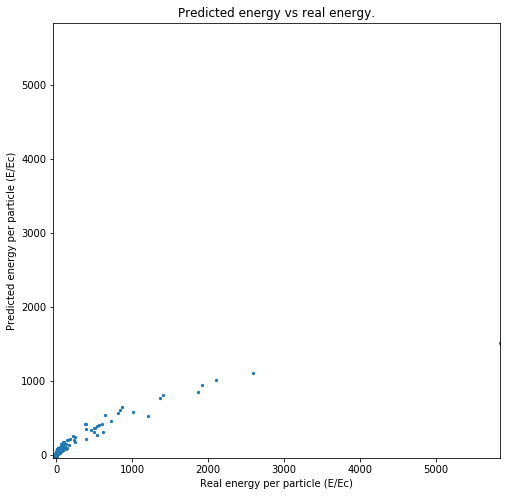

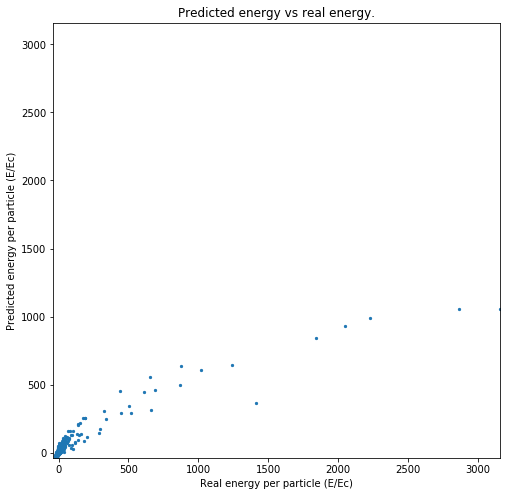

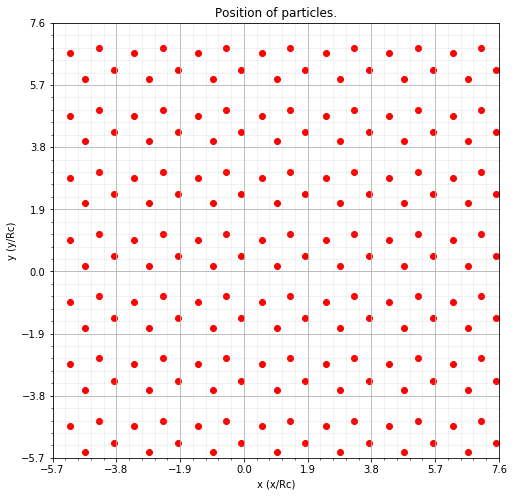

For index 36454 Predicted -7.3115954 was -13.8138842409


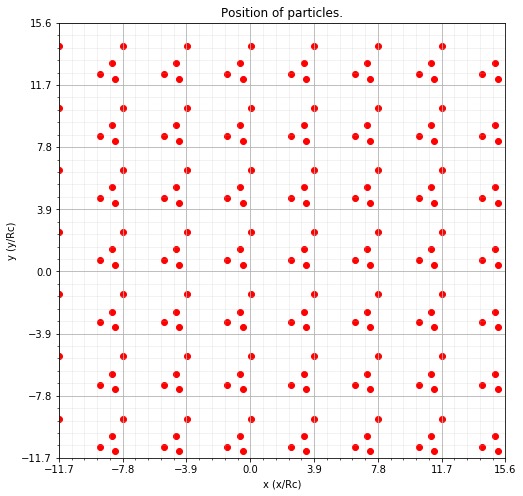

For index 77919 Predicted -1.6553454 was -1.5139580448


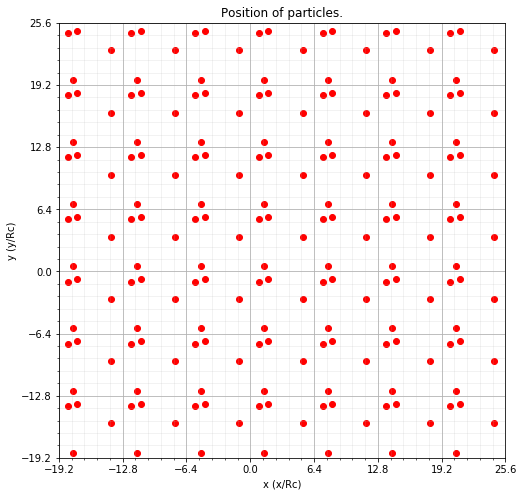

For index 2658 Predicted 0.64152956 was -0.2987796588


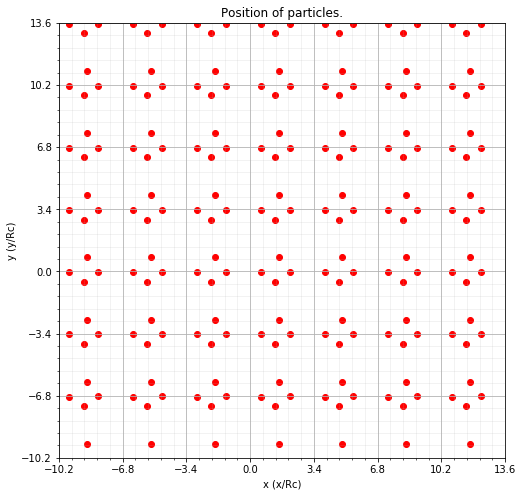

For index 64234 Predicted -5.0147204 was -2.2130348202


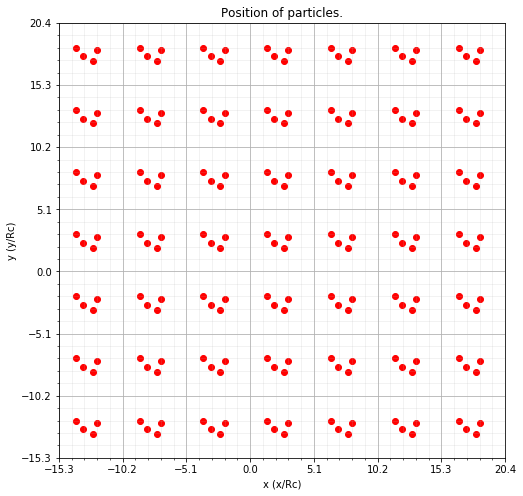

For index 10829 Predicted -3.5303454 was -2.1429048869


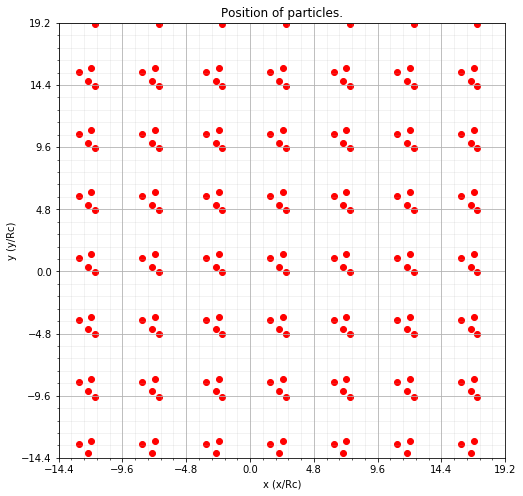

For index 69204 Predicted 8.563404 was 14.3631368483


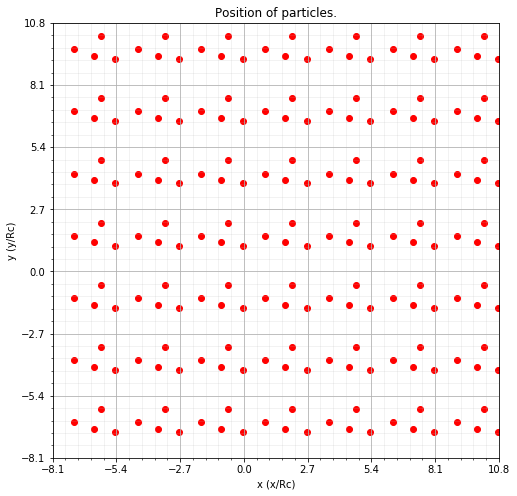

For index 53656 Predicted -3.1709704 was -3.9330538275


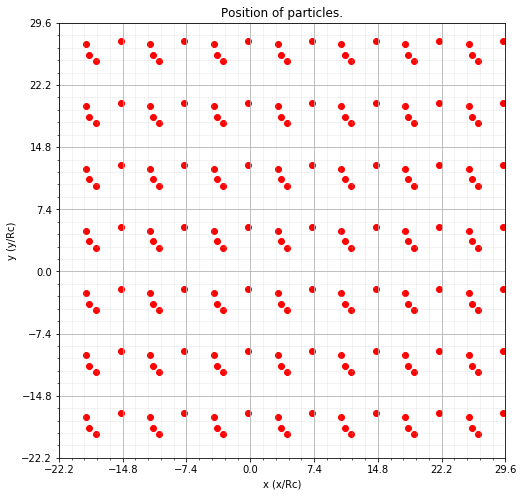

For index 59107 Predicted 1.6298108 was -0.21047515360000002


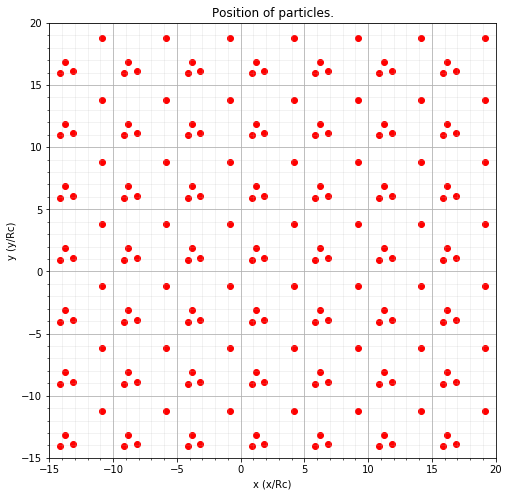

For index 967 Predicted -2.116283 was -1.314398845


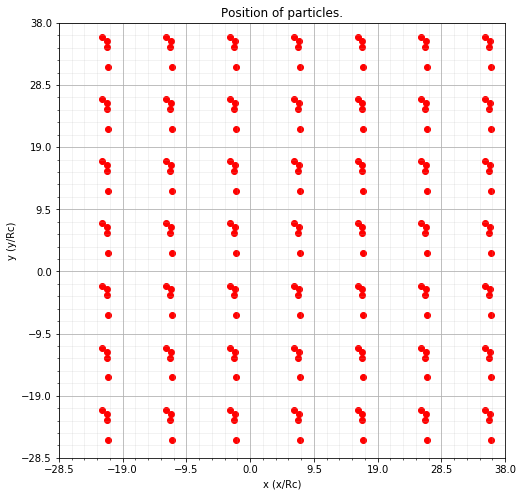

For index 51647 Predicted -1.8819079 was -0.7539948609


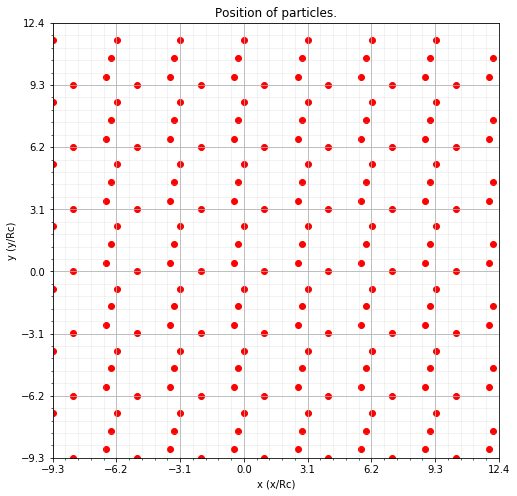

For index 76912 Predicted -2.256908 was -1.1216862668
Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_23 (Dense)             (None, 12)                156       
_________________________________________________________________
dense_24 (Dense)             (None, 1)                 13        
Total params: 169
Trainable params: 169
Non-trainable params: 0
_________________________________________________________________
Layer 0:  [array([[ 6.41508520e-01,  2.83078909e-01, -5.12978733e-01,
         6.37032628e-01,  3.01200837e-01, -1.85286596e-01,
         5.49566567e-01, -3.41438651e-02, -3.16463113e-01,
         2.89805140e-02,  6.77449763e-01,  5.15517294e-01],
       [-1.76268250e-01,  5.40912509e-01, -4.27840836e-02,
        -1.82745028e+00, -3.27014089e-01, -7.88627744e-01,
        -9.16122198e-02, -1.13986671e-01, -1.08409250e+00,
         3.20615500e-01, -6.90110445e-

In [25]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())

## Model 2: 1 Dense layer medium softplus

In [ ]:
name = 'DenseLayerMediumSoftplus'
settingsNetwork = [inputSize, ['Dense', 2*inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=25000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

In [ ]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())

## Model 3: 1 Dense layer large softplus

In [ ]:
name = 'DenseLayerLargeSoftplus'
settingsNetwork = [inputSize, ['Dense', 3*inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=10000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

In [ ]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())

## Model 4: 1 Dense layer super large softplus

In [ ]:
name = 'DenseLayerSuperLargeSoftplus'
settingsNetwork = [inputSize, ['Dense', 4*inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=10000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

In [ ]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())


## Model 5: 2 Dense layers small softplus

In [ ]:
name = 'TwoDenseLayerSmallSoftplus'
settingsNetwork = [inputSize, ['Dense', inputSize, 'softplus', True], ['Dense', inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=25000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

In [ ]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())


## Model 6: 2 Dense layer medium softplus

In [ ]:
name = 'TwoDenseLayerMediumSoftplus'
settingsNetwork = [inputSize, ['Dense', 2*inputSize, 'softplus', True], ['Dense', 2*inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=10000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

In [ ]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())


## Model 7: 2 Dense layers large softplus

In [ ]:
name = 'TwoDenseLayerLargeSoftplus'
settingsNetwork = [inputSize, ['Dense', 3*inputSize, 'softplus', True], ['Dense', 3*inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=10000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

In [ ]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())


## Model 8: 2 Dense layers very large softplus

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_25 (Dense)             (None, 48)                624       
_________________________________________________________________
dense_26 (Dense)             (None, 48)                2352      
_________________________________________________________________
dense_27 (Dense)             (None, 1)                 49        
Total params: 3,025
Trainable params: 3,025
Non-trainable params: 0
_________________________________________________________________
78306/78306 [==============================] - 1s 11us/step
307824.14560426405
Layer 0:  [array([[-4.36639488e-01,  1.71407163e-01, -5.33748507e-01,
        -2.12041646e-01,  4.41352546e-01,  3.35096061e-01,
        -5.95725775e-01, -9.52265859e-02, -4.34285343e-01,
        -7.12244511e-02,  9.64787006e-02, -7.01239228e-01,
         3.30784023e-01,  2.36708820e-01,  6.19544208e-

Train on 62644 samples, validate on 15662 samples
Epoch 1/10000
62644/62644 [==============================] - 2s 31us/step - loss: 110383.6333 - val_loss: 55371.8780
Epoch 2/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34739.6436 - val_loss: 26128.4977
Epoch 3/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21964.9867 - val_loss: 18883.4698
Epoch 4/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15892.2648 - val_loss: 13066.6624
Epoch 5/10000
62644/62644 [==============================] - 2s 29us/step - loss: 10467.3699 - val_loss: 8220.8658
Epoch 6/10000
62644/62644 [==============================] - 2s 29us/step - loss: 6142.2049 - val_loss: 4260.2678
Epoch 7/10000
62644/62644 [==============================] - 2s 29us/step - loss: 2984.9391 - val_loss: 2187.5654
Epoch 8/10000
62644/62644 [==============================] - 2s 29us/step - loss: 1798.4140 - val_loss: 1476.8372
Epoch 9/10000
62644/62644 [=

Epoch 73/10000
62644/62644 [==============================] - 2s 29us/step - loss: 237.9279 - val_loss: 237.1237
Epoch 74/10000
62644/62644 [==============================] - 2s 29us/step - loss: 236.0022 - val_loss: 248.2584
Epoch 75/10000
62644/62644 [==============================] - 2s 29us/step - loss: 233.4861 - val_loss: 233.6423
Epoch 76/10000
62644/62644 [==============================] - 2s 30us/step - loss: 230.7110 - val_loss: 236.5671
Epoch 77/10000
62644/62644 [==============================] - 2s 30us/step - loss: 229.0833 - val_loss: 228.5101
Epoch 78/10000
62644/62644 [==============================] - 2s 29us/step - loss: 226.6070 - val_loss: 224.8939
Epoch 79/10000
62644/62644 [==============================] - 2s 29us/step - loss: 223.3284 - val_loss: 224.0340
Epoch 80/10000
62644/62644 [==============================] - 2s 29us/step - loss: 221.8364 - val_loss: 220.1165
Epoch 81/10000
62644/62644 [==============================] - 2s 31us/step - loss: 219.6693 - va

62644/62644 [==============================] - 2s 29us/step - loss: 144.5535 - val_loss: 140.9357
Epoch 146/10000
62644/62644 [==============================] - 2s 29us/step - loss: 143.1519 - val_loss: 142.6851
Epoch 147/10000
62644/62644 [==============================] - 2s 29us/step - loss: 142.4014 - val_loss: 140.9754
Epoch 148/10000
62644/62644 [==============================] - 2s 29us/step - loss: 141.1003 - val_loss: 139.9692
Epoch 149/10000
62644/62644 [==============================] - 2s 29us/step - loss: 140.8838 - val_loss: 143.0287
Epoch 150/10000
62644/62644 [==============================] - 2s 29us/step - loss: 140.1361 - val_loss: 137.6145
Epoch 151/10000
62644/62644 [==============================] - 2s 29us/step - loss: 139.0631 - val_loss: 136.6189
Epoch 152/10000
62644/62644 [==============================] - 2s 29us/step - loss: 137.3391 - val_loss: 138.0794
Epoch 153/10000
62644/62644 [==============================] - 2s 29us/step - loss: 137.2709 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 95.2821 - val_loss: 94.0395
Epoch 218/10000
62644/62644 [==============================] - 2s 29us/step - loss: 94.9801 - val_loss: 92.3179
Epoch 219/10000
62644/62644 [==============================] - 2s 29us/step - loss: 93.7630 - val_loss: 96.5083
Epoch 220/10000
62644/62644 [==============================] - 2s 29us/step - loss: 93.6589 - val_loss: 93.0048
Epoch 221/10000
62644/62644 [==============================] - 2s 29us/step - loss: 93.4580 - val_loss: 90.9687
Epoch 222/10000
62644/62644 [==============================] - 2s 29us/step - loss: 92.5688 - val_loss: 94.9859
Epoch 223/10000
62644/62644 [==============================] - 2s 29us/step - loss: 92.0900 - val_loss: 92.1245
Epoch 224/10000
62644/62644 [==============================] - 2s 29us/step - loss: 91.9141 - val_loss: 90.9727
Epoch 225/10000
62644/62644 [==============================] - 2s 29us/step - loss: 91.4477 - val_loss: 91.1068
Epoch 22

62644/62644 [==============================] - 2s 29us/step - loss: 74.1272 - val_loss: 85.6276
Epoch 291/10000
62644/62644 [==============================] - 2s 29us/step - loss: 73.0411 - val_loss: 70.9813
Epoch 292/10000
62644/62644 [==============================] - 2s 29us/step - loss: 73.9383 - val_loss: 73.2327
Epoch 293/10000
62644/62644 [==============================] - 2s 29us/step - loss: 73.0329 - val_loss: 70.8140
Epoch 294/10000
62644/62644 [==============================] - 2s 29us/step - loss: 72.6859 - val_loss: 75.2220
Epoch 295/10000
62644/62644 [==============================] - 2s 29us/step - loss: 73.3529 - val_loss: 88.1770
Epoch 296/10000
62644/62644 [==============================] - 2s 29us/step - loss: 72.4335 - val_loss: 76.1752
Epoch 297/10000
62644/62644 [==============================] - 2s 29us/step - loss: 72.2180 - val_loss: 71.9876
Epoch 298/10000
62644/62644 [==============================] - 2s 29us/step - loss: 71.7600 - val_loss: 74.7856
Epoch 29

62644/62644 [==============================] - 2s 29us/step - loss: 60.8684 - val_loss: 65.5335
Epoch 364/10000
62644/62644 [==============================] - 2s 29us/step - loss: 60.7722 - val_loss: 58.3372
Epoch 365/10000
62644/62644 [==============================] - 2s 29us/step - loss: 59.9994 - val_loss: 57.7761
Epoch 366/10000
62644/62644 [==============================] - 2s 29us/step - loss: 60.7034 - val_loss: 62.6260
Epoch 367/10000
62644/62644 [==============================] - 2s 29us/step - loss: 60.5826 - val_loss: 61.0609
Epoch 368/10000
62644/62644 [==============================] - 2s 29us/step - loss: 59.9539 - val_loss: 57.6226
Epoch 369/10000
62644/62644 [==============================] - 2s 29us/step - loss: 59.7694 - val_loss: 61.6589
Epoch 370/10000
62644/62644 [==============================] - 2s 29us/step - loss: 60.4116 - val_loss: 69.7747
Epoch 371/10000
62644/62644 [==============================] - 2s 29us/step - loss: 60.4691 - val_loss: 56.8704
Epoch 37

62644/62644 [==============================] - 2s 29us/step - loss: 52.3273 - val_loss: 49.5243
Epoch 437/10000
62644/62644 [==============================] - 2s 29us/step - loss: 53.0255 - val_loss: 49.2855
Epoch 438/10000
62644/62644 [==============================] - 2s 29us/step - loss: 52.5877 - val_loss: 56.3745
Epoch 439/10000
62644/62644 [==============================] - 2s 29us/step - loss: 52.3057 - val_loss: 49.9066
Epoch 440/10000
62644/62644 [==============================] - 2s 29us/step - loss: 52.2668 - val_loss: 51.7501
Epoch 441/10000
62644/62644 [==============================] - 2s 29us/step - loss: 52.0567 - val_loss: 51.4186
Epoch 442/10000
62644/62644 [==============================] - 2s 29us/step - loss: 51.9718 - val_loss: 48.7870
Epoch 443/10000
62644/62644 [==============================] - 2s 29us/step - loss: 51.9073 - val_loss: 48.6390
Epoch 444/10000
62644/62644 [==============================] - 2s 29us/step - loss: 51.3973 - val_loss: 48.8539
Epoch 44

62644/62644 [==============================] - 2s 29us/step - loss: 46.5625 - val_loss: 43.4866
Epoch 510/10000
62644/62644 [==============================] - 2s 29us/step - loss: 46.7532 - val_loss: 52.3660
Epoch 511/10000
62644/62644 [==============================] - 2s 29us/step - loss: 46.7818 - val_loss: 44.8299
Epoch 512/10000
62644/62644 [==============================] - 2s 29us/step - loss: 46.8463 - val_loss: 42.9499
Epoch 513/10000
62644/62644 [==============================] - 2s 29us/step - loss: 46.7976 - val_loss: 52.5605
Epoch 514/10000
62644/62644 [==============================] - 2s 29us/step - loss: 47.0143 - val_loss: 69.0404
Epoch 515/10000
62644/62644 [==============================] - 2s 29us/step - loss: 46.2244 - val_loss: 44.3716
Epoch 516/10000
62644/62644 [==============================] - 2s 29us/step - loss: 46.4417 - val_loss: 47.0586
Epoch 517/10000
62644/62644 [==============================] - 2s 29us/step - loss: 46.2549 - val_loss: 48.0091
Epoch 51

62644/62644 [==============================] - 2s 29us/step - loss: 42.4687 - val_loss: 38.5794
Epoch 583/10000
62644/62644 [==============================] - 2s 29us/step - loss: 42.5473 - val_loss: 47.6808
Epoch 584/10000
62644/62644 [==============================] - 2s 29us/step - loss: 42.9677 - val_loss: 47.4073
Epoch 585/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.9716 - val_loss: 42.6724
Epoch 586/10000
62644/62644 [==============================] - 2s 29us/step - loss: 42.0683 - val_loss: 42.1104
Epoch 587/10000
62644/62644 [==============================] - 2s 29us/step - loss: 43.1725 - val_loss: 42.8420
Epoch 588/10000
62644/62644 [==============================] - 2s 29us/step - loss: 42.0731 - val_loss: 38.3385
Epoch 589/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.9303 - val_loss: 39.9131
Epoch 590/10000
62644/62644 [==============================] - 2s 29us/step - loss: 42.5952 - val_loss: 47.3517
Epoch 59

62644/62644 [==============================] - 2s 29us/step - loss: 39.3024 - val_loss: 36.3767
Epoch 656/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.6686 - val_loss: 36.5620
Epoch 657/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.0293 - val_loss: 36.8570
Epoch 658/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.8075 - val_loss: 37.0170
Epoch 659/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.1821 - val_loss: 38.4605
Epoch 660/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.6907 - val_loss: 35.2704
Epoch 661/10000
62644/62644 [==============================] - 2s 29us/step - loss: 38.8659 - val_loss: 37.9583
Epoch 662/10000
62644/62644 [==============================] - 2s 29us/step - loss: 38.7109 - val_loss: 35.6310
Epoch 663/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.3328 - val_loss: 36.6768
Epoch 66

62644/62644 [==============================] - 2s 29us/step - loss: 37.2064 - val_loss: 36.2164
Epoch 729/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.1481 - val_loss: 33.5976
Epoch 730/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.0709 - val_loss: 34.4572
Epoch 731/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.8578 - val_loss: 35.5000
Epoch 732/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.2238 - val_loss: 45.2643
Epoch 733/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.3230 - val_loss: 35.5490
Epoch 734/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.9867 - val_loss: 33.2852
Epoch 735/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.3617 - val_loss: 60.8117
Epoch 736/10000
62644/62644 [==============================] - 2s 30us/step - loss: 36.6244 - val_loss: 33.0129
Epoch 73

62644/62644 [==============================] - 2s 30us/step - loss: 34.4686 - val_loss: 31.4821
Epoch 802/10000
62644/62644 [==============================] - 2s 31us/step - loss: 34.6457 - val_loss: 33.0578
Epoch 803/10000
62644/62644 [==============================] - 2s 31us/step - loss: 34.4161 - val_loss: 31.6067
Epoch 804/10000
62644/62644 [==============================] - 2s 30us/step - loss: 34.5935 - val_loss: 32.5101
Epoch 805/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.4696 - val_loss: 32.4064
Epoch 806/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.6804 - val_loss: 34.3980
Epoch 807/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.1224 - val_loss: 36.3271
Epoch 808/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.5038 - val_loss: 31.0584
Epoch 809/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.1726 - val_loss: 31.5300
Epoch 81

62644/62644 [==============================] - 2s 29us/step - loss: 33.5717 - val_loss: 33.0401
Epoch 875/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.9967 - val_loss: 29.6811
Epoch 876/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.8751 - val_loss: 41.0722
Epoch 877/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.2568 - val_loss: 36.6290
Epoch 878/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.6312 - val_loss: 30.2525
Epoch 879/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.2981 - val_loss: 31.1706
Epoch 880/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.2317 - val_loss: 34.0405
Epoch 881/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.0655 - val_loss: 31.9761
Epoch 882/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.5865 - val_loss: 30.4335
Epoch 88

62644/62644 [==============================] - 2s 29us/step - loss: 31.7014 - val_loss: 30.2255
Epoch 948/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.4833 - val_loss: 29.3108
Epoch 949/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.6201 - val_loss: 29.6715
Epoch 950/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.3904 - val_loss: 28.9072
Epoch 951/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.0719 - val_loss: 39.3819
Epoch 952/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.5127 - val_loss: 29.9707
Epoch 953/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.3324 - val_loss: 28.7624
Epoch 954/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.2732 - val_loss: 29.8131
Epoch 955/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.9092 - val_loss: 34.2053
Epoch 95

62644/62644 [==============================] - 2s 29us/step - loss: 30.1317 - val_loss: 27.4130
Epoch 1021/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.4130 - val_loss: 30.1320
Epoch 1022/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.2910 - val_loss: 28.3494
Epoch 1023/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.9984 - val_loss: 28.4522
Epoch 1024/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.2656 - val_loss: 29.5373
Epoch 1025/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.1549 - val_loss: 27.6875
Epoch 1026/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.0905 - val_loss: 33.3100
Epoch 1027/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.7256 - val_loss: 27.9431
Epoch 1028/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.7315 - val_loss: 28.0028


62644/62644 [==============================] - 2s 29us/step - loss: 29.2791 - val_loss: 27.4451
Epoch 1093/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.2230 - val_loss: 26.4511
Epoch 1094/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.3666 - val_loss: 34.1210
Epoch 1095/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.9024 - val_loss: 26.5327
Epoch 1096/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.5724 - val_loss: 54.8431
Epoch 1097/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.6830 - val_loss: 36.9756
Epoch 1098/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.8935 - val_loss: 26.6399
Epoch 1099/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.3429 - val_loss: 35.7837
Epoch 1100/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.1517 - val_loss: 37.4240


62644/62644 [==============================] - 2s 29us/step - loss: 28.3946 - val_loss: 35.7379
Epoch 1165/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.7508 - val_loss: 30.9590
Epoch 1166/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.0706 - val_loss: 29.8107
Epoch 1167/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.9204 - val_loss: 25.4543
Epoch 1168/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.7451 - val_loss: 26.3056
Epoch 1169/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.0326 - val_loss: 25.5885
Epoch 1170/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.3058 - val_loss: 36.3238
Epoch 1171/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.5293 - val_loss: 27.4611
Epoch 1172/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.9261 - val_loss: 25.3257


62644/62644 [==============================] - 2s 29us/step - loss: 27.0453 - val_loss: 25.4133
Epoch 1237/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.2357 - val_loss: 26.5273
Epoch 1238/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.0510 - val_loss: 25.1548
Epoch 1239/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.3518 - val_loss: 24.7188
Epoch 1240/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.0143 - val_loss: 45.5798
Epoch 1241/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.8392 - val_loss: 44.5038
Epoch 1242/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.1197 - val_loss: 37.3236
Epoch 1243/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.9501 - val_loss: 24.1272
Epoch 1244/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.0716 - val_loss: 26.6946


62644/62644 [==============================] - 2s 29us/step - loss: 26.0952 - val_loss: 24.6152
Epoch 1309/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.0965 - val_loss: 39.9507
Epoch 1310/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.9923 - val_loss: 24.6963
Epoch 1311/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.8476 - val_loss: 26.4697
Epoch 1312/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.4911 - val_loss: 23.4765
Epoch 1313/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.3949 - val_loss: 23.9590
Epoch 1314/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.0474 - val_loss: 26.6435
Epoch 1315/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.6609 - val_loss: 23.9280
Epoch 1316/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.1280 - val_loss: 30.4056


62644/62644 [==============================] - 2s 29us/step - loss: 25.2550 - val_loss: 24.6852
Epoch 1381/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.4024 - val_loss: 23.1470
Epoch 1382/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.7795 - val_loss: 22.7301
Epoch 1383/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.5602 - val_loss: 22.8337
Epoch 1384/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.4327 - val_loss: 27.1460
Epoch 1385/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.5246 - val_loss: 22.7264
Epoch 1386/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.3912 - val_loss: 29.6317
Epoch 1387/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.8872 - val_loss: 24.2252
Epoch 1388/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.2741 - val_loss: 23.0684


62644/62644 [==============================] - 2s 29us/step - loss: 25.6155 - val_loss: 28.5324
Epoch 1453/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.9774 - val_loss: 21.9826
Epoch 1454/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.7635 - val_loss: 22.9581
Epoch 1455/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.7915 - val_loss: 22.2502
Epoch 1456/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.5082 - val_loss: 24.2041
Epoch 1457/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.0014 - val_loss: 23.4568
Epoch 1458/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.0538 - val_loss: 25.1733
Epoch 1459/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.8715 - val_loss: 24.9577
Epoch 1460/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.0909 - val_loss: 26.4973


62644/62644 [==============================] - 2s 29us/step - loss: 24.2191 - val_loss: 27.9246
Epoch 1525/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.4867 - val_loss: 22.2728
Epoch 1526/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.7303 - val_loss: 36.2470
Epoch 1527/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.3405 - val_loss: 27.0385
Epoch 1528/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.8899 - val_loss: 21.2213
Epoch 1529/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.9935 - val_loss: 22.4701
Epoch 1530/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.3699 - val_loss: 22.5191
Epoch 1531/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.1821 - val_loss: 23.4222
Epoch 1532/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.4623 - val_loss: 31.5313


62644/62644 [==============================] - 2s 29us/step - loss: 23.9160 - val_loss: 27.6240
Epoch 1597/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.2092 - val_loss: 23.6689
Epoch 1598/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.8175 - val_loss: 21.3063
Epoch 1599/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.0336 - val_loss: 21.0415
Epoch 1600/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.0114 - val_loss: 23.3425
Epoch 1601/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.5750 - val_loss: 27.4480
Epoch 1602/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6754 - val_loss: 22.1655
Epoch 1603/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6551 - val_loss: 24.0037
Epoch 1604/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.9333 - val_loss: 41.2174


62644/62644 [==============================] - 2s 29us/step - loss: 22.7990 - val_loss: 22.3063
Epoch 1669/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.7243 - val_loss: 28.6268
Epoch 1670/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.2315 - val_loss: 30.3815
Epoch 1671/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.2546 - val_loss: 27.5561
Epoch 1672/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.3434 - val_loss: 22.8595
Epoch 1673/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1983 - val_loss: 20.2456
Epoch 1674/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1699 - val_loss: 23.1652
Epoch 1675/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1418 - val_loss: 22.9247
Epoch 1676/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1897 - val_loss: 47.3979


62644/62644 [==============================] - 2s 29us/step - loss: 22.6030 - val_loss: 27.6054
Epoch 1741/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.4943 - val_loss: 32.8534
Epoch 1742/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.5097 - val_loss: 22.7138
Epoch 1743/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.0309 - val_loss: 19.7881
Epoch 1744/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.5442 - val_loss: 20.5812
Epoch 1745/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.3770 - val_loss: 30.4570
Epoch 1746/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.6638 - val_loss: 22.5459
Epoch 1747/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.0494 - val_loss: 21.4400
Epoch 1748/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.5959 - val_loss: 21.0216


62644/62644 [==============================] - 2s 30us/step - loss: 22.0147 - val_loss: 29.8453
Epoch 1813/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.4047 - val_loss: 22.1947
Epoch 1814/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.2908 - val_loss: 22.4564
Epoch 1815/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.0775 - val_loss: 20.9488
Epoch 1816/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.4371 - val_loss: 19.3857
Epoch 1817/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.7440 - val_loss: 24.0354
Epoch 1818/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9330 - val_loss: 25.6425
Epoch 1819/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.5534 - val_loss: 19.7901
Epoch 1820/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.3097 - val_loss: 28.4419


62644/62644 [==============================] - 2s 29us/step - loss: 21.9677 - val_loss: 19.5838
Epoch 1885/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.2713 - val_loss: 23.3101
Epoch 1886/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.2250 - val_loss: 20.3619
Epoch 1887/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9749 - val_loss: 19.9395
Epoch 1888/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.0564 - val_loss: 20.8776
Epoch 1889/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.1666 - val_loss: 19.5016
Epoch 1890/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.6459 - val_loss: 20.3960
Epoch 1891/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.6249 - val_loss: 24.4976
Epoch 1892/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.7298 - val_loss: 21.2369


62644/62644 [==============================] - 2s 29us/step - loss: 22.3674 - val_loss: 21.1470
Epoch 1957/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4532 - val_loss: 24.2242
Epoch 1958/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.0684 - val_loss: 20.2824
Epoch 1959/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.5976 - val_loss: 23.9366
Epoch 1960/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.6797 - val_loss: 20.6411
Epoch 1961/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.5617 - val_loss: 18.9074
Epoch 1962/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4187 - val_loss: 19.3133
Epoch 1963/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.9729 - val_loss: 19.1413
Epoch 1964/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4263 - val_loss: 18.7007


62644/62644 [==============================] - 2s 29us/step - loss: 21.3097 - val_loss: 25.8651
Epoch 2029/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.5388 - val_loss: 22.2335
Epoch 2030/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4075 - val_loss: 18.2104
Epoch 2031/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.1183 - val_loss: 18.5171
Epoch 2032/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6179 - val_loss: 19.5246
Epoch 2033/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6240 - val_loss: 19.1099
Epoch 2034/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.2630 - val_loss: 20.7900
Epoch 2035/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.5237 - val_loss: 18.6892
Epoch 2036/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8032 - val_loss: 23.0948


62644/62644 [==============================] - 2s 30us/step - loss: 20.7674 - val_loss: 19.9772
Epoch 2101/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.1495 - val_loss: 18.6548
Epoch 2102/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6476 - val_loss: 20.9535
Epoch 2103/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.9618 - val_loss: 23.6379
Epoch 2104/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8766 - val_loss: 18.1145
Epoch 2105/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.5457 - val_loss: 21.9950
Epoch 2106/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.5043 - val_loss: 21.1286
Epoch 2107/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.0467 - val_loss: 17.8770
Epoch 2108/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8735 - val_loss: 19.4326


62644/62644 [==============================] - 2s 29us/step - loss: 20.1359 - val_loss: 18.9360
Epoch 2173/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4459 - val_loss: 20.2277
Epoch 2174/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6089 - val_loss: 18.3479
Epoch 2175/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6400 - val_loss: 21.9601
Epoch 2176/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4492 - val_loss: 18.6775
Epoch 2177/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.9716 - val_loss: 20.0416
Epoch 2178/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.9712 - val_loss: 19.4062
Epoch 2179/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4437 - val_loss: 19.3952
Epoch 2180/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2294 - val_loss: 30.3525


62644/62644 [==============================] - 2s 29us/step - loss: 20.2499 - val_loss: 26.3488
Epoch 2245/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.0746 - val_loss: 23.6200
Epoch 2246/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.1263 - val_loss: 18.2127
Epoch 2247/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2168 - val_loss: 40.2880
Epoch 2248/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2072 - val_loss: 18.7363
Epoch 2249/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.3211 - val_loss: 17.5787
Epoch 2250/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.5875 - val_loss: 24.2662
Epoch 2251/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2884 - val_loss: 33.7389
Epoch 2252/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9785 - val_loss: 18.2635


62644/62644 [==============================] - 2s 30us/step - loss: 19.9722 - val_loss: 20.1628
Epoch 2317/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.9920 - val_loss: 17.5936
Epoch 2318/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.5789 - val_loss: 17.8614
Epoch 2319/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.1394 - val_loss: 19.9101
Epoch 2320/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.7360 - val_loss: 25.5298
Epoch 2321/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.8004 - val_loss: 18.3818
Epoch 2322/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.7607 - val_loss: 21.0327
Epoch 2323/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.6982 - val_loss: 20.2699
Epoch 2324/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.0316 - val_loss: 22.2771


62644/62644 [==============================] - 2s 29us/step - loss: 19.6069 - val_loss: 23.2007
Epoch 2389/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2655 - val_loss: 17.3179
Epoch 2390/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5839 - val_loss: 20.2632
Epoch 2391/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5141 - val_loss: 17.1345
Epoch 2392/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.7372 - val_loss: 22.7499
Epoch 2393/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2448 - val_loss: 20.1223
Epoch 2394/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.5073 - val_loss: 17.5601
Epoch 2395/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3221 - val_loss: 21.1225
Epoch 2396/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.6775 - val_loss: 20.9238


62644/62644 [==============================] - 2s 30us/step - loss: 19.7115 - val_loss: 25.1053
Epoch 2461/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.4865 - val_loss: 19.8785
Epoch 2462/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.4818 - val_loss: 18.0652
Epoch 2463/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1572 - val_loss: 18.7268
Epoch 2464/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.6555 - val_loss: 19.3202
Epoch 2465/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0989 - val_loss: 26.5757
Epoch 2466/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1275 - val_loss: 18.2870
Epoch 2467/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.7206 - val_loss: 23.0968
Epoch 2468/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.8861 - val_loss: 17.1580


62644/62644 [==============================] - 2s 29us/step - loss: 18.8978 - val_loss: 24.1652
Epoch 2533/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2385 - val_loss: 16.6209
Epoch 2534/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.8808 - val_loss: 22.2656
Epoch 2535/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9207 - val_loss: 20.1793
Epoch 2536/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.4498 - val_loss: 20.3097
Epoch 2537/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9147 - val_loss: 16.6474
Epoch 2538/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3717 - val_loss: 26.3990
Epoch 2539/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.8375 - val_loss: 16.5683
Epoch 2540/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0223 - val_loss: 16.5822


62644/62644 [==============================] - 2s 29us/step - loss: 19.2053 - val_loss: 17.0997
Epoch 2605/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6862 - val_loss: 19.3675
Epoch 2606/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4839 - val_loss: 16.7313
Epoch 2607/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5032 - val_loss: 22.3366
Epoch 2608/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1750 - val_loss: 17.5342
Epoch 2609/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0736 - val_loss: 17.4086
Epoch 2610/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1492 - val_loss: 33.7960
Epoch 2611/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7611 - val_loss: 20.4965
Epoch 2612/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7359 - val_loss: 17.3877


62644/62644 [==============================] - 2s 30us/step - loss: 18.9739 - val_loss: 16.2238
Epoch 2677/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6073 - val_loss: 19.5930
Epoch 2678/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6576 - val_loss: 19.2538
Epoch 2679/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4654 - val_loss: 17.5378
Epoch 2680/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0257 - val_loss: 16.7307
Epoch 2681/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4707 - val_loss: 34.5076
Epoch 2682/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0231 - val_loss: 25.8029
Epoch 2683/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2015 - val_loss: 17.0371
Epoch 2684/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4843 - val_loss: 21.6675


62644/62644 [==============================] - 2s 29us/step - loss: 18.3245 - val_loss: 16.0222
Epoch 2749/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1517 - val_loss: 16.1143
Epoch 2750/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6596 - val_loss: 16.6574
Epoch 2751/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6151 - val_loss: 16.9621
Epoch 2752/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.8130 - val_loss: 17.3579
Epoch 2753/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.6629 - val_loss: 19.7876
Epoch 2754/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.8088 - val_loss: 17.9259
Epoch 2755/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.4693 - val_loss: 21.6042
Epoch 2756/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.8488 - val_loss: 16.6263


62644/62644 [==============================] - 2s 30us/step - loss: 18.2391 - val_loss: 23.5624
Epoch 2821/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.8037 - val_loss: 31.2770
Epoch 2822/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7679 - val_loss: 18.9948
Epoch 2823/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3329 - val_loss: 16.1092
Epoch 2824/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3617 - val_loss: 16.8902
Epoch 2825/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1954 - val_loss: 15.9162
Epoch 2826/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3850 - val_loss: 16.4218
Epoch 2827/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3604 - val_loss: 21.2317
Epoch 2828/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0093 - val_loss: 21.2107


62644/62644 [==============================] - 2s 29us/step - loss: 17.9646 - val_loss: 15.8854
Epoch 2893/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7682 - val_loss: 16.1611
Epoch 2894/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1751 - val_loss: 16.5829
Epoch 2895/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9789 - val_loss: 19.6962
Epoch 2896/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5392 - val_loss: 15.6963
Epoch 2897/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1670 - val_loss: 19.4596
Epoch 2898/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5896 - val_loss: 16.2933
Epoch 2899/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9774 - val_loss: 22.6743
Epoch 2900/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1611 - val_loss: 15.3125


62644/62644 [==============================] - 2s 29us/step - loss: 17.7125 - val_loss: 15.9480
Epoch 2965/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4383 - val_loss: 25.5791
Epoch 2966/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7584 - val_loss: 19.0966
Epoch 2967/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7454 - val_loss: 17.6233
Epoch 2968/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3490 - val_loss: 18.9965
Epoch 2969/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4295 - val_loss: 17.9557
Epoch 2970/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9434 - val_loss: 15.6108
Epoch 2971/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1309 - val_loss: 15.3810
Epoch 2972/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3480 - val_loss: 16.6330


62644/62644 [==============================] - 2s 30us/step - loss: 18.4811 - val_loss: 17.3330
Epoch 3037/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.2650 - val_loss: 16.2890
Epoch 3038/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.8871 - val_loss: 15.5601
Epoch 3039/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.0499 - val_loss: 15.9698
Epoch 3040/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.7741 - val_loss: 17.2168
Epoch 3041/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.7778 - val_loss: 17.7637
Epoch 3042/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.0521 - val_loss: 15.8814
Epoch 3043/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0092 - val_loss: 18.4966
Epoch 3044/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.3995 - val_loss: 20.5467


62644/62644 [==============================] - 2s 29us/step - loss: 17.4124 - val_loss: 15.1340
Epoch 3109/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8198 - val_loss: 18.1860
Epoch 3110/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9647 - val_loss: 15.4292
Epoch 3111/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1919 - val_loss: 15.9771
Epoch 3112/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5863 - val_loss: 20.9963
Epoch 3113/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5336 - val_loss: 17.6963
Epoch 3114/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3236 - val_loss: 19.2553
Epoch 3115/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0548 - val_loss: 26.1809
Epoch 3116/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4218 - val_loss: 19.9614


62644/62644 [==============================] - 2s 29us/step - loss: 17.6984 - val_loss: 18.9390
Epoch 3181/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4861 - val_loss: 25.9789
Epoch 3182/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9749 - val_loss: 16.6981
Epoch 3183/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3420 - val_loss: 17.3089
Epoch 3184/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9725 - val_loss: 20.0974
Epoch 3185/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8829 - val_loss: 15.5175
Epoch 3186/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.5279 - val_loss: 14.8862
Epoch 3187/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6740 - val_loss: 18.7914
Epoch 3188/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4765 - val_loss: 26.6633


62644/62644 [==============================] - 2s 29us/step - loss: 17.4554 - val_loss: 28.5078
Epoch 3253/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6608 - val_loss: 15.3872
Epoch 3254/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8121 - val_loss: 17.6437
Epoch 3255/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0117 - val_loss: 16.3549
Epoch 3256/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3914 - val_loss: 21.1049
Epoch 3257/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0653 - val_loss: 14.6346
Epoch 3258/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4780 - val_loss: 24.1027
Epoch 3259/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4749 - val_loss: 17.8890
Epoch 3260/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3012 - val_loss: 14.6613


62644/62644 [==============================] - 2s 29us/step - loss: 17.6707 - val_loss: 14.6281
Epoch 3325/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4111 - val_loss: 14.6106
Epoch 3326/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4159 - val_loss: 15.8756
Epoch 3327/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2524 - val_loss: 20.6768
Epoch 3328/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6660 - val_loss: 24.2509
Epoch 3329/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2363 - val_loss: 14.3532
Epoch 3330/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9676 - val_loss: 17.6069
Epoch 3331/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7158 - val_loss: 14.4983
Epoch 3332/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2616 - val_loss: 16.4196


62644/62644 [==============================] - 2s 29us/step - loss: 17.3359 - val_loss: 15.6183
Epoch 3397/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2174 - val_loss: 16.0048
Epoch 3398/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7424 - val_loss: 23.0281
Epoch 3399/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5295 - val_loss: 14.5139
Epoch 3400/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4901 - val_loss: 15.2451
Epoch 3401/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0897 - val_loss: 20.6310
Epoch 3402/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1908 - val_loss: 14.8026
Epoch 3403/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1899 - val_loss: 18.0024
Epoch 3404/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1639 - val_loss: 17.2816


62644/62644 [==============================] - 2s 29us/step - loss: 17.8592 - val_loss: 17.7274
Epoch 3469/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0422 - val_loss: 19.1908
Epoch 3470/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0467 - val_loss: 16.6712
Epoch 3471/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4194 - val_loss: 16.4854
Epoch 3472/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3659 - val_loss: 18.2402
Epoch 3473/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5352 - val_loss: 14.8272
Epoch 3474/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4821 - val_loss: 15.8322
Epoch 3475/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8693 - val_loss: 15.5152
Epoch 3476/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9055 - val_loss: 15.5383


62644/62644 [==============================] - 2s 29us/step - loss: 17.0742 - val_loss: 14.3618
Epoch 3541/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0834 - val_loss: 16.5649
Epoch 3542/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8703 - val_loss: 14.9109
Epoch 3543/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1905 - val_loss: 14.7151
Epoch 3544/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9783 - val_loss: 14.9749
Epoch 3545/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2296 - val_loss: 14.4355
Epoch 3546/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8072 - val_loss: 19.2713
Epoch 3547/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8566 - val_loss: 14.3442
Epoch 3548/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1949 - val_loss: 14.5518


62644/62644 [==============================] - 2s 29us/step - loss: 17.4846 - val_loss: 14.4214
Epoch 3613/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9348 - val_loss: 18.0449
Epoch 3614/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1504 - val_loss: 16.0373
Epoch 3615/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9626 - val_loss: 22.6943
Epoch 3616/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7566 - val_loss: 15.5558
Epoch 3617/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0081 - val_loss: 15.6517
Epoch 3618/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7085 - val_loss: 14.2964
Epoch 3619/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8764 - val_loss: 24.1954
Epoch 3620/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5074 - val_loss: 14.0419


62644/62644 [==============================] - 2s 29us/step - loss: 16.8745 - val_loss: 14.0304
Epoch 3685/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2206 - val_loss: 14.6987
Epoch 3686/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2424 - val_loss: 26.4779
Epoch 3687/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7624 - val_loss: 29.7500
Epoch 3688/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0917 - val_loss: 14.4355
Epoch 3689/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5301 - val_loss: 15.8667
Epoch 3690/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2876 - val_loss: 29.2427
Epoch 3691/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0032 - val_loss: 19.3265
Epoch 3692/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9854 - val_loss: 14.4946


62644/62644 [==============================] - 2s 29us/step - loss: 16.9004 - val_loss: 15.2125
Epoch 3757/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5034 - val_loss: 15.9643
Epoch 3758/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1848 - val_loss: 21.3304
Epoch 3759/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4709 - val_loss: 14.6258
Epoch 3760/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6328 - val_loss: 18.5525
Epoch 3761/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7624 - val_loss: 17.7674
Epoch 3762/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2066 - val_loss: 22.3732
Epoch 3763/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7698 - val_loss: 18.6910
Epoch 3764/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4922 - val_loss: 14.1168


62644/62644 [==============================] - 2s 29us/step - loss: 16.0013 - val_loss: 28.3714
Epoch 3829/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6201 - val_loss: 20.7969
Epoch 3830/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6360 - val_loss: 21.5477
Epoch 3831/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8333 - val_loss: 28.0323
Epoch 3832/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3574 - val_loss: 15.9042
Epoch 3833/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5109 - val_loss: 15.4994
Epoch 3834/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5867 - val_loss: 17.6077
Epoch 3835/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5429 - val_loss: 16.0871
Epoch 3836/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5847 - val_loss: 21.1608


62644/62644 [==============================] - 2s 29us/step - loss: 16.9626 - val_loss: 13.7155
Epoch 3901/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5776 - val_loss: 24.8183
Epoch 3902/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6362 - val_loss: 14.9566
Epoch 3903/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7042 - val_loss: 19.7158
Epoch 3904/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0342 - val_loss: 16.4406
Epoch 3905/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2749 - val_loss: 27.4151
Epoch 3906/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2722 - val_loss: 18.4173
Epoch 3907/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3547 - val_loss: 16.6102
Epoch 3908/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5294 - val_loss: 14.8890


62644/62644 [==============================] - 2s 29us/step - loss: 17.0692 - val_loss: 17.1584
Epoch 3973/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5776 - val_loss: 15.0385
Epoch 3974/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4752 - val_loss: 16.1685
Epoch 3975/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4475 - val_loss: 16.2476
Epoch 3976/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8715 - val_loss: 14.7144
Epoch 3977/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9331 - val_loss: 22.6882
Epoch 3978/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9838 - val_loss: 16.8241
Epoch 3979/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4755 - val_loss: 18.5167
Epoch 3980/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3678 - val_loss: 17.8720


62644/62644 [==============================] - 2s 29us/step - loss: 17.0146 - val_loss: 14.7083
Epoch 4045/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5783 - val_loss: 26.0203
Epoch 4046/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6958 - val_loss: 15.0146
Epoch 4047/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6044 - val_loss: 18.3645
Epoch 4048/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9824 - val_loss: 13.2921
Epoch 4049/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4789 - val_loss: 24.5113
Epoch 4050/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2773 - val_loss: 13.7814
Epoch 4051/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5771 - val_loss: 20.3565
Epoch 4052/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7948 - val_loss: 18.0781


62644/62644 [==============================] - 2s 30us/step - loss: 16.4109 - val_loss: 14.2070
Epoch 4117/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3428 - val_loss: 15.4226
Epoch 4118/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0739 - val_loss: 14.0182
Epoch 4119/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9758 - val_loss: 17.0724
Epoch 4120/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6835 - val_loss: 21.0795
Epoch 4121/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7582 - val_loss: 18.2768
Epoch 4122/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2828 - val_loss: 13.3656
Epoch 4123/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5704 - val_loss: 17.9613
Epoch 4124/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6727 - val_loss: 16.3447


62644/62644 [==============================] - 2s 29us/step - loss: 16.3830 - val_loss: 18.1852
Epoch 4189/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3054 - val_loss: 17.0653
Epoch 4190/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2943 - val_loss: 13.6381
Epoch 4191/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2694 - val_loss: 15.7152
Epoch 4192/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3126 - val_loss: 16.3069
Epoch 4193/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7248 - val_loss: 14.4946
Epoch 4194/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4894 - val_loss: 19.9840
Epoch 4195/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0428 - val_loss: 13.7693
Epoch 4196/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3796 - val_loss: 13.6823


62644/62644 [==============================] - 2s 29us/step - loss: 16.1524 - val_loss: 14.8503
Epoch 4261/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6904 - val_loss: 14.7739
Epoch 4262/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4528 - val_loss: 22.2052
Epoch 4263/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2339 - val_loss: 19.0738
Epoch 4264/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9326 - val_loss: 27.2496
Epoch 4265/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3070 - val_loss: 16.2217
Epoch 4266/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3902 - val_loss: 14.6447
Epoch 4267/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4103 - val_loss: 15.1283
Epoch 4268/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0824 - val_loss: 26.9443


62644/62644 [==============================] - 2s 29us/step - loss: 15.9325 - val_loss: 13.1917
Epoch 4333/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7437 - val_loss: 14.4747
Epoch 4334/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6877 - val_loss: 13.1442
Epoch 4335/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9459 - val_loss: 17.4792
Epoch 4336/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2543 - val_loss: 14.9206
Epoch 4337/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3479 - val_loss: 18.8975
Epoch 4338/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4345 - val_loss: 20.3983
Epoch 4339/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2111 - val_loss: 16.7775
Epoch 4340/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5584 - val_loss: 15.5610


62644/62644 [==============================] - 2s 29us/step - loss: 16.0140 - val_loss: 20.8311
Epoch 4405/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2689 - val_loss: 19.5938
Epoch 4406/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6840 - val_loss: 14.2686
Epoch 4407/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3804 - val_loss: 15.0815
Epoch 4408/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9932 - val_loss: 13.0547
Epoch 4409/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1335 - val_loss: 35.1009
Epoch 4410/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1494 - val_loss: 13.5037
Epoch 4411/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0108 - val_loss: 30.2996
Epoch 4412/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0784 - val_loss: 16.7123


62644/62644 [==============================] - 2s 29us/step - loss: 15.9977 - val_loss: 14.2901
Epoch 4477/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9984 - val_loss: 20.3272
Epoch 4478/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2019 - val_loss: 13.7101
Epoch 4479/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1219 - val_loss: 13.7115
Epoch 4480/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2841 - val_loss: 14.5737
Epoch 4481/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3182 - val_loss: 14.1247
Epoch 4482/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7008 - val_loss: 15.8111
Epoch 4483/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0530 - val_loss: 22.8870
Epoch 4484/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3441 - val_loss: 14.7297


62644/62644 [==============================] - 2s 29us/step - loss: 15.9261 - val_loss: 15.1065
Epoch 4549/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1797 - val_loss: 14.4394
Epoch 4550/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1798 - val_loss: 13.7065
Epoch 4551/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1635 - val_loss: 16.8744
Epoch 4552/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2397 - val_loss: 17.4676
Epoch 4553/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2065 - val_loss: 13.0313
Epoch 4554/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3968 - val_loss: 13.1923
Epoch 4555/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8040 - val_loss: 21.9424
Epoch 4556/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4999 - val_loss: 14.1232


62644/62644 [==============================] - 2s 29us/step - loss: 16.0181 - val_loss: 28.7290
Epoch 4621/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1373 - val_loss: 20.0801
Epoch 4622/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6071 - val_loss: 12.9288
Epoch 4623/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7599 - val_loss: 14.3524
Epoch 4624/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9080 - val_loss: 14.6333
Epoch 4625/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8566 - val_loss: 14.9846
Epoch 4626/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9682 - val_loss: 16.2420
Epoch 4627/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1869 - val_loss: 17.3786
Epoch 4628/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2682 - val_loss: 15.5073


62644/62644 [==============================] - 2s 29us/step - loss: 15.6781 - val_loss: 13.5543
Epoch 4693/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7258 - val_loss: 23.8126
Epoch 4694/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2505 - val_loss: 13.2795
Epoch 4695/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6735 - val_loss: 14.4002
Epoch 4696/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5779 - val_loss: 13.0753
Epoch 4697/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4105 - val_loss: 28.5755
Epoch 4698/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0779 - val_loss: 12.5955
Epoch 4699/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9957 - val_loss: 18.3388
Epoch 4700/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1819 - val_loss: 14.3467


62644/62644 [==============================] - 2s 29us/step - loss: 15.9221 - val_loss: 13.0036
Epoch 4765/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3207 - val_loss: 22.7576
Epoch 4766/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3656 - val_loss: 13.3172
Epoch 4767/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3925 - val_loss: 14.3165
Epoch 4768/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1944 - val_loss: 14.4667
Epoch 4769/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9287 - val_loss: 14.0904
Epoch 4770/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2857 - val_loss: 14.3962
Epoch 4771/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9135 - val_loss: 13.1277
Epoch 4772/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3796 - val_loss: 17.4700


62644/62644 [==============================] - 2s 30us/step - loss: 16.1900 - val_loss: 17.6083
Epoch 4837/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6029 - val_loss: 23.4357
Epoch 4838/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1191 - val_loss: 14.1872
Epoch 4839/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9015 - val_loss: 12.9852
Epoch 4840/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9219 - val_loss: 12.8803
Epoch 4841/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5170 - val_loss: 21.4916
Epoch 4842/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4250 - val_loss: 18.9157
Epoch 4843/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4533 - val_loss: 13.7591
Epoch 4844/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7885 - val_loss: 12.7784


62644/62644 [==============================] - 2s 29us/step - loss: 15.6398 - val_loss: 12.9129
Epoch 4909/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5919 - val_loss: 12.7041
Epoch 4910/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8091 - val_loss: 14.7092
Epoch 4911/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4955 - val_loss: 14.0417
Epoch 4912/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5712 - val_loss: 31.2350
Epoch 4913/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9717 - val_loss: 12.5546
Epoch 4914/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0485 - val_loss: 14.8879
Epoch 4915/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6597 - val_loss: 14.6418
Epoch 4916/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5192 - val_loss: 16.2164


62644/62644 [==============================] - 2s 29us/step - loss: 15.6044 - val_loss: 12.9130
Epoch 4981/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1033 - val_loss: 13.7124
Epoch 4982/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1194 - val_loss: 13.9453
Epoch 4983/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7801 - val_loss: 13.5315
Epoch 4984/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6685 - val_loss: 18.4337
Epoch 4985/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1855 - val_loss: 18.6576
Epoch 4986/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7546 - val_loss: 13.9231
Epoch 4987/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3234 - val_loss: 12.9049
Epoch 4988/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9531 - val_loss: 16.1344


62644/62644 [==============================] - 2s 29us/step - loss: 16.4812 - val_loss: 16.2153
Epoch 5053/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5482 - val_loss: 15.3702
Epoch 5054/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5213 - val_loss: 13.0357
Epoch 5055/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1330 - val_loss: 14.3275
Epoch 5056/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7921 - val_loss: 12.8325
Epoch 5057/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7690 - val_loss: 14.9398
Epoch 5058/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0425 - val_loss: 17.0767
Epoch 5059/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3575 - val_loss: 20.7981
Epoch 5060/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8408 - val_loss: 22.8378


62644/62644 [==============================] - 2s 29us/step - loss: 15.5702 - val_loss: 16.7283
Epoch 5125/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2381 - val_loss: 19.8226
Epoch 5126/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5209 - val_loss: 26.6355
Epoch 5127/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0240 - val_loss: 13.1970
Epoch 5128/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1460 - val_loss: 15.4597
Epoch 5129/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7334 - val_loss: 16.7496
Epoch 5130/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7843 - val_loss: 12.8163
Epoch 5131/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7521 - val_loss: 27.3740
Epoch 5132/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6960 - val_loss: 13.1113


62644/62644 [==============================] - 2s 29us/step - loss: 15.7372 - val_loss: 16.1927
Epoch 5197/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7303 - val_loss: 15.3120
Epoch 5198/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9430 - val_loss: 14.5169
Epoch 5199/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4832 - val_loss: 14.3017
Epoch 5200/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8798 - val_loss: 13.2779
Epoch 5201/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7319 - val_loss: 13.7342
Epoch 5202/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6143 - val_loss: 31.1886
Epoch 5203/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3593 - val_loss: 21.6003
Epoch 5204/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5234 - val_loss: 12.5874


62644/62644 [==============================] - 2s 29us/step - loss: 15.7616 - val_loss: 16.6087
Epoch 5269/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4666 - val_loss: 13.5056
Epoch 5270/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1788 - val_loss: 12.7636
Epoch 5271/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0435 - val_loss: 17.9251
Epoch 5272/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7132 - val_loss: 13.0750
Epoch 5273/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3476 - val_loss: 13.6515
Epoch 5274/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4529 - val_loss: 15.9335
Epoch 5275/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0239 - val_loss: 18.5956
Epoch 5276/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4287 - val_loss: 12.7279


62644/62644 [==============================] - 2s 30us/step - loss: 14.9954 - val_loss: 16.5967
Epoch 5341/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.6769 - val_loss: 12.6710
Epoch 5342/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3198 - val_loss: 17.3568
Epoch 5343/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5395 - val_loss: 16.4891
Epoch 5344/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8592 - val_loss: 13.8477
Epoch 5345/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3954 - val_loss: 12.8510
Epoch 5346/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5971 - val_loss: 15.2049
Epoch 5347/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2841 - val_loss: 12.0323
Epoch 5348/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6254 - val_loss: 15.8081


62644/62644 [==============================] - 2s 29us/step - loss: 14.8531 - val_loss: 14.0041
Epoch 5413/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2381 - val_loss: 19.7053
Epoch 5414/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3970 - val_loss: 14.1186
Epoch 5415/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0384 - val_loss: 12.7935
Epoch 5416/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3526 - val_loss: 12.1829
Epoch 5417/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1074 - val_loss: 13.8467
Epoch 5418/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1756 - val_loss: 21.7854
Epoch 5419/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7052 - val_loss: 13.7740
Epoch 5420/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5589 - val_loss: 13.1830


62644/62644 [==============================] - 2s 29us/step - loss: 14.8564 - val_loss: 15.1167
Epoch 5485/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7697 - val_loss: 15.2002
Epoch 5486/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4402 - val_loss: 13.5836
Epoch 5487/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5798 - val_loss: 12.1880
Epoch 5488/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3906 - val_loss: 17.0023
Epoch 5489/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5936 - val_loss: 12.2240
Epoch 5490/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2428 - val_loss: 16.3029
Epoch 5491/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3350 - val_loss: 12.6591
Epoch 5492/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3314 - val_loss: 15.3349


62644/62644 [==============================] - 2s 29us/step - loss: 15.5553 - val_loss: 15.6349
Epoch 5557/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3341 - val_loss: 11.9710
Epoch 5558/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8363 - val_loss: 12.8823
Epoch 5559/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0560 - val_loss: 13.8995
Epoch 5560/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6367 - val_loss: 16.9618
Epoch 5561/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5958 - val_loss: 19.6302
Epoch 5562/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6319 - val_loss: 23.3548
Epoch 5563/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7347 - val_loss: 12.1655
Epoch 5564/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4846 - val_loss: 19.2509


62644/62644 [==============================] - 2s 29us/step - loss: 15.3804 - val_loss: 12.4094
Epoch 5629/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2917 - val_loss: 13.0889
Epoch 5630/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8665 - val_loss: 20.6291
Epoch 5631/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9699 - val_loss: 16.2562
Epoch 5632/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4313 - val_loss: 12.0374
Epoch 5633/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0189 - val_loss: 12.1619
Epoch 5634/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8913 - val_loss: 14.2589
Epoch 5635/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1959 - val_loss: 18.6113
Epoch 5636/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6095 - val_loss: 21.5190


62644/62644 [==============================] - 2s 29us/step - loss: 14.8112 - val_loss: 12.0683
Epoch 5701/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0882 - val_loss: 13.5048
Epoch 5702/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7314 - val_loss: 20.0966
Epoch 5703/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1079 - val_loss: 21.1709
Epoch 5704/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1225 - val_loss: 13.5646
Epoch 5705/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9646 - val_loss: 12.2695
Epoch 5706/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8933 - val_loss: 11.8843
Epoch 5707/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6202 - val_loss: 13.1239
Epoch 5708/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3344 - val_loss: 18.9456


62644/62644 [==============================] - 2s 29us/step - loss: 15.5440 - val_loss: 12.6272
Epoch 5773/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8477 - val_loss: 18.4750
Epoch 5774/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3285 - val_loss: 17.3618
Epoch 5775/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3286 - val_loss: 14.5978
Epoch 5776/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.5352 - val_loss: 12.2916
Epoch 5777/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4812 - val_loss: 13.9054
Epoch 5778/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6007 - val_loss: 13.8666
Epoch 5779/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8500 - val_loss: 13.2107
Epoch 5780/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8627 - val_loss: 13.2990


62644/62644 [==============================] - 2s 29us/step - loss: 14.9722 - val_loss: 11.8160
Epoch 5845/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.3505 - val_loss: 12.1199
Epoch 5846/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.2992 - val_loss: 13.2994
Epoch 5847/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8956 - val_loss: 15.6582
Epoch 5848/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7127 - val_loss: 12.8576
Epoch 5849/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5180 - val_loss: 14.4163
Epoch 5850/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0626 - val_loss: 25.1805
Epoch 5851/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8492 - val_loss: 13.9972
Epoch 5852/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9229 - val_loss: 12.3426


62644/62644 [==============================] - 2s 29us/step - loss: 14.7670 - val_loss: 12.9098
Epoch 5917/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9988 - val_loss: 12.1062
Epoch 5918/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5503 - val_loss: 12.3467
Epoch 5919/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9659 - val_loss: 19.6239
Epoch 5920/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5785 - val_loss: 12.9810
Epoch 5921/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5010 - val_loss: 11.9908
Epoch 5922/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0681 - val_loss: 16.8632
Epoch 5923/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6787 - val_loss: 16.5882
Epoch 5924/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1801 - val_loss: 14.4902


62644/62644 [==============================] - 2s 29us/step - loss: 14.9443 - val_loss: 12.2119
Epoch 5989/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3179 - val_loss: 17.4946
Epoch 5990/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7438 - val_loss: 13.2256
Epoch 5991/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9141 - val_loss: 28.5052
Epoch 5992/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9319 - val_loss: 19.8035
Epoch 5993/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.1897 - val_loss: 14.5182
Epoch 5994/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.4142 - val_loss: 22.0173
Epoch 5995/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3655 - val_loss: 18.9780
Epoch 5996/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0497 - val_loss: 14.2050


62644/62644 [==============================] - 2s 29us/step - loss: 14.7373 - val_loss: 12.1954
Epoch 6061/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7138 - val_loss: 15.2091
Epoch 6062/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5108 - val_loss: 12.5702
Epoch 6063/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2069 - val_loss: 14.9768
Epoch 6064/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6195 - val_loss: 28.1566
Epoch 6065/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0725 - val_loss: 14.7112
Epoch 6066/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3361 - val_loss: 14.5678
Epoch 6067/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2380 - val_loss: 18.5657
Epoch 6068/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9176 - val_loss: 11.8524


62644/62644 [==============================] - 2s 29us/step - loss: 14.8003 - val_loss: 13.5834
Epoch 6133/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7212 - val_loss: 12.2313
Epoch 6134/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1387 - val_loss: 12.2858
Epoch 6135/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0782 - val_loss: 14.9571
Epoch 6136/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1833 - val_loss: 12.1242
Epoch 6137/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7763 - val_loss: 13.3485
Epoch 6138/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3267 - val_loss: 13.5387
Epoch 6139/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0059 - val_loss: 12.0907
Epoch 6140/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3725 - val_loss: 13.3284


62644/62644 [==============================] - 2s 29us/step - loss: 15.2267 - val_loss: 12.1448
Epoch 6205/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4265 - val_loss: 20.7249
Epoch 6206/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6424 - val_loss: 13.1858
Epoch 6207/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9253 - val_loss: 12.9818
Epoch 6208/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4250 - val_loss: 14.1829
Epoch 6209/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8164 - val_loss: 14.3139
Epoch 6210/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1850 - val_loss: 18.1943
Epoch 6211/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7371 - val_loss: 14.1221
Epoch 6212/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8434 - val_loss: 18.5472


62644/62644 [==============================] - 2s 29us/step - loss: 14.4664 - val_loss: 19.7613
Epoch 6277/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4242 - val_loss: 12.0796
Epoch 6278/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9518 - val_loss: 20.5162
Epoch 6279/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5979 - val_loss: 16.3538
Epoch 6280/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3742 - val_loss: 11.9445
Epoch 6281/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0115 - val_loss: 14.4695
Epoch 6282/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8167 - val_loss: 12.6407
Epoch 6283/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6585 - val_loss: 13.7537
Epoch 6284/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0281 - val_loss: 12.1308


62644/62644 [==============================] - 2s 29us/step - loss: 14.7196 - val_loss: 12.1199
Epoch 6349/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6633 - val_loss: 19.0694
Epoch 6350/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.0004 - val_loss: 12.5068
Epoch 6351/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.1665 - val_loss: 15.1121
Epoch 6352/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6965 - val_loss: 12.0963
Epoch 6353/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1385 - val_loss: 12.8797
Epoch 6354/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9703 - val_loss: 15.9619
Epoch 6355/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9320 - val_loss: 46.7691
Epoch 6356/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3600 - val_loss: 11.9590


62644/62644 [==============================] - 2s 29us/step - loss: 15.2906 - val_loss: 20.9749
Epoch 6421/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2809 - val_loss: 13.2596
Epoch 6422/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6080 - val_loss: 14.0840
Epoch 6423/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0861 - val_loss: 18.4560
Epoch 6424/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3955 - val_loss: 13.1524
Epoch 6425/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7414 - val_loss: 12.1652
Epoch 6426/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7726 - val_loss: 12.1233
Epoch 6427/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4867 - val_loss: 15.0593
Epoch 6428/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8775 - val_loss: 18.2981


62644/62644 [==============================] - 2s 30us/step - loss: 14.9351 - val_loss: 14.5537
Epoch 6493/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3887 - val_loss: 12.2290
Epoch 6494/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9394 - val_loss: 11.9577
Epoch 6495/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8171 - val_loss: 13.3646
Epoch 6496/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5512 - val_loss: 21.9492
Epoch 6497/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7924 - val_loss: 11.9817
Epoch 6498/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3859 - val_loss: 18.8645
Epoch 6499/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5173 - val_loss: 12.2215
Epoch 6500/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1456 - val_loss: 11.8667


62644/62644 [==============================] - 2s 29us/step - loss: 15.4036 - val_loss: 16.9176
Epoch 6565/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7715 - val_loss: 23.0117
Epoch 6566/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8316 - val_loss: 13.0848
Epoch 6567/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9169 - val_loss: 12.3146
Epoch 6568/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3768 - val_loss: 21.1553
Epoch 6569/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6499 - val_loss: 11.8817
Epoch 6570/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7195 - val_loss: 12.9124
Epoch 6571/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6488 - val_loss: 11.5727
Epoch 6572/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3950 - val_loss: 11.1551


62644/62644 [==============================] - 2s 29us/step - loss: 14.8057 - val_loss: 12.8706
Epoch 6637/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3798 - val_loss: 11.5806
Epoch 6638/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7247 - val_loss: 15.2635
Epoch 6639/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0154 - val_loss: 18.0795
Epoch 6640/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3166 - val_loss: 25.2610
Epoch 6641/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3517 - val_loss: 11.5841
Epoch 6642/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6684 - val_loss: 11.2555
Epoch 6643/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5304 - val_loss: 12.0946
Epoch 6644/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5020 - val_loss: 15.1822


62644/62644 [==============================] - 2s 29us/step - loss: 14.8911 - val_loss: 19.4126
Epoch 6709/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8011 - val_loss: 16.7305
Epoch 6710/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7768 - val_loss: 12.7842
Epoch 6711/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2611 - val_loss: 17.1743
Epoch 6712/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7629 - val_loss: 30.5200
Epoch 6713/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3680 - val_loss: 13.3436
Epoch 6714/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.9779 - val_loss: 12.2183
Epoch 6715/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.6320 - val_loss: 15.6075
Epoch 6716/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.4996 - val_loss: 16.4356


62644/62644 [==============================] - 2s 29us/step - loss: 14.2632 - val_loss: 11.6706
Epoch 6781/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9631 - val_loss: 12.3952
Epoch 6782/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2641 - val_loss: 12.0680
Epoch 6783/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2124 - val_loss: 12.9189
Epoch 6784/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8797 - val_loss: 21.0136
Epoch 6785/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8368 - val_loss: 15.1394
Epoch 6786/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5786 - val_loss: 15.4786
Epoch 6787/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2948 - val_loss: 19.6015
Epoch 6788/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4165 - val_loss: 12.5556


62644/62644 [==============================] - 2s 29us/step - loss: 15.1501 - val_loss: 11.9254
Epoch 6853/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4893 - val_loss: 17.0075
Epoch 6854/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.2711 - val_loss: 12.3694
Epoch 6855/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2984 - val_loss: 18.2724
Epoch 6856/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2272 - val_loss: 14.2054
Epoch 6857/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2705 - val_loss: 17.2202
Epoch 6858/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1965 - val_loss: 11.5671
Epoch 6859/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9209 - val_loss: 17.6783
Epoch 6860/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8474 - val_loss: 19.1075


62644/62644 [==============================] - 2s 29us/step - loss: 14.7163 - val_loss: 15.4202
Epoch 6925/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7383 - val_loss: 15.8093
Epoch 6926/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9485 - val_loss: 12.3136
Epoch 6927/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3311 - val_loss: 15.1517
Epoch 6928/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4967 - val_loss: 13.6533
Epoch 6929/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6710 - val_loss: 12.2984
Epoch 6930/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6377 - val_loss: 21.7022
Epoch 6931/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9954 - val_loss: 11.2141
Epoch 6932/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7982 - val_loss: 12.8329


62644/62644 [==============================] - 2s 29us/step - loss: 15.0671 - val_loss: 17.1169
Epoch 6997/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6463 - val_loss: 11.4749
Epoch 6998/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8820 - val_loss: 16.3903
Epoch 6999/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3311 - val_loss: 25.1759
Epoch 7000/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3025 - val_loss: 21.9034
Epoch 7001/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7836 - val_loss: 12.1287
Epoch 7002/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8721 - val_loss: 20.8531
Epoch 7003/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3210 - val_loss: 15.0374
Epoch 7004/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1994 - val_loss: 12.9674


62644/62644 [==============================] - 2s 29us/step - loss: 14.6821 - val_loss: 11.4389
Epoch 7069/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5095 - val_loss: 11.2218
Epoch 7070/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3172 - val_loss: 14.9286
Epoch 7071/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1544 - val_loss: 12.2445
Epoch 7072/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0739 - val_loss: 24.3055
Epoch 7073/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0611 - val_loss: 13.1764
Epoch 7074/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0552 - val_loss: 12.7404
Epoch 7075/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5229 - val_loss: 12.7300
Epoch 7076/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3211 - val_loss: 12.1256


62644/62644 [==============================] - 2s 29us/step - loss: 14.6866 - val_loss: 12.1639
Epoch 7141/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4420 - val_loss: 14.7311
Epoch 7142/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7583 - val_loss: 11.3870
Epoch 7143/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8667 - val_loss: 11.8707
Epoch 7144/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6453 - val_loss: 15.3496
Epoch 7145/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8752 - val_loss: 10.9462
Epoch 7146/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0321 - val_loss: 13.1790
Epoch 7147/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5283 - val_loss: 16.1911
Epoch 7148/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3474 - val_loss: 12.1207


62644/62644 [==============================] - 2s 29us/step - loss: 14.6638 - val_loss: 11.8017
Epoch 7213/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2612 - val_loss: 11.7609
Epoch 7214/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1449 - val_loss: 16.5703
Epoch 7215/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9753 - val_loss: 13.3128
Epoch 7216/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7361 - val_loss: 11.8210
Epoch 7217/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8399 - val_loss: 13.7812
Epoch 7218/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8137 - val_loss: 11.5043
Epoch 7219/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1322 - val_loss: 32.1816
Epoch 7220/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2091 - val_loss: 12.0539


62644/62644 [==============================] - 2s 29us/step - loss: 14.4606 - val_loss: 30.4492
Epoch 7285/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3240 - val_loss: 11.1907
Epoch 7286/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6484 - val_loss: 13.5034
Epoch 7287/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9553 - val_loss: 11.4910
Epoch 7288/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6933 - val_loss: 13.0890
Epoch 7289/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9406 - val_loss: 23.1297
Epoch 7290/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9805 - val_loss: 25.5544
Epoch 7291/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0457 - val_loss: 11.9832
Epoch 7292/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5472 - val_loss: 12.9319


62644/62644 [==============================] - 2s 29us/step - loss: 14.8384 - val_loss: 14.7563
Epoch 7357/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3054 - val_loss: 22.8341
Epoch 7358/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5722 - val_loss: 11.2899
Epoch 7359/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.2260 - val_loss: 15.4405
Epoch 7360/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.4183 - val_loss: 16.8243
Epoch 7361/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5930 - val_loss: 20.2527
Epoch 7362/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1155 - val_loss: 17.1269
Epoch 7363/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4117 - val_loss: 11.2282
Epoch 7364/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1687 - val_loss: 18.4833


62644/62644 [==============================] - 2s 29us/step - loss: 14.4719 - val_loss: 23.0457
Epoch 7429/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7520 - val_loss: 12.4910
Epoch 7430/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6146 - val_loss: 14.3755
Epoch 7431/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6151 - val_loss: 13.4764
Epoch 7432/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4710 - val_loss: 20.3543
Epoch 7433/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3596 - val_loss: 11.9962
Epoch 7434/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4051 - val_loss: 11.7320
Epoch 7435/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.5065 - val_loss: 25.8169
Epoch 7436/10000
62644/62644 [==============================] - 2s 30us/step - loss: 13.8922 - val_loss: 11.2264


62644/62644 [==============================] - 2s 29us/step - loss: 14.3670 - val_loss: 13.6709
Epoch 7501/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4676 - val_loss: 12.0444
Epoch 7502/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1537 - val_loss: 12.2597
Epoch 7503/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1277 - val_loss: 13.5639
Epoch 7504/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3811 - val_loss: 11.9810
Epoch 7505/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2117 - val_loss: 18.0713
Epoch 7506/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1179 - val_loss: 17.2121
Epoch 7507/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3080 - val_loss: 16.3648
Epoch 7508/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1518 - val_loss: 24.6770


62644/62644 [==============================] - 2s 29us/step - loss: 14.8269 - val_loss: 14.4501
Epoch 7573/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4215 - val_loss: 21.4992
Epoch 7574/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5321 - val_loss: 15.9349
Epoch 7575/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3521 - val_loss: 12.9581
Epoch 7576/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6254 - val_loss: 16.3514
Epoch 7577/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9734 - val_loss: 13.2761
Epoch 7578/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4514 - val_loss: 13.1523
Epoch 7579/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9724 - val_loss: 13.3456
Epoch 7580/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6387 - val_loss: 42.2239


62644/62644 [==============================] - 2s 29us/step - loss: 14.1676 - val_loss: 13.2861
Epoch 7645/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6479 - val_loss: 15.6350
Network0 Layer 0:  [array([[-4.76297259e-01,  6.84095621e-02,  6.29277110e-01,
         5.48779488e-01, -9.58125353e-01, -4.37199742e-01,
         6.19149148e-01,  6.00821450e-02,  1.10182595e-02,
        -5.03772020e-01,  3.51597637e-01, -5.61030149e-01,
         6.09941781e-01,  1.37422979e-01,  1.35729656e-01,
        -3.32476169e-01,  7.52110556e-02,  6.85661912e-01,
         5.95996618e-01,  3.14606607e-01, -6.66786492e-01,
        -6.32799387e-01,  1.57157451e-01,  1.23414002e-01,
        -1.00640349e-01,  1.95905119e-01, -1.80700421e-01,
         3.74385267e-01,  5.91315567e-01, -1.03161633e+00,
        -6.44487023e-01,  7.43344545e-01, -6.17814064e-01,
        -2.81840086e-01,  6.75487339e-01, -5.61071455e-01,
        -3.95858914e-01,  5.35375237e-01,  7.06322342e-02,
    

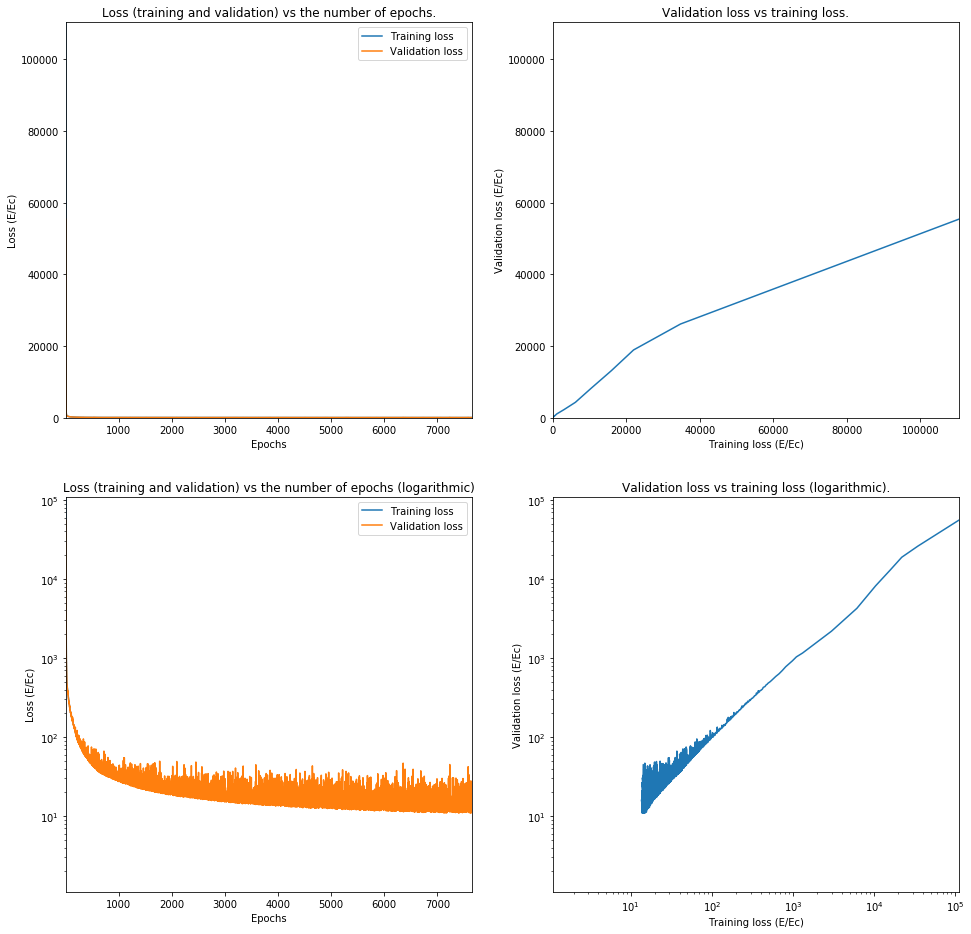

Train on 62644 samples, validate on 15662 samples
Epoch 1/10000
62644/62644 [==============================] - 2s 30us/step - loss: 64322.6890 - val_loss: 19357.3485
Epoch 2/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15466.0463 - val_loss: 11741.4410
Epoch 3/10000
62644/62644 [==============================] - 2s 29us/step - loss: 9011.0308 - val_loss: 6789.6745
Epoch 4/10000
62644/62644 [==============================] - 2s 28us/step - loss: 5481.3291 - val_loss: 4527.8490
Epoch 5/10000
62644/62644 [==============================] - 2s 29us/step - loss: 3850.3865 - val_loss: 3355.4123
Epoch 6/10000
62644/62644 [==============================] - 2s 29us/step - loss: 2966.4508 - val_loss: 2606.7375
Epoch 7/10000
62644/62644 [==============================] - 2s 29us/step - loss: 2332.0024 - val_loss: 2069.8958
Epoch 8/10000
62644/62644 [==============================] - 2s 28us/step - loss: 1939.3649 - val_loss: 1816.3335
Epoch 9/10000
62644/62644 [=======

62644/62644 [==============================] - 2s 28us/step - loss: 541.2988 - val_loss: 531.8337
Epoch 73/10000
62644/62644 [==============================] - 2s 28us/step - loss: 532.8656 - val_loss: 526.5603
Epoch 74/10000
62644/62644 [==============================] - 2s 28us/step - loss: 523.4951 - val_loss: 513.7740
Epoch 75/10000
62644/62644 [==============================] - 2s 28us/step - loss: 511.7567 - val_loss: 521.2386
Epoch 76/10000
62644/62644 [==============================] - 2s 28us/step - loss: 501.8426 - val_loss: 496.9456
Epoch 77/10000
62644/62644 [==============================] - 2s 28us/step - loss: 492.0173 - val_loss: 491.6137
Epoch 78/10000
62644/62644 [==============================] - 2s 28us/step - loss: 485.7888 - val_loss: 485.0211
Epoch 79/10000
62644/62644 [==============================] - 2s 29us/step - loss: 477.3865 - val_loss: 473.3369
Epoch 80/10000
62644/62644 [==============================] - 2s 28us/step - loss: 471.4417 - val_loss: 472.672

62644/62644 [==============================] - 2s 28us/step - loss: 287.5795 - val_loss: 300.7242
Epoch 145/10000
62644/62644 [==============================] - 2s 28us/step - loss: 286.5756 - val_loss: 300.2998
Epoch 146/10000
62644/62644 [==============================] - 2s 29us/step - loss: 285.1910 - val_loss: 298.6635
Epoch 147/10000
62644/62644 [==============================] - 2s 28us/step - loss: 284.0086 - val_loss: 302.6579
Epoch 148/10000
62644/62644 [==============================] - 2s 28us/step - loss: 283.1012 - val_loss: 293.8586
Epoch 149/10000
62644/62644 [==============================] - 2s 28us/step - loss: 282.4841 - val_loss: 292.7338
Epoch 150/10000
62644/62644 [==============================] - 2s 28us/step - loss: 279.7734 - val_loss: 292.2679
Epoch 151/10000
62644/62644 [==============================] - 2s 28us/step - loss: 279.0192 - val_loss: 292.3927
Epoch 152/10000
62644/62644 [==============================] - 2s 28us/step - loss: 277.5649 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 232.5563 - val_loss: 248.2523
Epoch 217/10000
62644/62644 [==============================] - 2s 28us/step - loss: 233.1081 - val_loss: 251.1502
Epoch 218/10000
62644/62644 [==============================] - 2s 28us/step - loss: 232.2156 - val_loss: 242.6596
Epoch 219/10000
62644/62644 [==============================] - 2s 28us/step - loss: 232.1133 - val_loss: 244.0116
Epoch 220/10000
62644/62644 [==============================] - 2s 28us/step - loss: 231.4693 - val_loss: 239.9224
Epoch 221/10000
62644/62644 [==============================] - 2s 28us/step - loss: 230.6777 - val_loss: 240.8303
Epoch 222/10000
62644/62644 [==============================] - 2s 29us/step - loss: 230.6972 - val_loss: 244.5135
Epoch 223/10000
62644/62644 [==============================] - 2s 29us/step - loss: 230.4307 - val_loss: 238.7835
Epoch 224/10000
62644/62644 [==============================] - 2s 29us/step - loss: 229.6974 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 206.5755 - val_loss: 213.9633
Epoch 289/10000
62644/62644 [==============================] - 2s 28us/step - loss: 206.4195 - val_loss: 213.6054
Epoch 290/10000
62644/62644 [==============================] - 2s 28us/step - loss: 206.1589 - val_loss: 220.6674
Epoch 291/10000
62644/62644 [==============================] - 2s 28us/step - loss: 205.2575 - val_loss: 213.4381
Epoch 292/10000
62644/62644 [==============================] - 2s 28us/step - loss: 205.4653 - val_loss: 213.0839
Epoch 293/10000
62644/62644 [==============================] - 2s 28us/step - loss: 205.0668 - val_loss: 211.5749
Epoch 294/10000
62644/62644 [==============================] - 2s 28us/step - loss: 205.1435 - val_loss: 212.1128
Epoch 295/10000
62644/62644 [==============================] - 2s 28us/step - loss: 204.0946 - val_loss: 223.2831
Epoch 296/10000
62644/62644 [==============================] - 2s 28us/step - loss: 203.5724 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 185.2017 - val_loss: 193.3725
Epoch 361/10000
62644/62644 [==============================] - 2s 28us/step - loss: 184.4167 - val_loss: 194.6467
Epoch 362/10000
62644/62644 [==============================] - 2s 28us/step - loss: 184.5203 - val_loss: 191.9778
Epoch 363/10000
62644/62644 [==============================] - 2s 28us/step - loss: 184.8941 - val_loss: 191.6065
Epoch 364/10000
62644/62644 [==============================] - 2s 28us/step - loss: 183.6885 - val_loss: 188.3611
Epoch 365/10000
62644/62644 [==============================] - 2s 28us/step - loss: 183.3324 - val_loss: 189.6595
Epoch 366/10000
62644/62644 [==============================] - 2s 28us/step - loss: 183.8634 - val_loss: 192.9234
Epoch 367/10000
62644/62644 [==============================] - 2s 28us/step - loss: 183.7350 - val_loss: 197.0783
Epoch 368/10000
62644/62644 [==============================] - 2s 28us/step - loss: 182.5123 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 166.8048 - val_loss: 185.5781
Epoch 433/10000
62644/62644 [==============================] - 2s 28us/step - loss: 166.3020 - val_loss: 172.9231
Epoch 434/10000
62644/62644 [==============================] - 2s 28us/step - loss: 165.9655 - val_loss: 170.5370
Epoch 435/10000
62644/62644 [==============================] - 2s 28us/step - loss: 165.7354 - val_loss: 170.9539
Epoch 436/10000
62644/62644 [==============================] - 2s 28us/step - loss: 165.3783 - val_loss: 169.2610
Epoch 437/10000
62644/62644 [==============================] - 2s 28us/step - loss: 165.4639 - val_loss: 172.4545
Epoch 438/10000
62644/62644 [==============================] - 2s 28us/step - loss: 164.7962 - val_loss: 169.3673
Epoch 439/10000
62644/62644 [==============================] - 2s 28us/step - loss: 164.4227 - val_loss: 170.1626
Epoch 440/10000
62644/62644 [==============================] - 2s 28us/step - loss: 164.2894 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 148.3958 - val_loss: 154.5713
Epoch 505/10000
62644/62644 [==============================] - 2s 28us/step - loss: 148.7997 - val_loss: 152.5050
Epoch 506/10000
62644/62644 [==============================] - 2s 28us/step - loss: 148.6523 - val_loss: 152.9073
Epoch 507/10000
62644/62644 [==============================] - 2s 28us/step - loss: 147.1808 - val_loss: 150.7240
Epoch 508/10000
62644/62644 [==============================] - 2s 28us/step - loss: 146.7827 - val_loss: 152.2871
Epoch 509/10000
62644/62644 [==============================] - 2s 28us/step - loss: 147.8083 - val_loss: 150.8022
Epoch 510/10000
62644/62644 [==============================] - 2s 28us/step - loss: 146.6669 - val_loss: 154.9698
Epoch 511/10000
62644/62644 [==============================] - 2s 28us/step - loss: 146.6728 - val_loss: 161.3254
Epoch 512/10000
62644/62644 [==============================] - 2s 28us/step - loss: 146.5008 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 131.8091 - val_loss: 141.3020
Epoch 577/10000
62644/62644 [==============================] - 2s 28us/step - loss: 131.4172 - val_loss: 134.1064
Epoch 578/10000
62644/62644 [==============================] - 2s 28us/step - loss: 131.0734 - val_loss: 135.2890
Epoch 579/10000
62644/62644 [==============================] - 2s 28us/step - loss: 131.2985 - val_loss: 132.4327
Epoch 580/10000
62644/62644 [==============================] - 2s 28us/step - loss: 130.8609 - val_loss: 132.9114
Epoch 581/10000
62644/62644 [==============================] - 2s 28us/step - loss: 131.1005 - val_loss: 132.5298
Epoch 582/10000
62644/62644 [==============================] - 2s 28us/step - loss: 130.0164 - val_loss: 137.8660
Epoch 583/10000
62644/62644 [==============================] - 2s 28us/step - loss: 129.8685 - val_loss: 136.1471
Epoch 584/10000
62644/62644 [==============================] - 2s 28us/step - loss: 130.9446 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 117.2643 - val_loss: 118.4731
Epoch 649/10000
62644/62644 [==============================] - 2s 28us/step - loss: 116.7032 - val_loss: 119.9933
Epoch 650/10000
62644/62644 [==============================] - 2s 28us/step - loss: 117.2620 - val_loss: 132.1661
Epoch 651/10000
62644/62644 [==============================] - 2s 28us/step - loss: 116.7958 - val_loss: 118.1691
Epoch 652/10000
62644/62644 [==============================] - 2s 28us/step - loss: 115.9451 - val_loss: 125.2544
Epoch 653/10000
62644/62644 [==============================] - 2s 28us/step - loss: 116.0234 - val_loss: 122.0095
Epoch 654/10000
62644/62644 [==============================] - 2s 28us/step - loss: 116.5190 - val_loss: 125.4399
Epoch 655/10000
62644/62644 [==============================] - 2s 28us/step - loss: 116.4781 - val_loss: 118.5498
Epoch 656/10000
62644/62644 [==============================] - 2s 28us/step - loss: 115.5369 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 104.0681 - val_loss: 119.3369
Epoch 721/10000
62644/62644 [==============================] - 2s 28us/step - loss: 103.9961 - val_loss: 106.1837
Epoch 722/10000
62644/62644 [==============================] - 2s 28us/step - loss: 104.4877 - val_loss: 107.4657
Epoch 723/10000
62644/62644 [==============================] - 2s 28us/step - loss: 104.2716 - val_loss: 105.0624
Epoch 724/10000
62644/62644 [==============================] - 2s 28us/step - loss: 104.3286 - val_loss: 106.9289
Epoch 725/10000
62644/62644 [==============================] - 2s 28us/step - loss: 103.9213 - val_loss: 105.9640
Epoch 726/10000
62644/62644 [==============================] - 2s 28us/step - loss: 104.2504 - val_loss: 108.3333
Epoch 727/10000
62644/62644 [==============================] - 2s 28us/step - loss: 102.9424 - val_loss: 104.0715
Epoch 728/10000
62644/62644 [==============================] - 2s 28us/step - loss: 102.9224 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 93.6261 - val_loss: 95.9155
Epoch 793/10000
62644/62644 [==============================] - 2s 28us/step - loss: 93.9127 - val_loss: 94.1993
Epoch 794/10000
62644/62644 [==============================] - 2s 28us/step - loss: 94.1439 - val_loss: 104.7441
Epoch 795/10000
62644/62644 [==============================] - 2s 28us/step - loss: 93.0107 - val_loss: 94.2322
Epoch 796/10000
62644/62644 [==============================] - 2s 28us/step - loss: 93.2549 - val_loss: 97.0663
Epoch 797/10000
62644/62644 [==============================] - 2s 28us/step - loss: 92.5261 - val_loss: 92.7389
Epoch 798/10000
62644/62644 [==============================] - 2s 28us/step - loss: 92.5887 - val_loss: 94.4821
Epoch 799/10000
62644/62644 [==============================] - 2s 29us/step - loss: 92.7876 - val_loss: 103.0750
Epoch 800/10000
62644/62644 [==============================] - 2s 28us/step - loss: 92.8097 - val_loss: 93.5711
Epoch 

62644/62644 [==============================] - 2s 28us/step - loss: 84.0809 - val_loss: 85.1991
Epoch 866/10000
62644/62644 [==============================] - 2s 28us/step - loss: 83.6237 - val_loss: 84.7695
Epoch 867/10000
62644/62644 [==============================] - 2s 29us/step - loss: 83.4274 - val_loss: 86.8869
Epoch 868/10000
62644/62644 [==============================] - 2s 28us/step - loss: 83.6460 - val_loss: 83.3370
Epoch 869/10000
62644/62644 [==============================] - 2s 28us/step - loss: 83.1582 - val_loss: 83.2875
Epoch 870/10000
62644/62644 [==============================] - 2s 28us/step - loss: 83.7122 - val_loss: 83.5226
Epoch 871/10000
62644/62644 [==============================] - 2s 28us/step - loss: 83.2041 - val_loss: 88.5762
Epoch 872/10000
62644/62644 [==============================] - 2s 28us/step - loss: 83.0069 - val_loss: 84.2344
Epoch 873/10000
62644/62644 [==============================] - 2s 29us/step - loss: 82.6045 - val_loss: 83.3637
Epoch 87

62644/62644 [==============================] - 2s 28us/step - loss: 74.6484 - val_loss: 88.3319
Epoch 939/10000
62644/62644 [==============================] - 2s 28us/step - loss: 73.7786 - val_loss: 81.0724
Epoch 940/10000
62644/62644 [==============================] - 2s 28us/step - loss: 73.6763 - val_loss: 77.1995
Epoch 941/10000
62644/62644 [==============================] - 2s 29us/step - loss: 74.1258 - val_loss: 74.6582
Epoch 942/10000
62644/62644 [==============================] - 2s 28us/step - loss: 73.3825 - val_loss: 74.3801
Epoch 943/10000
62644/62644 [==============================] - 2s 28us/step - loss: 74.0569 - val_loss: 82.3471
Epoch 944/10000
62644/62644 [==============================] - 2s 28us/step - loss: 73.5491 - val_loss: 85.0137
Epoch 945/10000
62644/62644 [==============================] - 2s 28us/step - loss: 73.3130 - val_loss: 75.3944
Epoch 946/10000
62644/62644 [==============================] - 2s 28us/step - loss: 72.9793 - val_loss: 76.8626
Epoch 94

62644/62644 [==============================] - 2s 28us/step - loss: 64.8293 - val_loss: 73.9144
Epoch 1012/10000
62644/62644 [==============================] - 2s 28us/step - loss: 64.5922 - val_loss: 64.9665
Epoch 1013/10000
62644/62644 [==============================] - 2s 28us/step - loss: 63.6711 - val_loss: 77.4998
Epoch 1014/10000
62644/62644 [==============================] - 2s 28us/step - loss: 64.3001 - val_loss: 64.2469
Epoch 1015/10000
62644/62644 [==============================] - 2s 28us/step - loss: 64.2601 - val_loss: 64.2259
Epoch 1016/10000
62644/62644 [==============================] - 2s 28us/step - loss: 63.5164 - val_loss: 70.4260
Epoch 1017/10000
62644/62644 [==============================] - 2s 28us/step - loss: 63.6937 - val_loss: 64.7830
Epoch 1018/10000
62644/62644 [==============================] - 2s 28us/step - loss: 64.0313 - val_loss: 68.4503
Epoch 1019/10000
62644/62644 [==============================] - 2s 28us/step - loss: 63.7448 - val_loss: 64.9020


62644/62644 [==============================] - 2s 28us/step - loss: 56.0627 - val_loss: 55.6655
Epoch 1084/10000
62644/62644 [==============================] - 2s 29us/step - loss: 56.3979 - val_loss: 55.2245
Epoch 1085/10000
62644/62644 [==============================] - 2s 28us/step - loss: 55.7152 - val_loss: 57.7975
Epoch 1086/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.6546 - val_loss: 56.1853
Epoch 1087/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.8146 - val_loss: 54.9168
Epoch 1088/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.9433 - val_loss: 55.3193
Epoch 1089/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.6834 - val_loss: 54.9958
Epoch 1090/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.7532 - val_loss: 61.0131
Epoch 1091/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.6533 - val_loss: 54.8795


62644/62644 [==============================] - 2s 28us/step - loss: 49.5290 - val_loss: 52.6930
Epoch 1156/10000
62644/62644 [==============================] - 2s 28us/step - loss: 49.6474 - val_loss: 56.7455
Epoch 1157/10000
62644/62644 [==============================] - 2s 28us/step - loss: 49.3433 - val_loss: 48.0917
Epoch 1158/10000
62644/62644 [==============================] - 2s 28us/step - loss: 49.3918 - val_loss: 54.1773
Epoch 1159/10000
62644/62644 [==============================] - 2s 28us/step - loss: 48.7061 - val_loss: 52.8544
Epoch 1160/10000
62644/62644 [==============================] - 2s 28us/step - loss: 48.6924 - val_loss: 48.0589
Epoch 1161/10000
62644/62644 [==============================] - 2s 28us/step - loss: 49.0708 - val_loss: 50.6296
Epoch 1162/10000
62644/62644 [==============================] - 2s 29us/step - loss: 48.8896 - val_loss: 49.5595
Epoch 1163/10000
62644/62644 [==============================] - 2s 28us/step - loss: 48.7831 - val_loss: 47.3689


62644/62644 [==============================] - 2s 28us/step - loss: 43.5287 - val_loss: 46.8579
Epoch 1228/10000
62644/62644 [==============================] - 2s 28us/step - loss: 44.2235 - val_loss: 42.5250
Epoch 1229/10000
62644/62644 [==============================] - 2s 28us/step - loss: 43.6976 - val_loss: 50.7065
Epoch 1230/10000
62644/62644 [==============================] - 2s 28us/step - loss: 43.8920 - val_loss: 43.1274
Epoch 1231/10000
62644/62644 [==============================] - 2s 28us/step - loss: 43.5888 - val_loss: 42.5004
Epoch 1232/10000
62644/62644 [==============================] - 2s 28us/step - loss: 43.0076 - val_loss: 42.8500
Epoch 1233/10000
62644/62644 [==============================] - 2s 28us/step - loss: 43.2562 - val_loss: 42.0906
Epoch 1234/10000
62644/62644 [==============================] - 2s 28us/step - loss: 43.1826 - val_loss: 41.7017
Epoch 1235/10000
62644/62644 [==============================] - 2s 28us/step - loss: 43.5870 - val_loss: 42.5744


62644/62644 [==============================] - 2s 28us/step - loss: 40.0001 - val_loss: 51.5122
Epoch 1300/10000
62644/62644 [==============================] - 2s 28us/step - loss: 39.6141 - val_loss: 38.0664
Epoch 1301/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.9651 - val_loss: 49.6896
Epoch 1302/10000
62644/62644 [==============================] - 2s 28us/step - loss: 39.3629 - val_loss: 42.7337
Epoch 1303/10000
62644/62644 [==============================] - 2s 28us/step - loss: 39.7687 - val_loss: 42.0525
Epoch 1304/10000
62644/62644 [==============================] - 2s 28us/step - loss: 39.5975 - val_loss: 38.9207
Epoch 1305/10000
62644/62644 [==============================] - 2s 28us/step - loss: 39.5260 - val_loss: 40.6557
Epoch 1306/10000
62644/62644 [==============================] - 2s 28us/step - loss: 39.7413 - val_loss: 43.8398
Epoch 1307/10000
62644/62644 [==============================] - 2s 28us/step - loss: 39.3282 - val_loss: 38.0182


62644/62644 [==============================] - 2s 29us/step - loss: 36.7399 - val_loss: 46.3494
Epoch 1372/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.4485 - val_loss: 35.9662
Epoch 1373/10000
62644/62644 [==============================] - 2s 28us/step - loss: 36.9797 - val_loss: 38.6275
Epoch 1374/10000
62644/62644 [==============================] - 2s 28us/step - loss: 36.5478 - val_loss: 35.4464
Epoch 1375/10000
62644/62644 [==============================] - 2s 28us/step - loss: 36.9463 - val_loss: 39.1877
Epoch 1376/10000
62644/62644 [==============================] - 2s 28us/step - loss: 36.2932 - val_loss: 34.9300
Epoch 1377/10000
62644/62644 [==============================] - 2s 28us/step - loss: 36.1223 - val_loss: 39.3334
Epoch 1378/10000
62644/62644 [==============================] - 2s 28us/step - loss: 36.0304 - val_loss: 37.9423
Epoch 1379/10000
62644/62644 [==============================] - 2s 28us/step - loss: 36.0748 - val_loss: 34.4805


62644/62644 [==============================] - 2s 28us/step - loss: 34.8174 - val_loss: 36.9097
Epoch 1444/10000
62644/62644 [==============================] - 2s 28us/step - loss: 34.2080 - val_loss: 32.7351
Epoch 1445/10000
62644/62644 [==============================] - 2s 28us/step - loss: 34.8598 - val_loss: 32.7167
Epoch 1446/10000
62644/62644 [==============================] - 2s 28us/step - loss: 34.6971 - val_loss: 35.6048
Epoch 1447/10000
62644/62644 [==============================] - 2s 28us/step - loss: 34.4184 - val_loss: 31.8047
Epoch 1448/10000
62644/62644 [==============================] - 2s 28us/step - loss: 34.3669 - val_loss: 35.8400
Epoch 1449/10000
62644/62644 [==============================] - 2s 28us/step - loss: 34.7043 - val_loss: 34.0569
Epoch 1450/10000
62644/62644 [==============================] - 2s 28us/step - loss: 34.2838 - val_loss: 39.4908
Epoch 1451/10000
62644/62644 [==============================] - 2s 28us/step - loss: 34.1800 - val_loss: 37.8428


62644/62644 [==============================] - 2s 28us/step - loss: 33.0658 - val_loss: 32.2243
Epoch 1516/10000
62644/62644 [==============================] - 2s 28us/step - loss: 32.7398 - val_loss: 35.5215
Epoch 1517/10000
62644/62644 [==============================] - 2s 28us/step - loss: 33.3765 - val_loss: 34.9007
Epoch 1518/10000
62644/62644 [==============================] - 2s 28us/step - loss: 33.1718 - val_loss: 31.8526
Epoch 1519/10000
62644/62644 [==============================] - 2s 28us/step - loss: 33.6730 - val_loss: 43.4315
Epoch 1520/10000
62644/62644 [==============================] - 2s 28us/step - loss: 32.4055 - val_loss: 38.8559
Epoch 1521/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.2799 - val_loss: 37.9829
Epoch 1522/10000
62644/62644 [==============================] - 2s 28us/step - loss: 32.4854 - val_loss: 47.1365
Epoch 1523/10000
62644/62644 [==============================] - 2s 28us/step - loss: 32.6508 - val_loss: 35.7261


62644/62644 [==============================] - 2s 28us/step - loss: 32.4441 - val_loss: 29.9165
Epoch 1588/10000
62644/62644 [==============================] - 2s 28us/step - loss: 31.6433 - val_loss: 34.2195
Epoch 1589/10000
62644/62644 [==============================] - 2s 28us/step - loss: 32.3360 - val_loss: 42.6942
Epoch 1590/10000
62644/62644 [==============================] - 2s 28us/step - loss: 32.5933 - val_loss: 43.7881
Epoch 1591/10000
62644/62644 [==============================] - 2s 28us/step - loss: 32.0198 - val_loss: 29.0796
Epoch 1592/10000
62644/62644 [==============================] - 2s 28us/step - loss: 32.2417 - val_loss: 28.8147
Epoch 1593/10000
62644/62644 [==============================] - 2s 28us/step - loss: 32.2903 - val_loss: 33.6014
Epoch 1594/10000
62644/62644 [==============================] - 2s 28us/step - loss: 31.9105 - val_loss: 30.0350
Epoch 1595/10000
62644/62644 [==============================] - 2s 28us/step - loss: 31.6403 - val_loss: 29.8666


62644/62644 [==============================] - 2s 28us/step - loss: 30.6484 - val_loss: 34.1238
Epoch 1660/10000
62644/62644 [==============================] - 2s 28us/step - loss: 31.1883 - val_loss: 29.9137
Epoch 1661/10000
62644/62644 [==============================] - 2s 28us/step - loss: 31.0316 - val_loss: 33.5786
Epoch 1662/10000
62644/62644 [==============================] - 2s 28us/step - loss: 30.8086 - val_loss: 27.9038
Epoch 1663/10000
62644/62644 [==============================] - 2s 28us/step - loss: 31.0687 - val_loss: 40.3381
Epoch 1664/10000
62644/62644 [==============================] - 2s 28us/step - loss: 31.0891 - val_loss: 28.4351
Epoch 1665/10000
62644/62644 [==============================] - 2s 28us/step - loss: 31.2229 - val_loss: 28.6422
Epoch 1666/10000
62644/62644 [==============================] - 2s 28us/step - loss: 30.3119 - val_loss: 28.2303
Epoch 1667/10000
62644/62644 [==============================] - 2s 28us/step - loss: 31.0586 - val_loss: 28.0951


62644/62644 [==============================] - 2s 28us/step - loss: 30.2699 - val_loss: 29.6533
Epoch 1732/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.6840 - val_loss: 33.4953
Epoch 1733/10000
62644/62644 [==============================] - 2s 28us/step - loss: 30.0821 - val_loss: 40.1386
Epoch 1734/10000
62644/62644 [==============================] - 2s 28us/step - loss: 30.7479 - val_loss: 31.8689
Epoch 1735/10000
62644/62644 [==============================] - 2s 28us/step - loss: 30.1489 - val_loss: 29.6721
Epoch 1736/10000
62644/62644 [==============================] - 2s 28us/step - loss: 30.1976 - val_loss: 40.2516
Epoch 1737/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.9258 - val_loss: 29.2099
Epoch 1738/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.7760 - val_loss: 27.5572
Epoch 1739/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.3233 - val_loss: 31.5704


62644/62644 [==============================] - 2s 28us/step - loss: 29.8235 - val_loss: 26.0914
Epoch 1804/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.4132 - val_loss: 27.2655
Epoch 1805/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.5458 - val_loss: 27.0661
Epoch 1806/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.2945 - val_loss: 28.0208
Epoch 1807/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.4893 - val_loss: 31.1606
Epoch 1808/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.1029 - val_loss: 28.1941
Epoch 1809/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.0945 - val_loss: 26.9575
Epoch 1810/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.1140 - val_loss: 30.5927
Epoch 1811/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.0288 - val_loss: 26.9198


62644/62644 [==============================] - 2s 28us/step - loss: 28.4725 - val_loss: 27.1155
Epoch 1876/10000
62644/62644 [==============================] - 2s 28us/step - loss: 28.7055 - val_loss: 27.7099
Epoch 1877/10000
62644/62644 [==============================] - 2s 28us/step - loss: 28.4477 - val_loss: 30.3706
Epoch 1878/10000
62644/62644 [==============================] - 2s 28us/step - loss: 28.4167 - val_loss: 36.7733
Epoch 1879/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.1144 - val_loss: 27.7208
Epoch 1880/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.4186 - val_loss: 26.3898
Epoch 1881/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.4751 - val_loss: 26.1826
Epoch 1882/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.7627 - val_loss: 25.8713
Epoch 1883/10000
62644/62644 [==============================] - 2s 28us/step - loss: 29.2193 - val_loss: 33.2838


62644/62644 [==============================] - 2s 29us/step - loss: 27.4951 - val_loss: 26.3175
Epoch 1948/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.9375 - val_loss: 30.2985
Epoch 1949/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.8213 - val_loss: 29.9355
Epoch 1950/10000
62644/62644 [==============================] - 2s 28us/step - loss: 28.0026 - val_loss: 25.2783
Epoch 1951/10000
62644/62644 [==============================] - 2s 28us/step - loss: 28.2316 - val_loss: 25.5521
Epoch 1952/10000
62644/62644 [==============================] - 2s 28us/step - loss: 28.0365 - val_loss: 24.9987
Epoch 1953/10000
62644/62644 [==============================] - 2s 28us/step - loss: 27.6563 - val_loss: 25.3072
Epoch 1954/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.0201 - val_loss: 36.7277
Epoch 1955/10000
62644/62644 [==============================] - 2s 28us/step - loss: 27.7365 - val_loss: 25.3367


62644/62644 [==============================] - 2s 28us/step - loss: 27.2006 - val_loss: 24.6089
Epoch 2020/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.4700 - val_loss: 24.6408
Epoch 2021/10000
62644/62644 [==============================] - 2s 28us/step - loss: 27.2823 - val_loss: 36.2259
Epoch 2022/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.4911 - val_loss: 34.3365
Epoch 2023/10000
62644/62644 [==============================] - 2s 28us/step - loss: 27.2818 - val_loss: 25.4813
Epoch 2024/10000
62644/62644 [==============================] - 2s 28us/step - loss: 27.5728 - val_loss: 50.0549
Epoch 2025/10000
62644/62644 [==============================] - 2s 28us/step - loss: 27.3671 - val_loss: 24.9938
Epoch 2026/10000
62644/62644 [==============================] - 2s 28us/step - loss: 27.4155 - val_loss: 24.4703
Epoch 2027/10000
62644/62644 [==============================] - 2s 28us/step - loss: 26.9819 - val_loss: 27.9629


62644/62644 [==============================] - 2s 28us/step - loss: 26.5921 - val_loss: 24.1817
Epoch 2092/10000
62644/62644 [==============================] - 2s 28us/step - loss: 26.6757 - val_loss: 27.6581
Epoch 2093/10000
62644/62644 [==============================] - 2s 28us/step - loss: 26.9682 - val_loss: 24.5836
Epoch 2094/10000
62644/62644 [==============================] - 2s 28us/step - loss: 26.9165 - val_loss: 24.5519
Epoch 2095/10000
62644/62644 [==============================] - 2s 28us/step - loss: 26.4019 - val_loss: 36.1735
Epoch 2096/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.4450 - val_loss: 25.7036
Epoch 2097/10000
62644/62644 [==============================] - 2s 28us/step - loss: 26.6338 - val_loss: 27.1995
Epoch 2098/10000
62644/62644 [==============================] - 2s 28us/step - loss: 26.2778 - val_loss: 24.3844
Epoch 2099/10000
62644/62644 [==============================] - 2s 28us/step - loss: 26.9741 - val_loss: 41.1020


62644/62644 [==============================] - 2s 28us/step - loss: 25.3216 - val_loss: 41.4863
Epoch 2164/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.8458 - val_loss: 26.4602
Epoch 2165/10000
62644/62644 [==============================] - 2s 28us/step - loss: 26.4751 - val_loss: 28.6488
Epoch 2166/10000
62644/62644 [==============================] - 2s 28us/step - loss: 25.9225 - val_loss: 23.6674
Epoch 2167/10000
62644/62644 [==============================] - 2s 28us/step - loss: 25.9371 - val_loss: 36.2412
Epoch 2168/10000
62644/62644 [==============================] - 2s 28us/step - loss: 26.1739 - val_loss: 27.6992
Epoch 2169/10000
62644/62644 [==============================] - 2s 28us/step - loss: 26.0974 - val_loss: 23.6003
Epoch 2170/10000
62644/62644 [==============================] - 2s 28us/step - loss: 26.3878 - val_loss: 27.0790
Epoch 2171/10000
62644/62644 [==============================] - 2s 28us/step - loss: 25.3581 - val_loss: 23.0113


62644/62644 [==============================] - 2s 29us/step - loss: 25.4208 - val_loss: 23.3760
Epoch 2236/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.9290 - val_loss: 35.0089
Epoch 2237/10000
62644/62644 [==============================] - 2s 28us/step - loss: 25.2275 - val_loss: 24.2145
Epoch 2238/10000
62644/62644 [==============================] - 2s 28us/step - loss: 25.5470 - val_loss: 24.6573
Epoch 2239/10000
62644/62644 [==============================] - 2s 28us/step - loss: 25.3065 - val_loss: 22.9126
Epoch 2240/10000
62644/62644 [==============================] - 2s 28us/step - loss: 25.6329 - val_loss: 25.4162
Epoch 2241/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.9387 - val_loss: 22.2898
Epoch 2242/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.6568 - val_loss: 24.7751
Epoch 2243/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.9144 - val_loss: 25.4732


62644/62644 [==============================] - 2s 28us/step - loss: 25.3986 - val_loss: 21.9363
Epoch 2308/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.8909 - val_loss: 22.0979
Epoch 2309/10000
62644/62644 [==============================] - 2s 28us/step - loss: 25.2826 - val_loss: 22.8453
Epoch 2310/10000
62644/62644 [==============================] - 2s 28us/step - loss: 25.2321 - val_loss: 24.2849
Epoch 2311/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.9686 - val_loss: 27.2404
Epoch 2312/10000
62644/62644 [==============================] - 2s 28us/step - loss: 25.1766 - val_loss: 22.8488
Epoch 2313/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.8031 - val_loss: 23.5892
Epoch 2314/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.9387 - val_loss: 24.7133
Epoch 2315/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.6627 - val_loss: 21.9181


62644/62644 [==============================] - 2s 28us/step - loss: 24.3866 - val_loss: 21.5333
Epoch 2380/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.5222 - val_loss: 25.8830
Epoch 2381/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.1142 - val_loss: 22.2857
Epoch 2382/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.6325 - val_loss: 23.8402
Epoch 2383/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.2985 - val_loss: 26.2128
Epoch 2384/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.1518 - val_loss: 24.6860
Epoch 2385/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.4602 - val_loss: 22.7285
Epoch 2386/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.2479 - val_loss: 22.5509
Epoch 2387/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.8295 - val_loss: 36.0625


62644/62644 [==============================] - 2s 28us/step - loss: 24.0516 - val_loss: 28.8514
Epoch 2452/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.1864 - val_loss: 21.0105
Epoch 2453/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.0579 - val_loss: 30.0147
Epoch 2454/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.0197 - val_loss: 23.8304
Epoch 2455/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.9021 - val_loss: 21.0163
Epoch 2456/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.8434 - val_loss: 24.5917
Epoch 2457/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.6746 - val_loss: 20.8035
Epoch 2458/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.1735 - val_loss: 24.0058
Epoch 2459/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.0542 - val_loss: 21.5506


62644/62644 [==============================] - 2s 28us/step - loss: 23.3412 - val_loss: 24.8211
Epoch 2524/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.5923 - val_loss: 23.1907
Epoch 2525/10000
62644/62644 [==============================] - 2s 28us/step - loss: 24.0649 - val_loss: 29.2214
Epoch 2526/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.4380 - val_loss: 21.4773
Epoch 2527/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.7033 - val_loss: 27.6212
Epoch 2528/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.6405 - val_loss: 33.6504
Epoch 2529/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.4556 - val_loss: 21.3243
Epoch 2530/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.6224 - val_loss: 21.8418
Epoch 2531/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.3421 - val_loss: 30.4385


62644/62644 [==============================] - 2s 28us/step - loss: 22.9971 - val_loss: 20.8056
Epoch 2596/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.5398 - val_loss: 28.4655
Epoch 2597/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.2843 - val_loss: 20.7583
Epoch 2598/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.0452 - val_loss: 22.6797
Epoch 2599/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.3791 - val_loss: 24.0089
Epoch 2600/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.0897 - val_loss: 21.7728
Epoch 2601/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.9368 - val_loss: 21.4110
Epoch 2602/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.3176 - val_loss: 27.5107
Epoch 2603/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.3401 - val_loss: 21.0229


62644/62644 [==============================] - 2s 28us/step - loss: 22.9521 - val_loss: 22.3085
Epoch 2668/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.1699 - val_loss: 21.2220
Epoch 2669/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.7498 - val_loss: 20.8025
Epoch 2670/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.6651 - val_loss: 21.6149
Epoch 2671/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.8079 - val_loss: 20.1297
Epoch 2672/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.2925 - val_loss: 20.8735
Epoch 2673/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.7266 - val_loss: 22.0527
Epoch 2674/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.2336 - val_loss: 22.3275
Epoch 2675/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.5844 - val_loss: 20.1405


62644/62644 [==============================] - 2s 28us/step - loss: 22.9066 - val_loss: 31.4763
Epoch 2740/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.6991 - val_loss: 19.8345
Epoch 2741/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.6184 - val_loss: 19.1992
Epoch 2742/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.4080 - val_loss: 21.2666
Epoch 2743/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.8261 - val_loss: 30.5784
Epoch 2744/10000
62644/62644 [==============================] - 2s 28us/step - loss: 23.0152 - val_loss: 23.3254
Epoch 2745/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.2359 - val_loss: 19.3557
Epoch 2746/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.9254 - val_loss: 19.4951
Epoch 2747/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.1389 - val_loss: 21.9682


62644/62644 [==============================] - 2s 28us/step - loss: 22.9786 - val_loss: 20.0862
Epoch 2812/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.2753 - val_loss: 32.5812
Epoch 2813/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.1455 - val_loss: 23.8849
Epoch 2814/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.7560 - val_loss: 25.6040
Epoch 2815/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.8197 - val_loss: 19.8945
Epoch 2816/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.3432 - val_loss: 20.3318
Epoch 2817/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.4369 - val_loss: 18.9055
Epoch 2818/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.5205 - val_loss: 20.5162
Epoch 2819/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.6872 - val_loss: 19.5498


62644/62644 [==============================] - 2s 28us/step - loss: 22.2775 - val_loss: 21.6416
Epoch 2884/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.8451 - val_loss: 19.8508
Epoch 2885/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.8121 - val_loss: 25.6327
Epoch 2886/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.0354 - val_loss: 26.0992
Epoch 2887/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.9157 - val_loss: 18.6756
Epoch 2888/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.6145 - val_loss: 19.6712
Epoch 2889/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.2709 - val_loss: 26.7190
Epoch 2890/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.9304 - val_loss: 20.4592
Epoch 2891/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.0600 - val_loss: 22.1693


62644/62644 [==============================] - 2s 28us/step - loss: 21.4452 - val_loss: 19.1886
Epoch 2956/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.2804 - val_loss: 20.8372
Epoch 2957/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.3129 - val_loss: 41.3432
Epoch 2958/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.5566 - val_loss: 25.9349
Epoch 2959/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.8163 - val_loss: 40.2815
Epoch 2960/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.6523 - val_loss: 18.2507
Epoch 2961/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.2462 - val_loss: 18.7090
Epoch 2962/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.0598 - val_loss: 21.3104
Epoch 2963/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.8466 - val_loss: 27.5430


62644/62644 [==============================] - 2s 28us/step - loss: 21.3361 - val_loss: 21.9644
Epoch 3028/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.2894 - val_loss: 19.9456
Epoch 3029/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.6356 - val_loss: 21.9064
Epoch 3030/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.2319 - val_loss: 22.2233
Epoch 3031/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.2680 - val_loss: 20.8774
Epoch 3032/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.5432 - val_loss: 17.9420
Epoch 3033/10000
62644/62644 [==============================] - 2s 28us/step - loss: 22.0051 - val_loss: 23.1845
Epoch 3034/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.5615 - val_loss: 18.7590
Epoch 3035/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.8983 - val_loss: 31.1942


62644/62644 [==============================] - 2s 28us/step - loss: 21.4247 - val_loss: 18.2539
Epoch 3100/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.2604 - val_loss: 18.5180
Epoch 3101/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.6062 - val_loss: 17.4437
Epoch 3102/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.4115 - val_loss: 21.8649
Epoch 3103/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.6831 - val_loss: 18.3227
Epoch 3104/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.9463 - val_loss: 21.4593
Epoch 3105/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.3588 - val_loss: 18.2227
Epoch 3106/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.1085 - val_loss: 18.7149
Epoch 3107/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4800 - val_loss: 19.3803


62644/62644 [==============================] - 2s 28us/step - loss: 20.6223 - val_loss: 17.6498
Epoch 3172/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.9544 - val_loss: 18.5072
Epoch 3173/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.5536 - val_loss: 17.3490
Epoch 3174/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.7473 - val_loss: 20.6782
Epoch 3175/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.0801 - val_loss: 20.4527
Epoch 3176/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.5045 - val_loss: 23.4447
Epoch 3177/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.8842 - val_loss: 17.6711
Epoch 3178/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.6686 - val_loss: 17.6525
Epoch 3179/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.0431 - val_loss: 22.4840


62644/62644 [==============================] - 2s 28us/step - loss: 20.4970 - val_loss: 17.1700
Epoch 3244/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.1129 - val_loss: 24.7388
Epoch 3245/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.5318 - val_loss: 22.2678
Epoch 3246/10000
62644/62644 [==============================] - 2s 28us/step - loss: 21.3001 - val_loss: 20.7482
Epoch 3247/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.5743 - val_loss: 19.1954
Epoch 3248/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.5668 - val_loss: 21.1659
Epoch 3249/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.2397 - val_loss: 18.1497
Epoch 3250/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7358 - val_loss: 17.6427
Epoch 3251/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.4602 - val_loss: 18.1685


62644/62644 [==============================] - 2s 28us/step - loss: 20.4839 - val_loss: 24.1816
Epoch 3316/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.4908 - val_loss: 18.6161
Epoch 3317/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.6059 - val_loss: 16.8260
Epoch 3318/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.3506 - val_loss: 24.0128
Epoch 3319/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.8038 - val_loss: 18.3704
Epoch 3320/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.5310 - val_loss: 22.6519
Epoch 3321/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.4029 - val_loss: 24.4771
Epoch 3322/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.0569 - val_loss: 19.5767
Epoch 3323/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7808 - val_loss: 17.1850


62644/62644 [==============================] - 2s 28us/step - loss: 20.3702 - val_loss: 20.0279
Epoch 3388/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.9462 - val_loss: 42.5853
Epoch 3389/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.0944 - val_loss: 28.5512
Epoch 3390/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.3396 - val_loss: 18.7383
Epoch 3391/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.6449 - val_loss: 29.9698
Epoch 3392/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.1610 - val_loss: 20.1739
Epoch 3393/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.4728 - val_loss: 33.2950
Epoch 3394/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.9990 - val_loss: 18.6349
Epoch 3395/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.8155 - val_loss: 18.2341


62644/62644 [==============================] - 2s 28us/step - loss: 20.0752 - val_loss: 17.2886
Epoch 3460/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.4501 - val_loss: 21.7596
Epoch 3461/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.5812 - val_loss: 17.4817
Epoch 3462/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.7659 - val_loss: 19.8930
Epoch 3463/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.0464 - val_loss: 16.8604
Epoch 3464/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.0036 - val_loss: 17.4030
Epoch 3465/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.6814 - val_loss: 20.2821
Epoch 3466/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.0886 - val_loss: 16.4185
Epoch 3467/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.4728 - val_loss: 18.1302


62644/62644 [==============================] - 2s 28us/step - loss: 19.9949 - val_loss: 22.9991
Epoch 3532/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.8214 - val_loss: 27.4826
Epoch 3533/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.6569 - val_loss: 16.7018
Epoch 3534/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.9893 - val_loss: 16.2788
Epoch 3535/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.2312 - val_loss: 29.8259
Epoch 3536/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.6037 - val_loss: 24.1262
Epoch 3537/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.7618 - val_loss: 16.2751
Epoch 3538/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.8412 - val_loss: 16.9174
Epoch 3539/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.2978 - val_loss: 20.4904


62644/62644 [==============================] - 2s 28us/step - loss: 19.5098 - val_loss: 20.4838
Epoch 3604/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.9307 - val_loss: 19.0235
Epoch 3605/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.5162 - val_loss: 16.1846
Epoch 3606/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.1618 - val_loss: 15.9739
Epoch 3607/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.3648 - val_loss: 15.8972
Epoch 3608/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.2915 - val_loss: 16.6416
Epoch 3609/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.7057 - val_loss: 16.4657
Epoch 3610/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.3886 - val_loss: 18.7824
Epoch 3611/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.2166 - val_loss: 22.6703


62644/62644 [==============================] - 2s 28us/step - loss: 19.4792 - val_loss: 16.0686
Epoch 3676/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.2774 - val_loss: 16.5122
Epoch 3677/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.5343 - val_loss: 19.4383
Epoch 3678/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.2751 - val_loss: 18.2109
Epoch 3679/10000
62644/62644 [==============================] - 2s 28us/step - loss: 20.2250 - val_loss: 16.2534
Epoch 3680/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.4552 - val_loss: 16.4312
Epoch 3681/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.5997 - val_loss: 27.3823
Epoch 3682/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6523 - val_loss: 16.1442
Epoch 3683/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.4080 - val_loss: 19.8023


62644/62644 [==============================] - 2s 28us/step - loss: 18.7564 - val_loss: 19.2363
Epoch 3748/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6686 - val_loss: 15.5590
Epoch 3749/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.8755 - val_loss: 15.2935
Epoch 3750/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.1994 - val_loss: 15.8613
Epoch 3751/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4580 - val_loss: 16.2802
Epoch 3752/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.1434 - val_loss: 17.8245
Epoch 3753/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.2843 - val_loss: 20.7631
Epoch 3754/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6819 - val_loss: 19.1489
Epoch 3755/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.9985 - val_loss: 15.4860


62644/62644 [==============================] - 2s 28us/step - loss: 18.3039 - val_loss: 15.3944
Epoch 3820/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.8965 - val_loss: 15.3783
Epoch 3821/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4693 - val_loss: 17.0020
Epoch 3822/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5584 - val_loss: 15.2850
Epoch 3823/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5808 - val_loss: 16.7663
Epoch 3824/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5375 - val_loss: 22.0001
Epoch 3825/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.2283 - val_loss: 19.1041
Epoch 3826/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6261 - val_loss: 28.1793
Epoch 3827/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.3625 - val_loss: 15.5667


62644/62644 [==============================] - 2s 28us/step - loss: 18.2659 - val_loss: 15.8963
Epoch 3892/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.3387 - val_loss: 22.1129
Epoch 3893/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5042 - val_loss: 16.6632
Epoch 3894/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.7126 - val_loss: 18.0659
Epoch 3895/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.2687 - val_loss: 16.1585
Epoch 3896/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4938 - val_loss: 14.9881
Epoch 3897/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.1089 - val_loss: 26.8981
Epoch 3898/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.0058 - val_loss: 15.2964
Epoch 3899/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0445 - val_loss: 18.9473


62644/62644 [==============================] - 2s 28us/step - loss: 18.1731 - val_loss: 15.4948
Epoch 3964/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6438 - val_loss: 16.6324
Epoch 3965/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6293 - val_loss: 17.1544
Epoch 3966/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4154 - val_loss: 17.9833
Epoch 3967/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4287 - val_loss: 19.3620
Epoch 3968/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5064 - val_loss: 15.0932
Epoch 3969/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4080 - val_loss: 16.9202
Epoch 3970/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.3525 - val_loss: 15.5279
Epoch 3971/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0969 - val_loss: 14.8280


62644/62644 [==============================] - 2s 28us/step - loss: 17.7547 - val_loss: 16.2543
Epoch 4036/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4822 - val_loss: 20.4432
Epoch 4037/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.9726 - val_loss: 14.6416
Epoch 4038/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5843 - val_loss: 17.0938
Epoch 4039/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4730 - val_loss: 23.2776
Epoch 4040/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0615 - val_loss: 14.5462
Epoch 4041/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8703 - val_loss: 21.6916
Epoch 4042/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0350 - val_loss: 21.7549
Epoch 4043/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0293 - val_loss: 15.2795


62644/62644 [==============================] - 2s 28us/step - loss: 17.2768 - val_loss: 19.5026
Epoch 4108/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0032 - val_loss: 15.7065
Epoch 4109/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8857 - val_loss: 15.2723
Epoch 4110/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4037 - val_loss: 15.8065
Epoch 4111/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.9929 - val_loss: 14.3779
Epoch 4112/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8172 - val_loss: 17.6183
Epoch 4113/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.3566 - val_loss: 20.6649
Epoch 4114/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.9237 - val_loss: 15.1195
Epoch 4115/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.9111 - val_loss: 14.7112


62644/62644 [==============================] - 2s 28us/step - loss: 17.8262 - val_loss: 23.5334
Epoch 4180/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5962 - val_loss: 17.2034
Epoch 4181/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8898 - val_loss: 20.8308
Epoch 4182/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7265 - val_loss: 16.5651
Epoch 4183/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.2268 - val_loss: 14.7609
Epoch 4184/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0975 - val_loss: 15.2922
Epoch 4185/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.9073 - val_loss: 22.0078
Epoch 4186/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0509 - val_loss: 14.2450
Epoch 4187/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.6780 - val_loss: 14.6591


62644/62644 [==============================] - 2s 28us/step - loss: 17.6985 - val_loss: 16.5035
Epoch 4252/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.6233 - val_loss: 14.5691
Epoch 4253/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.4566 - val_loss: 16.2379
Epoch 4254/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7026 - val_loss: 16.3009
Epoch 4255/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.5899 - val_loss: 14.4138
Epoch 4256/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7760 - val_loss: 18.5834
Epoch 4257/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.4836 - val_loss: 17.6073
Epoch 4258/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.6132 - val_loss: 14.7983
Epoch 4259/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0523 - val_loss: 16.5367


62644/62644 [==============================] - 2s 28us/step - loss: 17.7181 - val_loss: 18.7236
Epoch 4324/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.9315 - val_loss: 15.5811
Epoch 4325/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.4861 - val_loss: 14.8269
Epoch 4326/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.5347 - val_loss: 16.6050
Epoch 4327/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2614 - val_loss: 15.3701
Epoch 4328/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.4054 - val_loss: 17.5085
Epoch 4329/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.6060 - val_loss: 17.5087
Epoch 4330/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8576 - val_loss: 17.7745
Epoch 4331/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8213 - val_loss: 41.9727


62644/62644 [==============================] - 2s 28us/step - loss: 16.9810 - val_loss: 30.0928
Epoch 4396/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.9953 - val_loss: 14.9146
Epoch 4397/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.6137 - val_loss: 17.3827
Epoch 4398/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2408 - val_loss: 15.7032
Epoch 4399/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2977 - val_loss: 20.6865
Epoch 4400/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.0712 - val_loss: 22.5231
Epoch 4401/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.5958 - val_loss: 14.8638
Epoch 4402/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.3419 - val_loss: 17.4700
Epoch 4403/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.5485 - val_loss: 17.1218


62644/62644 [==============================] - 2s 28us/step - loss: 16.8840 - val_loss: 14.9864
Epoch 4468/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8744 - val_loss: 26.7897
Epoch 4469/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2953 - val_loss: 18.2166
Epoch 4470/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.6780 - val_loss: 14.7442
Epoch 4471/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.3381 - val_loss: 14.8516
Epoch 4472/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.9711 - val_loss: 14.7556
Epoch 4473/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6991 - val_loss: 14.5841
Epoch 4474/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.9751 - val_loss: 14.9071
Epoch 4475/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.0749 - val_loss: 16.1332


62644/62644 [==============================] - 2s 28us/step - loss: 16.9184 - val_loss: 15.8837
Epoch 4540/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.8813 - val_loss: 17.3267
Epoch 4541/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3503 - val_loss: 17.9353
Epoch 4542/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.8283 - val_loss: 13.8407
Epoch 4543/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8024 - val_loss: 23.2491
Epoch 4544/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7335 - val_loss: 17.8143
Epoch 4545/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.8516 - val_loss: 22.2813
Epoch 4546/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2577 - val_loss: 17.0053
Epoch 4547/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2118 - val_loss: 15.9371


62644/62644 [==============================] - 2s 28us/step - loss: 16.6712 - val_loss: 16.2166
Epoch 4612/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.1793 - val_loss: 14.5312
Epoch 4613/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2224 - val_loss: 15.5214
Epoch 4614/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.8565 - val_loss: 15.4171
Epoch 4615/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5330 - val_loss: 14.3634
Epoch 4616/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2432 - val_loss: 15.2700
Epoch 4617/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.7871 - val_loss: 21.0548
Epoch 4618/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.0072 - val_loss: 15.7079
Epoch 4619/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8039 - val_loss: 31.1739


62644/62644 [==============================] - 2s 28us/step - loss: 17.0659 - val_loss: 14.7094
Epoch 4684/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4748 - val_loss: 20.0296
Epoch 4685/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.7398 - val_loss: 17.1094
Epoch 4686/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3945 - val_loss: 14.8644
Epoch 4687/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5095 - val_loss: 17.8659
Epoch 4688/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.1546 - val_loss: 16.6952
Epoch 4689/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.6544 - val_loss: 27.3058
Epoch 4690/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5891 - val_loss: 16.1268
Epoch 4691/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.1645 - val_loss: 21.3363


62644/62644 [==============================] - 2s 28us/step - loss: 16.4118 - val_loss: 17.9155
Epoch 4756/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1320 - val_loss: 14.4679
Epoch 4757/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.6243 - val_loss: 16.7866
Epoch 4758/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5811 - val_loss: 25.7846
Epoch 4759/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2160 - val_loss: 25.3762
Epoch 4760/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2208 - val_loss: 20.6600
Epoch 4761/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.6799 - val_loss: 13.6576
Epoch 4762/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3802 - val_loss: 15.3870
Epoch 4763/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5695 - val_loss: 13.6227


62644/62644 [==============================] - 2s 28us/step - loss: 16.4320 - val_loss: 16.5069
Epoch 4828/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3404 - val_loss: 15.8714
Epoch 4829/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.6100 - val_loss: 14.7172
Epoch 4830/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.7308 - val_loss: 18.1131
Epoch 4831/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4067 - val_loss: 15.7551
Epoch 4832/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3329 - val_loss: 14.8690
Epoch 4833/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2012 - val_loss: 13.7867
Epoch 4834/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4521 - val_loss: 19.1550
Epoch 4835/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4177 - val_loss: 27.3818


62644/62644 [==============================] - 2s 28us/step - loss: 16.8026 - val_loss: 15.9235
Epoch 4900/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3262 - val_loss: 16.2260
Epoch 4901/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2421 - val_loss: 13.9497
Epoch 4902/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.0183 - val_loss: 15.2275
Epoch 4903/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1152 - val_loss: 19.6586
Epoch 4904/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4078 - val_loss: 18.3224
Epoch 4905/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1304 - val_loss: 17.4482
Epoch 4906/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3989 - val_loss: 15.6794
Epoch 4907/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5370 - val_loss: 13.4383


62644/62644 [==============================] - 2s 28us/step - loss: 17.0519 - val_loss: 13.3894
Epoch 4972/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5931 - val_loss: 16.2786
Epoch 4973/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2542 - val_loss: 15.9328
Epoch 4974/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3980 - val_loss: 16.9888
Epoch 4975/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.1492 - val_loss: 19.9301
Epoch 4976/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2153 - val_loss: 13.9521
Epoch 4977/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.9509 - val_loss: 14.8606
Epoch 4978/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3444 - val_loss: 17.8903
Epoch 4979/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3769 - val_loss: 34.8424


62644/62644 [==============================] - 2s 28us/step - loss: 15.7813 - val_loss: 14.7272
Epoch 5044/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9263 - val_loss: 21.8664
Epoch 5045/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.6886 - val_loss: 19.7673
Epoch 5046/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4331 - val_loss: 26.1203
Epoch 5047/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4203 - val_loss: 14.4949
Epoch 5048/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1433 - val_loss: 27.1704
Epoch 5049/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0274 - val_loss: 20.0731
Epoch 5050/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7129 - val_loss: 13.1000
Epoch 5051/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4175 - val_loss: 14.8646


62644/62644 [==============================] - 2s 28us/step - loss: 15.9259 - val_loss: 22.1034
Epoch 5116/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0366 - val_loss: 14.6453
Epoch 5117/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0654 - val_loss: 16.5003
Epoch 5118/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3613 - val_loss: 13.6358
Epoch 5119/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2474 - val_loss: 14.4624
Epoch 5120/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9820 - val_loss: 14.3143
Epoch 5121/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4038 - val_loss: 21.9087
Epoch 5122/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4513 - val_loss: 31.3610
Epoch 5123/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0886 - val_loss: 20.1366


62644/62644 [==============================] - 2s 28us/step - loss: 16.1187 - val_loss: 17.6983
Epoch 5188/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2823 - val_loss: 14.1160
Epoch 5189/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0178 - val_loss: 13.9053
Epoch 5190/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1675 - val_loss: 15.0198
Epoch 5191/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0889 - val_loss: 13.0578
Epoch 5192/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1004 - val_loss: 18.5029
Epoch 5193/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7484 - val_loss: 22.1032
Epoch 5194/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5932 - val_loss: 14.9911
Epoch 5195/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1907 - val_loss: 13.4414


62644/62644 [==============================] - 2s 28us/step - loss: 15.9826 - val_loss: 14.0047
Epoch 5260/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5197 - val_loss: 19.6109
Epoch 5261/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7945 - val_loss: 15.2428
Epoch 5262/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7047 - val_loss: 28.8368
Epoch 5263/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1986 - val_loss: 18.1575
Epoch 5264/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0743 - val_loss: 19.3978
Epoch 5265/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9349 - val_loss: 16.6677
Epoch 5266/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7275 - val_loss: 13.8971
Epoch 5267/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3704 - val_loss: 14.3639


62644/62644 [==============================] - 2s 28us/step - loss: 15.8416 - val_loss: 18.6374
Epoch 5332/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3866 - val_loss: 13.3841
Epoch 5333/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9039 - val_loss: 13.9632
Epoch 5334/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.6619 - val_loss: 22.1885
Epoch 5335/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9716 - val_loss: 12.9611
Epoch 5336/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9158 - val_loss: 14.0241
Epoch 5337/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.6113 - val_loss: 28.5076
Epoch 5338/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9900 - val_loss: 17.0122
Epoch 5339/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4363 - val_loss: 28.5270


62644/62644 [==============================] - 2s 28us/step - loss: 15.8155 - val_loss: 13.0716
Epoch 5404/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7366 - val_loss: 21.0283
Epoch 5405/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7208 - val_loss: 23.4358
Epoch 5406/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0276 - val_loss: 17.4081
Epoch 5407/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7551 - val_loss: 17.6454
Epoch 5408/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1113 - val_loss: 13.0629
Epoch 5409/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5055 - val_loss: 13.0356
Epoch 5410/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0780 - val_loss: 13.8542
Epoch 5411/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9257 - val_loss: 14.5954


62644/62644 [==============================] - 2s 28us/step - loss: 15.3906 - val_loss: 12.8956
Epoch 5476/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4923 - val_loss: 13.0436
Epoch 5477/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3377 - val_loss: 12.9437
Epoch 5478/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2002 - val_loss: 13.9195
Epoch 5479/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3630 - val_loss: 13.3772
Epoch 5480/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.8928 - val_loss: 13.7618
Epoch 5481/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9822 - val_loss: 15.5886
Epoch 5482/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9489 - val_loss: 17.3187
Epoch 5483/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3425 - val_loss: 14.5360


62644/62644 [==============================] - 2s 28us/step - loss: 16.3053 - val_loss: 13.8196
Epoch 5548/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3005 - val_loss: 13.3971
Epoch 5549/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3838 - val_loss: 14.1817
Epoch 5550/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3814 - val_loss: 18.7032
Epoch 5551/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0763 - val_loss: 20.8124
Epoch 5552/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0260 - val_loss: 12.9770
Epoch 5553/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.6451 - val_loss: 24.6409
Epoch 5554/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.8816 - val_loss: 14.2556
Epoch 5555/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3765 - val_loss: 18.7943


62644/62644 [==============================] - 2s 28us/step - loss: 15.7834 - val_loss: 13.3039
Epoch 5620/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4606 - val_loss: 13.0199
Epoch 5621/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.6830 - val_loss: 22.9572
Epoch 5622/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2823 - val_loss: 25.4432
Epoch 5623/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.6526 - val_loss: 16.0049
Epoch 5624/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0764 - val_loss: 17.9776
Epoch 5625/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2696 - val_loss: 14.5737
Epoch 5626/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5214 - val_loss: 16.0375
Epoch 5627/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3579 - val_loss: 13.9682


62644/62644 [==============================] - 2s 28us/step - loss: 14.8446 - val_loss: 21.1358
Epoch 5692/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7693 - val_loss: 12.6505
Epoch 5693/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2057 - val_loss: 18.6488
Epoch 5694/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4051 - val_loss: 17.6720
Epoch 5695/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2444 - val_loss: 15.4779
Epoch 5696/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2278 - val_loss: 24.8542
Epoch 5697/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5762 - val_loss: 21.8305
Epoch 5698/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8399 - val_loss: 27.2146
Epoch 5699/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0891 - val_loss: 20.1783


62644/62644 [==============================] - 2s 28us/step - loss: 15.4478 - val_loss: 14.0053
Epoch 5764/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2929 - val_loss: 20.0330
Epoch 5765/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.6479 - val_loss: 15.5863
Epoch 5766/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9418 - val_loss: 13.4408
Epoch 5767/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9764 - val_loss: 18.0955
Epoch 5768/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1037 - val_loss: 21.4194
Epoch 5769/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9107 - val_loss: 12.4317
Epoch 5770/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.6159 - val_loss: 14.3740
Epoch 5771/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7935 - val_loss: 17.4452


62644/62644 [==============================] - 2s 28us/step - loss: 15.4054 - val_loss: 12.2958
Epoch 5836/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7874 - val_loss: 12.2246
Epoch 5837/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3314 - val_loss: 23.6783
Epoch 5838/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9086 - val_loss: 13.4934
Epoch 5839/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3047 - val_loss: 15.7504
Epoch 5840/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2763 - val_loss: 17.0730
Epoch 5841/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9000 - val_loss: 22.0108
Epoch 5842/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7476 - val_loss: 22.6289
Epoch 5843/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8977 - val_loss: 12.6423


62644/62644 [==============================] - 2s 28us/step - loss: 15.5659 - val_loss: 12.6204
Epoch 5908/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2223 - val_loss: 15.9735
Epoch 5909/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2947 - val_loss: 12.5003
Epoch 5910/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1301 - val_loss: 17.2873
Epoch 5911/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0100 - val_loss: 19.1075
Epoch 5912/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5786 - val_loss: 13.5714
Epoch 5913/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8388 - val_loss: 12.3361
Epoch 5914/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4324 - val_loss: 16.1991
Epoch 5915/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7200 - val_loss: 18.8724


62644/62644 [==============================] - 2s 28us/step - loss: 15.8638 - val_loss: 20.2534
Epoch 5980/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9328 - val_loss: 21.4628
Epoch 5981/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6381 - val_loss: 12.8240
Epoch 5982/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5982 - val_loss: 21.3818
Epoch 5983/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4626 - val_loss: 14.0798
Epoch 5984/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4335 - val_loss: 17.5739
Epoch 5985/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3514 - val_loss: 18.2537
Epoch 5986/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3104 - val_loss: 13.3101
Epoch 5987/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5107 - val_loss: 16.3454


62644/62644 [==============================] - 2s 28us/step - loss: 14.8473 - val_loss: 13.0708
Epoch 6052/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2332 - val_loss: 14.3567
Epoch 6053/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1862 - val_loss: 17.1428
Epoch 6054/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7133 - val_loss: 14.9570
Epoch 6055/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9397 - val_loss: 22.3419
Epoch 6056/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8790 - val_loss: 15.4936
Epoch 6057/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5776 - val_loss: 13.6842
Epoch 6058/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2031 - val_loss: 13.6151
Epoch 6059/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3665 - val_loss: 13.1955


62644/62644 [==============================] - 2s 28us/step - loss: 15.0212 - val_loss: 16.1027
Epoch 6124/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1649 - val_loss: 14.3791
Epoch 6125/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9606 - val_loss: 26.3254
Epoch 6126/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1979 - val_loss: 19.2813
Epoch 6127/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0094 - val_loss: 15.0978
Epoch 6128/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2326 - val_loss: 12.4478
Epoch 6129/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1507 - val_loss: 12.6025
Epoch 6130/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2682 - val_loss: 13.9391
Epoch 6131/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1683 - val_loss: 16.7557


62644/62644 [==============================] - 2s 28us/step - loss: 14.4907 - val_loss: 17.7256
Epoch 6196/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0530 - val_loss: 16.5047
Epoch 6197/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1323 - val_loss: 13.1476
Epoch 6198/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1989 - val_loss: 13.1809
Epoch 6199/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9347 - val_loss: 13.2556
Epoch 6200/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8355 - val_loss: 12.4245
Epoch 6201/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9655 - val_loss: 14.4509
Epoch 6202/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6330 - val_loss: 13.1775
Epoch 6203/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9097 - val_loss: 13.0710


62644/62644 [==============================] - 2s 28us/step - loss: 15.0712 - val_loss: 18.0695
Epoch 6268/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1656 - val_loss: 14.5193
Epoch 6269/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5958 - val_loss: 14.5932
Epoch 6270/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0190 - val_loss: 13.2741
Epoch 6271/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8229 - val_loss: 21.1666
Epoch 6272/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9180 - val_loss: 17.9843
Epoch 6273/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8253 - val_loss: 16.8822
Epoch 6274/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5713 - val_loss: 11.7452
Epoch 6275/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9409 - val_loss: 11.8950


62644/62644 [==============================] - 2s 28us/step - loss: 14.5645 - val_loss: 16.4326
Epoch 6340/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3816 - val_loss: 15.3824
Epoch 6341/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9321 - val_loss: 14.2207
Epoch 6342/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9941 - val_loss: 16.6998
Epoch 6343/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2262 - val_loss: 17.1502
Epoch 6344/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2802 - val_loss: 12.4061
Epoch 6345/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7923 - val_loss: 22.4996
Epoch 6346/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1713 - val_loss: 24.5968
Epoch 6347/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0880 - val_loss: 20.9729


62644/62644 [==============================] - 2s 28us/step - loss: 15.4192 - val_loss: 15.3777
Epoch 6412/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7567 - val_loss: 11.8150
Epoch 6413/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4969 - val_loss: 14.7324
Epoch 6414/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8462 - val_loss: 21.0112
Epoch 6415/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9274 - val_loss: 18.5429
Epoch 6416/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9693 - val_loss: 12.4293
Epoch 6417/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8794 - val_loss: 18.0565
Epoch 6418/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2425 - val_loss: 13.3181
Epoch 6419/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1185 - val_loss: 11.7298


62644/62644 [==============================] - 2s 28us/step - loss: 14.8007 - val_loss: 11.9135
Epoch 6484/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0733 - val_loss: 11.9777
Epoch 6485/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4785 - val_loss: 11.8292
Epoch 6486/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7196 - val_loss: 17.0724
Epoch 6487/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3985 - val_loss: 12.2579
Epoch 6488/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8776 - val_loss: 14.0892
Epoch 6489/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5731 - val_loss: 14.7640
Epoch 6490/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5765 - val_loss: 21.3787
Epoch 6491/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5737 - val_loss: 13.9152


62644/62644 [==============================] - 2s 28us/step - loss: 14.5130 - val_loss: 18.6548
Epoch 6556/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8609 - val_loss: 13.4437
Epoch 6557/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7587 - val_loss: 11.7426
Epoch 6558/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5288 - val_loss: 17.4259
Epoch 6559/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8411 - val_loss: 13.4874
Epoch 6560/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2857 - val_loss: 11.5725
Epoch 6561/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7186 - val_loss: 12.4176
Epoch 6562/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0383 - val_loss: 16.5318
Epoch 6563/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6874 - val_loss: 20.4966


62644/62644 [==============================] - 2s 28us/step - loss: 14.3915 - val_loss: 15.1210
Epoch 6628/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2341 - val_loss: 12.3427
Epoch 6629/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6985 - val_loss: 14.5937
Epoch 6630/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6610 - val_loss: 14.0744
Epoch 6631/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3570 - val_loss: 27.8538
Epoch 6632/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9846 - val_loss: 17.9765
Epoch 6633/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7142 - val_loss: 13.1072
Epoch 6634/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4244 - val_loss: 15.2390
Epoch 6635/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5092 - val_loss: 13.3652


62644/62644 [==============================] - 2s 28us/step - loss: 14.8105 - val_loss: 13.5762
Epoch 6700/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9242 - val_loss: 12.7611
Epoch 6701/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0164 - val_loss: 11.8552
Epoch 6702/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5408 - val_loss: 12.0857
Epoch 6703/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5796 - val_loss: 11.7517
Epoch 6704/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5674 - val_loss: 13.4702
Epoch 6705/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4252 - val_loss: 28.3384
Epoch 6706/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0505 - val_loss: 15.4208
Epoch 6707/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3032 - val_loss: 15.3744


62644/62644 [==============================] - 2s 28us/step - loss: 14.2135 - val_loss: 32.1241
Epoch 6772/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8762 - val_loss: 12.8125
Epoch 6773/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3118 - val_loss: 11.9839
Epoch 6774/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5191 - val_loss: 11.8052
Epoch 6775/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7322 - val_loss: 12.1852
Epoch 6776/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1669 - val_loss: 14.2766
Epoch 6777/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6615 - val_loss: 14.3913
Epoch 6778/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6577 - val_loss: 12.9587
Epoch 6779/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4220 - val_loss: 13.6608


62644/62644 [==============================] - 2s 28us/step - loss: 14.5137 - val_loss: 14.9927
Epoch 6844/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8533 - val_loss: 12.5389
Epoch 6845/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6322 - val_loss: 13.3799
Epoch 6846/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5450 - val_loss: 24.8828
Epoch 6847/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3292 - val_loss: 14.4720
Epoch 6848/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5907 - val_loss: 12.3327
Epoch 6849/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4240 - val_loss: 12.0397
Epoch 6850/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8818 - val_loss: 22.7282
Epoch 6851/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4880 - val_loss: 11.4327


62644/62644 [==============================] - 2s 28us/step - loss: 14.4264 - val_loss: 13.1921
Epoch 6916/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9934 - val_loss: 16.2193
Epoch 6917/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4014 - val_loss: 11.2499
Epoch 6918/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7342 - val_loss: 13.4374
Epoch 6919/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8014 - val_loss: 12.5416
Epoch 6920/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2206 - val_loss: 20.8464
Epoch 6921/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8748 - val_loss: 12.3083
Epoch 6922/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6459 - val_loss: 15.4898
Epoch 6923/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2801 - val_loss: 11.7520


62644/62644 [==============================] - 2s 28us/step - loss: 14.4960 - val_loss: 12.0319
Epoch 6988/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8415 - val_loss: 15.8164
Epoch 6989/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5639 - val_loss: 13.9657
Epoch 6990/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5496 - val_loss: 12.1195
Epoch 6991/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3635 - val_loss: 11.6451
Epoch 6992/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6832 - val_loss: 13.2565
Epoch 6993/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2478 - val_loss: 17.7754
Epoch 6994/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8226 - val_loss: 12.1850
Epoch 6995/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1557 - val_loss: 14.5759


62644/62644 [==============================] - 2s 28us/step - loss: 14.5533 - val_loss: 14.1177
Epoch 7060/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5547 - val_loss: 11.6049
Epoch 7061/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6012 - val_loss: 14.4752
Epoch 7062/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0722 - val_loss: 11.3366
Epoch 7063/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4213 - val_loss: 12.3595
Epoch 7064/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3232 - val_loss: 11.4849
Epoch 7065/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7533 - val_loss: 20.7051
Epoch 7066/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9959 - val_loss: 15.1849
Epoch 7067/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0761 - val_loss: 12.4313


62644/62644 [==============================] - 2s 28us/step - loss: 14.0379 - val_loss: 18.5161
Epoch 7132/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5445 - val_loss: 12.4968
Epoch 7133/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4126 - val_loss: 14.7342
Epoch 7134/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3625 - val_loss: 13.6599
Epoch 7135/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3813 - val_loss: 12.1947
Epoch 7136/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1479 - val_loss: 17.2040
Epoch 7137/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1913 - val_loss: 12.0058
Epoch 7138/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0480 - val_loss: 13.3732
Epoch 7139/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2857 - val_loss: 11.8613


62644/62644 [==============================] - 2s 29us/step - loss: 14.1469 - val_loss: 16.4617
Epoch 7204/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6380 - val_loss: 12.5994
Epoch 7205/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5428 - val_loss: 14.0637
Epoch 7206/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3044 - val_loss: 12.4817
Epoch 7207/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1854 - val_loss: 11.9856
Epoch 7208/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5096 - val_loss: 13.6954
Epoch 7209/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4864 - val_loss: 19.7043
Epoch 7210/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2530 - val_loss: 13.4889
Epoch 7211/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9857 - val_loss: 12.0793


62644/62644 [==============================] - 2s 28us/step - loss: 14.2154 - val_loss: 15.7087
Epoch 7276/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7249 - val_loss: 20.1257
Epoch 7277/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4795 - val_loss: 11.7008
Epoch 7278/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2514 - val_loss: 12.6595
Epoch 7279/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8354 - val_loss: 18.4040
Epoch 7280/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5139 - val_loss: 16.2857
Epoch 7281/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0780 - val_loss: 18.0850
Epoch 7282/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8998 - val_loss: 17.3080
Epoch 7283/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5223 - val_loss: 15.0036


62644/62644 [==============================] - 2s 28us/step - loss: 14.3867 - val_loss: 18.6446
Epoch 7348/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0426 - val_loss: 24.7913
Epoch 7349/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0766 - val_loss: 11.4154
Epoch 7350/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3829 - val_loss: 13.2726
Epoch 7351/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2123 - val_loss: 20.0515
Epoch 7352/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6556 - val_loss: 12.4279
Epoch 7353/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8720 - val_loss: 13.2422
Epoch 7354/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5452 - val_loss: 12.0164
Epoch 7355/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2001 - val_loss: 15.2432


62644/62644 [==============================] - 2s 28us/step - loss: 13.9755 - val_loss: 13.3229
Epoch 7420/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0240 - val_loss: 23.5487
Epoch 7421/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4501 - val_loss: 21.5923
Epoch 7422/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0073 - val_loss: 16.0902
Epoch 7423/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9319 - val_loss: 20.7939
Epoch 7424/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7026 - val_loss: 24.3016
Epoch 7425/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5317 - val_loss: 11.5227
Epoch 7426/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1877 - val_loss: 12.4410
Epoch 7427/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9105 - val_loss: 14.6343


62644/62644 [==============================] - 2s 28us/step - loss: 14.4898 - val_loss: 11.7333
Epoch 7492/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3890 - val_loss: 13.1864
Epoch 7493/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7468 - val_loss: 16.9709
Epoch 7494/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0461 - val_loss: 13.0804
Epoch 7495/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4753 - val_loss: 11.0684
Epoch 7496/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2377 - val_loss: 13.8456
Epoch 7497/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8408 - val_loss: 22.9504
Epoch 7498/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1335 - val_loss: 13.8220
Epoch 7499/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9217 - val_loss: 12.1927


62644/62644 [==============================] - 2s 28us/step - loss: 13.6981 - val_loss: 17.3839
Epoch 7564/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8373 - val_loss: 11.8472
Epoch 7565/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1916 - val_loss: 17.3873
Epoch 7566/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9383 - val_loss: 15.0045
Epoch 7567/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9436 - val_loss: 12.5460
Epoch 7568/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8481 - val_loss: 13.0285
Epoch 7569/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4200 - val_loss: 13.8092
Epoch 7570/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0478 - val_loss: 22.6075
Epoch 7571/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6391 - val_loss: 12.7726


62644/62644 [==============================] - 2s 28us/step - loss: 14.3335 - val_loss: 12.3284
Epoch 7636/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9959 - val_loss: 17.7044
Epoch 7637/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3230 - val_loss: 13.3924
Epoch 7638/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8867 - val_loss: 11.3513
Epoch 7639/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3577 - val_loss: 19.5080
Epoch 7640/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8339 - val_loss: 14.5958
Epoch 7641/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5416 - val_loss: 11.2766
Epoch 7642/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9189 - val_loss: 14.8013
Epoch 7643/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1176 - val_loss: 13.2534


62644/62644 [==============================] - 2s 28us/step - loss: 14.4708 - val_loss: 16.2702
Epoch 7708/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1325 - val_loss: 11.6195
Epoch 7709/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3262 - val_loss: 15.2236
Epoch 7710/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9390 - val_loss: 15.1603
Epoch 7711/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2243 - val_loss: 16.3910
Epoch 7712/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0809 - val_loss: 13.0430
Epoch 7713/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8836 - val_loss: 11.6339
Epoch 7714/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0214 - val_loss: 11.1937
Epoch 7715/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1160 - val_loss: 11.1617


62644/62644 [==============================] - 2s 28us/step - loss: 14.1007 - val_loss: 15.5098
Epoch 7780/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2862 - val_loss: 24.2167
Epoch 7781/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0684 - val_loss: 16.0522
Epoch 7782/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6305 - val_loss: 12.8574
Epoch 7783/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0173 - val_loss: 22.6711
Epoch 7784/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9139 - val_loss: 15.0177
Epoch 7785/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4850 - val_loss: 11.7257
Epoch 7786/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5954 - val_loss: 11.1802
Epoch 7787/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0958 - val_loss: 11.0404


62644/62644 [==============================] - 2s 28us/step - loss: 13.4590 - val_loss: 13.2053
Epoch 7852/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9594 - val_loss: 11.9236
Epoch 7853/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0814 - val_loss: 11.5911
Epoch 7854/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1632 - val_loss: 10.9352
Epoch 7855/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7199 - val_loss: 11.4999
Epoch 7856/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0043 - val_loss: 10.7971
Epoch 7857/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8505 - val_loss: 13.2837
Epoch 7858/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9570 - val_loss: 18.4043
Epoch 7859/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6910 - val_loss: 14.8928


62644/62644 [==============================] - 2s 28us/step - loss: 14.3083 - val_loss: 17.4194
Epoch 7924/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0053 - val_loss: 16.9790
Epoch 7925/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8258 - val_loss: 16.2552
Epoch 7926/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9549 - val_loss: 13.3705
Epoch 7927/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1115 - val_loss: 11.2186
Epoch 7928/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6326 - val_loss: 12.7650
Epoch 7929/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9590 - val_loss: 16.5855
Epoch 7930/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8770 - val_loss: 19.6301
Epoch 7931/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7518 - val_loss: 13.2169


62644/62644 [==============================] - 2s 28us/step - loss: 14.6954 - val_loss: 11.2038
Epoch 7996/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7581 - val_loss: 16.0414
Epoch 7997/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1535 - val_loss: 15.4339
Epoch 7998/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9800 - val_loss: 15.4329
Epoch 7999/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2528 - val_loss: 11.7826
Epoch 8000/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6815 - val_loss: 23.0853
Epoch 8001/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0754 - val_loss: 26.0440
Epoch 8002/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6968 - val_loss: 12.6658
Epoch 8003/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1001 - val_loss: 22.1414


62644/62644 [==============================] - 2s 28us/step - loss: 14.2634 - val_loss: 24.1406
Epoch 8068/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4117 - val_loss: 19.8230
Epoch 8069/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6905 - val_loss: 21.3681
Epoch 8070/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2108 - val_loss: 12.5455
Epoch 8071/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1007 - val_loss: 11.4293
Epoch 8072/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8560 - val_loss: 11.7880
Epoch 8073/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3841 - val_loss: 12.3176
Epoch 8074/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4019 - val_loss: 22.1274
Epoch 8075/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8986 - val_loss: 20.2830


62644/62644 [==============================] - 2s 28us/step - loss: 14.0177 - val_loss: 18.1430
Epoch 8140/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4264 - val_loss: 12.3694
Epoch 8141/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0779 - val_loss: 13.9718
Epoch 8142/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1909 - val_loss: 18.2592
Epoch 8143/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8488 - val_loss: 15.2380
Epoch 8144/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8157 - val_loss: 19.4004
Epoch 8145/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5006 - val_loss: 18.4688
Epoch 8146/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9364 - val_loss: 12.8666
Epoch 8147/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5252 - val_loss: 16.7914


62644/62644 [==============================] - 2s 28us/step - loss: 13.4409 - val_loss: 12.9566
Epoch 8212/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7242 - val_loss: 12.2604
Epoch 8213/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8674 - val_loss: 11.4743
Epoch 8214/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7909 - val_loss: 17.8759
Epoch 8215/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3314 - val_loss: 13.1010
Epoch 8216/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1571 - val_loss: 12.9370
Epoch 8217/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8711 - val_loss: 18.7671
Epoch 8218/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4271 - val_loss: 12.9466
Epoch 8219/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3165 - val_loss: 19.0079


62644/62644 [==============================] - 2s 28us/step - loss: 14.2397 - val_loss: 17.3826
Epoch 8284/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5482 - val_loss: 11.8545
Epoch 8285/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6747 - val_loss: 14.1199
Epoch 8286/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8539 - val_loss: 11.5813
Epoch 8287/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9289 - val_loss: 11.1554
Epoch 8288/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6922 - val_loss: 16.0503
Epoch 8289/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5152 - val_loss: 11.3188
Epoch 8290/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2340 - val_loss: 19.0466
Epoch 8291/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6912 - val_loss: 16.3058


62644/62644 [==============================] - 2s 28us/step - loss: 13.8944 - val_loss: 13.7949
Epoch 8356/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8585 - val_loss: 11.8695
Epoch 8357/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5082 - val_loss: 15.0799
Epoch 8358/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7228 - val_loss: 11.8308
Epoch 8359/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7366 - val_loss: 19.2608
Epoch 8360/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7611 - val_loss: 12.4753
Epoch 8361/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8680 - val_loss: 11.1763
Epoch 8362/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3229 - val_loss: 13.0105
Epoch 8363/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2614 - val_loss: 14.0739


62644/62644 [==============================] - 2s 28us/step - loss: 13.3113 - val_loss: 12.9920
Epoch 8428/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7802 - val_loss: 14.8228
Epoch 8429/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4103 - val_loss: 11.7820
Epoch 8430/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9158 - val_loss: 12.5570
Epoch 8431/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6836 - val_loss: 15.0207
Epoch 8432/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6573 - val_loss: 15.2199
Epoch 8433/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7625 - val_loss: 13.9686
Epoch 8434/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4944 - val_loss: 12.0432
Epoch 8435/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2111 - val_loss: 14.9262


62644/62644 [==============================] - 2s 28us/step - loss: 13.5047 - val_loss: 14.7941
Epoch 8500/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9920 - val_loss: 10.9279
Epoch 8501/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.0653 - val_loss: 13.0785
Epoch 8502/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5477 - val_loss: 13.6593
Epoch 8503/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5107 - val_loss: 12.7243
Epoch 8504/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9597 - val_loss: 14.5336
Epoch 8505/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6435 - val_loss: 13.3562
Epoch 8506/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5090 - val_loss: 10.9505
Epoch 8507/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0968 - val_loss: 11.7728


62644/62644 [==============================] - 2s 28us/step - loss: 13.3274 - val_loss: 13.0976
Epoch 8572/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3528 - val_loss: 12.5855
Epoch 8573/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2561 - val_loss: 15.4351
Epoch 8574/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7314 - val_loss: 13.7495
Epoch 8575/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6638 - val_loss: 12.0499
Epoch 8576/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6517 - val_loss: 11.5696
Epoch 8577/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5822 - val_loss: 13.4820
Epoch 8578/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.0764 - val_loss: 17.0009
Epoch 8579/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3964 - val_loss: 27.9882


62644/62644 [==============================] - 2s 28us/step - loss: 13.5560 - val_loss: 10.8980
Epoch 8644/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5009 - val_loss: 11.2036
Epoch 8645/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7810 - val_loss: 10.5892
Epoch 8646/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6218 - val_loss: 20.4708
Epoch 8647/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3058 - val_loss: 14.1528
Epoch 8648/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6388 - val_loss: 11.4500
Epoch 8649/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9821 - val_loss: 13.3619
Epoch 8650/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6338 - val_loss: 11.6111
Epoch 8651/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5490 - val_loss: 29.9488


62644/62644 [==============================] - 2s 28us/step - loss: 13.0140 - val_loss: 11.5789
Epoch 8716/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9850 - val_loss: 18.8612
Epoch 8717/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5237 - val_loss: 19.9410
Epoch 8718/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4524 - val_loss: 13.6426
Epoch 8719/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4548 - val_loss: 12.8796
Epoch 8720/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9178 - val_loss: 11.3348
Epoch 8721/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8801 - val_loss: 11.8543
Epoch 8722/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9104 - val_loss: 13.1397
Epoch 8723/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5471 - val_loss: 16.4466


62644/62644 [==============================] - 2s 28us/step - loss: 13.3818 - val_loss: 30.0701
Epoch 8788/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4803 - val_loss: 23.5856
Epoch 8789/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7524 - val_loss: 12.0733
Epoch 8790/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.0582 - val_loss: 12.9166
Epoch 8791/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3702 - val_loss: 10.7949
Epoch 8792/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4355 - val_loss: 15.0086
Epoch 8793/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7374 - val_loss: 17.0680
Epoch 8794/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7741 - val_loss: 14.9931
Epoch 8795/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6944 - val_loss: 25.6342


62644/62644 [==============================] - 2s 28us/step - loss: 13.6811 - val_loss: 11.6028
Epoch 8860/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5635 - val_loss: 11.4615
Epoch 8861/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5505 - val_loss: 15.2956
Epoch 8862/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8189 - val_loss: 28.5439
Epoch 8863/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5986 - val_loss: 13.0062
Epoch 8864/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5256 - val_loss: 20.8518
Epoch 8865/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8479 - val_loss: 11.8137
Epoch 8866/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6034 - val_loss: 13.2016
Epoch 8867/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6278 - val_loss: 11.2917


62644/62644 [==============================] - 2s 28us/step - loss: 13.8324 - val_loss: 31.6102
Epoch 8932/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5726 - val_loss: 15.0461
Epoch 8933/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2559 - val_loss: 10.5959
Epoch 8934/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1894 - val_loss: 20.3201
Epoch 8935/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2922 - val_loss: 10.5166
Epoch 8936/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4064 - val_loss: 18.7814
Epoch 8937/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.0124 - val_loss: 10.6130
Epoch 8938/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5588 - val_loss: 11.7745
Epoch 8939/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1934 - val_loss: 15.8992


62644/62644 [==============================] - 2s 28us/step - loss: 13.4479 - val_loss: 22.0223
Epoch 9004/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7656 - val_loss: 11.7596
Epoch 9005/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.9136 - val_loss: 11.0389
Epoch 9006/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1383 - val_loss: 10.8286
Epoch 9007/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5208 - val_loss: 16.8976
Epoch 9008/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3564 - val_loss: 11.7582
Epoch 9009/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6719 - val_loss: 14.9905
Epoch 9010/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3394 - val_loss: 12.6269
Epoch 9011/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3203 - val_loss: 14.5537


62644/62644 [==============================] - 2s 28us/step - loss: 13.5599 - val_loss: 24.7952
Epoch 9076/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4422 - val_loss: 13.4402
Epoch 9077/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6900 - val_loss: 17.8105
Epoch 9078/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2902 - val_loss: 20.2077
Epoch 9079/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1007 - val_loss: 13.6013
Epoch 9080/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.4137 - val_loss: 20.6021
Epoch 9081/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3405 - val_loss: 16.0058
Epoch 9082/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1270 - val_loss: 20.6727
Epoch 9083/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5433 - val_loss: 11.7956


62644/62644 [==============================] - 2s 28us/step - loss: 13.6349 - val_loss: 18.0108
Epoch 9148/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2175 - val_loss: 11.0015
Epoch 9149/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8238 - val_loss: 12.2570
Epoch 9150/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.0480 - val_loss: 11.4548
Epoch 9151/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9151 - val_loss: 20.7952
Epoch 9152/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3987 - val_loss: 22.2347
Epoch 9153/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8343 - val_loss: 11.2117
Epoch 9154/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1090 - val_loss: 27.0246
Epoch 9155/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5570 - val_loss: 16.2576


62644/62644 [==============================] - 2s 28us/step - loss: 13.1583 - val_loss: 10.7617
Epoch 9220/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5575 - val_loss: 16.3698
Epoch 9221/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5942 - val_loss: 21.4925
Epoch 9222/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3564 - val_loss: 13.8659
Epoch 9223/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7063 - val_loss: 14.3050
Epoch 9224/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.9366 - val_loss: 10.4928
Epoch 9225/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5089 - val_loss: 11.7161
Epoch 9226/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3635 - val_loss: 25.4521
Epoch 9227/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0856 - val_loss: 10.7164


62644/62644 [==============================] - 2s 28us/step - loss: 13.2928 - val_loss: 10.7419
Epoch 9292/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5882 - val_loss: 12.5534
Epoch 9293/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.9493 - val_loss: 14.6344
Epoch 9294/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8355 - val_loss: 13.3540
Epoch 9295/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5180 - val_loss: 23.0663
Epoch 9296/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.7253 - val_loss: 12.4759
Epoch 9297/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2795 - val_loss: 12.2716
Epoch 9298/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1779 - val_loss: 10.5964
Epoch 9299/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6519 - val_loss: 14.4537


62644/62644 [==============================] - 2s 28us/step - loss: 13.6979 - val_loss: 15.9210
Epoch 9364/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6062 - val_loss: 13.0620
Epoch 9365/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4155 - val_loss: 12.8633
Epoch 9366/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6687 - val_loss: 14.7448
Epoch 9367/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6923 - val_loss: 15.7472
Epoch 9368/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.9351 - val_loss: 11.6066
Epoch 9369/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4569 - val_loss: 15.6685
Epoch 9370/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3243 - val_loss: 16.1910
Epoch 9371/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4982 - val_loss: 24.5400


62644/62644 [==============================] - 2s 28us/step - loss: 13.3271 - val_loss: 11.6513
Epoch 9436/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1918 - val_loss: 11.0234
Epoch 9437/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1636 - val_loss: 13.3437
Epoch 9438/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1869 - val_loss: 10.5425
Epoch 9439/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6672 - val_loss: 22.9228
Epoch 9440/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.9770 - val_loss: 15.8891
Epoch 9441/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7574 - val_loss: 12.8488
Epoch 9442/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4084 - val_loss: 11.3893
Epoch 9443/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.0026 - val_loss: 12.9663


62644/62644 [==============================] - 2s 28us/step - loss: 13.2233 - val_loss: 10.7184
Epoch 9508/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.8921 - val_loss: 10.9486
Epoch 9509/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1735 - val_loss: 10.7905
Epoch 9510/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1416 - val_loss: 10.6956
Epoch 9511/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4423 - val_loss: 11.9094
Epoch 9512/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2298 - val_loss: 13.4782
Epoch 9513/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3178 - val_loss: 11.3135
Epoch 9514/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4918 - val_loss: 11.6148
Epoch 9515/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4246 - val_loss: 16.8523


62644/62644 [==============================] - 2s 29us/step - loss: 13.2641 - val_loss: 17.0645
Epoch 9580/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.7046 - val_loss: 12.6396
Epoch 9581/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.0051 - val_loss: 12.3599
Epoch 9582/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1204 - val_loss: 17.2734
Epoch 9583/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5219 - val_loss: 13.4746
Epoch 9584/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.6839 - val_loss: 15.2298
Epoch 9585/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4617 - val_loss: 11.2858
Epoch 9586/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.1612 - val_loss: 11.1889
Epoch 9587/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.1366 - val_loss: 19.8580


62644/62644 [==============================] - 2s 28us/step - loss: 13.8190 - val_loss: 15.3913
Epoch 9652/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4205 - val_loss: 10.9823
Epoch 9653/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.9059 - val_loss: 10.4150
Epoch 9654/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2929 - val_loss: 11.6817
Epoch 9655/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4247 - val_loss: 12.7881
Epoch 9656/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2030 - val_loss: 10.9664
Epoch 9657/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.5771 - val_loss: 11.4865
Epoch 9658/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.7525 - val_loss: 26.5895
Epoch 9659/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3611 - val_loss: 10.9850


62644/62644 [==============================] - 2s 28us/step - loss: 12.8978 - val_loss: 13.1200
Epoch 9724/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.7243 - val_loss: 10.1468
Epoch 9725/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4496 - val_loss: 11.4017
Epoch 9726/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7344 - val_loss: 11.8414
Epoch 9727/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.6114 - val_loss: 26.3378
Epoch 9728/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8068 - val_loss: 16.9124
Epoch 9729/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8343 - val_loss: 11.1517
Epoch 9730/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1899 - val_loss: 12.4559
Epoch 9731/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.0712 - val_loss: 11.6993


62644/62644 [==============================] - 2s 28us/step - loss: 12.9221 - val_loss: 14.0106
Epoch 9796/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.7252 - val_loss: 15.9563
Epoch 9797/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2001 - val_loss: 19.2530
Epoch 9798/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2523 - val_loss: 12.7232
Epoch 9799/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1082 - val_loss: 13.1187
Epoch 9800/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1901 - val_loss: 10.5227
Epoch 9801/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4085 - val_loss: 11.7318
Epoch 9802/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5707 - val_loss: 11.9165
Epoch 9803/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3135 - val_loss: 13.6172


62644/62644 [==============================] - 2s 28us/step - loss: 13.2612 - val_loss: 12.5269
Epoch 9868/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.0919 - val_loss: 24.1243
Epoch 9869/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.0715 - val_loss: 11.4924
Epoch 9870/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.5708 - val_loss: 15.1616
Epoch 9871/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2443 - val_loss: 10.3103
Epoch 9872/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3901 - val_loss: 12.4176
Epoch 9873/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2847 - val_loss: 15.8201
Epoch 9874/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2026 - val_loss: 11.5482
Epoch 9875/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.7302 - val_loss: 11.5330


62644/62644 [==============================] - 2s 28us/step - loss: 13.3934 - val_loss: 12.8704
Epoch 9940/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.1899 - val_loss: 11.9903
Epoch 9941/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3630 - val_loss: 16.1039
Epoch 9942/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7332 - val_loss: 16.8322
Epoch 9943/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.9629 - val_loss: 14.8428
Epoch 9944/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.9772 - val_loss: 13.1186
Epoch 9945/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4111 - val_loss: 12.8816
Epoch 9946/10000
62644/62644 [==============================] - 2s 28us/step - loss: 12.5706 - val_loss: 10.3190
Epoch 9947/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.8673 - val_loss: 13.6371


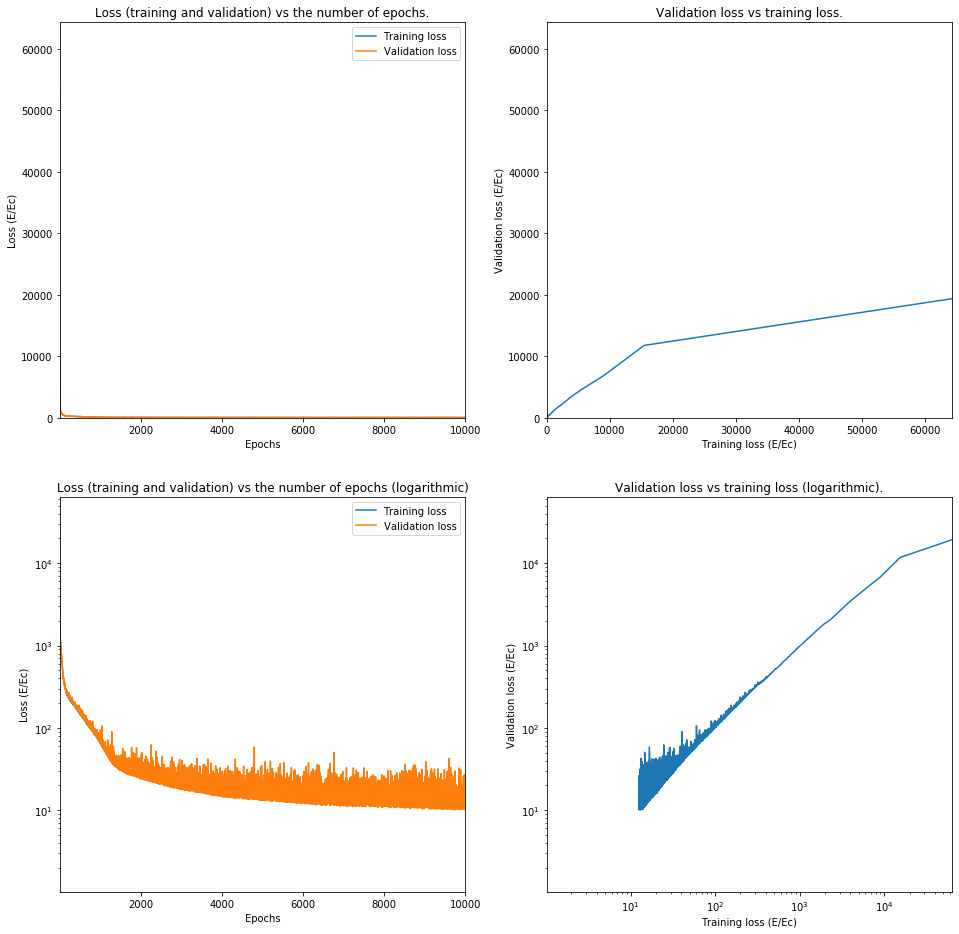

Train on 62644 samples, validate on 15662 samples
Epoch 1/10000
62644/62644 [==============================] - 2s 31us/step - loss: 38805.0419 - val_loss: 13981.0196
Epoch 2/10000
62644/62644 [==============================] - 2s 29us/step - loss: 11444.1677 - val_loss: 9694.1534
Epoch 3/10000
62644/62644 [==============================] - 2s 29us/step - loss: 8230.1319 - val_loss: 7407.6234
Epoch 4/10000
62644/62644 [==============================] - 2s 29us/step - loss: 6519.0667 - val_loss: 5947.9277
Epoch 5/10000
62644/62644 [==============================] - 2s 29us/step - loss: 5087.5935 - val_loss: 4534.7320
Epoch 6/10000
62644/62644 [==============================] - 2s 29us/step - loss: 3948.4356 - val_loss: 3684.5097
Epoch 7/10000
62644/62644 [==============================] - 2s 29us/step - loss: 3331.4823 - val_loss: 3194.1748
Epoch 8/10000
62644/62644 [==============================] - 2s 29us/step - loss: 2954.0047 - val_loss: 2878.1203
Epoch 9/10000
62644/62644 [========

62644/62644 [==============================] - 2s 29us/step - loss: 350.7447 - val_loss: 372.9215
Epoch 73/10000
62644/62644 [==============================] - 2s 29us/step - loss: 348.7116 - val_loss: 378.9289
Epoch 74/10000
62644/62644 [==============================] - 2s 29us/step - loss: 345.4136 - val_loss: 362.8383
Epoch 75/10000
62644/62644 [==============================] - 2s 29us/step - loss: 343.2136 - val_loss: 363.2832
Epoch 76/10000
62644/62644 [==============================] - 2s 29us/step - loss: 339.6574 - val_loss: 362.7968
Epoch 77/10000
62644/62644 [==============================] - 2s 29us/step - loss: 337.0541 - val_loss: 356.7022
Epoch 78/10000
62644/62644 [==============================] - 2s 29us/step - loss: 334.1010 - val_loss: 365.4261
Epoch 79/10000
62644/62644 [==============================] - 2s 29us/step - loss: 331.4418 - val_loss: 348.1206
Epoch 80/10000
62644/62644 [==============================] - 2s 29us/step - loss: 329.6986 - val_loss: 346.050

62644/62644 [==============================] - 2s 29us/step - loss: 223.1230 - val_loss: 247.0513
Epoch 145/10000
62644/62644 [==============================] - 2s 29us/step - loss: 222.2328 - val_loss: 233.2140
Epoch 146/10000
62644/62644 [==============================] - 2s 29us/step - loss: 221.3438 - val_loss: 231.6237
Epoch 147/10000
62644/62644 [==============================] - 2s 29us/step - loss: 220.3913 - val_loss: 230.7963
Epoch 148/10000
62644/62644 [==============================] - 2s 29us/step - loss: 218.7788 - val_loss: 234.5307
Epoch 149/10000
62644/62644 [==============================] - 2s 29us/step - loss: 219.0111 - val_loss: 230.4980
Epoch 150/10000
62644/62644 [==============================] - 2s 29us/step - loss: 217.7190 - val_loss: 229.7225
Epoch 151/10000
62644/62644 [==============================] - 2s 29us/step - loss: 217.6294 - val_loss: 230.2285
Epoch 152/10000
62644/62644 [==============================] - 2s 29us/step - loss: 216.2507 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 169.0572 - val_loss: 179.5826
Epoch 217/10000
62644/62644 [==============================] - 2s 29us/step - loss: 168.1934 - val_loss: 183.7201
Epoch 218/10000
62644/62644 [==============================] - 2s 29us/step - loss: 167.8361 - val_loss: 171.9524
Epoch 219/10000
62644/62644 [==============================] - 2s 29us/step - loss: 166.3081 - val_loss: 192.6511
Epoch 220/10000
62644/62644 [==============================] - 2s 29us/step - loss: 165.6620 - val_loss: 175.6510
Epoch 221/10000
62644/62644 [==============================] - 2s 29us/step - loss: 165.2518 - val_loss: 172.4567
Epoch 222/10000
62644/62644 [==============================] - 2s 29us/step - loss: 165.1813 - val_loss: 182.6256
Epoch 223/10000
62644/62644 [==============================] - 2s 29us/step - loss: 163.7481 - val_loss: 167.9091
Epoch 224/10000
62644/62644 [==============================] - 2s 29us/step - loss: 162.3864 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 131.2962 - val_loss: 136.4599
Epoch 289/10000
62644/62644 [==============================] - 2s 29us/step - loss: 130.9057 - val_loss: 142.0259
Epoch 290/10000
62644/62644 [==============================] - 2s 29us/step - loss: 130.7911 - val_loss: 134.3487
Epoch 291/10000
62644/62644 [==============================] - 2s 29us/step - loss: 130.4932 - val_loss: 140.3070
Epoch 292/10000
62644/62644 [==============================] - 2s 29us/step - loss: 130.1437 - val_loss: 136.8218
Epoch 293/10000
62644/62644 [==============================] - 2s 29us/step - loss: 129.9096 - val_loss: 137.3057
Epoch 294/10000
62644/62644 [==============================] - 2s 29us/step - loss: 129.6855 - val_loss: 133.6416
Epoch 295/10000
62644/62644 [==============================] - 2s 29us/step - loss: 129.1632 - val_loss: 132.3041
Epoch 296/10000
62644/62644 [==============================] - 2s 29us/step - loss: 128.2810 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 106.5027 - val_loss: 109.0702
Epoch 361/10000
62644/62644 [==============================] - 2s 29us/step - loss: 105.8807 - val_loss: 109.5057
Epoch 362/10000
62644/62644 [==============================] - 2s 29us/step - loss: 105.5739 - val_loss: 108.5879
Epoch 363/10000
62644/62644 [==============================] - 2s 29us/step - loss: 104.9817 - val_loss: 112.0261
Epoch 364/10000
62644/62644 [==============================] - 2s 29us/step - loss: 105.3722 - val_loss: 108.4683
Epoch 365/10000
62644/62644 [==============================] - 2s 29us/step - loss: 104.8895 - val_loss: 107.4486
Epoch 366/10000
62644/62644 [==============================] - 2s 29us/step - loss: 103.7912 - val_loss: 107.3589
Epoch 367/10000
62644/62644 [==============================] - 2s 29us/step - loss: 104.3942 - val_loss: 108.3465
Epoch 368/10000
62644/62644 [==============================] - 2s 29us/step - loss: 103.7805 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 88.3911 - val_loss: 96.0250
Epoch 433/10000
62644/62644 [==============================] - 2s 30us/step - loss: 87.6852 - val_loss: 93.9148
Epoch 434/10000
62644/62644 [==============================] - 2s 29us/step - loss: 87.6604 - val_loss: 90.7388
Epoch 435/10000
62644/62644 [==============================] - 2s 29us/step - loss: 87.0114 - val_loss: 90.1434
Epoch 436/10000
62644/62644 [==============================] - 2s 29us/step - loss: 87.4786 - val_loss: 91.7365
Epoch 437/10000
62644/62644 [==============================] - 2s 29us/step - loss: 87.1101 - val_loss: 89.2703
Epoch 438/10000
62644/62644 [==============================] - 2s 28us/step - loss: 86.6965 - val_loss: 90.7019
Epoch 439/10000
62644/62644 [==============================] - 2s 29us/step - loss: 86.6420 - val_loss: 104.8005
Epoch 440/10000
62644/62644 [==============================] - 2s 29us/step - loss: 86.1996 - val_loss: 91.8690
Epoch 4

62644/62644 [==============================] - 2s 29us/step - loss: 74.2591 - val_loss: 77.9503
Epoch 506/10000
62644/62644 [==============================] - 2s 29us/step - loss: 73.7545 - val_loss: 78.4966
Epoch 507/10000
62644/62644 [==============================] - 2s 29us/step - loss: 73.7522 - val_loss: 77.5749
Epoch 508/10000
62644/62644 [==============================] - 2s 29us/step - loss: 73.8545 - val_loss: 81.0102
Epoch 509/10000
62644/62644 [==============================] - 2s 29us/step - loss: 73.8279 - val_loss: 77.2920
Epoch 510/10000
62644/62644 [==============================] - 2s 29us/step - loss: 73.2985 - val_loss: 79.4458
Epoch 511/10000
62644/62644 [==============================] - 2s 29us/step - loss: 73.3793 - val_loss: 83.4722
Epoch 512/10000
62644/62644 [==============================] - 2s 29us/step - loss: 74.0463 - val_loss: 80.3255
Epoch 513/10000
62644/62644 [==============================] - 2s 29us/step - loss: 72.6688 - val_loss: 76.0524
Epoch 51

62644/62644 [==============================] - 2s 29us/step - loss: 63.9543 - val_loss: 71.1901
Epoch 579/10000
62644/62644 [==============================] - 2s 29us/step - loss: 64.4562 - val_loss: 66.6877
Epoch 580/10000
62644/62644 [==============================] - 2s 29us/step - loss: 64.0816 - val_loss: 72.7110
Epoch 581/10000
62644/62644 [==============================] - 2s 29us/step - loss: 64.0674 - val_loss: 75.4761
Epoch 582/10000
62644/62644 [==============================] - 2s 29us/step - loss: 63.6034 - val_loss: 69.7131
Epoch 583/10000
62644/62644 [==============================] - 2s 29us/step - loss: 63.9182 - val_loss: 66.6063
Epoch 584/10000
62644/62644 [==============================] - 2s 29us/step - loss: 63.7390 - val_loss: 68.0446
Epoch 585/10000
62644/62644 [==============================] - 2s 29us/step - loss: 63.1822 - val_loss: 71.7370
Epoch 586/10000
62644/62644 [==============================] - 2s 29us/step - loss: 63.2091 - val_loss: 66.5574
Epoch 58

62644/62644 [==============================] - 2s 29us/step - loss: 55.9186 - val_loss: 60.5429
Epoch 652/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.7661 - val_loss: 61.4368
Epoch 653/10000
62644/62644 [==============================] - 2s 29us/step - loss: 56.3247 - val_loss: 59.5185
Epoch 654/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.3508 - val_loss: 63.1937
Epoch 655/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.3138 - val_loss: 62.2997
Epoch 656/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.1295 - val_loss: 61.4048
Epoch 657/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.4178 - val_loss: 59.4323
Epoch 658/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.4678 - val_loss: 59.0969
Epoch 659/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.2616 - val_loss: 65.0782
Epoch 66

62644/62644 [==============================] - 2s 29us/step - loss: 50.4956 - val_loss: 54.6208
Epoch 725/10000
62644/62644 [==============================] - 2s 29us/step - loss: 50.3857 - val_loss: 56.4547
Epoch 726/10000
62644/62644 [==============================] - 2s 29us/step - loss: 50.6163 - val_loss: 53.5886
Epoch 727/10000
62644/62644 [==============================] - 2s 29us/step - loss: 50.0064 - val_loss: 61.0144
Epoch 728/10000
62644/62644 [==============================] - 2s 29us/step - loss: 49.6154 - val_loss: 73.8243
Epoch 729/10000
62644/62644 [==============================] - 2s 29us/step - loss: 50.0345 - val_loss: 54.3187
Epoch 730/10000
62644/62644 [==============================] - 2s 29us/step - loss: 49.6739 - val_loss: 68.7582
Epoch 731/10000
62644/62644 [==============================] - 2s 29us/step - loss: 50.2003 - val_loss: 53.2586
Epoch 732/10000
62644/62644 [==============================] - 2s 29us/step - loss: 49.4307 - val_loss: 53.5368
Epoch 73

62644/62644 [==============================] - 2s 29us/step - loss: 46.6374 - val_loss: 49.9370
Epoch 798/10000
62644/62644 [==============================] - 2s 29us/step - loss: 47.0950 - val_loss: 49.9046
Epoch 799/10000
62644/62644 [==============================] - 2s 29us/step - loss: 46.1710 - val_loss: 50.2803
Epoch 800/10000
62644/62644 [==============================] - 2s 29us/step - loss: 46.2366 - val_loss: 53.7566
Epoch 801/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.9911 - val_loss: 52.9239
Epoch 802/10000
62644/62644 [==============================] - 2s 29us/step - loss: 46.5612 - val_loss: 50.7978
Epoch 803/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.9947 - val_loss: 51.8160
Epoch 804/10000
62644/62644 [==============================] - 2s 29us/step - loss: 46.6111 - val_loss: 50.7293
Epoch 805/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.5641 - val_loss: 52.2963
Epoch 80

62644/62644 [==============================] - 2s 29us/step - loss: 43.1654 - val_loss: 47.6311
Epoch 871/10000
62644/62644 [==============================] - 2s 29us/step - loss: 43.7111 - val_loss: 47.0090
Epoch 872/10000
62644/62644 [==============================] - 2s 29us/step - loss: 43.6861 - val_loss: 46.7729
Epoch 873/10000
62644/62644 [==============================] - 2s 29us/step - loss: 43.2199 - val_loss: 46.9391
Epoch 874/10000
62644/62644 [==============================] - 2s 29us/step - loss: 43.9256 - val_loss: 47.3524
Epoch 875/10000
62644/62644 [==============================] - 2s 29us/step - loss: 43.3102 - val_loss: 53.6639
Epoch 876/10000
62644/62644 [==============================] - 2s 29us/step - loss: 43.3092 - val_loss: 48.0671
Epoch 877/10000
62644/62644 [==============================] - 2s 29us/step - loss: 42.9400 - val_loss: 53.6817
Epoch 878/10000
62644/62644 [==============================] - 2s 29us/step - loss: 43.2002 - val_loss: 47.2581
Epoch 87

62644/62644 [==============================] - 2s 29us/step - loss: 41.2456 - val_loss: 53.5752
Epoch 944/10000
62644/62644 [==============================] - 2s 29us/step - loss: 42.1029 - val_loss: 43.9455
Epoch 945/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.5908 - val_loss: 44.5887
Epoch 946/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.0978 - val_loss: 45.0908
Epoch 947/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.0612 - val_loss: 44.7065
Epoch 948/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.2992 - val_loss: 59.5358
Epoch 949/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.2777 - val_loss: 48.6608
Epoch 950/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.1459 - val_loss: 45.9393
Epoch 951/10000
62644/62644 [==============================] - 2s 29us/step - loss: 40.9448 - val_loss: 44.0859
Epoch 95

62644/62644 [==============================] - 2s 29us/step - loss: 39.4301 - val_loss: 42.3884
Epoch 1017/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.2811 - val_loss: 41.6624
Epoch 1018/10000
62644/62644 [==============================] - 2s 29us/step - loss: 40.3145 - val_loss: 45.3853
Epoch 1019/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.6293 - val_loss: 44.3902
Epoch 1020/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.3837 - val_loss: 42.5304
Epoch 1021/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.4657 - val_loss: 57.3878
Epoch 1022/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.1202 - val_loss: 46.2037
Epoch 1023/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.0582 - val_loss: 49.4179
Epoch 1024/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.3810 - val_loss: 42.6386


62644/62644 [==============================] - 2s 29us/step - loss: 37.9807 - val_loss: 42.6433
Epoch 1089/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.5753 - val_loss: 42.1451
Epoch 1090/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.2220 - val_loss: 39.3877
Epoch 1091/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.5835 - val_loss: 39.2356
Epoch 1092/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.2343 - val_loss: 40.1113
Epoch 1093/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.5515 - val_loss: 40.0568
Epoch 1094/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.1732 - val_loss: 43.5208
Epoch 1095/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.8617 - val_loss: 39.9156
Epoch 1096/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.1808 - val_loss: 40.7018


62644/62644 [==============================] - 2s 29us/step - loss: 36.2191 - val_loss: 40.4631
Epoch 1161/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.6168 - val_loss: 40.2572
Epoch 1162/10000
62644/62644 [==============================] - 2s 30us/step - loss: 36.0773 - val_loss: 39.6194
Epoch 1163/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.9388 - val_loss: 38.3327
Epoch 1164/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.8057 - val_loss: 37.9033
Epoch 1165/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.1904 - val_loss: 39.1189
Epoch 1166/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.8763 - val_loss: 38.3715
Epoch 1167/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.3940 - val_loss: 38.7519
Epoch 1168/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.7565 - val_loss: 38.1462


62644/62644 [==============================] - 2s 29us/step - loss: 34.8860 - val_loss: 36.9310
Epoch 1233/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.2485 - val_loss: 37.2112
Epoch 1234/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.7338 - val_loss: 50.3960
Epoch 1235/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.1092 - val_loss: 36.7640
Epoch 1236/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.7861 - val_loss: 47.4592
Epoch 1237/10000
62644/62644 [==============================] - 2s 28us/step - loss: 34.5503 - val_loss: 42.9507
Epoch 1238/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.5994 - val_loss: 56.4988
Epoch 1239/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.5074 - val_loss: 48.8345
Epoch 1240/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.8085 - val_loss: 36.5654


62644/62644 [==============================] - 2s 29us/step - loss: 33.0672 - val_loss: 35.8610
Epoch 1305/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.8592 - val_loss: 51.8211
Epoch 1306/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.8968 - val_loss: 34.7898
Epoch 1307/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.5193 - val_loss: 40.6898
Epoch 1308/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.1806 - val_loss: 42.9595
Epoch 1309/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.3491 - val_loss: 37.7164
Epoch 1310/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.5789 - val_loss: 44.5881
Epoch 1311/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.2903 - val_loss: 35.6807
Epoch 1312/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.4307 - val_loss: 36.1219


62644/62644 [==============================] - 2s 29us/step - loss: 32.6655 - val_loss: 34.9432
Epoch 1377/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.4533 - val_loss: 33.9382
Epoch 1378/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.4307 - val_loss: 33.8121
Epoch 1379/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.5627 - val_loss: 45.8929
Epoch 1380/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.1914 - val_loss: 36.4977
Epoch 1381/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.2117 - val_loss: 33.9991
Epoch 1382/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.9877 - val_loss: 37.1121
Epoch 1383/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.2286 - val_loss: 34.3000
Epoch 1384/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.4074 - val_loss: 33.9013


62644/62644 [==============================] - 2s 29us/step - loss: 30.7901 - val_loss: 32.6518
Epoch 1449/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.8510 - val_loss: 33.0553
Epoch 1450/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.5293 - val_loss: 33.5270
Epoch 1451/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.9510 - val_loss: 32.7729
Epoch 1452/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.6825 - val_loss: 32.5930
Epoch 1453/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.9675 - val_loss: 32.9362
Epoch 1454/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.3919 - val_loss: 32.8185
Epoch 1455/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.4040 - val_loss: 36.1720
Epoch 1456/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.3104 - val_loss: 35.4454


62644/62644 [==============================] - 2s 29us/step - loss: 30.1166 - val_loss: 31.1163
Epoch 1521/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.0707 - val_loss: 31.7255
Epoch 1522/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.9170 - val_loss: 32.1134
Epoch 1523/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.4710 - val_loss: 33.3204
Epoch 1524/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.3145 - val_loss: 34.0603
Epoch 1525/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.2375 - val_loss: 32.0675
Epoch 1526/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.3730 - val_loss: 31.2202
Epoch 1527/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.2844 - val_loss: 38.5469
Epoch 1528/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.6908 - val_loss: 31.3991


62644/62644 [==============================] - 2s 31us/step - loss: 29.1901 - val_loss: 36.0348
Epoch 1593/10000
62644/62644 [==============================] - 2s 33us/step - loss: 29.5340 - val_loss: 30.4014
Epoch 1594/10000
62644/62644 [==============================] - 2s 39us/step - loss: 29.4532 - val_loss: 31.0228
Epoch 1595/10000
62644/62644 [==============================] - 2s 30us/step - loss: 29.2902 - val_loss: 31.9529
Epoch 1596/10000
62644/62644 [==============================] - 2s 30us/step - loss: 29.0255 - val_loss: 32.0888
Epoch 1597/10000
62644/62644 [==============================] - 2s 31us/step - loss: 29.3099 - val_loss: 31.5895
Epoch 1598/10000
62644/62644 [==============================] - 2s 31us/step - loss: 29.2806 - val_loss: 32.7474
Epoch 1599/10000
62644/62644 [==============================] - 2s 32us/step - loss: 29.3351 - val_loss: 30.4502
Epoch 1600/10000
62644/62644 [==============================] - 2s 31us/step - loss: 29.1845 - val_loss: 30.1386


62644/62644 [==============================] - 2s 33us/step - loss: 29.0201 - val_loss: 31.0168
Epoch 1665/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.3422 - val_loss: 30.5319
Epoch 1666/10000
62644/62644 [==============================] - 2s 35us/step - loss: 28.7320 - val_loss: 35.2796
Epoch 1667/10000
62644/62644 [==============================] - 2s 34us/step - loss: 28.9575 - val_loss: 29.9676
Epoch 1668/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.4795 - val_loss: 31.7972
Epoch 1669/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.5400 - val_loss: 32.1164
Epoch 1670/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.6797 - val_loss: 29.0526
Epoch 1671/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.1869 - val_loss: 29.7823
Epoch 1672/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.6151 - val_loss: 30.2057


62644/62644 [==============================] - 2s 33us/step - loss: 28.0259 - val_loss: 28.5958
Epoch 1737/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.8224 - val_loss: 35.5317
Epoch 1738/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.1386 - val_loss: 29.2329
Epoch 1739/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.8588 - val_loss: 29.1933
Epoch 1740/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.6418 - val_loss: 28.7539
Epoch 1741/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.0215 - val_loss: 33.0774
Epoch 1742/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.6012 - val_loss: 29.7765
Epoch 1743/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.0121 - val_loss: 45.8935
Epoch 1744/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.6235 - val_loss: 28.9565


62644/62644 [==============================] - 2s 33us/step - loss: 27.0107 - val_loss: 30.7534
Epoch 1809/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.7496 - val_loss: 28.7318
Epoch 1810/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.0436 - val_loss: 32.7126
Epoch 1811/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.1189 - val_loss: 28.4970
Epoch 1812/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.9171 - val_loss: 28.8821
Epoch 1813/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.9166 - val_loss: 29.7705
Epoch 1814/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.9669 - val_loss: 29.1689
Epoch 1815/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.0885 - val_loss: 26.9020
Epoch 1816/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.0519 - val_loss: 26.9769


62644/62644 [==============================] - 2s 33us/step - loss: 26.5210 - val_loss: 28.5065
Epoch 1881/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.5420 - val_loss: 29.8401
Epoch 1882/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.2164 - val_loss: 28.1555
Epoch 1883/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.8305 - val_loss: 45.0574
Epoch 1884/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.2862 - val_loss: 29.7660
Epoch 1885/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.6209 - val_loss: 30.0566
Epoch 1886/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.2793 - val_loss: 28.2975
Epoch 1887/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.2877 - val_loss: 27.1855
Epoch 1888/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.2546 - val_loss: 27.7861


62644/62644 [==============================] - 2s 34us/step - loss: 26.0387 - val_loss: 34.2035
Epoch 1953/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.1625 - val_loss: 38.3239
Epoch 1954/10000
62644/62644 [==============================] - 2s 34us/step - loss: 25.9467 - val_loss: 32.2068
Epoch 1955/10000
62644/62644 [==============================] - 2s 34us/step - loss: 26.3022 - val_loss: 25.5834
Epoch 1956/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.4683 - val_loss: 27.7247
Epoch 1957/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.1344 - val_loss: 33.0229
Epoch 1958/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.1662 - val_loss: 25.4020
Epoch 1959/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.7776 - val_loss: 25.5248
Epoch 1960/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.5580 - val_loss: 30.2077


62644/62644 [==============================] - 2s 34us/step - loss: 25.1624 - val_loss: 33.8600
Epoch 2025/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.4419 - val_loss: 32.8285
Epoch 2026/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.3040 - val_loss: 30.7687
Epoch 2027/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.3252 - val_loss: 26.5251
Epoch 2028/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.1260 - val_loss: 26.7091
Epoch 2029/10000
62644/62644 [==============================] - 2s 34us/step - loss: 25.3211 - val_loss: 27.0689
Epoch 2030/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.0709 - val_loss: 34.5810
Epoch 2031/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.1062 - val_loss: 24.8182
Epoch 2032/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.5741 - val_loss: 35.0827


62644/62644 [==============================] - 2s 34us/step - loss: 24.8683 - val_loss: 25.7406
Epoch 2097/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.2602 - val_loss: 26.6729
Epoch 2098/10000
62644/62644 [==============================] - 2s 33us/step - loss: 24.6292 - val_loss: 25.8396
Epoch 2099/10000
62644/62644 [==============================] - 2s 33us/step - loss: 24.8718 - val_loss: 31.3735
Epoch 2100/10000
62644/62644 [==============================] - 2s 33us/step - loss: 24.5453 - val_loss: 24.5122
Epoch 2101/10000
62644/62644 [==============================] - 2s 33us/step - loss: 24.9129 - val_loss: 30.3549
Epoch 2102/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.0135 - val_loss: 24.9991
Epoch 2103/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.2156 - val_loss: 28.0679
Epoch 2104/10000
62644/62644 [==============================] - 2s 33us/step - loss: 24.6161 - val_loss: 26.9633


62644/62644 [==============================] - 2s 33us/step - loss: 23.9737 - val_loss: 28.6271
Epoch 2169/10000
62644/62644 [==============================] - 2s 37us/step - loss: 24.2894 - val_loss: 23.9054
Epoch 2170/10000
62644/62644 [==============================] - 2s 33us/step - loss: 24.2874 - val_loss: 23.5713
Epoch 2171/10000
62644/62644 [==============================] - 2s 33us/step - loss: 24.4401 - val_loss: 24.8685
Epoch 2172/10000
62644/62644 [==============================] - 2s 33us/step - loss: 24.1451 - val_loss: 25.9714
Epoch 2173/10000
62644/62644 [==============================] - 2s 34us/step - loss: 24.1784 - val_loss: 23.9912
Epoch 2174/10000
62644/62644 [==============================] - 2s 33us/step - loss: 24.4325 - val_loss: 25.0773
Epoch 2175/10000
62644/62644 [==============================] - 2s 34us/step - loss: 24.6191 - val_loss: 24.3719
Epoch 2176/10000
62644/62644 [==============================] - 2s 34us/step - loss: 24.3721 - val_loss: 27.6446


62644/62644 [==============================] - 2s 34us/step - loss: 23.6710 - val_loss: 23.6435
Epoch 2241/10000
62644/62644 [==============================] - 2s 34us/step - loss: 23.5667 - val_loss: 23.5820
Epoch 2242/10000
62644/62644 [==============================] - 2s 34us/step - loss: 23.9572 - val_loss: 25.4993
Epoch 2243/10000
62644/62644 [==============================] - 2s 33us/step - loss: 23.5265 - val_loss: 24.2668
Epoch 2244/10000
62644/62644 [==============================] - 2s 33us/step - loss: 23.6282 - val_loss: 26.3608
Epoch 2245/10000
62644/62644 [==============================] - 2s 33us/step - loss: 23.5077 - val_loss: 23.4446
Epoch 2246/10000
62644/62644 [==============================] - 2s 34us/step - loss: 24.3375 - val_loss: 25.0234
Epoch 2247/10000
62644/62644 [==============================] - 2s 35us/step - loss: 24.5405 - val_loss: 22.9001
Epoch 2248/10000
62644/62644 [==============================] - 2s 35us/step - loss: 23.8092 - val_loss: 24.9164


62644/62644 [==============================] - 2s 34us/step - loss: 23.4583 - val_loss: 22.5419
Epoch 2313/10000
62644/62644 [==============================] - 2s 35us/step - loss: 23.2649 - val_loss: 22.7866
Epoch 2314/10000
62644/62644 [==============================] - 2s 35us/step - loss: 23.1537 - val_loss: 30.5466
Epoch 2315/10000
62644/62644 [==============================] - 2s 34us/step - loss: 23.7589 - val_loss: 22.3556
Epoch 2316/10000
62644/62644 [==============================] - 2s 35us/step - loss: 23.3260 - val_loss: 29.2245
Epoch 2317/10000
62644/62644 [==============================] - 2s 35us/step - loss: 23.2749 - val_loss: 25.2763
Epoch 2318/10000
62644/62644 [==============================] - 2s 34us/step - loss: 23.1867 - val_loss: 27.1137
Epoch 2319/10000
62644/62644 [==============================] - 2s 33us/step - loss: 23.6907 - val_loss: 27.1643
Epoch 2320/10000
62644/62644 [==============================] - 2s 34us/step - loss: 23.3649 - val_loss: 26.7585


62644/62644 [==============================] - 2s 32us/step - loss: 23.1405 - val_loss: 28.5669
Epoch 2385/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.8166 - val_loss: 23.8902
Epoch 2386/10000
62644/62644 [==============================] - 2s 35us/step - loss: 22.9951 - val_loss: 25.2257
Epoch 2387/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.6769 - val_loss: 23.4211
Epoch 2388/10000
62644/62644 [==============================] - 2s 31us/step - loss: 23.0000 - val_loss: 22.3801
Epoch 2389/10000
62644/62644 [==============================] - 2s 31us/step - loss: 23.2913 - val_loss: 24.3993
Epoch 2390/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.5915 - val_loss: 22.8231
Epoch 2391/10000
62644/62644 [==============================] - 2s 34us/step - loss: 23.1671 - val_loss: 22.5299
Epoch 2392/10000
62644/62644 [==============================] - 2s 34us/step - loss: 23.0727 - val_loss: 31.5621


62644/62644 [==============================] - 2s 31us/step - loss: 22.6438 - val_loss: 30.6748
Epoch 2457/10000
62644/62644 [==============================] - 2s 32us/step - loss: 23.3892 - val_loss: 28.8786
Epoch 2458/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.7605 - val_loss: 24.1915
Epoch 2459/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.8577 - val_loss: 26.1097
Epoch 2460/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.9457 - val_loss: 25.1213
Epoch 2461/10000
62644/62644 [==============================] - 2s 32us/step - loss: 23.1519 - val_loss: 22.4859
Epoch 2462/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.7302 - val_loss: 21.9630
Epoch 2463/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.3698 - val_loss: 23.8571
Epoch 2464/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.4194 - val_loss: 24.8626


62644/62644 [==============================] - 2s 32us/step - loss: 22.5162 - val_loss: 24.9362
Epoch 2529/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.4207 - val_loss: 26.4969
Epoch 2530/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.2264 - val_loss: 21.8466
Epoch 2531/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.9536 - val_loss: 27.0293
Epoch 2532/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.2604 - val_loss: 22.3212
Epoch 2533/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.3545 - val_loss: 24.7658
Epoch 2534/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.8785 - val_loss: 23.0906
Epoch 2535/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.4922 - val_loss: 23.3516
Epoch 2536/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.4182 - val_loss: 24.6766


62644/62644 [==============================] - 2s 34us/step - loss: 22.2153 - val_loss: 24.3770
Epoch 2601/10000
62644/62644 [==============================] - 2s 33us/step - loss: 22.2248 - val_loss: 22.1803
Epoch 2602/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.9787 - val_loss: 30.4654
Epoch 2603/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.9452 - val_loss: 21.6731
Epoch 2604/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.2214 - val_loss: 29.2934
Epoch 2605/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.2133 - val_loss: 22.4048
Epoch 2606/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.0194 - val_loss: 21.7025
Epoch 2607/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.7428 - val_loss: 35.1291
Epoch 2608/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.7480 - val_loss: 27.2970


62644/62644 [==============================] - 2s 31us/step - loss: 21.4305 - val_loss: 24.0637
Epoch 2673/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.0210 - val_loss: 26.2728
Epoch 2674/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.3541 - val_loss: 22.7189
Epoch 2675/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.4380 - val_loss: 23.8136
Epoch 2676/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.5653 - val_loss: 21.2126
Epoch 2677/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.0982 - val_loss: 21.8289
Epoch 2678/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.3638 - val_loss: 22.8860
Epoch 2679/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.2097 - val_loss: 21.5755
Epoch 2680/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.2921 - val_loss: 22.4283


62644/62644 [==============================] - 2s 31us/step - loss: 21.5146 - val_loss: 26.0599
Epoch 2745/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.4695 - val_loss: 21.8767
Epoch 2746/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.3309 - val_loss: 41.7560
Epoch 2747/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.7715 - val_loss: 22.6585
Epoch 2748/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.1312 - val_loss: 30.4132
Epoch 2749/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.2833 - val_loss: 20.2960
Epoch 2750/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.2306 - val_loss: 22.0833
Epoch 2751/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.4001 - val_loss: 20.3852
Epoch 2752/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.9863 - val_loss: 20.4306


62644/62644 [==============================] - 2s 31us/step - loss: 21.0995 - val_loss: 25.0079
Epoch 2817/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.7197 - val_loss: 21.2489
Epoch 2818/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.9347 - val_loss: 20.4671
Epoch 2819/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.2044 - val_loss: 29.3775
Epoch 2820/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.2025 - val_loss: 19.7826
Epoch 2821/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.1366 - val_loss: 21.2841
Epoch 2822/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.2079 - val_loss: 21.9815
Epoch 2823/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.3271 - val_loss: 21.9389
Epoch 2824/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.7797 - val_loss: 24.6246


62644/62644 [==============================] - 2s 31us/step - loss: 21.0671 - val_loss: 22.4064
Epoch 2889/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.7009 - val_loss: 22.5729
Epoch 2890/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6462 - val_loss: 19.9563
Epoch 2891/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.7089 - val_loss: 19.7389
Epoch 2892/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.6024 - val_loss: 32.6443
Epoch 2893/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.8712 - val_loss: 20.7728
Epoch 2894/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.6295 - val_loss: 20.3213
Epoch 2895/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.8144 - val_loss: 39.8478
Epoch 2896/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.6455 - val_loss: 21.2307


62644/62644 [==============================] - 2s 30us/step - loss: 20.7692 - val_loss: 28.0576
Epoch 2961/10000
62644/62644 [==============================] - 2s 30us/step - loss: 21.0869 - val_loss: 22.6376
Epoch 2962/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6182 - val_loss: 25.1740
Epoch 2963/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.5057 - val_loss: 19.5848
Epoch 2964/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.2033 - val_loss: 22.0704
Epoch 2965/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.1653 - val_loss: 19.5997
Epoch 2966/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6387 - val_loss: 26.4301
Epoch 2967/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.2779 - val_loss: 20.0585
Epoch 2968/10000
62644/62644 [==============================] - 2s 30us/step - loss: 21.0321 - val_loss: 33.0967


62644/62644 [==============================] - 2s 30us/step - loss: 20.2309 - val_loss: 21.7195
Epoch 3033/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.8978 - val_loss: 20.8827
Epoch 3034/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.1574 - val_loss: 23.8898
Epoch 3035/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.1273 - val_loss: 19.5910
Epoch 3036/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.4713 - val_loss: 19.5686
Epoch 3037/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.3125 - val_loss: 19.6086
Epoch 3038/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.6476 - val_loss: 21.2738
Epoch 3039/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.0186 - val_loss: 19.1985
Epoch 3040/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.8051 - val_loss: 23.1467


62644/62644 [==============================] - 2s 31us/step - loss: 20.1774 - val_loss: 19.6266
Epoch 3105/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.9154 - val_loss: 21.6690
Epoch 3106/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.3175 - val_loss: 19.6367
Epoch 3107/10000
62644/62644 [==============================] - 2s 34us/step - loss: 20.1361 - val_loss: 22.6521
Epoch 3108/10000
62644/62644 [==============================] - 2s 36us/step - loss: 20.3133 - val_loss: 28.5708
Epoch 3109/10000
62644/62644 [==============================] - 2s 37us/step - loss: 20.0436 - val_loss: 23.8665
Epoch 3110/10000
62644/62644 [==============================] - 2s 33us/step - loss: 20.1359 - val_loss: 19.4532
Epoch 3111/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.8032 - val_loss: 20.4968
Epoch 3112/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.1697 - val_loss: 21.1396


62644/62644 [==============================] - 2s 37us/step - loss: 19.8445 - val_loss: 19.9281
Epoch 3177/10000
62644/62644 [==============================] - 2s 34us/step - loss: 19.5848 - val_loss: 19.9318
Epoch 3178/10000
62644/62644 [==============================] - 3s 46us/step - loss: 20.1347 - val_loss: 20.0705
Epoch 3179/10000
62644/62644 [==============================] - 2s 36us/step - loss: 19.6898 - val_loss: 21.7092
Epoch 3180/10000
62644/62644 [==============================] - 2s 33us/step - loss: 19.5352 - val_loss: 19.8222
Epoch 3181/10000
62644/62644 [==============================] - 2s 36us/step - loss: 20.1175 - val_loss: 19.3539
Epoch 3182/10000
62644/62644 [==============================] - 2s 34us/step - loss: 19.9247 - val_loss: 22.3481
Epoch 3183/10000
62644/62644 [==============================] - 2s 34us/step - loss: 19.6222 - val_loss: 21.3942
Epoch 3184/10000
62644/62644 [==============================] - 2s 33us/step - loss: 19.7434 - val_loss: 22.1402


62644/62644 [==============================] - 2s 31us/step - loss: 19.5859 - val_loss: 20.8841
Epoch 3249/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.4828 - val_loss: 27.8449
Epoch 3250/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.6133 - val_loss: 19.3794
Epoch 3251/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.3934 - val_loss: 32.4098
Epoch 3252/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.4960 - val_loss: 19.8499
Epoch 3253/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.2311 - val_loss: 30.2211
Epoch 3254/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.8000 - val_loss: 22.9813
Epoch 3255/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.9129 - val_loss: 20.2977
Epoch 3256/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.7286 - val_loss: 23.4196


62644/62644 [==============================] - 2s 36us/step - loss: 19.6230 - val_loss: 18.2010
Epoch 3321/10000
62644/62644 [==============================] - 2s 38us/step - loss: 19.0971 - val_loss: 21.0723
Epoch 3322/10000
62644/62644 [==============================] - 2s 36us/step - loss: 19.5984 - val_loss: 20.3095
Epoch 3323/10000
62644/62644 [==============================] - 2s 34us/step - loss: 19.8506 - val_loss: 21.6018
Epoch 3324/10000
62644/62644 [==============================] - 2s 35us/step - loss: 19.6065 - val_loss: 19.0503
Epoch 3325/10000
62644/62644 [==============================] - 3s 40us/step - loss: 19.2407 - val_loss: 23.7121
Epoch 3326/10000
62644/62644 [==============================] - 2s 36us/step - loss: 19.9491 - val_loss: 26.7699
Epoch 3327/10000
62644/62644 [==============================] - 2s 35us/step - loss: 18.8592 - val_loss: 20.7355
Epoch 3328/10000
62644/62644 [==============================] - 2s 34us/step - loss: 19.3987 - val_loss: 23.7682


62644/62644 [==============================] - 2s 33us/step - loss: 19.3513 - val_loss: 19.9586
Epoch 3393/10000
62644/62644 [==============================] - 2s 33us/step - loss: 19.5526 - val_loss: 19.5618
Epoch 3394/10000
62644/62644 [==============================] - 2s 34us/step - loss: 19.2240 - val_loss: 24.3010
Epoch 3395/10000
62644/62644 [==============================] - 2s 35us/step - loss: 18.9823 - val_loss: 19.5839
Epoch 3396/10000
62644/62644 [==============================] - 2s 35us/step - loss: 19.2432 - val_loss: 22.3272
Epoch 3397/10000
62644/62644 [==============================] - 2s 35us/step - loss: 19.1254 - val_loss: 27.4252
Epoch 3398/10000
62644/62644 [==============================] - 2s 34us/step - loss: 19.1957 - val_loss: 20.9882
Epoch 3399/10000
62644/62644 [==============================] - 3s 41us/step - loss: 19.4178 - val_loss: 31.5038
Epoch 3400/10000
62644/62644 [==============================] - 3s 46us/step - loss: 19.5462 - val_loss: 23.0036


62644/62644 [==============================] - 2s 33us/step - loss: 18.8239 - val_loss: 18.6976
Epoch 3465/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.9199 - val_loss: 19.2253
Epoch 3466/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.5898 - val_loss: 20.1551
Epoch 3467/10000
62644/62644 [==============================] - 2s 34us/step - loss: 18.8214 - val_loss: 18.8066
Epoch 3468/10000
62644/62644 [==============================] - 2s 34us/step - loss: 18.7270 - val_loss: 25.4036
Epoch 3469/10000
62644/62644 [==============================] - 2s 36us/step - loss: 19.4137 - val_loss: 21.3445
Epoch 3470/10000
62644/62644 [==============================] - 2s 35us/step - loss: 19.1112 - val_loss: 20.7223
Epoch 3471/10000
62644/62644 [==============================] - 2s 37us/step - loss: 19.1145 - val_loss: 21.6324
Epoch 3472/10000
62644/62644 [==============================] - 2s 33us/step - loss: 18.6805 - val_loss: 18.7153


62644/62644 [==============================] - 2s 32us/step - loss: 18.9636 - val_loss: 18.8574
Epoch 3537/10000
62644/62644 [==============================] - 2s 33us/step - loss: 18.5507 - val_loss: 18.4180
Epoch 3538/10000
62644/62644 [==============================] - 2s 34us/step - loss: 19.0048 - val_loss: 18.4961
Epoch 3539/10000
62644/62644 [==============================] - 2s 37us/step - loss: 19.0140 - val_loss: 24.1331
Epoch 3540/10000
62644/62644 [==============================] - 2s 33us/step - loss: 18.5750 - val_loss: 20.5614
Epoch 3541/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.6799 - val_loss: 29.1046
Epoch 3542/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.8100 - val_loss: 19.0673
Epoch 3543/10000
62644/62644 [==============================] - 2s 34us/step - loss: 18.5427 - val_loss: 18.6162
Epoch 3544/10000
62644/62644 [==============================] - 2s 37us/step - loss: 18.6548 - val_loss: 18.5951


62644/62644 [==============================] - 2s 35us/step - loss: 18.9970 - val_loss: 18.0721
Epoch 3609/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.2888 - val_loss: 19.8757
Epoch 3610/10000
62644/62644 [==============================] - 2s 34us/step - loss: 18.6219 - val_loss: 25.5604
Epoch 3611/10000
62644/62644 [==============================] - 2s 33us/step - loss: 18.3549 - val_loss: 17.7516
Epoch 3612/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.4624 - val_loss: 19.3870
Epoch 3613/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.7371 - val_loss: 25.1254
Epoch 3614/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.9482 - val_loss: 18.9395
Epoch 3615/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.7644 - val_loss: 18.2459
Epoch 3616/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.1483 - val_loss: 20.5980


62644/62644 [==============================] - 2s 32us/step - loss: 18.7512 - val_loss: 27.6834
Epoch 3681/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.1855 - val_loss: 20.8186
Epoch 3682/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.6339 - val_loss: 22.8612
Epoch 3683/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.9642 - val_loss: 17.5464
Epoch 3684/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.4932 - val_loss: 21.1792
Epoch 3685/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.4360 - val_loss: 32.1350
Epoch 3686/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.6950 - val_loss: 17.7300
Epoch 3687/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.4212 - val_loss: 17.9168
Epoch 3688/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.2702 - val_loss: 20.4306


62644/62644 [==============================] - 2s 32us/step - loss: 18.2533 - val_loss: 24.9453
Epoch 3753/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.5320 - val_loss: 22.7642
Epoch 3754/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.2599 - val_loss: 17.6653
Epoch 3755/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.2157 - val_loss: 19.0853
Epoch 3756/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.3974 - val_loss: 18.0640
Epoch 3757/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.0118 - val_loss: 20.0205
Epoch 3758/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.7647 - val_loss: 17.4579
Epoch 3759/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.2016 - val_loss: 22.7927
Epoch 3760/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.1488 - val_loss: 17.7585


62644/62644 [==============================] - 2s 32us/step - loss: 17.9546 - val_loss: 17.2336
Epoch 3825/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.0349 - val_loss: 25.5037
Epoch 3826/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.7232 - val_loss: 20.2126
Epoch 3827/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.7890 - val_loss: 39.2231
Epoch 3828/10000
62644/62644 [==============================] - 2s 34us/step - loss: 17.9968 - val_loss: 17.3433
Epoch 3829/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.1161 - val_loss: 31.2989
Epoch 3830/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.9761 - val_loss: 17.9014
Epoch 3831/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.0285 - val_loss: 19.0803
Epoch 3832/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.0026 - val_loss: 20.4184


62644/62644 [==============================] - 2s 36us/step - loss: 17.6232 - val_loss: 19.0760
Epoch 3897/10000
62644/62644 [==============================] - 2s 33us/step - loss: 18.1137 - val_loss: 20.3680
Epoch 3898/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.2829 - val_loss: 21.7197
Epoch 3899/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.7629 - val_loss: 20.0024
Epoch 3900/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.3256 - val_loss: 18.1743
Epoch 3901/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.0152 - val_loss: 18.5784
Epoch 3902/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.0383 - val_loss: 18.5904
Epoch 3903/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.6436 - val_loss: 26.3694
Epoch 3904/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.0107 - val_loss: 20.0637


62644/62644 [==============================] - 2s 35us/step - loss: 17.8700 - val_loss: 19.8237
Epoch 3969/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.3887 - val_loss: 19.4072
Epoch 3970/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.6956 - val_loss: 24.5647
Epoch 3971/10000
62644/62644 [==============================] - 2s 34us/step - loss: 17.6321 - val_loss: 21.9428
Epoch 3972/10000
62644/62644 [==============================] - 2s 33us/step - loss: 17.8004 - val_loss: 17.3212
Epoch 3973/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.2554 - val_loss: 17.5289
Epoch 3974/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.0601 - val_loss: 20.5305
Epoch 3975/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.6382 - val_loss: 34.5447
Epoch 3976/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.6197 - val_loss: 19.1713


62644/62644 [==============================] - 2s 31us/step - loss: 17.5373 - val_loss: 23.6131
Epoch 4041/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4744 - val_loss: 17.4423
Epoch 4042/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.8639 - val_loss: 19.4389
Epoch 4043/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.5397 - val_loss: 18.9499
Epoch 4044/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.3920 - val_loss: 22.0728
Epoch 4045/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.5988 - val_loss: 26.5039
Epoch 4046/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4763 - val_loss: 20.8929
Epoch 4047/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.5099 - val_loss: 17.1386
Epoch 4048/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.5901 - val_loss: 18.1899


62644/62644 [==============================] - 2s 31us/step - loss: 17.4663 - val_loss: 18.4504
Epoch 4113/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.2034 - val_loss: 16.7408
Epoch 4114/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.6489 - val_loss: 18.8705
Epoch 4115/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.1783 - val_loss: 17.9417
Epoch 4116/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.3800 - val_loss: 17.1783
Epoch 4117/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.1227 - val_loss: 17.8210
Epoch 4118/10000
62644/62644 [==============================] - 2s 33us/step - loss: 17.4251 - val_loss: 18.8323
Epoch 4119/10000
62644/62644 [==============================] - 2s 35us/step - loss: 17.7928 - val_loss: 17.3076
Epoch 4120/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.3808 - val_loss: 17.9599


62644/62644 [==============================] - 2s 31us/step - loss: 17.6757 - val_loss: 17.7104
Epoch 4185/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.3761 - val_loss: 16.4994
Epoch 4186/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.9441 - val_loss: 17.3018
Epoch 4187/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.6076 - val_loss: 17.9015
Epoch 4188/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.1754 - val_loss: 18.4914
Epoch 4189/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4072 - val_loss: 17.9262
Epoch 4190/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.0567 - val_loss: 17.1352
Epoch 4191/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.9198 - val_loss: 17.7085
Epoch 4192/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4547 - val_loss: 17.4016


62644/62644 [==============================] - 2s 31us/step - loss: 17.2690 - val_loss: 20.4612
Epoch 4257/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0094 - val_loss: 17.7967
Epoch 4258/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.2166 - val_loss: 17.2342
Epoch 4259/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0068 - val_loss: 20.5590
Epoch 4260/10000
62644/62644 [==============================] - 2s 33us/step - loss: 16.8458 - val_loss: 20.0637
Epoch 4261/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.2713 - val_loss: 18.6312
Epoch 4262/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.9342 - val_loss: 31.9168
Epoch 4263/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.3284 - val_loss: 18.1902
Epoch 4264/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.5191 - val_loss: 21.5704


62644/62644 [==============================] - 2s 31us/step - loss: 17.0720 - val_loss: 22.8501
Epoch 4329/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.9269 - val_loss: 17.7175
Epoch 4330/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.2052 - val_loss: 17.1792
Epoch 4331/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.8253 - val_loss: 24.9897
Epoch 4332/10000
62644/62644 [==============================] - 2s 33us/step - loss: 16.9899 - val_loss: 17.0382
Epoch 4333/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.2252 - val_loss: 16.8855
Epoch 4334/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.7237 - val_loss: 20.1652
Epoch 4335/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.1817 - val_loss: 17.3608
Epoch 4336/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.1256 - val_loss: 16.9431


62644/62644 [==============================] - 2s 30us/step - loss: 16.9613 - val_loss: 26.9299
Epoch 4401/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.2045 - val_loss: 17.4548
Epoch 4402/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.9677 - val_loss: 20.1620
Epoch 4403/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.6966 - val_loss: 20.4362
Epoch 4404/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0025 - val_loss: 20.0383
Epoch 4405/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.4043 - val_loss: 16.9633
Epoch 4406/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.2887 - val_loss: 22.3058
Epoch 4407/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0196 - val_loss: 17.3617
Epoch 4408/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0672 - val_loss: 19.7843


62644/62644 [==============================] - 2s 29us/step - loss: 16.7614 - val_loss: 18.4403
Epoch 4473/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.0858 - val_loss: 24.8052
Epoch 4474/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9070 - val_loss: 19.0822
Epoch 4475/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9601 - val_loss: 23.9308
Epoch 4476/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7574 - val_loss: 18.5552
Epoch 4477/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9374 - val_loss: 27.7810
Epoch 4478/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9718 - val_loss: 23.9436
Epoch 4479/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8514 - val_loss: 17.9468
Epoch 4480/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.8125 - val_loss: 17.9028


62644/62644 [==============================] - 2s 29us/step - loss: 17.2978 - val_loss: 16.9254
Epoch 4545/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4192 - val_loss: 24.8050
Epoch 4546/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0862 - val_loss: 17.8636
Epoch 4547/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4988 - val_loss: 16.2944
Epoch 4548/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8787 - val_loss: 17.1583
Epoch 4549/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.0272 - val_loss: 20.4390
Epoch 4550/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.7670 - val_loss: 17.2428
Epoch 4551/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3818 - val_loss: 19.1593
Epoch 4552/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8451 - val_loss: 22.2931


62644/62644 [==============================] - 2s 28us/step - loss: 17.0913 - val_loss: 19.1288
Epoch 4617/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6399 - val_loss: 18.7943
Epoch 4618/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4608 - val_loss: 17.5135
Epoch 4619/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4948 - val_loss: 16.9768
Epoch 4620/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4693 - val_loss: 16.0876
Epoch 4621/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4994 - val_loss: 16.9474
Epoch 4622/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5641 - val_loss: 20.6420
Epoch 4623/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5114 - val_loss: 20.3212
Epoch 4624/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4221 - val_loss: 17.6056


62644/62644 [==============================] - 2s 30us/step - loss: 16.5165 - val_loss: 19.8898
Epoch 4689/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.7043 - val_loss: 17.3517
Epoch 4690/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.5743 - val_loss: 16.6201
Epoch 4691/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.6716 - val_loss: 22.9842
Epoch 4692/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.3176 - val_loss: 16.5811
Epoch 4693/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.7935 - val_loss: 30.7806
Epoch 4694/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.4537 - val_loss: 22.6769
Epoch 4695/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.4559 - val_loss: 16.8891
Epoch 4696/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.5339 - val_loss: 16.2431


62644/62644 [==============================] - 2s 28us/step - loss: 16.4322 - val_loss: 16.3475
Epoch 4761/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1945 - val_loss: 21.5337
Epoch 4762/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.6129 - val_loss: 19.3323
Epoch 4763/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8770 - val_loss: 22.9483
Epoch 4764/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4064 - val_loss: 20.0810
Epoch 4765/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1652 - val_loss: 28.6059
Epoch 4766/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.6603 - val_loss: 19.1200
Epoch 4767/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6834 - val_loss: 17.6824
Epoch 4768/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1352 - val_loss: 16.4578


62644/62644 [==============================] - 2s 29us/step - loss: 16.1682 - val_loss: 19.2048
Epoch 4833/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5664 - val_loss: 18.6402
Epoch 4834/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5438 - val_loss: 19.0025
Epoch 4835/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9894 - val_loss: 16.7549
Epoch 4836/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4424 - val_loss: 16.9862
Epoch 4837/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1260 - val_loss: 22.1436
Epoch 4838/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.4192 - val_loss: 16.1996
Epoch 4839/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.6769 - val_loss: 20.2850
Epoch 4840/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2262 - val_loss: 18.3714


62644/62644 [==============================] - 2s 28us/step - loss: 16.5862 - val_loss: 21.1636
Epoch 4905/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3830 - val_loss: 17.2439
Epoch 4906/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2132 - val_loss: 20.3497
Epoch 4907/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5283 - val_loss: 16.7225
Epoch 4908/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.7023 - val_loss: 18.4921
Epoch 4909/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5397 - val_loss: 18.8144
Epoch 4910/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3379 - val_loss: 18.5578
Epoch 4911/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3728 - val_loss: 15.7758
Epoch 4912/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4966 - val_loss: 17.4503


62644/62644 [==============================] - 2s 29us/step - loss: 15.7781 - val_loss: 20.9232
Epoch 4977/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9193 - val_loss: 15.6595
Epoch 4978/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2458 - val_loss: 18.1014
Epoch 4979/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0206 - val_loss: 16.8996
Epoch 4980/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1655 - val_loss: 20.2668
Epoch 4981/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2623 - val_loss: 16.0330
Epoch 4982/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5210 - val_loss: 17.5514
Epoch 4983/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4953 - val_loss: 16.9281
Epoch 4984/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6052 - val_loss: 31.0894


62644/62644 [==============================] - 2s 29us/step - loss: 16.0061 - val_loss: 15.5999
Epoch 5049/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2741 - val_loss: 27.2008
Epoch 5050/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9859 - val_loss: 21.6076
Epoch 5051/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4210 - val_loss: 18.2901
Epoch 5052/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.6005 - val_loss: 18.2922
Epoch 5053/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1082 - val_loss: 17.4237
Epoch 5054/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2424 - val_loss: 17.6680
Epoch 5055/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2366 - val_loss: 17.2458
Epoch 5056/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1937 - val_loss: 20.2374


62644/62644 [==============================] - 2s 32us/step - loss: 15.9526 - val_loss: 16.0082
Epoch 5121/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.4478 - val_loss: 27.7005
Epoch 5122/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.1111 - val_loss: 18.9085
Epoch 5123/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.0621 - val_loss: 15.9846
Epoch 5124/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.6545 - val_loss: 19.7670
Epoch 5125/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.8125 - val_loss: 21.2131
Epoch 5126/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.9246 - val_loss: 17.4587
Epoch 5127/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1386 - val_loss: 21.1920
Epoch 5128/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.0160 - val_loss: 15.9906


62644/62644 [==============================] - 2s 34us/step - loss: 16.3232 - val_loss: 16.4992
Epoch 5193/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.8813 - val_loss: 16.8320
Epoch 5194/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.6829 - val_loss: 16.6102
Epoch 5195/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.2626 - val_loss: 16.1781
Epoch 5196/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.9288 - val_loss: 20.0453
Epoch 5197/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.0635 - val_loss: 15.7149
Epoch 5198/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.0465 - val_loss: 16.1454
Epoch 5199/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.5177 - val_loss: 23.3609
Epoch 5200/10000
62644/62644 [==============================] - 2s 34us/step - loss: 16.7539 - val_loss: 16.1440


62644/62644 [==============================] - 2s 31us/step - loss: 15.6758 - val_loss: 15.4478
Epoch 5265/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.6970 - val_loss: 15.2772
Epoch 5266/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.3726 - val_loss: 19.8283
Epoch 5267/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.2246 - val_loss: 17.2271
Epoch 5268/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.4679 - val_loss: 25.6308
Epoch 5269/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.7339 - val_loss: 16.0253
Epoch 5270/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.1216 - val_loss: 19.1847
Epoch 5271/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.1646 - val_loss: 16.9534
Epoch 5272/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.8281 - val_loss: 16.1261


62644/62644 [==============================] - 2s 31us/step - loss: 16.6012 - val_loss: 20.7485
Epoch 5337/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7079 - val_loss: 33.5720
Epoch 5338/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9729 - val_loss: 16.2566
Epoch 5339/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.8723 - val_loss: 26.4413
Epoch 5340/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7296 - val_loss: 16.8958
Epoch 5341/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7497 - val_loss: 17.1025
Epoch 5342/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1343 - val_loss: 17.7357
Epoch 5343/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.8890 - val_loss: 20.8020
Epoch 5344/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.8919 - val_loss: 23.6190


62644/62644 [==============================] - 2s 30us/step - loss: 15.9232 - val_loss: 22.4439
Epoch 5409/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1586 - val_loss: 15.0362
Epoch 5410/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7224 - val_loss: 26.2945
Epoch 5411/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7709 - val_loss: 15.1564
Epoch 5412/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1859 - val_loss: 16.3279
Epoch 5413/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.5615 - val_loss: 19.9548
Epoch 5414/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3882 - val_loss: 16.5260
Epoch 5415/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.0117 - val_loss: 28.6220
Epoch 5416/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7174 - val_loss: 15.2095


62644/62644 [==============================] - 2s 30us/step - loss: 15.8762 - val_loss: 16.0988
Epoch 5481/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.4632 - val_loss: 16.6383
Epoch 5482/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.7893 - val_loss: 16.7796
Epoch 5483/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6098 - val_loss: 18.0781
Epoch 5484/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.4850 - val_loss: 20.6781
Epoch 5485/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1091 - val_loss: 23.6698
Epoch 5486/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4000 - val_loss: 20.1801
Epoch 5487/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.3758 - val_loss: 19.4763
Epoch 5488/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.4691 - val_loss: 28.8946


62644/62644 [==============================] - 2s 29us/step - loss: 15.6087 - val_loss: 27.3019
Epoch 5553/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6181 - val_loss: 19.1697
Epoch 5554/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5943 - val_loss: 23.7191
Epoch 5555/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5802 - val_loss: 15.8535
Epoch 5556/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.8456 - val_loss: 25.1226
Epoch 5557/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8589 - val_loss: 16.8256
Epoch 5558/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9966 - val_loss: 18.2254
Epoch 5559/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4932 - val_loss: 20.5310
Epoch 5560/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9135 - val_loss: 22.7631


62644/62644 [==============================] - 2s 33us/step - loss: 16.0639 - val_loss: 21.3003
Epoch 5625/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.0108 - val_loss: 16.7852
Epoch 5626/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.7512 - val_loss: 15.2138
Epoch 5627/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.9947 - val_loss: 16.1019
Epoch 5628/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.4405 - val_loss: 15.8845
Epoch 5629/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.3726 - val_loss: 18.9852
Epoch 5630/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.0736 - val_loss: 15.3907
Epoch 5631/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.6006 - val_loss: 15.0900
Epoch 5632/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.5450 - val_loss: 23.4866


62644/62644 [==============================] - 2s 39us/step - loss: 15.6195 - val_loss: 20.5628
Epoch 5697/10000
62644/62644 [==============================] - 3s 42us/step - loss: 15.6567 - val_loss: 21.6973
Epoch 5698/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.4991 - val_loss: 14.9678
Epoch 5699/10000
62644/62644 [==============================] - 2s 37us/step - loss: 15.3759 - val_loss: 17.0474
Epoch 5700/10000
62644/62644 [==============================] - 2s 37us/step - loss: 15.4412 - val_loss: 16.4995
Epoch 5701/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.5773 - val_loss: 14.8115
Epoch 5702/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.0787 - val_loss: 17.7478
Epoch 5703/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.7279 - val_loss: 20.8289
Epoch 5704/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.4574 - val_loss: 17.8143


62644/62644 [==============================] - 2s 38us/step - loss: 15.4691 - val_loss: 26.0237
Epoch 5769/10000
62644/62644 [==============================] - 2s 38us/step - loss: 15.6443 - val_loss: 15.4742
Epoch 5770/10000
62644/62644 [==============================] - 2s 37us/step - loss: 15.7166 - val_loss: 30.5999
Epoch 5771/10000
62644/62644 [==============================] - 2s 39us/step - loss: 15.6571 - val_loss: 16.7460
Epoch 5772/10000
62644/62644 [==============================] - 2s 40us/step - loss: 15.1982 - val_loss: 15.5442
Epoch 5773/10000
62644/62644 [==============================] - 3s 44us/step - loss: 15.8466 - val_loss: 26.7503
Epoch 5774/10000
62644/62644 [==============================] - 2s 39us/step - loss: 15.7578 - val_loss: 17.4092
Epoch 5775/10000
62644/62644 [==============================] - 2s 39us/step - loss: 15.9370 - val_loss: 14.8936
Epoch 5776/10000
62644/62644 [==============================] - 2s 38us/step - loss: 15.4981 - val_loss: 17.6795


62644/62644 [==============================] - 2s 39us/step - loss: 15.5064 - val_loss: 16.0453
Epoch 5841/10000
62644/62644 [==============================] - 2s 39us/step - loss: 15.3008 - val_loss: 28.8678
Epoch 5842/10000
62644/62644 [==============================] - 3s 43us/step - loss: 16.0485 - val_loss: 22.6929
Epoch 5843/10000
62644/62644 [==============================] - 3s 41us/step - loss: 15.2328 - val_loss: 18.2220
Epoch 5844/10000
62644/62644 [==============================] - 2s 37us/step - loss: 15.3794 - val_loss: 15.9989
Epoch 5845/10000
62644/62644 [==============================] - 2s 39us/step - loss: 15.8553 - val_loss: 18.2178
Epoch 5846/10000
62644/62644 [==============================] - 2s 38us/step - loss: 15.4494 - val_loss: 17.8458
Epoch 5847/10000
62644/62644 [==============================] - 3s 40us/step - loss: 15.8082 - val_loss: 18.4135
Epoch 5848/10000
62644/62644 [==============================] - 2s 38us/step - loss: 15.8311 - val_loss: 19.8872


62644/62644 [==============================] - 2s 29us/step - loss: 15.8542 - val_loss: 18.9288
Epoch 5913/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3482 - val_loss: 21.8588
Epoch 5914/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7453 - val_loss: 17.6926
Epoch 5915/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0463 - val_loss: 16.1235
Epoch 5916/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3973 - val_loss: 14.7605
Epoch 5917/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2834 - val_loss: 14.6934
Epoch 5918/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7187 - val_loss: 17.3579
Epoch 5919/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6067 - val_loss: 18.2475
Epoch 5920/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4558 - val_loss: 16.0913


62644/62644 [==============================] - 2s 31us/step - loss: 15.6287 - val_loss: 16.5467
Epoch 5985/10000
62644/62644 [==============================] - 2s 34us/step - loss: 14.6508 - val_loss: 15.9580
Epoch 5986/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.1906 - val_loss: 15.4747
Epoch 5987/10000
62644/62644 [==============================] - 2s 34us/step - loss: 16.5014 - val_loss: 25.1351
Epoch 5988/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.1188 - val_loss: 21.4475
Epoch 5989/10000
62644/62644 [==============================] - 2s 39us/step - loss: 15.4287 - val_loss: 16.3637
Epoch 5990/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.4918 - val_loss: 15.4162
Epoch 5991/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.7503 - val_loss: 16.4844
Epoch 5992/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.6283 - val_loss: 32.7819


62644/62644 [==============================] - 2s 29us/step - loss: 15.3270 - val_loss: 14.6706
Epoch 6057/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3751 - val_loss: 17.7569
Epoch 6058/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4676 - val_loss: 20.9698
Epoch 6059/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.2886 - val_loss: 16.7603
Epoch 6060/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.0023 - val_loss: 15.8923
Epoch 6061/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.5487 - val_loss: 16.3311
Epoch 6062/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.3552 - val_loss: 15.4494
Epoch 6063/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.5134 - val_loss: 19.5254
Epoch 6064/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.7673 - val_loss: 23.9958


62644/62644 [==============================] - 2s 34us/step - loss: 15.1679 - val_loss: 20.5643
Epoch 6129/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.5778 - val_loss: 17.1785
Epoch 6130/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.1757 - val_loss: 16.1268
Epoch 6131/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.0526 - val_loss: 15.4730
Epoch 6132/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.6205 - val_loss: 15.9342
Epoch 6133/10000
62644/62644 [==============================] - 2s 34us/step - loss: 14.8439 - val_loss: 14.6103
Epoch 6134/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.2017 - val_loss: 22.4857
Epoch 6135/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.3654 - val_loss: 22.6488
Epoch 6136/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.1454 - val_loss: 19.9632


62644/62644 [==============================] - 2s 30us/step - loss: 15.0370 - val_loss: 21.7311
Epoch 6201/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.2393 - val_loss: 21.8197
Epoch 6202/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.2171 - val_loss: 17.1589
Epoch 6203/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.4141 - val_loss: 25.6123
Epoch 6204/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0358 - val_loss: 14.5738
Epoch 6205/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.1901 - val_loss: 18.6725
Epoch 6206/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.9569 - val_loss: 17.0954
Epoch 6207/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.1883 - val_loss: 14.4910
Epoch 6208/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.3283 - val_loss: 26.7387


62644/62644 [==============================] - 2s 30us/step - loss: 15.0670 - val_loss: 15.4504
Epoch 6273/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.1007 - val_loss: 25.2227
Epoch 6274/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.7838 - val_loss: 14.3373
Epoch 6275/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.9743 - val_loss: 14.7063
Epoch 6276/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.8873 - val_loss: 14.4649
Epoch 6277/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.5035 - val_loss: 18.2165
Epoch 6278/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.4208 - val_loss: 20.5127
Epoch 6279/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.3573 - val_loss: 16.9908
Epoch 6280/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.9453 - val_loss: 16.0730


62644/62644 [==============================] - 3s 52us/step - loss: 14.8112 - val_loss: 15.9709
Epoch 6345/10000
62644/62644 [==============================] - 3s 50us/step - loss: 15.3381 - val_loss: 17.6971
Epoch 6346/10000
62644/62644 [==============================] - 3s 50us/step - loss: 15.0782 - val_loss: 16.3616
Epoch 6347/10000
62644/62644 [==============================] - 3s 52us/step - loss: 15.1165 - val_loss: 14.9298
Epoch 6348/10000
62644/62644 [==============================] - 3s 51us/step - loss: 14.5223 - val_loss: 15.0356
Epoch 6349/10000
62644/62644 [==============================] - 3s 49us/step - loss: 15.0287 - val_loss: 15.6134
Epoch 6350/10000
62644/62644 [==============================] - 3s 48us/step - loss: 14.9803 - val_loss: 17.1479
Epoch 6351/10000
62644/62644 [==============================] - 3s 52us/step - loss: 15.3358 - val_loss: 14.6490
Epoch 6352/10000
62644/62644 [==============================] - 3s 54us/step - loss: 14.6310 - val_loss: 14.8566


62644/62644 [==============================] - 2s 32us/step - loss: 15.0923 - val_loss: 15.9405
Epoch 6417/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.3823 - val_loss: 20.4328
Epoch 6418/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.2615 - val_loss: 15.9450
Epoch 6419/10000
62644/62644 [==============================] - 3s 41us/step - loss: 15.0936 - val_loss: 15.9853
Epoch 6420/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.9654 - val_loss: 20.4615
Epoch 6421/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.5476 - val_loss: 17.3790
Epoch 6422/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.0160 - val_loss: 22.3691
Epoch 6423/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.5304 - val_loss: 21.4908
Epoch 6424/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.1119 - val_loss: 28.3261


62644/62644 [==============================] - 2s 31us/step - loss: 14.9394 - val_loss: 18.1934
Epoch 6489/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.0513 - val_loss: 15.9520
Epoch 6490/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.7516 - val_loss: 15.2292
Epoch 6491/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.5208 - val_loss: 15.1939
Epoch 6492/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.8395 - val_loss: 21.3523
Epoch 6493/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.7174 - val_loss: 15.6710
Epoch 6494/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.2393 - val_loss: 14.2782
Epoch 6495/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.0346 - val_loss: 15.1993
Epoch 6496/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.3525 - val_loss: 19.8013


62644/62644 [==============================] - 2s 32us/step - loss: 14.9903 - val_loss: 15.5250
Epoch 6561/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.0836 - val_loss: 20.5915
Epoch 6562/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.0856 - val_loss: 14.6113
Epoch 6563/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.0722 - val_loss: 14.6132
Epoch 6564/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.1583 - val_loss: 16.2500
Epoch 6565/10000
62644/62644 [==============================] - 2s 36us/step - loss: 14.9878 - val_loss: 16.8208
Epoch 6566/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.5729 - val_loss: 14.9738
Epoch 6567/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.0145 - val_loss: 21.2868
Epoch 6568/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.1995 - val_loss: 19.5169


62644/62644 [==============================] - 3s 40us/step - loss: 14.7913 - val_loss: 16.3687
Epoch 6633/10000
62644/62644 [==============================] - 2s 34us/step - loss: 14.5799 - val_loss: 15.2990
Epoch 6634/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.3651 - val_loss: 16.0923
Epoch 6635/10000
62644/62644 [==============================] - 3s 43us/step - loss: 15.1670 - val_loss: 16.0305
Epoch 6636/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.2494 - val_loss: 14.1814
Epoch 6637/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.7799 - val_loss: 15.3322
Epoch 6638/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.0280 - val_loss: 14.0842
Epoch 6639/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.0405 - val_loss: 18.1930
Epoch 6640/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.4618 - val_loss: 15.1266


62644/62644 [==============================] - 2s 31us/step - loss: 15.2999 - val_loss: 16.3715
Epoch 6705/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.8533 - val_loss: 14.5376
Epoch 6706/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.2129 - val_loss: 16.2853
Epoch 6707/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.8719 - val_loss: 20.1470
Epoch 6708/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.7222 - val_loss: 16.4689
Epoch 6709/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.1860 - val_loss: 16.0519
Epoch 6710/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.7573 - val_loss: 19.0850
Epoch 6711/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.6857 - val_loss: 14.1882
Epoch 6712/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.5130 - val_loss: 14.8497


62644/62644 [==============================] - 2s 32us/step - loss: 14.9166 - val_loss: 15.6340
Epoch 6777/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.9309 - val_loss: 15.4266
Epoch 6778/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.7442 - val_loss: 17.8474
Epoch 6779/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.7049 - val_loss: 26.6700
Epoch 6780/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.5729 - val_loss: 15.6087
Epoch 6781/10000
62644/62644 [==============================] - 2s 34us/step - loss: 14.7881 - val_loss: 19.4467
Epoch 6782/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.6492 - val_loss: 14.6411
Epoch 6783/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.8982 - val_loss: 18.6731
Epoch 6784/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.0732 - val_loss: 19.1790


62644/62644 [==============================] - 2s 33us/step - loss: 14.6747 - val_loss: 14.0474
Epoch 6849/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.6223 - val_loss: 16.3560
Epoch 6850/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.3615 - val_loss: 19.2098
Epoch 6851/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.1804 - val_loss: 14.7317
Epoch 6852/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.1048 - val_loss: 18.5003
Epoch 6853/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.7776 - val_loss: 30.4657
Epoch 6854/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.0464 - val_loss: 16.0689
Epoch 6855/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.1601 - val_loss: 19.3724
Epoch 6856/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.1177 - val_loss: 14.6602


62644/62644 [==============================] - 2s 32us/step - loss: 14.8944 - val_loss: 14.7686
Epoch 6921/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.2098 - val_loss: 16.9986
Epoch 6922/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.3265 - val_loss: 14.5399
Epoch 6923/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.9128 - val_loss: 14.4766
Epoch 6924/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.7936 - val_loss: 14.5696
Epoch 6925/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.7415 - val_loss: 19.7425
Epoch 6926/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.1253 - val_loss: 30.0747
Epoch 6927/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.1807 - val_loss: 14.5815
Epoch 6928/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.3098 - val_loss: 17.3424


62644/62644 [==============================] - 2s 36us/step - loss: 14.6425 - val_loss: 17.9138
Epoch 6993/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.0159 - val_loss: 25.7145
Epoch 6994/10000
62644/62644 [==============================] - 2s 34us/step - loss: 14.7451 - val_loss: 13.9823
Epoch 6995/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.7123 - val_loss: 21.9514
Epoch 6996/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.5615 - val_loss: 18.1600
Epoch 6997/10000
62644/62644 [==============================] - 2s 34us/step - loss: 14.8610 - val_loss: 16.0398
Epoch 6998/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.9020 - val_loss: 16.4509
Epoch 6999/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.6980 - val_loss: 14.6372
Epoch 7000/10000
62644/62644 [==============================] - 2s 34us/step - loss: 14.4812 - val_loss: 14.8063


62644/62644 [==============================] - 2s 31us/step - loss: 14.8192 - val_loss: 14.5498
Epoch 7065/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.0945 - val_loss: 15.3470
Epoch 7066/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.6378 - val_loss: 24.6297
Epoch 7067/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.4764 - val_loss: 15.7608
Epoch 7068/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.5204 - val_loss: 16.3254
Epoch 7069/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.6241 - val_loss: 15.3291
Epoch 7070/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.9561 - val_loss: 15.3898
Epoch 7071/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.1356 - val_loss: 19.9596
Epoch 7072/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.5518 - val_loss: 15.5773


62644/62644 [==============================] - 2s 36us/step - loss: 14.8011 - val_loss: 16.3431
Epoch 7137/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.7672 - val_loss: 19.2466
Epoch 7138/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.6314 - val_loss: 16.9954
Epoch 7139/10000
62644/62644 [==============================] - 2s 36us/step - loss: 14.5496 - val_loss: 15.9278
Epoch 7140/10000
62644/62644 [==============================] - 2s 36us/step - loss: 14.4727 - val_loss: 17.0971
Epoch 7141/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.4158 - val_loss: 14.3326
Epoch 7142/10000
62644/62644 [==============================] - 2s 36us/step - loss: 14.9401 - val_loss: 14.5644
Epoch 7143/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.6320 - val_loss: 17.1970
Epoch 7144/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.4599 - val_loss: 17.9187


62644/62644 [==============================] - 3s 44us/step - loss: 14.3974 - val_loss: 14.6853
Epoch 7209/10000
62644/62644 [==============================] - 2s 38us/step - loss: 15.0413 - val_loss: 16.7869
Epoch 7210/10000
62644/62644 [==============================] - 3s 41us/step - loss: 14.5816 - val_loss: 16.4963
Epoch 7211/10000
62644/62644 [==============================] - 3s 46us/step - loss: 14.4591 - val_loss: 14.3879
Epoch 7212/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.5682 - val_loss: 25.1600
Epoch 7213/10000
62644/62644 [==============================] - 3s 44us/step - loss: 14.4439 - val_loss: 21.5405
Epoch 7214/10000
62644/62644 [==============================] - 3s 41us/step - loss: 14.5599 - val_loss: 15.2892
Epoch 7215/10000
62644/62644 [==============================] - 3s 41us/step - loss: 14.9073 - val_loss: 14.1349
Epoch 7216/10000
62644/62644 [==============================] - 3s 43us/step - loss: 14.5015 - val_loss: 17.8000


62644/62644 [==============================] - 2s 40us/step - loss: 14.4267 - val_loss: 18.3461
Epoch 7281/10000
62644/62644 [==============================] - 2s 38us/step - loss: 14.7683 - val_loss: 17.3048
Epoch 7282/10000
62644/62644 [==============================] - 2s 37us/step - loss: 14.4050 - val_loss: 14.2766
Epoch 7283/10000
62644/62644 [==============================] - 2s 39us/step - loss: 14.9522 - val_loss: 15.3748
Epoch 7284/10000
62644/62644 [==============================] - 2s 39us/step - loss: 14.2993 - val_loss: 16.8162
Epoch 7285/10000
62644/62644 [==============================] - 3s 47us/step - loss: 14.4942 - val_loss: 17.0456
Epoch 7286/10000
62644/62644 [==============================] - 3s 47us/step - loss: 14.9929 - val_loss: 14.5302
Epoch 7287/10000
62644/62644 [==============================] - 3s 47us/step - loss: 14.5075 - val_loss: 14.7503
Epoch 7288/10000
62644/62644 [==============================] - 3s 53us/step - loss: 14.3289 - val_loss: 15.7380


62644/62644 [==============================] - 3s 53us/step - loss: 14.3788 - val_loss: 15.6148
Epoch 7353/10000
62644/62644 [==============================] - 4s 59us/step - loss: 14.9339 - val_loss: 15.7448
Epoch 7354/10000
62644/62644 [==============================] - 4s 58us/step - loss: 14.5313 - val_loss: 13.8143
Epoch 7355/10000
62644/62644 [==============================] - 4s 56us/step - loss: 14.3284 - val_loss: 20.7714
Epoch 7356/10000
62644/62644 [==============================] - 3s 44us/step - loss: 15.0366 - val_loss: 16.6877
Epoch 7357/10000
62644/62644 [==============================] - 3s 45us/step - loss: 14.4302 - val_loss: 14.2351
Epoch 7358/10000
62644/62644 [==============================] - 3s 46us/step - loss: 15.1605 - val_loss: 15.3619
Epoch 7359/10000
62644/62644 [==============================] - 3s 44us/step - loss: 14.1484 - val_loss: 14.7264
Epoch 7360/10000
62644/62644 [==============================] - 3s 54us/step - loss: 14.4183 - val_loss: 14.7251


62644/62644 [==============================] - 3s 41us/step - loss: 14.4115 - val_loss: 14.3293
Epoch 7425/10000
62644/62644 [==============================] - 3s 42us/step - loss: 14.4195 - val_loss: 13.8964
Epoch 7426/10000
62644/62644 [==============================] - 3s 43us/step - loss: 14.6612 - val_loss: 14.2098
Epoch 7427/10000
62644/62644 [==============================] - 3s 41us/step - loss: 14.6223 - val_loss: 16.8186
Epoch 7428/10000
62644/62644 [==============================] - 3s 53us/step - loss: 14.6987 - val_loss: 14.8687
Epoch 7429/10000
62644/62644 [==============================] - 3s 45us/step - loss: 14.2188 - val_loss: 15.4366
Epoch 7430/10000
62644/62644 [==============================] - 2s 38us/step - loss: 14.6396 - val_loss: 22.2871
Epoch 7431/10000
62644/62644 [==============================] - 2s 40us/step - loss: 14.6211 - val_loss: 14.1254
Epoch 7432/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.3081 - val_loss: 19.6680


62644/62644 [==============================] - 3s 44us/step - loss: 14.2600 - val_loss: 18.1943
Epoch 7497/10000
62644/62644 [==============================] - 3s 51us/step - loss: 14.3404 - val_loss: 14.8823
Epoch 7498/10000
62644/62644 [==============================] - 3s 42us/step - loss: 14.3508 - val_loss: 16.5736
Epoch 7499/10000
62644/62644 [==============================] - 4s 57us/step - loss: 14.7178 - val_loss: 18.4000
Epoch 7500/10000
62644/62644 [==============================] - 3s 54us/step - loss: 14.6047 - val_loss: 14.2860
Epoch 7501/10000
62644/62644 [==============================] - 4s 61us/step - loss: 14.1224 - val_loss: 14.9780
Epoch 7502/10000
62644/62644 [==============================] - 3s 55us/step - loss: 14.6194 - val_loss: 17.9085
Epoch 7503/10000
62644/62644 [==============================] - 4s 58us/step - loss: 14.8661 - val_loss: 20.6037
Epoch 7504/10000
62644/62644 [==============================] - 3s 54us/step - loss: 14.3752 - val_loss: 22.4223


62644/62644 [==============================] - 4s 56us/step - loss: 14.4987 - val_loss: 14.5217
Epoch 7569/10000
62644/62644 [==============================] - 4s 60us/step - loss: 14.8153 - val_loss: 16.0908
Epoch 7570/10000
62644/62644 [==============================] - 3s 54us/step - loss: 14.2486 - val_loss: 18.7958
Epoch 7571/10000
62644/62644 [==============================] - 4s 60us/step - loss: 14.5290 - val_loss: 14.1620
Epoch 7572/10000
62644/62644 [==============================] - 3s 55us/step - loss: 14.3583 - val_loss: 13.9596
Epoch 7573/10000
62644/62644 [==============================] - 4s 69us/step - loss: 14.3957 - val_loss: 15.5792
Epoch 7574/10000
62644/62644 [==============================] - 5s 75us/step - loss: 14.8590 - val_loss: 14.7659
Epoch 7575/10000
62644/62644 [==============================] - 4s 70us/step - loss: 14.3070 - val_loss: 14.4630
Epoch 7576/10000
62644/62644 [==============================] - 4s 69us/step - loss: 14.4533 - val_loss: 17.5949


62644/62644 [==============================] - 3s 52us/step - loss: 14.2994 - val_loss: 23.2666
Epoch 7641/10000
62644/62644 [==============================] - 3s 51us/step - loss: 14.0883 - val_loss: 16.9898
Epoch 7642/10000
62644/62644 [==============================] - 3s 51us/step - loss: 14.6321 - val_loss: 14.7169
Epoch 7643/10000
62644/62644 [==============================] - 3s 52us/step - loss: 14.6696 - val_loss: 17.5824
Epoch 7644/10000
62644/62644 [==============================] - 3s 51us/step - loss: 14.1190 - val_loss: 16.5015
Epoch 7645/10000
62644/62644 [==============================] - 3s 51us/step - loss: 13.7578 - val_loss: 15.9961
Epoch 7646/10000
62644/62644 [==============================] - 3s 52us/step - loss: 14.7787 - val_loss: 14.8400
Epoch 7647/10000
62644/62644 [==============================] - 3s 52us/step - loss: 14.2418 - val_loss: 14.8964
Epoch 7648/10000
62644/62644 [==============================] - 3s 51us/step - loss: 14.2489 - val_loss: 14.9260


62644/62644 [==============================] - 2s 39us/step - loss: 14.6093 - val_loss: 14.5010
Epoch 7713/10000
62644/62644 [==============================] - 2s 38us/step - loss: 14.1254 - val_loss: 14.3317
Epoch 7714/10000
62644/62644 [==============================] - 2s 40us/step - loss: 14.3737 - val_loss: 17.1538
Epoch 7715/10000
62644/62644 [==============================] - 3s 42us/step - loss: 14.0712 - val_loss: 18.5666
Epoch 7716/10000
62644/62644 [==============================] - 3s 48us/step - loss: 14.7858 - val_loss: 14.2777
Epoch 7717/10000
62644/62644 [==============================] - 3s 54us/step - loss: 14.4838 - val_loss: 20.2600
Epoch 7718/10000
62644/62644 [==============================] - 3s 53us/step - loss: 14.4163 - val_loss: 24.9207
Epoch 7719/10000
62644/62644 [==============================] - 3s 50us/step - loss: 14.1298 - val_loss: 18.2230
Epoch 7720/10000
62644/62644 [==============================] - 4s 56us/step - loss: 14.5106 - val_loss: 14.6961


62644/62644 [==============================] - 3s 48us/step - loss: 14.4294 - val_loss: 25.4140
Epoch 7785/10000
62644/62644 [==============================] - 3s 43us/step - loss: 14.6527 - val_loss: 21.0809
Epoch 7786/10000
62644/62644 [==============================] - 3s 44us/step - loss: 13.8974 - val_loss: 14.2379
Epoch 7787/10000
62644/62644 [==============================] - 3s 45us/step - loss: 14.5489 - val_loss: 21.4347
Epoch 7788/10000
62644/62644 [==============================] - 3s 40us/step - loss: 13.9665 - val_loss: 14.4517
Epoch 7789/10000
62644/62644 [==============================] - 3s 45us/step - loss: 14.5682 - val_loss: 15.6991
Epoch 7790/10000
62644/62644 [==============================] - 3s 40us/step - loss: 14.4954 - val_loss: 14.4721
Epoch 7791/10000
62644/62644 [==============================] - 3s 41us/step - loss: 14.3264 - val_loss: 18.8356
Epoch 7792/10000
62644/62644 [==============================] - 2s 40us/step - loss: 14.3091 - val_loss: 17.4067


62644/62644 [==============================] - 3s 54us/step - loss: 14.2156 - val_loss: 13.8450
Epoch 7857/10000
62644/62644 [==============================] - 3s 52us/step - loss: 13.9758 - val_loss: 13.9188
Epoch 7858/10000
62644/62644 [==============================] - 3s 52us/step - loss: 14.4200 - val_loss: 14.5876
Epoch 7859/10000
62644/62644 [==============================] - 3s 51us/step - loss: 14.2013 - val_loss: 15.4664
Epoch 7860/10000
62644/62644 [==============================] - 3s 52us/step - loss: 14.3056 - val_loss: 25.2140
Epoch 7861/10000
62644/62644 [==============================] - 3s 51us/step - loss: 14.1802 - val_loss: 20.6535
Epoch 7862/10000
62644/62644 [==============================] - 3s 51us/step - loss: 14.3929 - val_loss: 15.6406
Epoch 7863/10000
62644/62644 [==============================] - 3s 54us/step - loss: 14.3734 - val_loss: 18.0006
Epoch 7864/10000
62644/62644 [==============================] - 3s 52us/step - loss: 14.7217 - val_loss: 22.2228


62644/62644 [==============================] - 2s 35us/step - loss: 14.1691 - val_loss: 14.1769
Epoch 7929/10000
62644/62644 [==============================] - 3s 40us/step - loss: 14.7183 - val_loss: 15.9857
Epoch 7930/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.0547 - val_loss: 14.3274
Epoch 7931/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.0554 - val_loss: 18.5468
Epoch 7932/10000
62644/62644 [==============================] - 2s 37us/step - loss: 14.1731 - val_loss: 17.7199
Epoch 7933/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.1328 - val_loss: 17.8352
Epoch 7934/10000
62644/62644 [==============================] - 3s 41us/step - loss: 14.2496 - val_loss: 13.6065
Epoch 7935/10000
62644/62644 [==============================] - 2s 37us/step - loss: 14.5163 - val_loss: 17.4893
Epoch 7936/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.4850 - val_loss: 17.2918


62644/62644 [==============================] - 3s 43us/step - loss: 14.1681 - val_loss: 24.8721
Epoch 8001/10000
62644/62644 [==============================] - 3s 41us/step - loss: 14.0794 - val_loss: 31.9706
Epoch 8002/10000
62644/62644 [==============================] - 3s 48us/step - loss: 14.1529 - val_loss: 14.2136
Epoch 8003/10000
62644/62644 [==============================] - 3s 54us/step - loss: 14.4288 - val_loss: 15.6559
Epoch 8004/10000
62644/62644 [==============================] - 3s 53us/step - loss: 14.3577 - val_loss: 15.4714
Epoch 8005/10000
62644/62644 [==============================] - 3s 52us/step - loss: 13.8848 - val_loss: 15.7310
Epoch 8006/10000
62644/62644 [==============================] - 3s 51us/step - loss: 14.3001 - val_loss: 17.7955
Epoch 8007/10000
62644/62644 [==============================] - 3s 42us/step - loss: 14.4841 - val_loss: 14.5417
Epoch 8008/10000
62644/62644 [==============================] - 2s 37us/step - loss: 14.5117 - val_loss: 16.0979


62644/62644 [==============================] - 2s 32us/step - loss: 14.3189 - val_loss: 15.1315
Epoch 8073/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.0489 - val_loss: 16.7262
Epoch 8074/10000
62644/62644 [==============================] - 2s 37us/step - loss: 14.4076 - val_loss: 20.9962
Epoch 8075/10000
62644/62644 [==============================] - 2s 37us/step - loss: 13.9637 - val_loss: 15.0884
Epoch 8076/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.4033 - val_loss: 27.4573
Epoch 8077/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.5809 - val_loss: 17.0425
Epoch 8078/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.8133 - val_loss: 14.4250
Epoch 8079/10000
62644/62644 [==============================] - 2s 36us/step - loss: 13.9851 - val_loss: 18.9868
Epoch 8080/10000
62644/62644 [==============================] - 2s 35us/step - loss: 13.7321 - val_loss: 15.0898


62644/62644 [==============================] - 2s 38us/step - loss: 13.8752 - val_loss: 14.0928
Epoch 8145/10000
62644/62644 [==============================] - 2s 38us/step - loss: 14.4680 - val_loss: 22.6009
Epoch 8146/10000
62644/62644 [==============================] - 2s 39us/step - loss: 14.0119 - val_loss: 18.3790
Epoch 8147/10000
62644/62644 [==============================] - 3s 40us/step - loss: 14.2484 - val_loss: 14.4207
Epoch 8148/10000
62644/62644 [==============================] - 2s 36us/step - loss: 13.6889 - val_loss: 15.5507
Epoch 8149/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.6237 - val_loss: 14.1537
Epoch 8150/10000
62644/62644 [==============================] - 2s 35us/step - loss: 13.9822 - val_loss: 17.0792
Epoch 8151/10000
62644/62644 [==============================] - 2s 35us/step - loss: 13.9669 - val_loss: 14.3931
Epoch 8152/10000
62644/62644 [==============================] - 2s 37us/step - loss: 13.7933 - val_loss: 19.0100


62644/62644 [==============================] - 2s 37us/step - loss: 13.9680 - val_loss: 19.3255
Epoch 8217/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.1845 - val_loss: 16.0032
Epoch 8218/10000
62644/62644 [==============================] - 2s 37us/step - loss: 14.3321 - val_loss: 21.1606
Epoch 8219/10000
62644/62644 [==============================] - 2s 40us/step - loss: 13.5548 - val_loss: 15.1364
Epoch 8220/10000
62644/62644 [==============================] - 2s 36us/step - loss: 14.0573 - val_loss: 16.9361
Epoch 8221/10000
62644/62644 [==============================] - 3s 40us/step - loss: 13.9935 - val_loss: 13.7586
Epoch 8222/10000
62644/62644 [==============================] - 2s 38us/step - loss: 14.1922 - val_loss: 15.0293
Epoch 8223/10000
62644/62644 [==============================] - 2s 39us/step - loss: 14.1643 - val_loss: 16.3067
Epoch 8224/10000
62644/62644 [==============================] - 3s 42us/step - loss: 14.3834 - val_loss: 16.2368


62644/62644 [==============================] - 2s 34us/step - loss: 14.0469 - val_loss: 15.8286
Epoch 8289/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.3411 - val_loss: 14.7901
Epoch 8290/10000
62644/62644 [==============================] - 2s 32us/step - loss: 13.9476 - val_loss: 15.7825
Epoch 8291/10000
62644/62644 [==============================] - 2s 37us/step - loss: 13.8828 - val_loss: 16.1644
Epoch 8292/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.1332 - val_loss: 24.4794
Epoch 8293/10000
62644/62644 [==============================] - 2s 34us/step - loss: 14.4328 - val_loss: 16.2662
Epoch 8294/10000
62644/62644 [==============================] - 2s 32us/step - loss: 13.8102 - val_loss: 13.9710
Epoch 8295/10000
62644/62644 [==============================] - 2s 33us/step - loss: 13.9957 - val_loss: 14.0836
Epoch 8296/10000
62644/62644 [==============================] - 2s 32us/step - loss: 13.9495 - val_loss: 25.5176


62644/62644 [==============================] - 2s 34us/step - loss: 13.7339 - val_loss: 15.0344
Epoch 8361/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.0067 - val_loss: 13.3093
Epoch 8362/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.1347 - val_loss: 29.1936
Epoch 8363/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.4303 - val_loss: 23.7640
Epoch 8364/10000
62644/62644 [==============================] - 2s 35us/step - loss: 13.5092 - val_loss: 17.9079
Epoch 8365/10000
62644/62644 [==============================] - 2s 35us/step - loss: 14.2572 - val_loss: 22.6808
Epoch 8366/10000
62644/62644 [==============================] - 2s 36us/step - loss: 14.0746 - val_loss: 22.5205
Epoch 8367/10000
62644/62644 [==============================] - 3s 43us/step - loss: 13.9853 - val_loss: 15.0890
Epoch 8368/10000
62644/62644 [==============================] - 3s 43us/step - loss: 14.0977 - val_loss: 13.8579


62644/62644 [==============================] - 3s 44us/step - loss: 14.1910 - val_loss: 23.3503
Epoch 8433/10000
62644/62644 [==============================] - 2s 38us/step - loss: 14.0067 - val_loss: 16.3058
Epoch 8434/10000
62644/62644 [==============================] - 3s 45us/step - loss: 13.8520 - val_loss: 20.0082
Epoch 8435/10000
62644/62644 [==============================] - 3s 41us/step - loss: 14.0878 - val_loss: 18.7915
Epoch 8436/10000
62644/62644 [==============================] - 2s 38us/step - loss: 13.9507 - val_loss: 13.5587
Epoch 8437/10000
62644/62644 [==============================] - 2s 37us/step - loss: 13.9665 - val_loss: 24.0894
Epoch 8438/10000
62644/62644 [==============================] - 2s 37us/step - loss: 13.8975 - val_loss: 18.3763
Epoch 8439/10000
62644/62644 [==============================] - 2s 39us/step - loss: 13.8754 - val_loss: 22.5058
Epoch 8440/10000
62644/62644 [==============================] - 2s 37us/step - loss: 14.0481 - val_loss: 15.7463


62644/62644 [==============================] - 2s 34us/step - loss: 14.2250 - val_loss: 13.7496
Epoch 8505/10000
62644/62644 [==============================] - 2s 38us/step - loss: 13.6480 - val_loss: 14.3909
Epoch 8506/10000
62644/62644 [==============================] - 2s 37us/step - loss: 13.9823 - val_loss: 16.5997
Epoch 8507/10000
62644/62644 [==============================] - 2s 36us/step - loss: 13.9163 - val_loss: 15.8378
Epoch 8508/10000
62644/62644 [==============================] - 3s 40us/step - loss: 13.9980 - val_loss: 14.0940
Epoch 8509/10000
62644/62644 [==============================] - 2s 40us/step - loss: 14.2000 - val_loss: 22.6685
Epoch 8510/10000
62644/62644 [==============================] - 3s 49us/step - loss: 14.0189 - val_loss: 13.2515
Epoch 8511/10000
62644/62644 [==============================] - 3s 56us/step - loss: 13.8541 - val_loss: 18.3245
Epoch 8512/10000
62644/62644 [==============================] - 3s 53us/step - loss: 13.7802 - val_loss: 14.0767


62644/62644 [==============================] - 2s 29us/step - loss: 13.6840 - val_loss: 13.5376
Epoch 8577/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3608 - val_loss: 14.0241
Epoch 8578/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3978 - val_loss: 28.7080
Epoch 8579/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2336 - val_loss: 13.5934
Epoch 8580/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9185 - val_loss: 18.8991
Epoch 8581/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9405 - val_loss: 19.9546
Epoch 8582/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1880 - val_loss: 15.9506
Epoch 8583/10000
62644/62644 [==============================] - 2s 33us/step - loss: 13.8792 - val_loss: 18.8855
Epoch 8584/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1964 - val_loss: 13.3992


62644/62644 [==============================] - 2s 29us/step - loss: 13.7973 - val_loss: 13.5481
Epoch 8649/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8038 - val_loss: 13.5909
Epoch 8650/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0803 - val_loss: 14.3612
Epoch 8651/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5265 - val_loss: 19.6038
Epoch 8652/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1834 - val_loss: 19.8504
Epoch 8653/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8661 - val_loss: 15.8333
Epoch 8654/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7256 - val_loss: 15.2739
Epoch 8655/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2787 - val_loss: 17.0578
Epoch 8656/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.4604 - val_loss: 13.4353


62644/62644 [==============================] - 2s 30us/step - loss: 14.1871 - val_loss: 14.4439
Epoch 8721/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1862 - val_loss: 16.5097
Epoch 8722/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0414 - val_loss: 15.4022
Epoch 8723/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.4135 - val_loss: 17.5198
Epoch 8724/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2482 - val_loss: 20.8144
Epoch 8725/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8976 - val_loss: 15.2253
Epoch 8726/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.3671 - val_loss: 14.8987
Epoch 8727/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8859 - val_loss: 19.0465
Epoch 8728/10000
62644/62644 [==============================] - 2s 32us/step - loss: 13.5384 - val_loss: 23.9706


62644/62644 [==============================] - 2s 30us/step - loss: 13.6039 - val_loss: 18.6198
Epoch 8793/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1140 - val_loss: 18.6126
Epoch 8794/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7946 - val_loss: 13.6346
Epoch 8795/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8659 - val_loss: 15.1073
Epoch 8796/10000
62644/62644 [==============================] - 2s 32us/step - loss: 13.9693 - val_loss: 22.8647
Epoch 8797/10000
62644/62644 [==============================] - 2s 30us/step - loss: 13.9039 - val_loss: 14.4838
Epoch 8798/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9100 - val_loss: 13.8159
Epoch 8799/10000
62644/62644 [==============================] - 2s 30us/step - loss: 13.8273 - val_loss: 16.7884
Epoch 8800/10000
62644/62644 [==============================] - 2s 32us/step - loss: 13.4689 - val_loss: 13.8247


62644/62644 [==============================] - 2s 29us/step - loss: 13.8029 - val_loss: 14.9784
Epoch 8865/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9963 - val_loss: 14.1415
Epoch 8866/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0134 - val_loss: 16.0925
Epoch 8867/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7075 - val_loss: 14.4908
Epoch 8868/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7949 - val_loss: 13.2278
Epoch 8869/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7774 - val_loss: 15.2179
Epoch 8870/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8874 - val_loss: 14.9129
Epoch 8871/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5949 - val_loss: 13.6239
Epoch 8872/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9488 - val_loss: 15.3707


62644/62644 [==============================] - 2s 29us/step - loss: 13.9668 - val_loss: 32.3667
Epoch 8937/10000
62644/62644 [==============================] - 2s 30us/step - loss: 13.5332 - val_loss: 17.2309
Epoch 8938/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5843 - val_loss: 20.0373
Epoch 8939/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.1346 - val_loss: 14.3847
Epoch 8940/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8327 - val_loss: 13.6773
Epoch 8941/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5332 - val_loss: 14.6480
Epoch 8942/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0152 - val_loss: 28.1192
Epoch 8943/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0826 - val_loss: 14.1783
Epoch 8944/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.6914 - val_loss: 13.0578


62644/62644 [==============================] - 2s 29us/step - loss: 13.5532 - val_loss: 13.6250
Epoch 9009/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7433 - val_loss: 13.3907
Epoch 9010/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5202 - val_loss: 16.8833
Epoch 9011/10000
62644/62644 [==============================] - 2s 33us/step - loss: 13.4330 - val_loss: 14.4173
Epoch 9012/10000
62644/62644 [==============================] - 2s 30us/step - loss: 13.7642 - val_loss: 13.1288
Epoch 9013/10000
62644/62644 [==============================] - 2s 30us/step - loss: 13.6678 - val_loss: 14.4201
Epoch 9014/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.6947 - val_loss: 14.0879
Epoch 9015/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5834 - val_loss: 13.7777
Epoch 9016/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9574 - val_loss: 13.7561


62644/62644 [==============================] - 2s 29us/step - loss: 14.0228 - val_loss: 14.7721
Epoch 9081/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5215 - val_loss: 15.6821
Epoch 9082/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9094 - val_loss: 19.1108
Epoch 9083/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7319 - val_loss: 12.9955
Epoch 9084/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.4555 - val_loss: 17.1105
Epoch 9085/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9765 - val_loss: 14.8244
Epoch 9086/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.3929 - val_loss: 13.1102
Epoch 9087/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8805 - val_loss: 21.8508
Epoch 9088/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.6651 - val_loss: 13.1636


62644/62644 [==============================] - 2s 29us/step - loss: 13.3227 - val_loss: 15.2031
Epoch 9153/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7328 - val_loss: 14.6697
Epoch 9154/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.6718 - val_loss: 13.5621
Epoch 9155/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.1961 - val_loss: 15.4939
Epoch 9156/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9526 - val_loss: 13.7997
Epoch 9157/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9099 - val_loss: 15.9545
Epoch 9158/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5767 - val_loss: 23.3719
Epoch 9159/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7314 - val_loss: 15.6114
Epoch 9160/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.6989 - val_loss: 13.3437


62644/62644 [==============================] - 2s 29us/step - loss: 13.6334 - val_loss: 14.9843
Epoch 9225/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5563 - val_loss: 15.4446
Epoch 9226/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7655 - val_loss: 17.7434
Epoch 9227/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7350 - val_loss: 26.5357
Epoch 9228/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5165 - val_loss: 21.8585
Epoch 9229/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.6316 - val_loss: 14.2060
Epoch 9230/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.4333 - val_loss: 13.3280
Epoch 9231/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5810 - val_loss: 13.3534
Epoch 9232/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7321 - val_loss: 14.1685


62644/62644 [==============================] - 2s 27us/step - loss: 13.4230 - val_loss: 13.7777
Epoch 9297/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.1982 - val_loss: 16.4898
Epoch 9298/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.8330 - val_loss: 16.7511
Epoch 9299/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.8650 - val_loss: 12.9386
Epoch 9300/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.0304 - val_loss: 15.6847
Epoch 9301/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.3574 - val_loss: 13.2719
Epoch 9302/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7404 - val_loss: 23.9826
Epoch 9303/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.9748 - val_loss: 14.8000
Epoch 9304/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4318 - val_loss: 16.0255


62644/62644 [==============================] - 2s 27us/step - loss: 13.4046 - val_loss: 16.2939
Epoch 9369/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7265 - val_loss: 14.4387
Epoch 9370/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.8098 - val_loss: 14.1719
Epoch 9371/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7478 - val_loss: 15.7455
Epoch 9372/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7289 - val_loss: 14.6184
Epoch 9373/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4124 - val_loss: 15.3608
Epoch 9374/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.3465 - val_loss: 13.4131
Epoch 9375/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6270 - val_loss: 15.5848
Epoch 9376/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.2321 - val_loss: 16.9895


62644/62644 [==============================] - 2s 27us/step - loss: 13.4611 - val_loss: 18.9866
Epoch 9441/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7374 - val_loss: 19.2579
Epoch 9442/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.3504 - val_loss: 13.9825
Epoch 9443/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6463 - val_loss: 14.9500
Epoch 9444/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7385 - val_loss: 19.5906
Epoch 9445/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.5513 - val_loss: 14.0148
Epoch 9446/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.8017 - val_loss: 15.1769
Epoch 9447/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4785 - val_loss: 13.8515
Epoch 9448/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.5442 - val_loss: 13.7365


62644/62644 [==============================] - 2s 28us/step - loss: 13.4687 - val_loss: 17.1376
Epoch 9513/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7671 - val_loss: 14.8488
Epoch 9514/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.9882 - val_loss: 16.2607
Epoch 9515/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4584 - val_loss: 18.9160
Epoch 9516/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.9779 - val_loss: 13.8944
Epoch 9517/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6939 - val_loss: 16.4497
Epoch 9518/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.1267 - val_loss: 15.4021
Epoch 9519/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6746 - val_loss: 13.3238
Epoch 9520/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6203 - val_loss: 14.3130


62644/62644 [==============================] - 2s 27us/step - loss: 13.4612 - val_loss: 13.4303
Epoch 9585/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7178 - val_loss: 15.8453
Epoch 9586/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6279 - val_loss: 17.2528
Epoch 9587/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7124 - val_loss: 20.9227
Epoch 9588/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.5647 - val_loss: 13.6219
Epoch 9589/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6762 - val_loss: 14.1194
Epoch 9590/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.2129 - val_loss: 13.3283
Epoch 9591/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.5751 - val_loss: 15.5179
Epoch 9592/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.3664 - val_loss: 13.4295


62644/62644 [==============================] - 2s 27us/step - loss: 13.4228 - val_loss: 19.8559
Epoch 9657/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.8421 - val_loss: 16.8457
Epoch 9658/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4015 - val_loss: 14.0331
Epoch 9659/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6363 - val_loss: 13.7283
Epoch 9660/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.5414 - val_loss: 12.9898
Epoch 9661/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.5385 - val_loss: 19.7075
Epoch 9662/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4146 - val_loss: 17.6640
Epoch 9663/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6370 - val_loss: 12.9704
Epoch 9664/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4229 - val_loss: 13.2487


62644/62644 [==============================] - 2s 27us/step - loss: 13.3978 - val_loss: 15.8509
Epoch 9729/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.5395 - val_loss: 15.1403
Epoch 9730/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7661 - val_loss: 17.0892
Epoch 9731/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.3076 - val_loss: 17.0412
Epoch 9732/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7024 - val_loss: 16.4081
Epoch 9733/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.3212 - val_loss: 14.8288
Epoch 9734/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7786 - val_loss: 12.9438
Epoch 9735/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.5151 - val_loss: 20.7661
Epoch 9736/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.2416 - val_loss: 19.3622


62644/62644 [==============================] - 2s 27us/step - loss: 13.3236 - val_loss: 13.8516
Epoch 9801/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.2046 - val_loss: 13.0386
Epoch 9802/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6890 - val_loss: 17.1431
Epoch 9803/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7329 - val_loss: 14.7414
Epoch 9804/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.3231 - val_loss: 16.5243
Epoch 9805/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6946 - val_loss: 16.7536
Epoch 9806/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.2495 - val_loss: 14.3376
Epoch 9807/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.5825 - val_loss: 15.3722
Epoch 9808/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4111 - val_loss: 18.1159


62644/62644 [==============================] - 2s 27us/step - loss: 13.5014 - val_loss: 13.0440
Epoch 9873/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.2601 - val_loss: 17.3249
Epoch 9874/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3988 - val_loss: 15.3575
Epoch 9875/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.3450 - val_loss: 19.1171
Epoch 9876/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.3356 - val_loss: 17.4270
Epoch 9877/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7945 - val_loss: 12.7689
Epoch 9878/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5792 - val_loss: 13.9388
Epoch 9879/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5970 - val_loss: 13.8719
Epoch 9880/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.2423 - val_loss: 29.4717


62644/62644 [==============================] - 2s 28us/step - loss: 13.8395 - val_loss: 12.9582
Epoch 9945/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.0588 - val_loss: 13.6068
Epoch 9946/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.8388 - val_loss: 13.4285
Epoch 9947/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.2751 - val_loss: 13.0998
Epoch 9948/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5704 - val_loss: 16.9830
Epoch 9949/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.8412 - val_loss: 19.4784
Epoch 9950/10000
62644/62644 [==============================] - 2s 27us/step - loss: 12.9186 - val_loss: 22.6629
Epoch 9951/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7315 - val_loss: 14.5268
Epoch 9952/10000
62644/62644 [==============================] - 2s 27us/step - loss: 13.5825 - val_loss: 20.9503


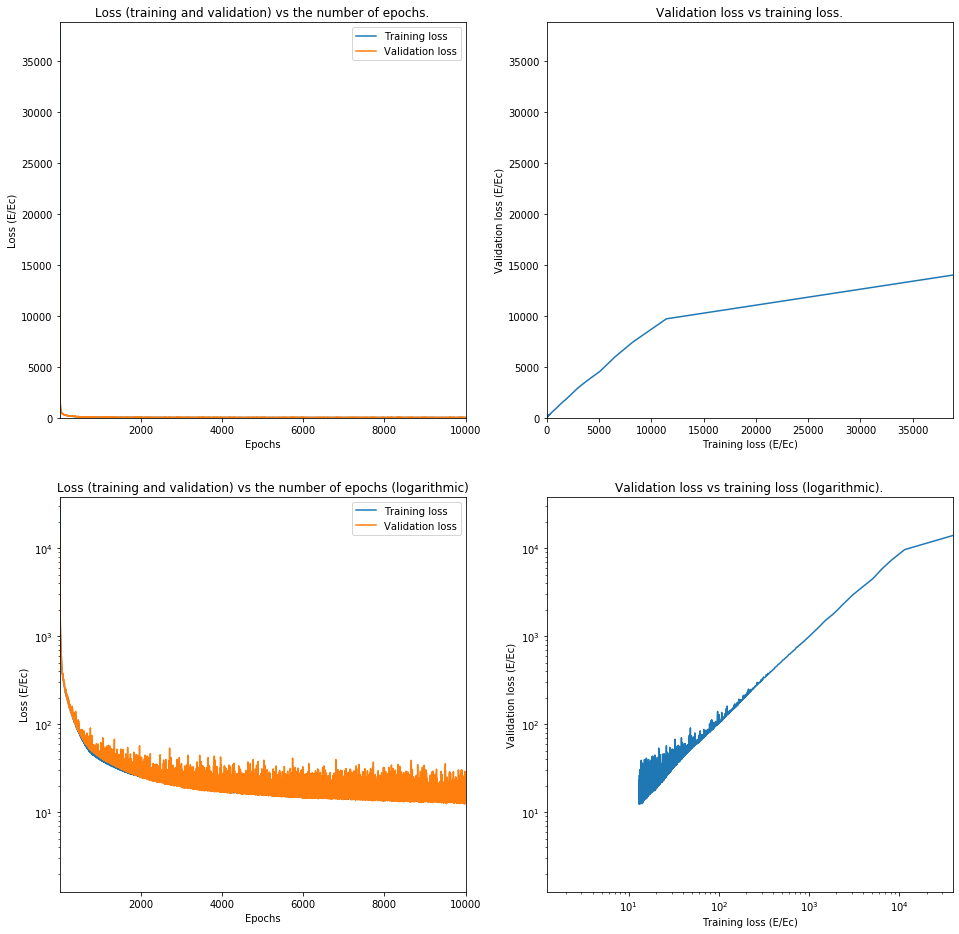

In [26]:
name = 'TwoDenseLayerLargeSoftplus'
settingsNetwork = [inputSize, ['Dense', 4*inputSize, 'softplus', True], ['Dense', 4*inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=10000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

19576/19576 [==============================] - 0s 10us/step
9.888777257083726


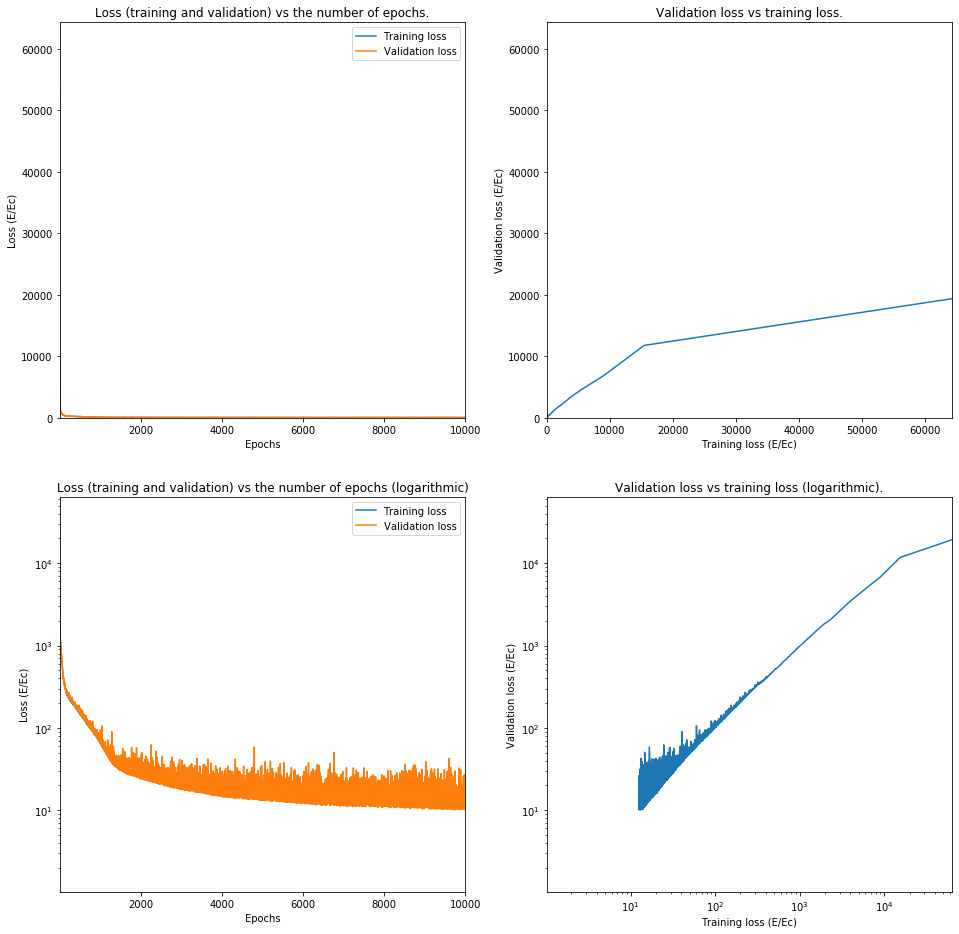

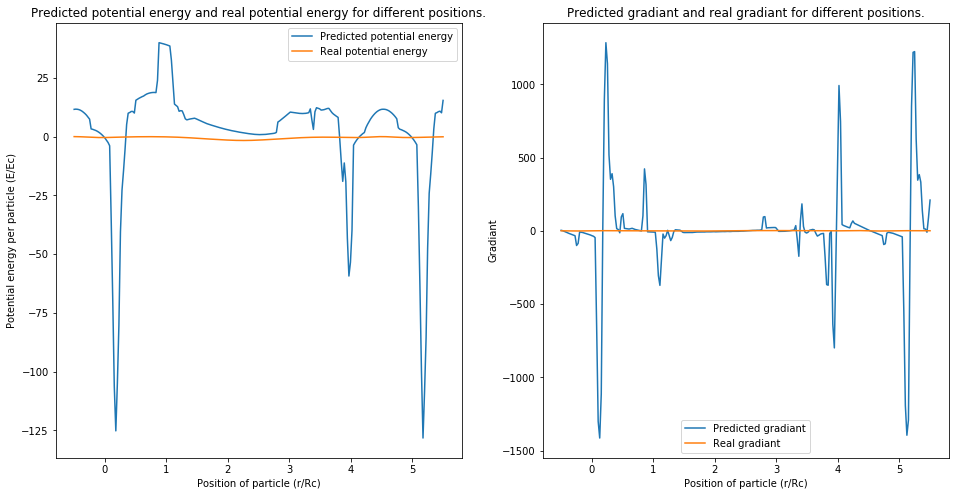

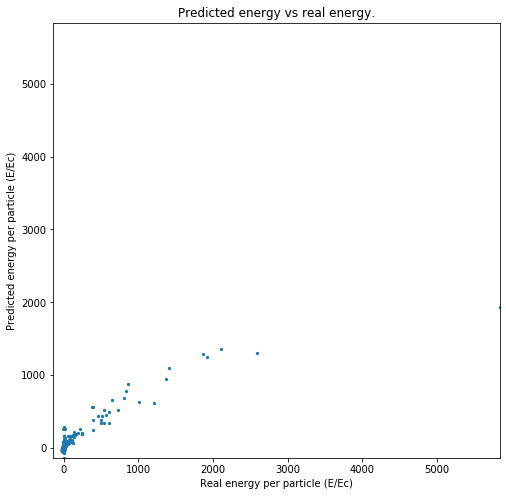

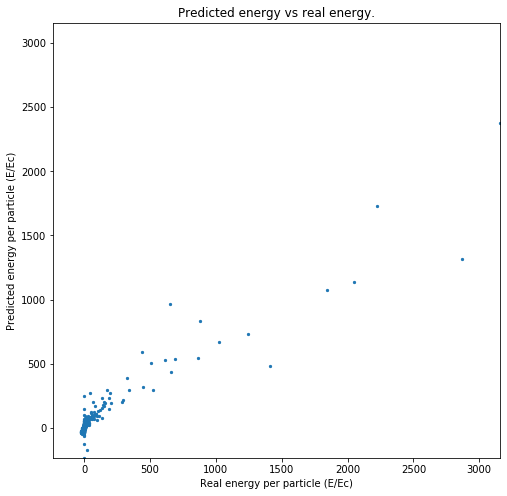

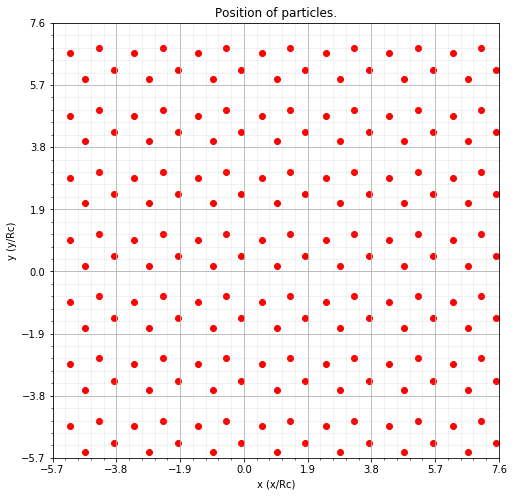

For index 36454 Predicted -17.297052 was -13.8138842409


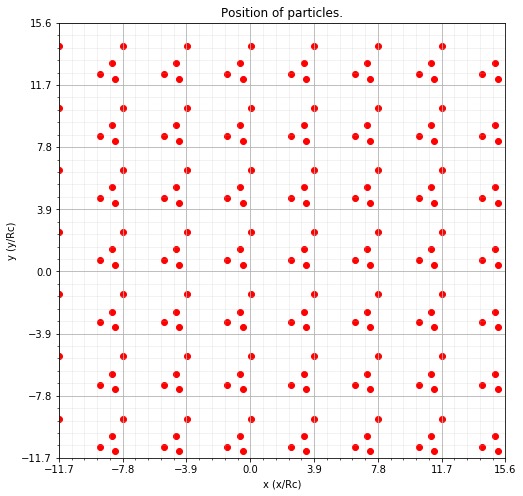

For index 77919 Predicted -0.9386542 was -1.5139580448


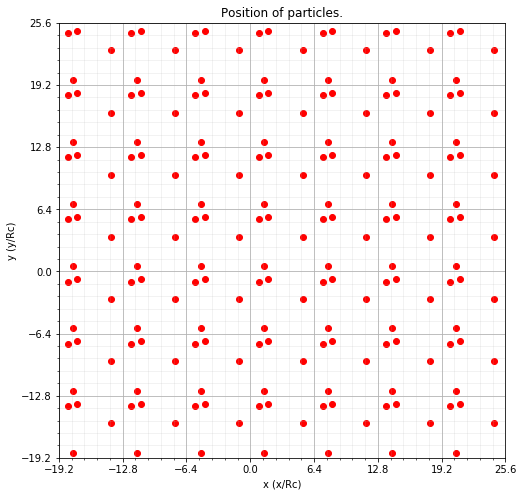

For index 2658 Predicted 0.93829894 was -0.2987796588


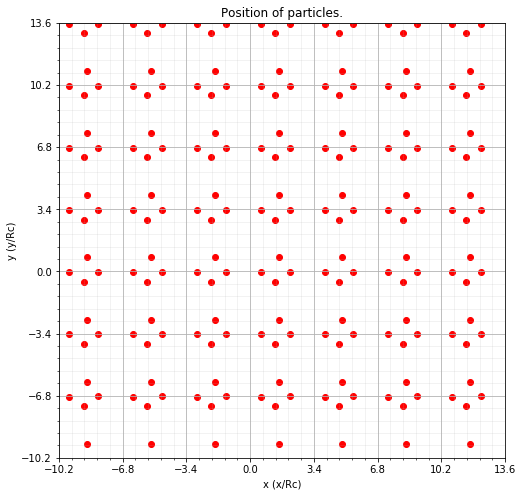

For index 64234 Predicted -3.2355292 was -2.2130348202


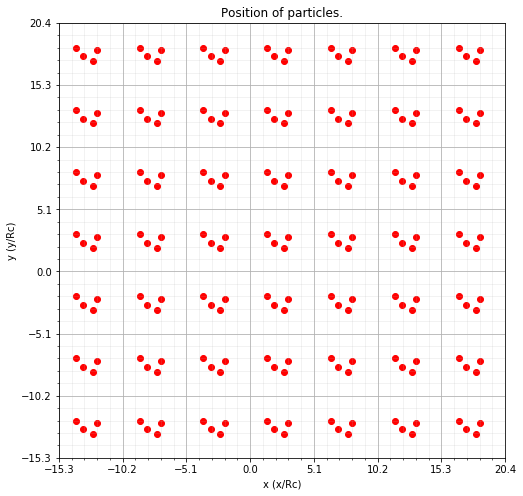

For index 10829 Predicted -4.338068 was -2.1429048869


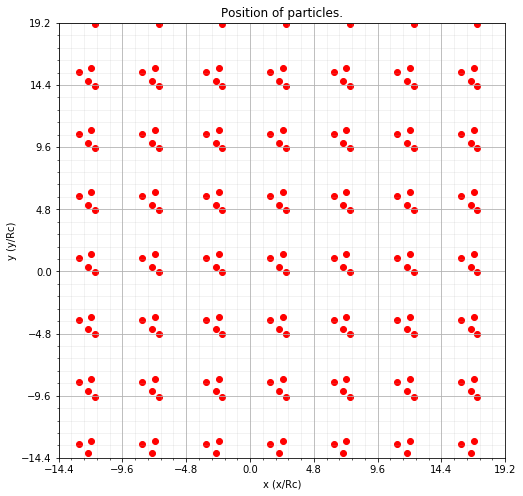

For index 69204 Predicted -71.00701 was 14.3631368483


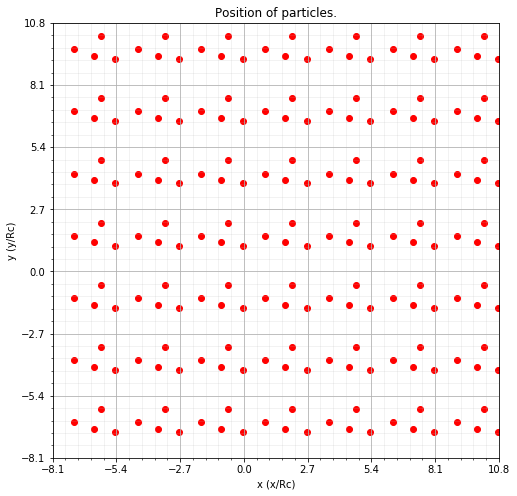

For index 53656 Predicted -7.9357243 was -3.9330538275


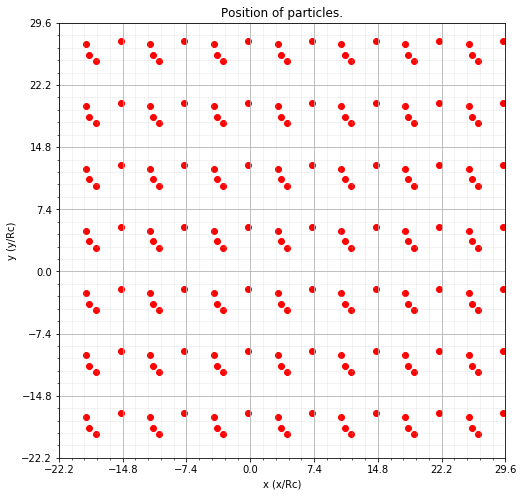

For index 59107 Predicted 0.8943536 was -0.21047515360000002


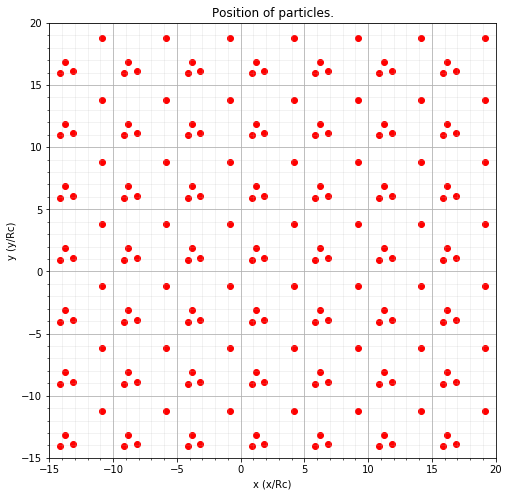

For index 967 Predicted -3.3732245 was -1.314398845


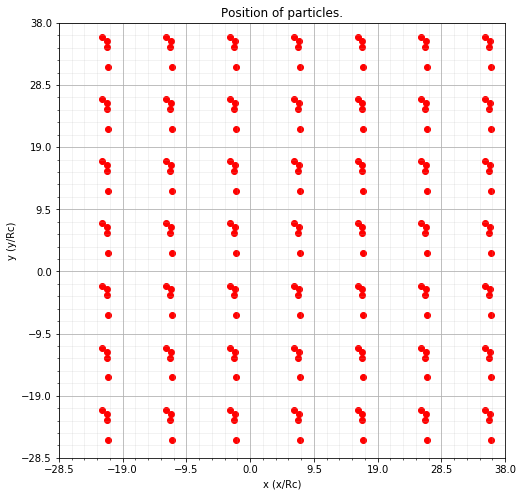

For index 51647 Predicted 1.4480646 was -0.7539948609


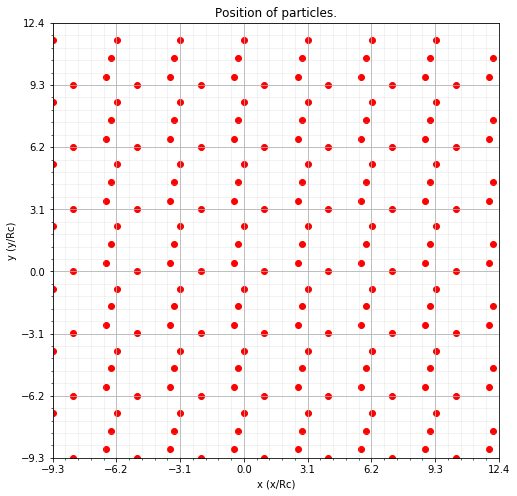

For index 76912 Predicted -1.9733222 was -1.1216862668
Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_31 (Dense)             (None, 48)                624       
_________________________________________________________________
dense_32 (Dense)             (None, 48)                2352      
_________________________________________________________________
dense_33 (Dense)             (None, 1)                 49        
Total params: 3,025
Trainable params: 3,025
Non-trainable params: 0
_________________________________________________________________
Layer 0:  [array([[-0.47511753,  0.596883  ,  0.18556763, -0.78148043, -0.06541429,
         0.10221979, -0.12653089, -0.41732576, -0.25568336, -0.2302829 ,
        -0.59797704,  0.53278214, -0.2533582 , -0.19985393,  0.24693161,
         0.38569167, -0.27028006,  0.03452184,  0.06073728,  0.8358244 ,
         0.5432721 ,  0

In [27]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())


# Finishing

In [28]:
for i in range(len(models)):
    model = models[i]['model']
    print(models[i]['name'])
    print(model.summary())
    print(models[i]['evaluation'])
    model.save(saveFolder + '/' + models[i]['name'] + str(models[i]['evaluation']) + '.h5')
    print('\n \n')

#model = models[1][0]
#model.save('model1.h5')
#model = load_model('model1.h5')

0LinearNetwork
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 1)                 13        
Total params: 13
Trainable params: 13
Non-trainable params: 0
_________________________________________________________________
None
8.79599197031675

 

1DenseLayerSmallSoftplus
Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_11 (Dense)             (None, 12)                156       
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 13        
Total params: 169
Trainable params: 169
Non-trainable params: 0
_________________________________________________________________
None
8.503679273515319

 

2DenseLayerSmallSoftplus
Model: "sequential_14"
_____________________________

In [ ]:
model = load_model(saveFolder+ '/' +'0LinearNetwork0.46557734359635244.h5')

evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())
